# Drug Plots: Visuallizing Effect of Phenotype on Drug Response

In [1]:
# from plotly.offline import init_notebook_mode, iplot
#from plotly.graph_objs import *
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import math
#import plotly
import plotly.graph_objs as go
#plotly.tools.set_credentials_file(username='sfmaddox42', api_key='SOJVGjBN7E7orxpBFLlo')
import seaborn as sns


Bad key "text.kerning_factor" on line 4 in
/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test_patch.mplstyle.
You probably need to get an updated matplotlibrc file from
https://github.com/matplotlib/matplotlib/blob/v3.1.3/matplotlibrc.template
or from the matplotlib source distribution


In [2]:
import os.path as op
indir='/Users/smgroves/Dropbox (VU Basic Sciences)/SCLC/RNAseq-analysis/Drug_response'


In [3]:
outdir = '/Users/smgroves/Documents/pycharm_workspace/mazebox/mazebox/examples/notebooks/bulk/'

# Read in drug classes/targets and drug data from Teicher

In [5]:
df_targ = pd.read_csv('/Users/smgroves/Dropbox (VU Basic Sciences)/SCLC/RNAseq-analysis/Drug_response/target_list_all.csv', header = 0, index_col=0)
df_targ.head(20)

,DRUGS
TARGET,
5-FU,Capecitabine
5-HT,Paroxetine
5-HT RECEPTOR,Anafranil
7-TM RECEPTORS,Terfenadine
ABL,"Imatinib, Nilotinib, Ponatinib"
ABL1,"Bosutinib, AZD-0530, Imatinib, Nilotinib"
ADA,Pentostatin
ADORA2A,Mefloquine
ADRB1,Metoprolol


In [6]:
for i,r in df_targ.iterrows():
    drug_list = df_targ.loc[i]['DRUGS'].split(', ')
    print(drug_list)
    if i == 'AURKB':
        break

['Capecitabine']
['Paroxetine']
['Anafranil']
['Terfenadine']
['Imatinib', 'Nilotinib', 'Ponatinib']
['Bosutinib', 'AZD-0530', 'Imatinib', 'Nilotinib']
['Pentostatin']
['Mefloquine']
['Metoprolol']
['Metoprolol']
['ONX-0801']
['AFP-464', 'Aminoflavone']
['AT-13148', 'AZD-5363', 'CCT-128930', 'GDC-0068', 'GSK-690693 ', 'KRX-0401', 'MK-2206', 'OSU-03013', 'PF-04691502']
['Arsenic Trioxide']
['Aminolevulinic acid']
['Ariad Alk_EGFR inhibitor related to AP-26113', 'Crizotinib', 'ASP-3026', 'Cephalon Early Alk Inhibitor', 'CH-5424802', 'CH-5428402 HCl', 'GSK-1838705A', 'TAE-684']
['SB-431542 ']
['Pyrvinium pamoate']
['Gramicidin', 'Tazobactam', 'Tyrothricin', 'Plicamycin', 'Bleomycin']
['AG-2037', 'Pelitrexol isomer A', 'Pelitrexol isomer B', 'Methotrexate', 'ZD-1694', 'Pemetrexed']
['Itraconazole']
['ARN-509', 'AZD-3514', 'Enzalutamide', 'Mitotane', 'Pipamperone']
['MLN-2480']
['VE-821', 'Wortmannin']
['Vertex ATR inhibitor Cpd 45', 'VE-821', 'Wortmannin']
[' AS-703569 ', 'ABT-348', 'AMG-9

In [7]:
drug_sens_new = pd.read_csv('/Users/smgroves/Dropbox (VU Basic Sciences)/SCLC/RNAseq-analysis/Drug_response/Teicher/Teicher_viability_params.csv', header = 0, index_col=0)
drug_sens = pd.read_csv("/Users/smgroves/Dropbox (VU Basic Sciences)/SCLC/RNAseq-analysis/Drug_response/SCLC_DRC_aa_v2.csv", header = 0, index_col=0)
drug_sens['aa_new'] = pd.Series([0]*len(drug_sens.index))
drug_sens['hill_new'] = pd.Series([0]*len(drug_sens.index))
drug_sens['emax_new'] = pd.Series([0]*len(drug_sens.index))
drug_sens = drug_sens.fillna(0)
drug_sens_num = drug_sens.reset_index()


In [8]:
drug_sens_num.head()

,cell.line,drug,aa,phenotype,aa_new,hill_new,emax_new
0,COLO668,(+)-JQ1,17.644815,MLH,0.0,0.0,0.0
1,CORL32,(+)-JQ1,12.063704,0,0.0,0.0,0.0
2,CORL47,(+)-JQ1,15.942593,NE,0.0,0.0,0.0
3,CORL88,(+)-JQ1,17.129630,MLH,0.0,0.0,0.0
4,DMS114,(+)-JQ1,47.302593,ML,0.0,0.0,0.0


In [9]:
for i, r in drug_sens_num.iterrows():
    try:
        short = drug_sens_new.loc[drug_sens_new['drug'] == r['drug']]
        short = short.loc[r['cell.line']]
        print(short)
        s = drug_sens_num.loc[drug_sens_num['drug']==r['drug']]
        s = s.loc[s['cell.line'] == r['cell.line']]
        ind = s.index.values
        print(ind)
        drug_sens_num.loc[ind, 'aa_new'] = short['aa']
        drug_sens_num.loc[ind, 'hill_new'] = short[ 'hill']
        drug_sens_num.loc[ind, 'emax_new'] = short['emax']
        print(drug_sens_num.loc[ind])
    except KeyError: pass

drug         (+)-JQ1
aa          0.659401
emax        0.466423
emax_obs    0.463367
einf         0.45335
ec50        6.33e-07
ic50         3.7e-06
hill         1.34399
Name: COLO668, dtype: object
[0]
  cell.line     drug         aa phenotype    aa_new  hill_new  emax_new
0   COLO668  (+)-JQ1  17.644815       MLH  0.659401   1.34399  0.466423
drug         (+)-JQ1
aa          0.548736
emax        0.413903
emax_obs    0.415933
einf         0.38451
ec50        1.33e-06
ic50        3.57e-06
hill         1.48166
Name: CORL47, dtype: object
[2]
  cell.line     drug         aa phenotype    aa_new  hill_new  emax_new
2    CORL47  (+)-JQ1  15.942593        NE  0.548736   1.48166  0.413903
drug           (+)-JQ1
aa            0.457876
emax          0.389468
emax_obs        0.3904
einf        0.00698566
ec50          5.94e-06
ic50          6.03e-06
hill          0.898045
Name: CORL88, dtype: object
[3]
  cell.line     drug        aa phenotype    aa_new  hill_new  emax_new
3    CORL88  (+)-JQ1  17

In [10]:
q = drug_sens.loc[drug_sens['drug'].isin(i.upper() for i in df_targ.loc['AURKA']['DRUGS'].split(', '))]
q.loc[q['phenotype']!=0]

,drug,aa,phenotype,aa_new,hill_new,emax_new
cell.line,,,,,,
COLO668,ABT-348,28.221111,MLH,0.0,0.0,0.0
CORL47,ABT-348,52.441111,NE,0.0,0.0,0.0
CORL88,ABT-348,6.760370,MLH,0.0,0.0,0.0
DMS114,ABT-348,39.954815,ML,0.0,0.0,0.0
DMS273,ABT-348,33.168519,NEH,0.0,0.0,0.0
...,...,...,...,...,...,...
NCIH82,TAK-901,48.943704,NEH,0.0,0.0,0.0
NCIH841,TAK-901,43.862037,ML,0.0,0.0,0.0
NCIH889,TAK-901,12.558148,NE,0.0,0.0,0.0


In [15]:
drug_sens['aa']=drug_sens_num['aa_new'].values

## Plot boxplots by (old) subtypes

                   drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    Capecitabine  0.0       MLH     0.0       0.0       0.0
CORL47     Capecitabine  0.0        NE     0.0       0.0       0.0
CORL88     Capecitabine  0.0       MLH     0.0       0.0       0.0
DMS114     Capecitabine  0.0        ML     0.0       0.0       0.0
DMS273     Capecitabine  0.0       NEH     0.0       0.0       0.0
DMS53      Capecitabine  0.0       MLH     0.0       0.0       0.0
DMS79      Capecitabine  0.0        NE     0.0       0.0       0.0
NCIH1048   Capecitabine  0.0        ML     0.0       0.0       0.0
NCIH1092   Capecitabine  0.0        NE     0.0       0.0       0.0
NCIH1105   Capecitabine  0.0        NE     0.0       0.0       0.0
NCIH1341   Capecitabine  0.0        ML     0.0       0.0       0.0
NCIH1436   Capecitabine  0.0        NE     0.0       0.0       0.0
NCIH146    Capecitabine  0.0        NE     0.0       0.0      

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


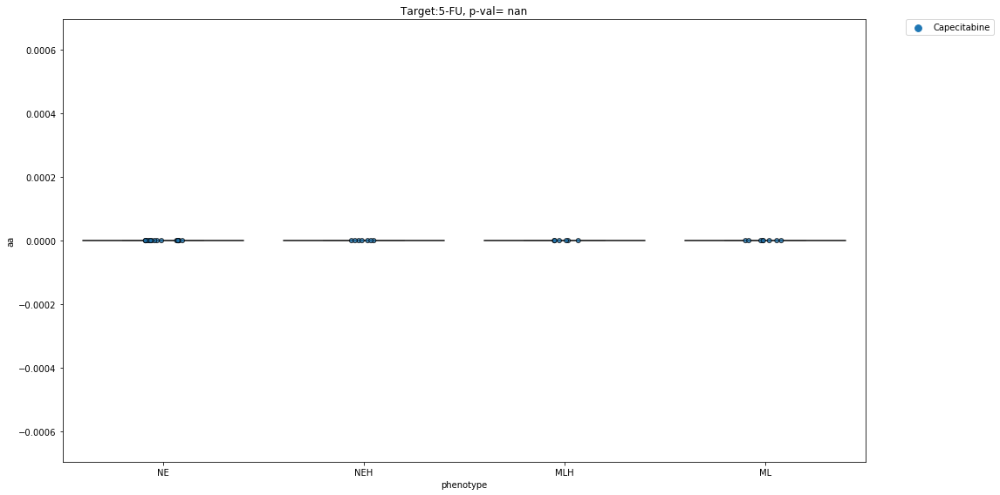

                 drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                
COLO668    Paroxetine  1.105948e-01       MLH     0.0       0.0       0.0
DMS114     Paroxetine  1.376779e-01        ML     0.0       0.0       0.0
DMS53      Paroxetine  1.681758e-01       MLH     0.0       0.0       0.0
NCIH1048   Paroxetine  1.347016e-02        ML     0.0       0.0       0.0
NCIH1436   Paroxetine  3.655928e-02        NE     0.0       0.0       0.0
NCIH146    Paroxetine  1.269140e-01        NE     0.0       0.0       0.0
NCIH1876   Paroxetine  2.020000e-09        NE     0.0       0.0       0.0
NCIH2066   Paroxetine  1.408829e-01        ML     0.0       0.0       0.0
NCIH209    Paroxetine  3.987030e-02        NE     0.0       0.0       0.0
NCIH211    Paroxetine  9.213429e-02        ML     0.0       0.0       0.0
NCIH2141   Paroxetine  9.410000e-14        NE     0.0       0.0       0.0
NCIH2171   Paroxetine  1.783356e-03   

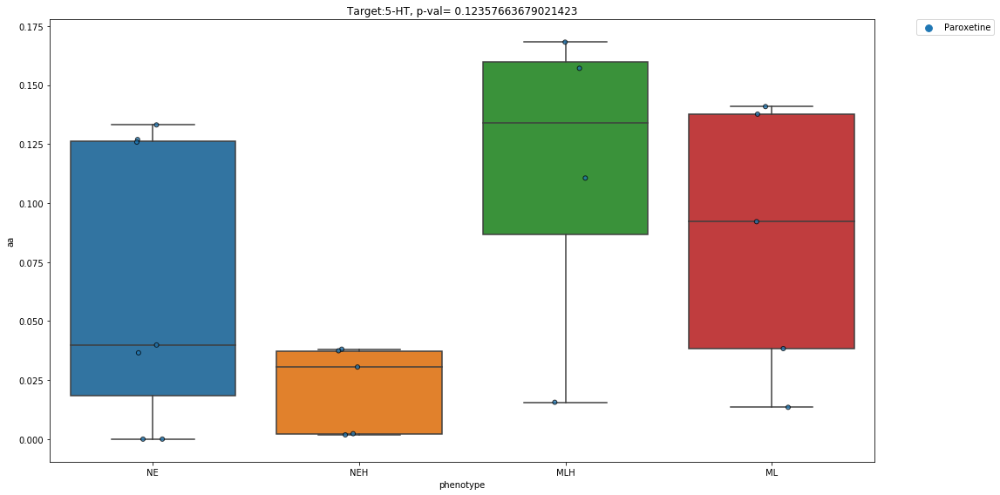

                drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                               
COLO668    Anafranil  6.679722e-02       MLH     0.0       0.0       0.0
DMS114     Anafranil  1.301088e-01        ML     0.0       0.0       0.0
DMS273     Anafranil  3.463941e-01       NEH     0.0       0.0       0.0
DMS53      Anafranil  1.802697e-01       MLH     0.0       0.0       0.0
DMS79      Anafranil  1.805625e-03        NE     0.0       0.0       0.0
NCIH1048   Anafranil  2.147317e-02        ML     0.0       0.0       0.0
NCIH1092   Anafranil  3.790000e-09        NE     0.0       0.0       0.0
NCIH1105   Anafranil  3.161738e-02        NE     0.0       0.0       0.0
NCIH1436   Anafranil  1.488193e-01        NE     0.0       0.0       0.0
NCIH146    Anafranil  5.880530e-02        NE     0.0       0.0       0.0
NCIH1694   Anafranil  1.044903e-01       NEH     0.0       0.0       0.0
NCIH1836   Anafranil  8.774968e-02        NE     0.

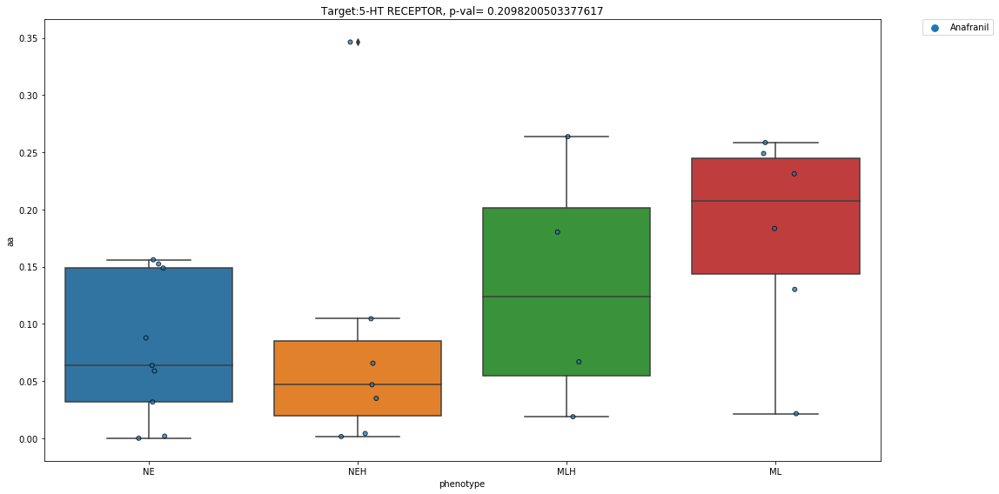

                  drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668    Terfenadine  0.341948       MLH     0.0       0.0       0.0
CORL47     Terfenadine  0.082203        NE     0.0       0.0       0.0
CORL88     Terfenadine  0.037920       MLH     0.0       0.0       0.0
DMS114     Terfenadine  0.089397        ML     0.0       0.0       0.0
DMS273     Terfenadine  0.100707       NEH     0.0       0.0       0.0
DMS53      Terfenadine  0.249166       MLH     0.0       0.0       0.0
DMS79      Terfenadine  0.382778        NE     0.0       0.0       0.0
NCIH1048   Terfenadine  0.375575        ML     0.0       0.0       0.0
NCIH1092   Terfenadine  0.212955        NE     0.0       0.0       0.0
NCIH1105   Terfenadine  0.226157        NE     0.0       0.0       0.0
NCIH1341   Terfenadine  0.022318        ML     0.0       0.0       0.0
NCIH1436   Terfenadine  0.058412        NE     0.0       0.0       0.0
NCIH14

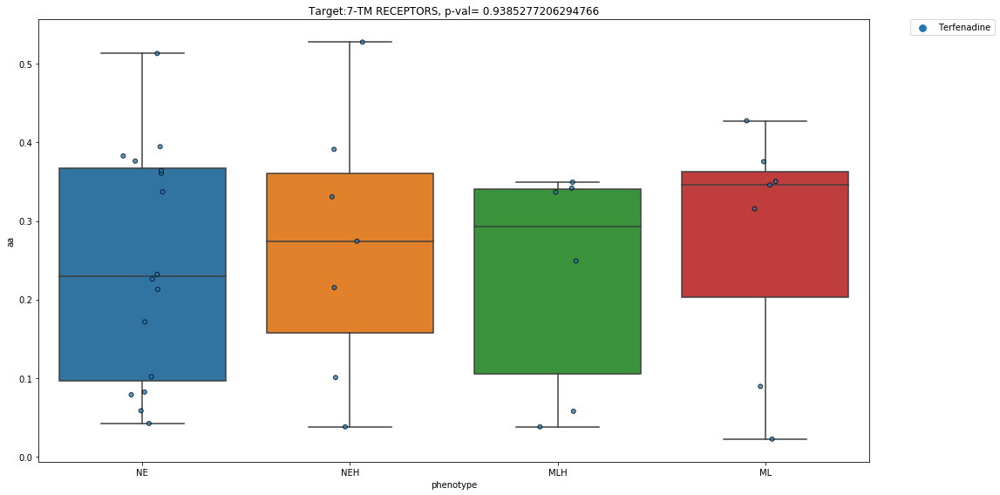

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                      
COLO668     Imatinib  0.0       MLH     0.0       0.0       0.0
CORL47      Imatinib  0.0        NE     0.0       0.0       0.0
CORL88      Imatinib  0.0       MLH     0.0       0.0       0.0
DMS114      Imatinib  0.0        ML     0.0       0.0       0.0
DMS273      Imatinib  0.0       NEH     0.0       0.0       0.0
...              ...  ...       ...     ...       ...       ...
NCIH82     Ponatinib  0.0       NEH     0.0       0.0       0.0
NCIH841    Ponatinib  0.0        ML     0.0       0.0       0.0
NCIH889    Ponatinib  0.0        NE     0.0       0.0       0.0
SHP77      Ponatinib  0.0       MLH     0.0       0.0       0.0
SW1271     Ponatinib  0.0        ML     0.0       0.0       0.0

[111 rows x 6 columns]
ABL


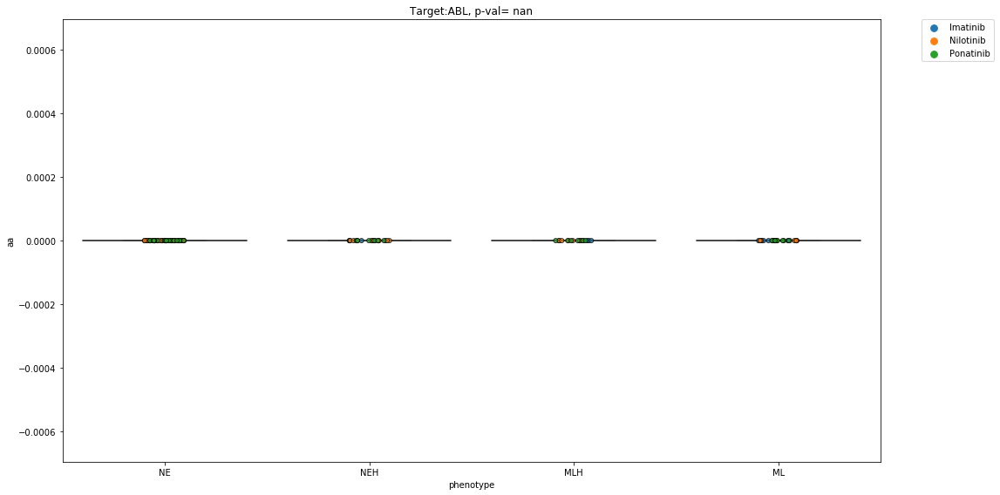

                drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                           
COLO668     AZD-0530  0.133333       MLH     0.0       0.0       0.0
CORL47      AZD-0530  0.313625        NE     0.0       0.0       0.0
CORL88      AZD-0530  0.199410       MLH     0.0       0.0       0.0
DMS114      AZD-0530  0.426735        ML     0.0       0.0       0.0
DMS273      AZD-0530  0.014852       NEH     0.0       0.0       0.0
...              ...       ...       ...     ...       ...       ...
NCIH82     Nilotinib  0.000000       NEH     0.0       0.0       0.0
NCIH841    Nilotinib  0.000000        ML     0.0       0.0       0.0
NCIH889    Nilotinib  0.000000        NE     0.0       0.0       0.0
SHP77      Nilotinib  0.000000       MLH     0.0       0.0       0.0
SW1271     Nilotinib  0.000000        ML     0.0       0.0       0.0

[133 rows x 6 columns]
ABL1


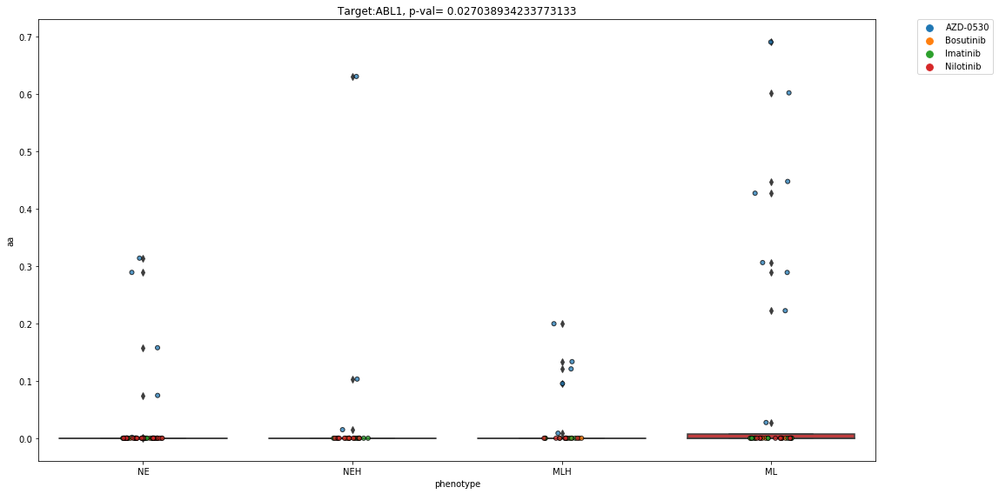

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                  drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                        
COLO668    Pentostatin  0.0       MLH     0.0       0.0       0.0
CORL47     Pentostatin  0.0        NE     0.0       0.0       0.0
CORL88     Pentostatin  0.0       MLH     0.0       0.0       0.0
DMS114     Pentostatin  0.0        ML     0.0       0.0       0.0
DMS273     Pentostatin  0.0       NEH     0.0       0.0       0.0
DMS53      Pentostatin  0.0       MLH     0.0       0.0       0.0
DMS79      Pentostatin  0.0        NE     0.0       0.0       0.0
NCIH1048   Pentostatin  0.0        ML     0.0       0.0       0.0
NCIH1092   Pentostatin  0.0        NE     0.0       0.0       0.0
NCIH1105   Pentostatin  0.0        NE     0.0       0.0       0.0
NCIH1341   Pentostatin  0.0        ML     0.0       0.0       0.0
NCIH1436   Pentostatin  0.0        NE     0.0       0.0       0.0
NCIH146    Pentostatin  0.0        NE     0.0       0.0       0.0
NCIH1618  

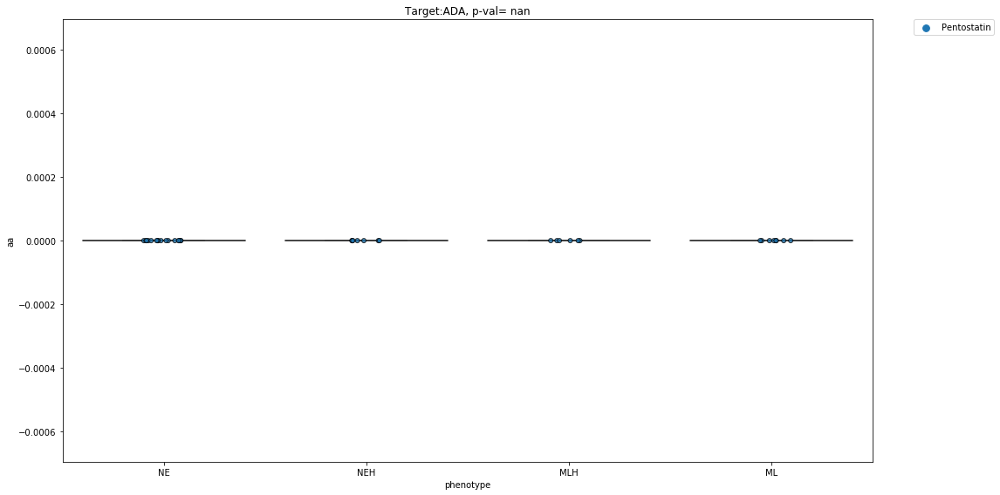

                 drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                            
COLO668    Mefloquine  0.142433       MLH     0.0       0.0       0.0
CORL47     Mefloquine  0.100044        NE     0.0       0.0       0.0
CORL88     Mefloquine  0.046674       MLH     0.0       0.0       0.0
DMS114     Mefloquine  0.286370        ML     0.0       0.0       0.0
DMS273     Mefloquine  0.325382       NEH     0.0       0.0       0.0
DMS53      Mefloquine  0.081666       MLH     0.0       0.0       0.0
DMS79      Mefloquine  0.006523        NE     0.0       0.0       0.0
NCIH1048   Mefloquine  0.084667        ML     0.0       0.0       0.0
NCIH1092   Mefloquine  0.003156        NE     0.0       0.0       0.0
NCIH1105   Mefloquine  0.020543        NE     0.0       0.0       0.0
NCIH1341   Mefloquine  0.113110        ML     0.0       0.0       0.0
NCIH146    Mefloquine  0.104640        NE     0.0       0.0       0.0
NCIH1618   Mefloquin

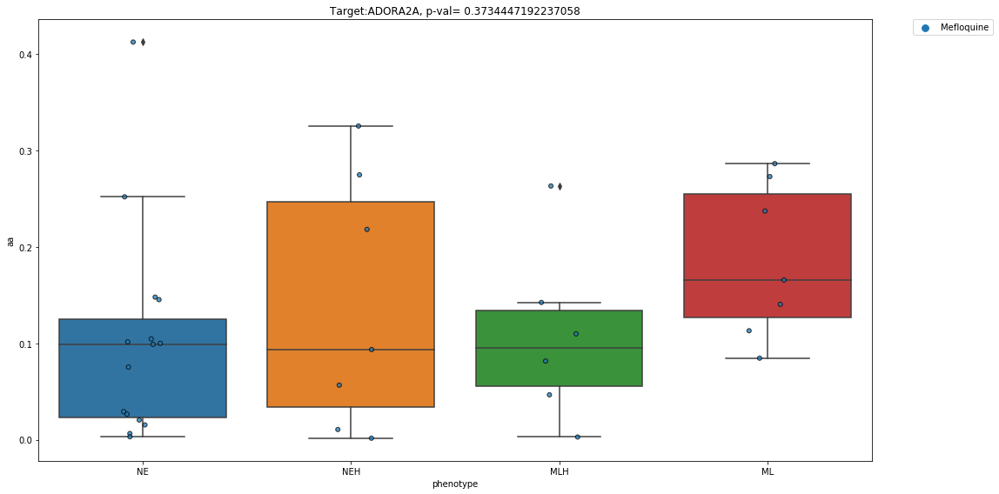

                 drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                
CORL47     Metoprolol  1.640000e-13        NE     0.0       0.0       0.0
DMS114     Metoprolol  1.180000e-08        ML     0.0       0.0       0.0
DMS79      Metoprolol  3.710000e-15        NE     0.0       0.0       0.0
NCIH1092   Metoprolol  5.780000e-11        NE     0.0       0.0       0.0
NCIH1618   Metoprolol  1.360000e-13        NE     0.0       0.0       0.0
NCIH1836   Metoprolol  8.590000e-11        NE     0.0       0.0       0.0
NCIH1876   Metoprolol  5.410000e-14        NE     0.0       0.0       0.0
NCIH1930   Metoprolol  9.740000e-12        NE     0.0       0.0       0.0
NCIH1963   Metoprolol  1.900000e-09        NE     0.0       0.0       0.0
NCIH2081   Metoprolol  1.620000e-10        NE     0.0       0.0       0.0
NCIH2171   Metoprolol  9.390000e-18       NEH     0.0       0.0       0.0
NCIH446    Metoprolol  1.810000e-18   

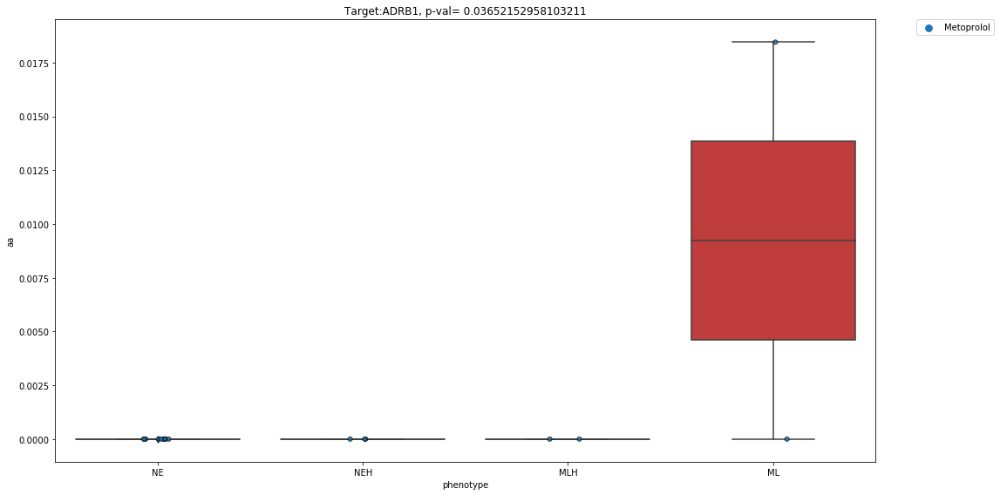

                 drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                
CORL47     Metoprolol  1.640000e-13        NE     0.0       0.0       0.0
DMS114     Metoprolol  1.180000e-08        ML     0.0       0.0       0.0
DMS79      Metoprolol  3.710000e-15        NE     0.0       0.0       0.0
NCIH1092   Metoprolol  5.780000e-11        NE     0.0       0.0       0.0
NCIH1618   Metoprolol  1.360000e-13        NE     0.0       0.0       0.0
NCIH1836   Metoprolol  8.590000e-11        NE     0.0       0.0       0.0
NCIH1876   Metoprolol  5.410000e-14        NE     0.0       0.0       0.0
NCIH1930   Metoprolol  9.740000e-12        NE     0.0       0.0       0.0
NCIH1963   Metoprolol  1.900000e-09        NE     0.0       0.0       0.0
NCIH2081   Metoprolol  1.620000e-10        NE     0.0       0.0       0.0
NCIH2171   Metoprolol  9.390000e-18       NEH     0.0       0.0       0.0
NCIH446    Metoprolol  1.810000e-18   

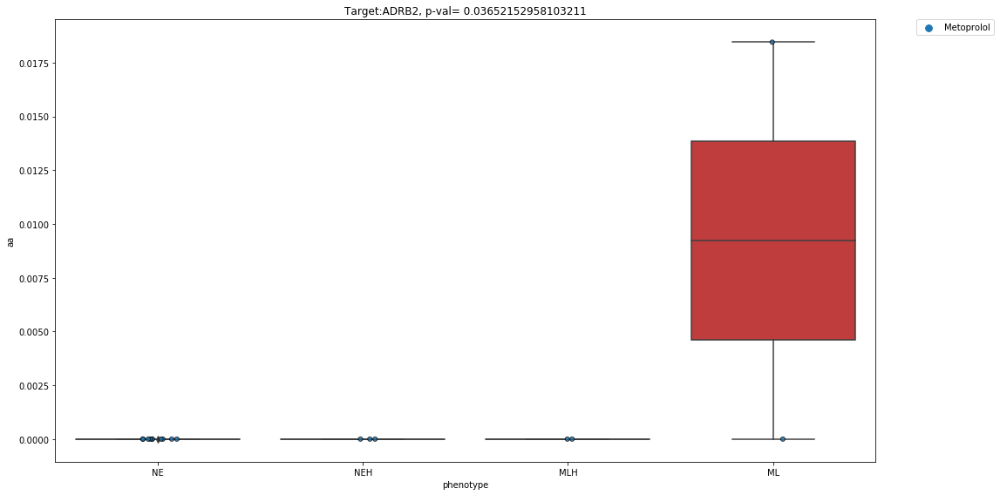

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668    ONX-0801  0.240262       MLH     0.0       0.0       0.0
DMS114     ONX-0801  0.502922        ML     0.0       0.0       0.0
DMS273     ONX-0801  0.059317       NEH     0.0       0.0       0.0
DMS53      ONX-0801  0.498163       MLH     0.0       0.0       0.0
DMS79      ONX-0801  0.140904        NE     0.0       0.0       0.0
NCIH1048   ONX-0801  0.442031        ML     0.0       0.0       0.0
NCIH1105   ONX-0801  0.002097        NE     0.0       0.0       0.0
NCIH1341   ONX-0801  0.172105        ML     0.0       0.0       0.0
NCIH1436   ONX-0801  0.147196        NE     0.0       0.0       0.0
NCIH146    ONX-0801  0.071574        NE     0.0       0.0       0.0
NCIH1618   ONX-0801  0.023344        NE     0.0       0.0       0.0
NCIH1694   ONX-0801  0.002169       NEH     0.0       0.0       0.0
NCIH1836   ONX-0801  0.412230        NE     0.0 

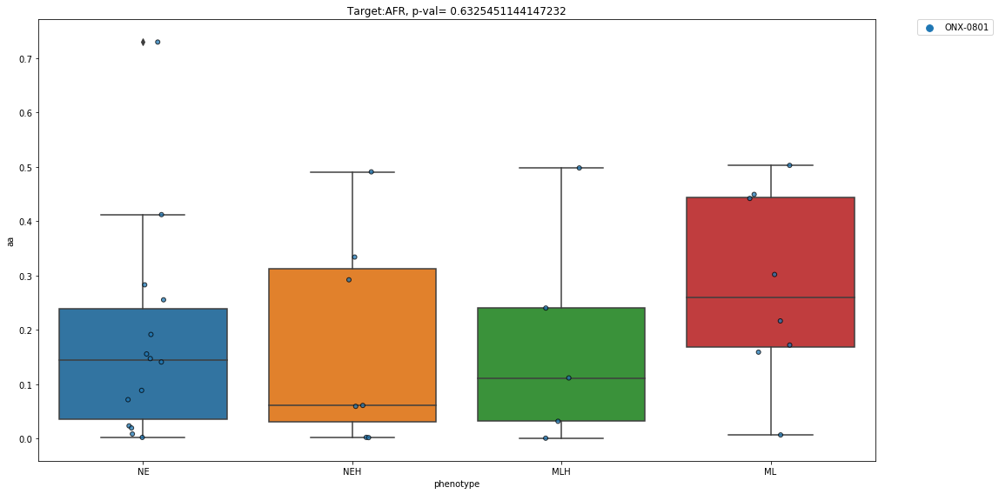

                   drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
COLO668         AFP-464  0.126990       MLH     0.0       0.0       0.0
CORL47          AFP-464  0.127563        NE     0.0       0.0       0.0
CORL88          AFP-464  1.003049       MLH     0.0       0.0       0.0
DMS114          AFP-464  0.955066        ML     0.0       0.0       0.0
DMS273          AFP-464  1.102288       NEH     0.0       0.0       0.0
...                 ...       ...       ...     ...       ...       ...
NCIH82     Aminoflavone  2.073315       NEH     0.0       0.0       0.0
NCIH841    Aminoflavone  0.135866        ML     0.0       0.0       0.0
NCIH889    Aminoflavone  0.035882        NE     0.0       0.0       0.0
SHP77      Aminoflavone  0.007033       MLH     0.0       0.0       0.0
SW1271     Aminoflavone  0.247321        ML     0.0       0.0       0.0

[71 rows x 6 columns]
AHR


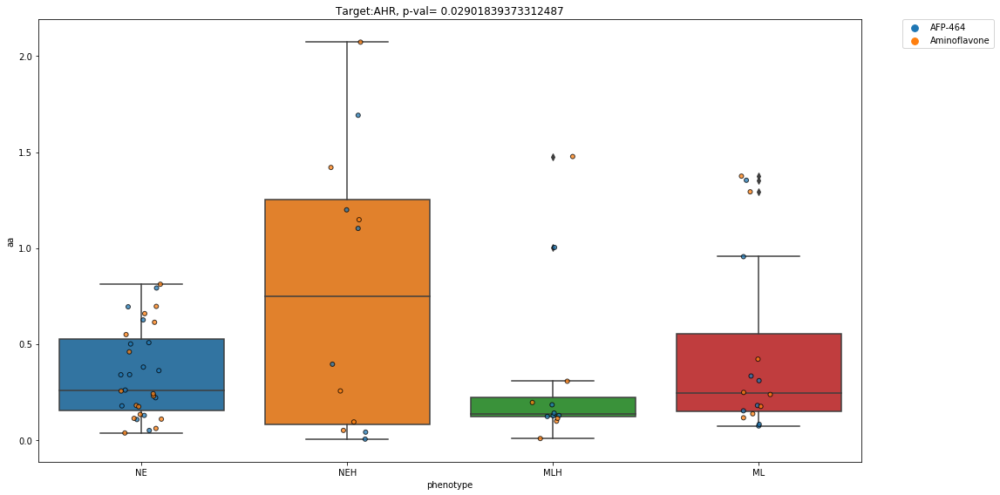

                  drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668       AT-13148  0.470618       MLH     0.0       0.0       0.0
CORL47        AT-13148  0.334552        NE     0.0       0.0       0.0
CORL88        AT-13148  0.022772       MLH     0.0       0.0       0.0
DMS114        AT-13148  0.381453        ML     0.0       0.0       0.0
DMS273        AT-13148  0.010428       NEH     0.0       0.0       0.0
...                ...       ...       ...     ...       ...       ...
NCIH82     PF-04691502  1.666708       NEH     0.0       0.0       0.0
NCIH841    PF-04691502  1.568459        ML     0.0       0.0       0.0
NCIH889    PF-04691502  0.935755        NE     0.0       0.0       0.0
SHP77      PF-04691502  0.599574       MLH     0.0       0.0       0.0
SW1271     PF-04691502  1.718226        ML     0.0       0.0       0.0

[298 rows x 6 columns]
AKT


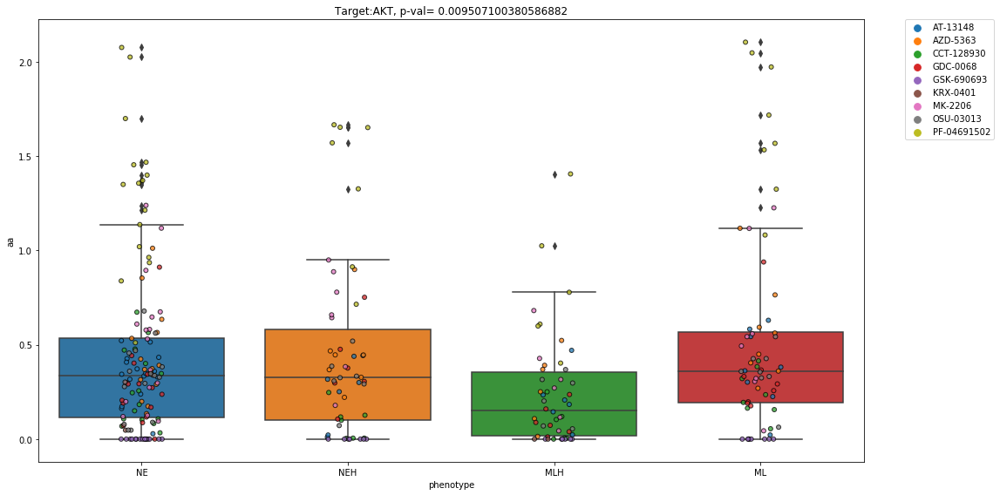

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                       drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668    Arsenic Trioxide  0.0       MLH     0.0       0.0       0.0
CORL47     Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
CORL88     Arsenic Trioxide  0.0       MLH     0.0       0.0       0.0
DMS114     Arsenic Trioxide  0.0        ML     0.0       0.0       0.0
DMS273     Arsenic Trioxide  0.0       NEH     0.0       0.0       0.0
DMS53      Arsenic Trioxide  0.0       MLH     0.0       0.0       0.0
DMS79      Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
NCIH1048   Arsenic Trioxide  0.0        ML     0.0       0.0       0.0
NCIH1092   Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
NCIH1105   Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
NCIH1341   Arsenic Trioxide  0.0        ML     0.0       0.0       0.0
NCIH1436   Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
NCIH14

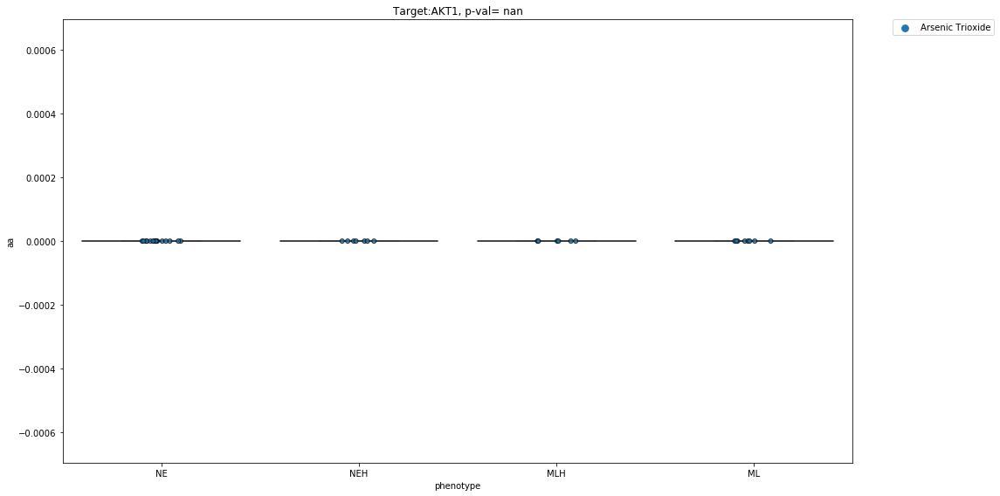

                          drug            aa phenotype  aa_new  hill_new  \
cell.line                                                                  
COLO668    Aminolevulinic acid  1.997525e-01       MLH     0.0       0.0   
DMS273     Aminolevulinic acid  1.806272e-01       NEH     0.0       0.0   
NCIH146    Aminolevulinic acid  8.530167e-02        NE     0.0       0.0   
NCIH1876   Aminolevulinic acid  5.220209e-02        NE     0.0       0.0   
NCIH1930   Aminolevulinic acid  3.790901e-01        NE     0.0       0.0   
NCIH69     Aminolevulinic acid  3.303554e-01        NE     0.0       0.0   
NCIH82     Aminolevulinic acid  1.330000e-10       NEH     0.0       0.0   
NCIH841    Aminolevulinic acid  2.808022e-01        ML     0.0       0.0   

           emax_new  
cell.line            
COLO668         0.0  
DMS273          0.0  
NCIH146         0.0  
NCIH1876        0.0  
NCIH1930        0.0  
NCIH69          0.0  
NCIH82          0.0  
NCIH841         0.0  
ALAD


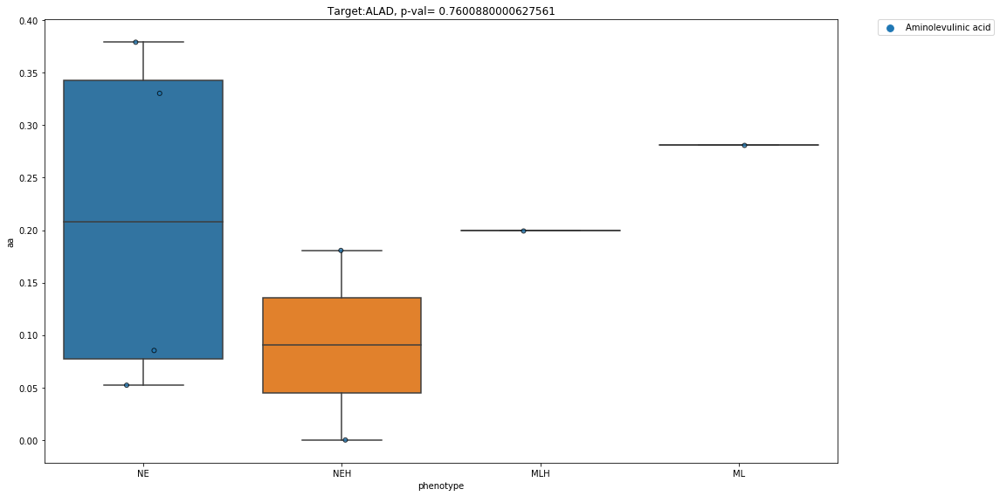

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668    ASP-3026  0.114527       MLH     0.0       0.0       0.0
CORL47     ASP-3026  0.067689        NE     0.0       0.0       0.0
DMS114     ASP-3026  0.144590        ML     0.0       0.0       0.0
DMS273     ASP-3026  0.002749       NEH     0.0       0.0       0.0
DMS53      ASP-3026  0.138732       MLH     0.0       0.0       0.0
...             ...       ...       ...     ...       ...       ...
NCIH82      TAE-684  0.434186       NEH     0.0       0.0       0.0
NCIH841     TAE-684  0.748221        ML     0.0       0.0       0.0
NCIH889     TAE-684  0.263310        NE     0.0       0.0       0.0
SHP77       TAE-684  0.424283       MLH     0.0       0.0       0.0
SW1271      TAE-684  1.051521        ML     0.0       0.0       0.0

[250 rows x 6 columns]
ALK


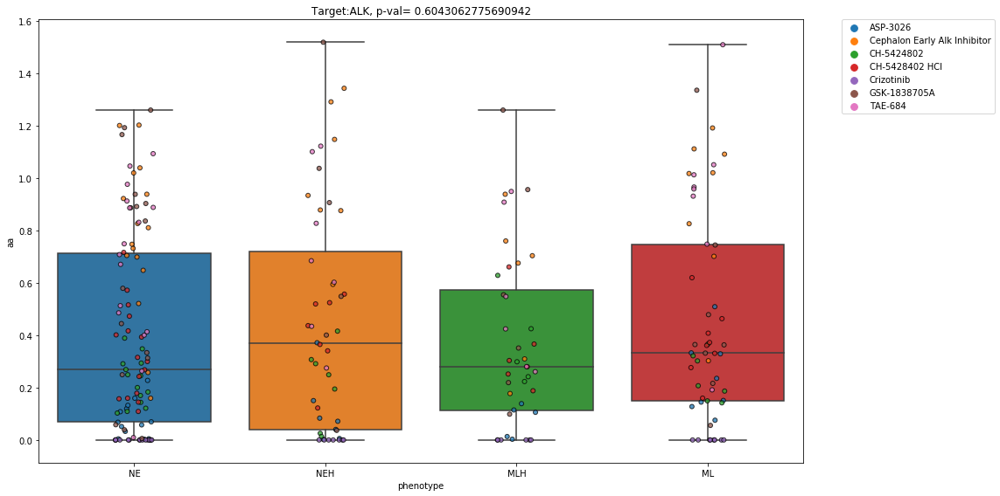

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                 drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                       
COLO668    SB-431542   0.0       MLH     0.0       0.0       0.0
CORL47     SB-431542   0.0        NE     0.0       0.0       0.0
CORL88     SB-431542   0.0       MLH     0.0       0.0       0.0
DMS114     SB-431542   0.0        ML     0.0       0.0       0.0
DMS273     SB-431542   0.0       NEH     0.0       0.0       0.0
DMS53      SB-431542   0.0       MLH     0.0       0.0       0.0
DMS79      SB-431542   0.0        NE     0.0       0.0       0.0
NCIH1048   SB-431542   0.0        ML     0.0       0.0       0.0
NCIH1092   SB-431542   0.0        NE     0.0       0.0       0.0
NCIH1105   SB-431542   0.0        NE     0.0       0.0       0.0
NCIH1341   SB-431542   0.0        ML     0.0       0.0       0.0
NCIH1436   SB-431542   0.0        NE     0.0       0.0       0.0
NCIH146    SB-431542   0.0        NE     0.0       0.0       0.0
NCIH1618   SB-431542   0.

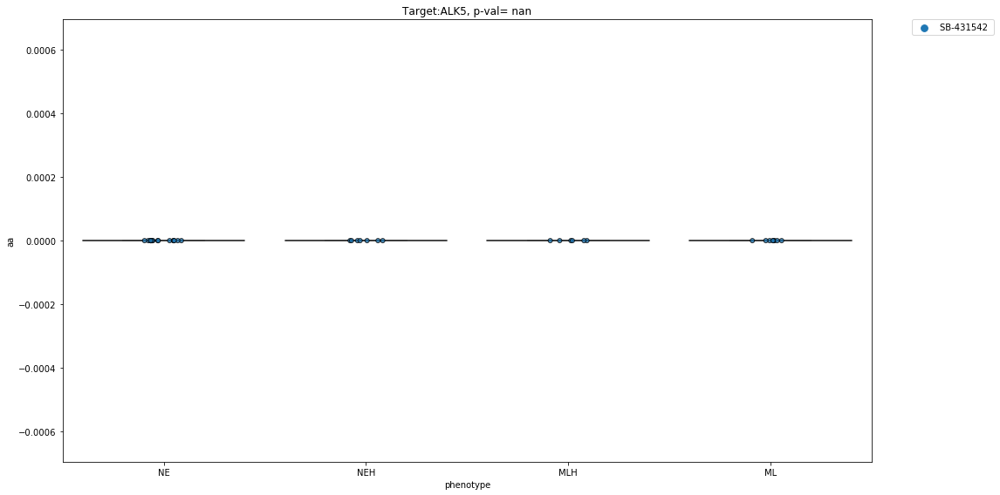

                        drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                   
COLO668    Pyrvinium pamoate  2.039858       MLH     0.0       0.0       0.0
CORL47     Pyrvinium pamoate  1.945896        NE     0.0       0.0       0.0
CORL88     Pyrvinium pamoate  1.415838       MLH     0.0       0.0       0.0
DMS114     Pyrvinium pamoate  2.487345        ML     0.0       0.0       0.0
DMS273     Pyrvinium pamoate  2.012391       NEH     0.0       0.0       0.0
DMS53      Pyrvinium pamoate  1.688463       MLH     0.0       0.0       0.0
DMS79      Pyrvinium pamoate  1.849421        NE     0.0       0.0       0.0
NCIH1048   Pyrvinium pamoate  2.150515        ML     0.0       0.0       0.0
NCIH1092   Pyrvinium pamoate  2.437863        NE     0.0       0.0       0.0
NCIH1105   Pyrvinium pamoate  2.514053        NE     0.0       0.0       0.0
NCIH1341   Pyrvinium pamoate  1.914686        ML     0.0       0.0       0.0

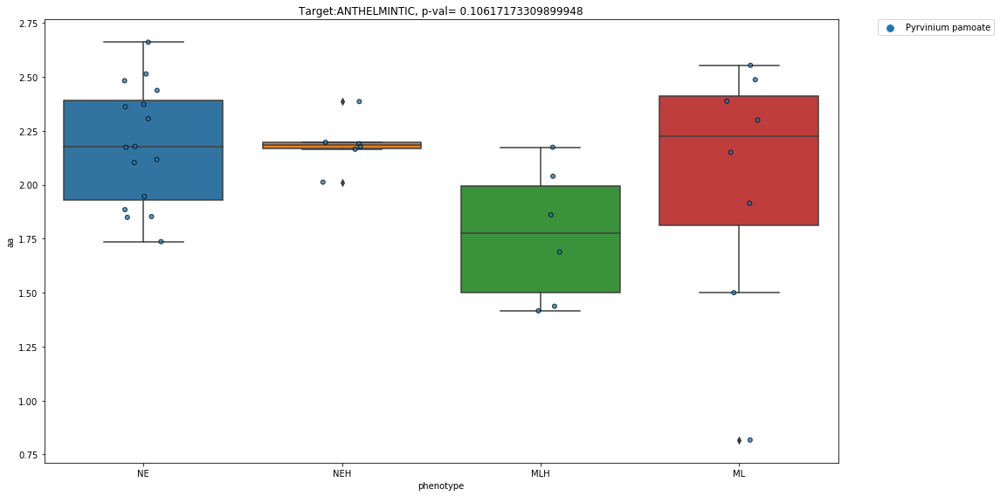

                  drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668      Bleomycin  0.000000       MLH     0.0       0.0       0.0
CORL47       Bleomycin  0.000000        NE     0.0       0.0       0.0
CORL88       Bleomycin  0.000000       MLH     0.0       0.0       0.0
DMS114       Bleomycin  0.000000        ML     0.0       0.0       0.0
DMS273       Bleomycin  0.000000       NEH     0.0       0.0       0.0
...                ...       ...       ...     ...       ...       ...
NCIH82     Tyrothricin  0.100605       NEH     0.0       0.0       0.0
NCIH841    Tyrothricin  0.398947        ML     0.0       0.0       0.0
NCIH889    Tyrothricin  0.148677        NE     0.0       0.0       0.0
SHP77      Tyrothricin  0.030287       MLH     0.0       0.0       0.0
SW1271     Tyrothricin  0.614009        ML     0.0       0.0       0.0

[153 rows x 6 columns]
ANTIBIOTIC


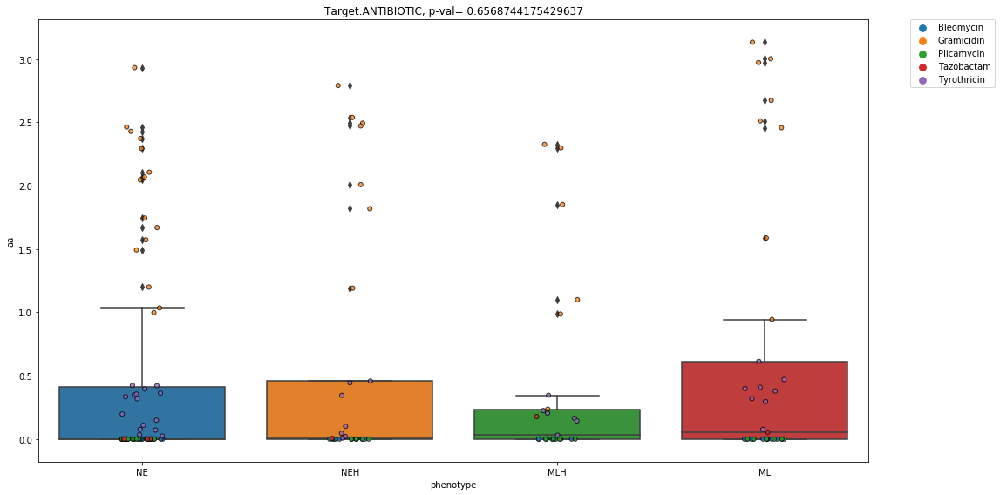

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    AG-2037  2.760841       MLH     0.0       0.0       0.0
CORL47     AG-2037  2.278732        NE     0.0       0.0       0.0
CORL88     AG-2037  2.490473       MLH     0.0       0.0       0.0
DMS114     AG-2037  2.699804        ML     0.0       0.0       0.0
DMS273     AG-2037  2.388141       NEH     0.0       0.0       0.0
...            ...       ...       ...     ...       ...       ...
NCIH82     ZD-1694  2.295416       NEH     0.0       0.0       0.0
NCIH841    ZD-1694  0.922521        ML     0.0       0.0       0.0
NCIH889    ZD-1694  0.825824        NE     0.0       0.0       0.0
SHP77      ZD-1694  1.461975       MLH     0.0       0.0       0.0
SW1271     ZD-1694  0.755736        ML     0.0       0.0       0.0

[215 rows x 6 columns]
ANTIFOLATE


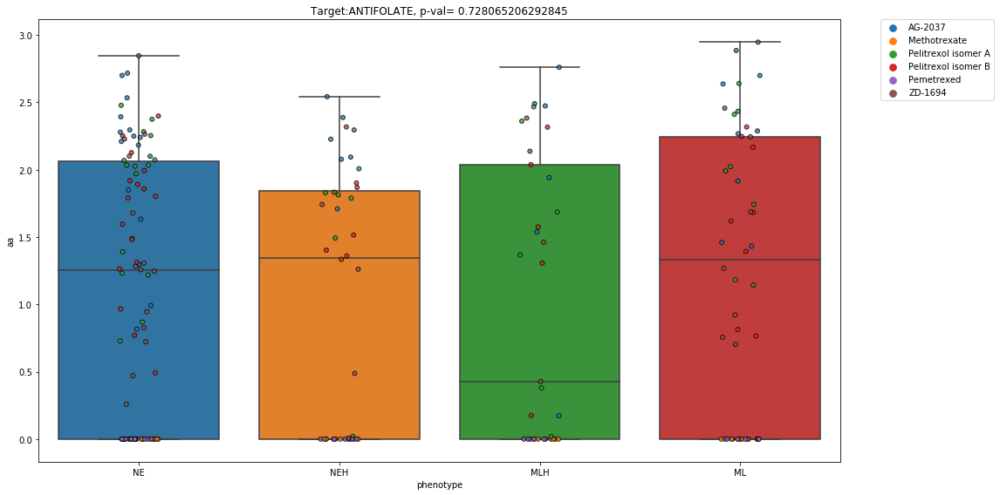

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                   drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    Itraconazole  0.0       MLH     0.0       0.0       0.0
CORL47     Itraconazole  0.0        NE     0.0       0.0       0.0
CORL88     Itraconazole  0.0       MLH     0.0       0.0       0.0
DMS114     Itraconazole  0.0        ML     0.0       0.0       0.0
DMS273     Itraconazole  0.0       NEH     0.0       0.0       0.0
DMS53      Itraconazole  0.0       MLH     0.0       0.0       0.0
DMS79      Itraconazole  0.0        NE     0.0       0.0       0.0
NCIH1048   Itraconazole  0.0        ML     0.0       0.0       0.0
NCIH1092   Itraconazole  0.0        NE     0.0       0.0       0.0
NCIH1105   Itraconazole  0.0        NE     0.0       0.0       0.0
NCIH1341   Itraconazole  0.0        ML     0.0       0.0       0.0
NCIH1436   Itraconazole  0.0        NE     0.0       0.0       0.0
NCIH146    Itraconazole  0.0        NE     0.0       0.0      

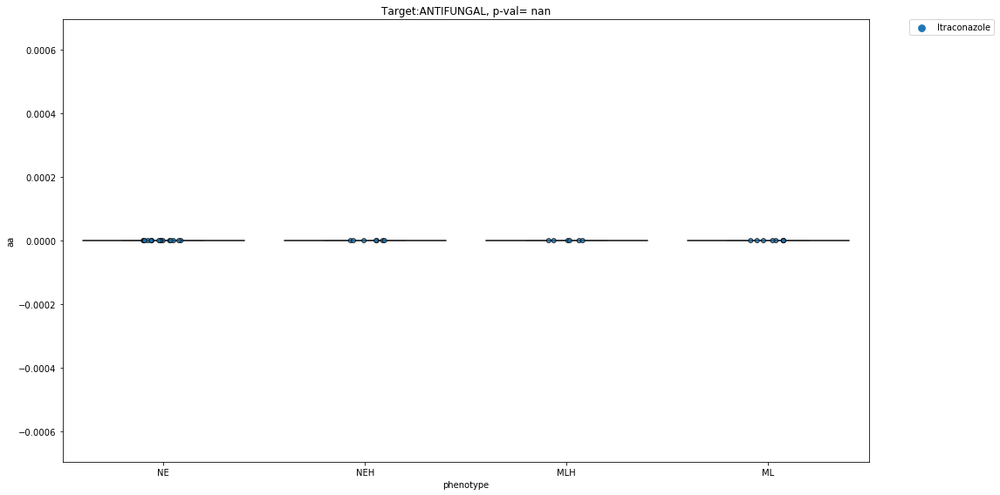

                  drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                 
COLO668        ARN-509  1.988050e-04       MLH     0.0       0.0       0.0
DMS114         ARN-509  6.144712e-02        ML     0.0       0.0       0.0
DMS273         ARN-509  6.625466e-02       NEH     0.0       0.0       0.0
DMS53          ARN-509  1.647833e-01       MLH     0.0       0.0       0.0
DMS79          ARN-509  1.153388e-01        NE     0.0       0.0       0.0
...                ...           ...       ...     ...       ...       ...
NCIH2081   Pipamperone  1.666528e-01        NE     0.0       0.0       0.0
NCIH526    Pipamperone  1.170000e-08       NEH     0.0       0.0       0.0
NCIH841    Pipamperone  2.431179e-01        ML     0.0       0.0       0.0
NCIH889    Pipamperone  9.047373e-02        NE     0.0       0.0       0.0
SW1271     Pipamperone  3.094546e-02        ML     0.0       0.0       0.0

[147 rows x 6 columns]
A

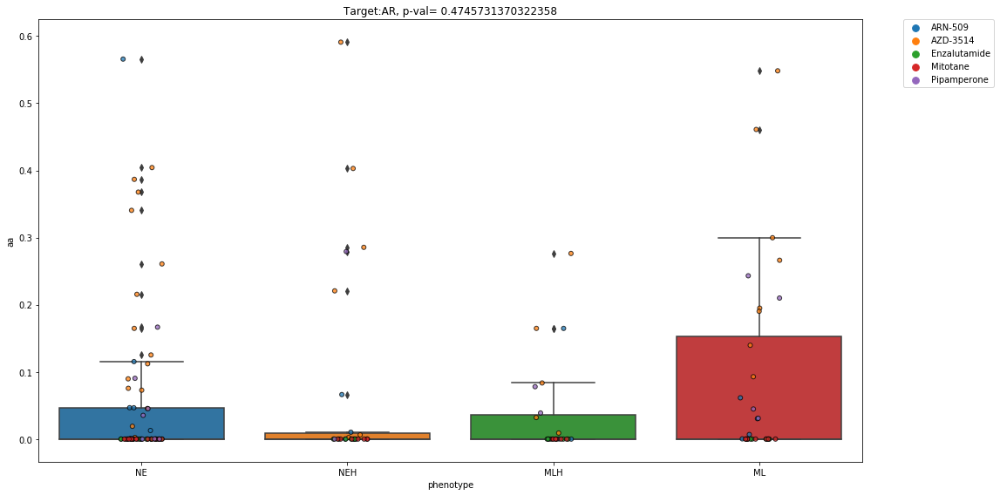

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668    MLN-2480  0.070414       MLH     0.0       0.0       0.0
DMS114     MLN-2480  0.213307        ML     0.0       0.0       0.0
DMS53      MLN-2480  0.015958       MLH     0.0       0.0       0.0
NCIH1436   MLN-2480  0.026697        NE     0.0       0.0       0.0
NCIH1618   MLN-2480  0.000638        NE     0.0       0.0       0.0
NCIH1836   MLN-2480  0.034947        NE     0.0       0.0       0.0
NCIH1876   MLN-2480  0.045288        NE     0.0       0.0       0.0
NCIH196    MLN-2480  0.012905        ML     0.0       0.0       0.0
NCIH211    MLN-2480  0.106070        ML     0.0       0.0       0.0
NCIH2141   MLN-2480  0.010467        NE     0.0       0.0       0.0
NCIH510    MLN-2480  0.034947       MLH     0.0       0.0       0.0
NCIH524    MLN-2480  0.000568       NEH     0.0       0.0       0.0
NCIH69     MLN-2480  0.046777        NE     0.0 

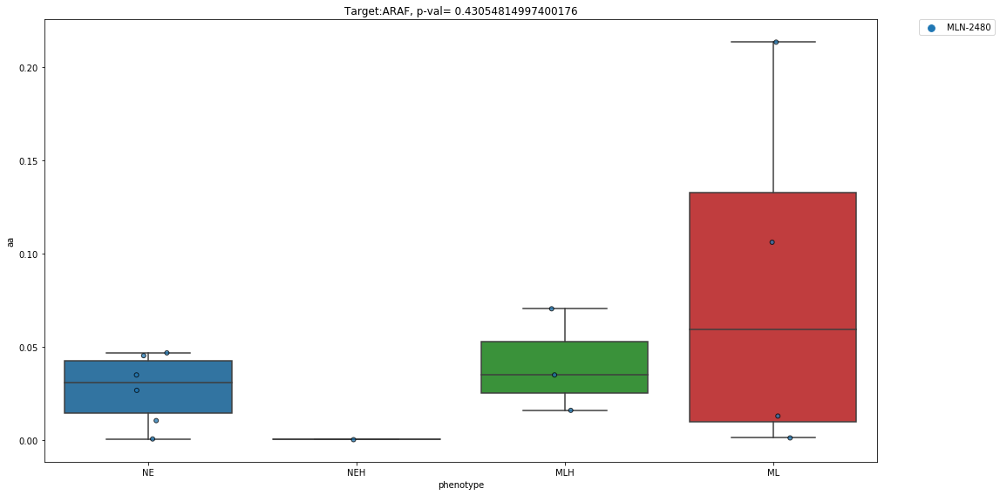

                 drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                            
COLO668        VE-821  0.142057       MLH     0.0       0.0       0.0
CORL47         VE-821  0.121740        NE     0.0       0.0       0.0
DMS114         VE-821  0.098701        ML     0.0       0.0       0.0
DMS273         VE-821  0.305263       NEH     0.0       0.0       0.0
DMS53          VE-821  0.426652       MLH     0.0       0.0       0.0
...               ...       ...       ...     ...       ...       ...
NCIH82     Wortmannin  0.079387       NEH     0.0       0.0       0.0
NCIH841    Wortmannin  0.305053        ML     0.0       0.0       0.0
NCIH889    Wortmannin  0.044679        NE     0.0       0.0       0.0
SHP77      Wortmannin  0.032359       MLH     0.0       0.0       0.0
SW1271     Wortmannin  0.420875        ML     0.0       0.0       0.0

[66 rows x 6 columns]
ATM


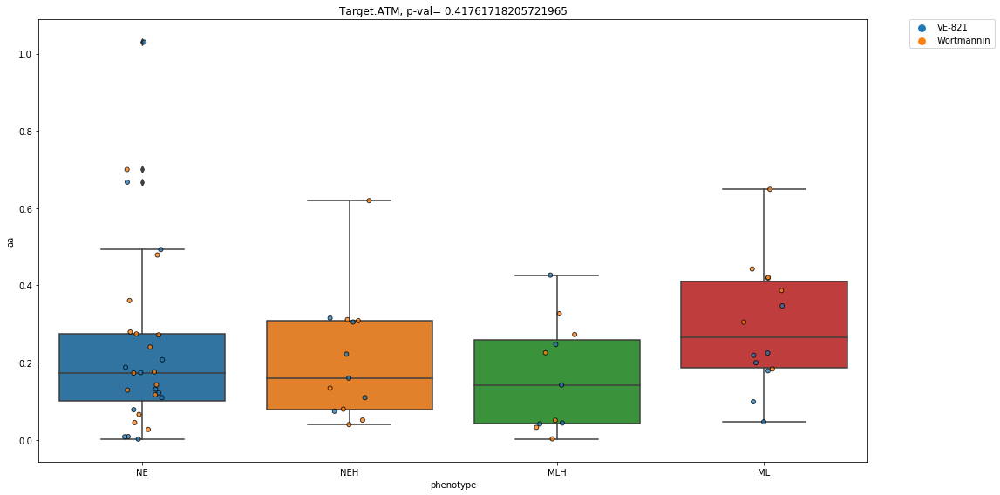

                 drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                            
COLO668        VE-821  0.142057       MLH     0.0       0.0       0.0
CORL47         VE-821  0.121740        NE     0.0       0.0       0.0
DMS114         VE-821  0.098701        ML     0.0       0.0       0.0
DMS273         VE-821  0.305263       NEH     0.0       0.0       0.0
DMS53          VE-821  0.426652       MLH     0.0       0.0       0.0
...               ...       ...       ...     ...       ...       ...
NCIH82     Wortmannin  0.079387       NEH     0.0       0.0       0.0
NCIH841    Wortmannin  0.305053        ML     0.0       0.0       0.0
NCIH889    Wortmannin  0.044679        NE     0.0       0.0       0.0
SHP77      Wortmannin  0.032359       MLH     0.0       0.0       0.0
SW1271     Wortmannin  0.420875        ML     0.0       0.0       0.0

[102 rows x 6 columns]
ATR


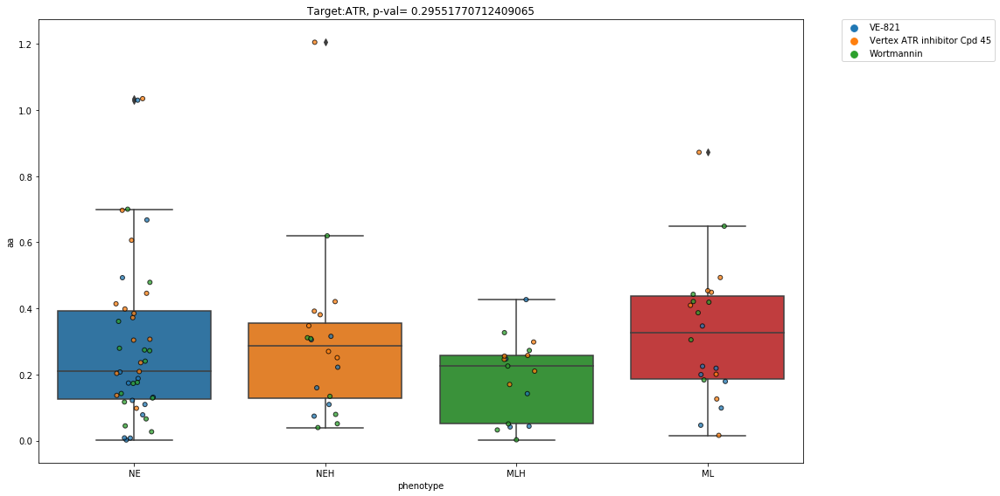

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    ABT-348  0.922358       MLH     0.0       0.0       0.0
CORL47     ABT-348  2.218881        NE     0.0       0.0       0.0
CORL88     ABT-348  0.278810       MLH     0.0       0.0       0.0
DMS114     ABT-348  1.366754        ML     0.0       0.0       0.0
DMS273     ABT-348  1.115654       NEH     0.0       0.0       0.0
...            ...       ...       ...     ...       ...       ...
NCIH82     TAK-901  1.936882       NEH     0.0       0.0       0.0
NCIH841    TAK-901  1.756913        ML     0.0       0.0       0.0
NCIH889    TAK-901  0.287837        NE     0.0       0.0       0.0
SHP77      TAK-901  0.046526       MLH     0.0       0.0       0.0
SW1271     TAK-901  0.626444        ML     0.0       0.0       0.0

[433 rows x 6 columns]
AURKA


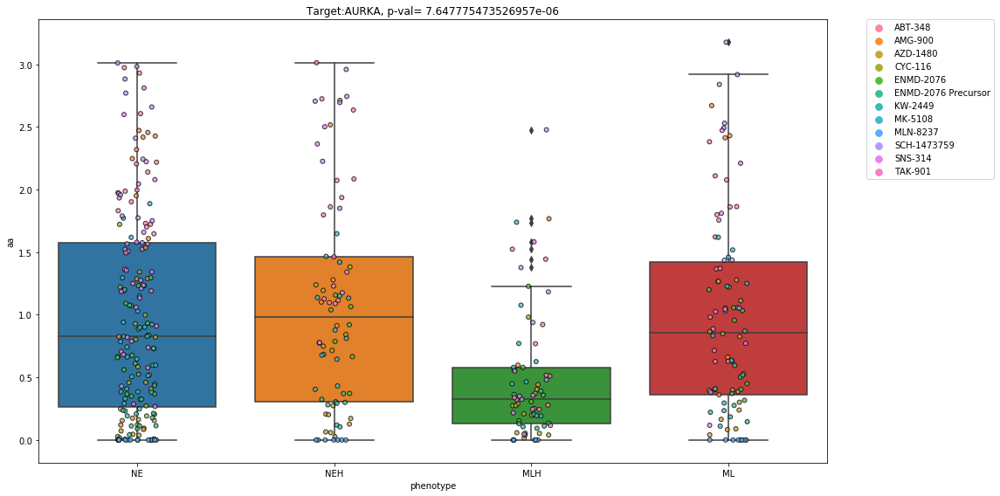

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    ABT-348  0.922358       MLH     0.0       0.0       0.0
CORL47     ABT-348  2.218881        NE     0.0       0.0       0.0
CORL88     ABT-348  0.278810       MLH     0.0       0.0       0.0
DMS114     ABT-348  1.366754        ML     0.0       0.0       0.0
DMS273     ABT-348  1.115654       NEH     0.0       0.0       0.0
...            ...       ...       ...     ...       ...       ...
NCIH82     TAK-901  1.936882       NEH     0.0       0.0       0.0
NCIH841    TAK-901  1.756913        ML     0.0       0.0       0.0
NCIH889    TAK-901  0.287837        NE     0.0       0.0       0.0
SHP77      TAK-901  0.046526       MLH     0.0       0.0       0.0
SW1271     TAK-901  0.626444        ML     0.0       0.0       0.0

[425 rows x 6 columns]
AURKB


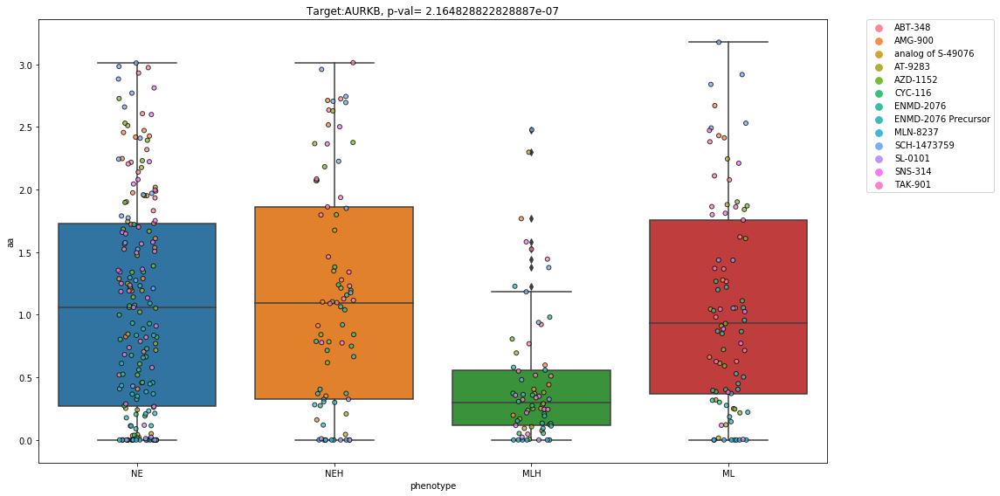

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    ABT-348  0.922358       MLH     0.0       0.0       0.0
CORL47     ABT-348  2.218881        NE     0.0       0.0       0.0
CORL88     ABT-348  0.278810       MLH     0.0       0.0       0.0
DMS114     ABT-348  1.366754        ML     0.0       0.0       0.0
DMS273     ABT-348  1.115654       NEH     0.0       0.0       0.0
...            ...       ...       ...     ...       ...       ...
NCIH82     TAK-901  1.936882       NEH     0.0       0.0       0.0
NCIH841    TAK-901  1.756913        ML     0.0       0.0       0.0
NCIH889    TAK-901  0.287837        NE     0.0       0.0       0.0
SHP77      TAK-901  0.046526       MLH     0.0       0.0       0.0
SW1271     TAK-901  0.626444        ML     0.0       0.0       0.0

[177 rows x 6 columns]
AURKC


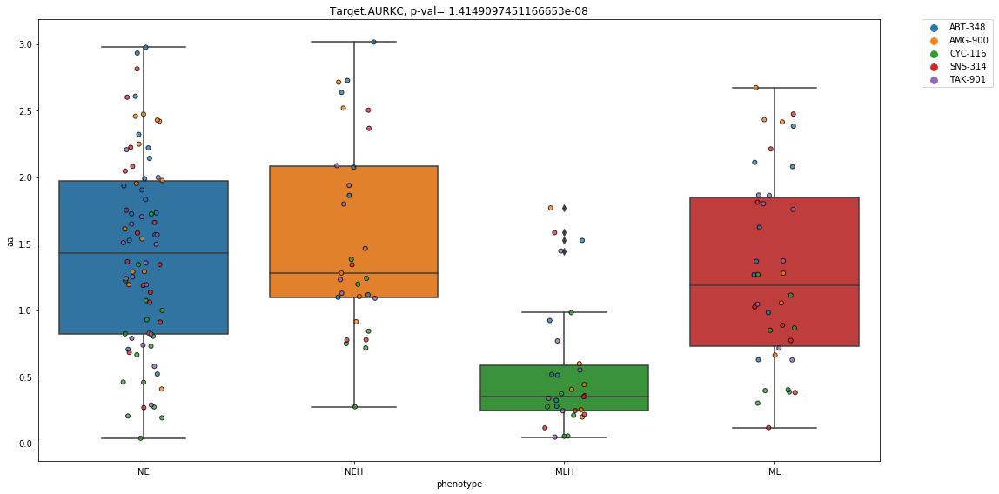

                        drug            aa phenotype  aa_new  hill_new  \
cell.line                                                                
CORL47     analog of S-49076  1.990000e-09        NE     0.0       0.0   
DMS273     analog of S-49076  3.513179e-01       NEH     0.0       0.0   
DMS53      analog of S-49076  9.290914e-02       MLH     0.0       0.0   
NCIH1436   analog of S-49076  2.120000e-11        NE     0.0       0.0   
NCIH1618   analog of S-49076  8.560000e-11        NE     0.0       0.0   
...                      ...           ...       ...     ...       ...   
NCIH69                XL-541  1.500748e-01        NE     0.0       0.0   
NCIH841               XL-541  2.123285e-01        ML     0.0       0.0   
NCIH889               XL-541  1.128845e-03        NE     0.0       0.0   
SHP77                 XL-541  1.110357e-01       MLH     0.0       0.0   
SW1271                XL-541  1.684797e-01        ML     0.0       0.0   

           emax_new  
cell.line      

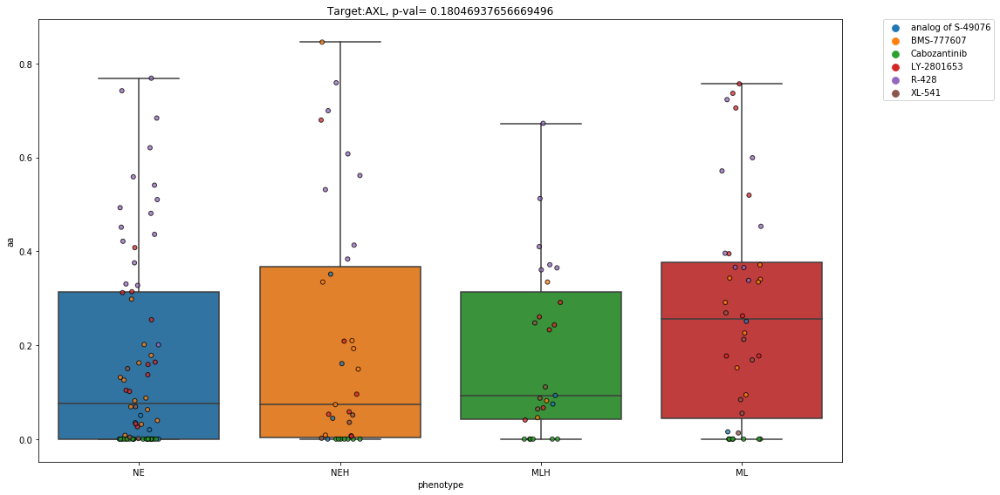

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                   drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    Pralatrexate  0.0       MLH     0.0       0.0       0.0
CORL47     Pralatrexate  0.0        NE     0.0       0.0       0.0
CORL88     Pralatrexate  0.0       MLH     0.0       0.0       0.0
DMS114     Pralatrexate  0.0        ML     0.0       0.0       0.0
DMS273     Pralatrexate  0.0       NEH     0.0       0.0       0.0
DMS53      Pralatrexate  0.0       MLH     0.0       0.0       0.0
DMS79      Pralatrexate  0.0        NE     0.0       0.0       0.0
NCIH1048   Pralatrexate  0.0        ML     0.0       0.0       0.0
NCIH1092   Pralatrexate  0.0        NE     0.0       0.0       0.0
NCIH1105   Pralatrexate  0.0        NE     0.0       0.0       0.0
NCIH1341   Pralatrexate  0.0        ML     0.0       0.0       0.0
NCIH1436   Pralatrexate  0.0        NE     0.0       0.0       0.0
NCIH146    Pralatrexate  0.0        NE     0.0       0.0      

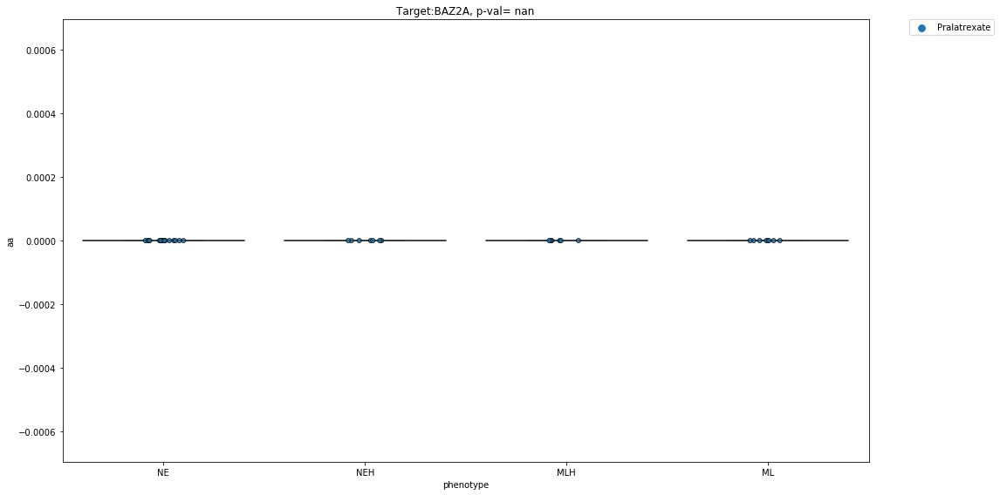

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                   drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    Pralatrexate  0.0       MLH     0.0       0.0       0.0
CORL47     Pralatrexate  0.0        NE     0.0       0.0       0.0
CORL88     Pralatrexate  0.0       MLH     0.0       0.0       0.0
DMS114     Pralatrexate  0.0        ML     0.0       0.0       0.0
DMS273     Pralatrexate  0.0       NEH     0.0       0.0       0.0
DMS53      Pralatrexate  0.0       MLH     0.0       0.0       0.0
DMS79      Pralatrexate  0.0        NE     0.0       0.0       0.0
NCIH1048   Pralatrexate  0.0        ML     0.0       0.0       0.0
NCIH1092   Pralatrexate  0.0        NE     0.0       0.0       0.0
NCIH1105   Pralatrexate  0.0        NE     0.0       0.0       0.0
NCIH1341   Pralatrexate  0.0        ML     0.0       0.0       0.0
NCIH1436   Pralatrexate  0.0        NE     0.0       0.0       0.0
NCIH146    Pralatrexate  0.0        NE     0.0       0.0      

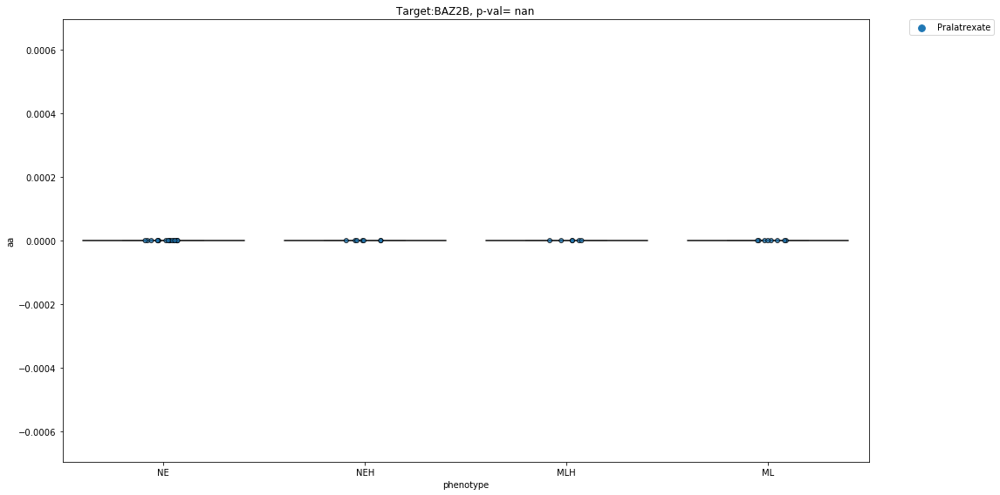

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668     ABT-199  0.218365       MLH     0.0       0.0       0.0
CORL47      ABT-199  0.094482        NE     0.0       0.0       0.0
CORL88      ABT-199  0.314425       MLH     0.0       0.0       0.0
DMS114      ABT-199  0.415065        ML     0.0       0.0       0.0
DMS273      ABT-199  0.008395       NEH     0.0       0.0       0.0
...             ...       ...       ...     ...       ...       ...
NCIH82     GX15-070  1.448552       NEH     0.0       0.0       0.0
NCIH841    GX15-070  2.049954        ML     0.0       0.0       0.0
NCIH889    GX15-070  1.506186        NE     0.0       0.0       0.0
SHP77      GX15-070  1.557948       MLH     0.0       0.0       0.0
SW1271     GX15-070  1.482786        ML     0.0       0.0       0.0

[196 rows x 6 columns]
BCL2


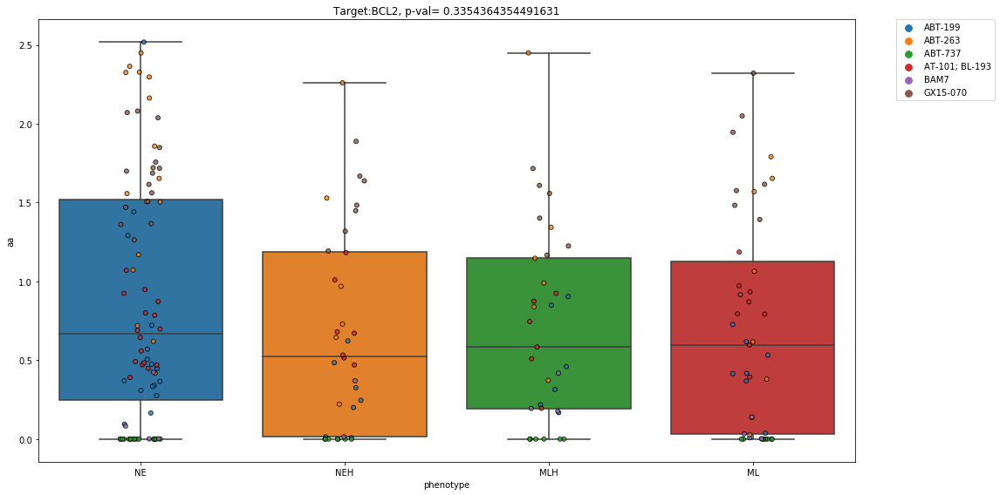

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668     ABT-263  1.147008       MLH     0.0       0.0       0.0
CORL47      ABT-263  1.072160        NE     0.0       0.0       0.0
CORL88      ABT-263  0.989821       MLH     0.0       0.0       0.0
DMS114      ABT-263  0.137412        ML     0.0       0.0       0.0
DMS53       ABT-263  1.343240       MLH     0.0       0.0       0.0
...             ...       ...       ...     ...       ...       ...
NCIH82     ABT-737   0.000000       NEH     0.0       0.0       0.0
NCIH841    ABT-737   0.000000        ML     0.0       0.0       0.0
NCIH889    ABT-737   0.000000        NE     0.0       0.0       0.0
SHP77      ABT-737   0.000000       MLH     0.0       0.0       0.0
SW1271     ABT-737   0.000000        ML     0.0       0.0       0.0

[73 rows x 6 columns]
BCL2L1


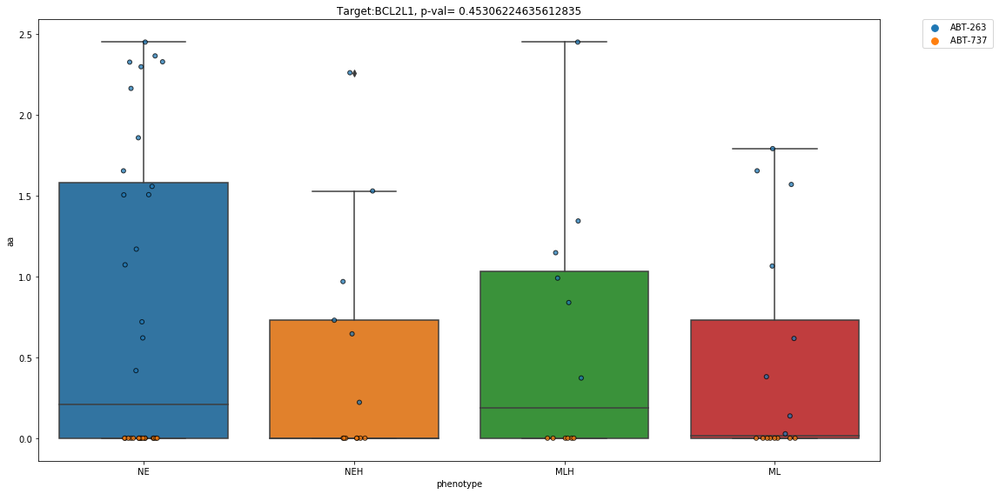

               drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                     
COLO668    ABT-737   0.0       MLH     0.0       0.0       0.0
CORL47     ABT-737   0.0        NE     0.0       0.0       0.0
CORL88     ABT-737   0.0       MLH     0.0       0.0       0.0
DMS114     ABT-737   0.0        ML     0.0       0.0       0.0
DMS273     ABT-737   0.0       NEH     0.0       0.0       0.0
DMS53      ABT-737   0.0       MLH     0.0       0.0       0.0
DMS79      ABT-737   0.0        NE     0.0       0.0       0.0
NCIH1048   ABT-737   0.0        ML     0.0       0.0       0.0
NCIH1092   ABT-737   0.0        NE     0.0       0.0       0.0
NCIH1105   ABT-737   0.0        NE     0.0       0.0       0.0
NCIH1341   ABT-737   0.0        ML     0.0       0.0       0.0
NCIH1436   ABT-737   0.0        NE     0.0       0.0       0.0
NCIH146    ABT-737   0.0        NE     0.0       0.0       0.0
NCIH1618   ABT-737   0.0        NE     0.0       0.0   

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


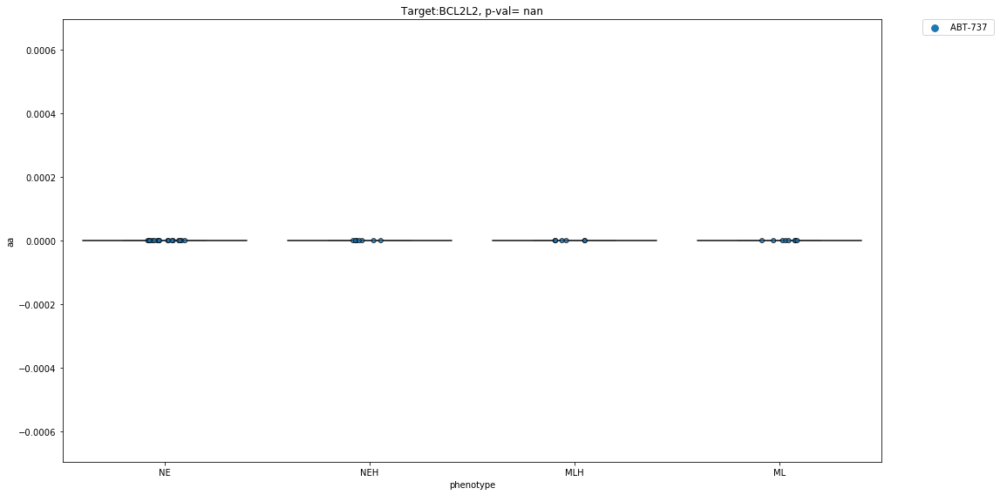

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    ABT-263  1.147008       MLH     0.0       0.0       0.0
CORL47     ABT-263  1.072160        NE     0.0       0.0       0.0
CORL88     ABT-263  0.989821       MLH     0.0       0.0       0.0
DMS114     ABT-263  0.137412        ML     0.0       0.0       0.0
DMS53      ABT-263  1.343240       MLH     0.0       0.0       0.0
DMS79      ABT-263  1.169212        NE     0.0       0.0       0.0
NCIH1048   ABT-263  1.064613        ML     0.0       0.0       0.0
NCIH1092   ABT-263  0.417851        NE     0.0       0.0       0.0
NCIH1105   ABT-263  2.327679        NE     0.0       0.0       0.0
NCIH1341   ABT-263  1.790747        ML     0.0       0.0       0.0
NCIH1436   ABT-263  2.364068        NE     0.0       0.0       0.0
NCIH146    ABT-263  2.163106        NE     0.0       0.0       0.0
NCIH1618   ABT-263  1.857850        NE     0.0       0.0      

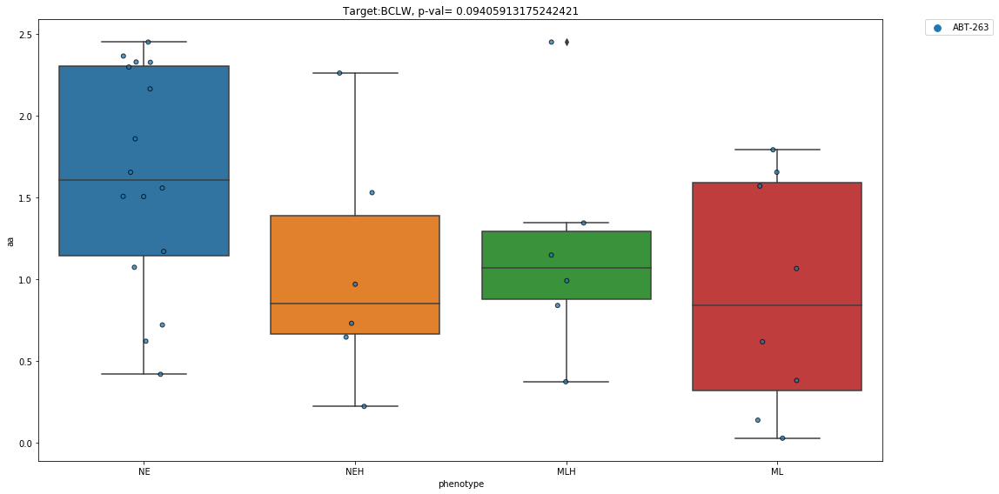

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    ABT-263  1.147008       MLH     0.0       0.0       0.0
CORL47     ABT-263  1.072160        NE     0.0       0.0       0.0
CORL88     ABT-263  0.989821       MLH     0.0       0.0       0.0
DMS114     ABT-263  0.137412        ML     0.0       0.0       0.0
DMS53      ABT-263  1.343240       MLH     0.0       0.0       0.0
DMS79      ABT-263  1.169212        NE     0.0       0.0       0.0
NCIH1048   ABT-263  1.064613        ML     0.0       0.0       0.0
NCIH1092   ABT-263  0.417851        NE     0.0       0.0       0.0
NCIH1105   ABT-263  2.327679        NE     0.0       0.0       0.0
NCIH1341   ABT-263  1.790747        ML     0.0       0.0       0.0
NCIH1436   ABT-263  2.364068        NE     0.0       0.0       0.0
NCIH146    ABT-263  2.163106        NE     0.0       0.0       0.0
NCIH1618   ABT-263  1.857850        NE     0.0       0.0      

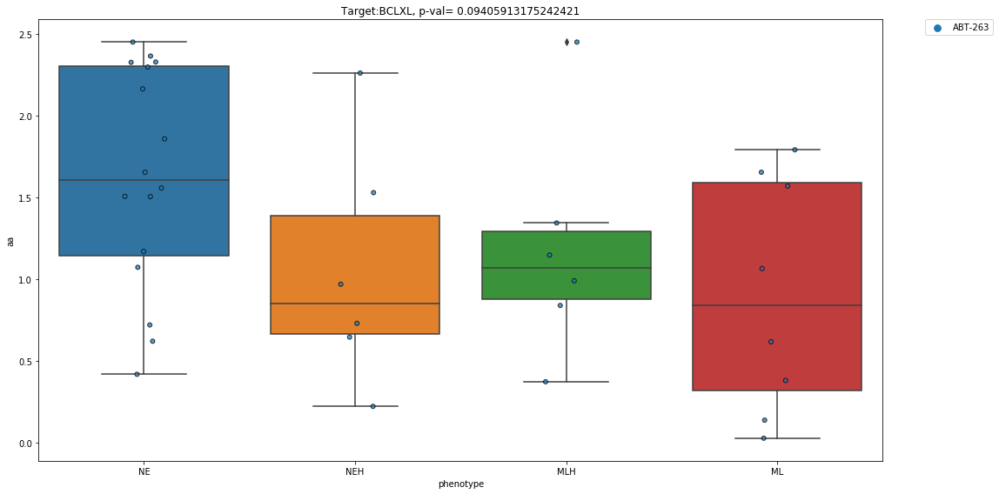

                drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                      
COLO668     Imatinib  0.0       MLH     0.0       0.0       0.0
CORL47      Imatinib  0.0        NE     0.0       0.0       0.0
CORL88      Imatinib  0.0       MLH     0.0       0.0       0.0
DMS114      Imatinib  0.0        ML     0.0       0.0       0.0
DMS273      Imatinib  0.0       NEH     0.0       0.0       0.0
...              ...  ...       ...     ...       ...       ...
NCIH82     Nilotinib  0.0       NEH     0.0       0.0       0.0
NCIH841    Nilotinib  0.0        ML     0.0       0.0       0.0
NCIH889    Nilotinib  0.0        NE     0.0       0.0       0.0
SHP77      Nilotinib  0.0       MLH     0.0       0.0       0.0
SW1271     Nilotinib  0.0        ML     0.0       0.0       0.0

[108 rows x 6 columns]
BCR


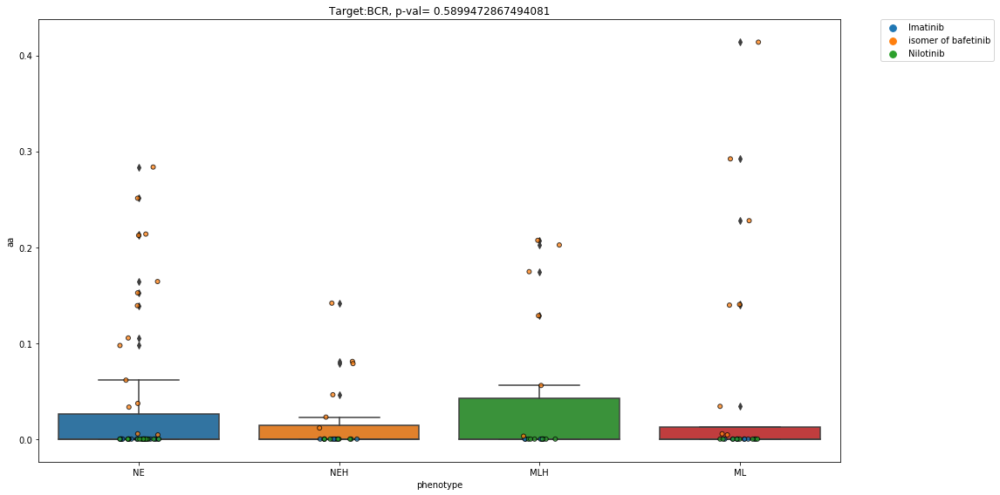

                drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                           
COLO668     AZD-0530  0.133333       MLH     0.0       0.0       0.0
CORL47      AZD-0530  0.313625        NE     0.0       0.0       0.0
CORL88      AZD-0530  0.199410       MLH     0.0       0.0       0.0
DMS114      AZD-0530  0.426735        ML     0.0       0.0       0.0
DMS273      AZD-0530  0.014852       NEH     0.0       0.0       0.0
...              ...       ...       ...     ...       ...       ...
NCIH82     Ponatinib  0.000000       NEH     0.0       0.0       0.0
NCIH841    Ponatinib  0.000000        ML     0.0       0.0       0.0
NCIH889    Ponatinib  0.000000        NE     0.0       0.0       0.0
SHP77      Ponatinib  0.000000       MLH     0.0       0.0       0.0
SW1271     Ponatinib  0.000000        ML     0.0       0.0       0.0

[207 rows x 6 columns]
BCR-ABL


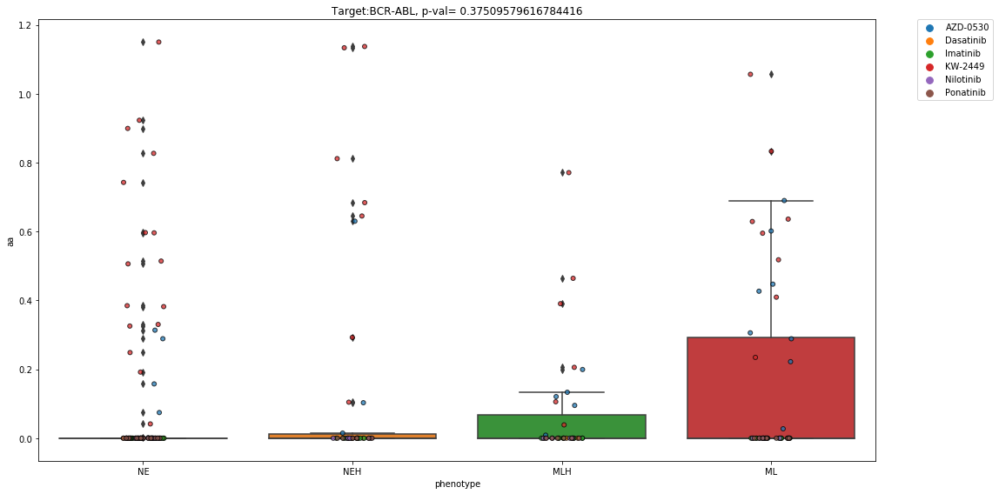

                   drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
COLO668         (+)-JQ1  0.659401       MLH     0.0       0.0       0.0
CORL47          (+)-JQ1  0.548736        NE     0.0       0.0       0.0
CORL88          (+)-JQ1  0.457876       MLH     0.0       0.0       0.0
DMS114          (+)-JQ1  1.776958        ML     0.0       0.0       0.0
DMS273          (+)-JQ1  1.207226       NEH     0.0       0.0       0.0
...                 ...       ...       ...     ...       ...       ...
NCIH82     GSK-1210151A  0.260189       NEH     0.0       0.0       0.0
NCIH841    GSK-1210151A  0.503161        ML     0.0       0.0       0.0
NCIH889    GSK-1210151A  0.141184        NE     0.0       0.0       0.0
SHP77      GSK-1210151A  0.462099       MLH     0.0       0.0       0.0
SW1271     GSK-1210151A  1.309916        ML     0.0       0.0       0.0

[107 rows x 6 columns]
BET


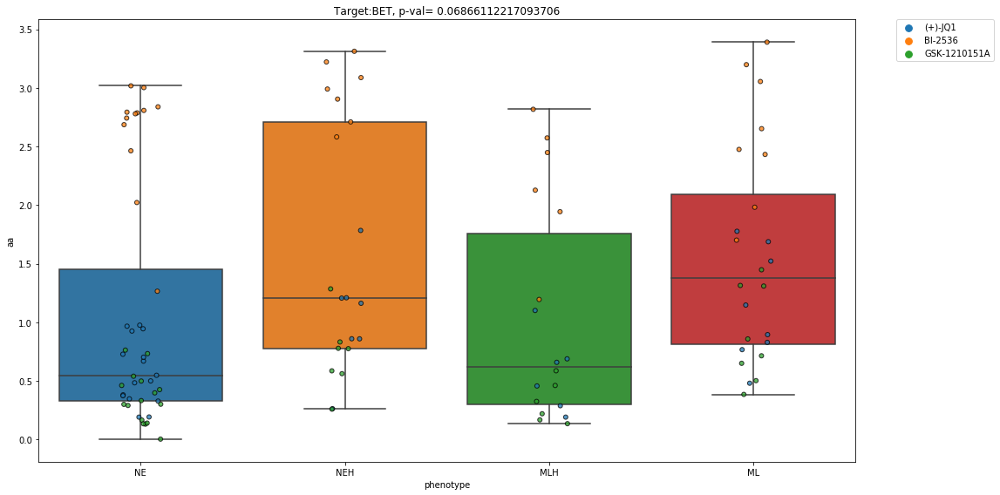

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668     ICG-001  0.189833       MLH     0.0       0.0       0.0
CORL47      ICG-001  0.191592        NE     0.0       0.0       0.0
CORL88      ICG-001  0.288807       MLH     0.0       0.0       0.0
DMS114      ICG-001  0.372694        ML     0.0       0.0       0.0
DMS273      ICG-001  0.015195       NEH     0.0       0.0       0.0
...             ...       ...       ...     ...       ...       ...
NCIH82     XAV-939   0.000000       NEH     0.0       0.0       0.0
NCIH841    XAV-939   0.000000        ML     0.0       0.0       0.0
NCIH889    XAV-939   0.000000        NE     0.0       0.0       0.0
SHP77      XAV-939   0.000000       MLH     0.0       0.0       0.0
SW1271     XAV-939   0.000000        ML     0.0       0.0       0.0

[120 rows x 6 columns]
BETA-CATENIN


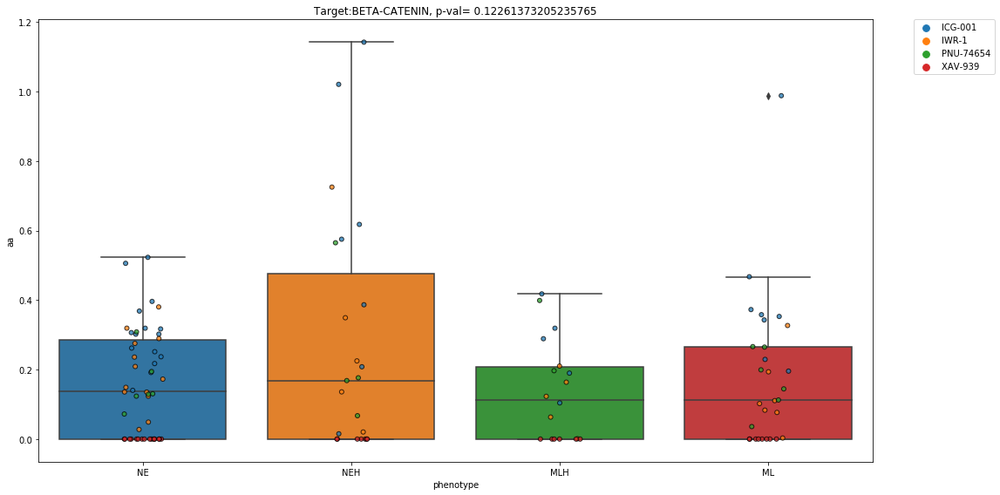

                   drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    Lenalidomide  0.0       MLH     0.0       0.0       0.0
CORL47     Lenalidomide  0.0        NE     0.0       0.0       0.0
CORL88     Lenalidomide  0.0       MLH     0.0       0.0       0.0
DMS114     Lenalidomide  0.0        ML     0.0       0.0       0.0
DMS273     Lenalidomide  0.0       NEH     0.0       0.0       0.0
DMS53      Lenalidomide  0.0       MLH     0.0       0.0       0.0
DMS79      Lenalidomide  0.0        NE     0.0       0.0       0.0
NCIH1048   Lenalidomide  0.0        ML     0.0       0.0       0.0
NCIH1092   Lenalidomide  0.0        NE     0.0       0.0       0.0
NCIH1105   Lenalidomide  0.0        NE     0.0       0.0       0.0
NCIH1341   Lenalidomide  0.0        ML     0.0       0.0       0.0
NCIH1436   Lenalidomide  0.0        NE     0.0       0.0       0.0
NCIH146    Lenalidomide  0.0        NE     0.0       0.0      

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


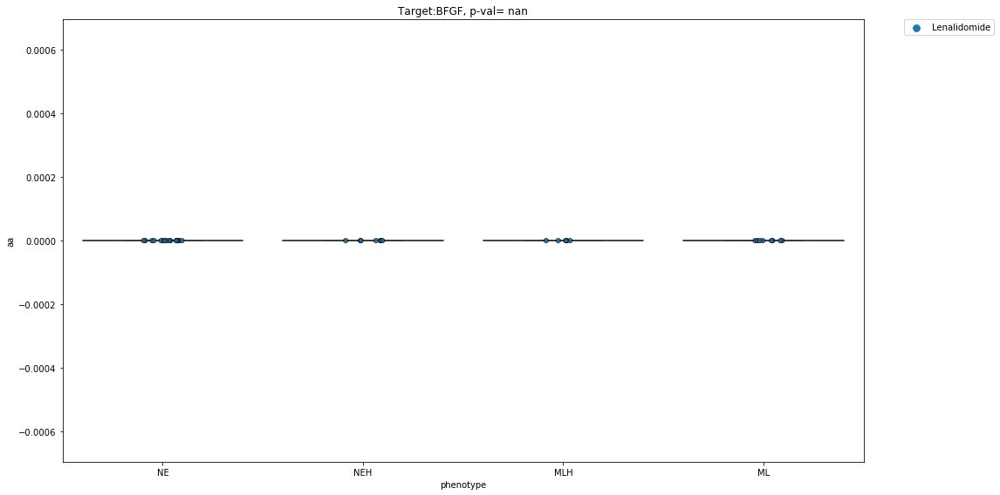

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668    SR-13654  0.379566       MLH     0.0       0.0       0.0
CORL47     SR-13654  0.013494        NE     0.0       0.0       0.0
CORL88     SR-13654  0.275591       MLH     0.0       0.0       0.0
DMS114     SR-13654  0.161260        ML     0.0       0.0       0.0
DMS273     SR-13654  0.652525       NEH     0.0       0.0       0.0
...             ...       ...       ...     ...       ...       ...
NCIH82       YM-155  3.316149       NEH     0.0       0.0       0.0
NCIH841      YM-155  3.325351        ML     0.0       0.0       0.0
NCIH889      YM-155  2.281223        NE     0.0       0.0       0.0
SHP77        YM-155  0.879045       MLH     0.0       0.0       0.0
SW1271       YM-155  2.653783        ML     0.0       0.0       0.0

[67 rows x 6 columns]
BIRC5


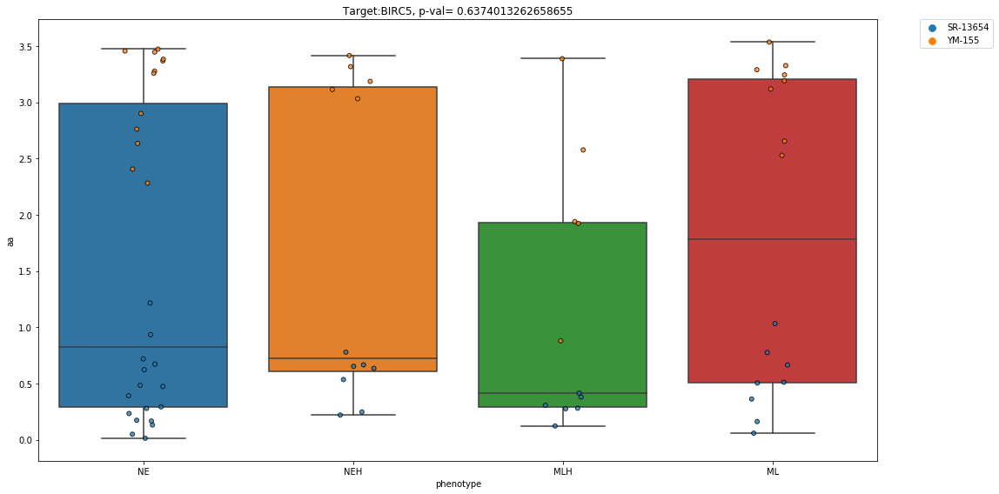

                       drug            aa phenotype  aa_new  hill_new  \
cell.line                                                               
COLO668             MK-0822  1.958904e-02       MLH     0.0       0.0   
CORL47              MK-0822  1.208089e-01        NE     0.0       0.0   
DMS114              MK-0822  3.251313e-01        ML     0.0       0.0   
DMS53               MK-0822  4.680790e-04       MLH     0.0       0.0   
NCIH1048            MK-0822  2.917688e-03        ML     0.0       0.0   
NCIH1092            MK-0822  1.138844e-03        NE     0.0       0.0   
NCIH1836            MK-0822  7.075022e-03        NE     0.0       0.0   
NCIH1876            MK-0822  1.964801e-01        NE     0.0       0.0   
NCIH1930            MK-0822  8.296680e-02        NE     0.0       0.0   
NCIH2066            MK-0822  1.121459e-01        ML     0.0       0.0   
NCIH2081            MK-0822  6.266174e-03        NE     0.0       0.0   
NCIH209             MK-0822  1.186079e-01        NE

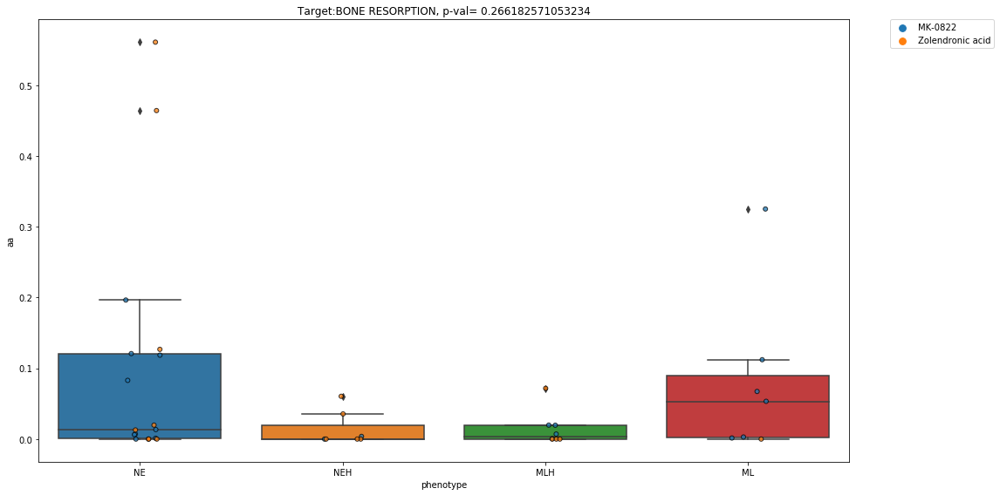

                  drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668        ARQ-680  0.006815       MLH     0.0       0.0       0.0
DMS273         ARQ-680  0.142786       NEH     0.0       0.0       0.0
DMS53          ARQ-680  0.302961       MLH     0.0       0.0       0.0
NCIH1048       ARQ-680  0.009872        ML     0.0       0.0       0.0
NCIH1694       ARQ-680  0.198550       NEH     0.0       0.0       0.0
...                ...       ...       ...     ...       ...       ...
NCIH82     Vemurafenib  0.000000       NEH     0.0       0.0       0.0
NCIH841    Vemurafenib  0.000000        ML     0.0       0.0       0.0
NCIH889    Vemurafenib  0.000000        NE     0.0       0.0       0.0
SHP77      Vemurafenib  0.000000       MLH     0.0       0.0       0.0
SW1271     Vemurafenib  0.000000        ML     0.0       0.0       0.0

[260 rows x 6 columns]
BRAF


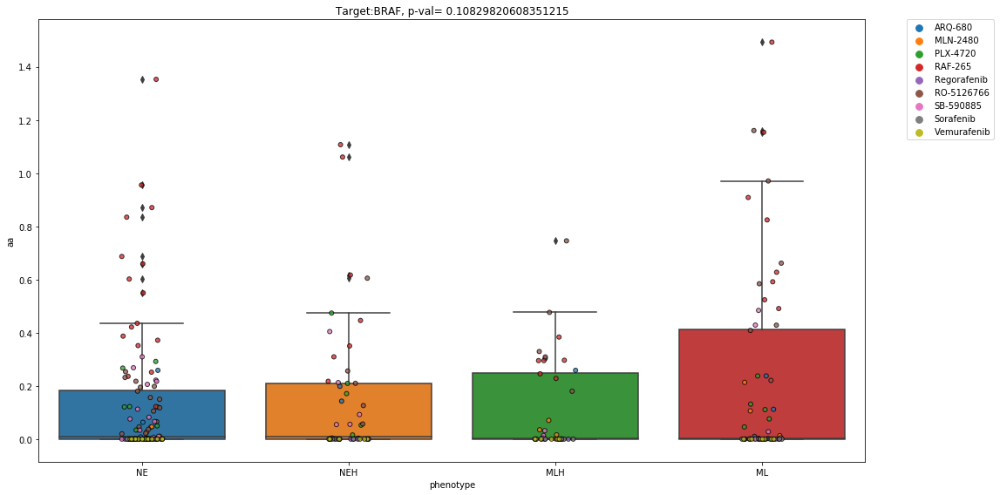

                   drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
COLO668         (+)-JQ1  0.659401       MLH     0.0       0.0       0.0
CORL47          (+)-JQ1  0.548736        NE     0.0       0.0       0.0
CORL88          (+)-JQ1  0.457876       MLH     0.0       0.0       0.0
DMS114          (+)-JQ1  1.776958        ML     0.0       0.0       0.0
DMS273          (+)-JQ1  1.207226       NEH     0.0       0.0       0.0
...                 ...       ...       ...     ...       ...       ...
NCIH82     GSK-1210151A  0.260189       NEH     0.0       0.0       0.0
NCIH841    GSK-1210151A  0.503161        ML     0.0       0.0       0.0
NCIH889    GSK-1210151A  0.141184        NE     0.0       0.0       0.0
SHP77      GSK-1210151A  0.462099       MLH     0.0       0.0       0.0
SW1271     GSK-1210151A  1.309916        ML     0.0       0.0       0.0

[74 rows x 6 columns]
BRD2


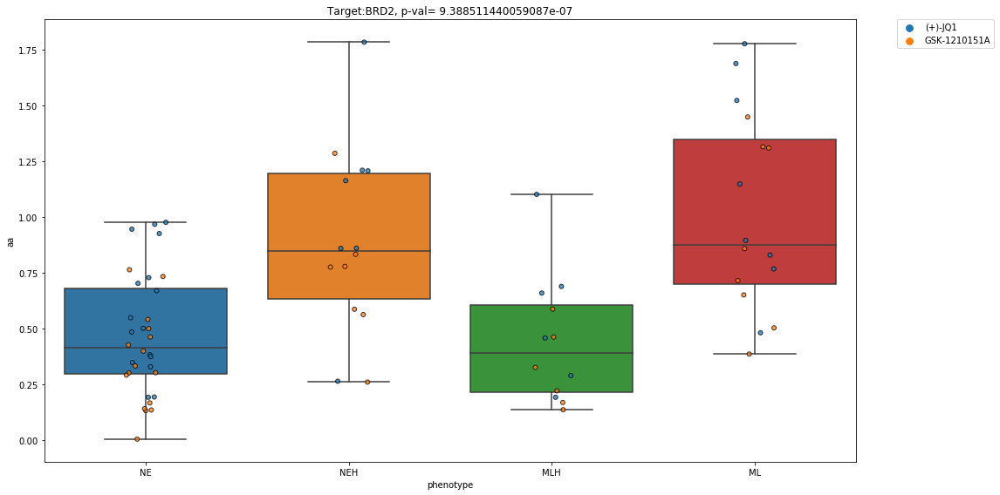

                   drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
COLO668         (+)-JQ1  0.659401       MLH     0.0       0.0       0.0
CORL47          (+)-JQ1  0.548736        NE     0.0       0.0       0.0
CORL88          (+)-JQ1  0.457876       MLH     0.0       0.0       0.0
DMS114          (+)-JQ1  1.776958        ML     0.0       0.0       0.0
DMS273          (+)-JQ1  1.207226       NEH     0.0       0.0       0.0
...                 ...       ...       ...     ...       ...       ...
NCIH82     GSK-1210151A  0.260189       NEH     0.0       0.0       0.0
NCIH841    GSK-1210151A  0.503161        ML     0.0       0.0       0.0
NCIH889    GSK-1210151A  0.141184        NE     0.0       0.0       0.0
SHP77      GSK-1210151A  0.462099       MLH     0.0       0.0       0.0
SW1271     GSK-1210151A  1.309916        ML     0.0       0.0       0.0

[74 rows x 6 columns]
BRD3


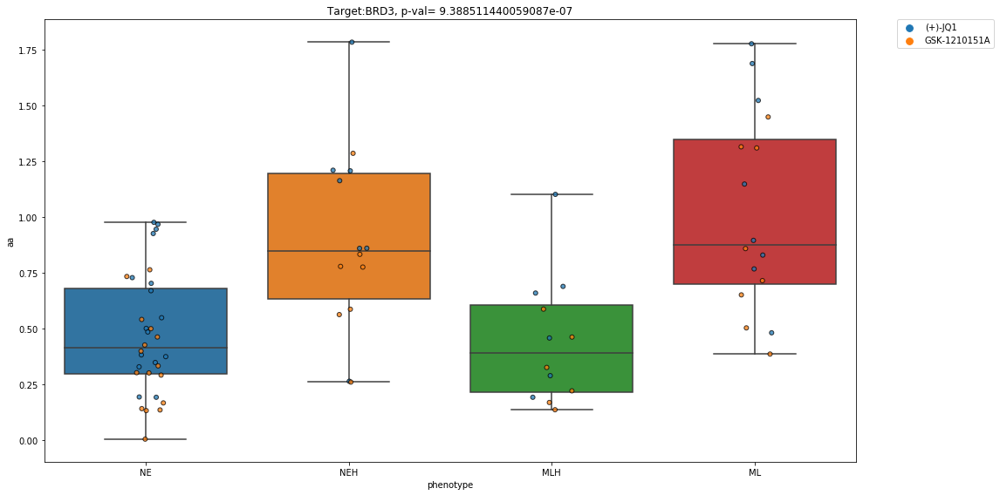

                   drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
COLO668         (+)-JQ1  0.659401       MLH     0.0       0.0       0.0
CORL47          (+)-JQ1  0.548736        NE     0.0       0.0       0.0
CORL88          (+)-JQ1  0.457876       MLH     0.0       0.0       0.0
DMS114          (+)-JQ1  1.776958        ML     0.0       0.0       0.0
DMS273          (+)-JQ1  1.207226       NEH     0.0       0.0       0.0
...                 ...       ...       ...     ...       ...       ...
NCIH82     GSK-1210151A  0.260189       NEH     0.0       0.0       0.0
NCIH841    GSK-1210151A  0.503161        ML     0.0       0.0       0.0
NCIH889    GSK-1210151A  0.141184        NE     0.0       0.0       0.0
SHP77      GSK-1210151A  0.462099       MLH     0.0       0.0       0.0
SW1271     GSK-1210151A  1.309916        ML     0.0       0.0       0.0

[74 rows x 6 columns]
BRD4


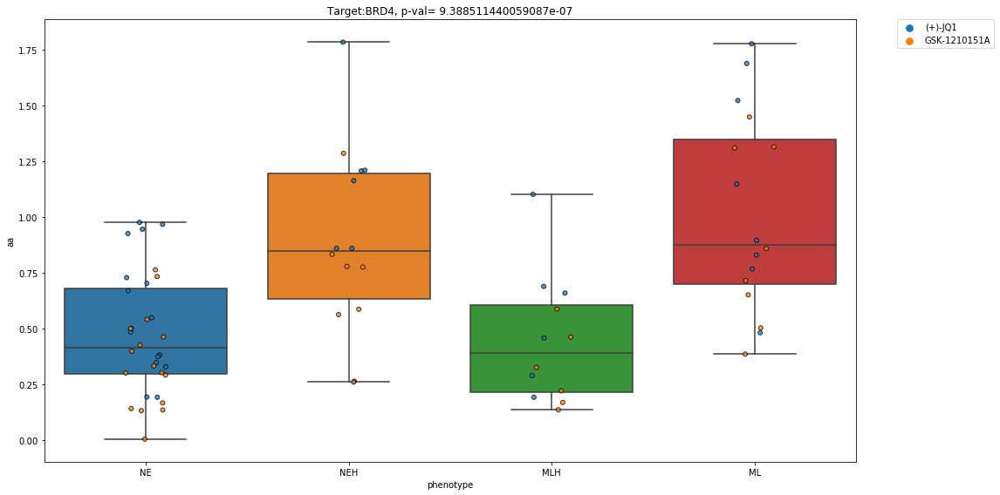

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    (+)-JQ1  0.659401       MLH     0.0       0.0       0.0
CORL47     (+)-JQ1  0.548736        NE     0.0       0.0       0.0
CORL88     (+)-JQ1  0.457876       MLH     0.0       0.0       0.0
DMS114     (+)-JQ1  1.776958        ML     0.0       0.0       0.0
DMS273     (+)-JQ1  1.207226       NEH     0.0       0.0       0.0
DMS53      (+)-JQ1  1.101813       MLH     0.0       0.0       0.0
DMS79      (+)-JQ1  0.500832        NE     0.0       0.0       0.0
NCIH1048   (+)-JQ1  0.767603        ML     0.0       0.0       0.0
NCIH1092   (+)-JQ1  0.193415        NE     0.0       0.0       0.0
NCIH1105   (+)-JQ1  0.484873        NE     0.0       0.0       0.0
NCIH1341   (+)-JQ1  0.895487        ML     0.0       0.0       0.0
NCIH1436   (+)-JQ1  0.728498        NE     0.0       0.0       0.0
NCIH146    (+)-JQ1  0.382184        NE     0.0       0.0      

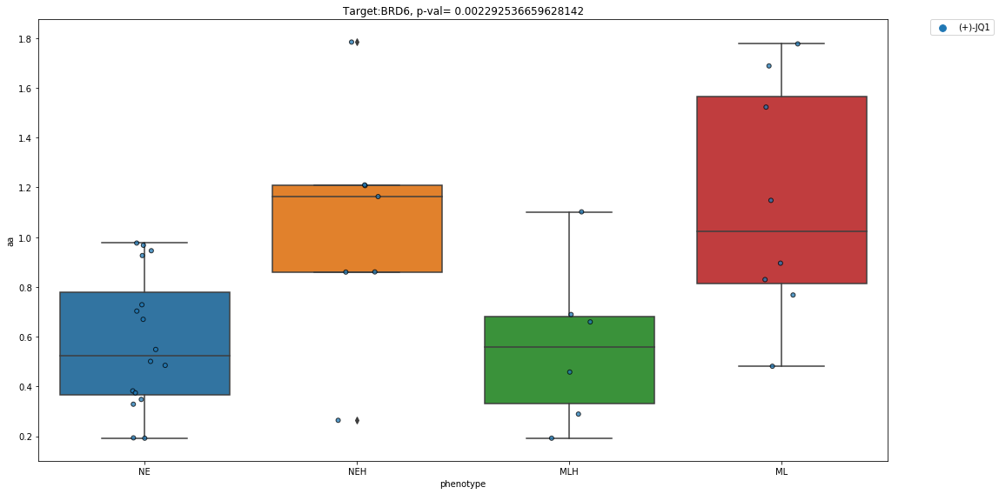

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                      
COLO668    Ibrutinib  0.0       MLH     0.0       0.0       0.0
CORL47     Ibrutinib  0.0        NE     0.0       0.0       0.0
CORL88     Ibrutinib  0.0       MLH     0.0       0.0       0.0
DMS114     Ibrutinib  0.0        ML     0.0       0.0       0.0
DMS273     Ibrutinib  0.0       NEH     0.0       0.0       0.0
DMS53      Ibrutinib  0.0       MLH     0.0       0.0       0.0
DMS79      Ibrutinib  0.0        NE     0.0       0.0       0.0
NCIH1048   Ibrutinib  0.0        ML     0.0       0.0       0.0
NCIH1092   Ibrutinib  0.0        NE     0.0       0.0       0.0
NCIH1105   Ibrutinib  0.0        NE     0.0       0.0       0.0
NCIH1341   Ibrutinib  0.0        ML     0.0       0.0       0.0
NCIH1436   Ibrutinib  0.0        NE     0.0       0.0       0.0
NCIH146    Ibrutinib  0.0        NE     0.0       0.0       0.0
NCIH1618   Ibrutinib  0.0        NE     

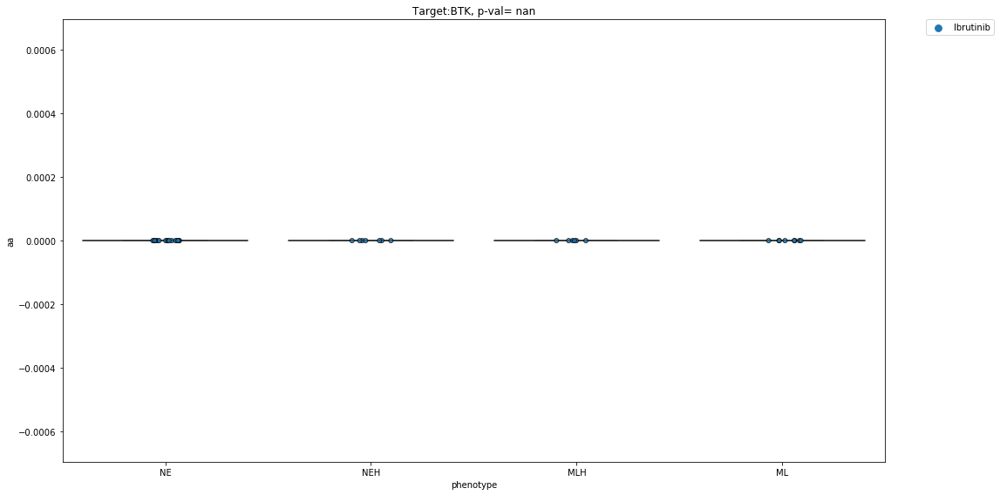

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


               drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                     
COLO668    OSI-930   0.0       MLH     0.0       0.0       0.0
CORL47     OSI-930   0.0        NE     0.0       0.0       0.0
CORL88     OSI-930   0.0       MLH     0.0       0.0       0.0
DMS114     OSI-930   0.0        ML     0.0       0.0       0.0
DMS273     OSI-930   0.0       NEH     0.0       0.0       0.0
DMS53      OSI-930   0.0       MLH     0.0       0.0       0.0
DMS79      OSI-930   0.0        NE     0.0       0.0       0.0
NCIH1048   OSI-930   0.0        ML     0.0       0.0       0.0
NCIH1092   OSI-930   0.0        NE     0.0       0.0       0.0
NCIH1105   OSI-930   0.0        NE     0.0       0.0       0.0
NCIH1341   OSI-930   0.0        ML     0.0       0.0       0.0
NCIH1436   OSI-930   0.0        NE     0.0       0.0       0.0
NCIH146    OSI-930   0.0        NE     0.0       0.0       0.0
NCIH1618   OSI-930   0.0        NE     0.0       0.0   

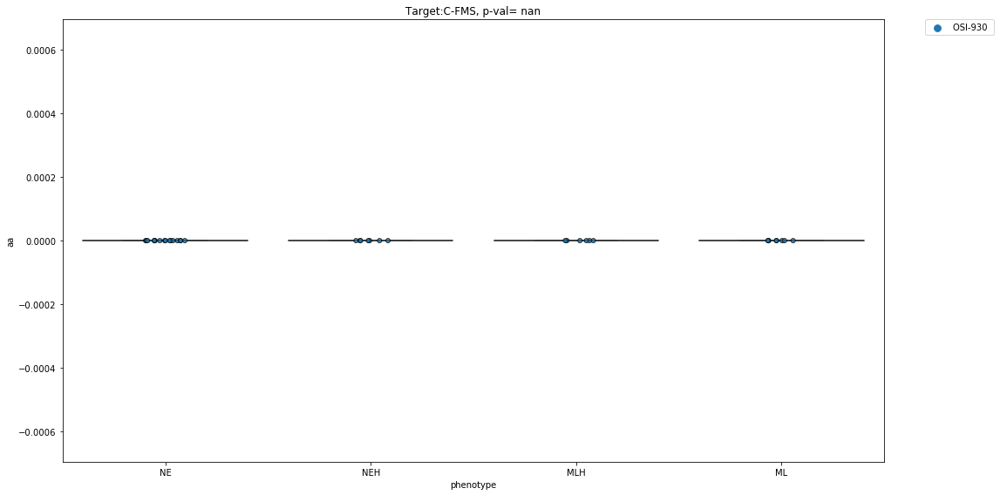

                  drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
DMS114         AMG-706  0.139837        ML     0.0       0.0       0.0
DMS273         AMG-706  0.168911       NEH     0.0       0.0       0.0
DMS53          AMG-706  0.246281       MLH     0.0       0.0       0.0
NCIH1048       AMG-706  0.103611        ML     0.0       0.0       0.0
NCIH1105       AMG-706  0.016054        NE     0.0       0.0       0.0
...                ...       ...       ...     ...       ...       ...
NCIH82     Regorafenib  0.000000       NEH     0.0       0.0       0.0
NCIH841    Regorafenib  0.000000        ML     0.0       0.0       0.0
NCIH889    Regorafenib  0.000000        NE     0.0       0.0       0.0
SHP77      Regorafenib  0.000000       MLH     0.0       0.0       0.0
SW1271     Regorafenib  0.000000        ML     0.0       0.0       0.0

[355 rows x 6 columns]
C-KIT


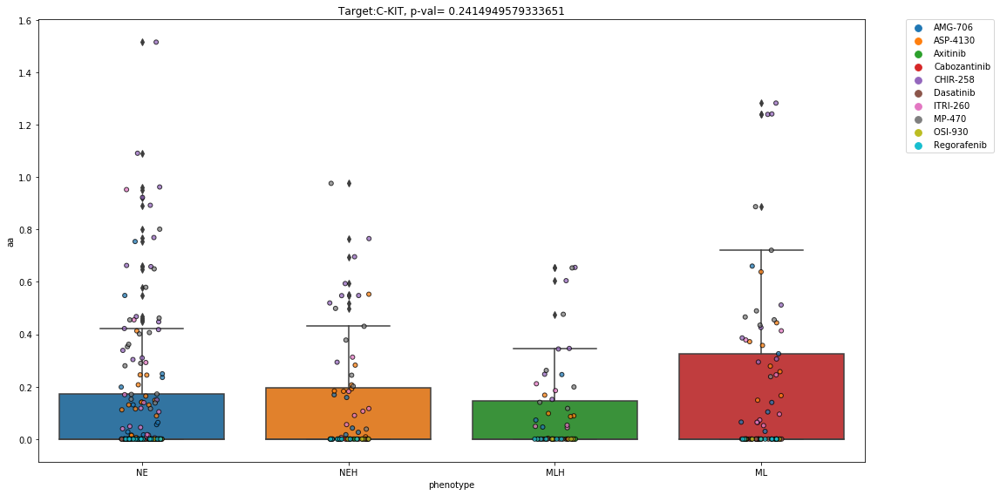

                 drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                       
COLO668    Tacrolimus  0.0       MLH     0.0       0.0       0.0
CORL47     Tacrolimus  0.0        NE     0.0       0.0       0.0
CORL88     Tacrolimus  0.0       MLH     0.0       0.0       0.0
DMS114     Tacrolimus  0.0        ML     0.0       0.0       0.0
DMS273     Tacrolimus  0.0       NEH     0.0       0.0       0.0
DMS53      Tacrolimus  0.0       MLH     0.0       0.0       0.0
DMS79      Tacrolimus  0.0        NE     0.0       0.0       0.0
NCIH1048   Tacrolimus  0.0        ML     0.0       0.0       0.0
NCIH1092   Tacrolimus  0.0        NE     0.0       0.0       0.0
NCIH1105   Tacrolimus  0.0        NE     0.0       0.0       0.0
NCIH1341   Tacrolimus  0.0        ML     0.0       0.0       0.0
NCIH1436   Tacrolimus  0.0        NE     0.0       0.0       0.0
NCIH146    Tacrolimus  0.0        NE     0.0       0.0       0.0
NCIH1618   Tacrolimus  0.

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


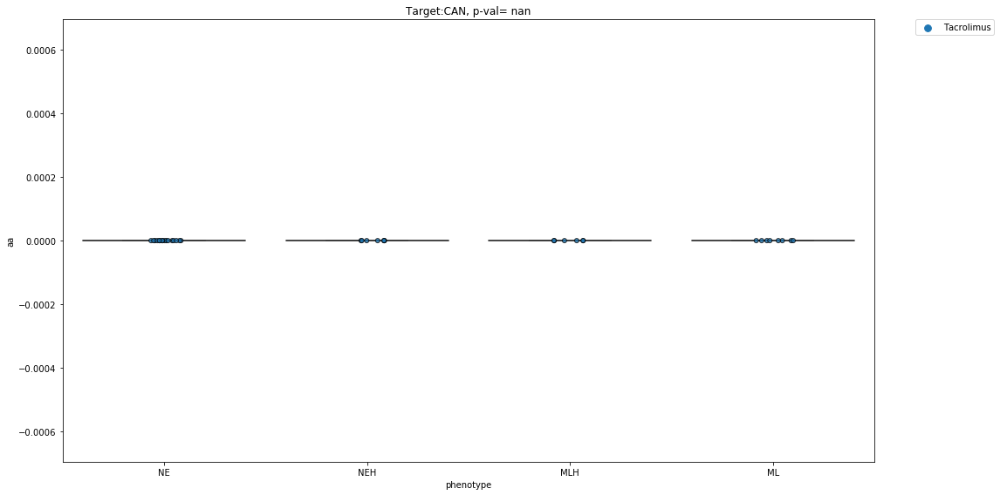

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                       drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668    Arsenic Trioxide  0.0       MLH     0.0       0.0       0.0
CORL47     Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
CORL88     Arsenic Trioxide  0.0       MLH     0.0       0.0       0.0
DMS114     Arsenic Trioxide  0.0        ML     0.0       0.0       0.0
DMS273     Arsenic Trioxide  0.0       NEH     0.0       0.0       0.0
DMS53      Arsenic Trioxide  0.0       MLH     0.0       0.0       0.0
DMS79      Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
NCIH1048   Arsenic Trioxide  0.0        ML     0.0       0.0       0.0
NCIH1092   Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
NCIH1105   Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
NCIH1341   Arsenic Trioxide  0.0        ML     0.0       0.0       0.0
NCIH1436   Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
NCIH14

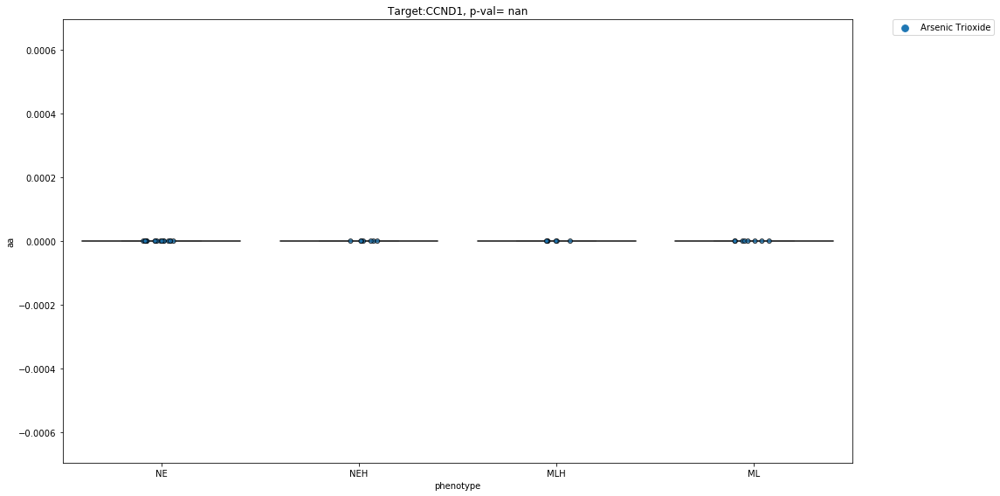

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                      
COLO668    Celecoxib  0.0       MLH     0.0       0.0       0.0
CORL47     Celecoxib  0.0        NE     0.0       0.0       0.0
CORL88     Celecoxib  0.0       MLH     0.0       0.0       0.0
DMS114     Celecoxib  0.0        ML     0.0       0.0       0.0
DMS273     Celecoxib  0.0       NEH     0.0       0.0       0.0
DMS53      Celecoxib  0.0       MLH     0.0       0.0       0.0
DMS79      Celecoxib  0.0        NE     0.0       0.0       0.0
NCIH1048   Celecoxib  0.0        ML     0.0       0.0       0.0
NCIH1092   Celecoxib  0.0        NE     0.0       0.0       0.0
NCIH1105   Celecoxib  0.0        NE     0.0       0.0       0.0
NCIH1341   Celecoxib  0.0        ML     0.0       0.0       0.0
NCIH1436   Celecoxib  0.0        NE     0.0       0.0       0.0
NCIH146    Celecoxib  0.0        NE     0.0       0.0       0.0
NCIH1618   Celecoxib  0.0        NE     

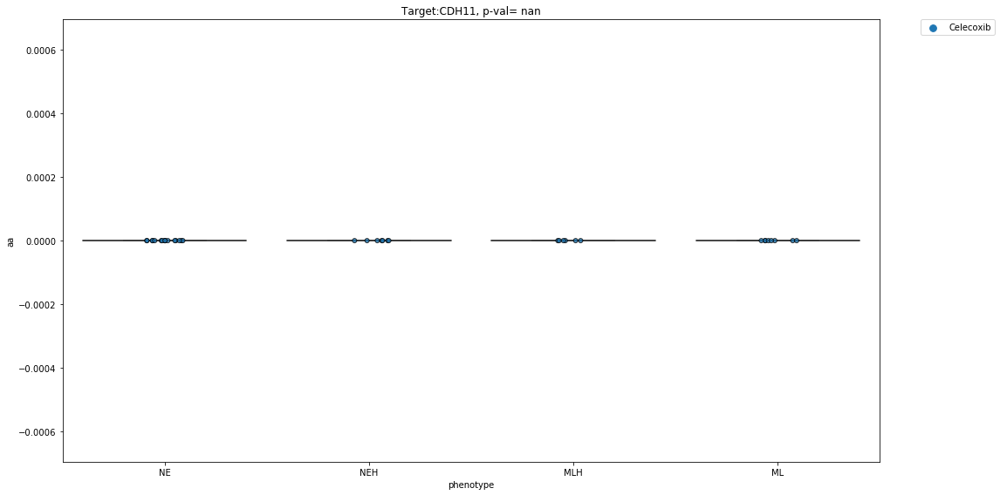

               drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
CORL88     10058-F4  4.380990e-03       MLH     0.0       0.0       0.0
DMS114     10058-F4  1.404092e-01        ML     0.0       0.0       0.0
DMS273     10058-F4  8.990000e-10       NEH     0.0       0.0       0.0
DMS53      10058-F4  2.580304e-02       MLH     0.0       0.0       0.0
NCIH1048   10058-F4  1.706178e-02        ML     0.0       0.0       0.0
...             ...           ...       ...     ...       ...       ...
NCIH82      SB-1317  1.896007e+00       NEH     0.0       0.0       0.0
NCIH841     SB-1317  1.960173e+00        ML     0.0       0.0       0.0
NCIH889     SB-1317  1.326121e+00        NE     0.0       0.0       0.0
SHP77       SB-1317  1.804953e+00       MLH     0.0       0.0       0.0
SW1271      SB-1317  2.246958e+00        ML     0.0       0.0       0.0

[337 rows x 6 columns]
CDK


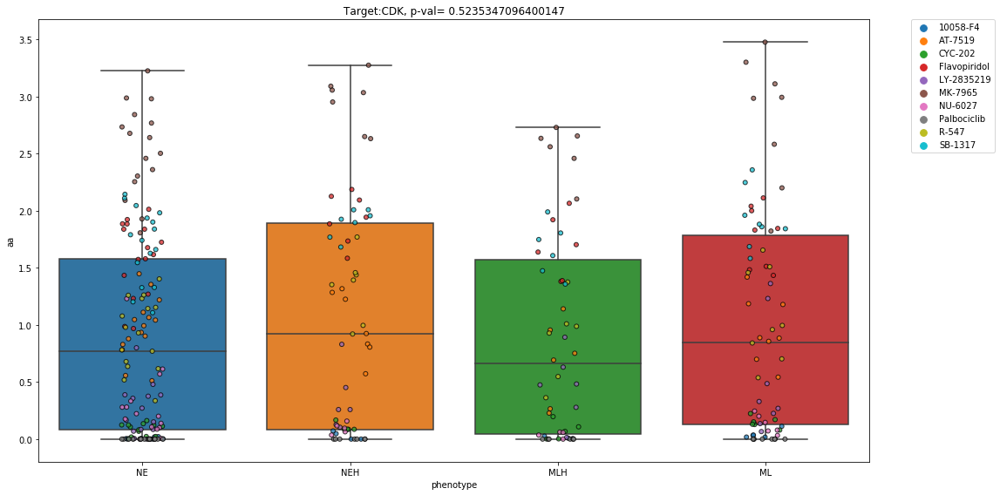

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    MK-7965  2.633719       MLH     0.0       0.0       0.0
CORL47     MK-7965  1.806393        NE     0.0       0.0       0.0
CORL88     MK-7965  2.102676       MLH     0.0       0.0       0.0
DMS114     MK-7965  3.300386        ML     0.0       0.0       0.0
DMS273     MK-7965  2.631103       NEH     0.0       0.0       0.0
DMS53      MK-7965  2.560027       MLH     0.0       0.0       0.0
DMS79      MK-7965  1.927963        NE     0.0       0.0       0.0
NCIH1048   MK-7965  3.476081        ML     0.0       0.0       0.0
NCIH1092   MK-7965  2.502656        NE     0.0       0.0       0.0
NCIH1105   MK-7965  2.980132        NE     0.0       0.0       0.0
NCIH1341   MK-7965  2.199984        ML     0.0       0.0       0.0
NCIH1436   MK-7965  2.986972        NE     0.0       0.0       0.0
NCIH146    MK-7965  2.640335        NE     0.0       0.0      

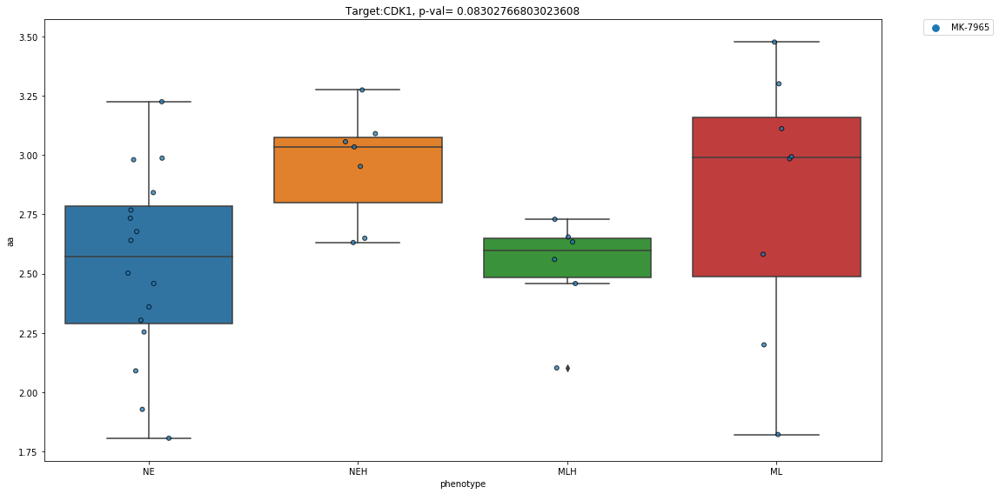

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3612: F_onewayBadInputSizesWarning: at least one input has length 0
  warnings.warn(F_onewayBadInputSizesWarning('at least one input '
/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3612: F_onewayBadInputSizesWarning: at least one input has length 0
  warnings.warn(F_onewayBadInputSizesWarning('at least one input '


Empty DataFrame
Columns: [drug, aa, phenotype, aa_new, hill_new, emax_new]
Index: []
CDK16
Empty DataFrame
Columns: [drug, aa, phenotype, aa_new, hill_new, emax_new]
Index: []
CDK17
              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    MK-7965  2.633719       MLH     0.0       0.0       0.0
CORL47     MK-7965  1.806393        NE     0.0       0.0       0.0
CORL88     MK-7965  2.102676       MLH     0.0       0.0       0.0
DMS114     MK-7965  3.300386        ML     0.0       0.0       0.0
DMS273     MK-7965  2.631103       NEH     0.0       0.0       0.0
DMS53      MK-7965  2.560027       MLH     0.0       0.0       0.0
DMS79      MK-7965  1.927963        NE     0.0       0.0       0.0
NCIH1048   MK-7965  3.476081        ML     0.0       0.0       0.0
NCIH1092   MK-7965  2.502656        NE     0.0       0.0       0.0
NCIH1105   MK-7965  2.980132        NE     0.0       0.0       0.0
NCIH1341   MK-

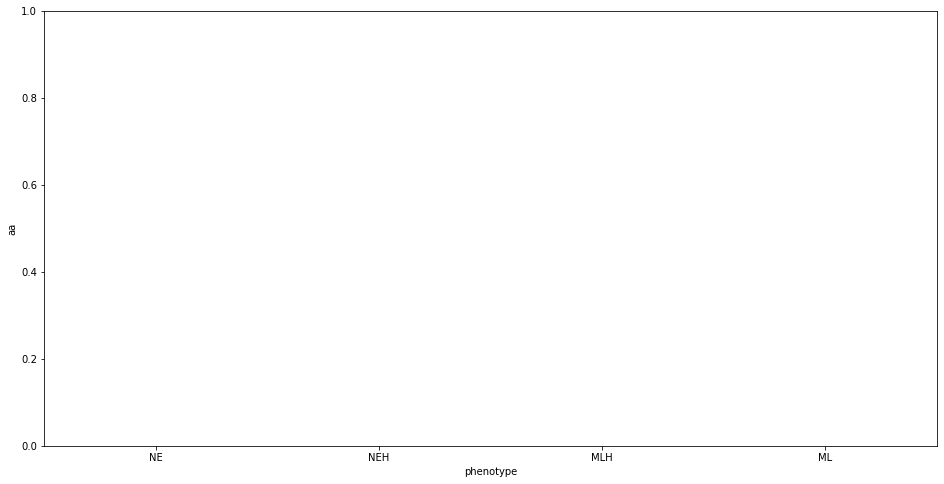

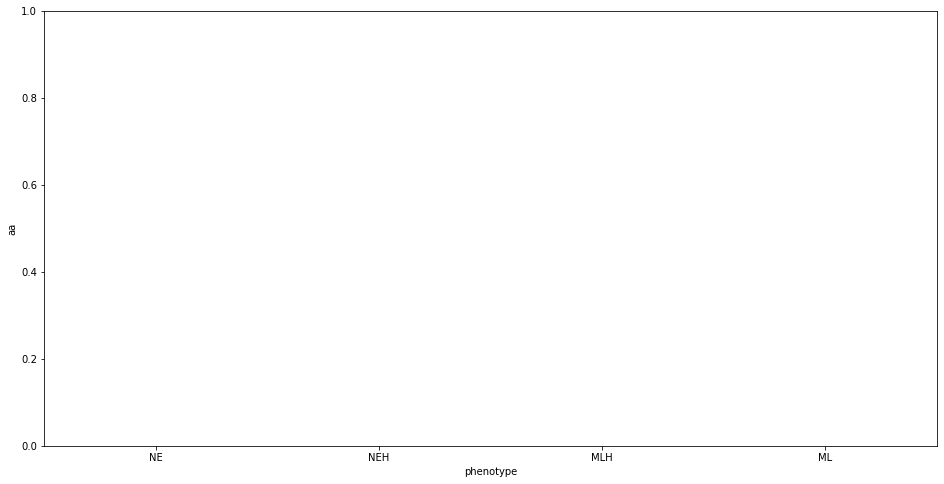

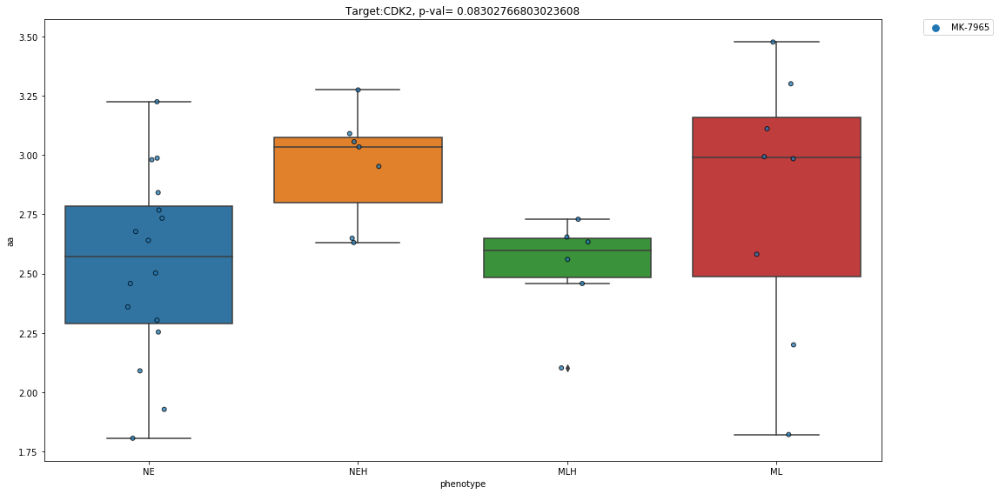

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                  drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                        
COLO668    Palbociclib  0.0       MLH     0.0       0.0       0.0
CORL47     Palbociclib  0.0        NE     0.0       0.0       0.0
CORL88     Palbociclib  0.0       MLH     0.0       0.0       0.0
DMS114     Palbociclib  0.0        ML     0.0       0.0       0.0
DMS273     Palbociclib  0.0       NEH     0.0       0.0       0.0
DMS53      Palbociclib  0.0       MLH     0.0       0.0       0.0
DMS79      Palbociclib  0.0        NE     0.0       0.0       0.0
NCIH1048   Palbociclib  0.0        ML     0.0       0.0       0.0
NCIH1092   Palbociclib  0.0        NE     0.0       0.0       0.0
NCIH1105   Palbociclib  0.0        NE     0.0       0.0       0.0
NCIH1341   Palbociclib  0.0        ML     0.0       0.0       0.0
NCIH1436   Palbociclib  0.0        NE     0.0       0.0       0.0
NCIH146    Palbociclib  0.0        NE     0.0       0.0       0.0
NCIH1618  

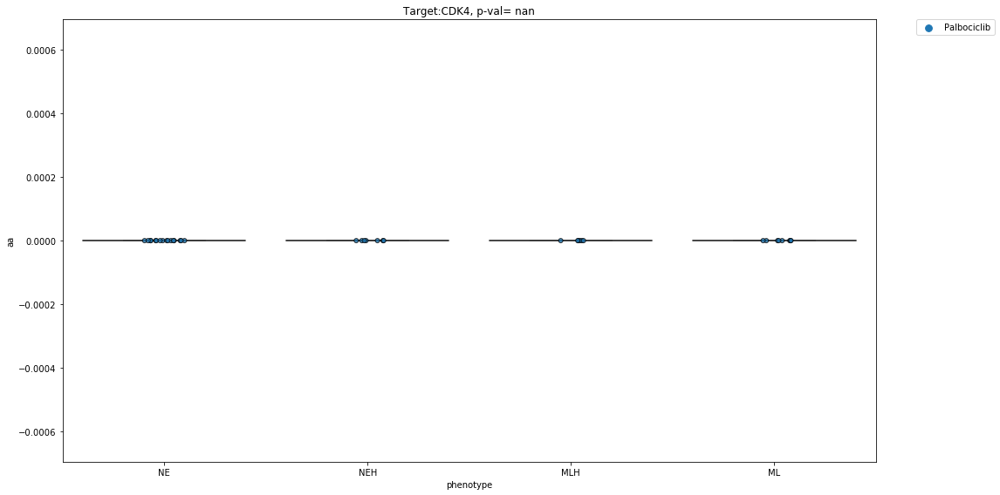

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    MK-7965  2.633719       MLH     0.0       0.0       0.0
CORL47     MK-7965  1.806393        NE     0.0       0.0       0.0
CORL88     MK-7965  2.102676       MLH     0.0       0.0       0.0
DMS114     MK-7965  3.300386        ML     0.0       0.0       0.0
DMS273     MK-7965  2.631103       NEH     0.0       0.0       0.0
DMS53      MK-7965  2.560027       MLH     0.0       0.0       0.0
DMS79      MK-7965  1.927963        NE     0.0       0.0       0.0
NCIH1048   MK-7965  3.476081        ML     0.0       0.0       0.0
NCIH1092   MK-7965  2.502656        NE     0.0       0.0       0.0
NCIH1105   MK-7965  2.980132        NE     0.0       0.0       0.0
NCIH1341   MK-7965  2.199984        ML     0.0       0.0       0.0
NCIH1436   MK-7965  2.986972        NE     0.0       0.0       0.0
NCIH146    MK-7965  2.640335        NE     0.0       0.0      

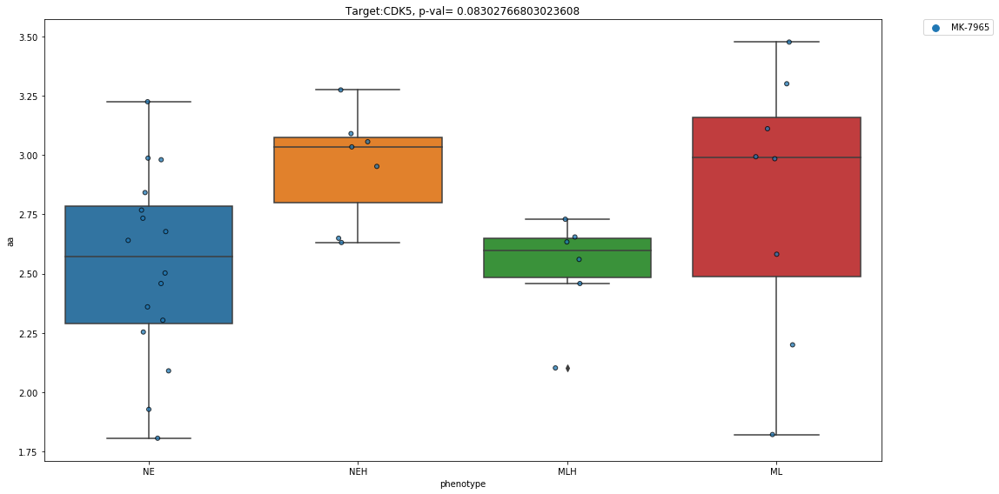

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                  drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                        
COLO668    Palbociclib  0.0       MLH     0.0       0.0       0.0
CORL47     Palbociclib  0.0        NE     0.0       0.0       0.0
CORL88     Palbociclib  0.0       MLH     0.0       0.0       0.0
DMS114     Palbociclib  0.0        ML     0.0       0.0       0.0
DMS273     Palbociclib  0.0       NEH     0.0       0.0       0.0
DMS53      Palbociclib  0.0       MLH     0.0       0.0       0.0
DMS79      Palbociclib  0.0        NE     0.0       0.0       0.0
NCIH1048   Palbociclib  0.0        ML     0.0       0.0       0.0
NCIH1092   Palbociclib  0.0        NE     0.0       0.0       0.0
NCIH1105   Palbociclib  0.0        NE     0.0       0.0       0.0
NCIH1341   Palbociclib  0.0        ML     0.0       0.0       0.0
NCIH1436   Palbociclib  0.0        NE     0.0       0.0       0.0
NCIH146    Palbociclib  0.0        NE     0.0       0.0       0.0
NCIH1618  

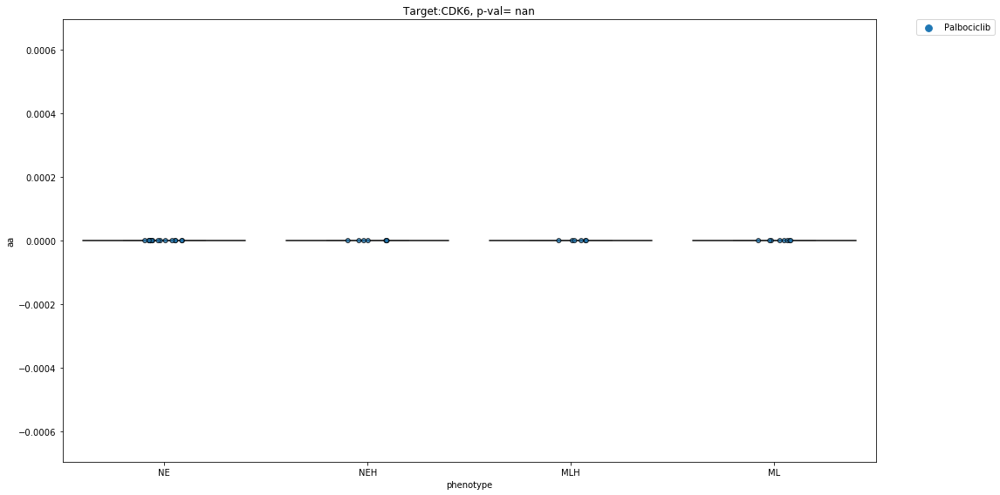

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3612: F_onewayBadInputSizesWarning: at least one input has length 0
  warnings.warn(F_onewayBadInputSizesWarning('at least one input '


Empty DataFrame
Columns: [drug, aa, phenotype, aa_new, hill_new, emax_new]
Index: []
CDK7
              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    AT-7519  0.954990       MLH     0.0       0.0       0.0
CORL47     AT-7519  0.828773        NE     0.0       0.0       0.0
CORL88     AT-7519  0.692054       MLH     0.0       0.0       0.0
DMS114     AT-7519  1.185519        ML     0.0       0.0       0.0
DMS273     AT-7519  0.832582       NEH     0.0       0.0       0.0
DMS53      AT-7519  0.265506       MLH     0.0       0.0       0.0
DMS79      AT-7519  0.782189        NE     0.0       0.0       0.0
NCIH1048   AT-7519  1.178816        ML     0.0       0.0       0.0
NCIH1105   AT-7519  1.064798        NE     0.0       0.0       0.0
NCIH1341   AT-7519  0.884359        ML     0.0       0.0       0.0
NCIH1436   AT-7519  0.901959        NE     0.0       0.0       0.0
NCIH146    AT-7519  1.218691        NE 

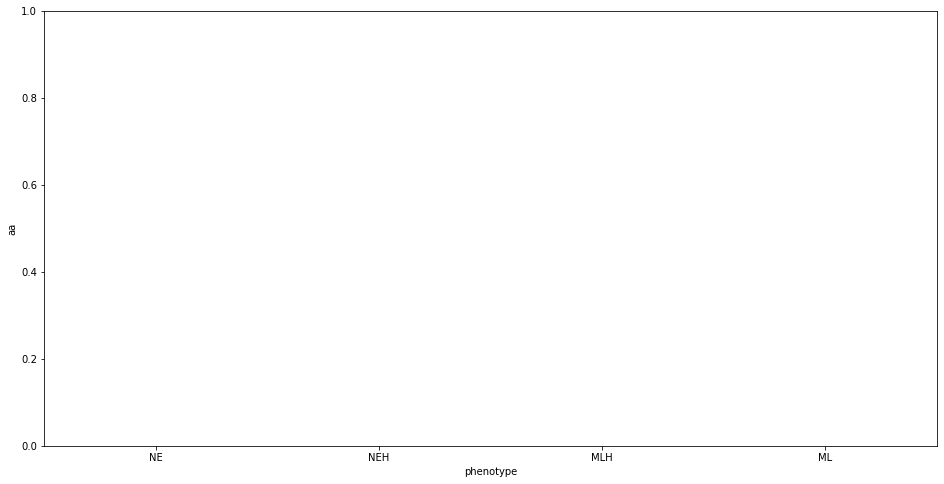

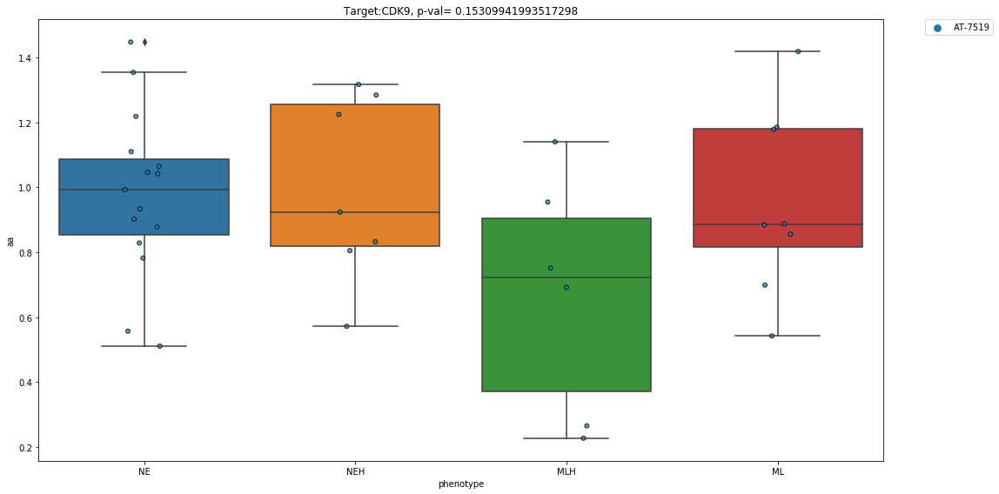

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3612: F_onewayBadInputSizesWarning: at least one input has length 0
  warnings.warn(F_onewayBadInputSizesWarning('at least one input '


Empty DataFrame
Columns: [drug, aa, phenotype, aa_new, hill_new, emax_new]
Index: []
CDKL5
                drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                               
CORL47     Ivacaftor  5.234276e-02        NE     0.0       0.0       0.0
CORL88     Ivacaftor  8.394567e-02       MLH     0.0       0.0       0.0
DMS114     Ivacaftor  1.410965e-03        ML     0.0       0.0       0.0
DMS53      Ivacaftor  1.252488e-01       MLH     0.0       0.0       0.0
DMS79      Ivacaftor  5.171431e-03        NE     0.0       0.0       0.0
NCIH1048   Ivacaftor  1.824919e-02        ML     0.0       0.0       0.0
NCIH1092   Ivacaftor  1.251963e-02        NE     0.0       0.0       0.0
NCIH1105   Ivacaftor  6.511286e-02        NE     0.0       0.0       0.0
NCIH1341   Ivacaftor  1.359148e-01        ML     0.0       0.0       0.0
NCIH1436   Ivacaftor  6.316095e-03        NE     0.0       0.0       0.0
NCIH146    Ivacaftor  1.485765e-0

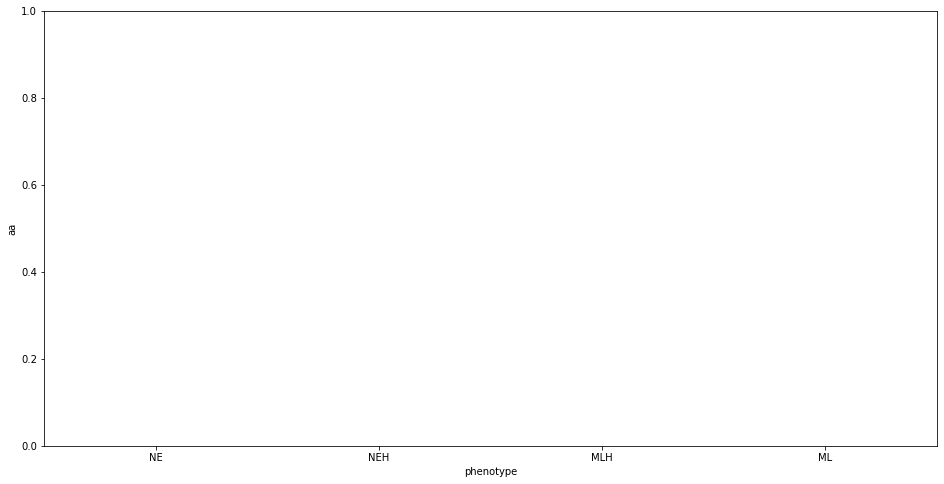

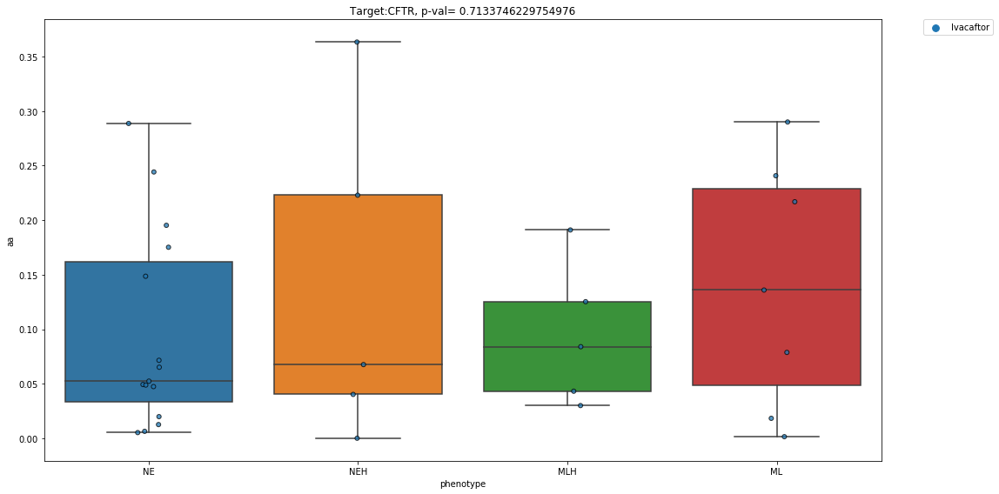

               drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
COLO668    PCI-0120  7.270000e-20       MLH     0.0       0.0       0.0
NCIH1048   PCI-0120  1.101433e-01        ML     0.0       0.0       0.0
NCIH1105   PCI-0120  9.030000e-11        NE     0.0       0.0       0.0
NCIH1436   PCI-0120  2.801619e-02        NE     0.0       0.0       0.0
NCIH1618   PCI-0120  1.140000e-13        NE     0.0       0.0       0.0
NCIH1836   PCI-0120  2.497846e-02        NE     0.0       0.0       0.0
NCIH1876   PCI-0120  8.449704e-02        NE     0.0       0.0       0.0
NCIH196    PCI-0120  6.999891e-02        ML     0.0       0.0       0.0
NCIH1963   PCI-0120  7.639144e-02        NE     0.0       0.0       0.0
NCIH2029   PCI-0120  2.551999e-02       MLH     0.0       0.0       0.0
NCIH2066   PCI-0120  1.519102e-01        ML     0.0       0.0       0.0
NCIH209    PCI-0120  1.080000e-11        NE     0.0       0.0   

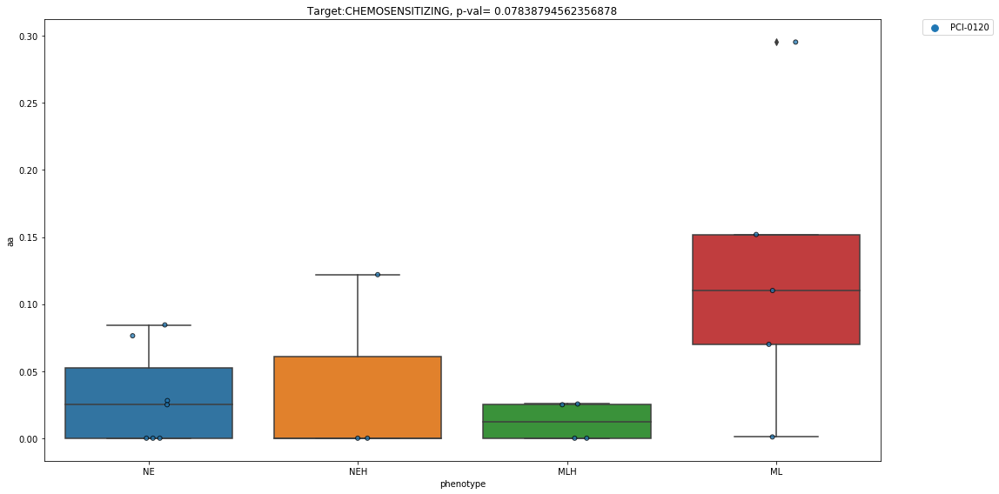

                 drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                            
COLO668    LY-2603618  0.537738       MLH     0.0       0.0       0.0
CORL47     LY-2603618  0.487817        NE     0.0       0.0       0.0
CORL88     LY-2603618  0.533926       MLH     0.0       0.0       0.0
DMS114     LY-2603618  0.387074        ML     0.0       0.0       0.0
DMS273     LY-2603618  1.091396       NEH     0.0       0.0       0.0
DMS53      LY-2603618  0.280047       MLH     0.0       0.0       0.0
DMS79      LY-2603618  0.201596        NE     0.0       0.0       0.0
NCIH1048   LY-2603618  0.610926        ML     0.0       0.0       0.0
NCIH1092   LY-2603618  0.188020        NE     0.0       0.0       0.0
NCIH1105   LY-2603618  0.383066        NE     0.0       0.0       0.0
NCIH1341   LY-2603618  0.765699        ML     0.0       0.0       0.0
NCIH1436   LY-2603618  0.553874        NE     0.0       0.0       0.0
NCIH146    LY-260361

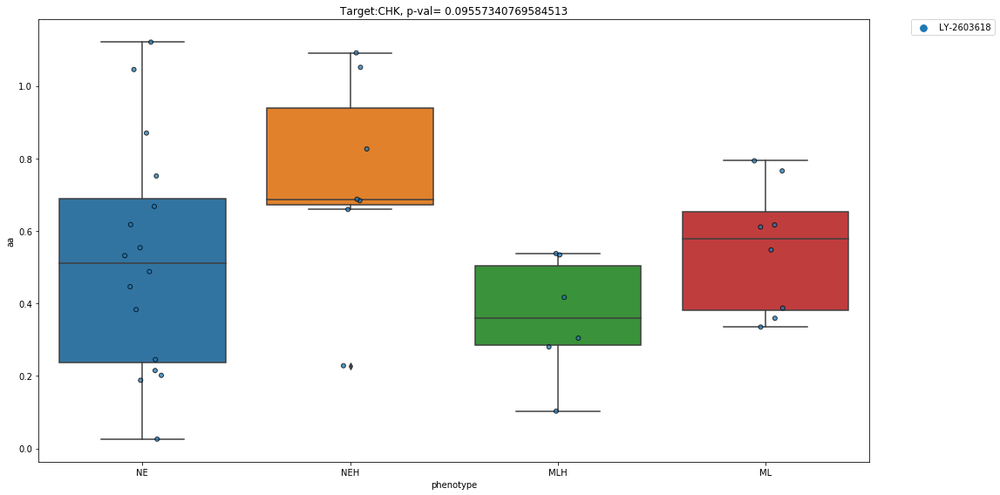

                  drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                        
COLO668      AZD-7762   0.0       MLH     0.0       0.0       0.0
CORL47       AZD-7762   0.0        NE     0.0       0.0       0.0
CORL88       AZD-7762   0.0       MLH     0.0       0.0       0.0
DMS114       AZD-7762   0.0        ML     0.0       0.0       0.0
DMS273       AZD-7762   0.0       NEH     0.0       0.0       0.0
...                ...  ...       ...     ...       ...       ...
NCIH82     SCH-900776   0.0       NEH     0.0       0.0       0.0
NCIH841    SCH-900776   0.0        ML     0.0       0.0       0.0
NCIH889    SCH-900776   0.0        NE     0.0       0.0       0.0
SHP77      SCH-900776   0.0       MLH     0.0       0.0       0.0
SW1271     SCH-900776   0.0        ML     0.0       0.0       0.0

[146 rows x 6 columns]
CHK1


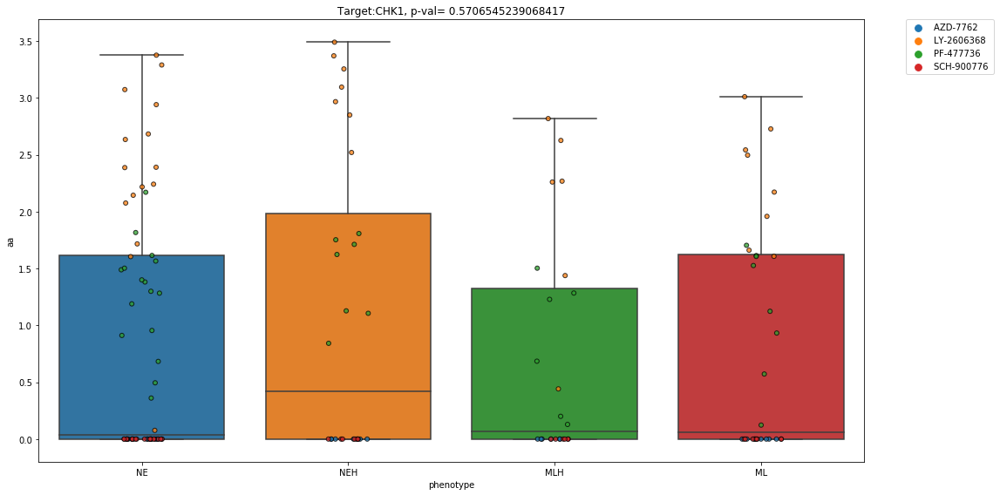

                 drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                            
COLO668     AZD-7762   0.000000       MLH     0.0       0.0       0.0
CORL47      AZD-7762   0.000000        NE     0.0       0.0       0.0
CORL88      AZD-7762   0.000000       MLH     0.0       0.0       0.0
DMS114      AZD-7762   0.000000        ML     0.0       0.0       0.0
DMS273      AZD-7762   0.000000       NEH     0.0       0.0       0.0
...               ...       ...       ...     ...       ...       ...
NCIH82     LY-2606368  3.489971       NEH     0.0       0.0       0.0
NCIH841    LY-2606368  2.496192        ML     0.0       0.0       0.0
NCIH889    LY-2606368  0.076505        NE     0.0       0.0       0.0
SHP77      LY-2606368  2.260095       MLH     0.0       0.0       0.0
SW1271     LY-2606368  1.606831        ML     0.0       0.0       0.0

[106 rows x 6 columns]
CHK2


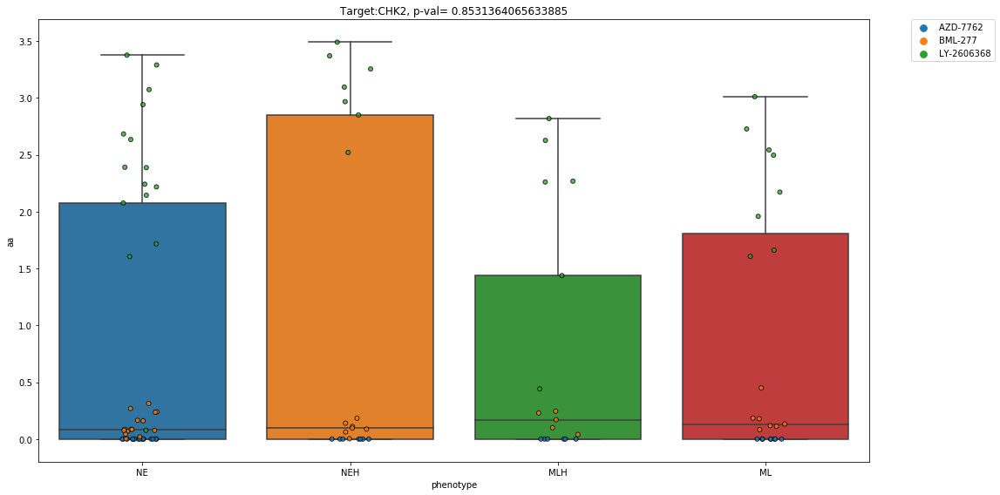

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                 drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                       
COLO668    AEG-40730   0.0       MLH     0.0       0.0       0.0
CORL47     AEG-40730   0.0        NE     0.0       0.0       0.0
CORL88     AEG-40730   0.0       MLH     0.0       0.0       0.0
DMS114     AEG-40730   0.0        ML     0.0       0.0       0.0
DMS273     AEG-40730   0.0       NEH     0.0       0.0       0.0
DMS53      AEG-40730   0.0       MLH     0.0       0.0       0.0
DMS79      AEG-40730   0.0        NE     0.0       0.0       0.0
NCIH1048   AEG-40730   0.0        ML     0.0       0.0       0.0
NCIH1092   AEG-40730   0.0        NE     0.0       0.0       0.0
NCIH1105   AEG-40730   0.0        NE     0.0       0.0       0.0
NCIH1341   AEG-40730   0.0        ML     0.0       0.0       0.0
NCIH1436   AEG-40730   0.0        NE     0.0       0.0       0.0
NCIH146    AEG-40730   0.0        NE     0.0       0.0       0.0
NCIH1618   AEG-40730   0.

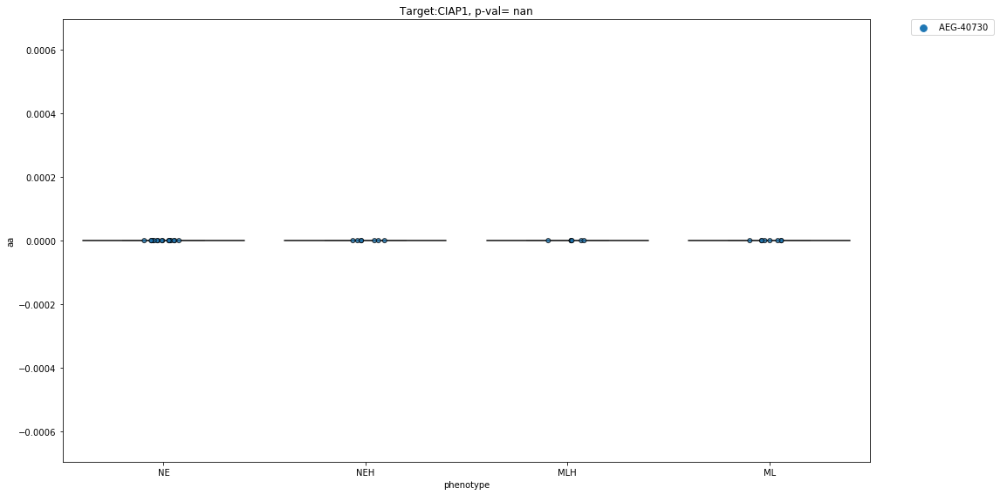

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                 drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                       
COLO668    AEG-40730   0.0       MLH     0.0       0.0       0.0
CORL47     AEG-40730   0.0        NE     0.0       0.0       0.0
CORL88     AEG-40730   0.0       MLH     0.0       0.0       0.0
DMS114     AEG-40730   0.0        ML     0.0       0.0       0.0
DMS273     AEG-40730   0.0       NEH     0.0       0.0       0.0
DMS53      AEG-40730   0.0       MLH     0.0       0.0       0.0
DMS79      AEG-40730   0.0        NE     0.0       0.0       0.0
NCIH1048   AEG-40730   0.0        ML     0.0       0.0       0.0
NCIH1092   AEG-40730   0.0        NE     0.0       0.0       0.0
NCIH1105   AEG-40730   0.0        NE     0.0       0.0       0.0
NCIH1341   AEG-40730   0.0        ML     0.0       0.0       0.0
NCIH1436   AEG-40730   0.0        NE     0.0       0.0       0.0
NCIH146    AEG-40730   0.0        NE     0.0       0.0       0.0
NCIH1618   AEG-40730   0.

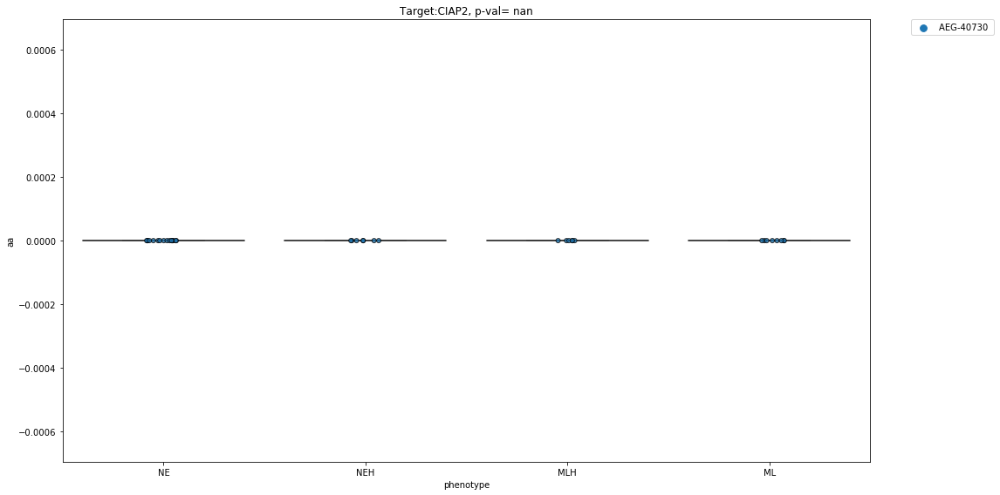

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    CX-4945  0.282383       MLH     0.0       0.0       0.0
CORL47     CX-4945  0.161408        NE     0.0       0.0       0.0
CORL88     CX-4945  0.035340       MLH     0.0       0.0       0.0
DMS114     CX-4945  0.336986        ML     0.0       0.0       0.0
DMS273     CX-4945  0.104453       NEH     0.0       0.0       0.0
DMS53      CX-4945  0.232604       MLH     0.0       0.0       0.0
DMS79      CX-4945  0.388760        NE     0.0       0.0       0.0
NCIH1048   CX-4945  0.988336        ML     0.0       0.0       0.0
NCIH1092   CX-4945  0.367423        NE     0.0       0.0       0.0
NCIH1105   CX-4945  0.525379        NE     0.0       0.0       0.0
NCIH1341   CX-4945  0.819811        ML     0.0       0.0       0.0
NCIH1436   CX-4945  0.801512        NE     0.0       0.0       0.0
NCIH146    CX-4945  0.437364        NE     0.0       0.0      

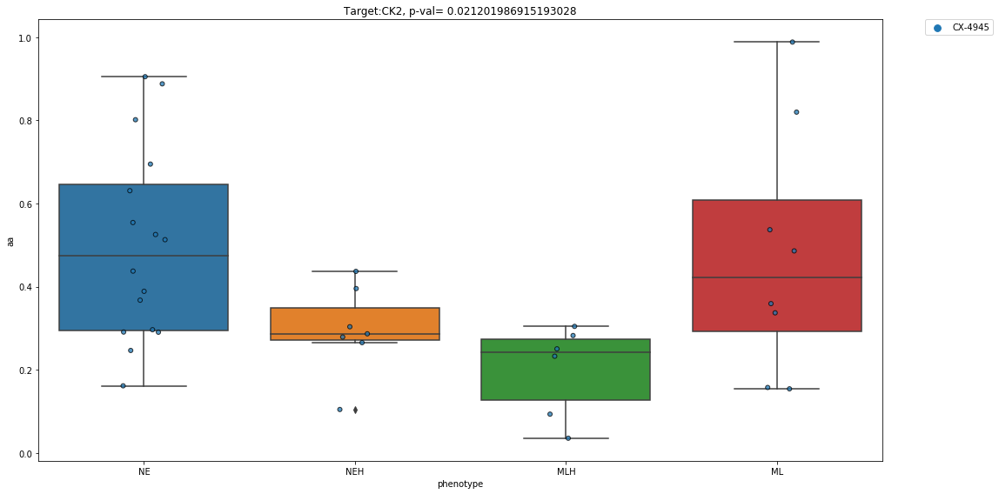

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    CX-4945  0.282383       MLH     0.0       0.0       0.0
CORL47     CX-4945  0.161408        NE     0.0       0.0       0.0
CORL88     CX-4945  0.035340       MLH     0.0       0.0       0.0
DMS114     CX-4945  0.336986        ML     0.0       0.0       0.0
DMS273     CX-4945  0.104453       NEH     0.0       0.0       0.0
DMS53      CX-4945  0.232604       MLH     0.0       0.0       0.0
DMS79      CX-4945  0.388760        NE     0.0       0.0       0.0
NCIH1048   CX-4945  0.988336        ML     0.0       0.0       0.0
NCIH1092   CX-4945  0.367423        NE     0.0       0.0       0.0
NCIH1105   CX-4945  0.525379        NE     0.0       0.0       0.0
NCIH1341   CX-4945  0.819811        ML     0.0       0.0       0.0
NCIH1436   CX-4945  0.801512        NE     0.0       0.0       0.0
NCIH146    CX-4945  0.437364        NE     0.0       0.0      

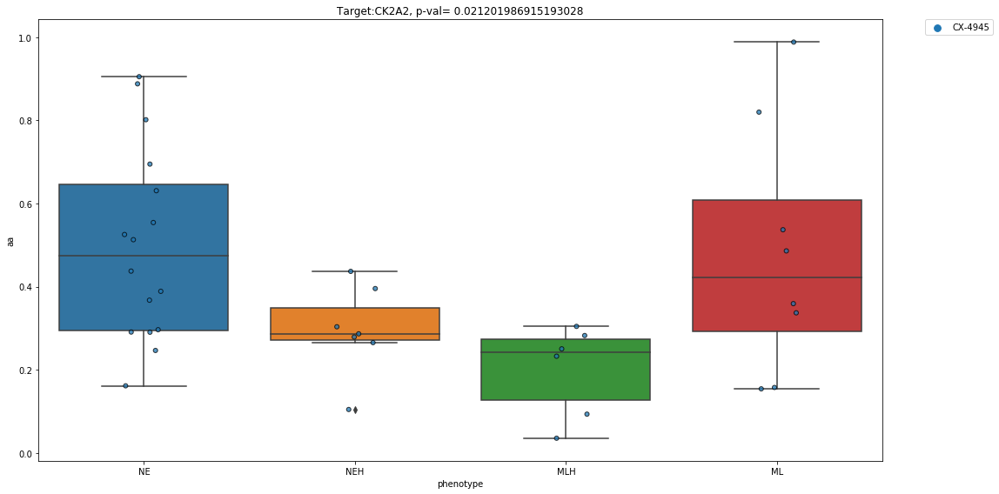

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                  drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                        
COLO668    Gemcitabine  0.0       MLH     0.0       0.0       0.0
CORL47     Gemcitabine  0.0        NE     0.0       0.0       0.0
CORL88     Gemcitabine  0.0       MLH     0.0       0.0       0.0
DMS114     Gemcitabine  0.0        ML     0.0       0.0       0.0
DMS273     Gemcitabine  0.0       NEH     0.0       0.0       0.0
DMS53      Gemcitabine  0.0       MLH     0.0       0.0       0.0
DMS79      Gemcitabine  0.0        NE     0.0       0.0       0.0
NCIH1048   Gemcitabine  0.0        ML     0.0       0.0       0.0
NCIH1092   Gemcitabine  0.0        NE     0.0       0.0       0.0
NCIH1105   Gemcitabine  0.0        NE     0.0       0.0       0.0
NCIH1341   Gemcitabine  0.0        ML     0.0       0.0       0.0
NCIH1436   Gemcitabine  0.0        NE     0.0       0.0       0.0
NCIH146    Gemcitabine  0.0        NE     0.0       0.0       0.0
NCIH1618  

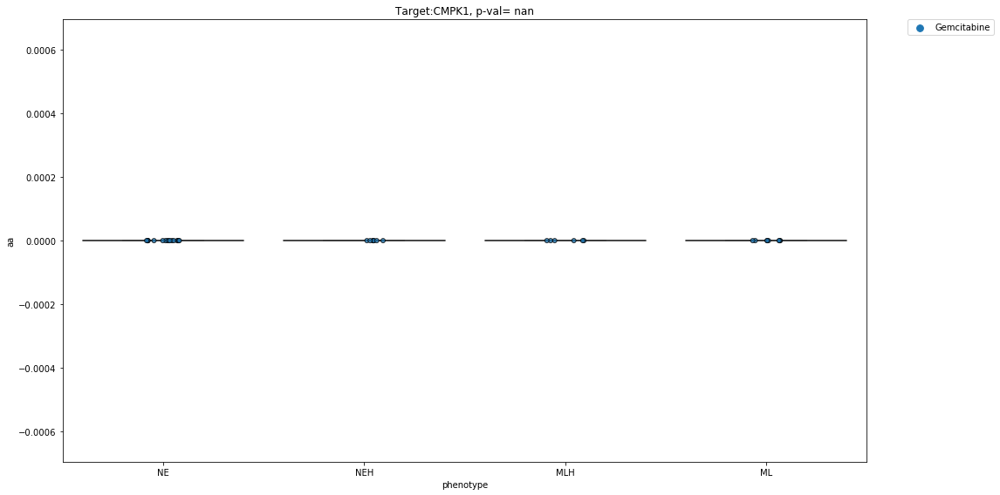

               drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
CORL88     10058-F4  4.380990e-03       MLH     0.0       0.0       0.0
DMS114     10058-F4  1.404092e-01        ML     0.0       0.0       0.0
DMS273     10058-F4  8.990000e-10       NEH     0.0       0.0       0.0
DMS53      10058-F4  2.580304e-02       MLH     0.0       0.0       0.0
NCIH1048   10058-F4  1.706178e-02        ML     0.0       0.0       0.0
NCIH1105   10058-F4  7.845000e-04        NE     0.0       0.0       0.0
NCIH1341   10058-F4  1.116117e-01        ML     0.0       0.0       0.0
NCIH146    10058-F4  1.878186e-02        NE     0.0       0.0       0.0
NCIH1618   10058-F4  4.694008e-03        NE     0.0       0.0       0.0
NCIH1876   10058-F4  2.286015e-03        NE     0.0       0.0       0.0
NCIH1930   10058-F4  2.670000e-13        NE     0.0       0.0       0.0
NCIH2029   10058-F4  7.729354e-03       MLH     0.0       0.0   

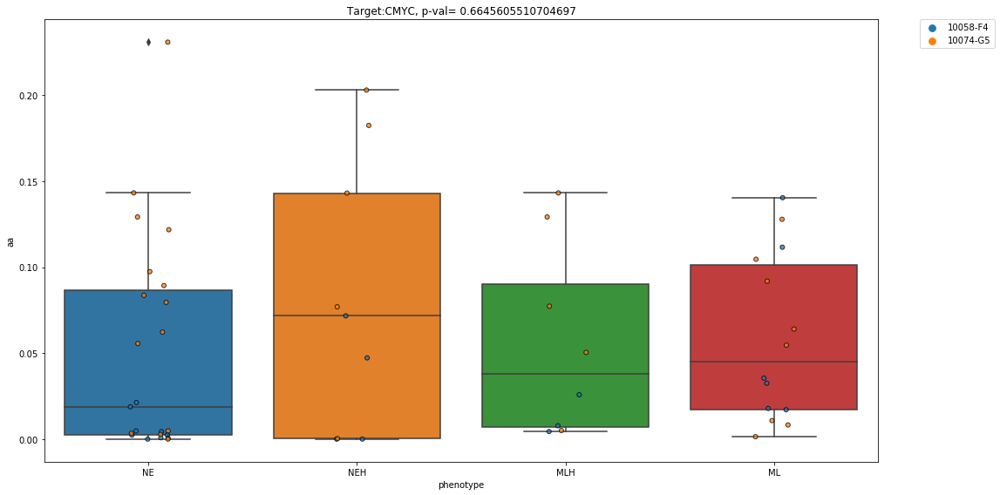

                    drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                   
COLO668    Meclofenamate  9.804774e-02       MLH     0.0       0.0       0.0
CORL47     Meclofenamate  7.416981e-02        NE     0.0       0.0       0.0
DMS114     Meclofenamate  2.208662e-01        ML     0.0       0.0       0.0
DMS273     Meclofenamate  4.492521e-02       NEH     0.0       0.0       0.0
NCIH1105   Meclofenamate  1.537659e-01        NE     0.0       0.0       0.0
NCIH1436   Meclofenamate  7.542706e-02        NE     0.0       0.0       0.0
NCIH146    Meclofenamate  6.138440e-04        NE     0.0       0.0       0.0
NCIH1618   Meclofenamate  5.794836e-02        NE     0.0       0.0       0.0
NCIH1930   Meclofenamate  1.490000e-08        NE     0.0       0.0       0.0
NCIH2066   Meclofenamate  1.506663e-01        ML     0.0       0.0       0.0
NCIH526    Meclofenamate  2.810000e-10       NEH     0.0       0.0       0.0

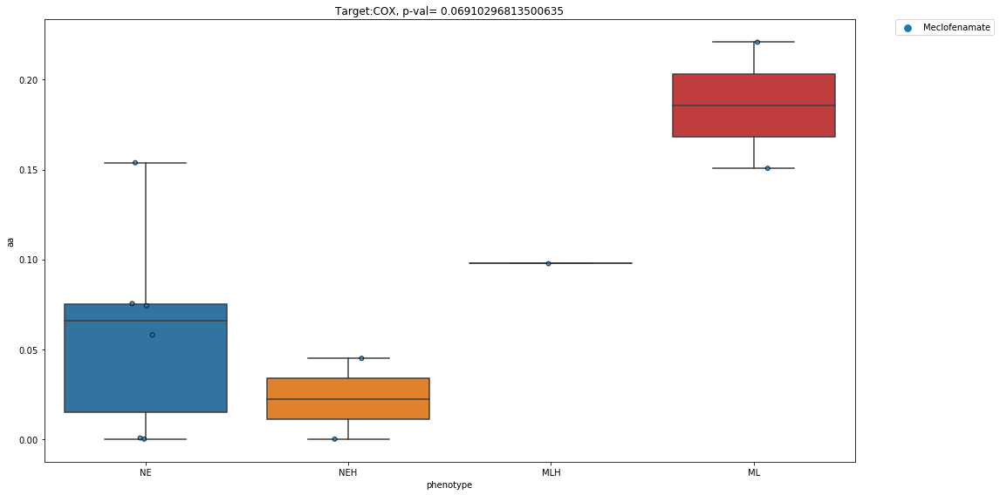

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                      
COLO668    Celecoxib  0.0       MLH     0.0       0.0       0.0
CORL47     Celecoxib  0.0        NE     0.0       0.0       0.0
CORL88     Celecoxib  0.0       MLH     0.0       0.0       0.0
DMS114     Celecoxib  0.0        ML     0.0       0.0       0.0
DMS273     Celecoxib  0.0       NEH     0.0       0.0       0.0
DMS53      Celecoxib  0.0       MLH     0.0       0.0       0.0
DMS79      Celecoxib  0.0        NE     0.0       0.0       0.0
NCIH1048   Celecoxib  0.0        ML     0.0       0.0       0.0
NCIH1092   Celecoxib  0.0        NE     0.0       0.0       0.0
NCIH1105   Celecoxib  0.0        NE     0.0       0.0       0.0
NCIH1341   Celecoxib  0.0        ML     0.0       0.0       0.0
NCIH1436   Celecoxib  0.0        NE     0.0       0.0       0.0
NCIH146    Celecoxib  0.0        NE     0.0       0.0       0.0
NCIH1618   Celecoxib  0.0        NE     

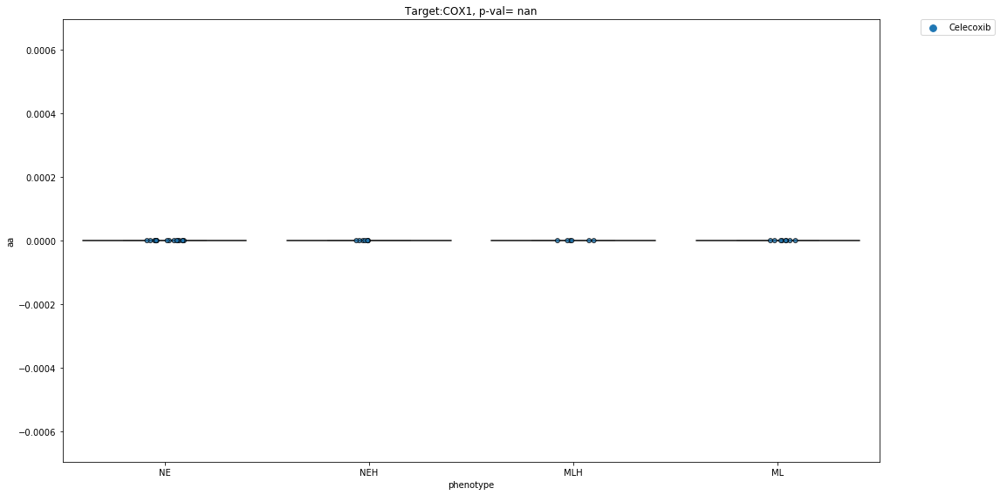

                   drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                  
COLO668       Celecoxib  0.000000e+00       MLH     0.0       0.0       0.0
CORL47        Celecoxib  0.000000e+00        NE     0.0       0.0       0.0
CORL88        Celecoxib  0.000000e+00       MLH     0.0       0.0       0.0
DMS114        Celecoxib  0.000000e+00        ML     0.0       0.0       0.0
DMS273        Celecoxib  0.000000e+00       NEH     0.0       0.0       0.0
...                 ...           ...       ...     ...       ...       ...
NCIH1963   Flurbiprofen  2.250134e-01        NE     0.0       0.0       0.0
NCIH2029   Flurbiprofen  1.815322e-01       MLH     0.0       0.0       0.0
NCIH510    Flurbiprofen  1.630000e-22       MLH     0.0       0.0       0.0
NCIH889    Flurbiprofen  6.010000e-13        NE     0.0       0.0       0.0
SW1271     Flurbiprofen  6.368337e-03        ML     0.0       0.0       0.0

[72 rows x 

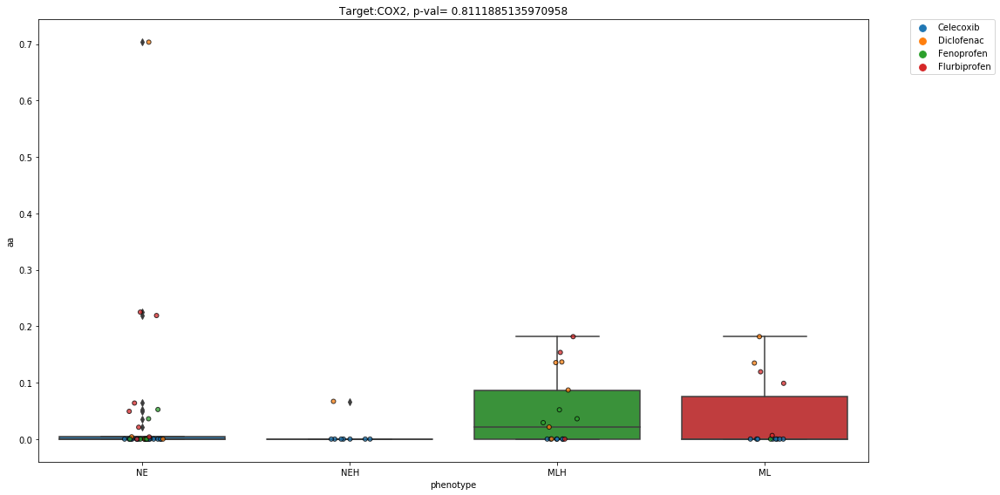

                drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                           
CORL47       GW-5074  0.058547        NE     0.0       0.0       0.0
CORL88       GW-5074  0.092489       MLH     0.0       0.0       0.0
DMS114       GW-5074  0.013337        ML     0.0       0.0       0.0
DMS273       GW-5074  0.064776       NEH     0.0       0.0       0.0
DMS53        GW-5074  0.065586       MLH     0.0       0.0       0.0
...              ...       ...       ...     ...       ...       ...
NCIH510    ZM-336372  0.004457       MLH     0.0       0.0       0.0
NCIH69     ZM-336372  0.019262        NE     0.0       0.0       0.0
NCIH82     ZM-336372  0.073600       NEH     0.0       0.0       0.0
NCIH841    ZM-336372  0.001851        ML     0.0       0.0       0.0
NCIH889    ZM-336372  0.649652        NE     0.0       0.0       0.0

[162 rows x 6 columns]
CRAF


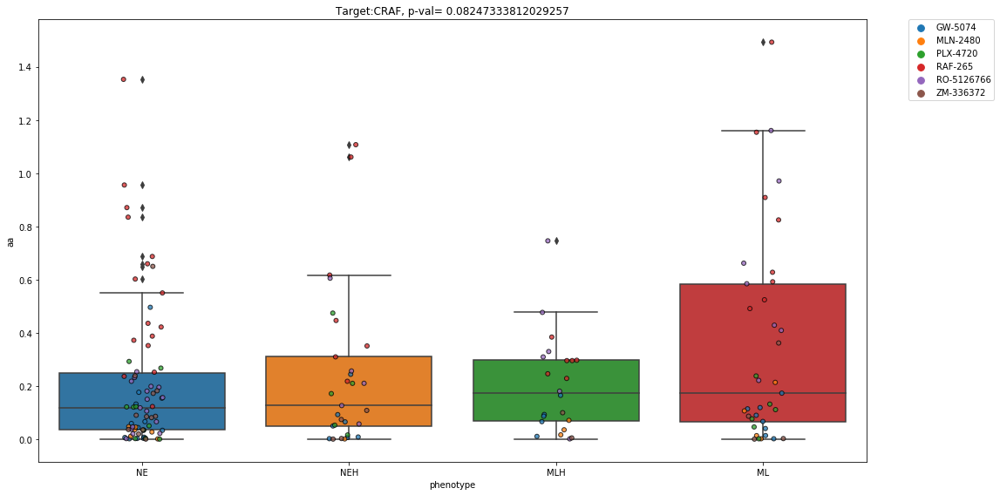

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    KPT-185  1.509454       MLH     0.0       0.0       0.0
CORL47     KPT-185  1.164130        NE     0.0       0.0       0.0
CORL88     KPT-185  0.199612       MLH     0.0       0.0       0.0
DMS114     KPT-185  2.246897        ML     0.0       0.0       0.0
DMS273     KPT-185  0.994167       NEH     0.0       0.0       0.0
...            ...       ...       ...     ...       ...       ...
NCIH82     KPT-251  1.530710       NEH     0.0       0.0       0.0
NCIH841    KPT-251  1.480050        ML     0.0       0.0       0.0
NCIH889    KPT-251  1.318983        NE     0.0       0.0       0.0
SHP77      KPT-251  1.459721       MLH     0.0       0.0       0.0
SW1271     KPT-251  2.329849        ML     0.0       0.0       0.0

[74 rows x 6 columns]
CRM1


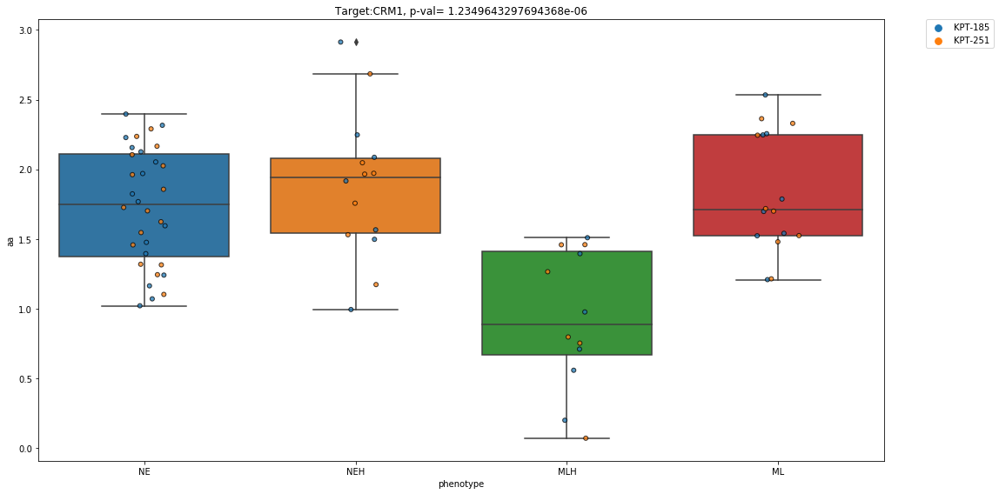

                   drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                  
COLO668    JNJ-28312141  1.195591e-01       MLH     0.0       0.0       0.0
CORL47     JNJ-28312141  4.450000e-19        NE     0.0       0.0       0.0
CORL88     JNJ-28312141  4.923271e-03       MLH     0.0       0.0       0.0
DMS114     JNJ-28312141  3.058713e-01        ML     0.0       0.0       0.0
DMS53      JNJ-28312141  1.033741e-02       MLH     0.0       0.0       0.0
DMS79      JNJ-28312141  1.024799e-01        NE     0.0       0.0       0.0
NCIH1048   JNJ-28312141  3.222091e-02        ML     0.0       0.0       0.0
NCIH1105   JNJ-28312141  1.209689e-01        NE     0.0       0.0       0.0
NCIH1341   JNJ-28312141  2.006895e-03        ML     0.0       0.0       0.0
NCIH1436   JNJ-28312141  3.082885e-01        NE     0.0       0.0       0.0
NCIH146    JNJ-28312141  6.094469e-03        NE     0.0       0.0       0.0
NCIH1618   J

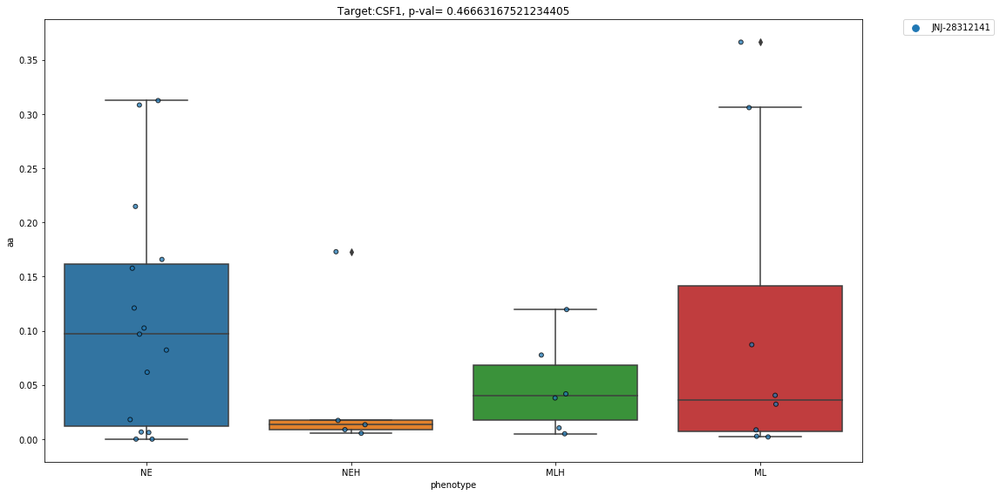

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668      AC-220  0.043024       MLH     0.0       0.0       0.0
CORL47       AC-220  0.050475        NE     0.0       0.0       0.0
DMS114       AC-220  0.498568        ML     0.0       0.0       0.0
DMS53        AC-220  0.244199       MLH     0.0       0.0       0.0
DMS79        AC-220  0.042471        NE     0.0       0.0       0.0
...             ...       ...       ...     ...       ...       ...
NCIH82     ONX-0803  0.456556       NEH     0.0       0.0       0.0
NCIH841    ONX-0803  0.593675        ML     0.0       0.0       0.0
NCIH889    ONX-0803  0.026998        NE     0.0       0.0       0.0
SHP77      ONX-0803  0.609359       MLH     0.0       0.0       0.0
SW1271     ONX-0803  0.791915        ML     0.0       0.0       0.0

[95 rows x 6 columns]
CSF1R


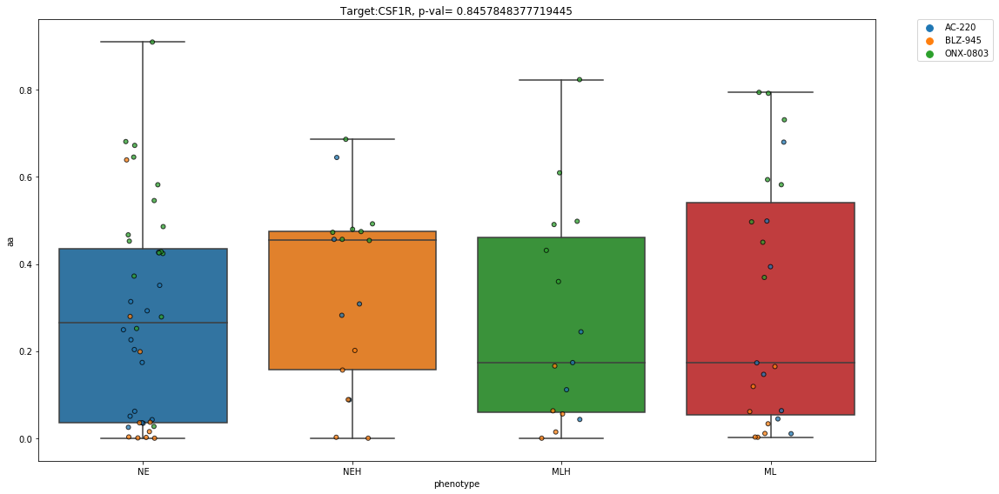

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    MK-7965  2.633719       MLH     0.0       0.0       0.0
CORL47     MK-7965  1.806393        NE     0.0       0.0       0.0
CORL88     MK-7965  2.102676       MLH     0.0       0.0       0.0
DMS114     MK-7965  3.300386        ML     0.0       0.0       0.0
DMS273     MK-7965  2.631103       NEH     0.0       0.0       0.0
DMS53      MK-7965  2.560027       MLH     0.0       0.0       0.0
DMS79      MK-7965  1.927963        NE     0.0       0.0       0.0
NCIH1048   MK-7965  3.476081        ML     0.0       0.0       0.0
NCIH1092   MK-7965  2.502656        NE     0.0       0.0       0.0
NCIH1105   MK-7965  2.980132        NE     0.0       0.0       0.0
NCIH1341   MK-7965  2.199984        ML     0.0       0.0       0.0
NCIH1436   MK-7965  2.986972        NE     0.0       0.0       0.0
NCIH146    MK-7965  2.640335        NE     0.0       0.0      

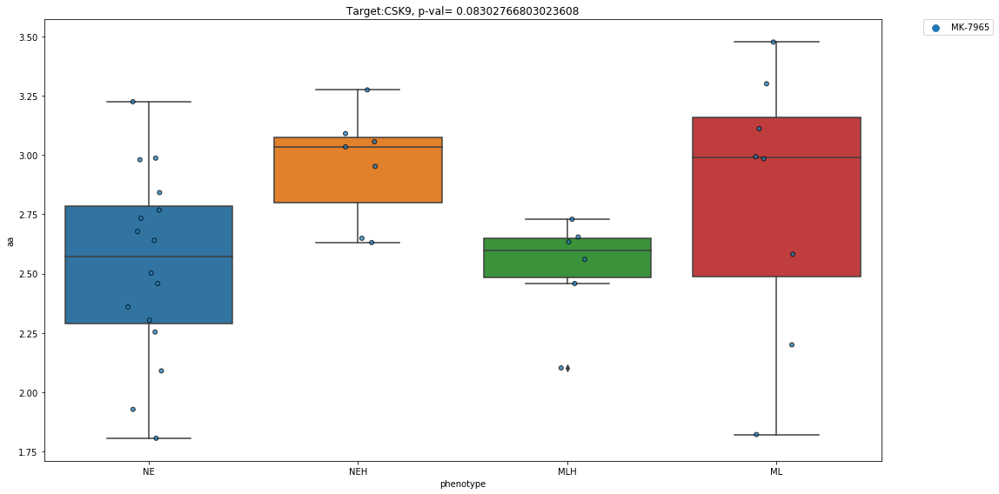

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                 drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                       
COLO668    Plerixafor  0.0       MLH     0.0       0.0       0.0
CORL47     Plerixafor  0.0        NE     0.0       0.0       0.0
CORL88     Plerixafor  0.0       MLH     0.0       0.0       0.0
DMS114     Plerixafor  0.0        ML     0.0       0.0       0.0
DMS273     Plerixafor  0.0       NEH     0.0       0.0       0.0
DMS53      Plerixafor  0.0       MLH     0.0       0.0       0.0
DMS79      Plerixafor  0.0        NE     0.0       0.0       0.0
NCIH1048   Plerixafor  0.0        ML     0.0       0.0       0.0
NCIH1092   Plerixafor  0.0        NE     0.0       0.0       0.0
NCIH1105   Plerixafor  0.0        NE     0.0       0.0       0.0
NCIH1341   Plerixafor  0.0        ML     0.0       0.0       0.0
NCIH1436   Plerixafor  0.0        NE     0.0       0.0       0.0
NCIH146    Plerixafor  0.0        NE     0.0       0.0       0.0
NCIH1618   Plerixafor  0.

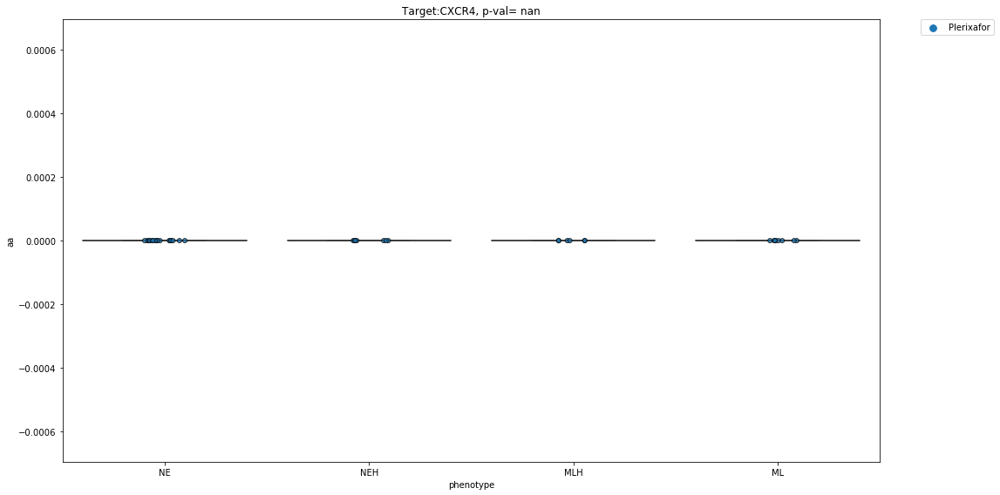

                  drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668    Abiraterone  0.000000       MLH     0.0       0.0       0.0
CORL47     Abiraterone  0.000000        NE     0.0       0.0       0.0
CORL88     Abiraterone  0.000000       MLH     0.0       0.0       0.0
DMS114     Abiraterone  0.000000        ML     0.0       0.0       0.0
DMS273     Abiraterone  0.000000       NEH     0.0       0.0       0.0
DMS53      Abiraterone  0.000000       MLH     0.0       0.0       0.0
DMS79      Abiraterone  0.000000        NE     0.0       0.0       0.0
NCIH1048   Abiraterone  0.000000        ML     0.0       0.0       0.0
NCIH1092   Abiraterone  0.000000        NE     0.0       0.0       0.0
NCIH1105   Abiraterone  0.000000        NE     0.0       0.0       0.0
NCIH1341   Abiraterone  0.000000        ML     0.0       0.0       0.0
NCIH1436   Abiraterone  0.000000        NE     0.0       0.0       0.0
NCIH14

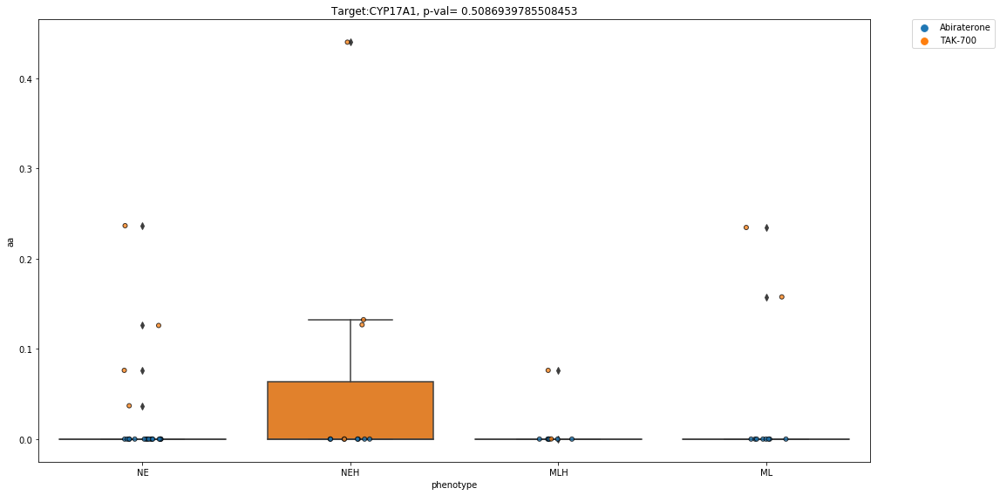

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                  drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                        
COLO668    Anastrozole  0.0       MLH     0.0       0.0       0.0
CORL47     Anastrozole  0.0        NE     0.0       0.0       0.0
CORL88     Anastrozole  0.0       MLH     0.0       0.0       0.0
DMS114     Anastrozole  0.0        ML     0.0       0.0       0.0
DMS273     Anastrozole  0.0       NEH     0.0       0.0       0.0
DMS53      Anastrozole  0.0       MLH     0.0       0.0       0.0
DMS79      Anastrozole  0.0        NE     0.0       0.0       0.0
NCIH1048   Anastrozole  0.0        ML     0.0       0.0       0.0
NCIH1092   Anastrozole  0.0        NE     0.0       0.0       0.0
NCIH1105   Anastrozole  0.0        NE     0.0       0.0       0.0
NCIH1341   Anastrozole  0.0        ML     0.0       0.0       0.0
NCIH1436   Anastrozole  0.0        NE     0.0       0.0       0.0
NCIH146    Anastrozole  0.0        NE     0.0       0.0       0.0
NCIH1618  

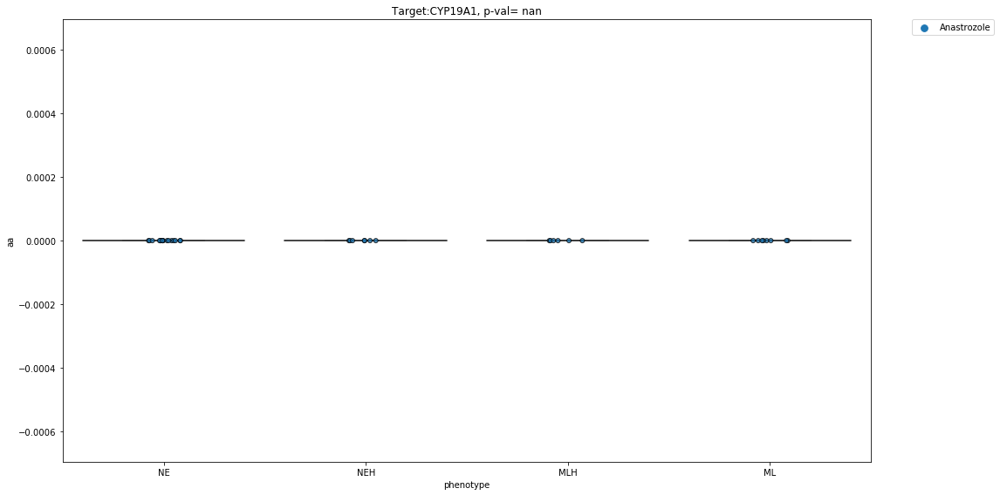

                 drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                
DMS273     Nitisinone  1.064156e-01       NEH     0.0       0.0       0.0
NCIH1048   Nitisinone  1.120523e-02        ML     0.0       0.0       0.0
NCIH1105   Nitisinone  3.650000e-10        NE     0.0       0.0       0.0
NCIH146    Nitisinone  2.143623e-01        NE     0.0       0.0       0.0
NCIH2066   Nitisinone  4.191968e-01        ML     0.0       0.0       0.0
NCIH209    Nitisinone  1.247881e-01        NE     0.0       0.0       0.0
NCIH510    Nitisinone  2.077680e-02       MLH     0.0       0.0       0.0
NCIH524    Nitisinone  3.409538e-02       NEH     0.0       0.0       0.0
NCIH69     Nitisinone  1.907716e-01        NE     0.0       0.0       0.0
NCIH82     Nitisinone  8.860000e-10       NEH     0.0       0.0       0.0
SHP77      Nitisinone  2.354875e-02       MLH     0.0       0.0       0.0
CYP2C9


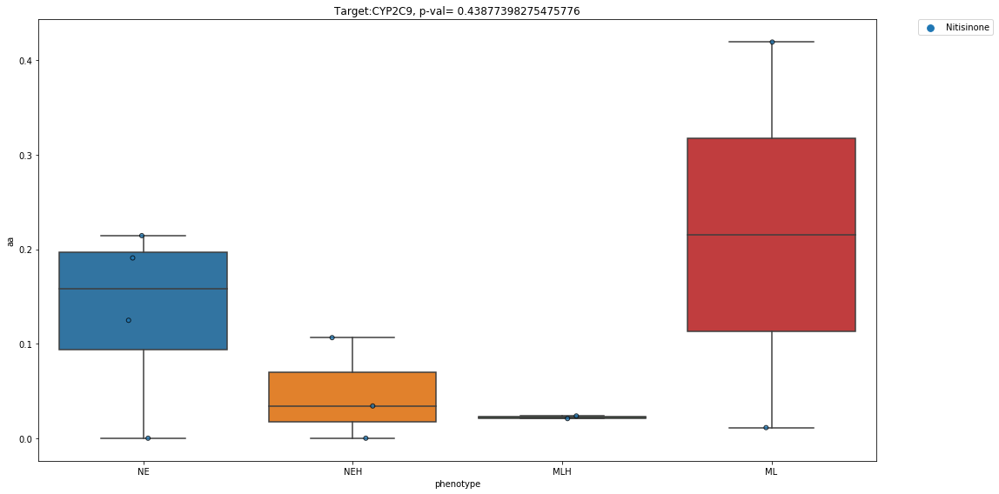

                   drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
COLO668    Fluphenazine  0.027793       MLH     0.0       0.0       0.0
CORL47     Fluphenazine  0.023193        NE     0.0       0.0       0.0
CORL88     Fluphenazine  0.055281       MLH     0.0       0.0       0.0
DMS114     Fluphenazine  0.081377        ML     0.0       0.0       0.0
DMS53      Fluphenazine  0.083460       MLH     0.0       0.0       0.0
DMS79      Fluphenazine  0.106113        NE     0.0       0.0       0.0
NCIH1048   Fluphenazine  0.003567        ML     0.0       0.0       0.0
NCIH1092   Fluphenazine  0.048847        NE     0.0       0.0       0.0
NCIH1105   Fluphenazine  0.221699        NE     0.0       0.0       0.0
NCIH1341   Fluphenazine  0.069948        ML     0.0       0.0       0.0
NCIH1436   Fluphenazine  0.143938        NE     0.0       0.0       0.0
NCIH146    Fluphenazine  0.079261        NE     0.0       0.0   

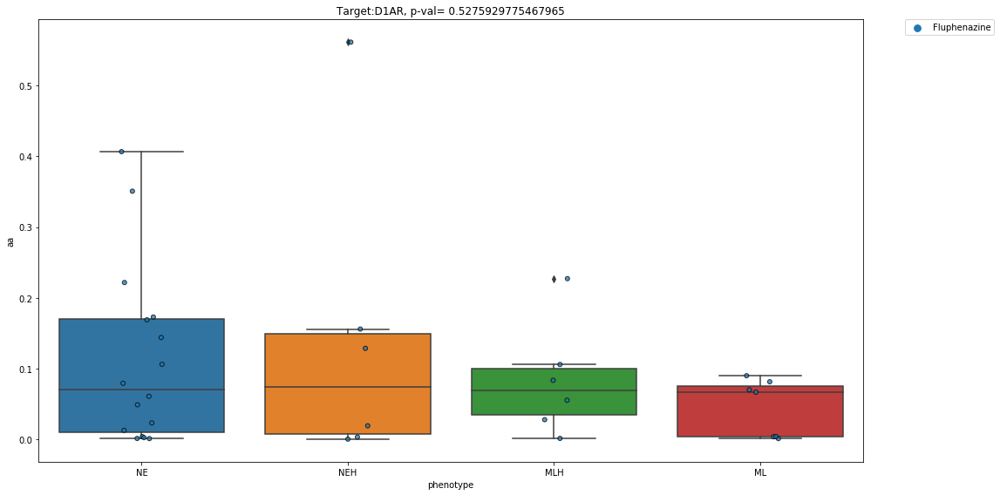

                     drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                
COLO668    Chlorpromazine  0.101294       MLH     0.0       0.0       0.0
CORL47     Chlorpromazine  0.281255        NE     0.0       0.0       0.0
CORL88     Chlorpromazine  0.427300       MLH     0.0       0.0       0.0
DMS114     Chlorpromazine  0.003803        ML     0.0       0.0       0.0
DMS53      Chlorpromazine  0.233273       MLH     0.0       0.0       0.0
...                   ...       ...       ...     ...       ...       ...
NCIH82           Pimozide  0.665720       NEH     0.0       0.0       0.0
NCIH841          Pimozide  0.178337        ML     0.0       0.0       0.0
NCIH889          Pimozide  0.227462        NE     0.0       0.0       0.0
SHP77            Pimozide  0.048449       MLH     0.0       0.0       0.0
SW1271           Pimozide  0.353741        ML     0.0       0.0       0.0

[104 rows x 6 columns]
D2R


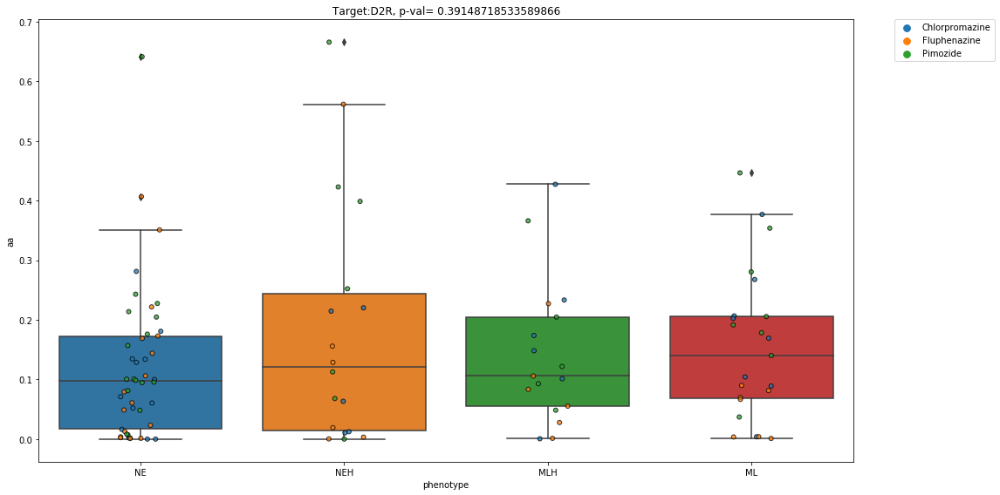

               drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
COLO668    Pimozide  1.217949e-01       MLH     0.0       0.0       0.0
CORL47     Pimozide  7.310543e-03        NE     0.0       0.0       0.0
DMS114     Pimozide  2.055270e-01        ML     0.0       0.0       0.0
DMS273     Pimozide  1.280000e-12       NEH     0.0       0.0       0.0
DMS53      Pimozide  9.290008e-02       MLH     0.0       0.0       0.0
DMS79      Pimozide  1.005225e-01        NE     0.0       0.0       0.0
NCIH1048   Pimozide  4.464419e-01        ML     0.0       0.0       0.0
NCIH1092   Pimozide  1.007502e-01        NE     0.0       0.0       0.0
NCIH1105   Pimozide  1.569716e-01        NE     0.0       0.0       0.0
NCIH1341   Pimozide  1.401029e-01        ML     0.0       0.0       0.0
NCIH1436   Pimozide  4.826946e-02        NE     0.0       0.0       0.0
NCIH146    Pimozide  6.413289e-01        NE     0.0       0.0   

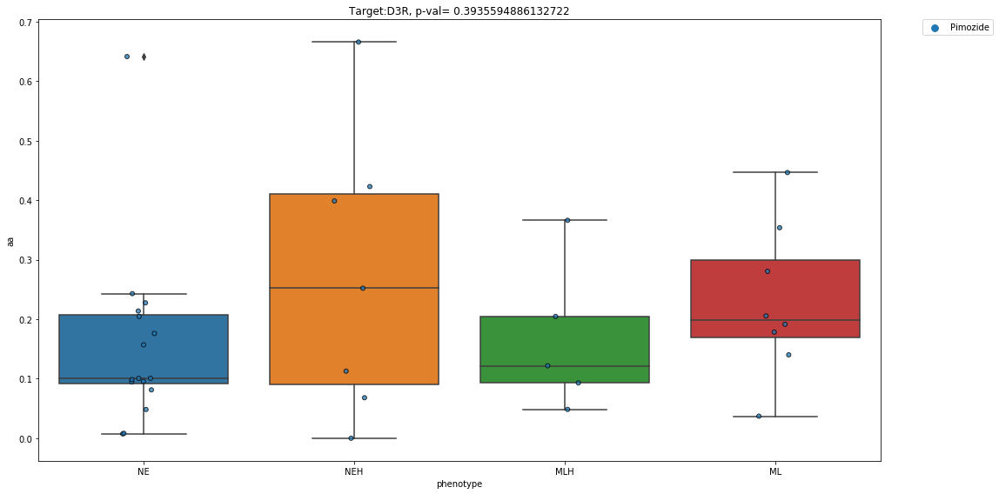

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                   drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    Methotrexate  0.0       MLH     0.0       0.0       0.0
CORL47     Methotrexate  0.0        NE     0.0       0.0       0.0
CORL88     Methotrexate  0.0       MLH     0.0       0.0       0.0
DMS114     Methotrexate  0.0        ML     0.0       0.0       0.0
DMS273     Methotrexate  0.0       NEH     0.0       0.0       0.0
...                 ...  ...       ...     ...       ...       ...
NCIH82     Pralatrexate  0.0       NEH     0.0       0.0       0.0
NCIH841    Pralatrexate  0.0        ML     0.0       0.0       0.0
NCIH889    Pralatrexate  0.0        NE     0.0       0.0       0.0
SHP77      Pralatrexate  0.0       MLH     0.0       0.0       0.0
SW1271     Pralatrexate  0.0        ML     0.0       0.0       0.0

[74 rows x 6 columns]
DHFR


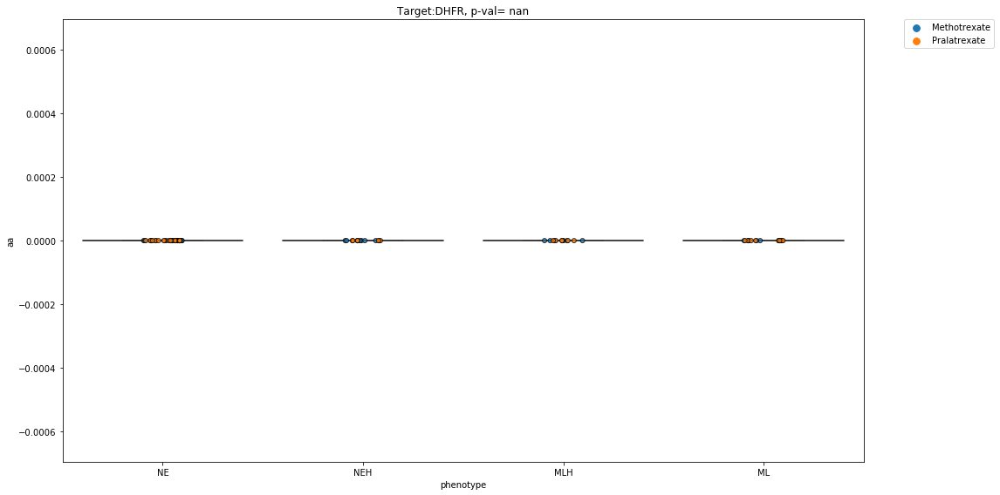

                    drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                               
COLO668    Teriflunomide  0.071170       MLH     0.0       0.0       0.0
CORL47     Teriflunomide  0.234264        NE     0.0       0.0       0.0
CORL88     Teriflunomide  0.023438       MLH     0.0       0.0       0.0
DMS114     Teriflunomide  0.314879        ML     0.0       0.0       0.0
DMS273     Teriflunomide  0.021842       NEH     0.0       0.0       0.0
DMS53      Teriflunomide  0.194786       MLH     0.0       0.0       0.0
DMS79      Teriflunomide  0.183191        NE     0.0       0.0       0.0
NCIH1048   Teriflunomide  0.354856        ML     0.0       0.0       0.0
NCIH1092   Teriflunomide  0.104854        NE     0.0       0.0       0.0
NCIH1105   Teriflunomide  0.121429        NE     0.0       0.0       0.0
NCIH1341   Teriflunomide  0.221706        ML     0.0       0.0       0.0
NCIH1436   Teriflunomide  0.261052        NE     0.

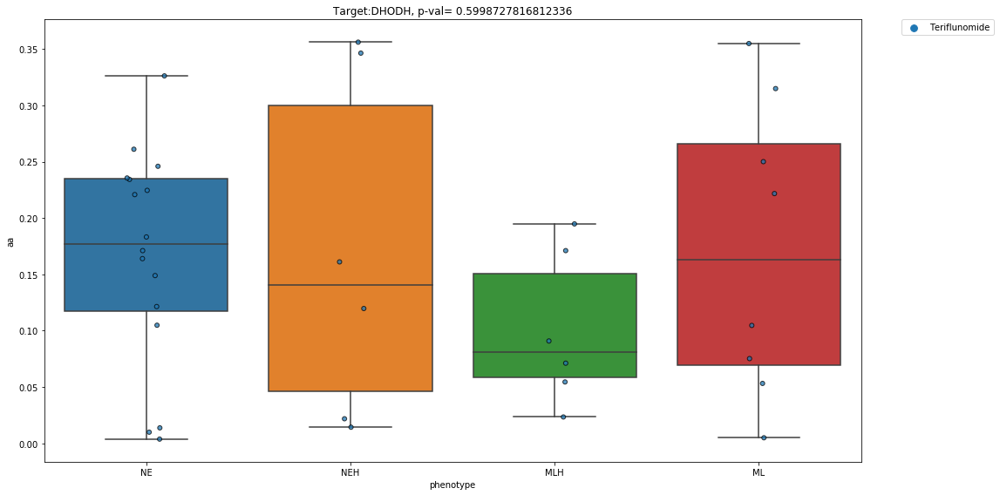

                  drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668    Finasteride  0.097073       MLH     0.0       0.0       0.0
CORL88     Finasteride  0.031359       MLH     0.0       0.0       0.0
NCIH1092   Finasteride  0.039070        NE     0.0       0.0       0.0
NCIH1105   Finasteride  0.404058        NE     0.0       0.0       0.0
NCIH1618   Finasteride  0.224402        NE     0.0       0.0       0.0
NCIH1836   Finasteride  0.191666        NE     0.0       0.0       0.0
NCIH1876   Finasteride  0.632263        NE     0.0       0.0       0.0
NCIH1930   Finasteride  0.300790        NE     0.0       0.0       0.0
NCIH1963   Finasteride  0.370512        NE     0.0       0.0       0.0
NCIH2029   Finasteride  0.311562       MLH     0.0       0.0       0.0
NCIH2066   Finasteride  0.247776        ML     0.0       0.0       0.0
NCIH209    Finasteride  0.091236        NE     0.0       0.0       0.0
NCIH21

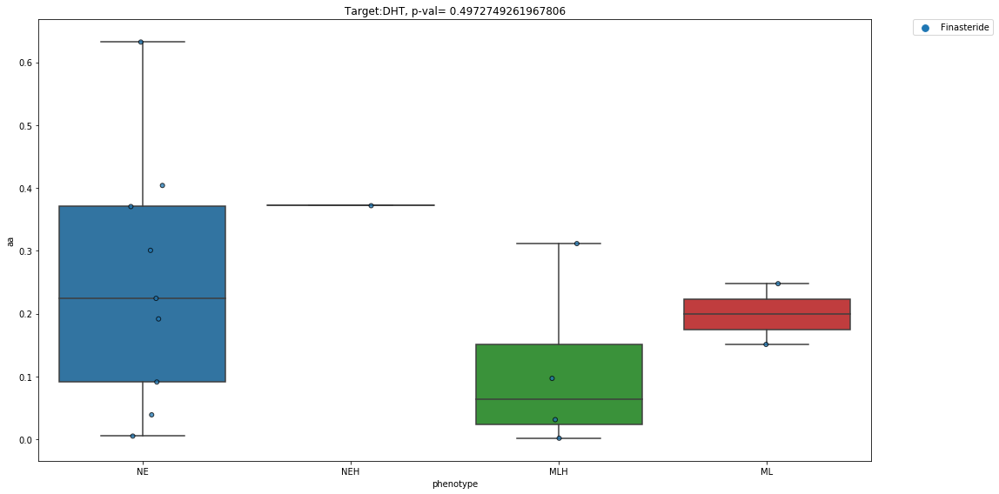

                     drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                
COLO668       Altretamine  0.000000       MLH     0.0       0.0       0.0
CORL47        Altretamine  0.000000        NE     0.0       0.0       0.0
CORL88        Altretamine  0.000000       MLH     0.0       0.0       0.0
DMS114        Altretamine  0.000000        ML     0.0       0.0       0.0
DMS273        Altretamine  0.000000       NEH     0.0       0.0       0.0
...                   ...       ...       ...     ...       ...       ...
NCIH82     Uracil mustard  0.424817       NEH     0.0       0.0       0.0
NCIH841    Uracil mustard  0.647923        ML     0.0       0.0       0.0
NCIH889    Uracil mustard  0.126410        NE     0.0       0.0       0.0
SHP77      Uracil mustard  0.189894       MLH     0.0       0.0       0.0
SW1271     Uracil mustard  0.212017        ML     0.0       0.0       0.0

[846 rows x 6 columns]
DNA ALKYLATOR


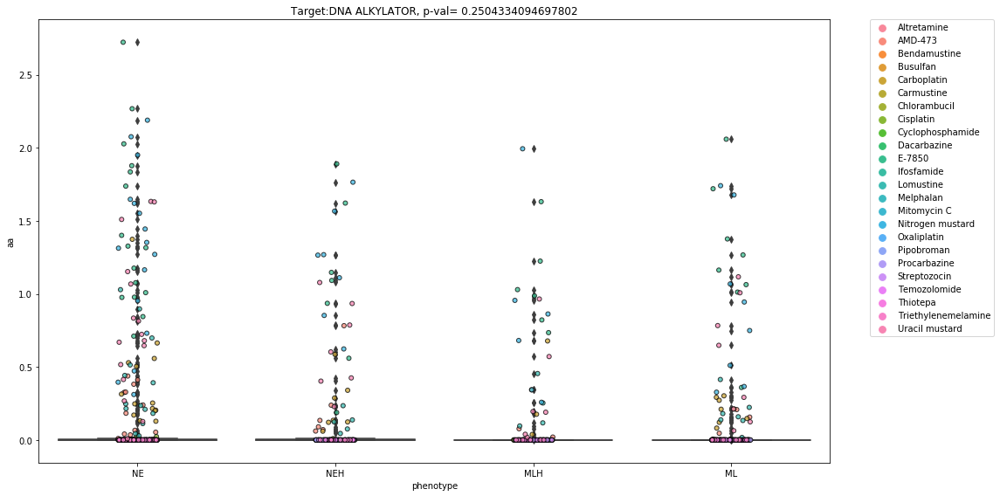

                 drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                            
COLO668        PI-103  1.162058       MLH     0.0       0.0       0.0
CORL47         PI-103  0.393001        NE     0.0       0.0       0.0
CORL88         PI-103  0.209529       MLH     0.0       0.0       0.0
DMS114         PI-103  1.492822        ML     0.0       0.0       0.0
DMS273         PI-103  0.635790       NEH     0.0       0.0       0.0
...               ...       ...       ...     ...       ...       ...
NCIH82     Wortmannin  0.079387       NEH     0.0       0.0       0.0
NCIH841    Wortmannin  0.305053        ML     0.0       0.0       0.0
NCIH889    Wortmannin  0.044679        NE     0.0       0.0       0.0
SHP77      Wortmannin  0.032359       MLH     0.0       0.0       0.0
SW1271     Wortmannin  0.420875        ML     0.0       0.0       0.0

[72 rows x 6 columns]
DNAPK


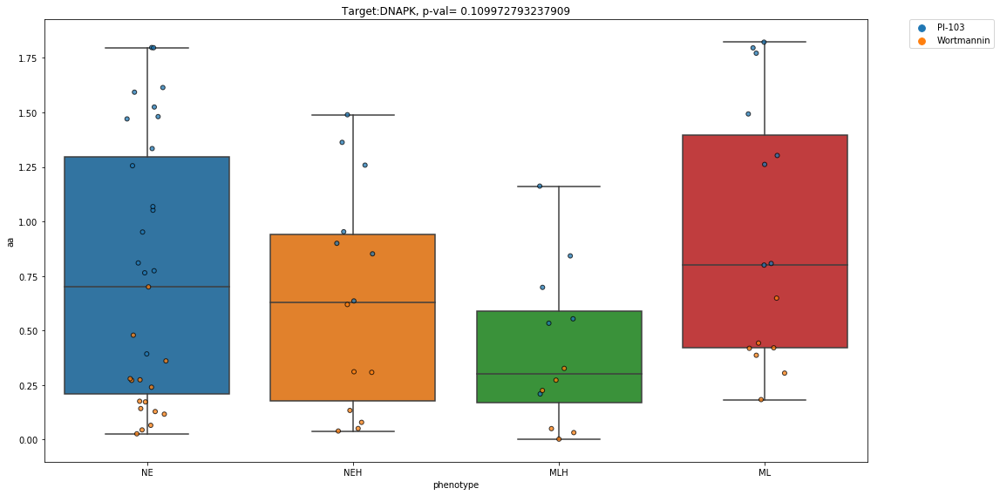

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                  drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                        
COLO668    Azacitidine  0.0       MLH     0.0       0.0       0.0
CORL47     Azacitidine  0.0        NE     0.0       0.0       0.0
CORL88     Azacitidine  0.0       MLH     0.0       0.0       0.0
DMS114     Azacitidine  0.0        ML     0.0       0.0       0.0
DMS273     Azacitidine  0.0       NEH     0.0       0.0       0.0
...                ...  ...       ...     ...       ...       ...
NCIH82      Decitabine  0.0       NEH     0.0       0.0       0.0
NCIH841     Decitabine  0.0        ML     0.0       0.0       0.0
NCIH889     Decitabine  0.0        NE     0.0       0.0       0.0
SHP77       Decitabine  0.0       MLH     0.0       0.0       0.0
SW1271      Decitabine  0.0        ML     0.0       0.0       0.0

[74 rows x 6 columns]
DNMT


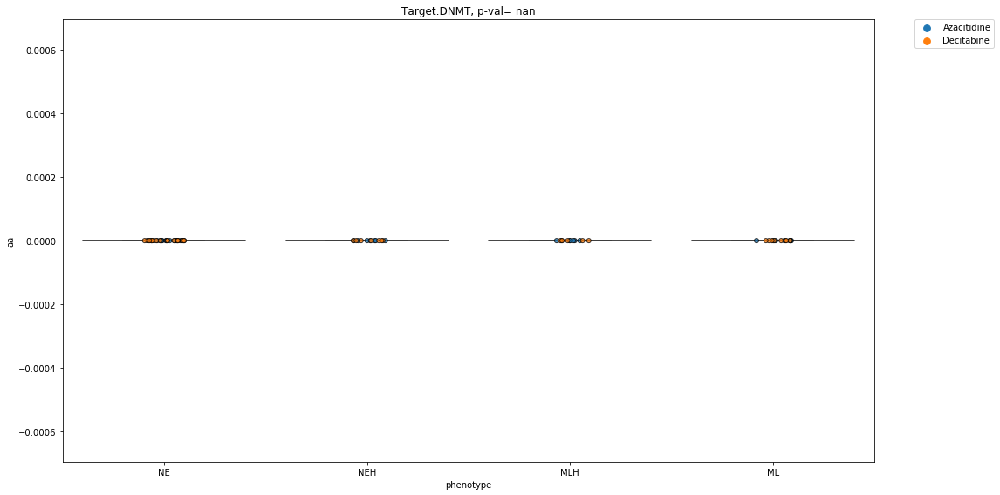

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668    AEE-788   0.000000       MLH     0.0       0.0       0.0
CORL47     AEE-788   0.000000        NE     0.0       0.0       0.0
CORL88     AEE-788   0.000000       MLH     0.0       0.0       0.0
DMS114     AEE-788   0.000000        ML     0.0       0.0       0.0
DMS273     AEE-788   0.000000       NEH     0.0       0.0       0.0
...             ...       ...       ...     ...       ...       ...
NCIH82      WZ-4002  0.083194       NEH     0.0       0.0       0.0
NCIH841     WZ-4002  0.478613        ML     0.0       0.0       0.0
NCIH889     WZ-4002  0.119447        NE     0.0       0.0       0.0
SHP77       WZ-4002  0.042138       MLH     0.0       0.0       0.0
SW1271      WZ-4002  0.190286        ML     0.0       0.0       0.0

[446 rows x 6 columns]
EGFR


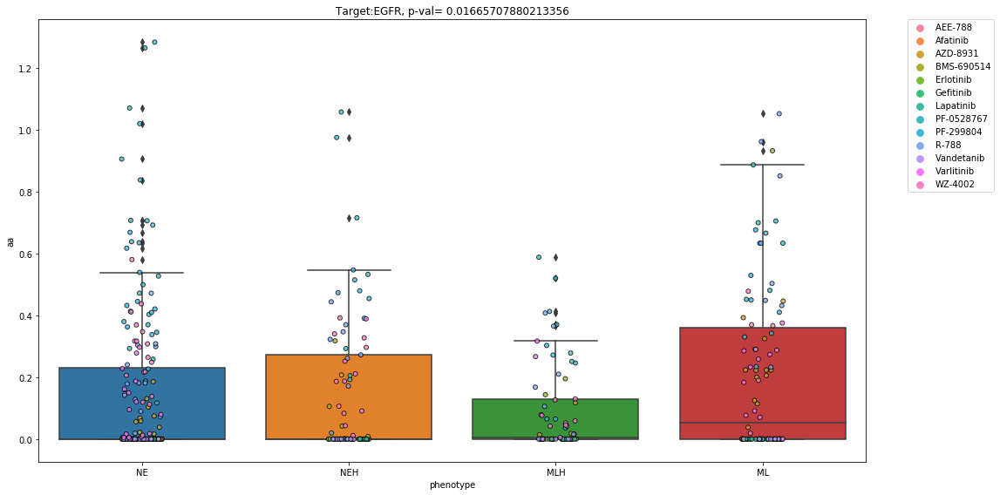

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668    UNC-0638  0.267040       MLH     0.0       0.0       0.0
CORL47     UNC-0638  0.021982        NE     0.0       0.0       0.0
CORL88     UNC-0638  0.018344       MLH     0.0       0.0       0.0
DMS114     UNC-0638  0.328827        ML     0.0       0.0       0.0
DMS273     UNC-0638  0.111381       NEH     0.0       0.0       0.0
DMS53      UNC-0638  0.245744       MLH     0.0       0.0       0.0
DMS79      UNC-0638  0.149488        NE     0.0       0.0       0.0
NCIH1048   UNC-0638  0.205017        ML     0.0       0.0       0.0
NCIH1092   UNC-0638  0.000387        NE     0.0       0.0       0.0
NCIH1105   UNC-0638  0.120980        NE     0.0       0.0       0.0
NCIH1436   UNC-0638  0.144066        NE     0.0       0.0       0.0
NCIH146    UNC-0638  0.507923        NE     0.0       0.0       0.0
NCIH1618   UNC-0638  0.008182        NE     0.0 

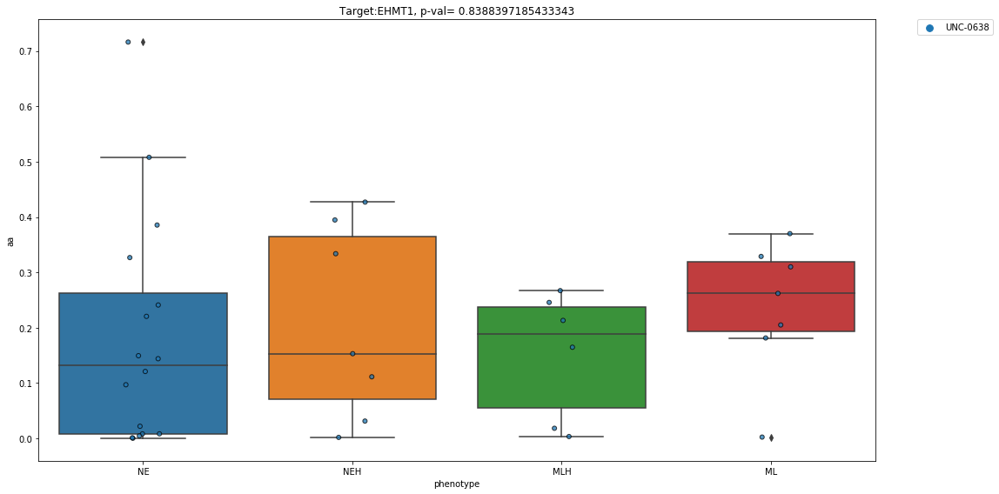

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668    UNC-0638  0.267040       MLH     0.0       0.0       0.0
CORL47     UNC-0638  0.021982        NE     0.0       0.0       0.0
CORL88     UNC-0638  0.018344       MLH     0.0       0.0       0.0
DMS114     UNC-0638  0.328827        ML     0.0       0.0       0.0
DMS273     UNC-0638  0.111381       NEH     0.0       0.0       0.0
DMS53      UNC-0638  0.245744       MLH     0.0       0.0       0.0
DMS79      UNC-0638  0.149488        NE     0.0       0.0       0.0
NCIH1048   UNC-0638  0.205017        ML     0.0       0.0       0.0
NCIH1092   UNC-0638  0.000387        NE     0.0       0.0       0.0
NCIH1105   UNC-0638  0.120980        NE     0.0       0.0       0.0
NCIH1436   UNC-0638  0.144066        NE     0.0       0.0       0.0
NCIH146    UNC-0638  0.507923        NE     0.0       0.0       0.0
NCIH1618   UNC-0638  0.008182        NE     0.0 

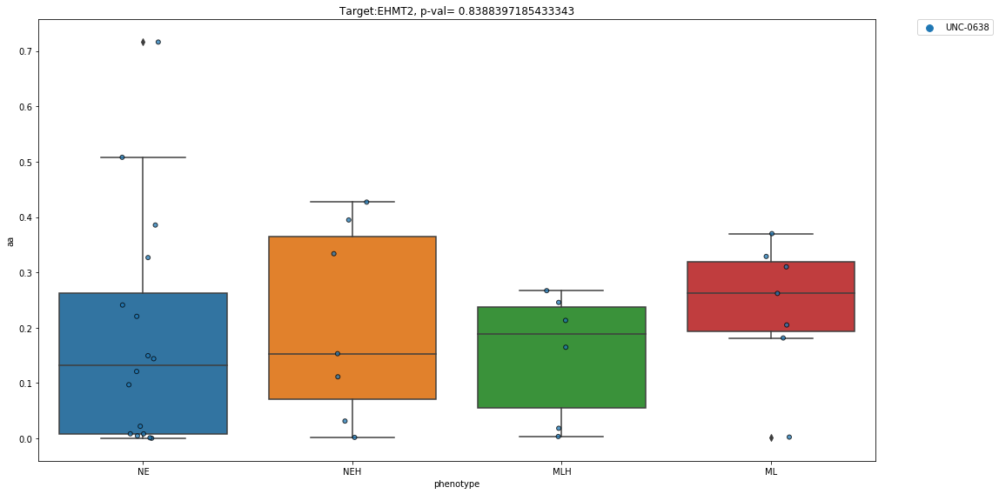

                drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                           
COLO668    Dasatinib  0.000000       MLH     0.0       0.0       0.0
CORL47     Dasatinib  0.000000        NE     0.0       0.0       0.0
CORL88     Dasatinib  0.000000       MLH     0.0       0.0       0.0
DMS114     Dasatinib  0.000000        ML     0.0       0.0       0.0
DMS273     Dasatinib  0.000000       NEH     0.0       0.0       0.0
...              ...       ...       ...     ...       ...       ...
NCIH69        JI-101  0.106529        NE     0.0       0.0       0.0
NCIH841       JI-101  0.083832        ML     0.0       0.0       0.0
NCIH889       JI-101  0.032597        NE     0.0       0.0       0.0
SHP77         JI-101  0.094788       MLH     0.0       0.0       0.0
SW1271        JI-101  0.181181        ML     0.0       0.0       0.0

[71 rows x 6 columns]
EPHA2


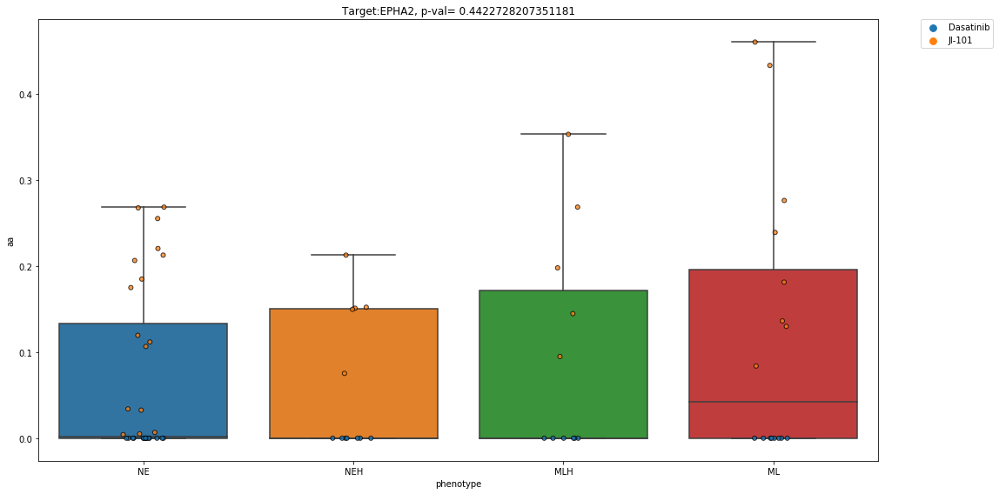

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                 drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                       
COLO668    Exemestane  0.0       MLH     0.0       0.0       0.0
CORL47     Exemestane  0.0        NE     0.0       0.0       0.0
CORL88     Exemestane  0.0       MLH     0.0       0.0       0.0
DMS114     Exemestane  0.0        ML     0.0       0.0       0.0
DMS273     Exemestane  0.0       NEH     0.0       0.0       0.0
...               ...  ...       ...     ...       ...       ...
NCIH82      Tamoxifen  0.0       NEH     0.0       0.0       0.0
NCIH841     Tamoxifen  0.0        ML     0.0       0.0       0.0
NCIH889     Tamoxifen  0.0        NE     0.0       0.0       0.0
SHP77       Tamoxifen  0.0       MLH     0.0       0.0       0.0
SW1271      Tamoxifen  0.0        ML     0.0       0.0       0.0

[220 rows x 6 columns]
ER


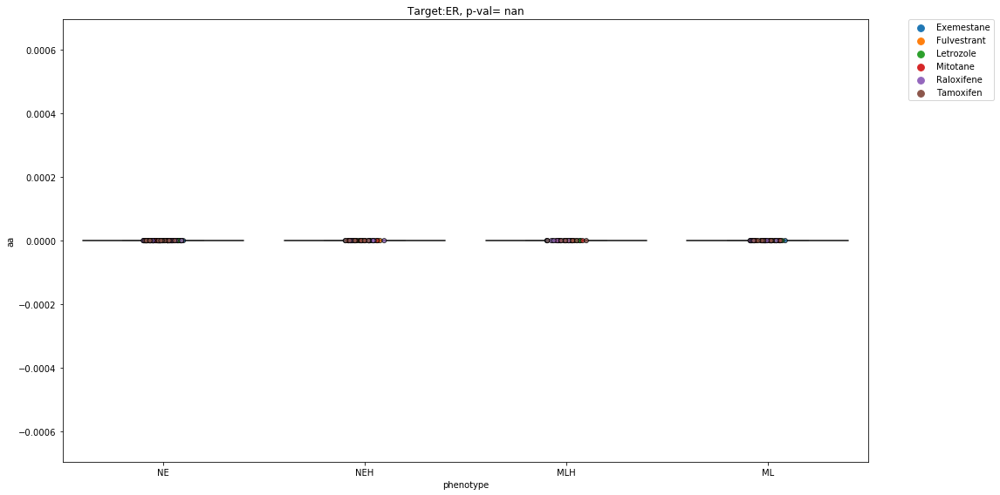

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668    YK-4-279  0.524237       MLH     0.0       0.0       0.0
CORL47     YK-4-279  0.411870        NE     0.0       0.0       0.0
CORL88     YK-4-279  0.269891       MLH     0.0       0.0       0.0
DMS114     YK-4-279  0.920599        ML     0.0       0.0       0.0
DMS273     YK-4-279  0.578962       NEH     0.0       0.0       0.0
DMS53      YK-4-279  0.399143       MLH     0.0       0.0       0.0
DMS79      YK-4-279  0.290339        NE     0.0       0.0       0.0
NCIH1048   YK-4-279  0.963275        ML     0.0       0.0       0.0
NCIH1092   YK-4-279  0.340255        NE     0.0       0.0       0.0
NCIH1105   YK-4-279  0.652788        NE     0.0       0.0       0.0
NCIH1341   YK-4-279  0.728880        ML     0.0       0.0       0.0
NCIH1436   YK-4-279  0.699453        NE     0.0       0.0       0.0
NCIH146    YK-4-279  0.751944        NE     0.0 

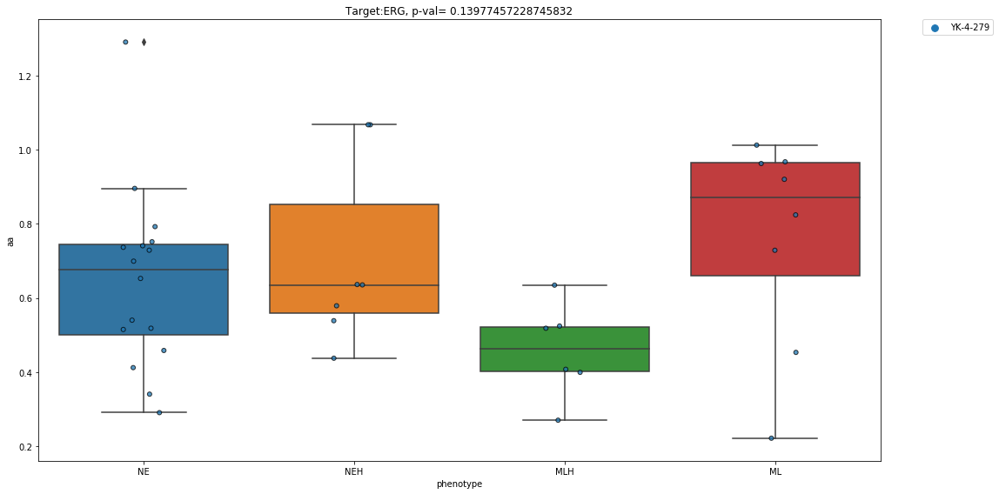

              drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668    RG-7167  8.694918e-01       MLH     0.0       0.0       0.0
DMS114     RG-7167  9.091702e-01        ML     0.0       0.0       0.0
DMS273     RG-7167  2.394343e-01       NEH     0.0       0.0       0.0
DMS53      RG-7167  2.930259e-01       MLH     0.0       0.0       0.0
NCIH1048   RG-7167  2.645841e-01        ML     0.0       0.0       0.0
NCIH1092   RG-7167  3.935034e-02        NE     0.0       0.0       0.0
NCIH1341   RG-7167  1.018364e-01        ML     0.0       0.0       0.0
NCIH1436   RG-7167  5.030410e-01        NE     0.0       0.0       0.0
NCIH146    RG-7167  2.490222e-01        NE     0.0       0.0       0.0
NCIH1618   RG-7167  9.780000e-10        NE     0.0       0.0       0.0
NCIH1694   RG-7167  2.703037e-01       NEH     0.0       0.0       0.0
NCIH1836   RG-7167  2.319683e-02        NE     0.0       0.0       0.0
NCIH19

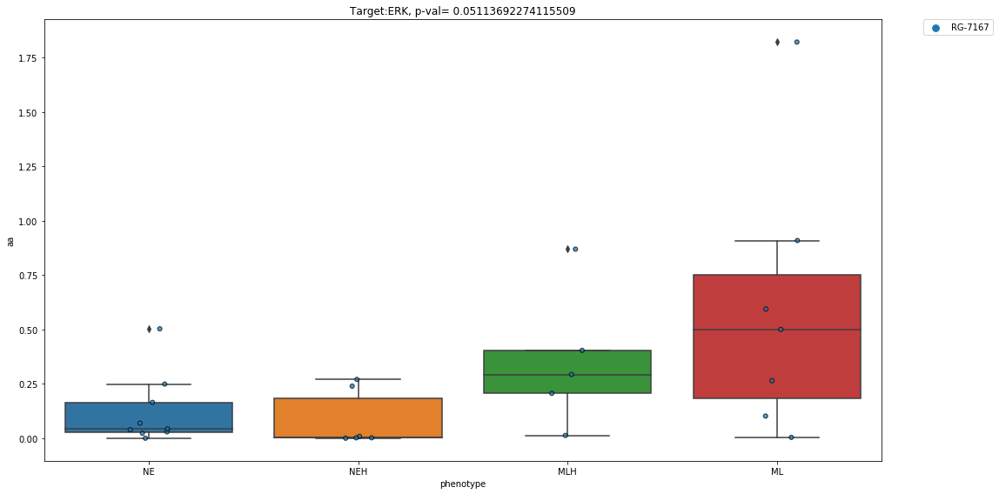

               drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
COLO668    AZD-6244  2.674337e-01       MLH     0.0       0.0       0.0
CORL88     AZD-6244  1.680000e-14       MLH     0.0       0.0       0.0
DMS114     AZD-6244  5.485768e-01        ML     0.0       0.0       0.0
DMS53      AZD-6244  5.049926e-02       MLH     0.0       0.0       0.0
DMS79      AZD-6244  1.790000e-10        NE     0.0       0.0       0.0
NCIH1048   AZD-6244  3.729394e-03        ML     0.0       0.0       0.0
NCIH1341   AZD-6244  2.490000e-17        ML     0.0       0.0       0.0
NCIH1436   AZD-6244  1.274071e-01        NE     0.0       0.0       0.0
NCIH1618   AZD-6244  2.454982e-02        NE     0.0       0.0       0.0
NCIH1694   AZD-6244  8.428383e-03       NEH     0.0       0.0       0.0
NCIH1963   AZD-6244  2.100000e-09        NE     0.0       0.0       0.0
NCIH2029   AZD-6244  4.790000e-17       MLH     0.0       0.0   

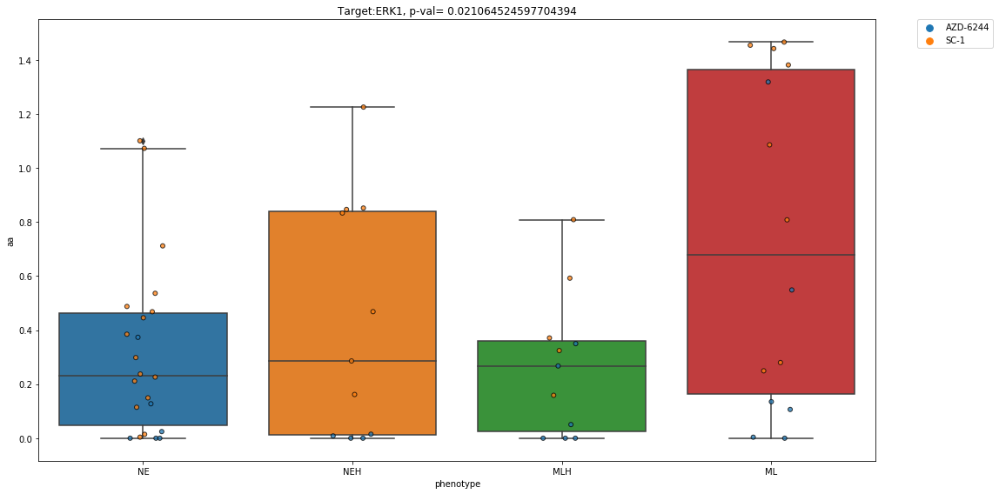

           drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
CORL88     YC-1  8.327821e-01       MLH     0.0       0.0       0.0
DMS273     YC-1  1.252928e-01       NEH     0.0       0.0       0.0
DMS53      YC-1  1.385974e-01       MLH     0.0       0.0       0.0
DMS79      YC-1  4.575105e-03        NE     0.0       0.0       0.0
NCIH1048   YC-1  3.776705e-02        ML     0.0       0.0       0.0
NCIH1092   YC-1  2.108748e-02        NE     0.0       0.0       0.0
NCIH1105   YC-1  6.232240e-04        NE     0.0       0.0       0.0
NCIH1341   YC-1  1.884415e-01        ML     0.0       0.0       0.0
NCIH1436   YC-1  5.767900e-02        NE     0.0       0.0       0.0
NCIH146    YC-1  9.558606e-02        NE     0.0       0.0       0.0
NCIH1618   YC-1  2.366842e-01        NE     0.0       0.0       0.0
NCIH1836   YC-1  4.964524e-03        NE     0.0       0.0       0.0
NCIH1876   YC-1  2.115131e-01        NE     0.0 

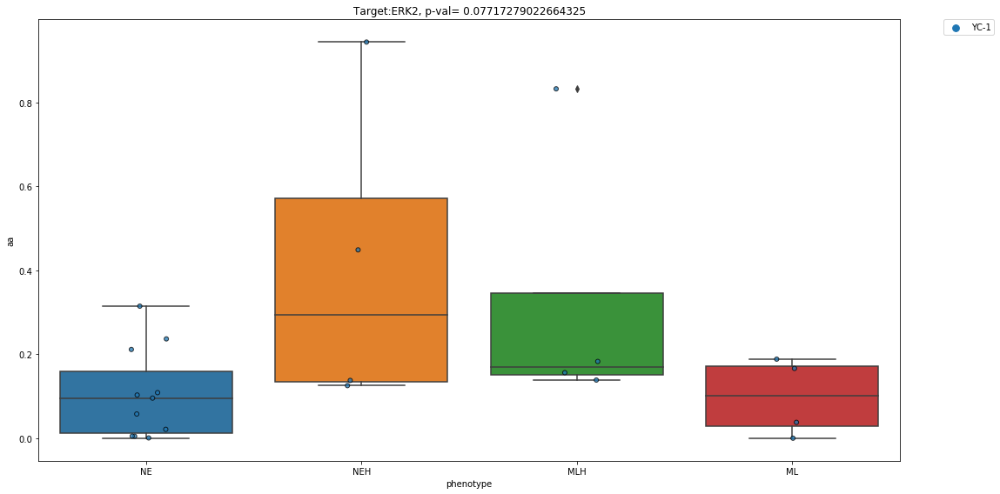

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                      
COLO668    Tamoxifen  0.0       MLH     0.0       0.0       0.0
CORL47     Tamoxifen  0.0        NE     0.0       0.0       0.0
CORL88     Tamoxifen  0.0       MLH     0.0       0.0       0.0
DMS114     Tamoxifen  0.0        ML     0.0       0.0       0.0
DMS273     Tamoxifen  0.0       NEH     0.0       0.0       0.0
DMS53      Tamoxifen  0.0       MLH     0.0       0.0       0.0
DMS79      Tamoxifen  0.0        NE     0.0       0.0       0.0
NCIH1048   Tamoxifen  0.0        ML     0.0       0.0       0.0
NCIH1092   Tamoxifen  0.0        NE     0.0       0.0       0.0
NCIH1105   Tamoxifen  0.0        NE     0.0       0.0       0.0
NCIH1341   Tamoxifen  0.0        ML     0.0       0.0       0.0
NCIH1436   Tamoxifen  0.0        NE     0.0       0.0       0.0
NCIH146    Tamoxifen  0.0        NE     0.0       0.0       0.0
NCIH1618   Tamoxifen  0.0        NE     

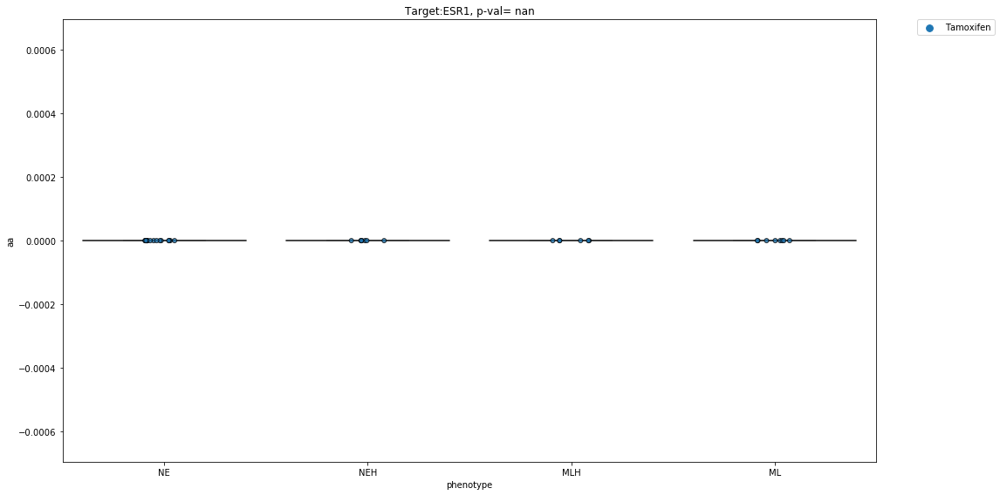

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                      
COLO668    Tamoxifen  0.0       MLH     0.0       0.0       0.0
CORL47     Tamoxifen  0.0        NE     0.0       0.0       0.0
CORL88     Tamoxifen  0.0       MLH     0.0       0.0       0.0
DMS114     Tamoxifen  0.0        ML     0.0       0.0       0.0
DMS273     Tamoxifen  0.0       NEH     0.0       0.0       0.0
DMS53      Tamoxifen  0.0       MLH     0.0       0.0       0.0
DMS79      Tamoxifen  0.0        NE     0.0       0.0       0.0
NCIH1048   Tamoxifen  0.0        ML     0.0       0.0       0.0
NCIH1092   Tamoxifen  0.0        NE     0.0       0.0       0.0
NCIH1105   Tamoxifen  0.0        NE     0.0       0.0       0.0
NCIH1341   Tamoxifen  0.0        ML     0.0       0.0       0.0
NCIH1436   Tamoxifen  0.0        NE     0.0       0.0       0.0
NCIH146    Tamoxifen  0.0        NE     0.0       0.0       0.0
NCIH1618   Tamoxifen  0.0        NE     

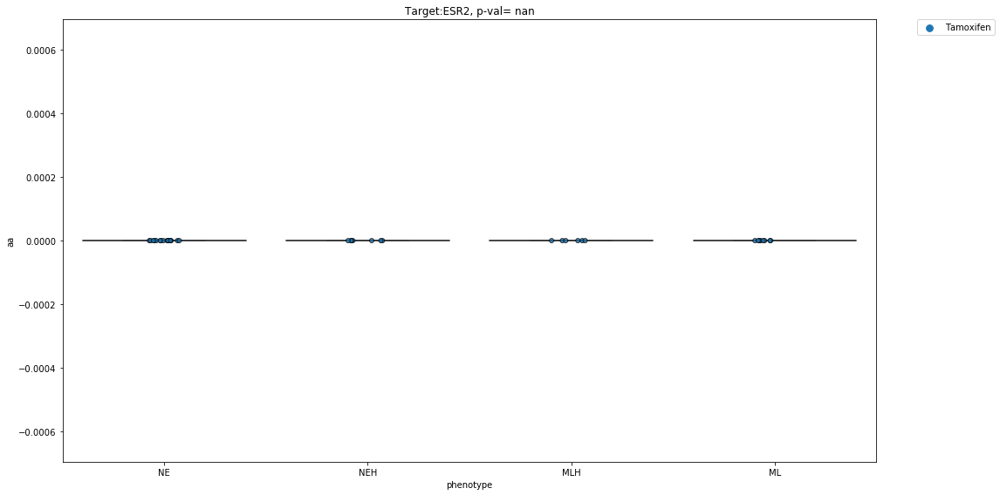

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668    YK-4-279  0.524237       MLH     0.0       0.0       0.0
CORL47     YK-4-279  0.411870        NE     0.0       0.0       0.0
CORL88     YK-4-279  0.269891       MLH     0.0       0.0       0.0
DMS114     YK-4-279  0.920599        ML     0.0       0.0       0.0
DMS273     YK-4-279  0.578962       NEH     0.0       0.0       0.0
DMS53      YK-4-279  0.399143       MLH     0.0       0.0       0.0
DMS79      YK-4-279  0.290339        NE     0.0       0.0       0.0
NCIH1048   YK-4-279  0.963275        ML     0.0       0.0       0.0
NCIH1092   YK-4-279  0.340255        NE     0.0       0.0       0.0
NCIH1105   YK-4-279  0.652788        NE     0.0       0.0       0.0
NCIH1341   YK-4-279  0.728880        ML     0.0       0.0       0.0
NCIH1436   YK-4-279  0.699453        NE     0.0       0.0       0.0
NCIH146    YK-4-279  0.751944        NE     0.0 

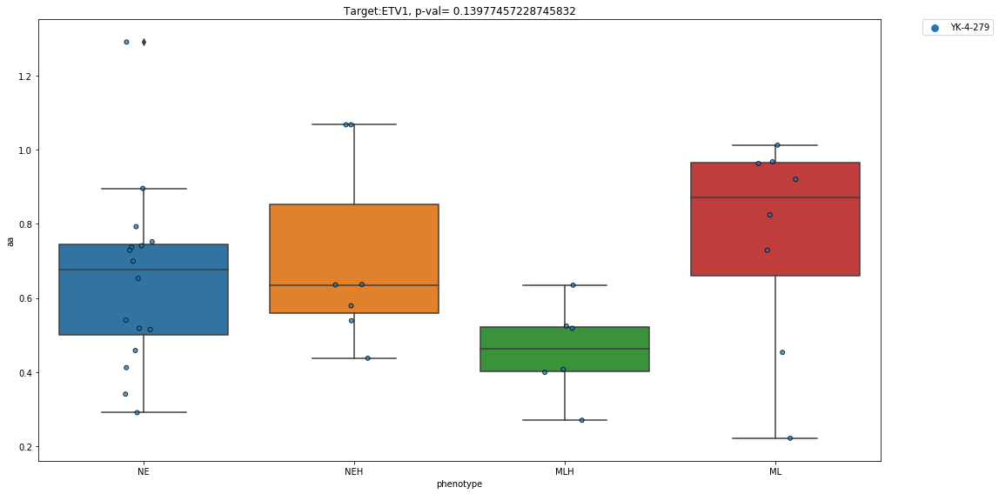

              drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668        BIA  3.109020e-01       MLH     0.0       0.0       0.0
CORL47         BIA  6.082254e-02        NE     0.0       0.0       0.0
CORL88         BIA  4.391921e-01       MLH     0.0       0.0       0.0
DMS114         BIA  4.326987e-02        ML     0.0       0.0       0.0
DMS273         BIA  2.222066e-01       NEH     0.0       0.0       0.0
DMS53          BIA  2.584549e-01       MLH     0.0       0.0       0.0
DMS79          BIA  4.664093e-02        NE     0.0       0.0       0.0
NCIH1048       BIA  5.784755e-01        ML     0.0       0.0       0.0
NCIH1092       BIA  4.706396e-01        NE     0.0       0.0       0.0
NCIH1105       BIA  3.929237e-01        NE     0.0       0.0       0.0
NCIH1341       BIA  7.458885e-01        ML     0.0       0.0       0.0
NCIH1436       BIA  2.178821e-01        NE     0.0       0.0       0.0
NCIH14

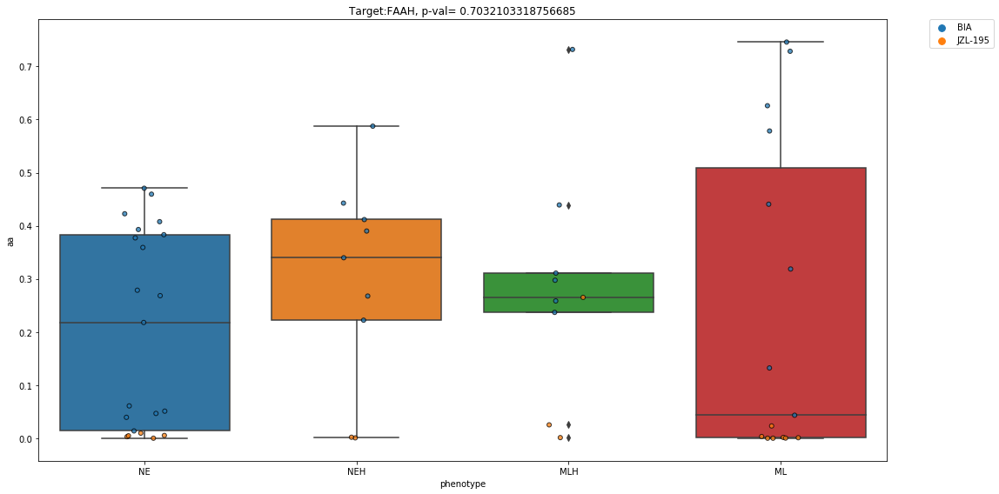

                drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                           
COLO668    PF-562271  0.463134       MLH     0.0       0.0       0.0
CORL47     PF-562271  0.349401        NE     0.0       0.0       0.0
CORL88     PF-562271  0.229190       MLH     0.0       0.0       0.0
DMS114     PF-562271  0.495819        ML     0.0       0.0       0.0
DMS273     PF-562271  0.476037       NEH     0.0       0.0       0.0
DMS53      PF-562271  0.182862       MLH     0.0       0.0       0.0
DMS79      PF-562271  0.240958        NE     0.0       0.0       0.0
NCIH1048   PF-562271  0.710035        ML     0.0       0.0       0.0
NCIH1092   PF-562271  0.267168        NE     0.0       0.0       0.0
NCIH1105   PF-562271  0.309985        NE     0.0       0.0       0.0
NCIH1341   PF-562271  0.614818        ML     0.0       0.0       0.0
NCIH1436   PF-562271  0.296646        NE     0.0       0.0       0.0
NCIH146    PF-562271  0.371940    

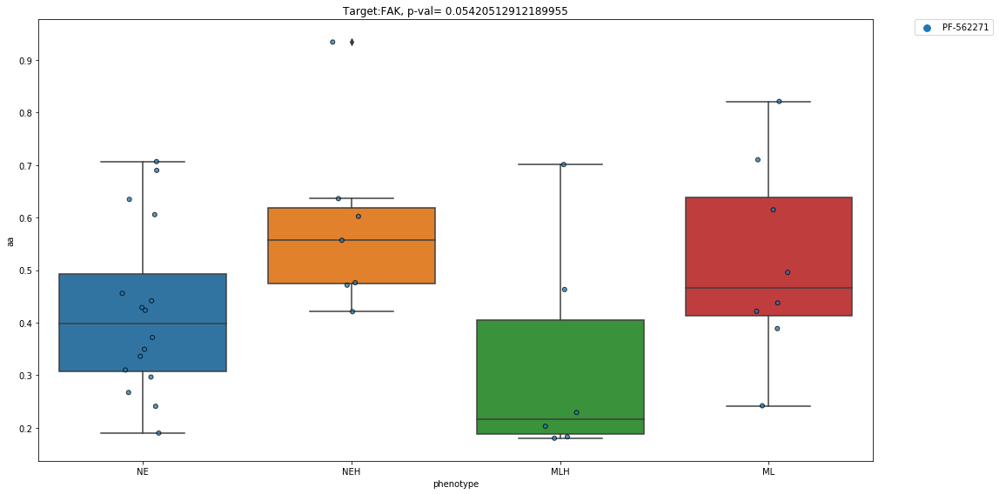

           drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                      
COLO668    C-75  0.003060       MLH     0.0       0.0       0.0
CORL47     C-75  0.142956        NE     0.0       0.0       0.0
CORL88     C-75  0.250538       MLH     0.0       0.0       0.0
DMS53      C-75  0.000807       MLH     0.0       0.0       0.0
DMS79      C-75  0.172954        NE     0.0       0.0       0.0
NCIH1048   C-75  0.365734        ML     0.0       0.0       0.0
NCIH1092   C-75  0.030127        NE     0.0       0.0       0.0
NCIH1105   C-75  0.177728        NE     0.0       0.0       0.0
NCIH1341   C-75  0.062621        ML     0.0       0.0       0.0
NCIH1436   C-75  0.101050        NE     0.0       0.0       0.0
NCIH146    C-75  0.003610        NE     0.0       0.0       0.0
NCIH1618   C-75  0.094706        NE     0.0       0.0       0.0
NCIH1694   C-75  0.232851       NEH     0.0       0.0       0.0
NCIH1836   C-75  0.091334        NE     

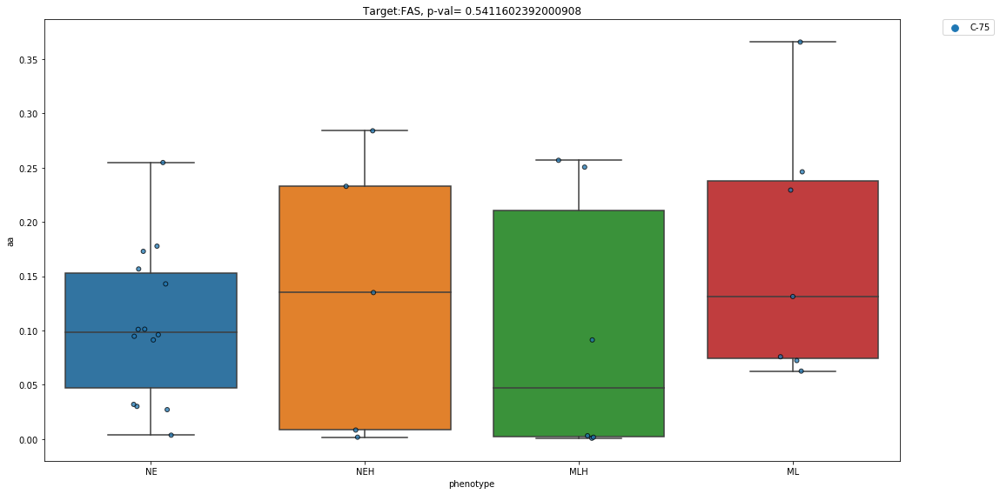

                        drug            aa phenotype  aa_new  hill_new  \
cell.line                                                                
CORL47     analog of S-49076  1.990000e-09        NE     0.0       0.0   
DMS273     analog of S-49076  3.513179e-01       NEH     0.0       0.0   
DMS53      analog of S-49076  9.290914e-02       MLH     0.0       0.0   
NCIH1436   analog of S-49076  2.120000e-11        NE     0.0       0.0   
NCIH1618   analog of S-49076  8.560000e-11        NE     0.0       0.0   
...                      ...           ...       ...     ...       ...   
NCIH82             Ponatinib  0.000000e+00       NEH     0.0       0.0   
NCIH841            Ponatinib  0.000000e+00        ML     0.0       0.0   
NCIH889            Ponatinib  0.000000e+00        NE     0.0       0.0   
SHP77              Ponatinib  0.000000e+00       MLH     0.0       0.0   
SW1271             Ponatinib  0.000000e+00        ML     0.0       0.0   

           emax_new  
cell.line      

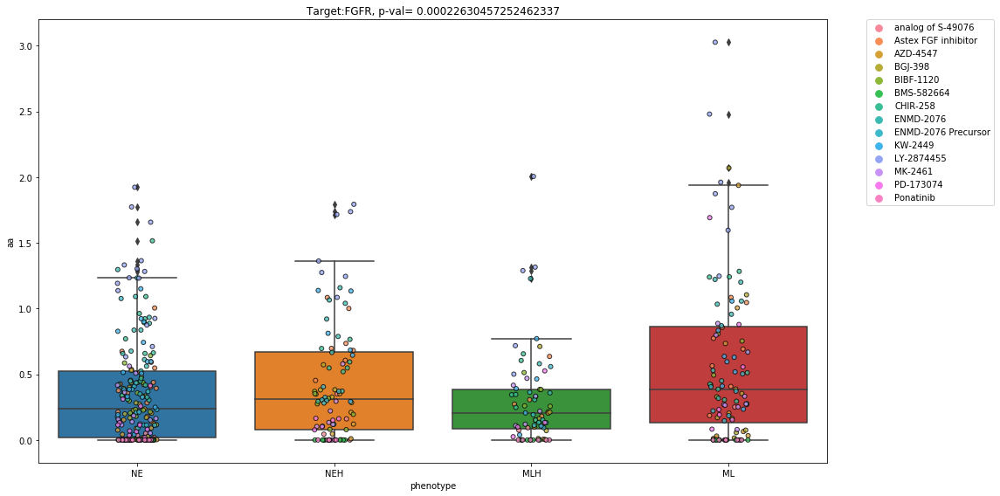

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                 drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                       
COLO668    Tacrolimus  0.0       MLH     0.0       0.0       0.0
CORL47     Tacrolimus  0.0        NE     0.0       0.0       0.0
CORL88     Tacrolimus  0.0       MLH     0.0       0.0       0.0
DMS114     Tacrolimus  0.0        ML     0.0       0.0       0.0
DMS273     Tacrolimus  0.0       NEH     0.0       0.0       0.0
DMS53      Tacrolimus  0.0       MLH     0.0       0.0       0.0
DMS79      Tacrolimus  0.0        NE     0.0       0.0       0.0
NCIH1048   Tacrolimus  0.0        ML     0.0       0.0       0.0
NCIH1092   Tacrolimus  0.0        NE     0.0       0.0       0.0
NCIH1105   Tacrolimus  0.0        NE     0.0       0.0       0.0
NCIH1341   Tacrolimus  0.0        ML     0.0       0.0       0.0
NCIH1436   Tacrolimus  0.0        NE     0.0       0.0       0.0
NCIH146    Tacrolimus  0.0        NE     0.0       0.0       0.0
NCIH1618   Tacrolimus  0.

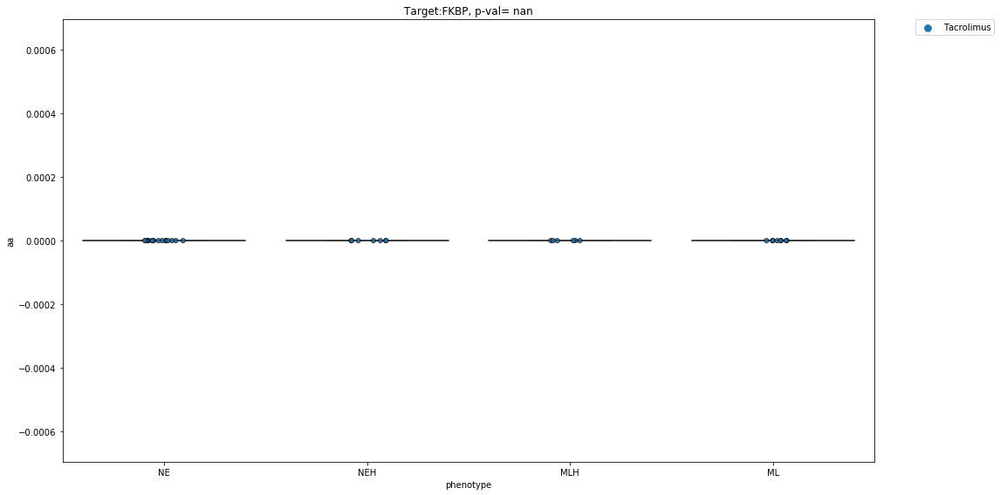

             drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                        
COLO668    AC-220  0.043024       MLH     0.0       0.0       0.0
CORL47     AC-220  0.050475        NE     0.0       0.0       0.0
DMS114     AC-220  0.498568        ML     0.0       0.0       0.0
DMS53      AC-220  0.244199       MLH     0.0       0.0       0.0
DMS79      AC-220  0.042471        NE     0.0       0.0       0.0
...           ...       ...       ...     ...       ...       ...
NCIH82      R-406  0.109517       NEH     0.0       0.0       0.0
NCIH841     R-406  0.431643        ML     0.0       0.0       0.0
NCIH889     R-406  0.095172        NE     0.0       0.0       0.0
SHP77       R-406  0.044939       MLH     0.0       0.0       0.0
SW1271      R-406  0.424236        ML     0.0       0.0       0.0

[285 rows x 6 columns]
FLT


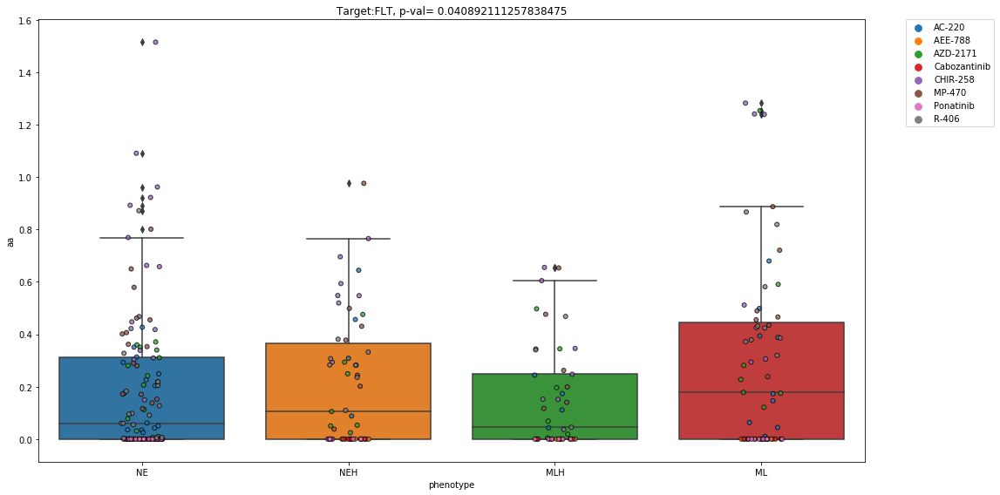

                 drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                            
COLO668       ABT-869  0.377139       MLH     0.0       0.0       0.0
CORL47        ABT-869  0.153714        NE     0.0       0.0       0.0
CORL88        ABT-869  0.068119       MLH     0.0       0.0       0.0
DMS114        ABT-869  0.348983        ML     0.0       0.0       0.0
DMS273        ABT-869  0.186562       NEH     0.0       0.0       0.0
...               ...       ...       ...     ...       ...       ...
NCIH82     Lenvatinib  0.000000       NEH     0.0       0.0       0.0
NCIH841    Lenvatinib  0.000000        ML     0.0       0.0       0.0
NCIH889    Lenvatinib  0.000000        NE     0.0       0.0       0.0
SHP77      Lenvatinib  0.000000       MLH     0.0       0.0       0.0
SW1271     Lenvatinib  0.000000        ML     0.0       0.0       0.0

[217 rows x 6 columns]
FLT1


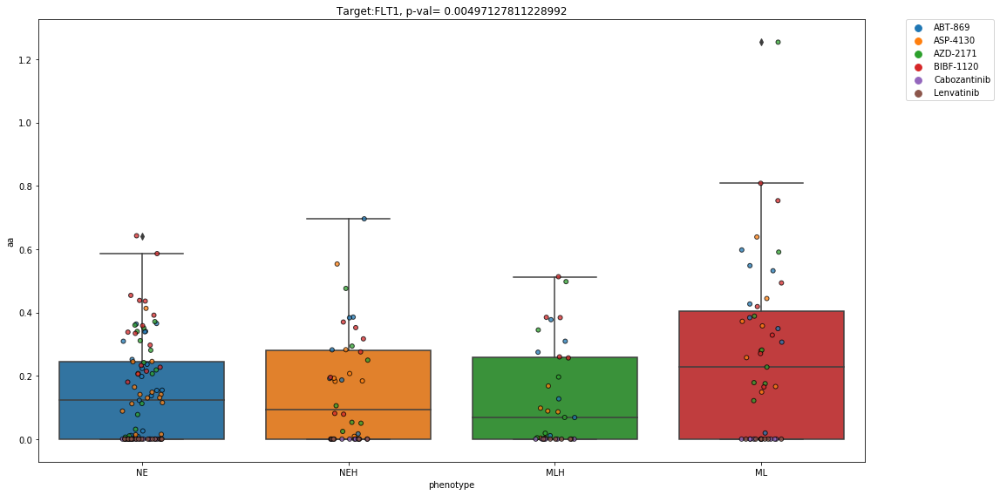

                drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                           
COLO668      ABT-869  0.377139       MLH     0.0       0.0       0.0
CORL47       ABT-869  0.153714        NE     0.0       0.0       0.0
CORL88       ABT-869  0.068119       MLH     0.0       0.0       0.0
DMS114       ABT-869  0.348983        ML     0.0       0.0       0.0
DMS273       ABT-869  0.186562       NEH     0.0       0.0       0.0
...              ...       ...       ...     ...       ...       ...
NCIH82     Sunitinib  0.000000       NEH     0.0       0.0       0.0
NCIH841    Sunitinib  0.000000        ML     0.0       0.0       0.0
NCIH889    Sunitinib  0.000000        NE     0.0       0.0       0.0
SHP77      Sunitinib  0.000000       MLH     0.0       0.0       0.0
SW1271     Sunitinib  0.000000        ML     0.0       0.0       0.0

[641 rows x 6 columns]
FLT3


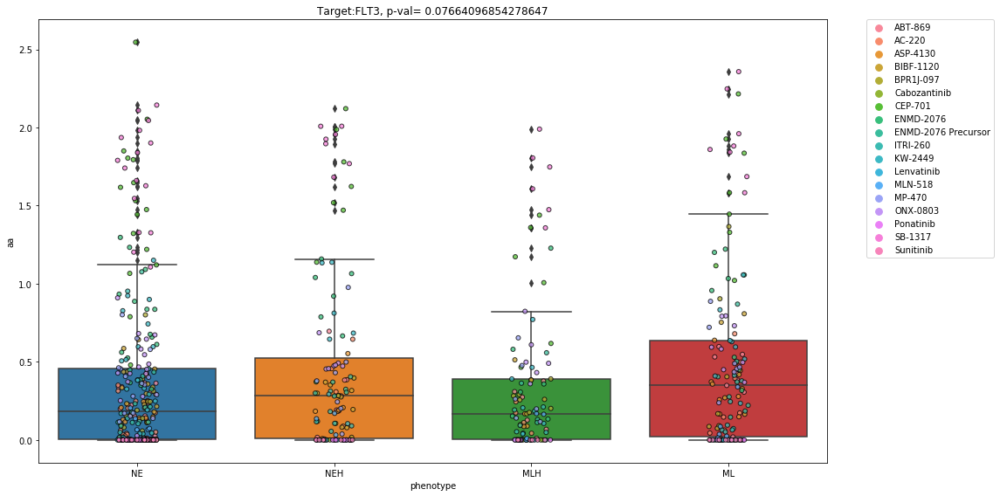

                   drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
COLO668        AZD-2171  0.196139       MLH     0.0       0.0       0.0
CORL47         AZD-2171  0.206488        NE     0.0       0.0       0.0
CORL88         AZD-2171  0.018524       MLH     0.0       0.0       0.0
DMS114         AZD-2171  1.253667        ML     0.0       0.0       0.0
DMS273         AZD-2171  0.293710       NEH     0.0       0.0       0.0
...                 ...       ...       ...     ...       ...       ...
NCIH82     Cabozantinib  0.000000       NEH     0.0       0.0       0.0
NCIH841    Cabozantinib  0.000000        ML     0.0       0.0       0.0
NCIH889    Cabozantinib  0.000000        NE     0.0       0.0       0.0
SHP77      Cabozantinib  0.000000       MLH     0.0       0.0       0.0
SW1271     Cabozantinib  0.000000        ML     0.0       0.0       0.0

[72 rows x 6 columns]
FLT4


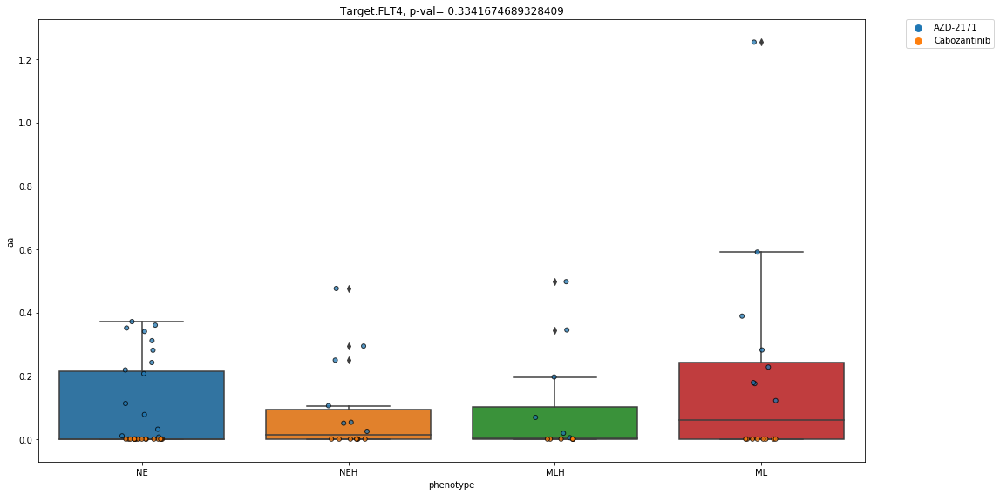

                drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                           
COLO668    PF-477736  1.228402       MLH     0.0       0.0       0.0
CORL47     PF-477736  0.911305        NE     0.0       0.0       0.0
CORL88     PF-477736  1.284080       MLH     0.0       0.0       0.0
DMS114     PF-477736  1.703788        ML     0.0       0.0       0.0
DMS273     PF-477736  0.842024       NEH     0.0       0.0       0.0
DMS53      PF-477736  0.684762       MLH     0.0       0.0       0.0
DMS79      PF-477736  0.494791        NE     0.0       0.0       0.0
NCIH1048   PF-477736  1.613696        ML     0.0       0.0       0.0
NCIH1092   PF-477736  0.682800        NE     0.0       0.0       0.0
NCIH1105   PF-477736  1.283063        NE     0.0       0.0       0.0
NCIH1341   PF-477736  1.525845        ML     0.0       0.0       0.0
NCIH1436   PF-477736  1.614653        NE     0.0       0.0       0.0
NCIH146    PF-477736  1.565209    

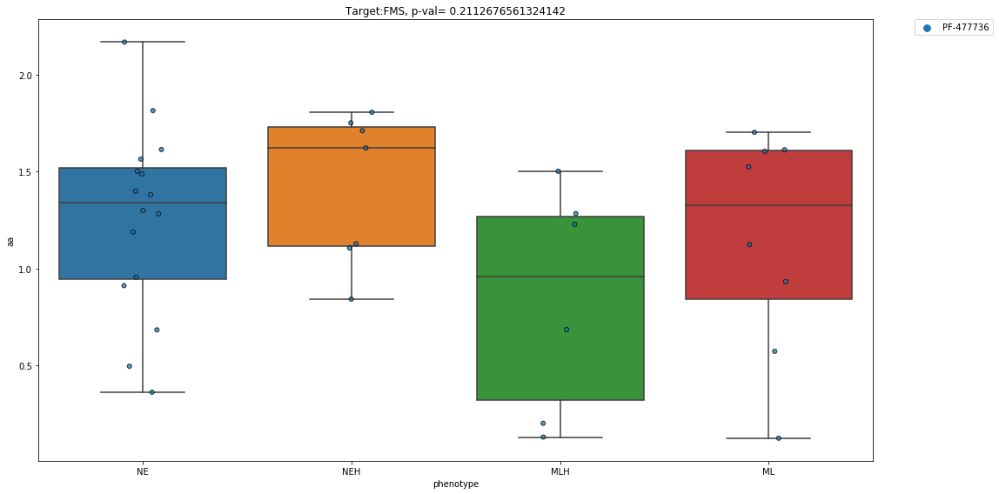

                drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                           
COLO668     AZD-2014  0.644077       MLH     0.0       0.0       0.0
CORL47      AZD-2014  0.383617        NE     0.0       0.0       0.0
DMS114      AZD-2014  2.132648        ML     0.0       0.0       0.0
DMS273      AZD-2014  1.054631       NEH     0.0       0.0       0.0
DMS53       AZD-2014  0.680085       MLH     0.0       0.0       0.0
...              ...       ...       ...     ...       ...       ...
NCIH82     Rapamycin  0.324078       NEH     0.0       0.0       0.0
NCIH841    Rapamycin  1.651014        ML     0.0       0.0       0.0
NCIH889    Rapamycin  0.995053        NE     0.0       0.0       0.0
SHP77      Rapamycin  0.458410       MLH     0.0       0.0       0.0
SW1271     Rapamycin  1.666683        ML     0.0       0.0       0.0

[70 rows x 6 columns]
FRAP


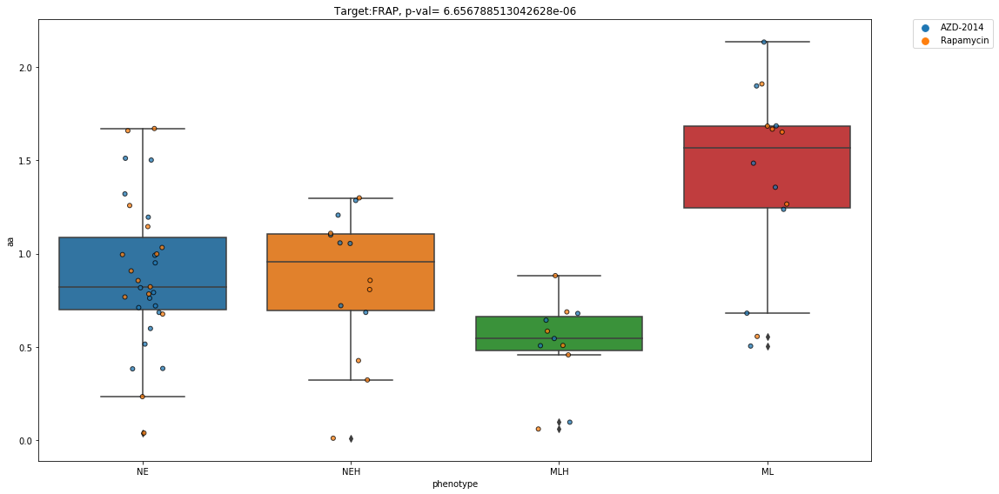

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668    R-115777  0.912076       MLH     0.0       0.0       0.0
CORL47     R-115777  0.946234        NE     0.0       0.0       0.0
CORL88     R-115777  0.043054       MLH     0.0       0.0       0.0
DMS114     R-115777  1.403077        ML     0.0       0.0       0.0
DMS273     R-115777  0.393004       NEH     0.0       0.0       0.0
DMS53      R-115777  0.439762       MLH     0.0       0.0       0.0
DMS79      R-115777  0.305584        NE     0.0       0.0       0.0
NCIH1048   R-115777  0.926690        ML     0.0       0.0       0.0
NCIH1092   R-115777  0.806625        NE     0.0       0.0       0.0
NCIH1105   R-115777  1.923322        NE     0.0       0.0       0.0
NCIH1341   R-115777  1.799137        ML     0.0       0.0       0.0
NCIH1436   R-115777  0.599498        NE     0.0       0.0       0.0
NCIH146    R-115777  1.240720        NE     0.0 

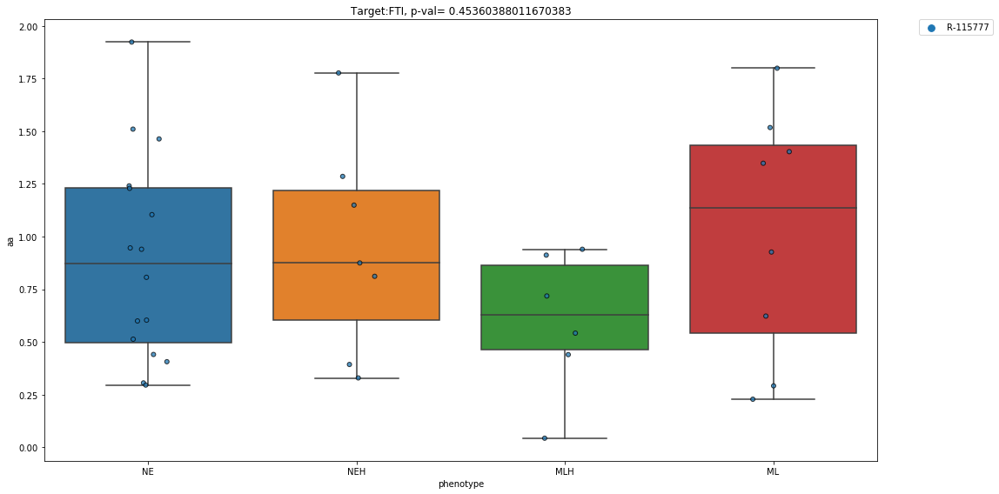

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668    UNC-0638  0.267040       MLH     0.0       0.0       0.0
CORL47     UNC-0638  0.021982        NE     0.0       0.0       0.0
CORL88     UNC-0638  0.018344       MLH     0.0       0.0       0.0
DMS114     UNC-0638  0.328827        ML     0.0       0.0       0.0
DMS273     UNC-0638  0.111381       NEH     0.0       0.0       0.0
DMS53      UNC-0638  0.245744       MLH     0.0       0.0       0.0
DMS79      UNC-0638  0.149488        NE     0.0       0.0       0.0
NCIH1048   UNC-0638  0.205017        ML     0.0       0.0       0.0
NCIH1092   UNC-0638  0.000387        NE     0.0       0.0       0.0
NCIH1105   UNC-0638  0.120980        NE     0.0       0.0       0.0
NCIH1436   UNC-0638  0.144066        NE     0.0       0.0       0.0
NCIH146    UNC-0638  0.507923        NE     0.0       0.0       0.0
NCIH1618   UNC-0638  0.008182        NE     0.0 

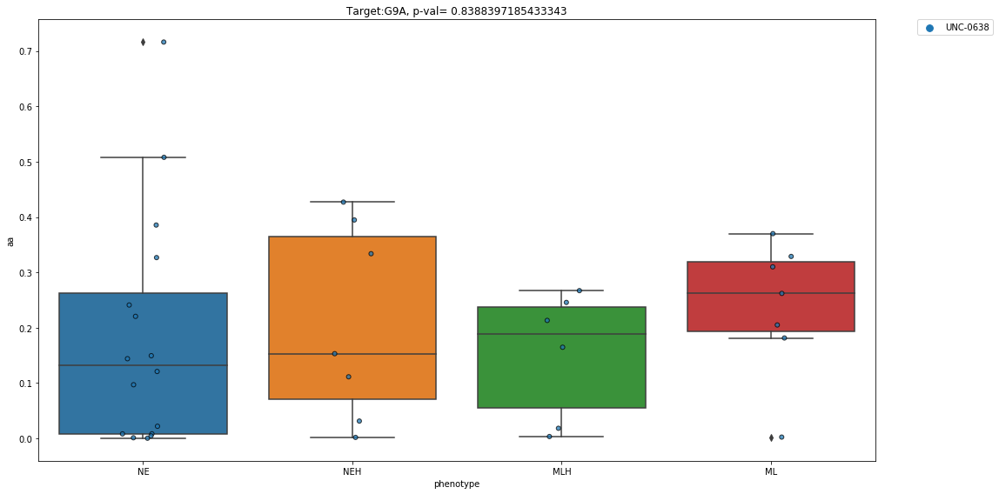

                 drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                            
COLO668    CH-5424802  0.298747       MLH     0.0       0.0       0.0
CORL47     CH-5424802  0.348116        NE     0.0       0.0       0.0
DMS114     CH-5424802  0.366292        ML     0.0       0.0       0.0
DMS273     CH-5424802  0.025406       NEH     0.0       0.0       0.0
DMS53      CH-5424802  0.223280       MLH     0.0       0.0       0.0
DMS79      CH-5424802  0.102761        NE     0.0       0.0       0.0
NCIH1048   CH-5424802  0.321459        ML     0.0       0.0       0.0
NCIH1092   CH-5424802  0.245147        NE     0.0       0.0       0.0
NCIH1105   CH-5424802  0.200193        NE     0.0       0.0       0.0
NCIH1341   CH-5424802  0.207131        ML     0.0       0.0       0.0
NCIH1436   CH-5424802  0.169759        NE     0.0       0.0       0.0
NCIH146    CH-5424802  0.293679        NE     0.0       0.0       0.0
NCIH1618   CH-542480

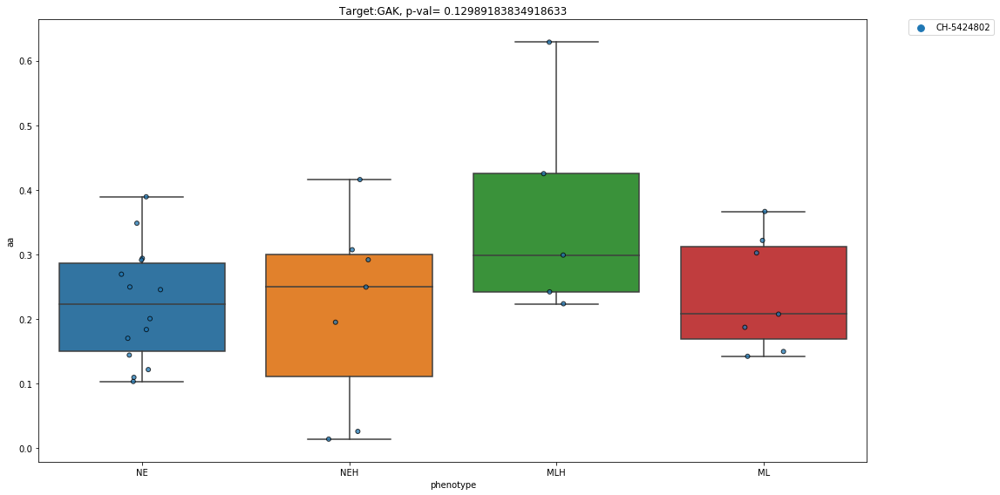

                 drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                
COLO668    BMS-299897  1.027901e-02       MLH     0.0       0.0       0.0
CORL47     BMS-299897  9.340000e-11        NE     0.0       0.0       0.0
CORL88     BMS-299897  3.106994e-01       MLH     0.0       0.0       0.0
DMS273     BMS-299897  2.173976e-01       NEH     0.0       0.0       0.0
DMS53      BMS-299897  1.751481e-01       MLH     0.0       0.0       0.0
...               ...           ...       ...     ...       ...       ...
NCIH510       RG-4733  1.455464e-03       MLH     0.0       0.0       0.0
NCIH526       RG-4733  3.024203e-01       NEH     0.0       0.0       0.0
NCIH82        RG-4733  4.500000e-12       NEH     0.0       0.0       0.0
SHP77         RG-4733  8.450000e-15       MLH     0.0       0.0       0.0
SW1271        RG-4733  1.980000e-09        ML     0.0       0.0       0.0

[183 rows x 6 columns]
GAMMA-SECRETAS

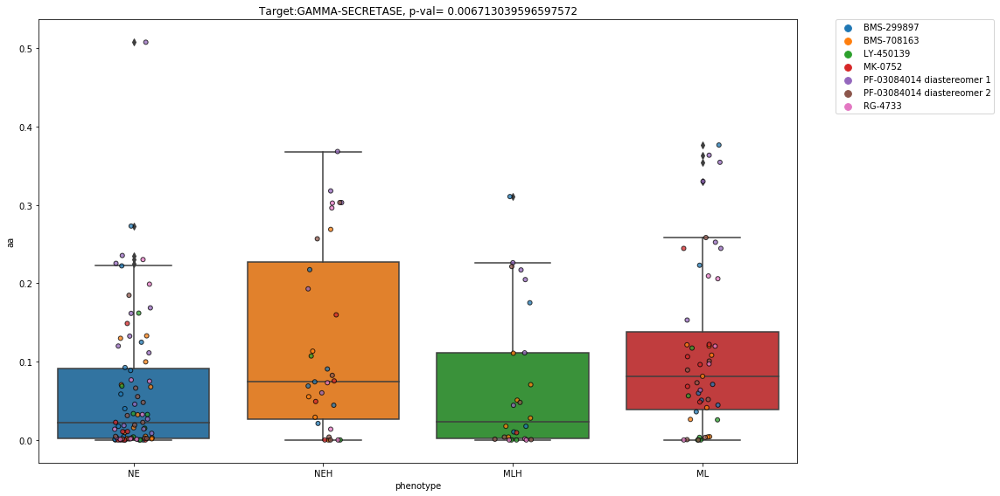

                          drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                     
COLO668                AG-2037  2.760841       MLH     0.0       0.0       0.0
CORL47                 AG-2037  2.278732        NE     0.0       0.0       0.0
CORL88                 AG-2037  2.490473       MLH     0.0       0.0       0.0
DMS114                 AG-2037  2.699804        ML     0.0       0.0       0.0
DMS273                 AG-2037  2.388141       NEH     0.0       0.0       0.0
...                        ...       ...       ...     ...       ...       ...
NCIH82     Pelitrexol isomer B  1.402781       NEH     0.0       0.0       0.0
NCIH841    Pelitrexol isomer B  1.682819        ML     0.0       0.0       0.0
NCIH889    Pelitrexol isomer B  1.263220        NE     0.0       0.0       0.0
SHP77      Pelitrexol isomer B  2.037986       MLH     0.0       0.0       0.0
SW1271     Pelitrexol isomer B  1.393398        ML  

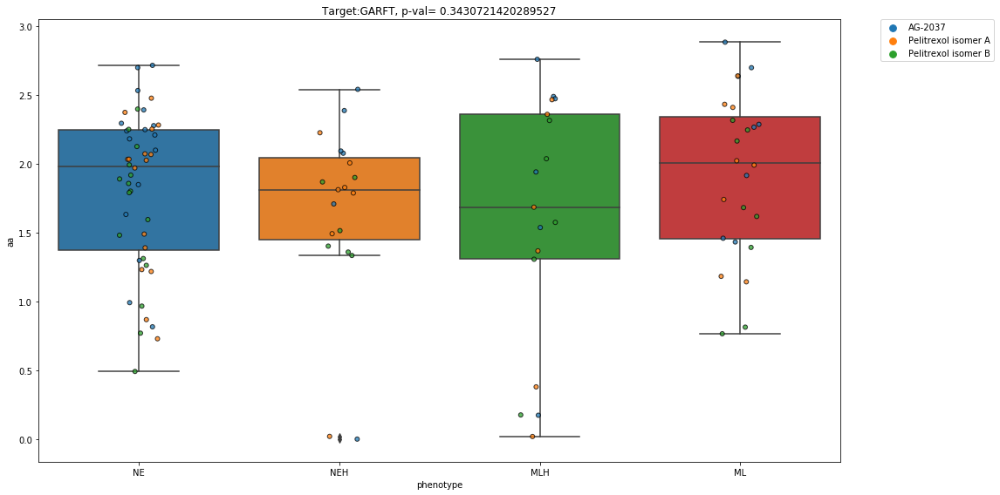

              drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668    SEN-450  0.000000e+00       MLH     0.0       0.0       0.0
DMS114     SEN-450  8.480067e-02        ML     0.0       0.0       0.0
DMS53      SEN-450  2.203349e-01       MLH     0.0       0.0       0.0
DMS79      SEN-450  9.724437e-02        NE     0.0       0.0       0.0
NCIH1048   SEN-450  5.495072e-02        ML     0.0       0.0       0.0
NCIH1092   SEN-450  1.618771e-02        NE     0.0       0.0       0.0
NCIH146    SEN-450  1.052392e-01        NE     0.0       0.0       0.0
NCIH1618   SEN-450  9.803496e-03        NE     0.0       0.0       0.0
NCIH1836   SEN-450  1.710000e-09        NE     0.0       0.0       0.0
NCIH1876   SEN-450  4.723817e-03        NE     0.0       0.0       0.0
NCIH1930   SEN-450  4.299688e-02        NE     0.0       0.0       0.0
NCIH196    SEN-450  2.660480e-02        ML     0.0       0.0       0.0
NCIH19

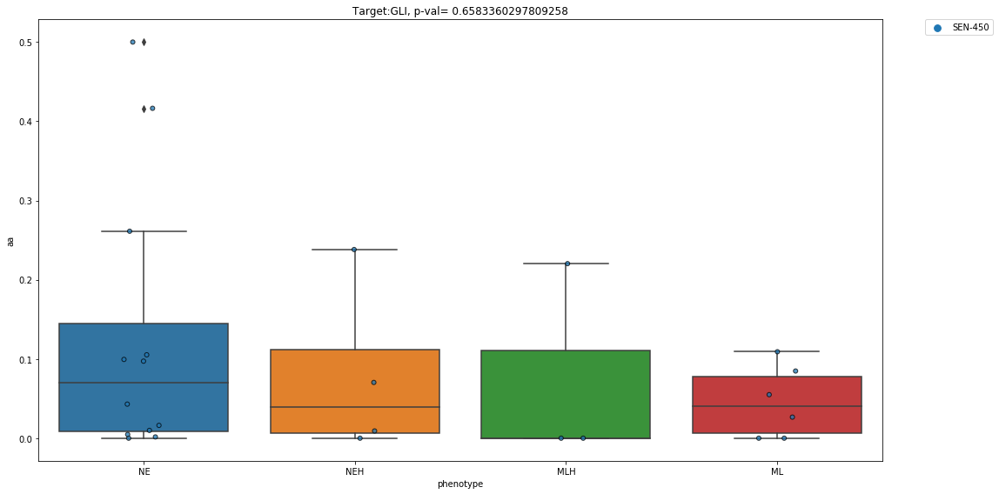

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668    UNC-0638  0.267040       MLH     0.0       0.0       0.0
CORL47     UNC-0638  0.021982        NE     0.0       0.0       0.0
CORL88     UNC-0638  0.018344       MLH     0.0       0.0       0.0
DMS114     UNC-0638  0.328827        ML     0.0       0.0       0.0
DMS273     UNC-0638  0.111381       NEH     0.0       0.0       0.0
DMS53      UNC-0638  0.245744       MLH     0.0       0.0       0.0
DMS79      UNC-0638  0.149488        NE     0.0       0.0       0.0
NCIH1048   UNC-0638  0.205017        ML     0.0       0.0       0.0
NCIH1092   UNC-0638  0.000387        NE     0.0       0.0       0.0
NCIH1105   UNC-0638  0.120980        NE     0.0       0.0       0.0
NCIH1436   UNC-0638  0.144066        NE     0.0       0.0       0.0
NCIH146    UNC-0638  0.507923        NE     0.0       0.0       0.0
NCIH1618   UNC-0638  0.008182        NE     0.0 

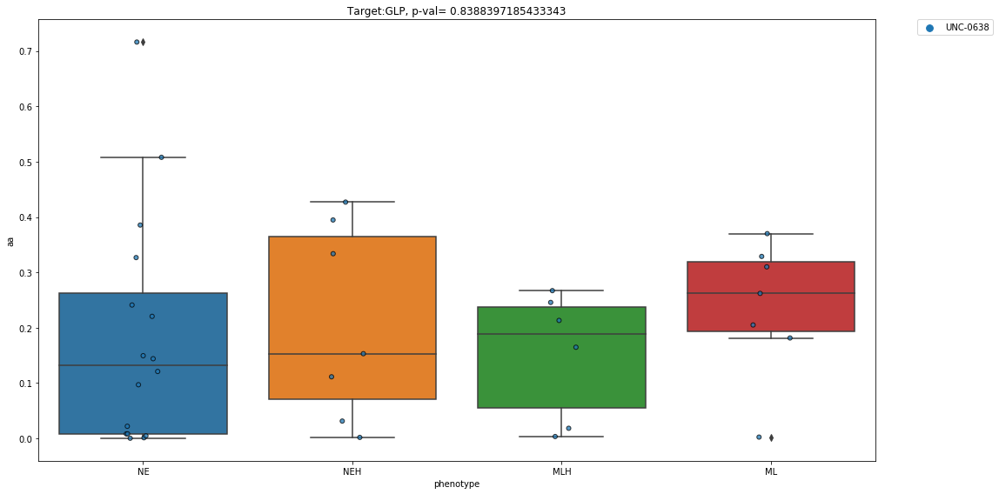

                 drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                            
COLO668    Ivermectin  0.173112       MLH     0.0       0.0       0.0
DMS114     Ivermectin  0.370043        ML     0.0       0.0       0.0
DMS273     Ivermectin  0.015056       NEH     0.0       0.0       0.0
DMS53      Ivermectin  0.103550       MLH     0.0       0.0       0.0
DMS79      Ivermectin  0.062868        NE     0.0       0.0       0.0
NCIH1048   Ivermectin  0.438128        ML     0.0       0.0       0.0
NCIH1092   Ivermectin  0.400299        NE     0.0       0.0       0.0
NCIH1105   Ivermectin  0.384288        NE     0.0       0.0       0.0
NCIH1341   Ivermectin  0.506797        ML     0.0       0.0       0.0
NCIH1436   Ivermectin  0.127250        NE     0.0       0.0       0.0
NCIH146    Ivermectin  0.178062        NE     0.0       0.0       0.0
NCIH1618   Ivermectin  0.341776        NE     0.0       0.0       0.0
NCIH1694   Ivermecti

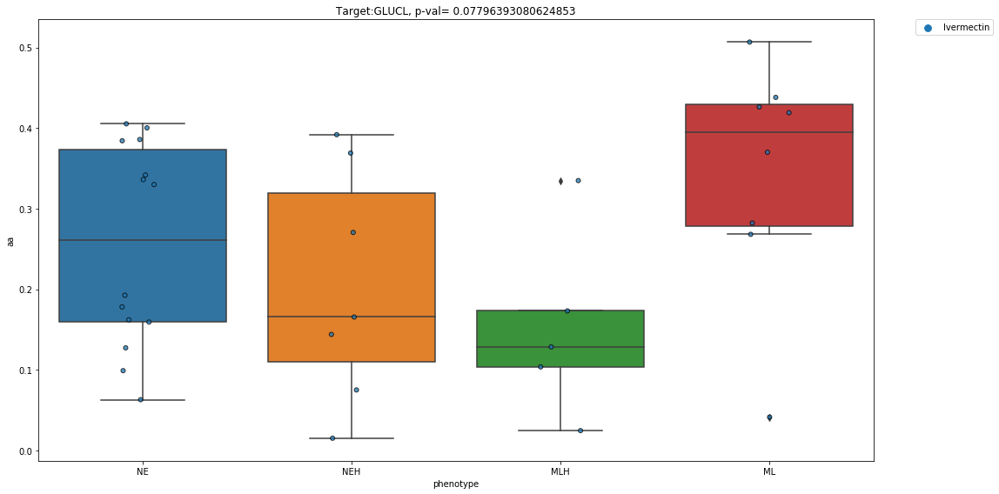

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                 drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                       
COLO668    BIM-46187   0.0       MLH     0.0       0.0       0.0
CORL47     BIM-46187   0.0        NE     0.0       0.0       0.0
CORL88     BIM-46187   0.0       MLH     0.0       0.0       0.0
DMS114     BIM-46187   0.0        ML     0.0       0.0       0.0
DMS273     BIM-46187   0.0       NEH     0.0       0.0       0.0
DMS53      BIM-46187   0.0       MLH     0.0       0.0       0.0
DMS79      BIM-46187   0.0        NE     0.0       0.0       0.0
NCIH1048   BIM-46187   0.0        ML     0.0       0.0       0.0
NCIH1092   BIM-46187   0.0        NE     0.0       0.0       0.0
NCIH1105   BIM-46187   0.0        NE     0.0       0.0       0.0
NCIH1341   BIM-46187   0.0        ML     0.0       0.0       0.0
NCIH1436   BIM-46187   0.0        NE     0.0       0.0       0.0
NCIH146    BIM-46187   0.0        NE     0.0       0.0       0.0
NCIH1618   BIM-46187   0.

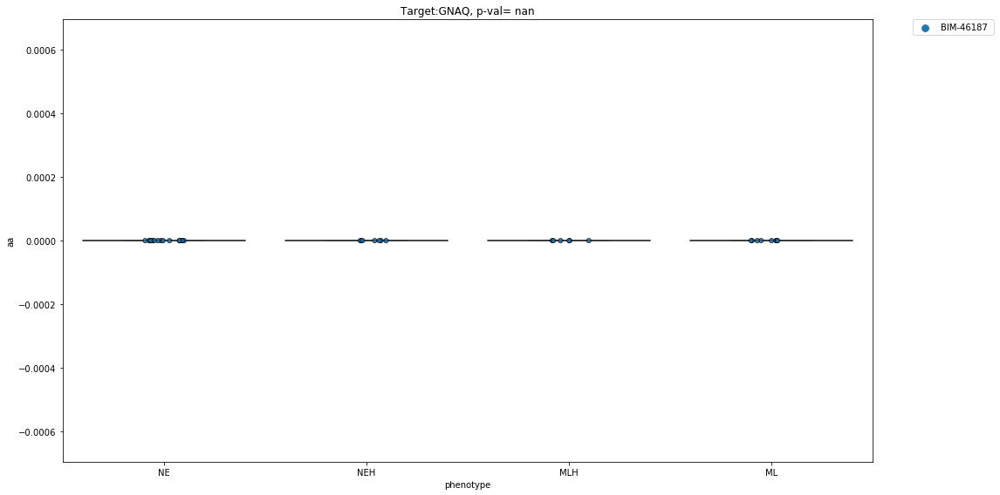

                 drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                
COLO668      AZD-2858  3.451104e-01       MLH     0.0       0.0       0.0
CORL47       AZD-2858  8.039408e-02        NE     0.0       0.0       0.0
DMS114       AZD-2858  1.162557e-01        ML     0.0       0.0       0.0
DMS273       AZD-2858  4.332933e-01       NEH     0.0       0.0       0.0
DMS79        AZD-2858  1.670000e-09        NE     0.0       0.0       0.0
NCIH1048     AZD-2858  5.646520e-01        ML     0.0       0.0       0.0
NCIH1105     AZD-2858  5.964986e-01        NE     0.0       0.0       0.0
NCIH1341     AZD-2858  6.501861e-01        ML     0.0       0.0       0.0
NCIH146      AZD-2858  2.637441e-02        NE     0.0       0.0       0.0
NCIH1618     AZD-2858  6.183189e-01        NE     0.0       0.0       0.0
NCIH1694     AZD-2858  4.054378e-01       NEH     0.0       0.0       0.0
NCIH1836     AZD-2858  1.710901e-01   

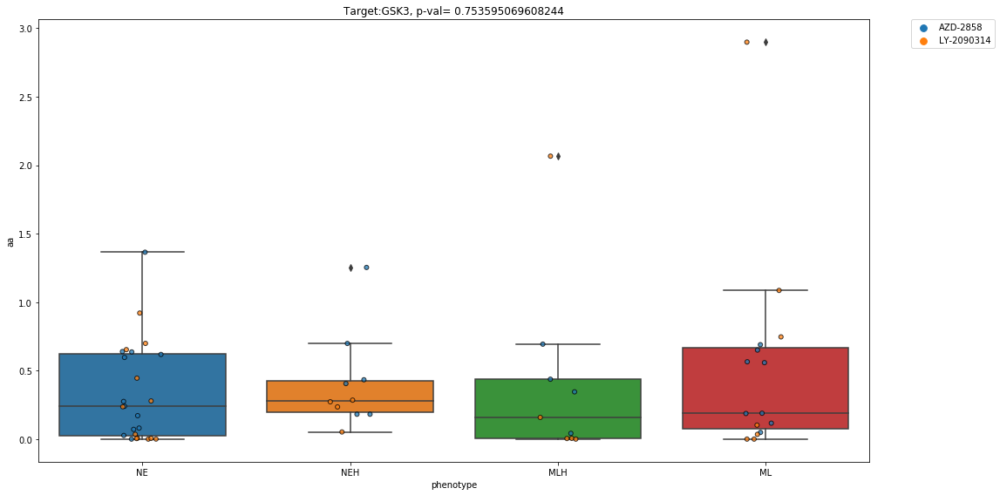

                  drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668    Terfenadine  0.341948       MLH     0.0       0.0       0.0
CORL47     Terfenadine  0.082203        NE     0.0       0.0       0.0
CORL88     Terfenadine  0.037920       MLH     0.0       0.0       0.0
DMS114     Terfenadine  0.089397        ML     0.0       0.0       0.0
DMS273     Terfenadine  0.100707       NEH     0.0       0.0       0.0
DMS53      Terfenadine  0.249166       MLH     0.0       0.0       0.0
DMS79      Terfenadine  0.382778        NE     0.0       0.0       0.0
NCIH1048   Terfenadine  0.375575        ML     0.0       0.0       0.0
NCIH1092   Terfenadine  0.212955        NE     0.0       0.0       0.0
NCIH1105   Terfenadine  0.226157        NE     0.0       0.0       0.0
NCIH1341   Terfenadine  0.022318        ML     0.0       0.0       0.0
NCIH1436   Terfenadine  0.058412        NE     0.0       0.0       0.0
NCIH14

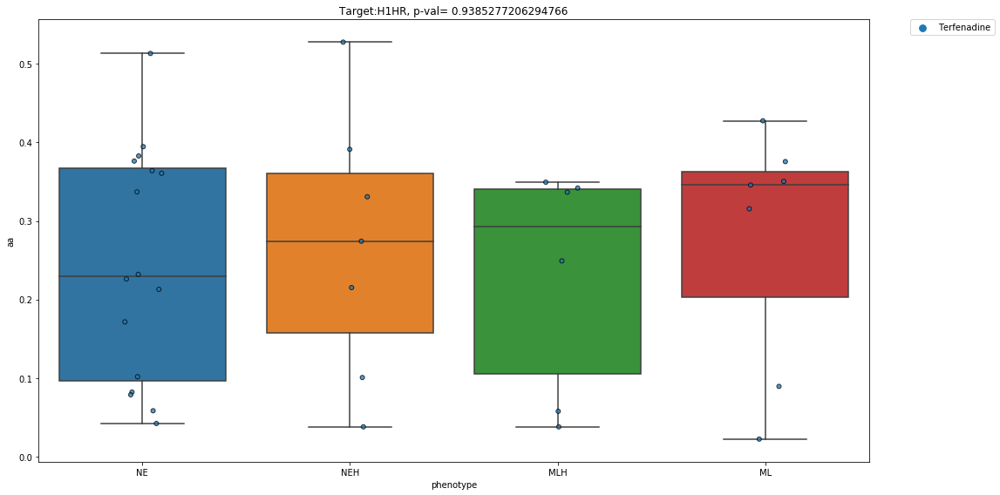

                 drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                
CORL47     Ranitidine  8.050000e-10        NE     0.0       0.0       0.0
CORL88     Ranitidine  1.431131e-01       MLH     0.0       0.0       0.0
NCIH1105   Ranitidine  5.200000e-09        NE     0.0       0.0       0.0
NCIH1436   Ranitidine  1.862287e-02        NE     0.0       0.0       0.0
NCIH146    Ranitidine  1.618601e-01        NE     0.0       0.0       0.0
NCIH1618   Ranitidine  1.105256e-01        NE     0.0       0.0       0.0
NCIH1876   Ranitidine  1.870000e-17        NE     0.0       0.0       0.0
NCIH1930   Ranitidine  7.090000e-16        NE     0.0       0.0       0.0
NCIH1963   Ranitidine  5.813760e-02        NE     0.0       0.0       0.0
NCIH209    Ranitidine  6.088017e-02        NE     0.0       0.0       0.0
NCIH2171   Ranitidine  3.260000e-13       NEH     0.0       0.0       0.0
NCIH446    Ranitidine  1.000000e-14   

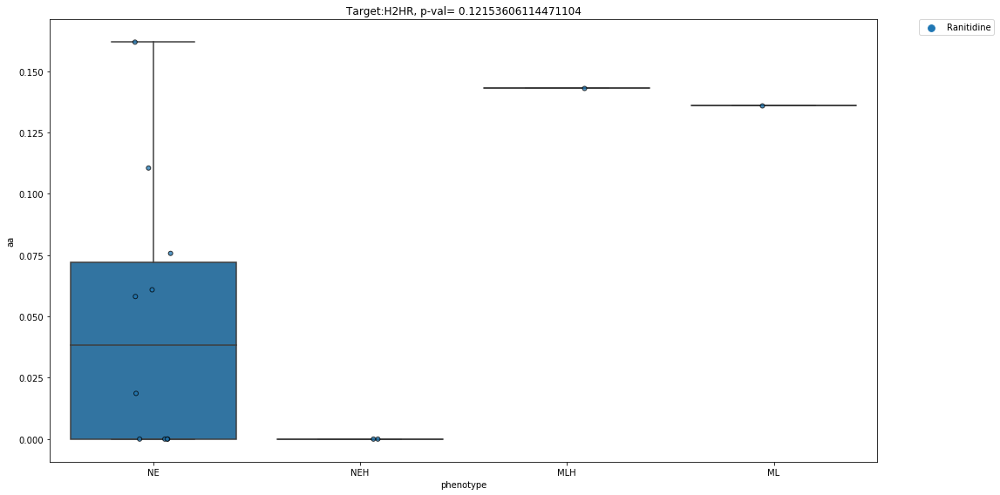

                 drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                            
COLO668    Mefloquine  0.142433       MLH     0.0       0.0       0.0
CORL47     Mefloquine  0.100044        NE     0.0       0.0       0.0
CORL88     Mefloquine  0.046674       MLH     0.0       0.0       0.0
DMS114     Mefloquine  0.286370        ML     0.0       0.0       0.0
DMS273     Mefloquine  0.325382       NEH     0.0       0.0       0.0
DMS53      Mefloquine  0.081666       MLH     0.0       0.0       0.0
DMS79      Mefloquine  0.006523        NE     0.0       0.0       0.0
NCIH1048   Mefloquine  0.084667        ML     0.0       0.0       0.0
NCIH1092   Mefloquine  0.003156        NE     0.0       0.0       0.0
NCIH1105   Mefloquine  0.020543        NE     0.0       0.0       0.0
NCIH1341   Mefloquine  0.113110        ML     0.0       0.0       0.0
NCIH146    Mefloquine  0.104640        NE     0.0       0.0       0.0
NCIH1618   Mefloquin

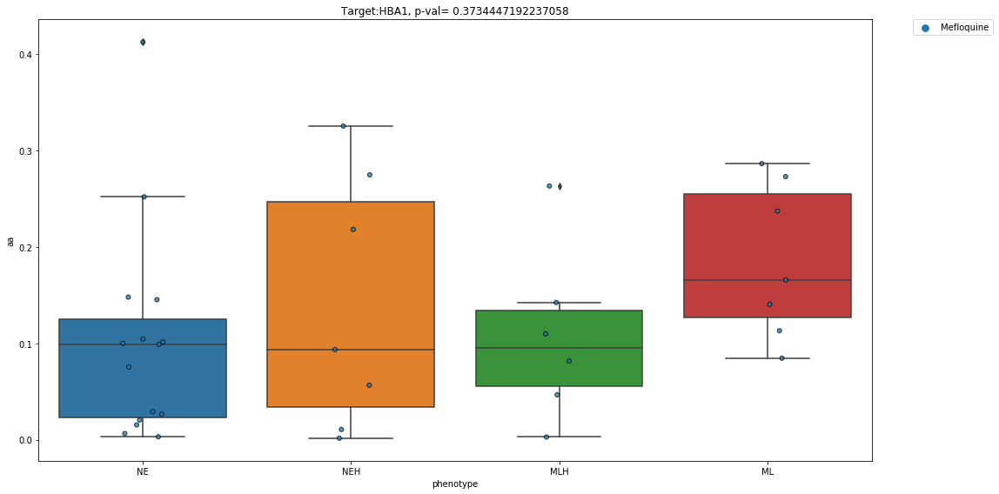

                 drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                       
COLO668      4SC-202   0.0       MLH     0.0       0.0       0.0
CORL47       4SC-202   0.0        NE     0.0       0.0       0.0
CORL88       4SC-202   0.0       MLH     0.0       0.0       0.0
DMS114       4SC-202   0.0        ML     0.0       0.0       0.0
DMS273       4SC-202   0.0       NEH     0.0       0.0       0.0
...               ...  ...       ...     ...       ...       ...
NCIH82     Vorinostat  0.0       NEH     0.0       0.0       0.0
NCIH841    Vorinostat  0.0        ML     0.0       0.0       0.0
NCIH889    Vorinostat  0.0        NE     0.0       0.0       0.0
SHP77      Vorinostat  0.0       MLH     0.0       0.0       0.0
SW1271     Vorinostat  0.0        ML     0.0       0.0       0.0

[405 rows x 6 columns]
HDAC


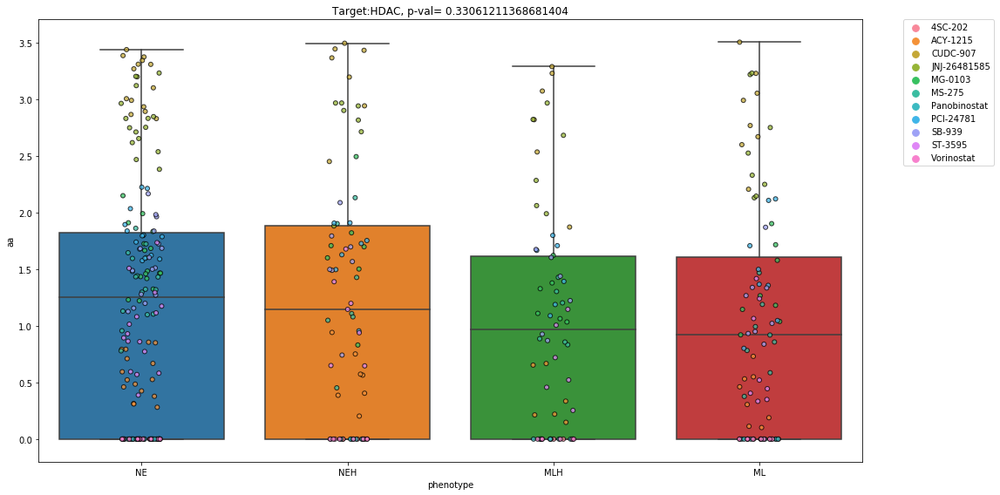

                 drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                       
COLO668    Belinostat  0.0       MLH     0.0       0.0       0.0
CORL47     Belinostat  0.0        NE     0.0       0.0       0.0
CORL88     Belinostat  0.0       MLH     0.0       0.0       0.0
DMS114     Belinostat  0.0        ML     0.0       0.0       0.0
DMS273     Belinostat  0.0       NEH     0.0       0.0       0.0
...               ...  ...       ...     ...       ...       ...
NCIH82     Vorinostat  0.0       NEH     0.0       0.0       0.0
NCIH841    Vorinostat  0.0        ML     0.0       0.0       0.0
NCIH889    Vorinostat  0.0        NE     0.0       0.0       0.0
SHP77      Vorinostat  0.0       MLH     0.0       0.0       0.0
SW1271     Vorinostat  0.0        ML     0.0       0.0       0.0

[172 rows x 6 columns]
HDAC1


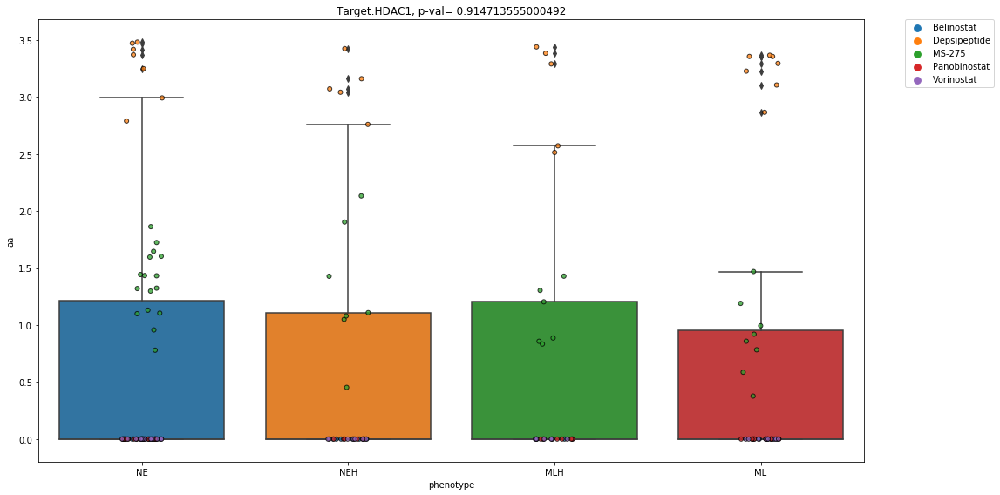

                 drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                       
COLO668    Belinostat  0.0       MLH     0.0       0.0       0.0
CORL47     Belinostat  0.0        NE     0.0       0.0       0.0
CORL88     Belinostat  0.0       MLH     0.0       0.0       0.0
DMS114     Belinostat  0.0        ML     0.0       0.0       0.0
DMS273     Belinostat  0.0       NEH     0.0       0.0       0.0
...               ...  ...       ...     ...       ...       ...
NCIH82     Vorinostat  0.0       NEH     0.0       0.0       0.0
NCIH841    Vorinostat  0.0        ML     0.0       0.0       0.0
NCIH889    Vorinostat  0.0        NE     0.0       0.0       0.0
SHP77      Vorinostat  0.0       MLH     0.0       0.0       0.0
SW1271     Vorinostat  0.0        ML     0.0       0.0       0.0

[172 rows x 6 columns]
HDAC2


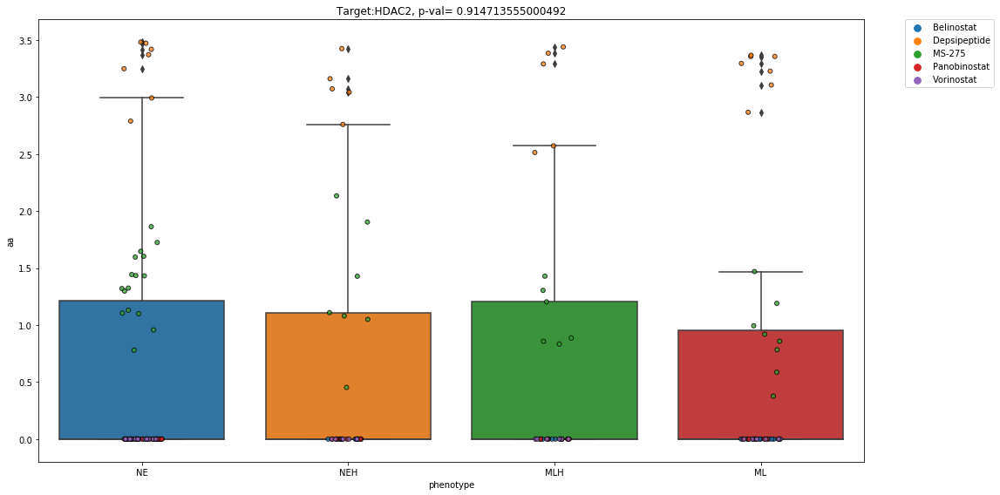

                 drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                       
COLO668    Belinostat  0.0       MLH     0.0       0.0       0.0
CORL47     Belinostat  0.0        NE     0.0       0.0       0.0
CORL88     Belinostat  0.0       MLH     0.0       0.0       0.0
DMS114     Belinostat  0.0        ML     0.0       0.0       0.0
DMS273     Belinostat  0.0       NEH     0.0       0.0       0.0
...               ...  ...       ...     ...       ...       ...
NCIH82     Vorinostat  0.0       NEH     0.0       0.0       0.0
NCIH841    Vorinostat  0.0        ML     0.0       0.0       0.0
NCIH889    Vorinostat  0.0        NE     0.0       0.0       0.0
SHP77      Vorinostat  0.0       MLH     0.0       0.0       0.0
SW1271     Vorinostat  0.0        ML     0.0       0.0       0.0

[172 rows x 6 columns]
HDAC3


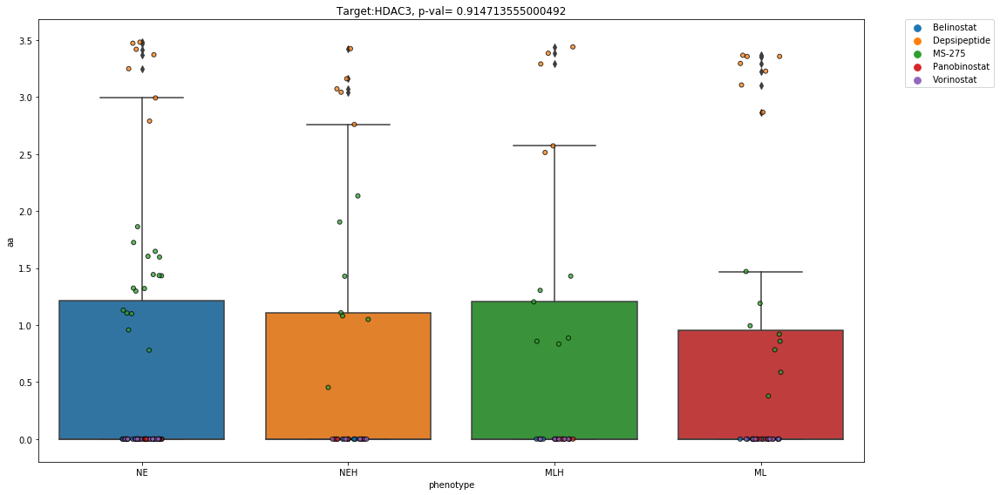

                 drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                       
COLO668    Belinostat  0.0       MLH     0.0       0.0       0.0
CORL47     Belinostat  0.0        NE     0.0       0.0       0.0
CORL88     Belinostat  0.0       MLH     0.0       0.0       0.0
DMS114     Belinostat  0.0        ML     0.0       0.0       0.0
DMS273     Belinostat  0.0       NEH     0.0       0.0       0.0
...               ...  ...       ...     ...       ...       ...
NCIH82     Vorinostat  0.0       NEH     0.0       0.0       0.0
NCIH841    Vorinostat  0.0        ML     0.0       0.0       0.0
NCIH889    Vorinostat  0.0        NE     0.0       0.0       0.0
SHP77      Vorinostat  0.0       MLH     0.0       0.0       0.0
SW1271     Vorinostat  0.0        ML     0.0       0.0       0.0

[148 rows x 6 columns]
HDAC6


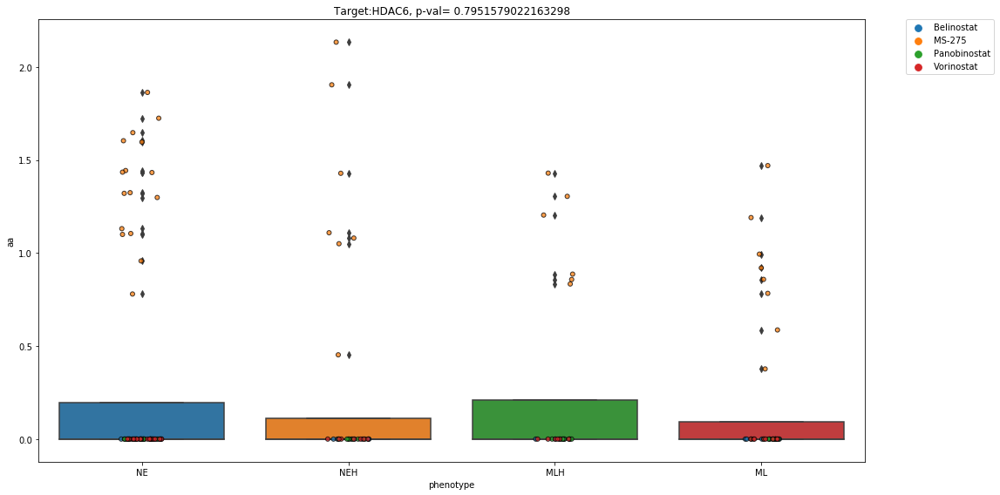

                 drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                       
COLO668    Belinostat  0.0       MLH     0.0       0.0       0.0
CORL47     Belinostat  0.0        NE     0.0       0.0       0.0
CORL88     Belinostat  0.0       MLH     0.0       0.0       0.0
DMS114     Belinostat  0.0        ML     0.0       0.0       0.0
DMS273     Belinostat  0.0       NEH     0.0       0.0       0.0
...               ...  ...       ...     ...       ...       ...
NCIH82     Vorinostat  0.0       NEH     0.0       0.0       0.0
NCIH841    Vorinostat  0.0        ML     0.0       0.0       0.0
NCIH889    Vorinostat  0.0        NE     0.0       0.0       0.0
SHP77      Vorinostat  0.0       MLH     0.0       0.0       0.0
SW1271     Vorinostat  0.0        ML     0.0       0.0       0.0

[172 rows x 6 columns]
HDAC8


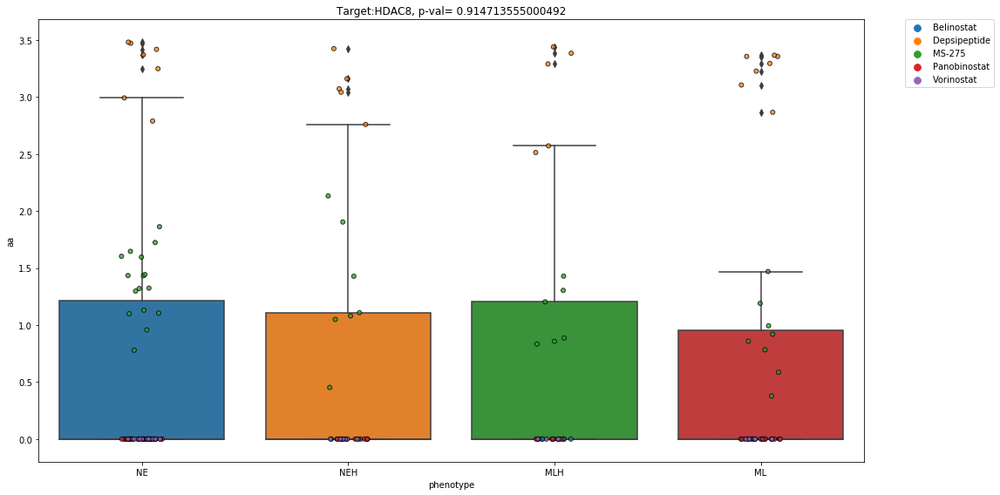

             drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                            
COLO668    MI-219  1.268221e-03       MLH     0.0       0.0       0.0
CORL88     MI-219  1.412326e-01       MLH     0.0       0.0       0.0
DMS114     MI-219  4.229489e-03        ML     0.0       0.0       0.0
NCIH1048   MI-219  1.456033e-01        ML     0.0       0.0       0.0
NCIH1092   MI-219  3.738517e-02        NE     0.0       0.0       0.0
NCIH1105   MI-219  1.555734e-01        NE     0.0       0.0       0.0
NCIH1341   MI-219  7.819370e-02        ML     0.0       0.0       0.0
NCIH1436   MI-219  1.865487e-02        NE     0.0       0.0       0.0
NCIH1618   MI-219  2.210000e-16        NE     0.0       0.0       0.0
NCIH1836   MI-219  2.607756e-02        NE     0.0       0.0       0.0
NCIH1876   MI-219  2.323622e-02        NE     0.0       0.0       0.0
NCIH1930   MI-219  1.440000e-10        NE     0.0       0.0       0.0
NCIH196    MI-219  2

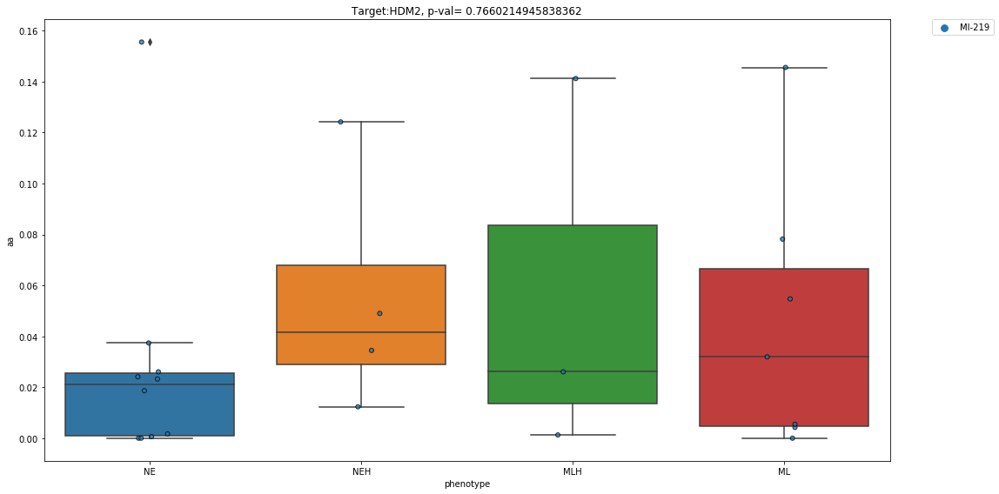

                 drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                            
COLO668         HPI-1  0.002967       MLH     0.0       0.0       0.0
CORL47          HPI-1  0.200505        NE     0.0       0.0       0.0
DMS114          HPI-1  0.732682        ML     0.0       0.0       0.0
DMS53           HPI-1  0.322440       MLH     0.0       0.0       0.0
NCIH1048        HPI-1  0.148736        ML     0.0       0.0       0.0
...               ...       ...       ...     ...       ...       ...
NCIH82     Vismodegib  0.000000       NEH     0.0       0.0       0.0
NCIH841    Vismodegib  0.000000        ML     0.0       0.0       0.0
NCIH889    Vismodegib  0.000000        NE     0.0       0.0       0.0
SHP77      Vismodegib  0.000000       MLH     0.0       0.0       0.0
SW1271     Vismodegib  0.000000        ML     0.0       0.0       0.0

[95 rows x 6 columns]
HEDGEHOG


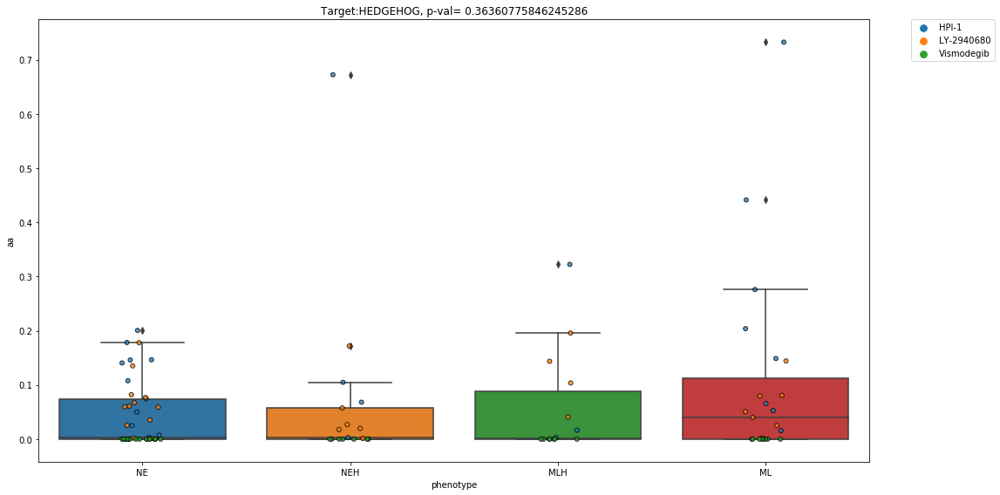

                drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                           
COLO668    BPR1J-097  0.167032       MLH     0.0       0.0       0.0
CORL47     BPR1J-097  0.152887        NE     0.0       0.0       0.0
CORL88     BPR1J-097  0.201761       MLH     0.0       0.0       0.0
DMS114     BPR1J-097  1.365775        ML     0.0       0.0       0.0
DMS53      BPR1J-097  0.390743       MLH     0.0       0.0       0.0
DMS79      BPR1J-097  0.004491        NE     0.0       0.0       0.0
NCIH1048   BPR1J-097  0.903568        ML     0.0       0.0       0.0
NCIH1092   BPR1J-097  0.001000        NE     0.0       0.0       0.0
NCIH1105   BPR1J-097  0.097236        NE     0.0       0.0       0.0
NCIH1341   BPR1J-097  0.091257        ML     0.0       0.0       0.0
NCIH1436   BPR1J-097  0.138597        NE     0.0       0.0       0.0
NCIH146    BPR1J-097  0.159514        NE     0.0       0.0       0.0
NCIH1618   BPR1J-097  0.246249    

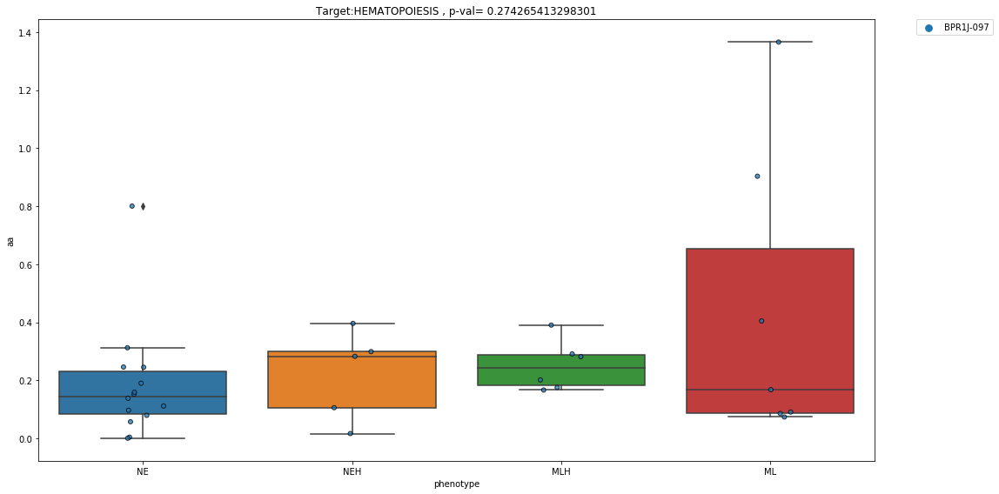

                drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                      
COLO668     AEE-788   0.0       MLH     0.0       0.0       0.0
CORL47      AEE-788   0.0        NE     0.0       0.0       0.0
CORL88      AEE-788   0.0       MLH     0.0       0.0       0.0
DMS114      AEE-788   0.0        ML     0.0       0.0       0.0
DMS273      AEE-788   0.0       NEH     0.0       0.0       0.0
...              ...  ...       ...     ...       ...       ...
NCIH82     Lapatinib  0.0       NEH     0.0       0.0       0.0
NCIH841    Lapatinib  0.0        ML     0.0       0.0       0.0
NCIH889    Lapatinib  0.0        NE     0.0       0.0       0.0
SHP77      Lapatinib  0.0       MLH     0.0       0.0       0.0
SW1271     Lapatinib  0.0        ML     0.0       0.0       0.0

[201 rows x 6 columns]
HER2


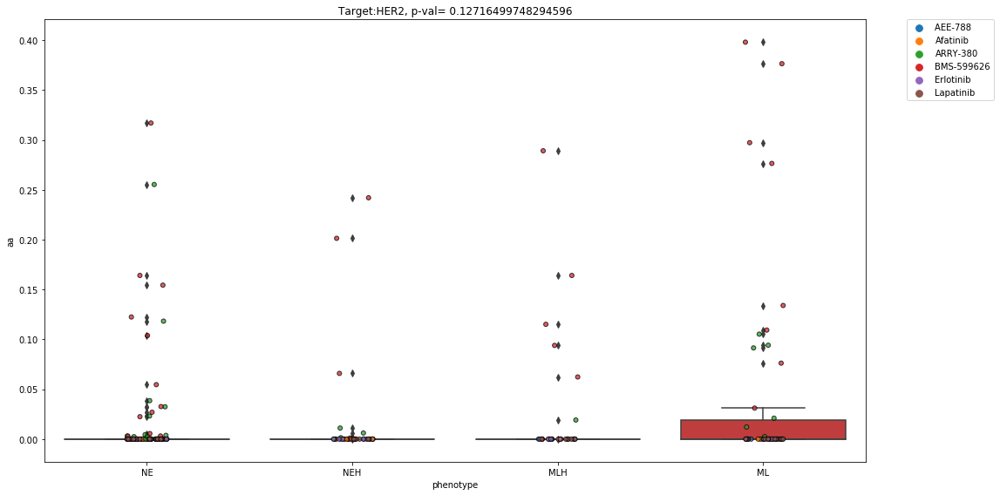

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


               drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                     
COLO668    Afatinib  0.0       MLH     0.0       0.0       0.0
CORL47     Afatinib  0.0        NE     0.0       0.0       0.0
CORL88     Afatinib  0.0       MLH     0.0       0.0       0.0
DMS114     Afatinib  0.0        ML     0.0       0.0       0.0
DMS273     Afatinib  0.0       NEH     0.0       0.0       0.0
DMS53      Afatinib  0.0       MLH     0.0       0.0       0.0
DMS79      Afatinib  0.0        NE     0.0       0.0       0.0
NCIH1048   Afatinib  0.0        ML     0.0       0.0       0.0
NCIH1092   Afatinib  0.0        NE     0.0       0.0       0.0
NCIH1105   Afatinib  0.0        NE     0.0       0.0       0.0
NCIH1341   Afatinib  0.0        ML     0.0       0.0       0.0
NCIH1436   Afatinib  0.0        NE     0.0       0.0       0.0
NCIH146    Afatinib  0.0        NE     0.0       0.0       0.0
NCIH1618   Afatinib  0.0        NE     0.0       0.0   

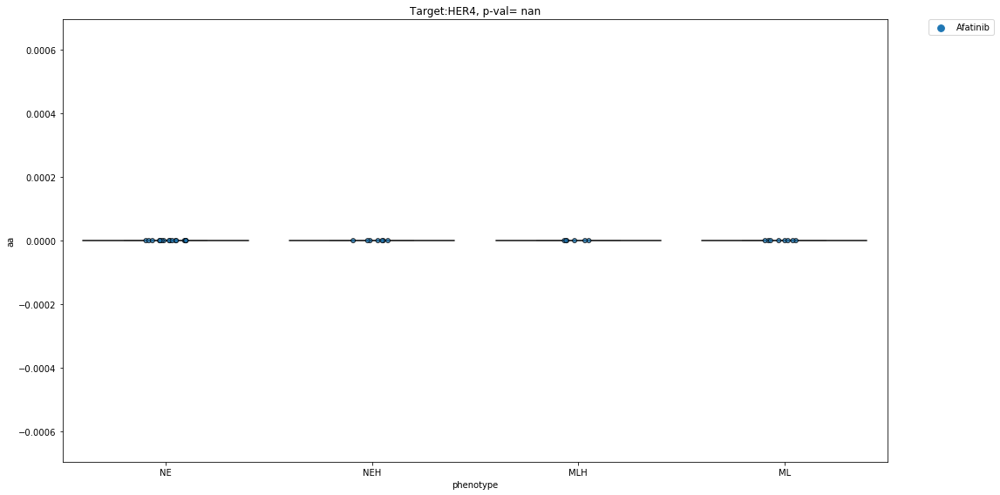

              drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668    AFP-464  1.269901e-01       MLH     0.0       0.0       0.0
CORL47     AFP-464  1.275630e-01        NE     0.0       0.0       0.0
CORL88     AFP-464  1.003049e+00       MLH     0.0       0.0       0.0
DMS114     AFP-464  9.550662e-01        ML     0.0       0.0       0.0
DMS273     AFP-464  1.102288e+00       NEH     0.0       0.0       0.0
...            ...           ...       ...     ...       ...       ...
NCIH510       YC-1  1.562271e-01       MLH     0.0       0.0       0.0
NCIH526       YC-1  9.442891e-01       NEH     0.0       0.0       0.0
NCIH69        YC-1  1.028748e-01        NE     0.0       0.0       0.0
NCIH82        YC-1  4.489166e-01       NEH     0.0       0.0       0.0
NCIH841       YC-1  5.690000e-11        ML     0.0       0.0       0.0

[95 rows x 6 columns]
HIF1A


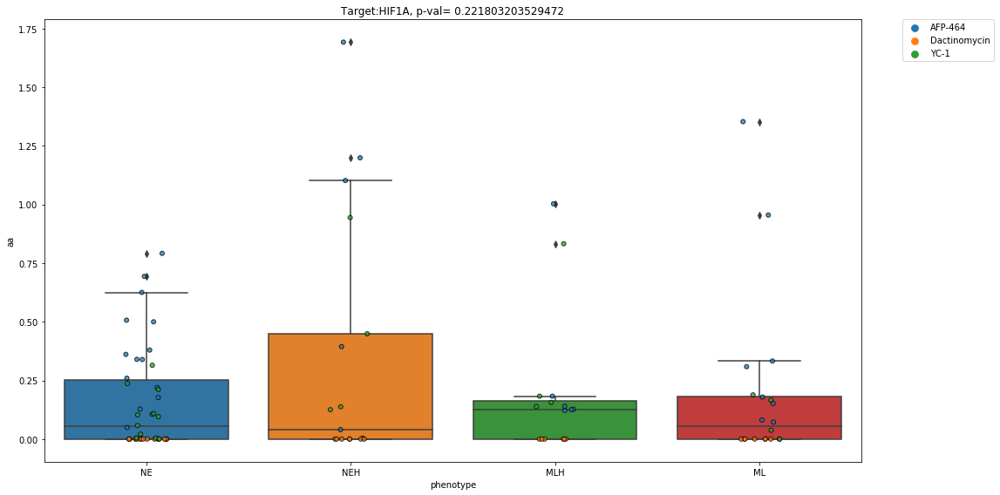

                          drug            aa phenotype  aa_new  hill_new  \
cell.line                                                                  
CORL88     3-Bromopyruvic acid  1.250000e-14       MLH     0.0       0.0   
NCIH1341   3-Bromopyruvic acid  3.450000e-12        ML     0.0       0.0   
NCIH146    3-Bromopyruvic acid  5.060000e-11        NE     0.0       0.0   
NCIH1694   3-Bromopyruvic acid  4.380981e-02       NEH     0.0       0.0   
NCIH1876   3-Bromopyruvic acid  1.422342e-02        NE     0.0       0.0   
NCIH1930   3-Bromopyruvic acid  1.360000e-11        NE     0.0       0.0   
NCIH209    3-Bromopyruvic acid  3.680000e-17        NE     0.0       0.0   
NCIH2171   3-Bromopyruvic acid  8.440000e-14       NEH     0.0       0.0   
NCIH446    3-Bromopyruvic acid  2.754542e-02       NEH     0.0       0.0   
NCIH524    3-Bromopyruvic acid  4.820000e-15       NEH     0.0       0.0   
NCIH526    3-Bromopyruvic acid  2.968185e-02       NEH     0.0       0.0   
NCIH841    3

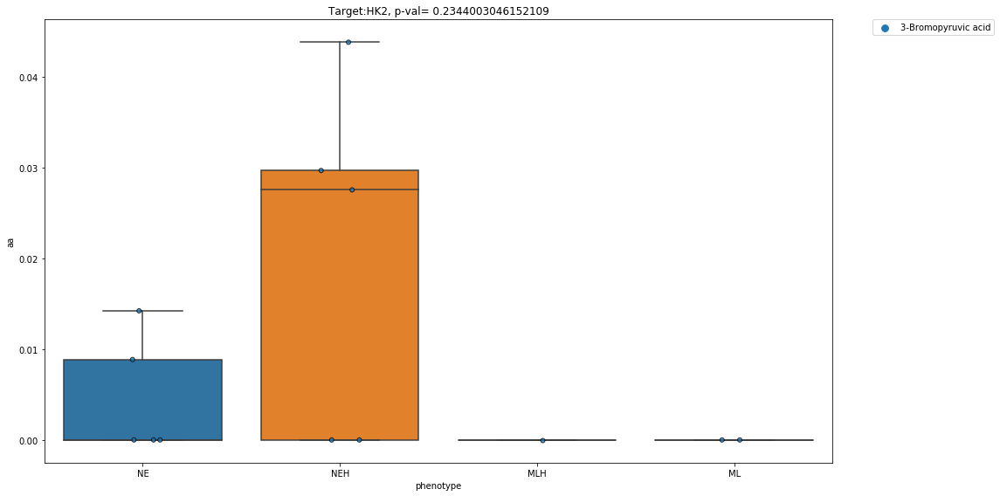

               drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
CORL47     CP-91149  2.970000e-07        NE     0.0       0.0       0.0
CORL88     CP-91149  4.849440e-04       MLH     0.0       0.0       0.0
DMS114     CP-91149  4.540686e-01        ML     0.0       0.0       0.0
DMS53      CP-91149  9.975730e-04       MLH     0.0       0.0       0.0
NCIH1105   CP-91149  7.744972e-02        NE     0.0       0.0       0.0
NCIH1341   CP-91149  6.500000e-28        ML     0.0       0.0       0.0
NCIH1436   CP-91149  3.892918e-01        NE     0.0       0.0       0.0
NCIH1618   CP-91149  1.419477e-02        NE     0.0       0.0       0.0
NCIH1694   CP-91149  2.300000e-13       NEH     0.0       0.0       0.0
NCIH1930   CP-91149  1.251991e-03        NE     0.0       0.0       0.0
NCIH196    CP-91149  5.130000e-18        ML     0.0       0.0       0.0
NCIH2066   CP-91149  3.413420e-04        ML     0.0       0.0   

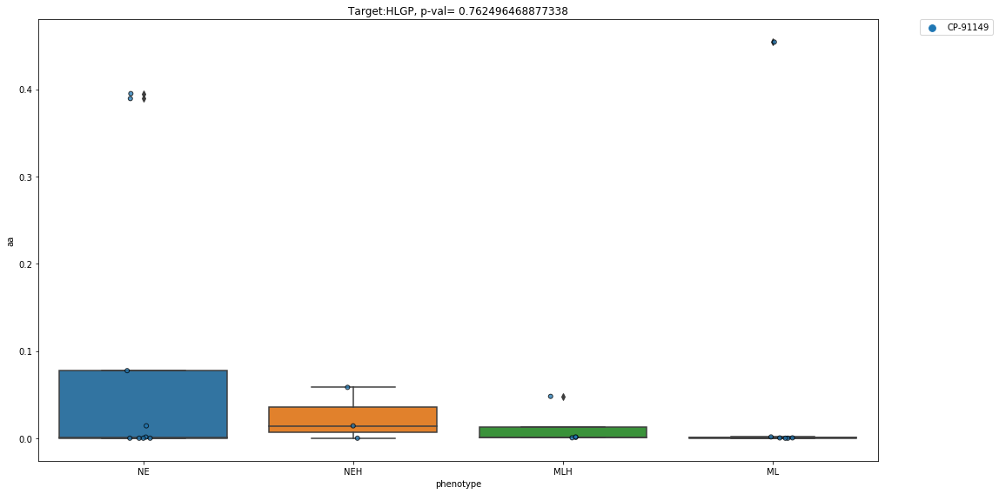

                  drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668    Fluvastatin  0.000000       MLH     0.0       0.0       0.0
CORL47     Fluvastatin  0.000000        NE     0.0       0.0       0.0
CORL88     Fluvastatin  0.000000       MLH     0.0       0.0       0.0
DMS114     Fluvastatin  0.000000        ML     0.0       0.0       0.0
DMS273     Fluvastatin  0.000000       NEH     0.0       0.0       0.0
...                ...       ...       ...     ...       ...       ...
NCIH82       Simvastin  0.382767       NEH     0.0       0.0       0.0
NCIH841      Simvastin  0.359060        ML     0.0       0.0       0.0
NCIH889      Simvastin  0.003432        NE     0.0       0.0       0.0
SHP77        Simvastin  0.046282       MLH     0.0       0.0       0.0
SW1271       Simvastin  0.198852        ML     0.0       0.0       0.0

[109 rows x 6 columns]
HMGCR


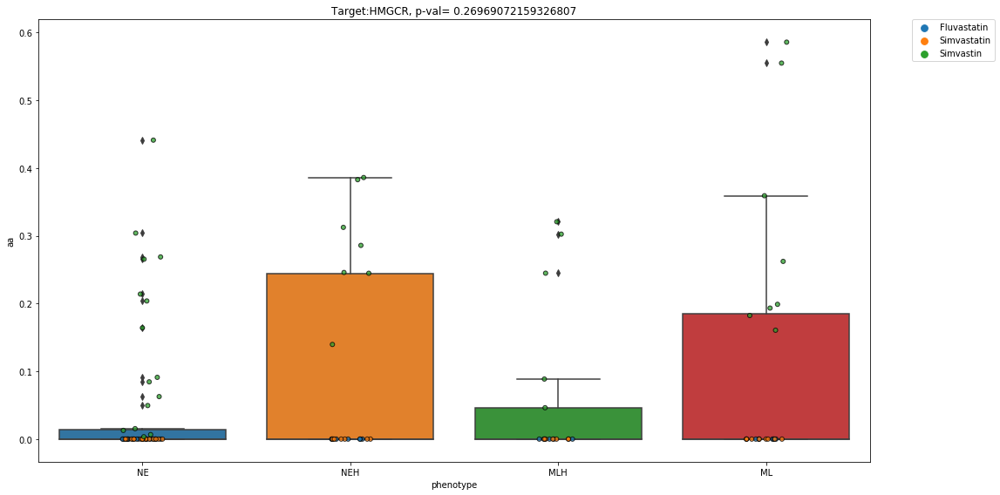

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668    UNC-0638  0.267040       MLH     0.0       0.0       0.0
CORL47     UNC-0638  0.021982        NE     0.0       0.0       0.0
CORL88     UNC-0638  0.018344       MLH     0.0       0.0       0.0
DMS114     UNC-0638  0.328827        ML     0.0       0.0       0.0
DMS273     UNC-0638  0.111381       NEH     0.0       0.0       0.0
DMS53      UNC-0638  0.245744       MLH     0.0       0.0       0.0
DMS79      UNC-0638  0.149488        NE     0.0       0.0       0.0
NCIH1048   UNC-0638  0.205017        ML     0.0       0.0       0.0
NCIH1092   UNC-0638  0.000387        NE     0.0       0.0       0.0
NCIH1105   UNC-0638  0.120980        NE     0.0       0.0       0.0
NCIH1436   UNC-0638  0.144066        NE     0.0       0.0       0.0
NCIH146    UNC-0638  0.507923        NE     0.0       0.0       0.0
NCIH1618   UNC-0638  0.008182        NE     0.0 

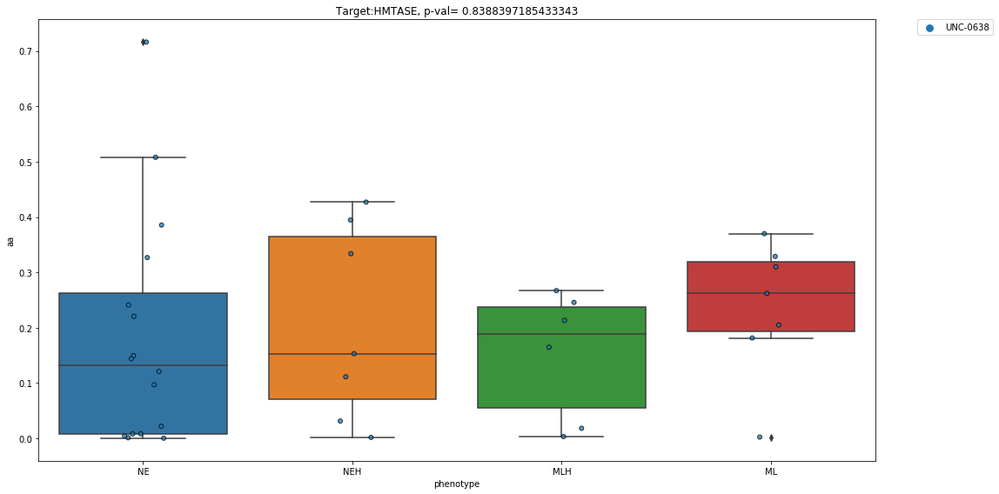

                 drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                
DMS273     Nitisinone  1.064156e-01       NEH     0.0       0.0       0.0
NCIH1048   Nitisinone  1.120523e-02        ML     0.0       0.0       0.0
NCIH1105   Nitisinone  3.650000e-10        NE     0.0       0.0       0.0
NCIH146    Nitisinone  2.143623e-01        NE     0.0       0.0       0.0
NCIH2066   Nitisinone  4.191968e-01        ML     0.0       0.0       0.0
NCIH209    Nitisinone  1.247881e-01        NE     0.0       0.0       0.0
NCIH510    Nitisinone  2.077680e-02       MLH     0.0       0.0       0.0
NCIH524    Nitisinone  3.409538e-02       NEH     0.0       0.0       0.0
NCIH69     Nitisinone  1.907716e-01        NE     0.0       0.0       0.0
NCIH82     Nitisinone  8.860000e-10       NEH     0.0       0.0       0.0
SHP77      Nitisinone  2.354875e-02       MLH     0.0       0.0       0.0
HPD


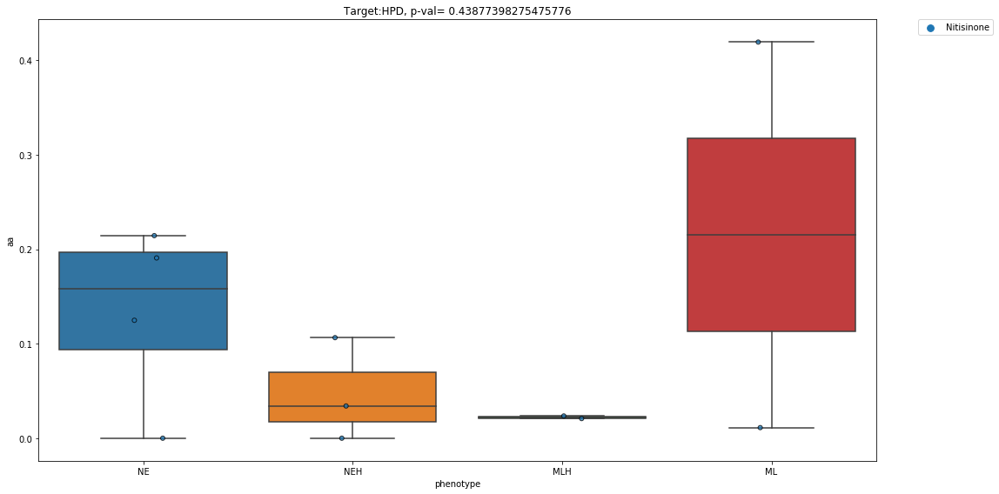

                        drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                   
COLO668    2-Fluoroadenosine  0.635167       MLH     0.0       0.0       0.0
CORL47     2-Fluoroadenosine  0.007166        NE     0.0       0.0       0.0
CORL88     2-Fluoroadenosine  0.007527       MLH     0.0       0.0       0.0
DMS114     2-Fluoroadenosine  0.365670        ML     0.0       0.0       0.0
DMS273     2-Fluoroadenosine  0.211564       NEH     0.0       0.0       0.0
DMS53      2-Fluoroadenosine  0.109424       MLH     0.0       0.0       0.0
NCIH1048   2-Fluoroadenosine  0.616480        ML     0.0       0.0       0.0
NCIH1105   2-Fluoroadenosine  0.007660        NE     0.0       0.0       0.0
NCIH1341   2-Fluoroadenosine  0.001625        ML     0.0       0.0       0.0
NCIH1436   2-Fluoroadenosine  0.049680        NE     0.0       0.0       0.0
NCIH146    2-Fluoroadenosine  0.149320        NE     0.0       0.0       0.0

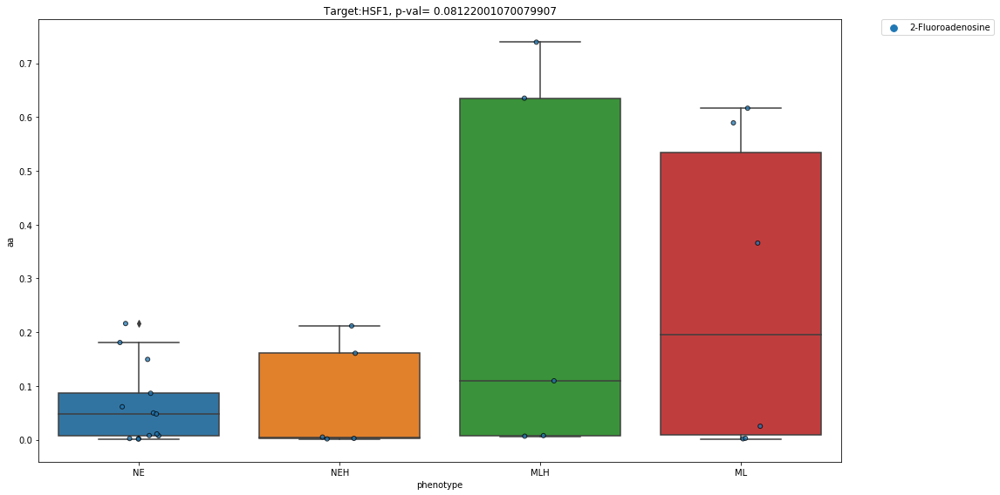

             drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                        
COLO668    17-AAG  1.631663       MLH     0.0       0.0       0.0
CORL47     17-AAG  0.890155        NE     0.0       0.0       0.0
CORL88     17-AAG  0.671593       MLH     0.0       0.0       0.0
DMS114     17-AAG  0.695405        ML     0.0       0.0       0.0
DMS273     17-AAG  1.496873       NEH     0.0       0.0       0.0
...           ...       ...       ...     ...       ...       ...
NCIH82     XL-888  1.721206       NEH     0.0       0.0       0.0
NCIH841    XL-888  2.300617        ML     0.0       0.0       0.0
NCIH889    XL-888  0.898093        NE     0.0       0.0       0.0
SHP77      XL-888  2.121463       MLH     0.0       0.0       0.0
SW1271     XL-888  2.510670        ML     0.0       0.0       0.0

[437 rows x 6 columns]
HSP90


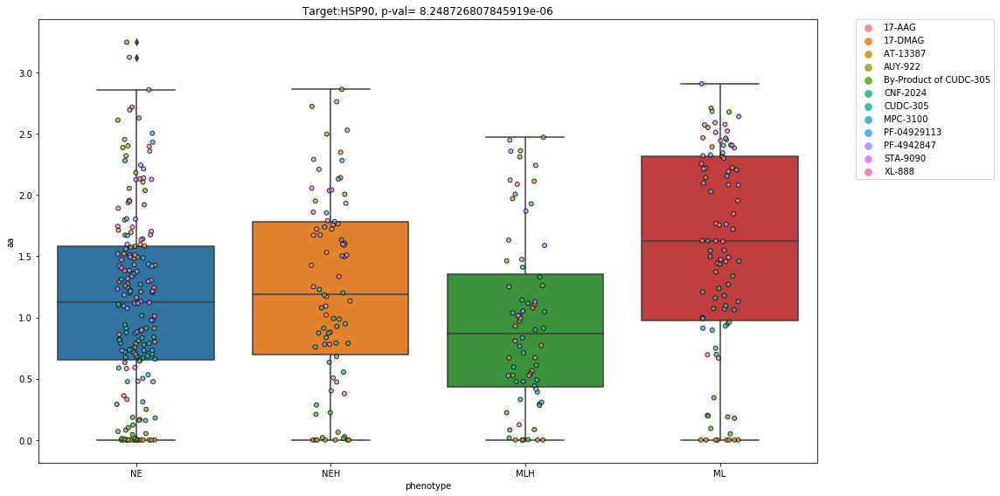

                drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                           
COLO668       17-AAG  1.631663       MLH     0.0       0.0       0.0
CORL47        17-AAG  0.890155        NE     0.0       0.0       0.0
CORL88        17-AAG  0.671593       MLH     0.0       0.0       0.0
DMS114        17-AAG  0.695405        ML     0.0       0.0       0.0
DMS273        17-AAG  1.496873       NEH     0.0       0.0       0.0
...              ...       ...       ...     ...       ...       ...
NCIH82     AT-13387   0.000000       NEH     0.0       0.0       0.0
NCIH841    AT-13387   0.000000        ML     0.0       0.0       0.0
NCIH889    AT-13387   0.000000        NE     0.0       0.0       0.0
SHP77      AT-13387   0.000000       MLH     0.0       0.0       0.0
SW1271     AT-13387   0.000000        ML     0.0       0.0       0.0

[74 rows x 6 columns]
HSP90AA1


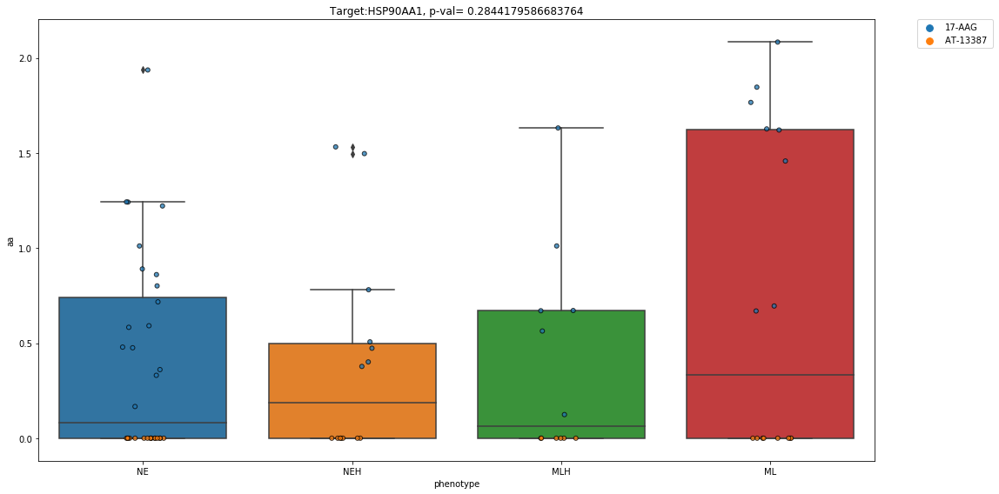

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                   drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    Dactinomycin  0.0       MLH     0.0       0.0       0.0
CORL47     Dactinomycin  0.0        NE     0.0       0.0       0.0
CORL88     Dactinomycin  0.0       MLH     0.0       0.0       0.0
DMS114     Dactinomycin  0.0        ML     0.0       0.0       0.0
DMS273     Dactinomycin  0.0       NEH     0.0       0.0       0.0
DMS53      Dactinomycin  0.0       MLH     0.0       0.0       0.0
DMS79      Dactinomycin  0.0        NE     0.0       0.0       0.0
NCIH1048   Dactinomycin  0.0        ML     0.0       0.0       0.0
NCIH1092   Dactinomycin  0.0        NE     0.0       0.0       0.0
NCIH1105   Dactinomycin  0.0        NE     0.0       0.0       0.0
NCIH1341   Dactinomycin  0.0        ML     0.0       0.0       0.0
NCIH1436   Dactinomycin  0.0        NE     0.0       0.0       0.0
NCIH146    Dactinomycin  0.0        NE     0.0       0.0      

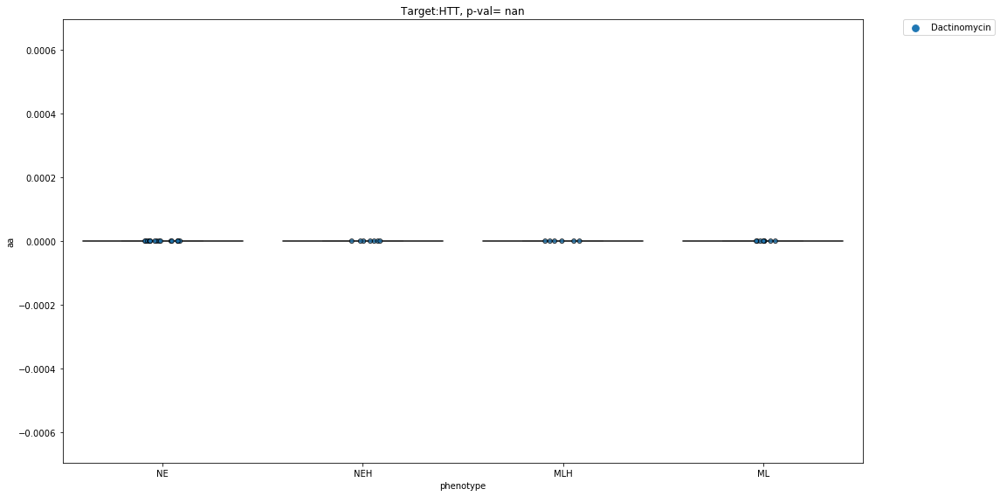

               drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
DMS273       AT-406  1.020707e-01       NEH     0.0       0.0       0.0
DMS79        AT-406  1.802289e-01        NE     0.0       0.0       0.0
NCIH1048     AT-406  4.519247e-01        ML     0.0       0.0       0.0
NCIH1105     AT-406  1.906388e-02        NE     0.0       0.0       0.0
NCIH1341     AT-406  3.439578e-01        ML     0.0       0.0       0.0
...             ...           ...       ...     ...       ...       ...
NCIH82     TL-32711  1.142003e+00       NEH     0.0       0.0       0.0
NCIH841    TL-32711  2.461081e-01        ML     0.0       0.0       0.0
NCIH889    TL-32711  2.143237e-01        NE     0.0       0.0       0.0
SHP77      TL-32711  7.860000e-07       MLH     0.0       0.0       0.0
SW1271     TL-32711  8.343055e-01        ML     0.0       0.0       0.0

[87 rows x 6 columns]
IAP


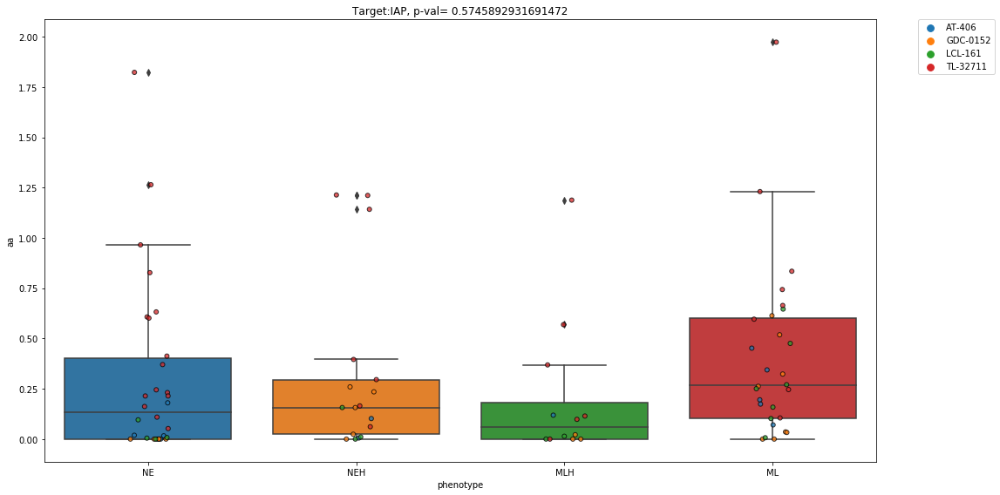

               drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
COLO668    IDH-C227  3.838950e-02       MLH     0.0       0.0       0.0
CORL47     IDH-C227  8.919955e-02        NE     0.0       0.0       0.0
DMS114     IDH-C227  3.120288e-01        ML     0.0       0.0       0.0
DMS273     IDH-C227  9.753684e-02       NEH     0.0       0.0       0.0
NCIH1048   IDH-C227  1.173986e-01        ML     0.0       0.0       0.0
NCIH1092   IDH-C227  2.928714e-03        NE     0.0       0.0       0.0
NCIH1105   IDH-C227  4.525542e-02        NE     0.0       0.0       0.0
NCIH1341   IDH-C227  1.559289e-03        ML     0.0       0.0       0.0
NCIH146    IDH-C227  1.232122e-01        NE     0.0       0.0       0.0
NCIH1618   IDH-C227  1.501361e-02        NE     0.0       0.0       0.0
NCIH1694   IDH-C227  1.811475e-01       NEH     0.0       0.0       0.0
NCIH1876   IDH-C227  2.424851e-03        NE     0.0       0.0   

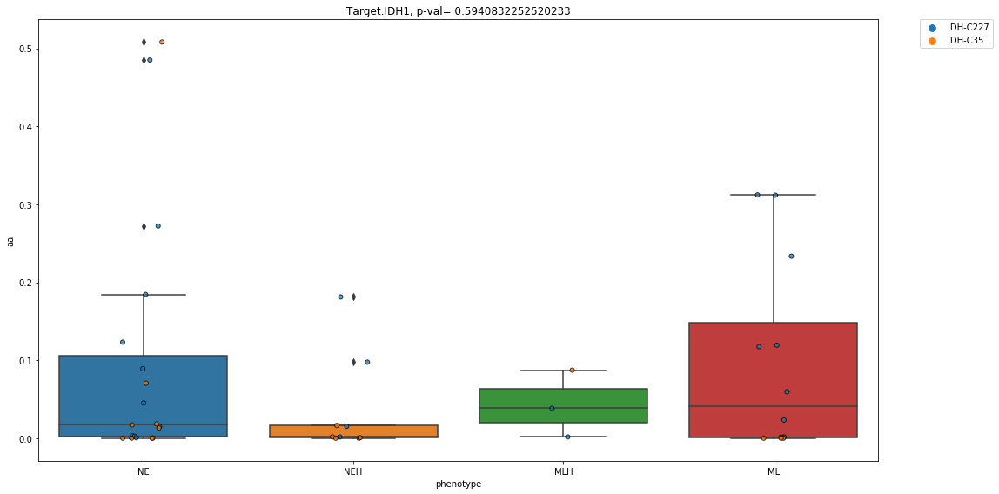

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3612: F_onewayBadInputSizesWarning: at least one input has length 0
  warnings.warn(F_onewayBadInputSizesWarning('at least one input '


                              drug            aa phenotype  aa_new  hill_new  \
cell.line                                                                      
CORL47     1-Methyl-[D]-tryptophan  3.650000e-12        NE     0.0       0.0   
CORL88     1-Methyl-[D]-tryptophan  4.623827e-01       MLH     0.0       0.0   
NCIH2066   1-Methyl-[D]-tryptophan  3.950363e-01        ML     0.0       0.0   

           emax_new  
cell.line            
CORL47          0.0  
CORL88          0.0  
NCIH2066        0.0  
IDO


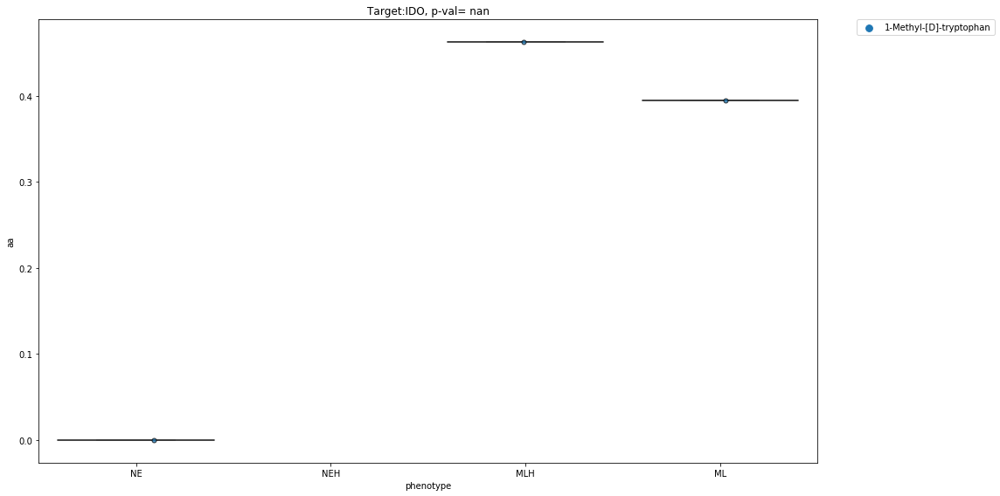

                drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                           
COLO668      ADW-742  0.778877       MLH     0.0       0.0       0.0
CORL47       ADW-742  0.539727        NE     0.0       0.0       0.0
CORL88       ADW-742  0.252800       MLH     0.0       0.0       0.0
DMS114       ADW-742  0.296038        ML     0.0       0.0       0.0
DMS273       ADW-742  0.061383       NEH     0.0       0.0       0.0
...              ...       ...       ...     ...       ...       ...
NCIH82     Tamoxifen  0.000000       NEH     0.0       0.0       0.0
NCIH841    Tamoxifen  0.000000        ML     0.0       0.0       0.0
NCIH889    Tamoxifen  0.000000        NE     0.0       0.0       0.0
SHP77      Tamoxifen  0.000000       MLH     0.0       0.0       0.0
SW1271     Tamoxifen  0.000000        ML     0.0       0.0       0.0

[293 rows x 6 columns]
IGF1R


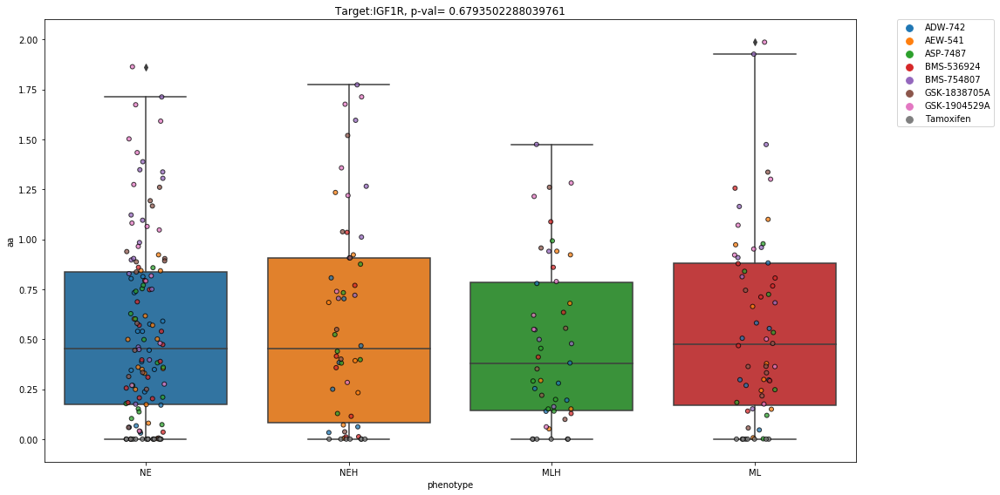

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    EB-1627  3.043721       MLH     0.0       0.0       0.0
CORL47     EB-1627  3.325161        NE     0.0       0.0       0.0
CORL88     EB-1627  2.708680       MLH     0.0       0.0       0.0
DMS114     EB-1627  3.412334        ML     0.0       0.0       0.0
DMS273     EB-1627  2.526569       NEH     0.0       0.0       0.0
DMS53      EB-1627  2.593701       MLH     0.0       0.0       0.0
DMS79      EB-1627  3.109731        NE     0.0       0.0       0.0
NCIH1048   EB-1627  3.046965        ML     0.0       0.0       0.0
NCIH1092   EB-1627  3.320512        NE     0.0       0.0       0.0
NCIH1105   EB-1627  3.066692        NE     0.0       0.0       0.0
NCIH1341   EB-1627  2.172128        ML     0.0       0.0       0.0
NCIH146    EB-1627  3.105230        NE     0.0       0.0       0.0
NCIH1618   EB-1627  2.995067        NE     0.0       0.0      

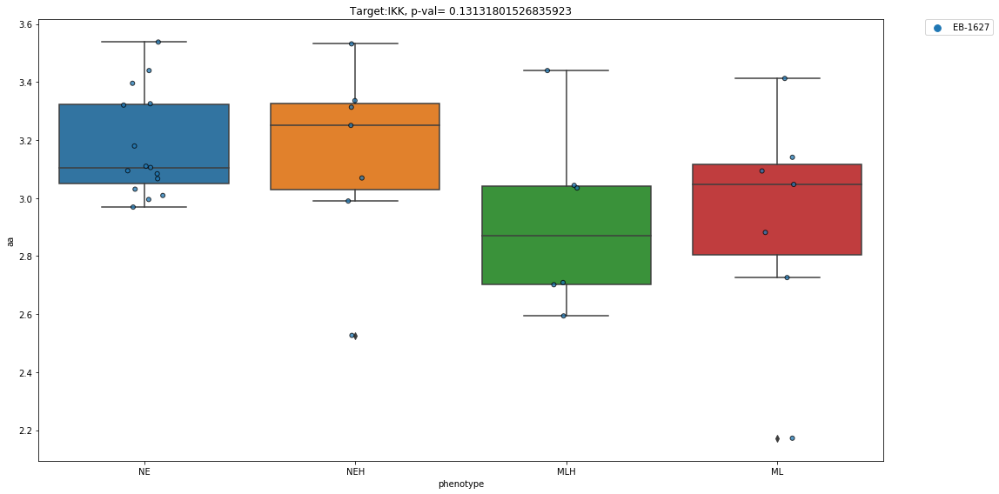

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                 drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                       
COLO668    Tacrolimus  0.0       MLH     0.0       0.0       0.0
CORL47     Tacrolimus  0.0        NE     0.0       0.0       0.0
CORL88     Tacrolimus  0.0       MLH     0.0       0.0       0.0
DMS114     Tacrolimus  0.0        ML     0.0       0.0       0.0
DMS273     Tacrolimus  0.0       NEH     0.0       0.0       0.0
DMS53      Tacrolimus  0.0       MLH     0.0       0.0       0.0
DMS79      Tacrolimus  0.0        NE     0.0       0.0       0.0
NCIH1048   Tacrolimus  0.0        ML     0.0       0.0       0.0
NCIH1092   Tacrolimus  0.0        NE     0.0       0.0       0.0
NCIH1105   Tacrolimus  0.0        NE     0.0       0.0       0.0
NCIH1341   Tacrolimus  0.0        ML     0.0       0.0       0.0
NCIH1436   Tacrolimus  0.0        NE     0.0       0.0       0.0
NCIH146    Tacrolimus  0.0        NE     0.0       0.0       0.0
NCIH1618   Tacrolimus  0.

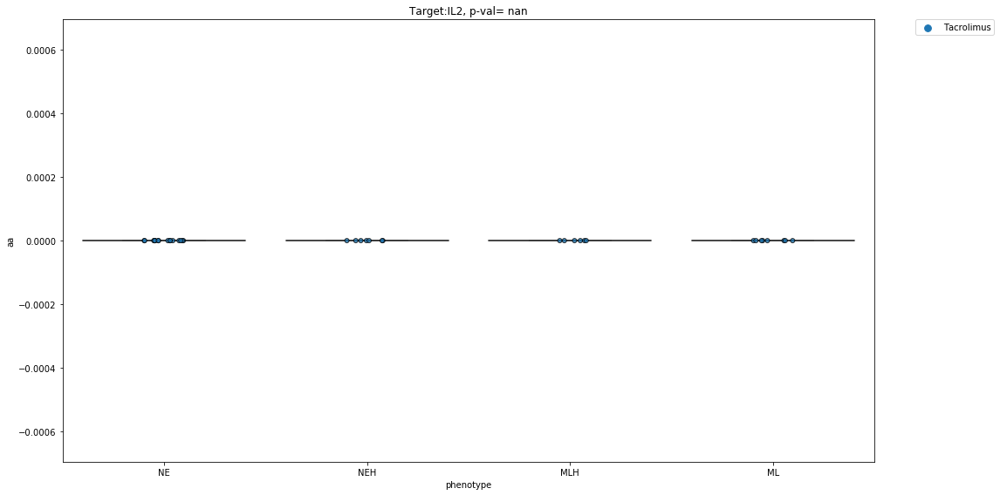

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    AVN-944  1.665232       MLH     0.0       0.0       0.0
CORL47     AVN-944  1.200733        NE     0.0       0.0       0.0
CORL88     AVN-944  0.139960       MLH     0.0       0.0       0.0
DMS114     AVN-944  1.301374        ML     0.0       0.0       0.0
DMS273     AVN-944  1.287207       NEH     0.0       0.0       0.0
DMS53      AVN-944  1.074931       MLH     0.0       0.0       0.0
DMS79      AVN-944  1.335098        NE     0.0       0.0       0.0
NCIH1048   AVN-944  1.876595        ML     0.0       0.0       0.0
NCIH1092   AVN-944  1.323877        NE     0.0       0.0       0.0
NCIH1105   AVN-944  2.198466        NE     0.0       0.0       0.0
NCIH1341   AVN-944  1.588244        ML     0.0       0.0       0.0
NCIH1436   AVN-944  1.175215        NE     0.0       0.0       0.0
NCIH146    AVN-944  1.370017        NE     0.0       0.0      

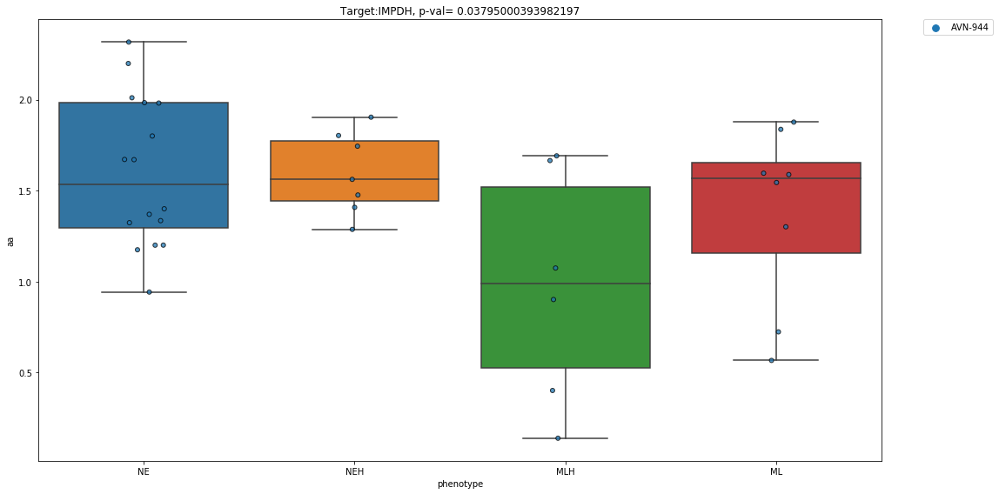

                        drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                   
COLO668    isomer of LOR-253  1.565545       MLH     0.0       0.0       0.0
CORL47     isomer of LOR-253  0.776610        NE     0.0       0.0       0.0
CORL88     isomer of LOR-253  1.243656       MLH     0.0       0.0       0.0
DMS114     isomer of LOR-253  0.057850        ML     0.0       0.0       0.0
DMS273     isomer of LOR-253  0.024480       NEH     0.0       0.0       0.0
DMS53      isomer of LOR-253  0.812865       MLH     0.0       0.0       0.0
DMS79      isomer of LOR-253  1.092471        NE     0.0       0.0       0.0
NCIH1048   isomer of LOR-253  1.240900        ML     0.0       0.0       0.0
NCIH1092   isomer of LOR-253  1.278434        NE     0.0       0.0       0.0
NCIH1105   isomer of LOR-253  1.200029        NE     0.0       0.0       0.0
NCIH1341   isomer of LOR-253  0.544046        ML     0.0       0.0       0.0

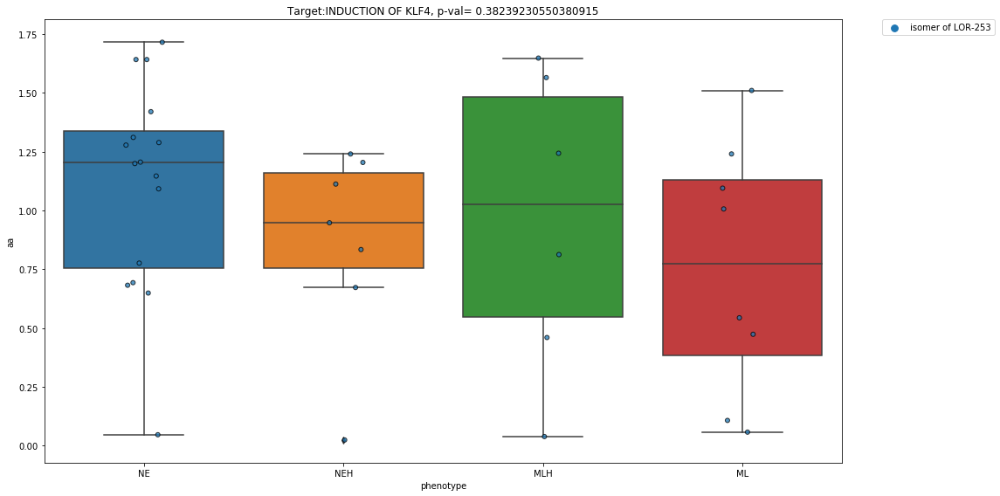

                 drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                            
COLO668    CK-0238273  2.228691       MLH     0.0       0.0       0.0
CORL47     CK-0238273  2.357488        NE     0.0       0.0       0.0
CORL88     CK-0238273  0.950431       MLH     0.0       0.0       0.0
DMS114     CK-0238273  2.828406        ML     0.0       0.0       0.0
DMS273     CK-0238273  2.137643       NEH     0.0       0.0       0.0
DMS53      CK-0238273  1.571486       MLH     0.0       0.0       0.0
DMS79      CK-0238273  0.338375        NE     0.0       0.0       0.0
NCIH1048   CK-0238273  3.131768        ML     0.0       0.0       0.0
NCIH1092   CK-0238273  1.491358        NE     0.0       0.0       0.0
NCIH1105   CK-0238273  2.776066        NE     0.0       0.0       0.0
NCIH1341   CK-0238273  2.814449        ML     0.0       0.0       0.0
NCIH1436   CK-0238273  2.675201        NE     0.0       0.0       0.0
NCIH1618   CK-023827

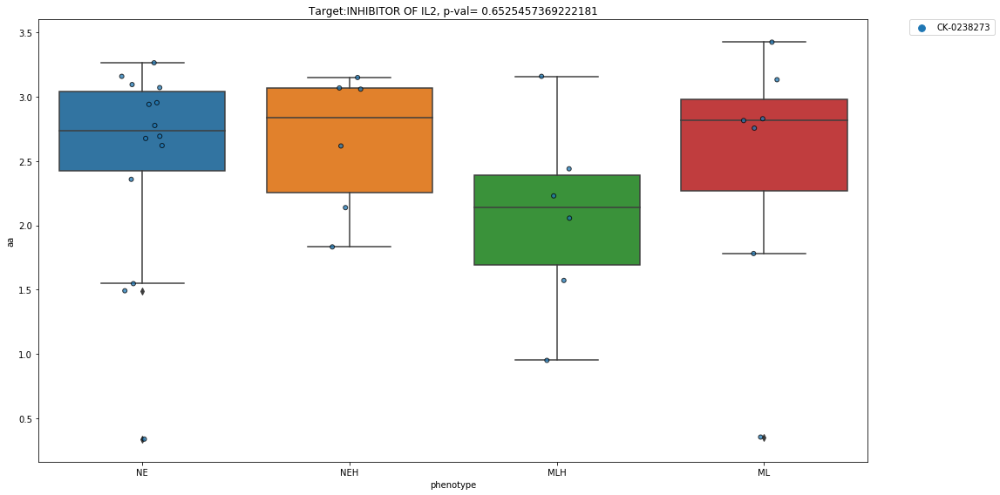

                 drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                
COLO668    BMS-536924  1.087791e+00       MLH     0.0       0.0       0.0
CORL47     BMS-536924  3.096223e-01        NE     0.0       0.0       0.0
CORL88     BMS-536924  1.280178e-01       MLH     0.0       0.0       0.0
DMS114     BMS-536924  4.677880e-01        ML     0.0       0.0       0.0
DMS273     BMS-536924  1.141111e-01       NEH     0.0       0.0       0.0
DMS53      BMS-536924  6.342420e-01       MLH     0.0       0.0       0.0
DMS79      BMS-536924  2.023478e-01        NE     0.0       0.0       0.0
NCIH1048   BMS-536924  7.114469e-01        ML     0.0       0.0       0.0
NCIH1092   BMS-536924  3.961304e-01        NE     0.0       0.0       0.0
NCIH1105   BMS-536924  5.392558e-01        NE     0.0       0.0       0.0
NCIH1341   BMS-536924  1.255844e+00        ML     0.0       0.0       0.0
NCIH1436   BMS-536924  1.824139e-01   

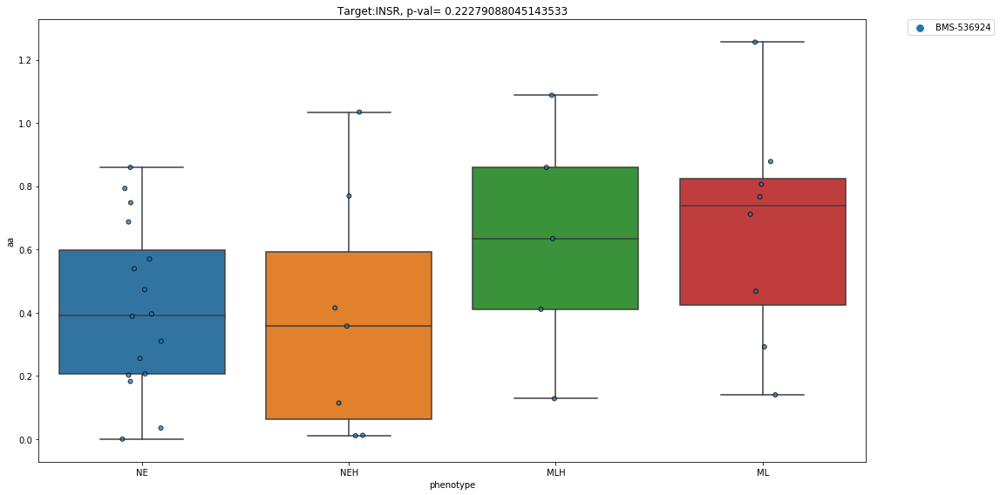

                   drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
COLO668      BMS-536924  1.087791       MLH     0.0       0.0       0.0
CORL47       BMS-536924  0.309622        NE     0.0       0.0       0.0
CORL88       BMS-536924  0.128018       MLH     0.0       0.0       0.0
DMS114       BMS-536924  0.467788        ML     0.0       0.0       0.0
DMS273       BMS-536924  0.114111       NEH     0.0       0.0       0.0
...                 ...       ...       ...     ...       ...       ...
NCIH82     GSK-1838705A  0.400597       NEH     0.0       0.0       0.0
NCIH841    GSK-1838705A  0.364481        ML     0.0       0.0       0.0
NCIH889    GSK-1838705A  0.038917        NE     0.0       0.0       0.0
SHP77      GSK-1838705A  0.098634       MLH     0.0       0.0       0.0
SW1271     GSK-1838705A  1.336228        ML     0.0       0.0       0.0

[109 rows x 6 columns]
INSULIN RECEPTOR


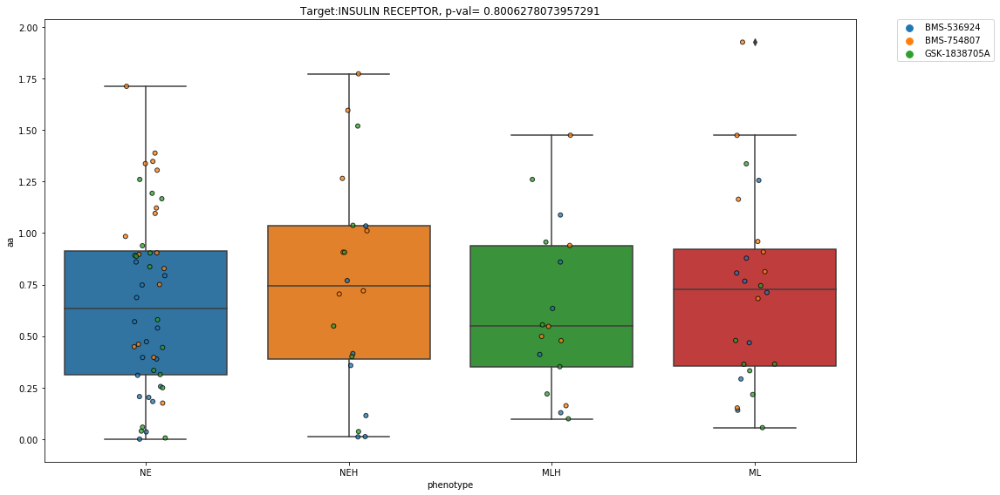

                                            drug            aa phenotype  \
cell.line                                                                  
CORL47     Peptide [CRGDKGPDC - cys & cys bridge  1.410000e-09        NE   
DMS53      Peptide [CRGDKGPDC - cys & cys bridge  3.601185e-02       MLH   
DMS79      Peptide [CRGDKGPDC - cys & cys bridge  1.130000e-09        NE   
NCIH1105   Peptide [CRGDKGPDC - cys & cys bridge  1.370000e-19        NE   
NCIH1876   Peptide [CRGDKGPDC - cys & cys bridge  0.000000e+00        NE   
NCIH1930   Peptide [CRGDKGPDC - cys & cys bridge  6.220000e-22        NE   
NCIH196    Peptide [CRGDKGPDC - cys & cys bridge  6.070000e-12        ML   
NCIH209    Peptide [CRGDKGPDC - cys & cys bridge  7.444330e-04        NE   
NCIH446    Peptide [CRGDKGPDC - cys & cys bridge  1.226224e-01       NEH   
NCIH524    Peptide [CRGDKGPDC - cys & cys bridge  3.160000e-11       NEH   
NCIH526    Peptide [CRGDKGPDC - cys & cys bridge  3.760000e-13       NEH   
NCIH69     P

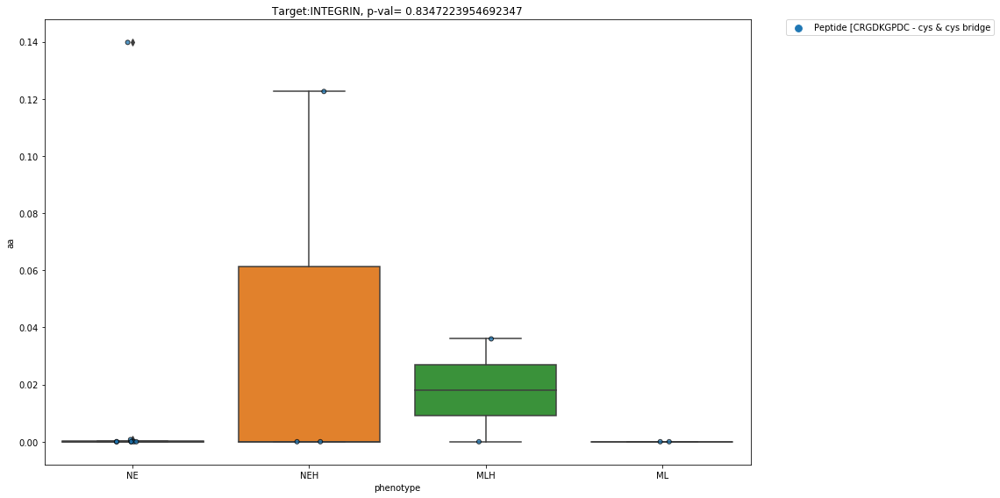

                        drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                   
COLO668    Lithium Carbonate  0.007879       MLH     0.0       0.0       0.0
CORL47     Lithium Carbonate  0.023818        NE     0.0       0.0       0.0
CORL88     Lithium Carbonate  0.195449       MLH     0.0       0.0       0.0
DMS273     Lithium Carbonate  0.084857       NEH     0.0       0.0       0.0
DMS79      Lithium Carbonate  0.075619        NE     0.0       0.0       0.0
NCIH1048   Lithium Carbonate  0.035928        ML     0.0       0.0       0.0
NCIH1341   Lithium Carbonate  0.087184        ML     0.0       0.0       0.0
NCIH146    Lithium Carbonate  0.034913        NE     0.0       0.0       0.0
NCIH1618   Lithium Carbonate  0.000000        NE     0.0       0.0       0.0
NCIH1836   Lithium Carbonate  0.064141        NE     0.0       0.0       0.0
NCIH1930   Lithium Carbonate  0.140295        NE     0.0       0.0       0.0

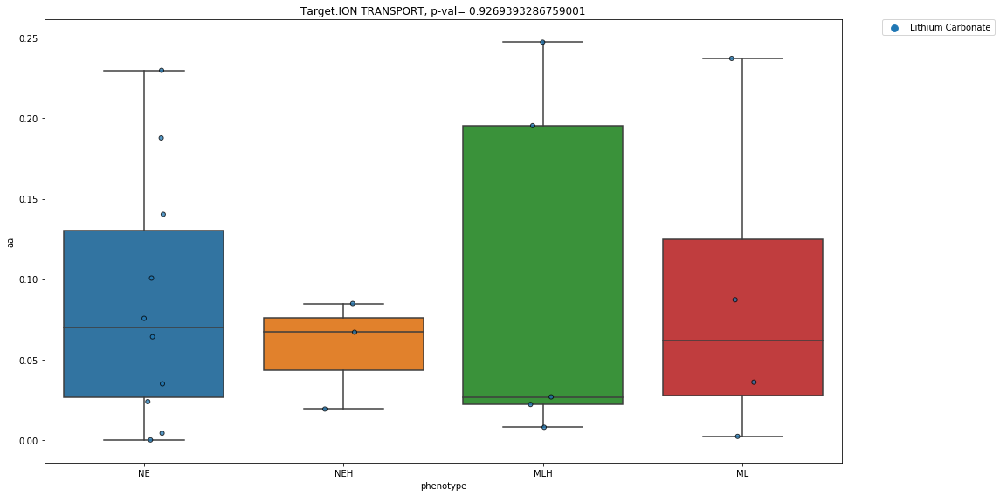

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668    ONX-0803  0.823286       MLH     0.0       0.0       0.0
CORL47     ONX-0803  0.424120        NE     0.0       0.0       0.0
CORL88     ONX-0803  0.490583       MLH     0.0       0.0       0.0
DMS114     ONX-0803  0.731093        ML     0.0       0.0       0.0
DMS273     ONX-0803  0.472729       NEH     0.0       0.0       0.0
DMS53      ONX-0803  0.431271       MLH     0.0       0.0       0.0
DMS79      ONX-0803  0.466879        NE     0.0       0.0       0.0
NCIH1048   ONX-0803  0.496630        ML     0.0       0.0       0.0
NCIH1092   ONX-0803  0.672288        NE     0.0       0.0       0.0
NCIH1105   ONX-0803  0.485796        NE     0.0       0.0       0.0
NCIH1341   ONX-0803  0.449918        ML     0.0       0.0       0.0
NCIH1436   ONX-0803  0.251863        NE     0.0       0.0       0.0
NCIH146    ONX-0803  0.545600        NE     0.0 

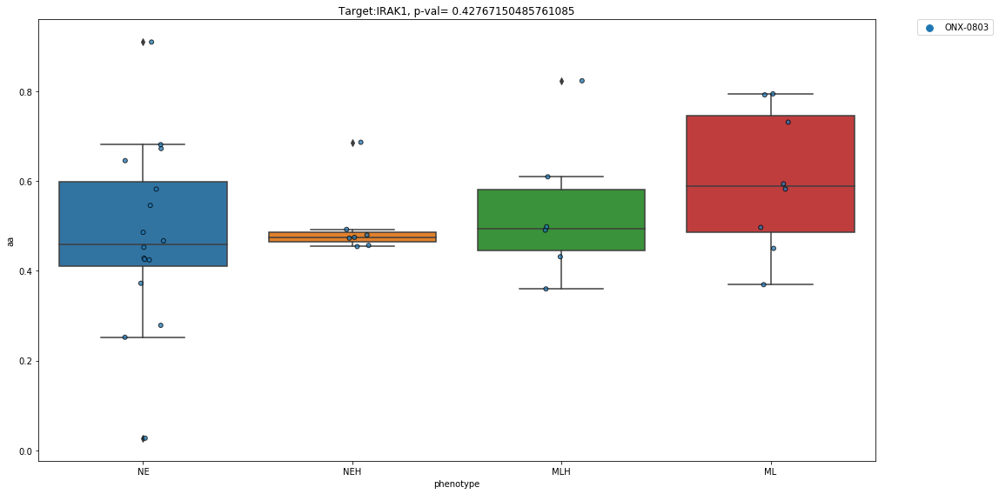

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668    AZD-1480  0.057926       MLH     0.0       0.0       0.0
CORL47     AZD-1480  0.009009        NE     0.0       0.0       0.0
DMS114     AZD-1480  0.399247        ML     0.0       0.0       0.0
DMS273     AZD-1480  0.027082       NEH     0.0       0.0       0.0
DMS53      AZD-1480  0.288698       MLH     0.0       0.0       0.0
...             ...       ...       ...     ...       ...       ...
NCIH82      CYT-387  0.402939       NEH     0.0       0.0       0.0
NCIH841     CYT-387  0.572112        ML     0.0       0.0       0.0
NCIH889     CYT-387  0.003482        NE     0.0       0.0       0.0
SHP77       CYT-387  0.239914       MLH     0.0       0.0       0.0
SW1271      CYT-387  0.121469        ML     0.0       0.0       0.0

[71 rows x 6 columns]
JAK1


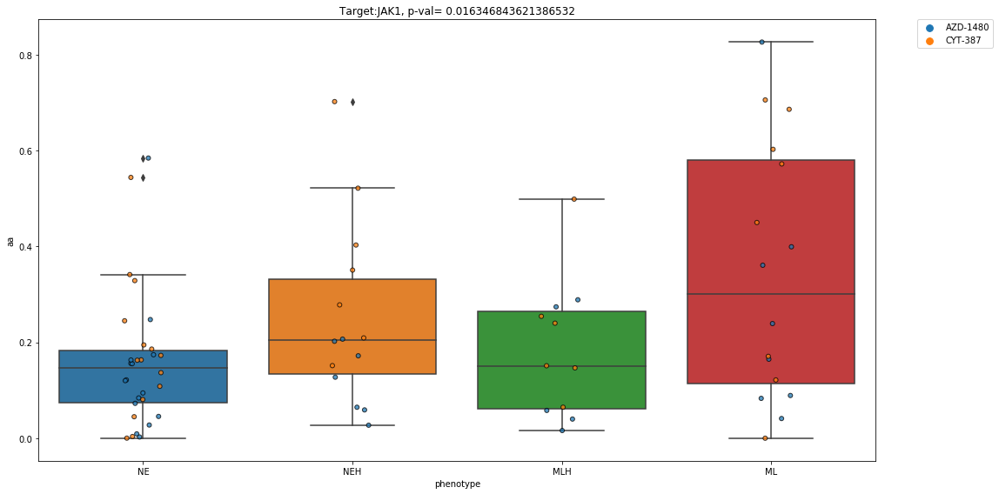

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    AT-9283  0.695010       MLH     0.0       0.0       0.0
CORL47     AT-9283  1.205870        NE     0.0       0.0       0.0
CORL88     AT-9283  0.379396       MLH     0.0       0.0       0.0
DMS114     AT-9283  0.612696        ML     0.0       0.0       0.0
DMS273     AT-9283  1.103733       NEH     0.0       0.0       0.0
...            ...       ...       ...     ...       ...       ...
NCIH82      XL-019  0.235542       NEH     0.0       0.0       0.0
NCIH841     XL-019  0.066647        ML     0.0       0.0       0.0
NCIH889     XL-019  0.025936        NE     0.0       0.0       0.0
SHP77       XL-019  0.142388       MLH     0.0       0.0       0.0
SW1271      XL-019  0.152432        ML     0.0       0.0       0.0

[421 rows x 6 columns]
JAK2


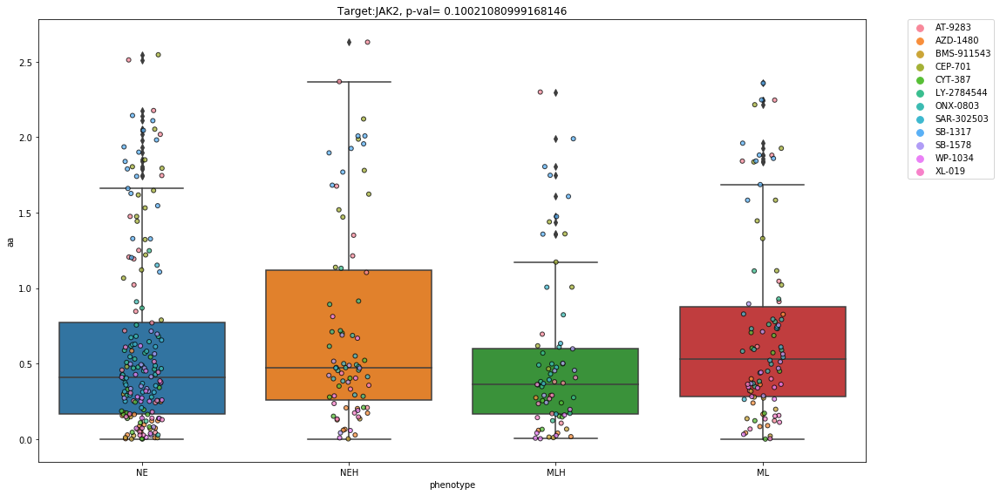

                  drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                 
COLO668    Ruxolitinib  3.533273e-01       MLH     0.0       0.0       0.0
DMS114     Ruxolitinib  2.610392e-03        ML     0.0       0.0       0.0
DMS53      Ruxolitinib  2.563246e-03       MLH     0.0       0.0       0.0
NCIH1048   Ruxolitinib  3.053260e-01        ML     0.0       0.0       0.0
NCIH1341   Ruxolitinib  1.402653e-03        ML     0.0       0.0       0.0
NCIH146    Ruxolitinib  4.452044e-03        NE     0.0       0.0       0.0
NCIH196    Ruxolitinib  3.253971e-02        ML     0.0       0.0       0.0
NCIH2029   Ruxolitinib  1.967324e-02       MLH     0.0       0.0       0.0
NCIH2066   Ruxolitinib  3.105675e-01        ML     0.0       0.0       0.0
NCIH211    Ruxolitinib  1.340619e-01        ML     0.0       0.0       0.0
NCIH2171   Ruxolitinib  6.567325e-03       NEH     0.0       0.0       0.0
NCIH446    Ruxolitinib  1

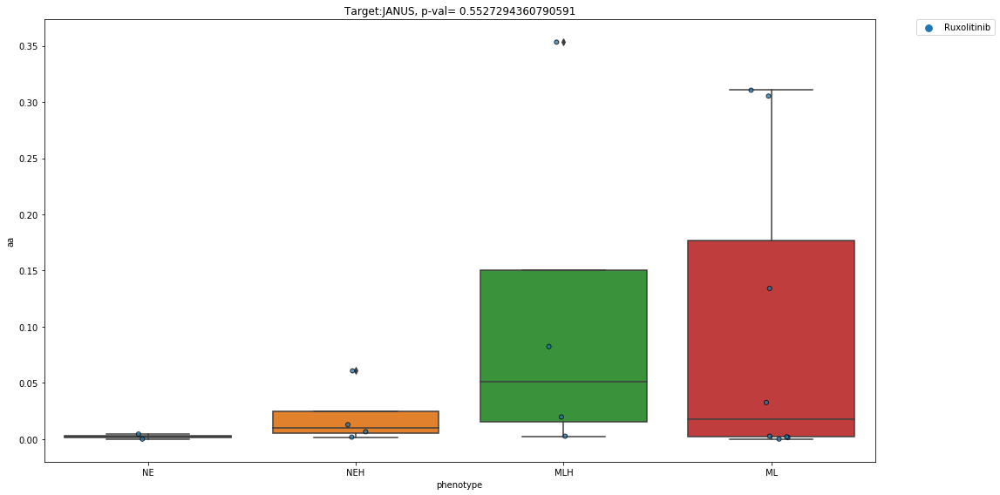

                drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                           
COLO668    SP-600125  0.002762       MLH     0.0       0.0       0.0
CORL47     SP-600125  0.060703        NE     0.0       0.0       0.0
CORL88     SP-600125  0.066852       MLH     0.0       0.0       0.0
DMS79      SP-600125  0.000271        NE     0.0       0.0       0.0
NCIH1048   SP-600125  0.152770        ML     0.0       0.0       0.0
NCIH1092   SP-600125  0.002106        NE     0.0       0.0       0.0
NCIH1105   SP-600125  0.002485        NE     0.0       0.0       0.0
NCIH1341   SP-600125  0.215422        ML     0.0       0.0       0.0
NCIH1436   SP-600125  0.258826        NE     0.0       0.0       0.0
NCIH146    SP-600125  0.044962        NE     0.0       0.0       0.0
NCIH1618   SP-600125  0.065743        NE     0.0       0.0       0.0
NCIH1836   SP-600125  0.001671        NE     0.0       0.0       0.0
NCIH1876   SP-600125  0.132166    

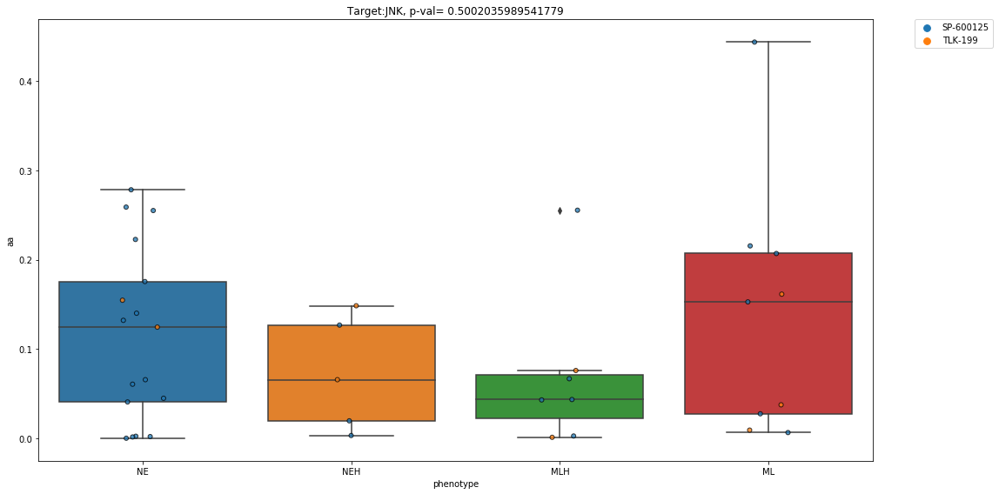

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                       drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668    Arsenic Trioxide  0.0       MLH     0.0       0.0       0.0
CORL47     Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
CORL88     Arsenic Trioxide  0.0       MLH     0.0       0.0       0.0
DMS114     Arsenic Trioxide  0.0        ML     0.0       0.0       0.0
DMS273     Arsenic Trioxide  0.0       NEH     0.0       0.0       0.0
DMS53      Arsenic Trioxide  0.0       MLH     0.0       0.0       0.0
DMS79      Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
NCIH1048   Arsenic Trioxide  0.0        ML     0.0       0.0       0.0
NCIH1092   Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
NCIH1105   Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
NCIH1341   Arsenic Trioxide  0.0        ML     0.0       0.0       0.0
NCIH1436   Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
NCIH14

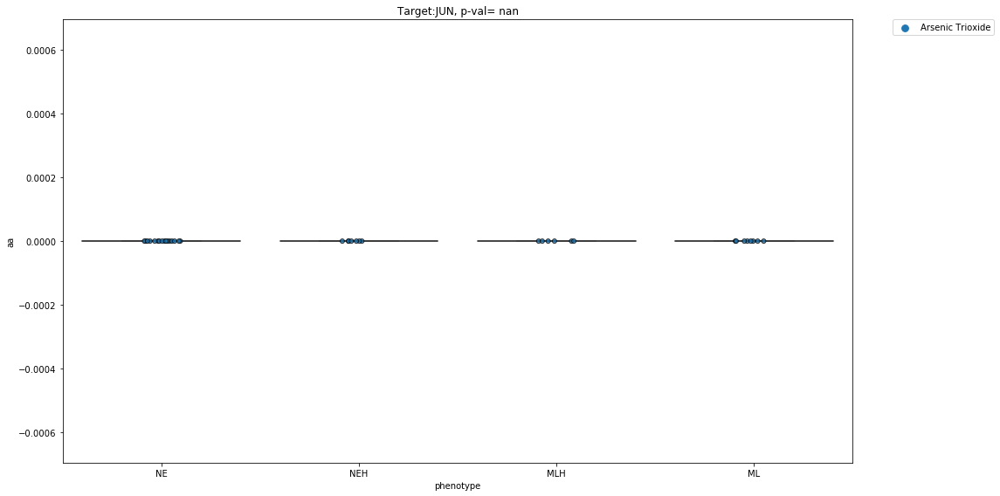

                drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                           
COLO668      ABT-869  0.377139       MLH     0.0       0.0       0.0
CORL47       ABT-869  0.153714        NE     0.0       0.0       0.0
CORL88       ABT-869  0.068119       MLH     0.0       0.0       0.0
DMS114       ABT-869  0.348983        ML     0.0       0.0       0.0
DMS273       ABT-869  0.186562       NEH     0.0       0.0       0.0
...              ...       ...       ...     ...       ...       ...
NCIH82     Sunitinib  0.000000       NEH     0.0       0.0       0.0
NCIH841    Sunitinib  0.000000        ML     0.0       0.0       0.0
NCIH889    Sunitinib  0.000000        NE     0.0       0.0       0.0
SHP77      Sunitinib  0.000000       MLH     0.0       0.0       0.0
SW1271     Sunitinib  0.000000        ML     0.0       0.0       0.0

[365 rows x 6 columns]
KDR


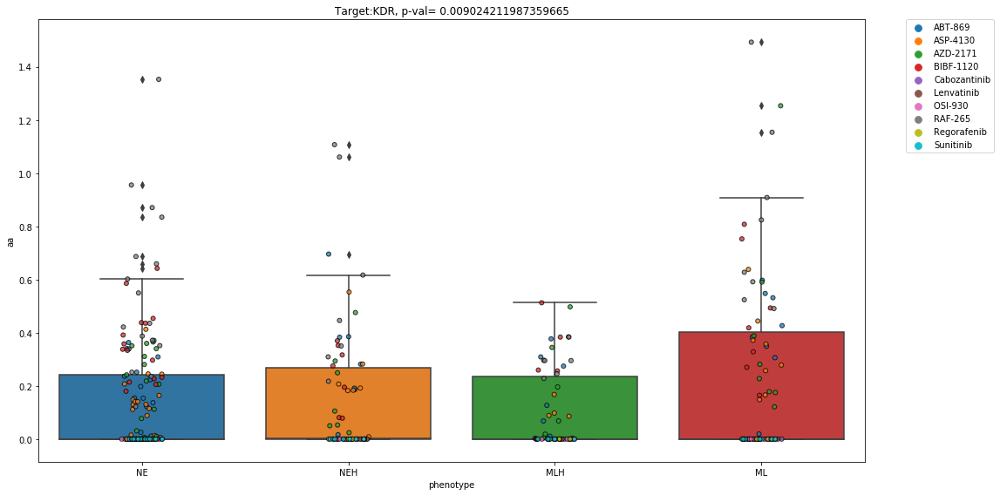

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                 drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                       
COLO668    Vandetanib  0.0       MLH     0.0       0.0       0.0
CORL47     Vandetanib  0.0        NE     0.0       0.0       0.0
CORL88     Vandetanib  0.0       MLH     0.0       0.0       0.0
DMS114     Vandetanib  0.0        ML     0.0       0.0       0.0
DMS273     Vandetanib  0.0       NEH     0.0       0.0       0.0
DMS53      Vandetanib  0.0       MLH     0.0       0.0       0.0
DMS79      Vandetanib  0.0        NE     0.0       0.0       0.0
NCIH1048   Vandetanib  0.0        ML     0.0       0.0       0.0
NCIH1092   Vandetanib  0.0        NE     0.0       0.0       0.0
NCIH1105   Vandetanib  0.0        NE     0.0       0.0       0.0
NCIH1341   Vandetanib  0.0        ML     0.0       0.0       0.0
NCIH1436   Vandetanib  0.0        NE     0.0       0.0       0.0
NCIH146    Vandetanib  0.0        NE     0.0       0.0       0.0
NCIH1618   Vandetanib  0.

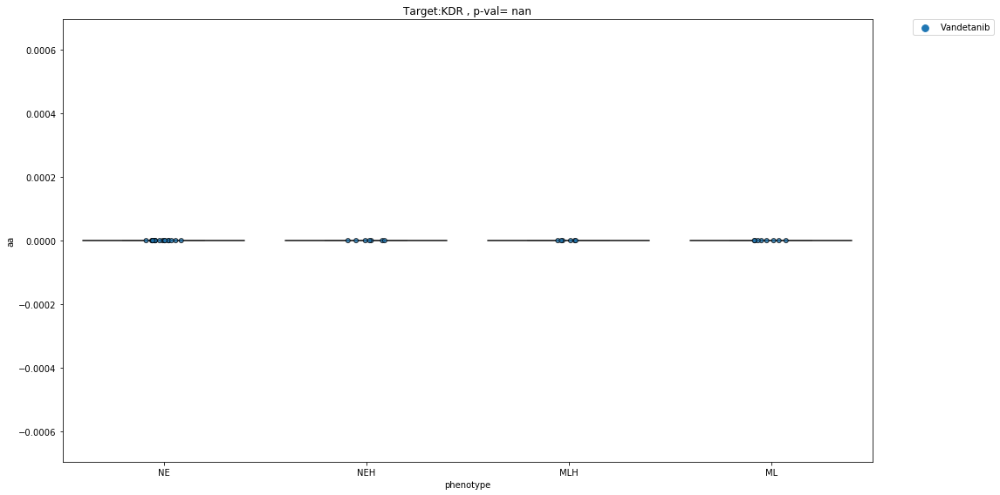

                   drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
COLO668    KHK Indazole  0.582767       MLH     0.0       0.0       0.0
CORL47     KHK Indazole  0.310633        NE     0.0       0.0       0.0
CORL88     KHK Indazole  0.104522       MLH     0.0       0.0       0.0
DMS114     KHK Indazole  0.263601        ML     0.0       0.0       0.0
DMS273     KHK Indazole  0.227176       NEH     0.0       0.0       0.0
DMS53      KHK Indazole  0.159808       MLH     0.0       0.0       0.0
DMS79      KHK Indazole  0.137739        NE     0.0       0.0       0.0
NCIH1048   KHK Indazole  0.425094        ML     0.0       0.0       0.0
NCIH1092   KHK Indazole  0.261321        NE     0.0       0.0       0.0
NCIH1105   KHK Indazole  0.436633        NE     0.0       0.0       0.0
NCIH1341   KHK Indazole  0.700362        ML     0.0       0.0       0.0
NCIH1436   KHK Indazole  0.376436        NE     0.0       0.0   

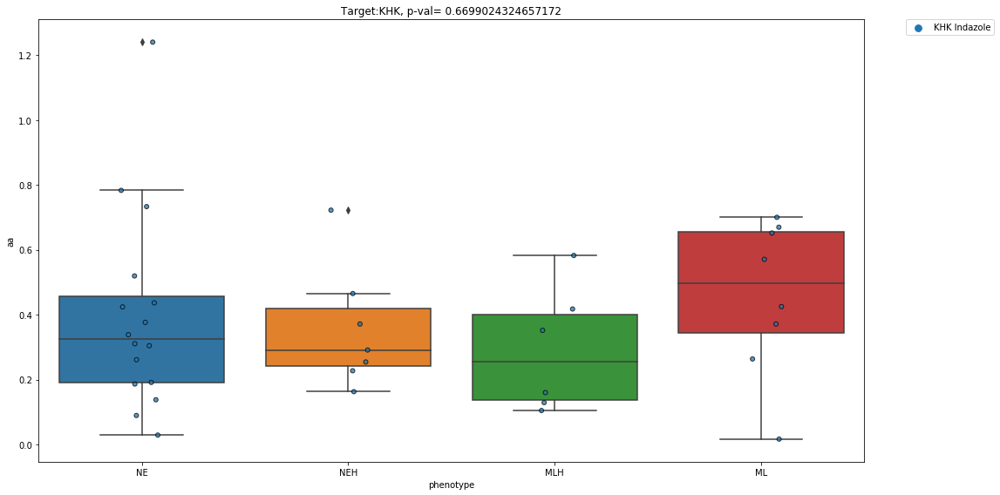

                drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                           
COLO668      ARQ-621  0.758145       MLH     0.0       0.0       0.0
CORL47       ARQ-621  1.141525        NE     0.0       0.0       0.0
CORL88       ARQ-621  0.449071       MLH     0.0       0.0       0.0
DMS114       ARQ-621  1.909646        ML     0.0       0.0       0.0
DMS273       ARQ-621  0.729365       NEH     0.0       0.0       0.0
...              ...       ...       ...     ...       ...       ...
NCIH526    SB-743921  3.070211       NEH     0.0       0.0       0.0
NCIH82     SB-743921  3.043090       NEH     0.0       0.0       0.0
NCIH841    SB-743921  3.410540        ML     0.0       0.0       0.0
SHP77      SB-743921  2.680032       MLH     0.0       0.0       0.0
SW1271     SB-743921  3.293944        ML     0.0       0.0       0.0

[99 rows x 6 columns]
KIF11


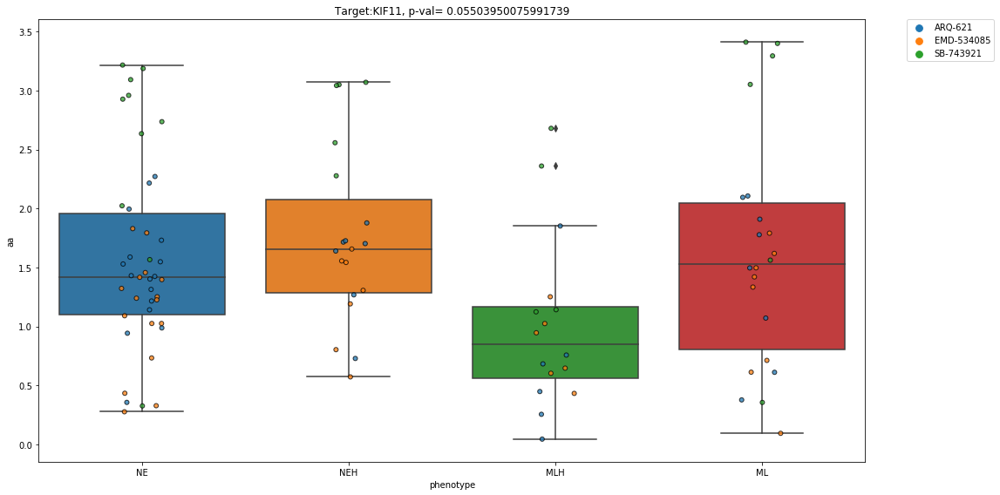

                drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                           
COLO668      AB-1010  0.005410       MLH     0.0       0.0       0.0
CORL47       AB-1010  0.001694        NE     0.0       0.0       0.0
CORL88       AB-1010  0.039447       MLH     0.0       0.0       0.0
DMS114       AB-1010  0.307963        ML     0.0       0.0       0.0
DMS273       AB-1010  0.223423       NEH     0.0       0.0       0.0
...              ...       ...       ...     ...       ...       ...
NCIH82     Sunitinib  0.000000       NEH     0.0       0.0       0.0
NCIH841    Sunitinib  0.000000        ML     0.0       0.0       0.0
NCIH889    Sunitinib  0.000000        NE     0.0       0.0       0.0
SHP77      Sunitinib  0.000000       MLH     0.0       0.0       0.0
SW1271     Sunitinib  0.000000        ML     0.0       0.0       0.0

[323 rows x 6 columns]
KIT


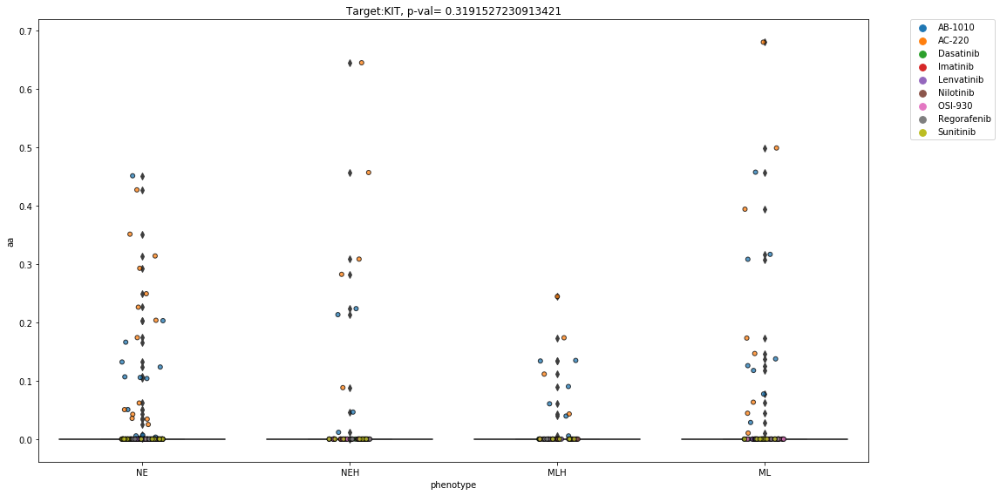

                          drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                     
COLO668    ARRY-520 (isomer A)  2.008502       MLH     0.0       0.0       0.0
DMS53      ARRY-520 (isomer A)  0.980928       MLH     0.0       0.0       0.0
NCIH1092   ARRY-520 (isomer A)  1.060827        NE     0.0       0.0       0.0
NCIH1341   ARRY-520 (isomer A)  2.102190        ML     0.0       0.0       0.0
NCIH1836   ARRY-520 (isomer A)  2.435880        NE     0.0       0.0       0.0
NCIH1876   ARRY-520 (isomer A)  2.873276        NE     0.0       0.0       0.0
NCIH196    ARRY-520 (isomer A)  1.039964        ML     0.0       0.0       0.0
NCIH1963   ARRY-520 (isomer A)  2.596158        NE     0.0       0.0       0.0
NCIH2029   ARRY-520 (isomer A)  1.162776       MLH     0.0       0.0       0.0
NCIH2066   ARRY-520 (isomer A)  0.794308        ML     0.0       0.0       0.0
NCIH2081   ARRY-520 (isomer A)  2.526157        NE  

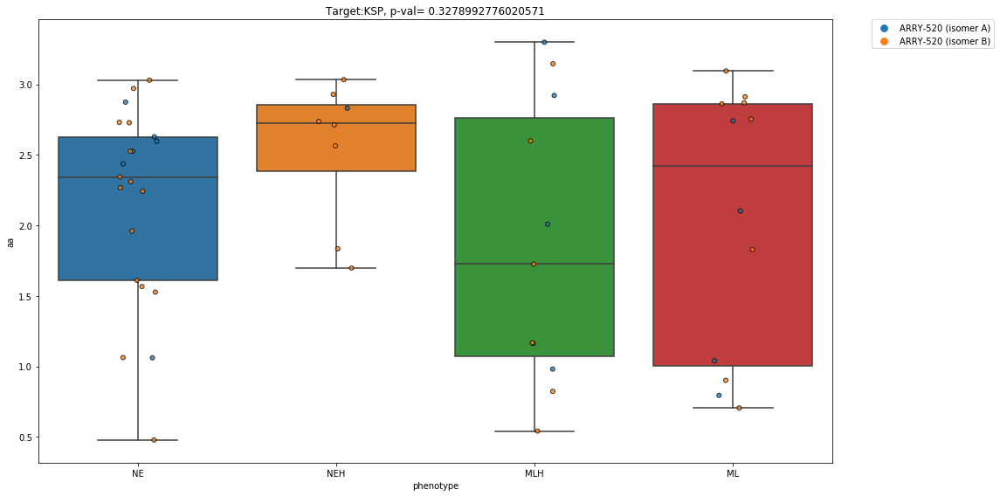

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                      
COLO668    Dasatinib  0.0       MLH     0.0       0.0       0.0
CORL47     Dasatinib  0.0        NE     0.0       0.0       0.0
CORL88     Dasatinib  0.0       MLH     0.0       0.0       0.0
DMS114     Dasatinib  0.0        ML     0.0       0.0       0.0
DMS273     Dasatinib  0.0       NEH     0.0       0.0       0.0
DMS53      Dasatinib  0.0       MLH     0.0       0.0       0.0
DMS79      Dasatinib  0.0        NE     0.0       0.0       0.0
NCIH1048   Dasatinib  0.0        ML     0.0       0.0       0.0
NCIH1092   Dasatinib  0.0        NE     0.0       0.0       0.0
NCIH1105   Dasatinib  0.0        NE     0.0       0.0       0.0
NCIH1341   Dasatinib  0.0        ML     0.0       0.0       0.0
NCIH1436   Dasatinib  0.0        NE     0.0       0.0       0.0
NCIH146    Dasatinib  0.0        NE     0.0       0.0       0.0
NCIH1618   Dasatinib  0.0        NE     

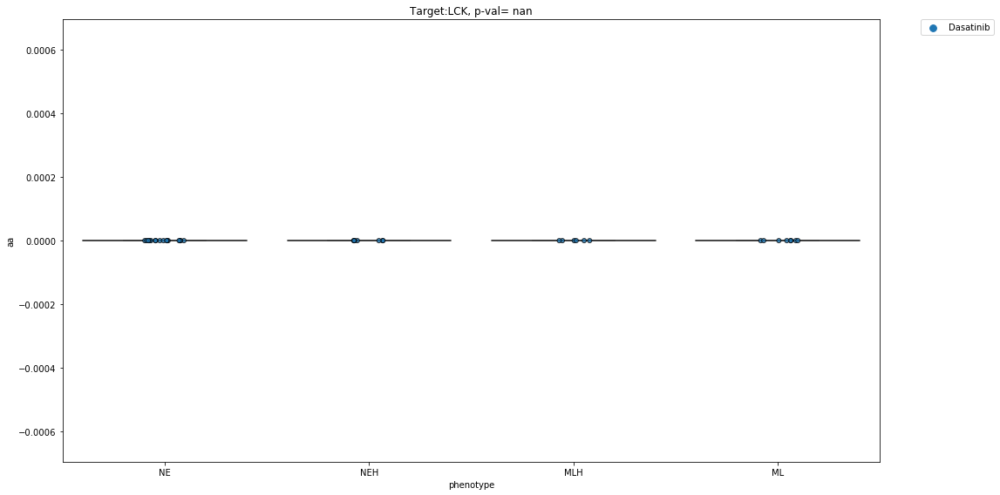

                  drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                 
CORL47     LDHA Cmp 33  6.267905e-02        NE     0.0       0.0       0.0
DMS114     LDHA Cmp 33  1.773480e-01        ML     0.0       0.0       0.0
DMS273     LDHA Cmp 33  5.017215e-02       NEH     0.0       0.0       0.0
DMS79      LDHA Cmp 33  1.990000e-10        NE     0.0       0.0       0.0
NCIH1048   LDHA Cmp 33  8.618790e-04        ML     0.0       0.0       0.0
NCIH1436   LDHA Cmp 33  0.000000e+00        NE     0.0       0.0       0.0
NCIH146    LDHA Cmp 33  5.500096e-02        NE     0.0       0.0       0.0
NCIH1836   LDHA Cmp 33  1.263734e-03        NE     0.0       0.0       0.0
NCIH1930   LDHA Cmp 33  1.670576e-03        NE     0.0       0.0       0.0
NCIH196    LDHA Cmp 33  6.400000e-09        ML     0.0       0.0       0.0
NCIH2029   LDHA Cmp 33  6.754375e-02       MLH     0.0       0.0       0.0
NCIH209    LDHA Cmp 33  8

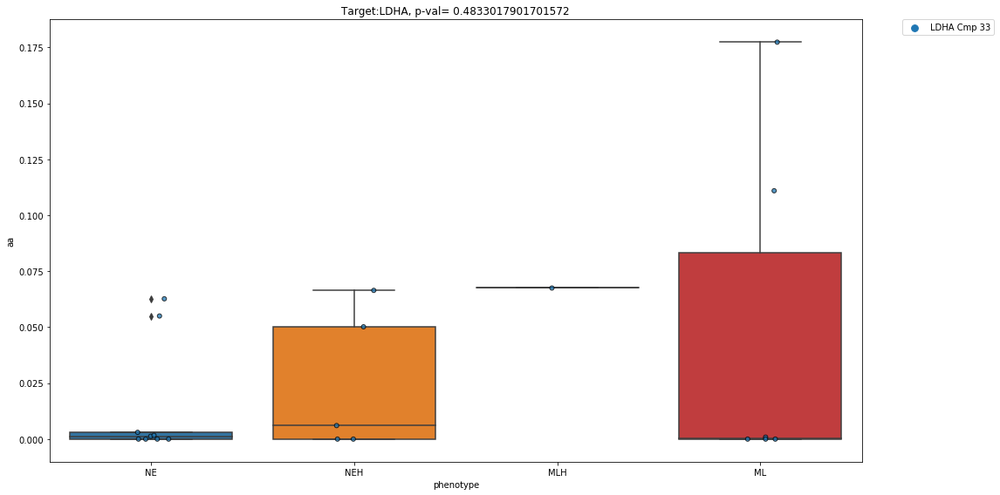

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
CORL47     CT-32228  1.074758        NE     0.0       0.0       0.0
CORL88     CT-32228  1.082698       MLH     0.0       0.0       0.0
DMS114     CT-32228  1.869384        ML     0.0       0.0       0.0
DMS273     CT-32228  1.078971       NEH     0.0       0.0       0.0
DMS53      CT-32228  0.447943       MLH     0.0       0.0       0.0
DMS79      CT-32228  0.610934        NE     0.0       0.0       0.0
NCIH1092   CT-32228  1.086375        NE     0.0       0.0       0.0
NCIH1105   CT-32228  1.916350        NE     0.0       0.0       0.0
NCIH1341   CT-32228  0.846467        ML     0.0       0.0       0.0
NCIH1436   CT-32228  1.891908        NE     0.0       0.0       0.0
NCIH146    CT-32228  1.494078        NE     0.0       0.0       0.0
NCIH1618   CT-32228  2.066322        NE     0.0       0.0       0.0
NCIH1694   CT-32228  1.376029       NEH     0.0 

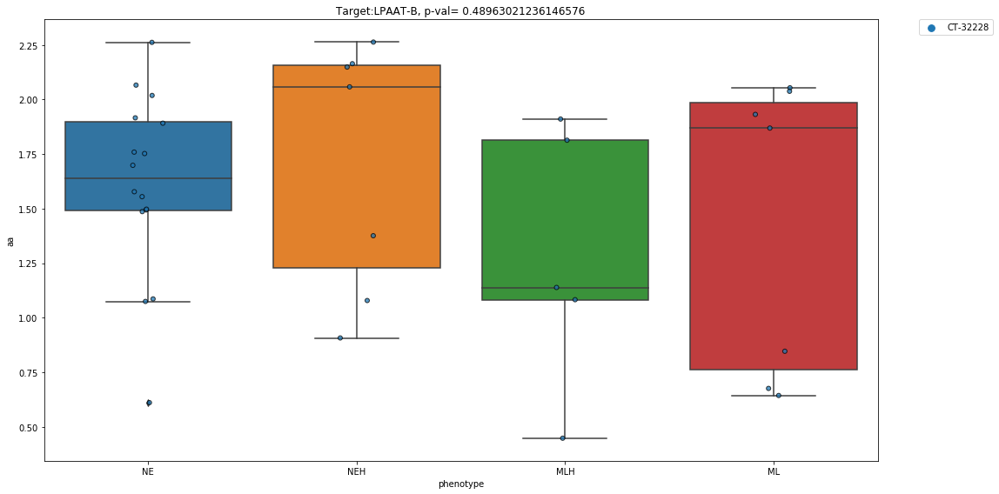

                 drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                            
COLO668    CH-5424802  0.298747       MLH     0.0       0.0       0.0
CORL47     CH-5424802  0.348116        NE     0.0       0.0       0.0
DMS114     CH-5424802  0.366292        ML     0.0       0.0       0.0
DMS273     CH-5424802  0.025406       NEH     0.0       0.0       0.0
DMS53      CH-5424802  0.223280       MLH     0.0       0.0       0.0
DMS79      CH-5424802  0.102761        NE     0.0       0.0       0.0
NCIH1048   CH-5424802  0.321459        ML     0.0       0.0       0.0
NCIH1092   CH-5424802  0.245147        NE     0.0       0.0       0.0
NCIH1105   CH-5424802  0.200193        NE     0.0       0.0       0.0
NCIH1341   CH-5424802  0.207131        ML     0.0       0.0       0.0
NCIH1436   CH-5424802  0.169759        NE     0.0       0.0       0.0
NCIH146    CH-5424802  0.293679        NE     0.0       0.0       0.0
NCIH1618   CH-542480

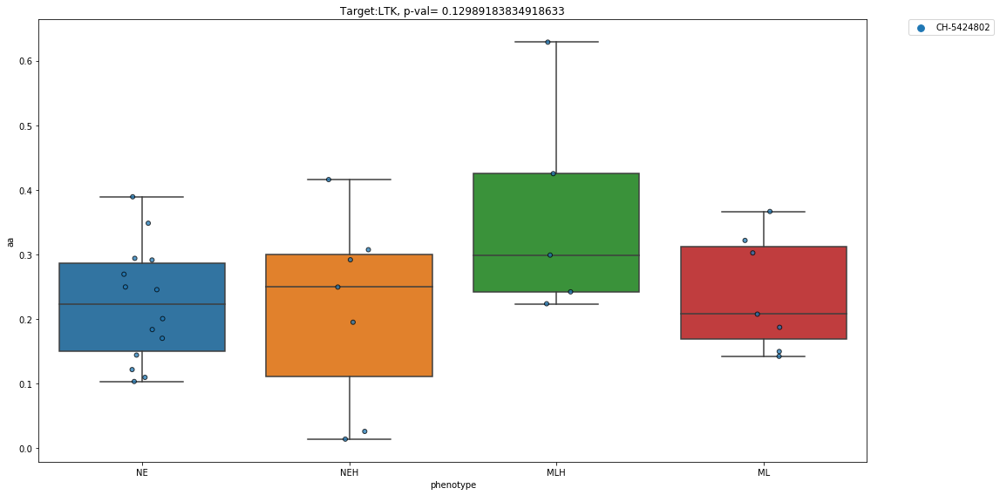

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                       drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668    Arsenic Trioxide  0.0       MLH     0.0       0.0       0.0
CORL47     Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
CORL88     Arsenic Trioxide  0.0       MLH     0.0       0.0       0.0
DMS114     Arsenic Trioxide  0.0        ML     0.0       0.0       0.0
DMS273     Arsenic Trioxide  0.0       NEH     0.0       0.0       0.0
DMS53      Arsenic Trioxide  0.0       MLH     0.0       0.0       0.0
DMS79      Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
NCIH1048   Arsenic Trioxide  0.0        ML     0.0       0.0       0.0
NCIH1092   Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
NCIH1105   Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
NCIH1341   Arsenic Trioxide  0.0        ML     0.0       0.0       0.0
NCIH1436   Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
NCIH14

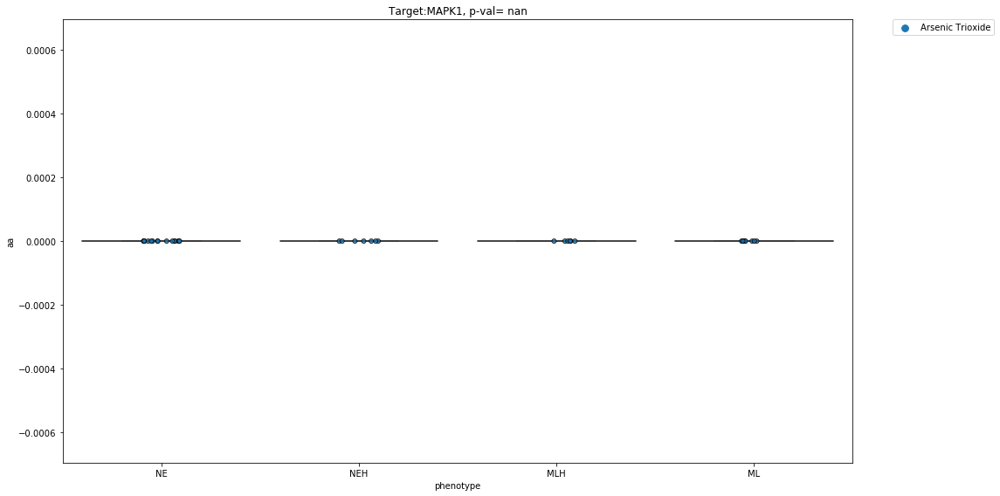

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                       drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668    Arsenic Trioxide  0.0       MLH     0.0       0.0       0.0
CORL47     Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
CORL88     Arsenic Trioxide  0.0       MLH     0.0       0.0       0.0
DMS114     Arsenic Trioxide  0.0        ML     0.0       0.0       0.0
DMS273     Arsenic Trioxide  0.0       NEH     0.0       0.0       0.0
DMS53      Arsenic Trioxide  0.0       MLH     0.0       0.0       0.0
DMS79      Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
NCIH1048   Arsenic Trioxide  0.0        ML     0.0       0.0       0.0
NCIH1092   Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
NCIH1105   Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
NCIH1341   Arsenic Trioxide  0.0        ML     0.0       0.0       0.0
NCIH1436   Arsenic Trioxide  0.0        NE     0.0       0.0       0.0
NCIH14

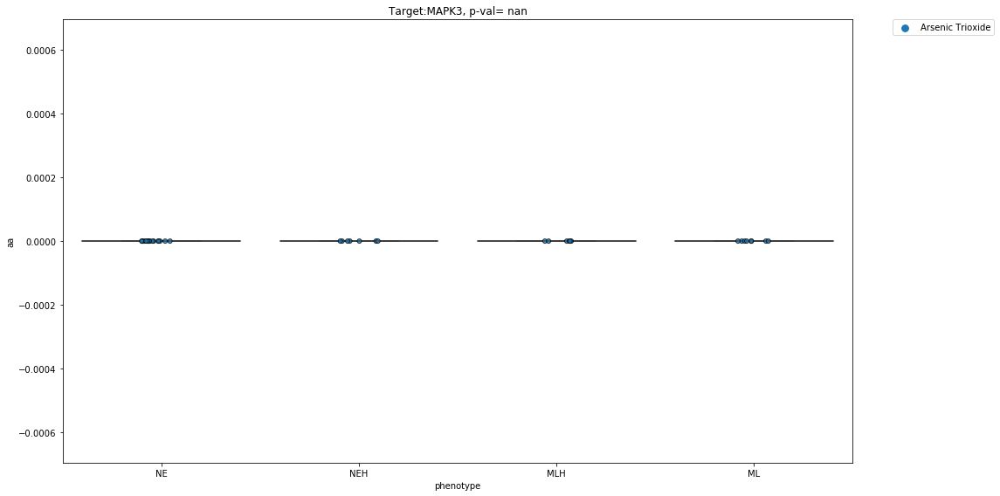

                   drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
COLO668    JNJ-27291199  0.409092       MLH     0.0       0.0       0.0
CORL47     JNJ-27291199  0.049338        NE     0.0       0.0       0.0
CORL88     JNJ-27291199  0.104106       MLH     0.0       0.0       0.0
DMS114     JNJ-27291199  0.360296        ML     0.0       0.0       0.0
DMS273     JNJ-27291199  0.025278       NEH     0.0       0.0       0.0
...                 ...       ...       ...     ...       ...       ...
NCIH69          RG-7112  0.036923        NE     0.0       0.0       0.0
NCIH82          RG-7112  0.048219       NEH     0.0       0.0       0.0
NCIH841         RG-7112  0.108286        ML     0.0       0.0       0.0
SHP77           RG-7112  0.006088       MLH     0.0       0.0       0.0
SW1271          RG-7112  0.103337        ML     0.0       0.0       0.0

[67 rows x 6 columns]
MDM2


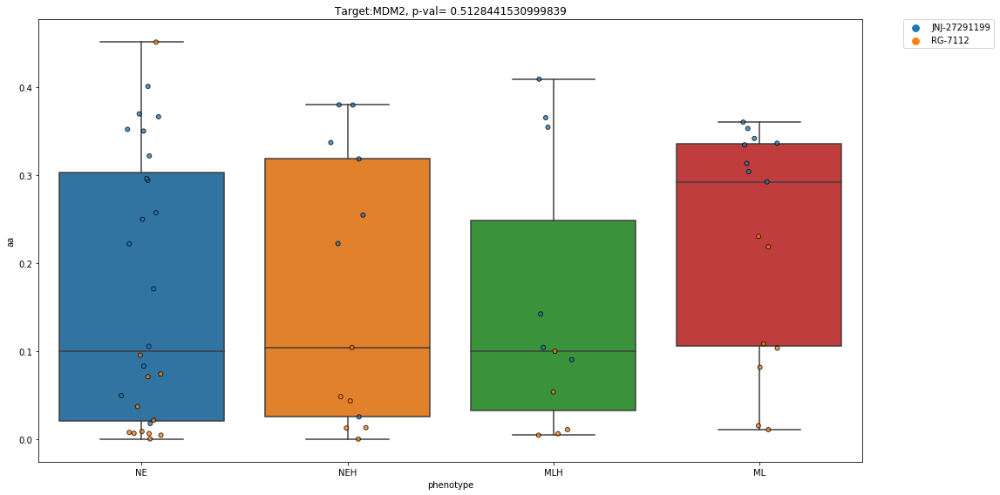

                        drug            aa phenotype  aa_new  hill_new  \
cell.line                                                                
COLO668             ARRY-162  7.682160e-01       MLH     0.0       0.0   
CORL88              ARRY-162  8.927987e-02       MLH     0.0       0.0   
DMS114              ARRY-162  5.686870e-01        ML     0.0       0.0   
DMS53               ARRY-162  4.338901e-01       MLH     0.0       0.0   
NCIH1048            ARRY-162  3.458868e-01        ML     0.0       0.0   
...                      ...           ...       ...     ...       ...   
NCIH69     XL-518 (isomer 2)  1.164513e-01        NE     0.0       0.0   
NCIH82     XL-518 (isomer 2)  1.270000e-18       NEH     0.0       0.0   
NCIH841    XL-518 (isomer 2)  5.003389e-02        ML     0.0       0.0   
SHP77      XL-518 (isomer 2)  9.575988e-02       MLH     0.0       0.0   
SW1271     XL-518 (isomer 2)  1.969103e-01        ML     0.0       0.0   

           emax_new  
cell.line      

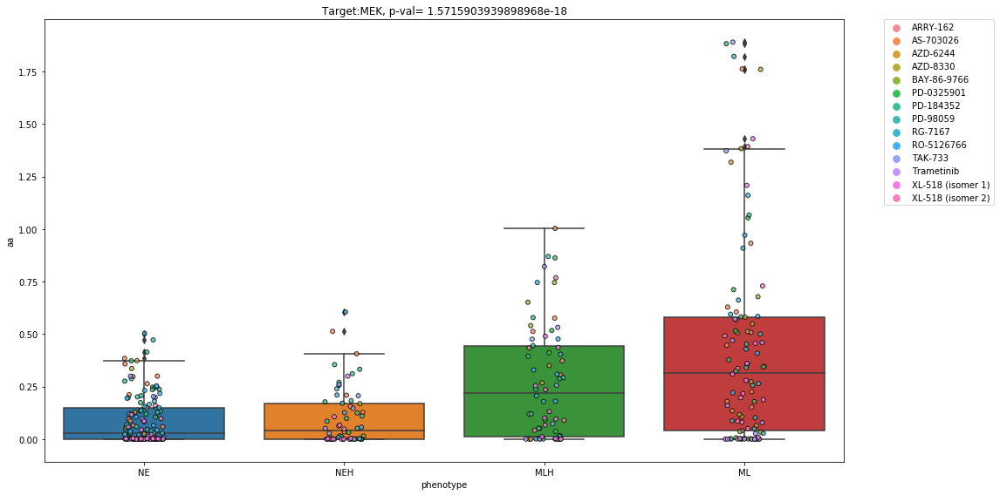

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    AMG-208  0.115793       MLH     0.0       0.0       0.0
DMS114     AMG-208  0.053920        ML     0.0       0.0       0.0
DMS273     AMG-208  0.225382       NEH     0.0       0.0       0.0
DMS53      AMG-208  0.100291       MLH     0.0       0.0       0.0
NCIH1048   AMG-208  0.187098        ML     0.0       0.0       0.0
...            ...       ...       ...     ...       ...       ...
NCIH82      XL-880  0.682264       NEH     0.0       0.0       0.0
NCIH841     XL-880  1.364307        ML     0.0       0.0       0.0
NCIH889     XL-880  0.761470        NE     0.0       0.0       0.0
SHP77       XL-880  0.351757       MLH     0.0       0.0       0.0
SW1271      XL-880  0.824840        ML     0.0       0.0       0.0

[533 rows x 6 columns]
MET


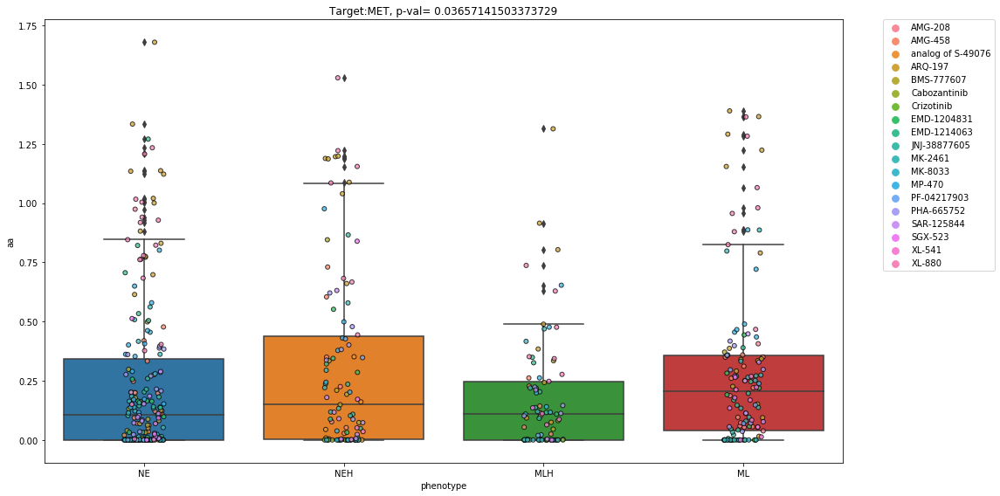

              drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668    JZL-184  1.455254e-02       MLH     0.0       0.0       0.0
DMS273     JZL-184  2.341117e-01       NEH     0.0       0.0       0.0
DMS53      JZL-184  1.057659e-01       MLH     0.0       0.0       0.0
NCIH1048   JZL-184  9.467625e-02        ML     0.0       0.0       0.0
NCIH1105   JZL-184  1.259248e-02        NE     0.0       0.0       0.0
NCIH1341   JZL-184  1.155158e-01        ML     0.0       0.0       0.0
NCIH1436   JZL-184  2.580814e-03        NE     0.0       0.0       0.0
NCIH1694   JZL-184  8.588023e-02       NEH     0.0       0.0       0.0
NCIH1836   JZL-184  1.578927e-01        NE     0.0       0.0       0.0
NCIH1876   JZL-184  4.750920e-02        NE     0.0       0.0       0.0
NCIH196    JZL-184  2.417687e-02        ML     0.0       0.0       0.0
NCIH2066   JZL-184  4.489661e-01        ML     0.0       0.0       0.0
NCIH20

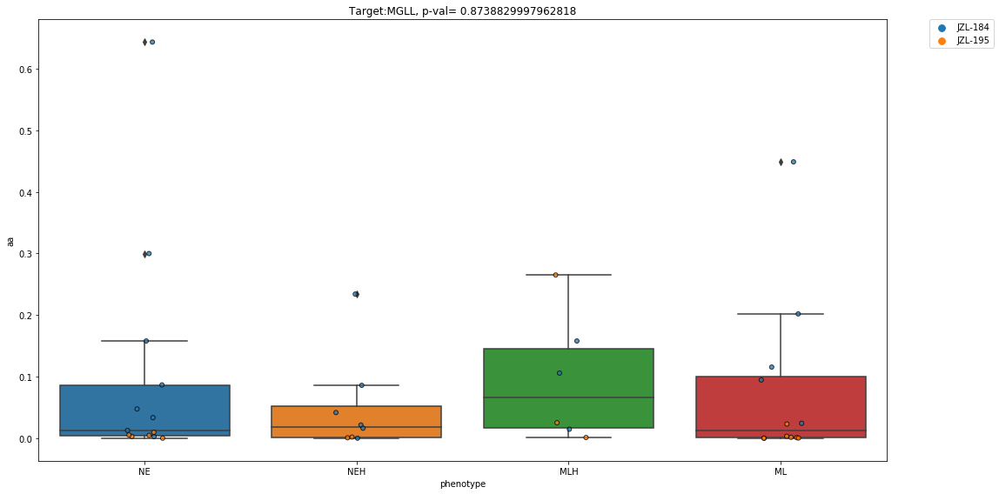

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668    AZD-2014  0.644077       MLH     0.0       0.0       0.0
CORL47     AZD-2014  0.383617        NE     0.0       0.0       0.0
DMS114     AZD-2014  2.132648        ML     0.0       0.0       0.0
DMS273     AZD-2014  1.054631       NEH     0.0       0.0       0.0
DMS53      AZD-2014  0.680085       MLH     0.0       0.0       0.0
...             ...       ...       ...     ...       ...       ...
NCIH82      RG-7603  0.599019       NEH     0.0       0.0       0.0
NCIH841     RG-7603  0.881225        ML     0.0       0.0       0.0
NCIH889     RG-7603  0.410851        NE     0.0       0.0       0.0
SHP77       RG-7603  0.323425       MLH     0.0       0.0       0.0
SW1271      RG-7603  1.197141        ML     0.0       0.0       0.0

[640 rows x 6 columns]
MTOR


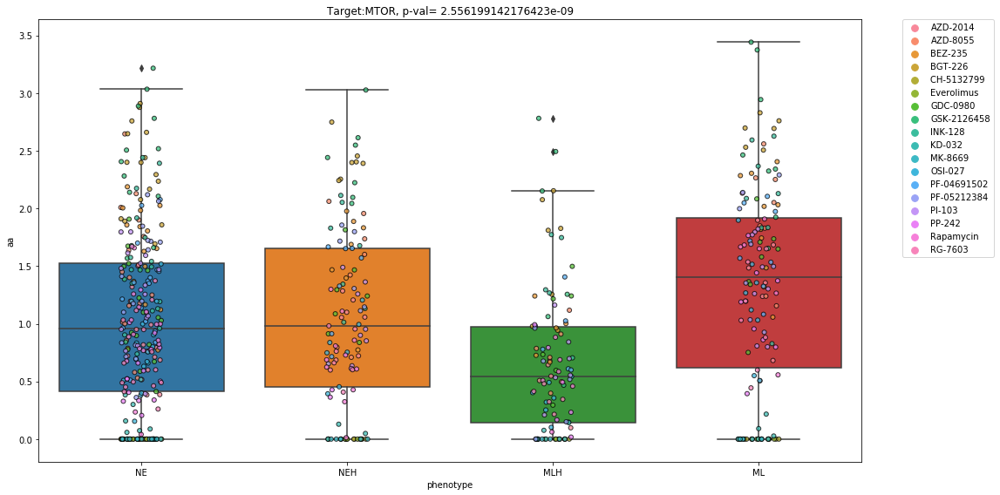

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668    AZD-8055  1.117515       MLH     0.0       0.0       0.0
CORL47     AZD-8055  0.578829        NE     0.0       0.0       0.0
CORL88     AZD-8055  0.397976       MLH     0.0       0.0       0.0
DMS114     AZD-8055  2.559827        ML     0.0       0.0       0.0
DMS273     AZD-8055  1.601365       NEH     0.0       0.0       0.0
DMS53      AZD-8055  0.786094       MLH     0.0       0.0       0.0
DMS79      AZD-8055  1.177080        NE     0.0       0.0       0.0
NCIH1048   AZD-8055  2.265048        ML     0.0       0.0       0.0
NCIH1092   AZD-8055  0.855566        NE     0.0       0.0       0.0
NCIH1105   AZD-8055  1.249530        NE     0.0       0.0       0.0
NCIH1341   AZD-8055  2.051437        ML     0.0       0.0       0.0
NCIH1436   AZD-8055  1.014010        NE     0.0       0.0       0.0
NCIH146    AZD-8055  1.756829        NE     0.0 

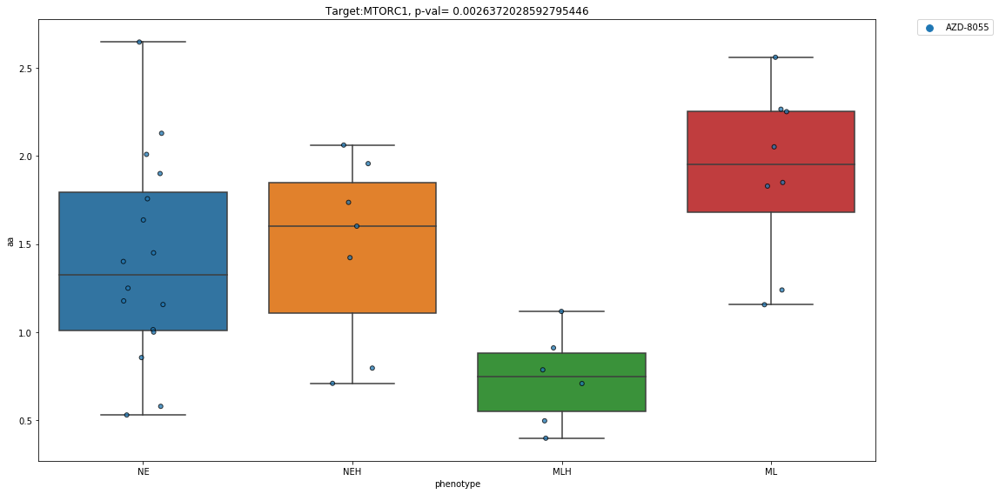

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668    AZD-8055  1.117515       MLH     0.0       0.0       0.0
CORL47     AZD-8055  0.578829        NE     0.0       0.0       0.0
CORL88     AZD-8055  0.397976       MLH     0.0       0.0       0.0
DMS114     AZD-8055  2.559827        ML     0.0       0.0       0.0
DMS273     AZD-8055  1.601365       NEH     0.0       0.0       0.0
DMS53      AZD-8055  0.786094       MLH     0.0       0.0       0.0
DMS79      AZD-8055  1.177080        NE     0.0       0.0       0.0
NCIH1048   AZD-8055  2.265048        ML     0.0       0.0       0.0
NCIH1092   AZD-8055  0.855566        NE     0.0       0.0       0.0
NCIH1105   AZD-8055  1.249530        NE     0.0       0.0       0.0
NCIH1341   AZD-8055  2.051437        ML     0.0       0.0       0.0
NCIH1436   AZD-8055  1.014010        NE     0.0       0.0       0.0
NCIH146    AZD-8055  1.756829        NE     0.0 

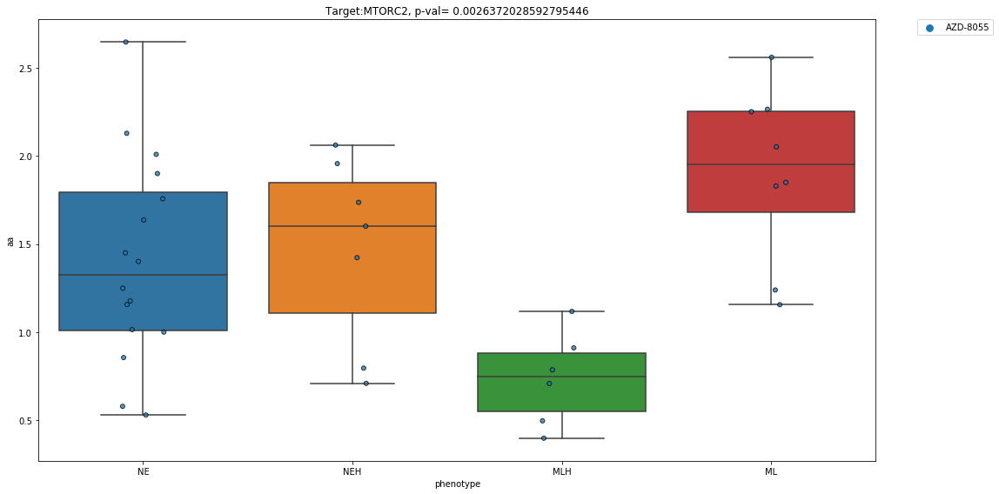

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668    MLN-4924  2.182464       MLH     0.0       0.0       0.0
CORL47     MLN-4924  1.964960        NE     0.0       0.0       0.0
DMS114     MLN-4924  2.177656        ML     0.0       0.0       0.0
DMS273     MLN-4924  0.566567       NEH     0.0       0.0       0.0
DMS53      MLN-4924  0.710233       MLH     0.0       0.0       0.0
DMS79      MLN-4924  0.036715        NE     0.0       0.0       0.0
NCIH1048   MLN-4924  2.445404        ML     0.0       0.0       0.0
NCIH1092   MLN-4924  0.782310        NE     0.0       0.0       0.0
NCIH1105   MLN-4924  1.605001        NE     0.0       0.0       0.0
NCIH1341   MLN-4924  2.395311        ML     0.0       0.0       0.0
NCIH1436   MLN-4924  0.938005        NE     0.0       0.0       0.0
NCIH146    MLN-4924  1.738464        NE     0.0       0.0       0.0
NCIH1618   MLN-4924  1.774547        NE     0.0 

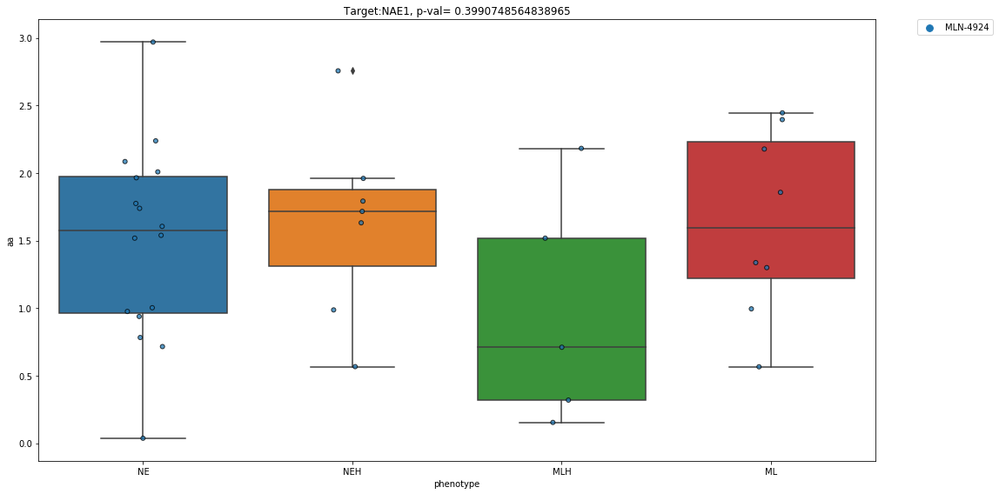

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    AP0-866  3.059925       MLH     0.0       0.0       0.0
CORL47     AP0-866  3.350098        NE     0.0       0.0       0.0
CORL88     AP0-866  2.845362       MLH     0.0       0.0       0.0
DMS114     AP0-866  3.327312        ML     0.0       0.0       0.0
DMS273     AP0-866  2.387510       NEH     0.0       0.0       0.0
DMS53      AP0-866  2.661706       MLH     0.0       0.0       0.0
DMS79      AP0-866  2.821343        NE     0.0       0.0       0.0
NCIH1048   AP0-866  3.624119        ML     0.0       0.0       0.0
NCIH1092   AP0-866  3.090431        NE     0.0       0.0       0.0
NCIH1105   AP0-866  2.818888        NE     0.0       0.0       0.0
NCIH1341   AP0-866  2.325604        ML     0.0       0.0       0.0
NCIH1436   AP0-866  3.456812        NE     0.0       0.0       0.0
NCIH146    AP0-866  3.016665        NE     0.0       0.0      

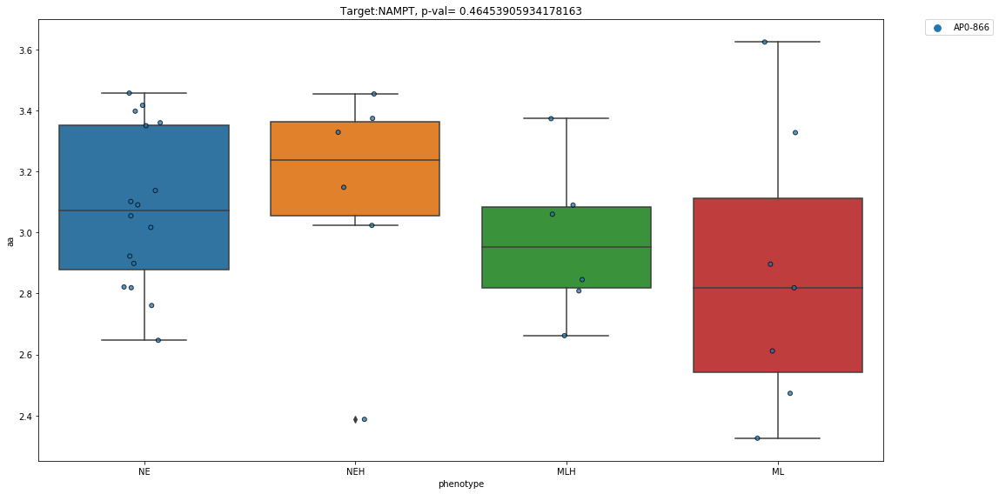

                drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                               
CORL47     LY-450139  6.873868e-02        NE     0.0       0.0       0.0
CORL88     LY-450139  6.530000e-12       MLH     0.0       0.0       0.0
DMS114     LY-450139  8.990000e-11        ML     0.0       0.0       0.0
DMS79      LY-450139  1.619300e-01        NE     0.0       0.0       0.0
NCIH1341   LY-450139  1.173339e-01        ML     0.0       0.0       0.0
NCIH1436   LY-450139  3.247221e-02        NE     0.0       0.0       0.0
NCIH146    LY-450139  3.361004e-02        NE     0.0       0.0       0.0
NCIH196    LY-450139  3.320957e-03        ML     0.0       0.0       0.0
NCIH2081   LY-450139  3.914979e-03        NE     0.0       0.0       0.0
NCIH211    LY-450139  2.567990e-02        ML     0.0       0.0       0.0
NCIH2171   LY-450139  8.750000e-15       NEH     0.0       0.0       0.0
NCIH446    LY-450139  1.071833e-01       NEH     0.

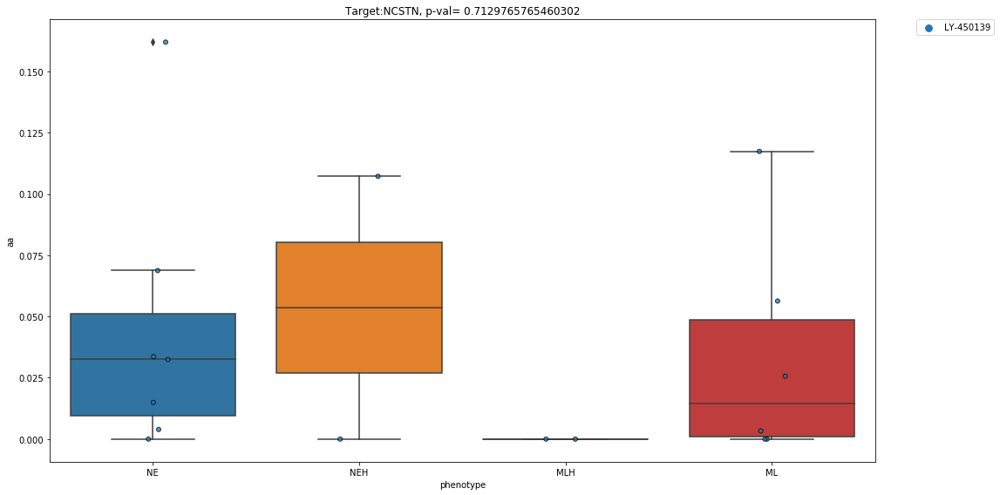

                                            drug            aa phenotype  \
cell.line                                                                  
CORL47     Peptide [CRGDKGPDC - cys & cys bridge  1.410000e-09        NE   
DMS53      Peptide [CRGDKGPDC - cys & cys bridge  3.601185e-02       MLH   
DMS79      Peptide [CRGDKGPDC - cys & cys bridge  1.130000e-09        NE   
NCIH1105   Peptide [CRGDKGPDC - cys & cys bridge  1.370000e-19        NE   
NCIH1876   Peptide [CRGDKGPDC - cys & cys bridge  0.000000e+00        NE   
NCIH1930   Peptide [CRGDKGPDC - cys & cys bridge  6.220000e-22        NE   
NCIH196    Peptide [CRGDKGPDC - cys & cys bridge  6.070000e-12        ML   
NCIH209    Peptide [CRGDKGPDC - cys & cys bridge  7.444330e-04        NE   
NCIH446    Peptide [CRGDKGPDC - cys & cys bridge  1.226224e-01       NEH   
NCIH524    Peptide [CRGDKGPDC - cys & cys bridge  3.160000e-11       NEH   
NCIH526    Peptide [CRGDKGPDC - cys & cys bridge  3.760000e-13       NEH   
NCIH69     P

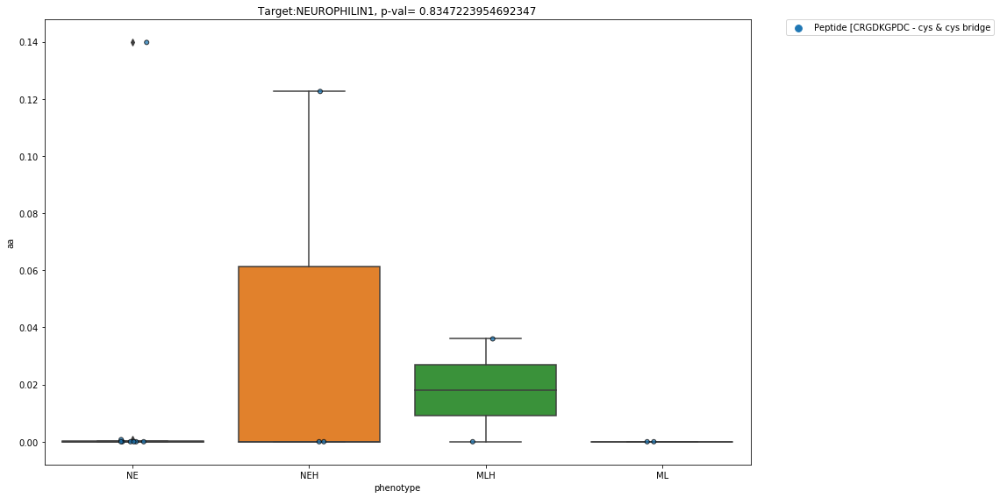

                       drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                  
COLO668    Arsenic Trioxide  0.000000       MLH     0.0       0.0       0.0
CORL47     Arsenic Trioxide  0.000000        NE     0.0       0.0       0.0
CORL88     Arsenic Trioxide  0.000000       MLH     0.0       0.0       0.0
DMS114     Arsenic Trioxide  0.000000        ML     0.0       0.0       0.0
DMS273     Arsenic Trioxide  0.000000       NEH     0.0       0.0       0.0
...                     ...       ...       ...     ...       ...       ...
NCIH82              EB-1627  3.313103       NEH     0.0       0.0       0.0
NCIH841             EB-1627  3.093398        ML     0.0       0.0       0.0
NCIH889             EB-1627  2.968834        NE     0.0       0.0       0.0
SHP77               EB-1627  3.034580       MLH     0.0       0.0       0.0
SW1271              EB-1627  2.881539        ML     0.0       0.0       0.0

[72 rows x 

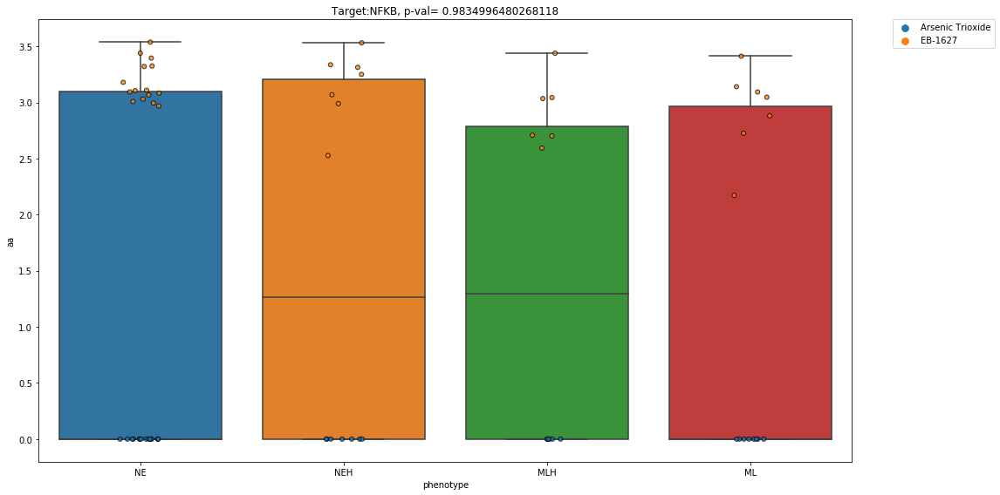

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                 drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                       
COLO668    Tacrolimus  0.0       MLH     0.0       0.0       0.0
CORL47     Tacrolimus  0.0        NE     0.0       0.0       0.0
CORL88     Tacrolimus  0.0       MLH     0.0       0.0       0.0
DMS114     Tacrolimus  0.0        ML     0.0       0.0       0.0
DMS273     Tacrolimus  0.0       NEH     0.0       0.0       0.0
DMS53      Tacrolimus  0.0       MLH     0.0       0.0       0.0
DMS79      Tacrolimus  0.0        NE     0.0       0.0       0.0
NCIH1048   Tacrolimus  0.0        ML     0.0       0.0       0.0
NCIH1092   Tacrolimus  0.0        NE     0.0       0.0       0.0
NCIH1105   Tacrolimus  0.0        NE     0.0       0.0       0.0
NCIH1341   Tacrolimus  0.0        ML     0.0       0.0       0.0
NCIH1436   Tacrolimus  0.0        NE     0.0       0.0       0.0
NCIH146    Tacrolimus  0.0        NE     0.0       0.0       0.0
NCIH1618   Tacrolimus  0.

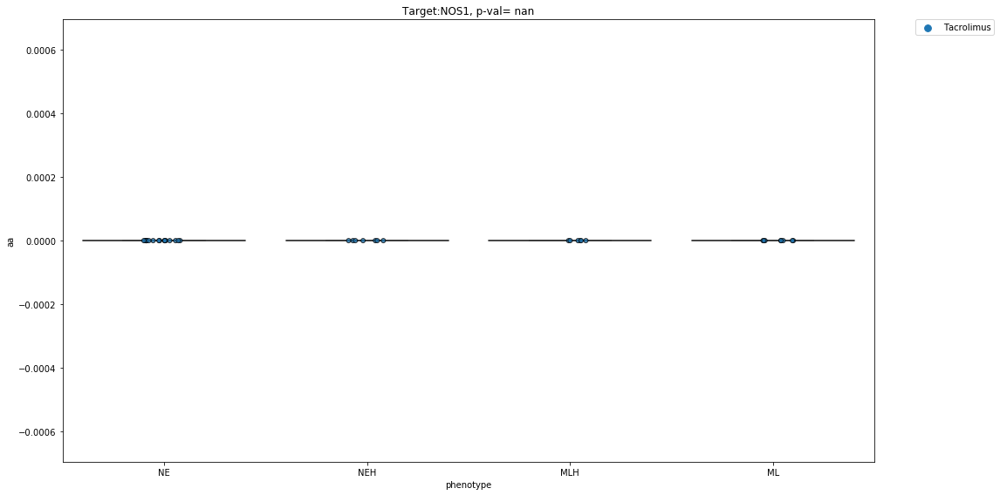

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                 drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                       
COLO668    Cladribine  0.0       MLH     0.0       0.0       0.0
CORL47     Cladribine  0.0        NE     0.0       0.0       0.0
CORL88     Cladribine  0.0       MLH     0.0       0.0       0.0
DMS114     Cladribine  0.0        ML     0.0       0.0       0.0
DMS273     Cladribine  0.0       NEH     0.0       0.0       0.0
DMS53      Cladribine  0.0       MLH     0.0       0.0       0.0
DMS79      Cladribine  0.0        NE     0.0       0.0       0.0
NCIH1048   Cladribine  0.0        ML     0.0       0.0       0.0
NCIH1092   Cladribine  0.0        NE     0.0       0.0       0.0
NCIH1105   Cladribine  0.0        NE     0.0       0.0       0.0
NCIH1341   Cladribine  0.0        ML     0.0       0.0       0.0
NCIH1436   Cladribine  0.0        NE     0.0       0.0       0.0
NCIH146    Cladribine  0.0        NE     0.0       0.0       0.0
NCIH1618   Cladribine  0.

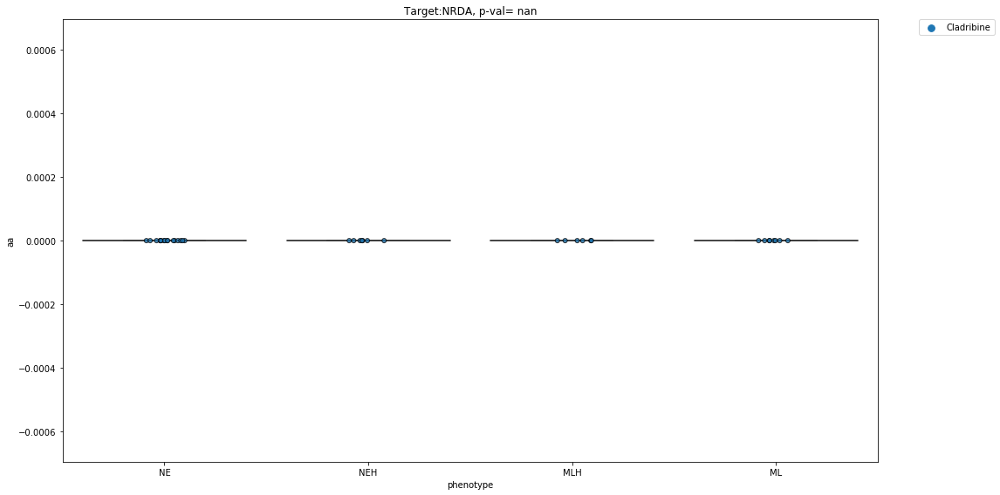

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    CEP-701  1.438986       MLH     0.0       0.0       0.0
CORL47     CEP-701  1.120566        NE     0.0       0.0       0.0
CORL88     CEP-701  0.465277       MLH     0.0       0.0       0.0
DMS114     CEP-701  1.926269        ML     0.0       0.0       0.0
DMS273     CEP-701  1.137915       NEH     0.0       0.0       0.0
DMS53      CEP-701  1.006759       MLH     0.0       0.0       0.0
DMS79      CEP-701  0.479671        NE     0.0       0.0       0.0
NCIH1048   CEP-701  2.214947        ML     0.0       0.0       0.0
NCIH1092   CEP-701  1.066130        NE     0.0       0.0       0.0
NCIH1105   CEP-701  1.617078        NE     0.0       0.0       0.0
NCIH1341   CEP-701  1.582435        ML     0.0       0.0       0.0
NCIH1436   CEP-701  1.321757        NE     0.0       0.0       0.0
NCIH146    CEP-701  1.849865        NE     0.0       0.0      

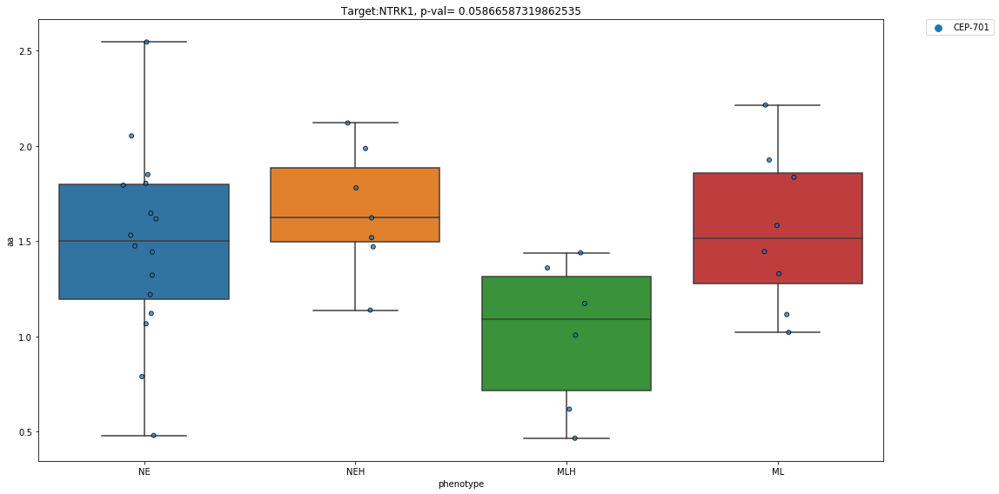

                  drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                 
CORL88     Arabinoside  2.440000e-16       MLH     0.0       0.0       0.0
DMS273     Arabinoside  5.657368e-02       NEH     0.0       0.0       0.0
DMS79      Arabinoside  3.533916e-02        NE     0.0       0.0       0.0
NCIH1341   Arabinoside  8.409669e-02        ML     0.0       0.0       0.0
NCIH1436   Arabinoside  8.057782e-02        NE     0.0       0.0       0.0
...                ...           ...       ...     ...       ...       ...
NCIH82     Thioguanine  0.000000e+00       NEH     0.0       0.0       0.0
NCIH841    Thioguanine  0.000000e+00        ML     0.0       0.0       0.0
NCIH889    Thioguanine  0.000000e+00        NE     0.0       0.0       0.0
SHP77      Thioguanine  0.000000e+00       MLH     0.0       0.0       0.0
SW1271     Thioguanine  0.000000e+00        ML     0.0       0.0       0.0

[385 rows x 6 columns]
N

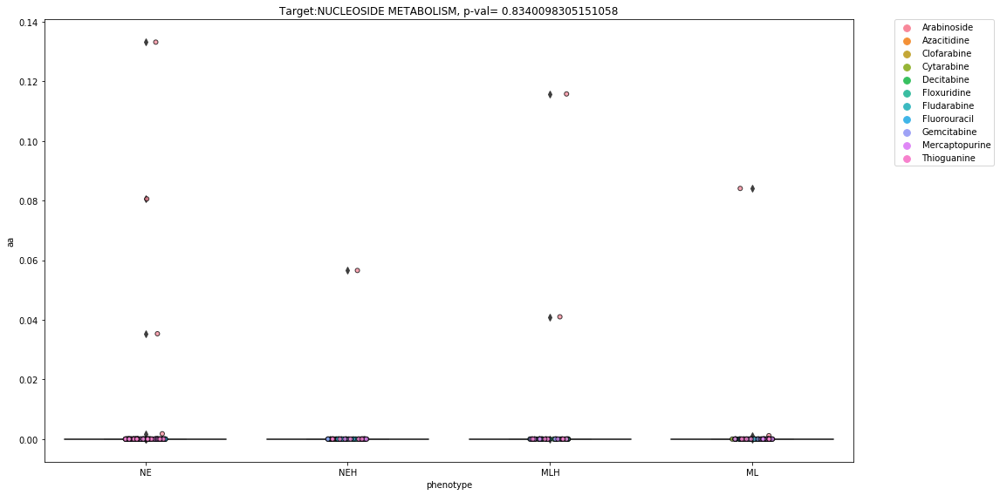

            drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                           
CORL47     O6-BG  5.736736e-02        NE     0.0       0.0       0.0
DMS79      O6-BG  1.347931e-01        NE     0.0       0.0       0.0
NCIH1105   O6-BG  6.211068e-02        NE     0.0       0.0       0.0
NCIH1436   O6-BG  2.008808e-01        NE     0.0       0.0       0.0
NCIH1618   O6-BG  7.878370e-02        NE     0.0       0.0       0.0
NCIH1836   O6-BG  1.219566e-01        NE     0.0       0.0       0.0
NCIH1876   O6-BG  6.887501e-03        NE     0.0       0.0       0.0
NCIH1930   O6-BG  2.204901e-03        NE     0.0       0.0       0.0
NCIH196    O6-BG  9.500000e-05        ML     0.0       0.0       0.0
NCIH1963   O6-BG  1.393357e-01        NE     0.0       0.0       0.0
NCIH2081   O6-BG  1.557147e-01        NE     0.0       0.0       0.0
NCIH510    O6-BG  2.149698e-02       MLH     0.0       0.0       0.0
NCIH524    O6-BG  8.624910e-04    

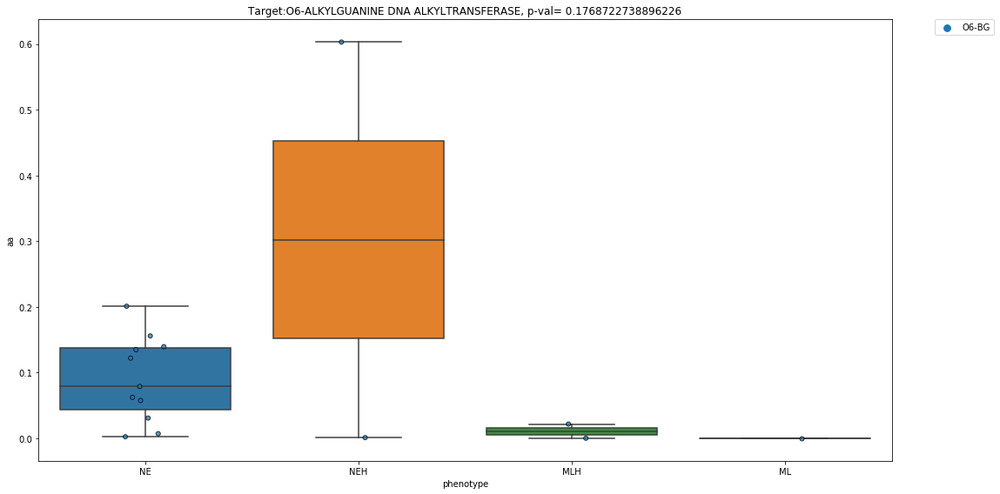

                 drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                            
COLO668    LY-2228820  0.172328       MLH     0.0       0.0       0.0
CORL88     LY-2228820  0.069555       MLH     0.0       0.0       0.0
DMS273     LY-2228820  0.002627       NEH     0.0       0.0       0.0
DMS53      LY-2228820  0.554315       MLH     0.0       0.0       0.0
DMS79      LY-2228820  0.060198        NE     0.0       0.0       0.0
...               ...       ...       ...     ...       ...       ...
NCIH526     SB-239063  0.005869       NEH     0.0       0.0       0.0
NCIH82      SB-239063  0.055094       NEH     0.0       0.0       0.0
NCIH841     SB-239063  0.010646        ML     0.0       0.0       0.0
NCIH889     SB-239063  0.375267        NE     0.0       0.0       0.0
SHP77       SB-239063  0.026816       MLH     0.0       0.0       0.0

[72 rows x 6 columns]
P38MAPK


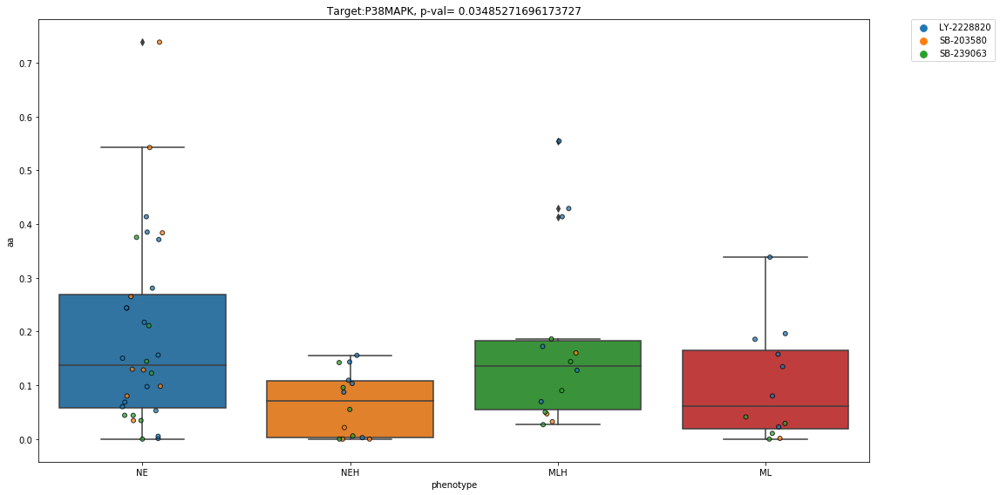

                                               drug        aa phenotype  \
cell.line                                                                 
COLO668    2nd Precursur Intermediate to TDP 665759  0.441268       MLH   
CORL47     2nd Precursur Intermediate to TDP 665759  0.358351        NE   
CORL88     2nd Precursur Intermediate to TDP 665759  0.268303       MLH   
DMS114     2nd Precursur Intermediate to TDP 665759  0.009196        ML   
DMS273     2nd Precursur Intermediate to TDP 665759  0.029955       NEH   
...                                             ...       ...       ...   
NCIH69                                      RG-7112  0.036923        NE   
NCIH82                                      RG-7112  0.048219       NEH   
NCIH841                                     RG-7112  0.108286        ML   
SHP77                                       RG-7112  0.006088       MLH   
SW1271                                      RG-7112  0.103337        ML   

           aa_new  hill_

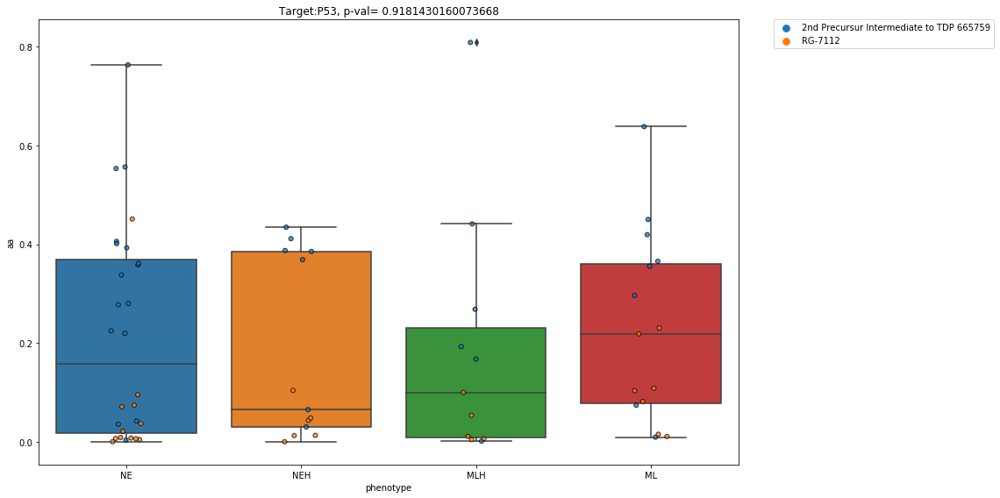

                  drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668        ABT-888  0.086034       MLH     0.0       0.0       0.0
CORL88         ABT-888  0.031814       MLH     0.0       0.0       0.0
DMS114         ABT-888  0.061497        ML     0.0       0.0       0.0
NCIH1048       ABT-888  0.185392        ML     0.0       0.0       0.0
NCIH1105       ABT-888  0.045331        NE     0.0       0.0       0.0
...                ...       ...       ...     ...       ...       ...
NCIH69     PF-01367338  0.383318        NE     0.0       0.0       0.0
NCIH82     PF-01367338  0.215560       NEH     0.0       0.0       0.0
NCIH841    PF-01367338  0.065235        ML     0.0       0.0       0.0
SHP77      PF-01367338  0.001179       MLH     0.0       0.0       0.0
SW1271     PF-01367338  0.045085        ML     0.0       0.0       0.0

[311 rows x 6 columns]
PARP


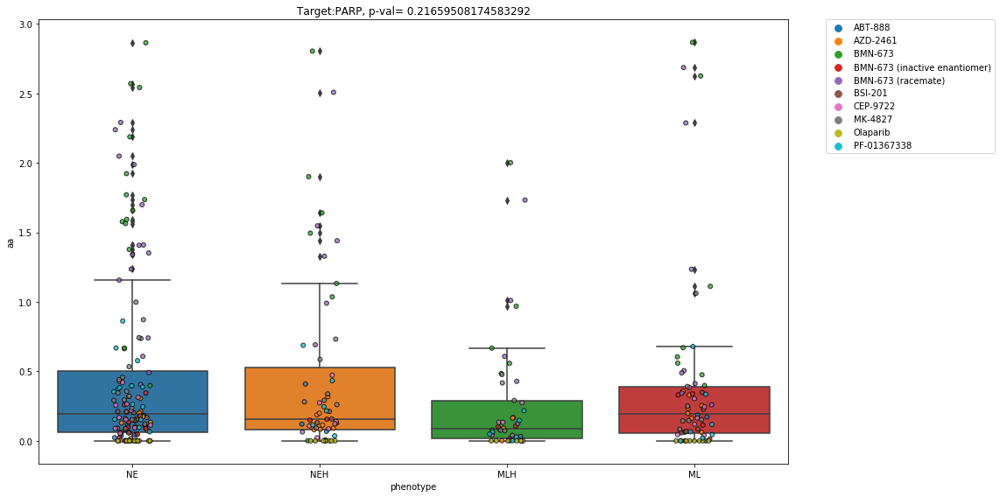

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                 drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                       
COLO668    Sildenafil  0.0       MLH     0.0       0.0       0.0
CORL47     Sildenafil  0.0        NE     0.0       0.0       0.0
CORL88     Sildenafil  0.0       MLH     0.0       0.0       0.0
DMS114     Sildenafil  0.0        ML     0.0       0.0       0.0
DMS273     Sildenafil  0.0       NEH     0.0       0.0       0.0
DMS53      Sildenafil  0.0       MLH     0.0       0.0       0.0
DMS79      Sildenafil  0.0        NE     0.0       0.0       0.0
NCIH1048   Sildenafil  0.0        ML     0.0       0.0       0.0
NCIH1092   Sildenafil  0.0        NE     0.0       0.0       0.0
NCIH1105   Sildenafil  0.0        NE     0.0       0.0       0.0
NCIH1341   Sildenafil  0.0        ML     0.0       0.0       0.0
NCIH1436   Sildenafil  0.0        NE     0.0       0.0       0.0
NCIH146    Sildenafil  0.0        NE     0.0       0.0       0.0
NCIH1618   Sildenafil  0.

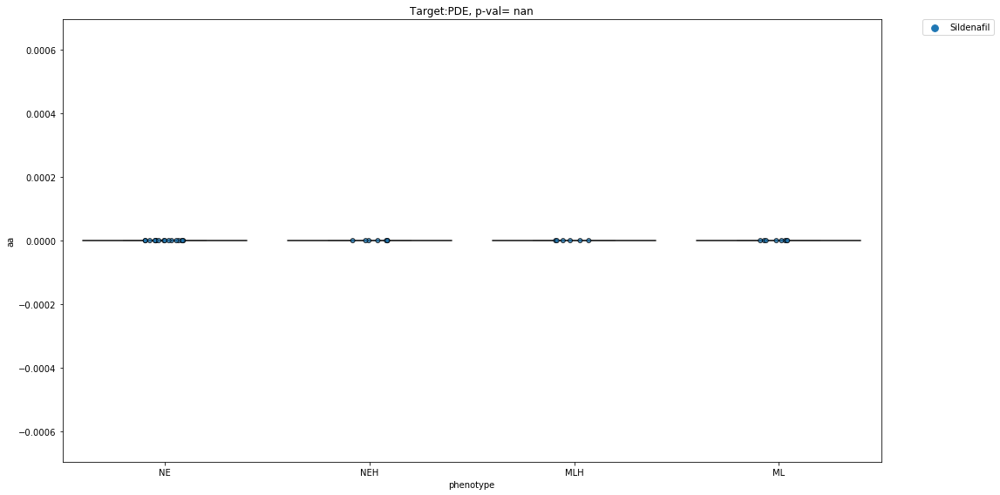

                drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                           
COLO668      ABT-348  0.922358       MLH     0.0       0.0       0.0
CORL47       ABT-348  2.218881        NE     0.0       0.0       0.0
CORL88       ABT-348  0.278810       MLH     0.0       0.0       0.0
DMS114       ABT-348  1.366754        ML     0.0       0.0       0.0
DMS273       ABT-348  1.115654       NEH     0.0       0.0       0.0
...              ...       ...       ...     ...       ...       ...
NCIH82     Sunitinib  0.000000       NEH     0.0       0.0       0.0
NCIH841    Sunitinib  0.000000        ML     0.0       0.0       0.0
NCIH889    Sunitinib  0.000000        NE     0.0       0.0       0.0
SHP77      Sunitinib  0.000000       MLH     0.0       0.0       0.0
SW1271     Sunitinib  0.000000        ML     0.0       0.0       0.0

[661 rows x 6 columns]
PDGFR


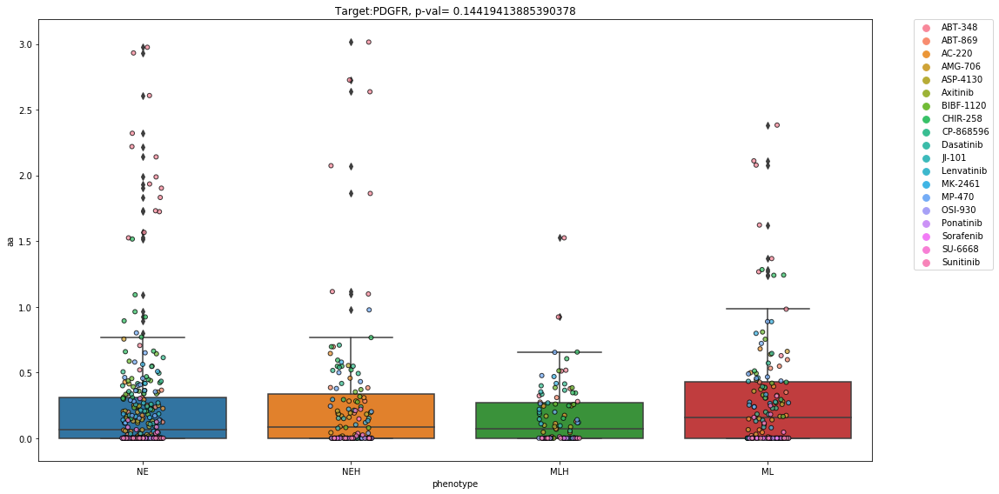

              drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
CORL88     CPI-613  3.256900e-01       MLH     0.0       0.0       0.0
DMS114     CPI-613  1.468653e-01        ML     0.0       0.0       0.0
DMS53      CPI-613  2.452566e-01       MLH     0.0       0.0       0.0
DMS79      CPI-613  2.012999e-01        NE     0.0       0.0       0.0
NCIH1092   CPI-613  1.844741e-01        NE     0.0       0.0       0.0
NCIH1618   CPI-613  3.858009e-02        NE     0.0       0.0       0.0
NCIH1694   CPI-613  1.219423e-01       NEH     0.0       0.0       0.0
NCIH1836   CPI-613  6.114874e-02        NE     0.0       0.0       0.0
NCIH1876   CPI-613  1.066023e-01        NE     0.0       0.0       0.0
NCIH2066   CPI-613  1.400267e-01        ML     0.0       0.0       0.0
NCIH2081   CPI-613  2.806321e-01        NE     0.0       0.0       0.0
NCIH510    CPI-613  6.114874e-02       MLH     0.0       0.0       0.0
NCIH69

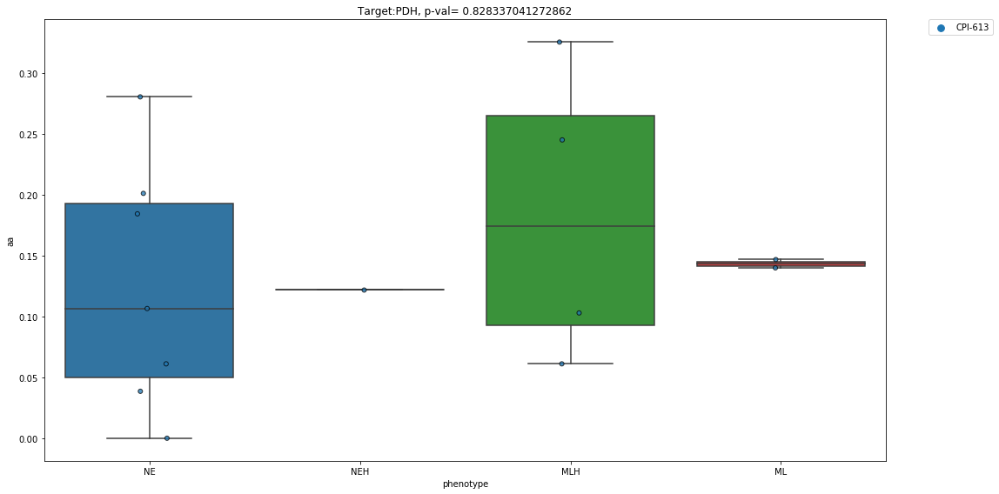

                 drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                            
COLO668        BX-912  0.352050       MLH     0.0       0.0       0.0
CORL47         BX-912  0.533106        NE     0.0       0.0       0.0
CORL88         BX-912  0.062848       MLH     0.0       0.0       0.0
DMS114         BX-912  0.748328        ML     0.0       0.0       0.0
DMS273         BX-912  0.335193       NEH     0.0       0.0       0.0
...               ...       ...       ...     ...       ...       ...
NCIH82     OSU-03012   0.000000       NEH     0.0       0.0       0.0
NCIH841    OSU-03012   0.000000        ML     0.0       0.0       0.0
NCIH889    OSU-03012   0.000000        NE     0.0       0.0       0.0
SHP77      OSU-03012   0.000000       MLH     0.0       0.0       0.0
SW1271     OSU-03012   0.000000        ML     0.0       0.0       0.0

[111 rows x 6 columns]
PDK1


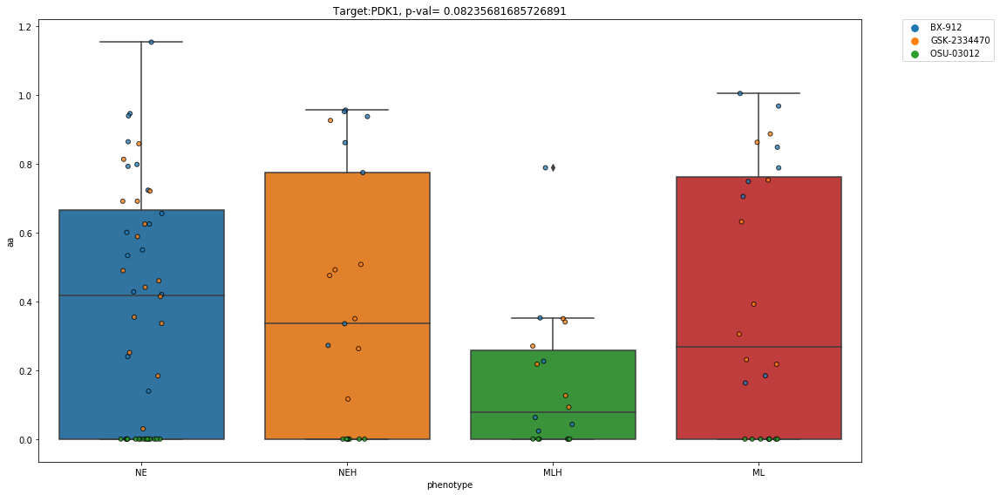

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668    LNS-5662  0.023560       MLH     0.0       0.0       0.0
CORL47     LNS-5662  0.001070        NE     0.0       0.0       0.0
DMS114     LNS-5662  0.114844        ML     0.0       0.0       0.0
DMS273     LNS-5662  0.054458       NEH     0.0       0.0       0.0
DMS53      LNS-5662  0.091105       MLH     0.0       0.0       0.0
DMS79      LNS-5662  0.012225        NE     0.0       0.0       0.0
NCIH1048   LNS-5662  0.118319        ML     0.0       0.0       0.0
NCIH1092   LNS-5662  0.001203        NE     0.0       0.0       0.0
NCIH1105   LNS-5662  0.105626        NE     0.0       0.0       0.0
NCIH1341   LNS-5662  0.137434        ML     0.0       0.0       0.0
NCIH1436   LNS-5662  0.248979        NE     0.0       0.0       0.0
NCIH146    LNS-5662  0.009791        NE     0.0       0.0       0.0
NCIH1694   LNS-5662  0.156835       NEH     0.0 

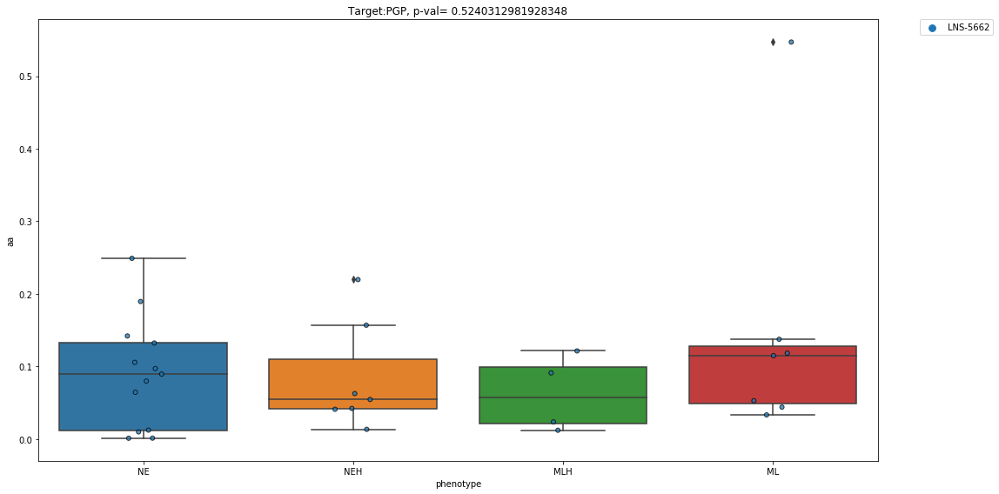

                   drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
COLO668    BAY-80-6946   0.000000       MLH     0.0       0.0       0.0
CORL47     BAY-80-6946   0.000000        NE     0.0       0.0       0.0
CORL88     BAY-80-6946   0.000000       MLH     0.0       0.0       0.0
DMS114     BAY-80-6946   0.000000        ML     0.0       0.0       0.0
DMS273     BAY-80-6946   0.000000       NEH     0.0       0.0       0.0
...                 ...       ...       ...     ...       ...       ...
NCIH82         ZSTK-474  0.924028       NEH     0.0       0.0       0.0
NCIH841        ZSTK-474  0.926325        ML     0.0       0.0       0.0
NCIH889        ZSTK-474  0.391694        NE     0.0       0.0       0.0
SHP77          ZSTK-474  0.245399       MLH     0.0       0.0       0.0
SW1271         ZSTK-474  1.028074        ML     0.0       0.0       0.0

[769 rows x 6 columns]
PI3K


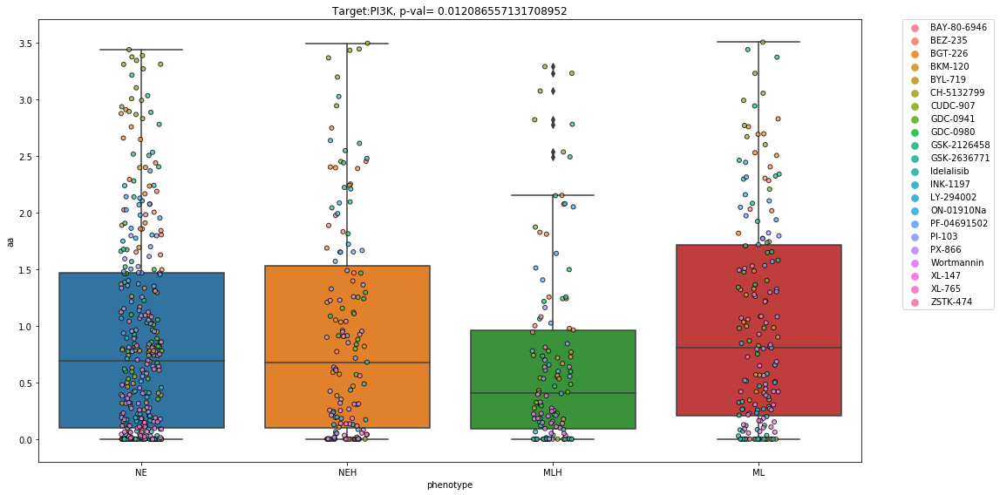

              drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668    BYL-719  5.402888e-01       MLH     0.0       0.0       0.0
CORL47     BYL-719  9.713691e-02        NE     0.0       0.0       0.0
CORL88     BYL-719  1.760442e-01       MLH     0.0       0.0       0.0
DMS114     BYL-719  4.190999e-01        ML     0.0       0.0       0.0
DMS273     BYL-719  1.056593e-01       NEH     0.0       0.0       0.0
DMS53      BYL-719  3.201871e-01       MLH     0.0       0.0       0.0
DMS79      BYL-719  1.579323e-01        NE     0.0       0.0       0.0
NCIH1048   BYL-719  1.275023e+00        ML     0.0       0.0       0.0
NCIH1092   BYL-719  3.172262e-01        NE     0.0       0.0       0.0
NCIH1105   BYL-719  5.527515e-01        NE     0.0       0.0       0.0
NCIH1341   BYL-719  1.083189e+00        ML     0.0       0.0       0.0
NCIH1436   BYL-719  2.587963e-01        NE     0.0       0.0       0.0
NCIH14

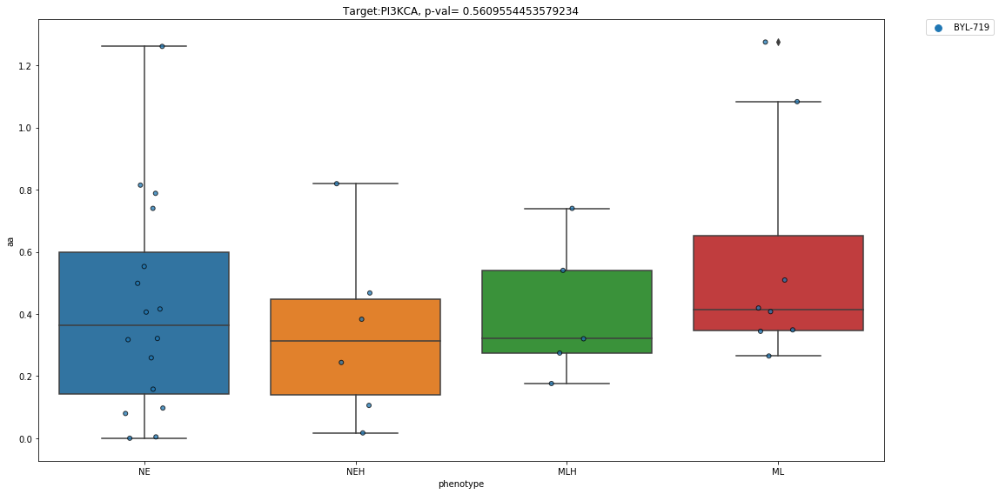

                  drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                 
DMS114     GSK-2636771  3.216577e-02        ML     0.0       0.0       0.0
DMS273     GSK-2636771  3.053749e-01       NEH     0.0       0.0       0.0
DMS53      GSK-2636771  1.226668e-02       MLH     0.0       0.0       0.0
NCIH1048   GSK-2636771  2.680564e-02        ML     0.0       0.0       0.0
NCIH1436   GSK-2636771  4.387542e-02        NE     0.0       0.0       0.0
NCIH1618   GSK-2636771  4.907117e-03        NE     0.0       0.0       0.0
NCIH1694   GSK-2636771  4.440000e-08       NEH     0.0       0.0       0.0
NCIH1876   GSK-2636771  6.714532e-02        NE     0.0       0.0       0.0
NCIH1930   GSK-2636771  1.719167e-01        NE     0.0       0.0       0.0
NCIH196    GSK-2636771  3.235190e-01        ML     0.0       0.0       0.0
NCIH2081   GSK-2636771  4.152200e-02        NE     0.0       0.0       0.0
NCIH446    GSK-2636771  1

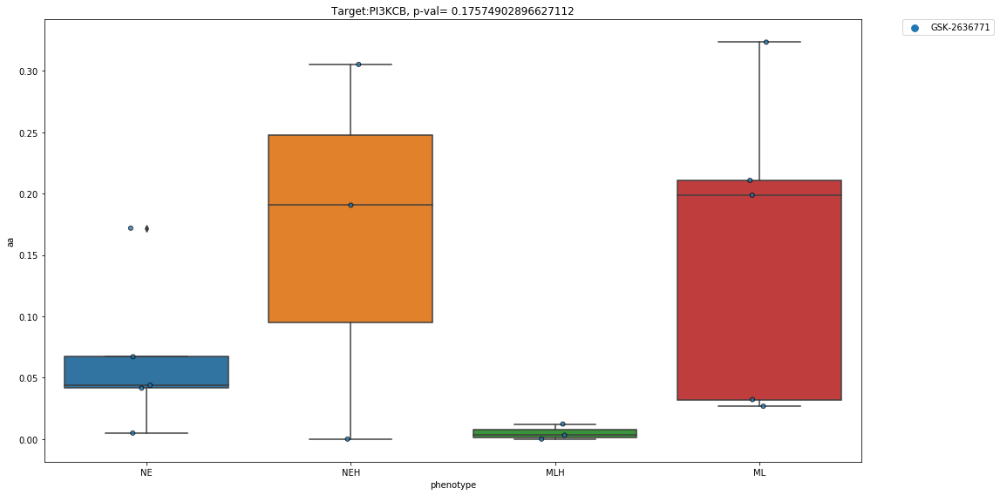

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    BEZ-235  1.240753       MLH     0.0       0.0       0.0
CORL47     BEZ-235  0.787132        NE     0.0       0.0       0.0
CORL88     BEZ-235  0.667173       MLH     0.0       0.0       0.0
DMS114     BEZ-235  2.405626        ML     0.0       0.0       0.0
DMS273     BEZ-235  1.467963       NEH     0.0       0.0       0.0
...            ...       ...       ...     ...       ...       ...
NCIH82      PI-103  0.952974       NEH     0.0       0.0       0.0
NCIH841     PI-103  1.302472        ML     0.0       0.0       0.0
NCIH889     PI-103  0.951598        NE     0.0       0.0       0.0
SHP77       PI-103  0.553930       MLH     0.0       0.0       0.0
SW1271      PI-103  1.771264        ML     0.0       0.0       0.0

[111 rows x 6 columns]
PIK3CA


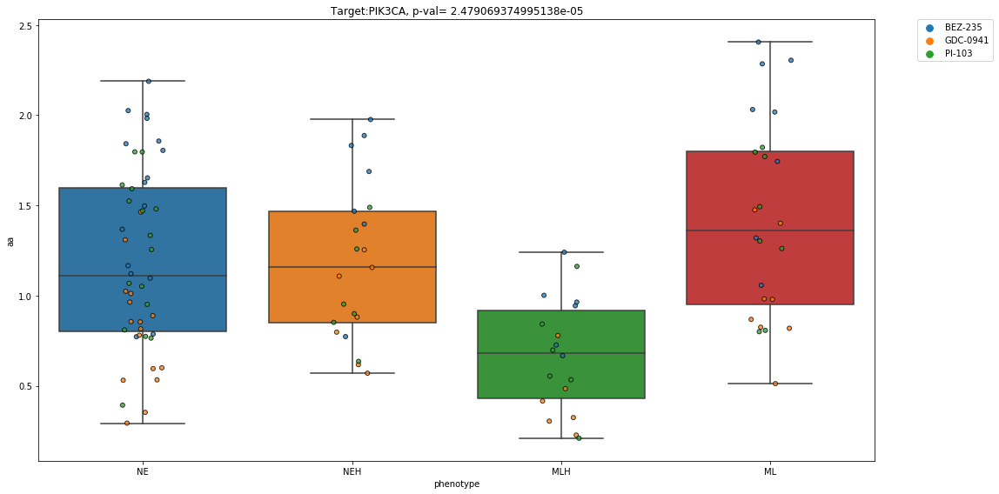

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668     BEZ-235  1.240753       MLH     0.0       0.0       0.0
CORL47      BEZ-235  0.787132        NE     0.0       0.0       0.0
CORL88      BEZ-235  0.667173       MLH     0.0       0.0       0.0
DMS114      BEZ-235  2.405626        ML     0.0       0.0       0.0
DMS273      BEZ-235  1.467963       NEH     0.0       0.0       0.0
...             ...       ...       ...     ...       ...       ...
NCIH82     ZSTK-474  0.924028       NEH     0.0       0.0       0.0
NCIH841    ZSTK-474  0.926325        ML     0.0       0.0       0.0
NCIH889    ZSTK-474  0.391694        NE     0.0       0.0       0.0
SHP77      ZSTK-474  0.245399       MLH     0.0       0.0       0.0
SW1271     ZSTK-474  1.028074        ML     0.0       0.0       0.0

[148 rows x 6 columns]
PIK3CB


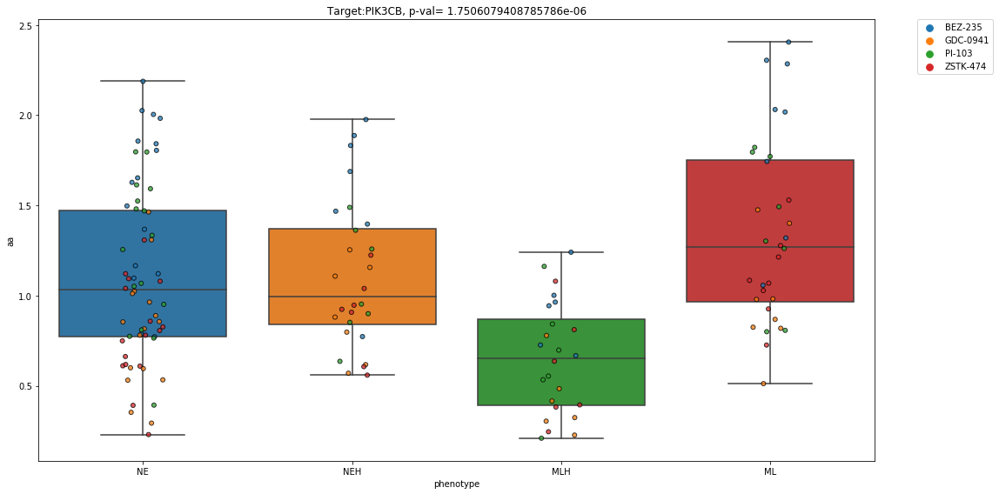

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668     BEZ-235  1.240753       MLH     0.0       0.0       0.0
CORL47      BEZ-235  0.787132        NE     0.0       0.0       0.0
CORL88      BEZ-235  0.667173       MLH     0.0       0.0       0.0
DMS114      BEZ-235  2.405626        ML     0.0       0.0       0.0
DMS273      BEZ-235  1.467963       NEH     0.0       0.0       0.0
...             ...       ...       ...     ...       ...       ...
NCIH82     ZSTK-474  0.924028       NEH     0.0       0.0       0.0
NCIH841    ZSTK-474  0.926325        ML     0.0       0.0       0.0
NCIH889    ZSTK-474  0.391694        NE     0.0       0.0       0.0
SHP77      ZSTK-474  0.245399       MLH     0.0       0.0       0.0
SW1271     ZSTK-474  1.028074        ML     0.0       0.0       0.0

[148 rows x 6 columns]
PIK3CD


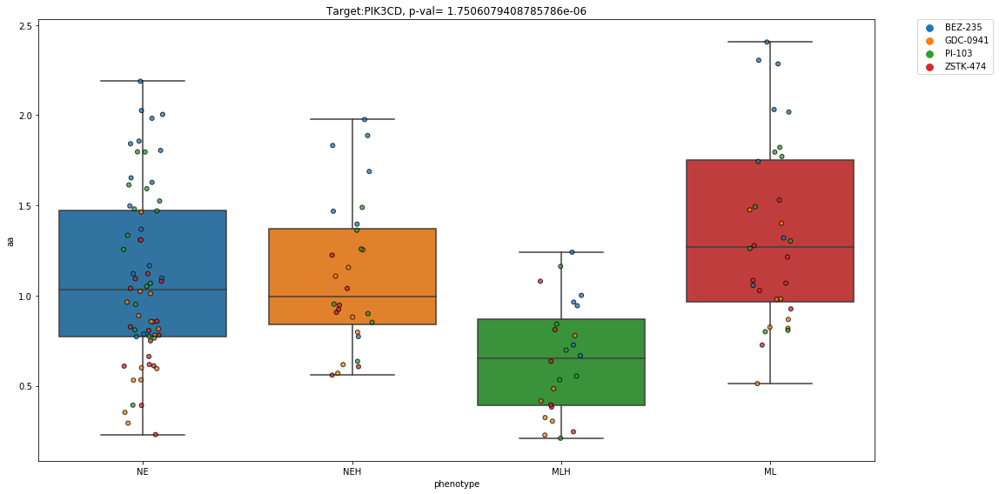

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668     BEZ-235  1.240753       MLH     0.0       0.0       0.0
CORL47      BEZ-235  0.787132        NE     0.0       0.0       0.0
CORL88      BEZ-235  0.667173       MLH     0.0       0.0       0.0
DMS114      BEZ-235  2.405626        ML     0.0       0.0       0.0
DMS273      BEZ-235  1.467963       NEH     0.0       0.0       0.0
...             ...       ...       ...     ...       ...       ...
NCIH82     ZSTK-474  0.924028       NEH     0.0       0.0       0.0
NCIH841    ZSTK-474  0.926325        ML     0.0       0.0       0.0
NCIH889    ZSTK-474  0.391694        NE     0.0       0.0       0.0
SHP77      ZSTK-474  0.245399       MLH     0.0       0.0       0.0
SW1271     ZSTK-474  1.028074        ML     0.0       0.0       0.0

[148 rows x 6 columns]
PIK3CG


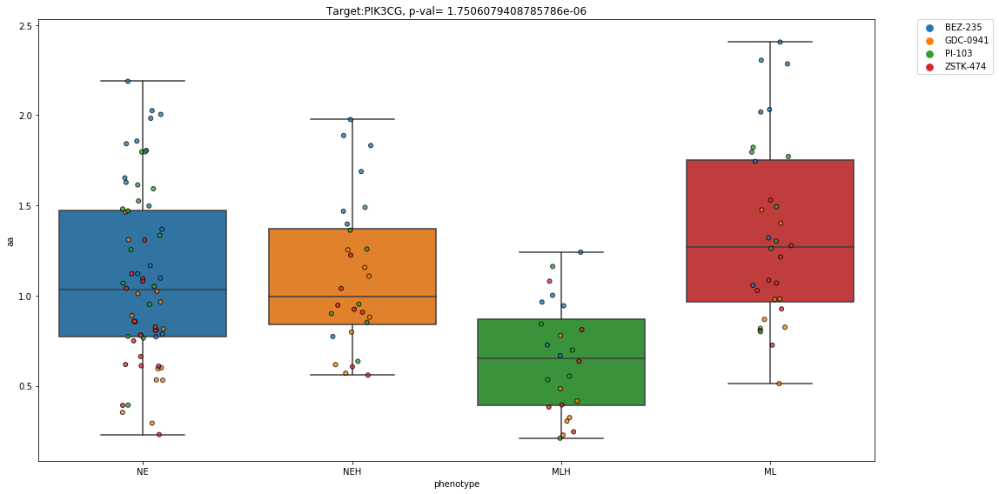

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668    SGI-1776  0.325057       MLH     0.0       0.0       0.0
CORL47     SGI-1776  0.114730        NE     0.0       0.0       0.0
CORL88     SGI-1776  0.287729       MLH     0.0       0.0       0.0
DMS114     SGI-1776  0.396472        ML     0.0       0.0       0.0
DMS273     SGI-1776  0.340327       NEH     0.0       0.0       0.0
DMS53      SGI-1776  0.220085       MLH     0.0       0.0       0.0
DMS79      SGI-1776  0.482686        NE     0.0       0.0       0.0
NCIH1048   SGI-1776  0.266839        ML     0.0       0.0       0.0
NCIH1092   SGI-1776  0.194928        NE     0.0       0.0       0.0
NCIH1105   SGI-1776  0.407995        NE     0.0       0.0       0.0
NCIH1341   SGI-1776  0.344126        ML     0.0       0.0       0.0
NCIH1436   SGI-1776  0.068085        NE     0.0       0.0       0.0
NCIH146    SGI-1776  0.715041        NE     0.0 

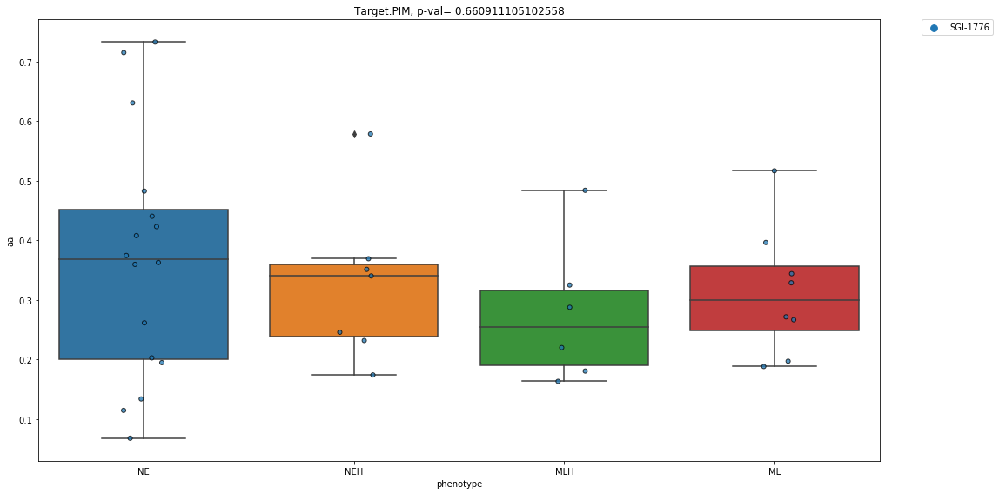

              drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668    SL-0101  1.370000e-10       MLH     0.0       0.0       0.0
CORL47     SL-0101  6.530000e-11        NE     0.0       0.0       0.0
NCIH1092   SL-0101  0.000000e+00        NE     0.0       0.0       0.0
NCIH1618   SL-0101  1.145783e-02        NE     0.0       0.0       0.0
NCIH1694   SL-0101  5.510000e-10       NEH     0.0       0.0       0.0
NCIH1836   SL-0101  2.234409e-02        NE     0.0       0.0       0.0
NCIH211    SL-0101  4.652485e-03        ML     0.0       0.0       0.0
NCIH510    SL-0101  2.234409e-02       MLH     0.0       0.0       0.0
NCIH524    SL-0101  1.500000e-18       NEH     0.0       0.0       0.0
NCIH526    SL-0101  1.006169e-02       NEH     0.0       0.0       0.0
NCIH82     SL-0101  3.251376e-01       NEH     0.0       0.0       0.0
NCIH889    SL-0101  1.180189e-01        NE     0.0       0.0       0.0
PIM3


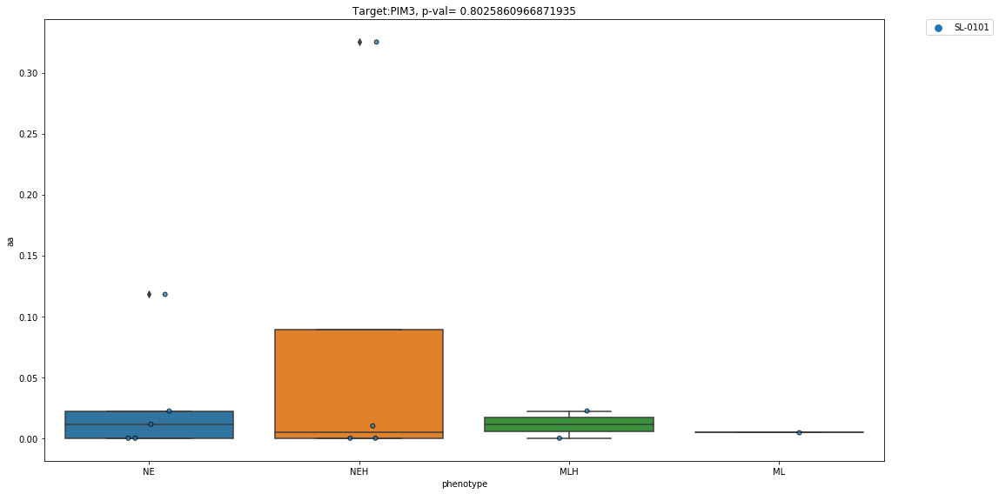

           drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                      
COLO668    H-89  0.069404       MLH     0.0       0.0       0.0
CORL47     H-89  0.004929        NE     0.0       0.0       0.0
CORL88     H-89  0.002052       MLH     0.0       0.0       0.0
DMS114     H-89  0.016039        ML     0.0       0.0       0.0
DMS273     H-89  0.004532       NEH     0.0       0.0       0.0
DMS53      H-89  0.092434       MLH     0.0       0.0       0.0
DMS79      H-89  0.006854        NE     0.0       0.0       0.0
NCIH1048   H-89  0.084825        ML     0.0       0.0       0.0
NCIH1105   H-89  0.088566        NE     0.0       0.0       0.0
NCIH1341   H-89  0.088486        ML     0.0       0.0       0.0
NCIH146    H-89  0.004108        NE     0.0       0.0       0.0
NCIH1618   H-89  0.016973        NE     0.0       0.0       0.0
NCIH1694   H-89  0.220864       NEH     0.0       0.0       0.0
NCIH1836   H-89  0.007603        NE     

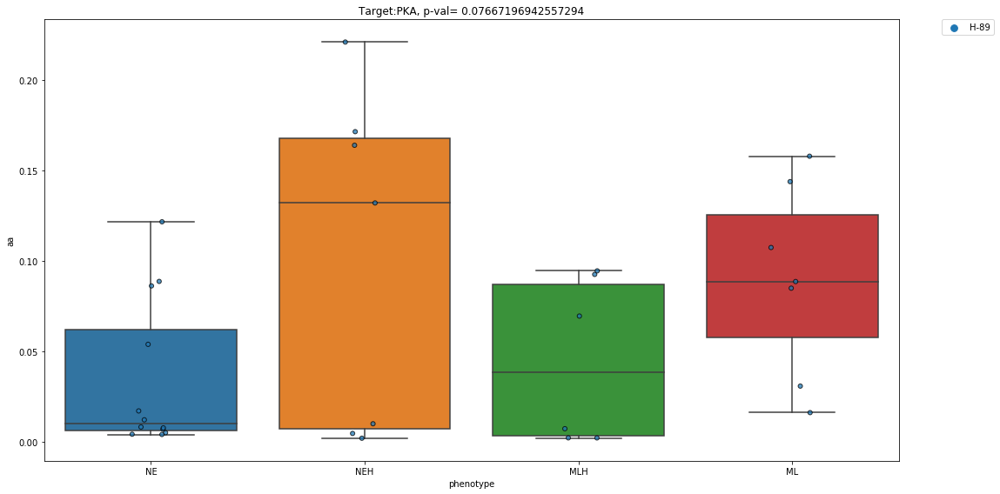

                drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                           
COLO668      AEB-071  0.001652       MLH     0.0       0.0       0.0
CORL47       AEB-071  0.039073        NE     0.0       0.0       0.0
DMS53        AEB-071  0.001956       MLH     0.0       0.0       0.0
DMS79        AEB-071  0.171744        NE     0.0       0.0       0.0
NCIH1048     AEB-071  0.254101        ML     0.0       0.0       0.0
...              ...       ...       ...     ...       ...       ...
NCIH82     LY-317615  0.141186       NEH     0.0       0.0       0.0
NCIH841    LY-317615  0.150438        ML     0.0       0.0       0.0
NCIH889    LY-317615  0.002387        NE     0.0       0.0       0.0
SHP77      LY-317615  0.004184       MLH     0.0       0.0       0.0
SW1271     LY-317615  0.123049        ML     0.0       0.0       0.0

[90 rows x 6 columns]
PKC


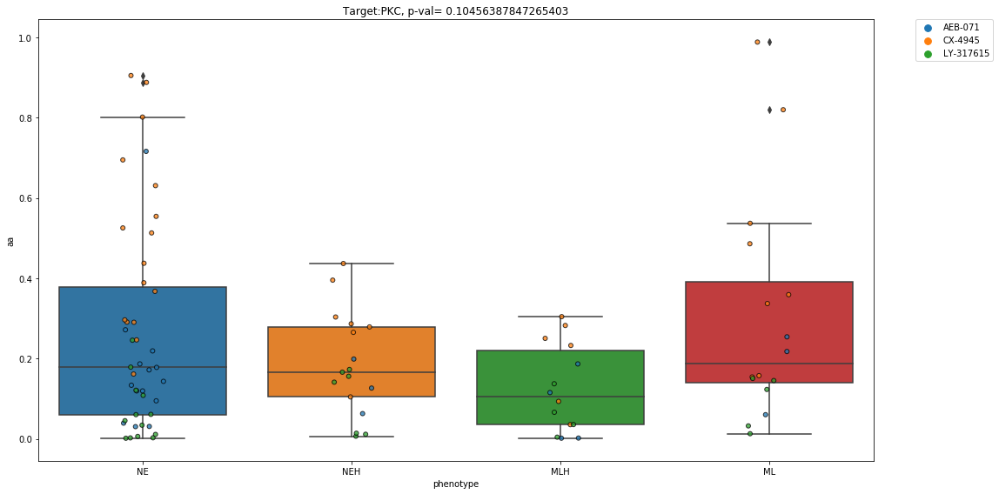

                drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                           
COLO668    Acrichine  0.434867       MLH     0.0       0.0       0.0
CORL47     Acrichine  0.317098        NE     0.0       0.0       0.0
CORL88     Acrichine  0.147763       MLH     0.0       0.0       0.0
DMS114     Acrichine  0.452847        ML     0.0       0.0       0.0
DMS273     Acrichine  0.150366       NEH     0.0       0.0       0.0
DMS53      Acrichine  0.245765       MLH     0.0       0.0       0.0
DMS79      Acrichine  0.237198        NE     0.0       0.0       0.0
NCIH1048   Acrichine  0.024655        ML     0.0       0.0       0.0
NCIH1092   Acrichine  0.239264        NE     0.0       0.0       0.0
NCIH1105   Acrichine  0.332050        NE     0.0       0.0       0.0
NCIH1341   Acrichine  0.004685        ML     0.0       0.0       0.0
NCIH1436   Acrichine  0.232488        NE     0.0       0.0       0.0
NCIH146    Acrichine  0.558636    

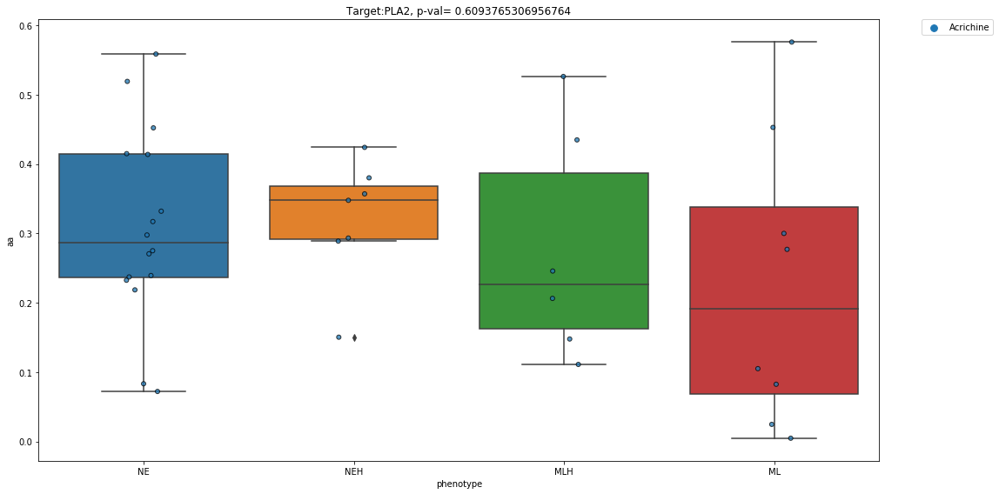

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668    MLN-0905  2.249775       MLH     0.0       0.0       0.0
CORL47     MLN-0905  1.520032        NE     0.0       0.0       0.0
DMS114     MLN-0905  2.904048        ML     0.0       0.0       0.0
DMS273     MLN-0905  2.505114       NEH     0.0       0.0       0.0
DMS53      MLN-0905  2.154350       MLH     0.0       0.0       0.0
DMS79      MLN-0905  0.761750        NE     0.0       0.0       0.0
NCIH1048   MLN-0905  3.160311        ML     0.0       0.0       0.0
NCIH1092   MLN-0905  0.806785        NE     0.0       0.0       0.0
NCIH1105   MLN-0905  2.751170        NE     0.0       0.0       0.0
NCIH1341   MLN-0905  1.900565        ML     0.0       0.0       0.0
NCIH1436   MLN-0905  2.051411        NE     0.0       0.0       0.0
NCIH146    MLN-0905  2.494620        NE     0.0       0.0       0.0
NCIH1618   MLN-0905  2.592447        NE     0.0 

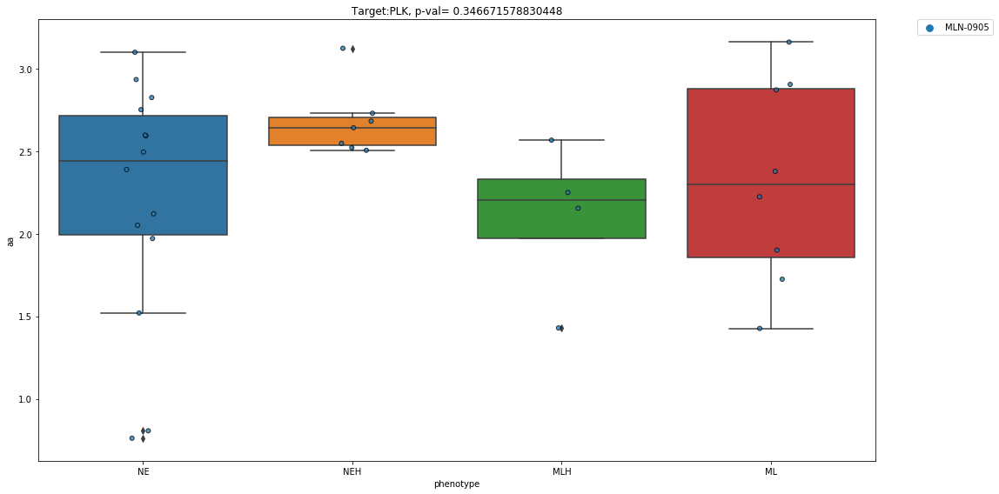

                     drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                
COLO668           BI-2536  2.573585       MLH     0.0       0.0       0.0
CORL47            BI-2536  2.022550        NE     0.0       0.0       0.0
CORL88            BI-2536  2.448784       MLH     0.0       0.0       0.0
DMS114            BI-2536  3.198405        ML     0.0       0.0       0.0
DMS273            BI-2536  2.582173       NEH     0.0       0.0       0.0
...                   ...       ...       ...     ...       ...       ...
NCIH82     TAK-960 analog  2.217425       NEH     0.0       0.0       0.0
NCIH841    TAK-960 analog  1.389419        ML     0.0       0.0       0.0
NCIH889    TAK-960 analog  2.057316        NE     0.0       0.0       0.0
SHP77      TAK-960 analog  1.779757       MLH     0.0       0.0       0.0
SW1271     TAK-960 analog  1.744548        ML     0.0       0.0       0.0

[246 rows x 6 columns]
PLK1


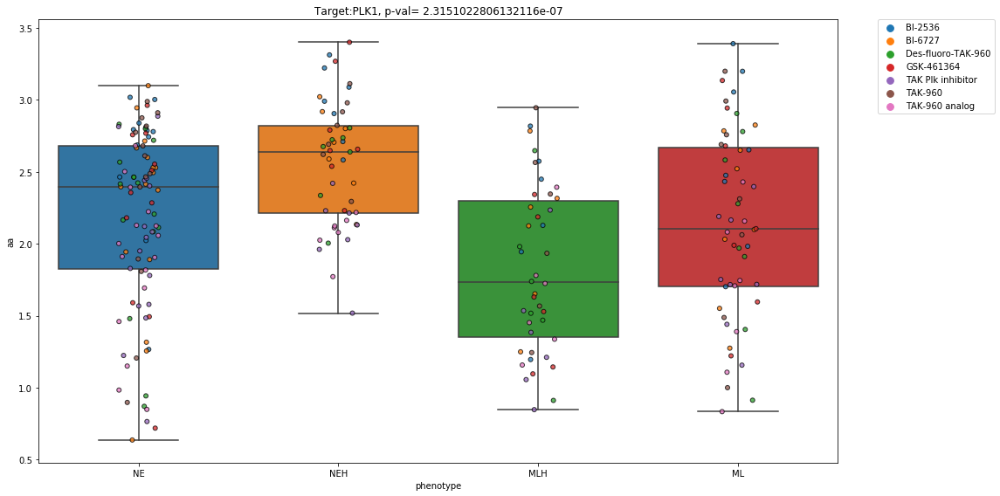

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    BI-2536  2.573585       MLH     0.0       0.0       0.0
CORL47     BI-2536  2.022550        NE     0.0       0.0       0.0
CORL88     BI-2536  2.448784       MLH     0.0       0.0       0.0
DMS114     BI-2536  3.198405        ML     0.0       0.0       0.0
DMS273     BI-2536  2.582173       NEH     0.0       0.0       0.0
DMS53      BI-2536  1.195506       MLH     0.0       0.0       0.0
DMS79      BI-2536  1.265880        NE     0.0       0.0       0.0
NCIH1048   BI-2536  3.054670        ML     0.0       0.0       0.0
NCIH1341   BI-2536  2.432691        ML     0.0       0.0       0.0
NCIH1436   BI-2536  2.463572        NE     0.0       0.0       0.0
NCIH146    BI-2536  3.017656        NE     0.0       0.0       0.0
NCIH1618   BI-2536  2.686390        NE     0.0       0.0       0.0
NCIH1694   BI-2536  2.904606       NEH     0.0       0.0      

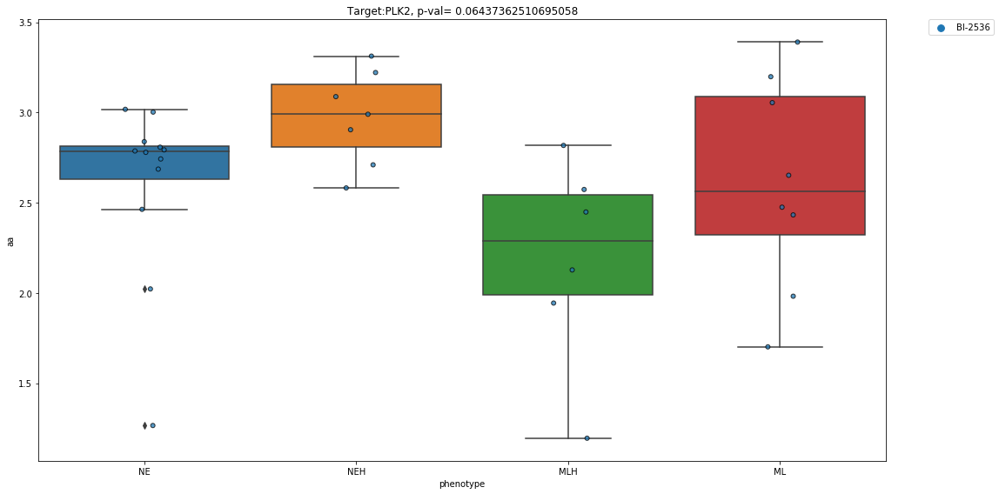

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    BI-2536  2.573585       MLH     0.0       0.0       0.0
CORL47     BI-2536  2.022550        NE     0.0       0.0       0.0
CORL88     BI-2536  2.448784       MLH     0.0       0.0       0.0
DMS114     BI-2536  3.198405        ML     0.0       0.0       0.0
DMS273     BI-2536  2.582173       NEH     0.0       0.0       0.0
DMS53      BI-2536  1.195506       MLH     0.0       0.0       0.0
DMS79      BI-2536  1.265880        NE     0.0       0.0       0.0
NCIH1048   BI-2536  3.054670        ML     0.0       0.0       0.0
NCIH1341   BI-2536  2.432691        ML     0.0       0.0       0.0
NCIH1436   BI-2536  2.463572        NE     0.0       0.0       0.0
NCIH146    BI-2536  3.017656        NE     0.0       0.0       0.0
NCIH1618   BI-2536  2.686390        NE     0.0       0.0       0.0
NCIH1694   BI-2536  2.904606       NEH     0.0       0.0      

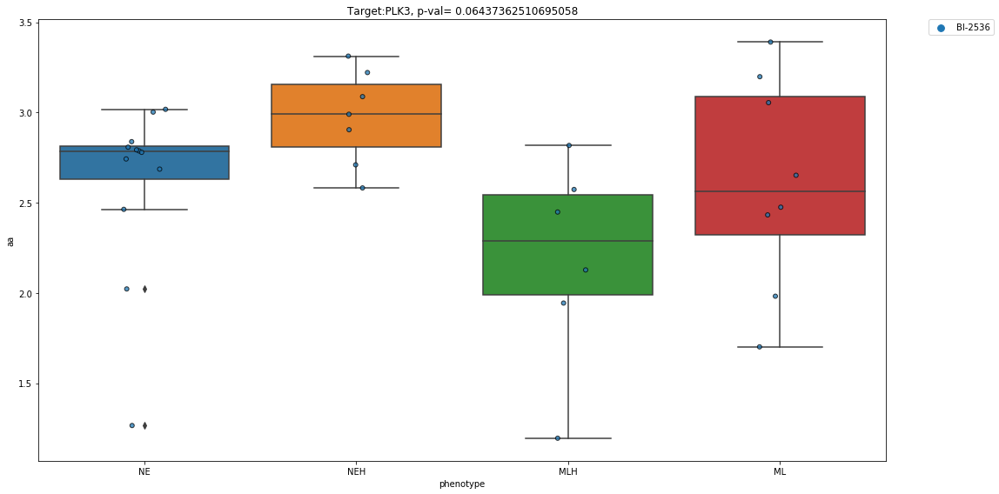

                       drug            aa phenotype  aa_new  hill_new  \
cell.line                                                               
COLO668    PKM2 Activator 9  3.463388e-02       MLH     0.0       0.0   
CORL47     PKM2 Activator 9  7.798744e-02        NE     0.0       0.0   
DMS114     PKM2 Activator 9  6.575261e-02        ML     0.0       0.0   
DMS53      PKM2 Activator 9  1.298088e-01       MLH     0.0       0.0   
NCIH1048   PKM2 Activator 9  1.200508e-01        ML     0.0       0.0   
NCIH1105   PKM2 Activator 9  8.060540e-02        NE     0.0       0.0   
NCIH1436   PKM2 Activator 9  2.496458e-03        NE     0.0       0.0   
NCIH146    PKM2 Activator 9  5.864223e-02        NE     0.0       0.0   
NCIH1618   PKM2 Activator 9  1.260185e-01        NE     0.0       0.0   
NCIH1694   PKM2 Activator 9  6.280000e-19       NEH     0.0       0.0   
NCIH1836   PKM2 Activator 9  2.340803e-03        NE     0.0       0.0   
NCIH1876   PKM2 Activator 9  8.293320e-02        NE

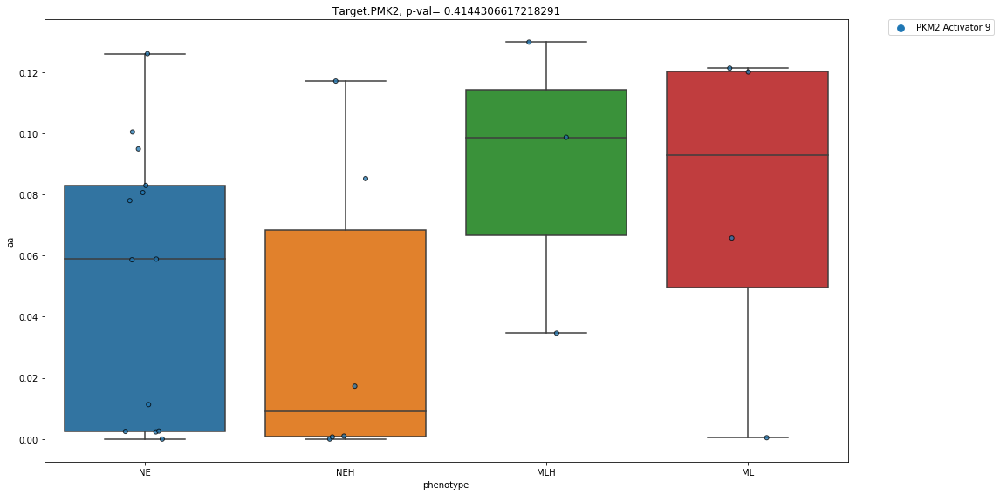

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3612: F_onewayBadInputSizesWarning: at least one input has length 0
  warnings.warn(F_onewayBadInputSizesWarning('at least one input '


              drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
CORL47     CS-7017  2.800000e-09        NE     0.0       0.0       0.0
NCIH1048   CS-7017  1.670000e-09        ML     0.0       0.0       0.0
NCIH1105   CS-7017  1.110000e-12        NE     0.0       0.0       0.0
NCIH146    CS-7017  2.430000e-10        NE     0.0       0.0       0.0
NCIH196    CS-7017  1.036140e-02        ML     0.0       0.0       0.0
NCIH1963   CS-7017  1.560000e-09        NE     0.0       0.0       0.0
NCIH446    CS-7017  3.510000e-29       NEH     0.0       0.0       0.0
NCIH524    CS-7017  2.570000e-08       NEH     0.0       0.0       0.0
NCIH82     CS-7017  1.870000e-10       NEH     0.0       0.0       0.0
PPAR


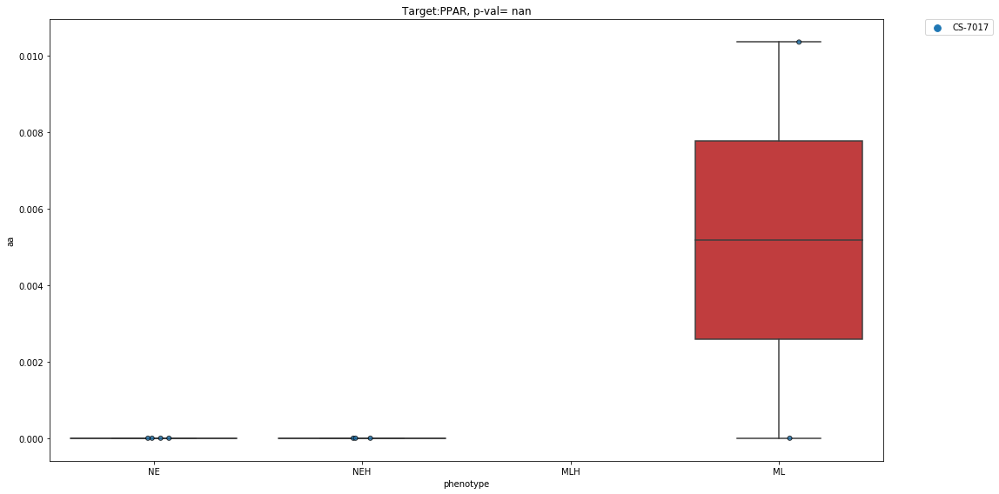

                        drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                   
COLO668    Megestrol acetate  0.013127       MLH     0.0       0.0       0.0
CORL47     Megestrol acetate  0.091726        NE     0.0       0.0       0.0
CORL88     Megestrol acetate  0.134680       MLH     0.0       0.0       0.0
DMS114     Megestrol acetate  0.035053        ML     0.0       0.0       0.0
DMS53      Megestrol acetate  0.282065       MLH     0.0       0.0       0.0
...                      ...       ...       ...     ...       ...       ...
NCIH82            Raloxifene  0.000000       NEH     0.0       0.0       0.0
NCIH841           Raloxifene  0.000000        ML     0.0       0.0       0.0
NCIH889           Raloxifene  0.000000        NE     0.0       0.0       0.0
SHP77             Raloxifene  0.000000       MLH     0.0       0.0       0.0
SW1271            Raloxifene  0.000000        ML     0.0       0.0       0.0

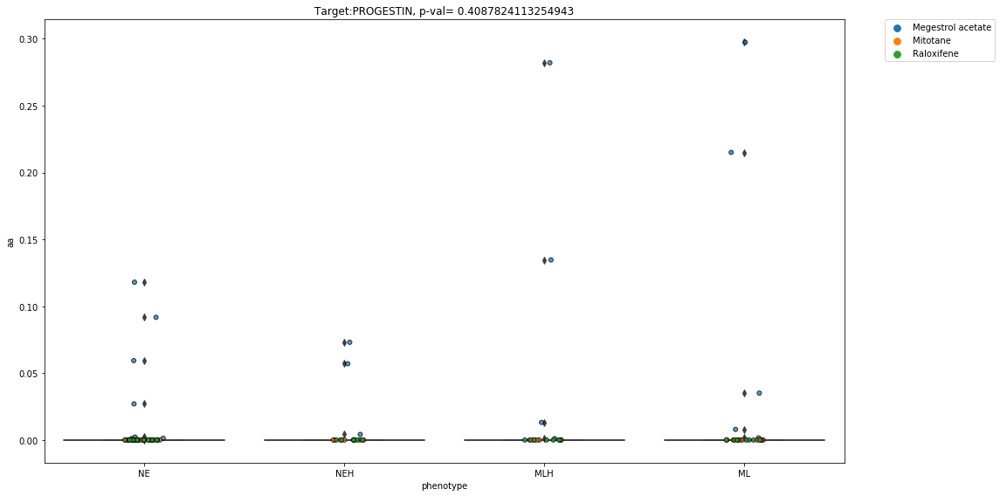

                  drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668    Bortezamide  3.105240       MLH     0.0       0.0       0.0
CORL47     Bortezamide  2.851760        NE     0.0       0.0       0.0
CORL88     Bortezamide  2.632913       MLH     0.0       0.0       0.0
DMS114     Bortezamide  3.384882        ML     0.0       0.0       0.0
DMS273     Bortezamide  3.184622       NEH     0.0       0.0       0.0
...                ...       ...       ...     ...       ...       ...
NCIH82        ONX-0914  1.314158       NEH     0.0       0.0       0.0
NCIH841       ONX-0914  1.006741        ML     0.0       0.0       0.0
NCIH889       ONX-0914  0.784621        NE     0.0       0.0       0.0
SHP77         ONX-0914  0.432742       MLH     0.0       0.0       0.0
SW1271        ONX-0914  1.269510        ML     0.0       0.0       0.0

[216 rows x 6 columns]
PROTEASOME


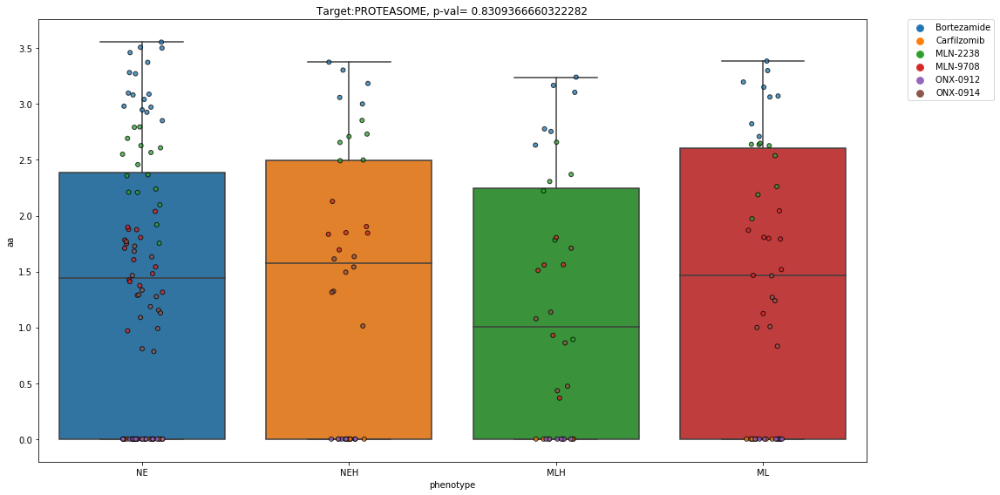

                drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                               
CORL47     LY-450139  6.873868e-02        NE     0.0       0.0       0.0
CORL88     LY-450139  6.530000e-12       MLH     0.0       0.0       0.0
DMS114     LY-450139  8.990000e-11        ML     0.0       0.0       0.0
DMS79      LY-450139  1.619300e-01        NE     0.0       0.0       0.0
NCIH1341   LY-450139  1.173339e-01        ML     0.0       0.0       0.0
NCIH1436   LY-450139  3.247221e-02        NE     0.0       0.0       0.0
NCIH146    LY-450139  3.361004e-02        NE     0.0       0.0       0.0
NCIH196    LY-450139  3.320957e-03        ML     0.0       0.0       0.0
NCIH2081   LY-450139  3.914979e-03        NE     0.0       0.0       0.0
NCIH211    LY-450139  2.567990e-02        ML     0.0       0.0       0.0
NCIH2171   LY-450139  8.750000e-15       NEH     0.0       0.0       0.0
NCIH446    LY-450139  1.071833e-01       NEH     0.

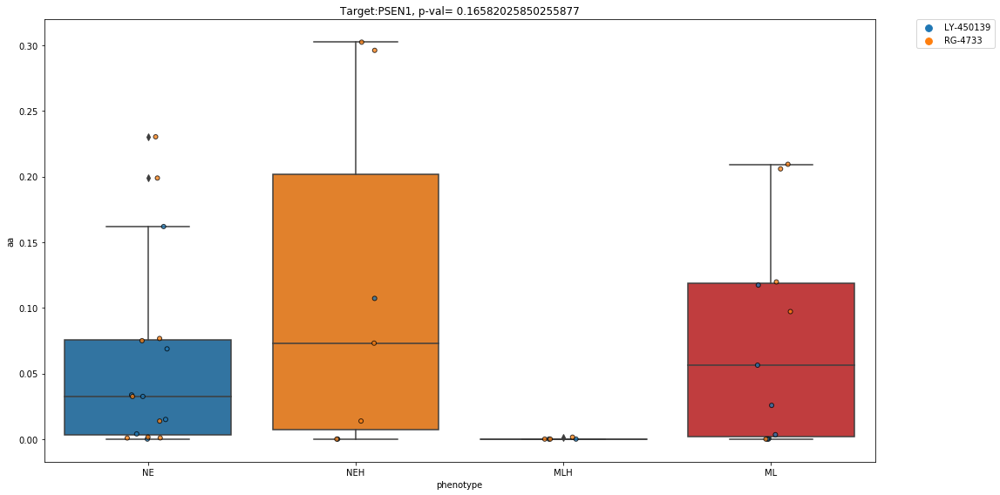

                drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                               
CORL47     LY-450139  6.873868e-02        NE     0.0       0.0       0.0
CORL88     LY-450139  6.530000e-12       MLH     0.0       0.0       0.0
DMS114     LY-450139  8.990000e-11        ML     0.0       0.0       0.0
DMS79      LY-450139  1.619300e-01        NE     0.0       0.0       0.0
NCIH1341   LY-450139  1.173339e-01        ML     0.0       0.0       0.0
NCIH1436   LY-450139  3.247221e-02        NE     0.0       0.0       0.0
NCIH146    LY-450139  3.361004e-02        NE     0.0       0.0       0.0
NCIH196    LY-450139  3.320957e-03        ML     0.0       0.0       0.0
NCIH2081   LY-450139  3.914979e-03        NE     0.0       0.0       0.0
NCIH211    LY-450139  2.567990e-02        ML     0.0       0.0       0.0
NCIH2171   LY-450139  8.750000e-15       NEH     0.0       0.0       0.0
NCIH446    LY-450139  1.071833e-01       NEH     0.

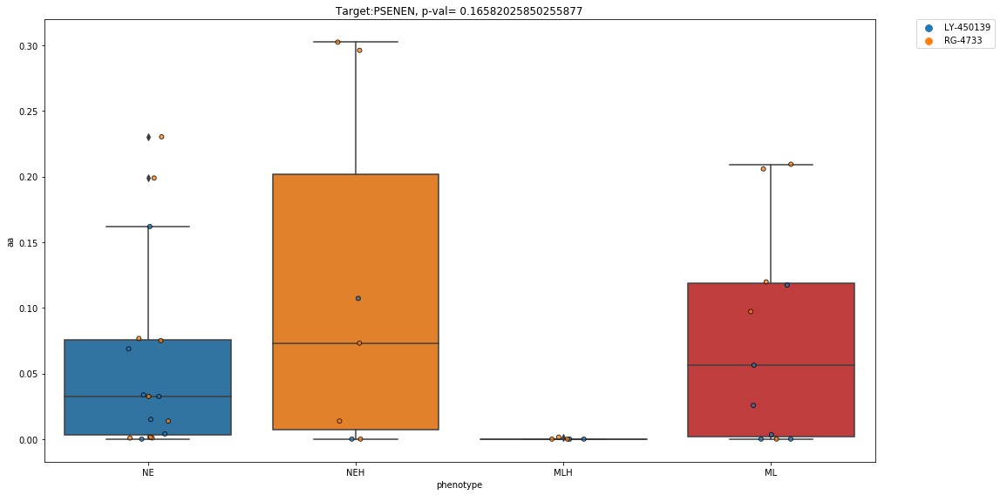

                drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                           
COLO668    CEP-18770  2.293155       MLH     0.0       0.0       0.0
CORL47     CEP-18770  2.214392        NE     0.0       0.0       0.0
CORL88     CEP-18770  1.309616       MLH     0.0       0.0       0.0
DMS114     CEP-18770  2.527414        ML     0.0       0.0       0.0
DMS273     CEP-18770  2.554099       NEH     0.0       0.0       0.0
...              ...       ...       ...     ...       ...       ...
NCIH82      MLN-2238  2.656741       NEH     0.0       0.0       0.0
NCIH841     MLN-2238  2.649101        ML     0.0       0.0       0.0
NCIH889     MLN-2238  2.210706        NE     0.0       0.0       0.0
SHP77       MLN-2238  2.306783       MLH     0.0       0.0       0.0
SW1271      MLN-2238  2.261246        ML     0.0       0.0       0.0

[73 rows x 6 columns]
PSMB5


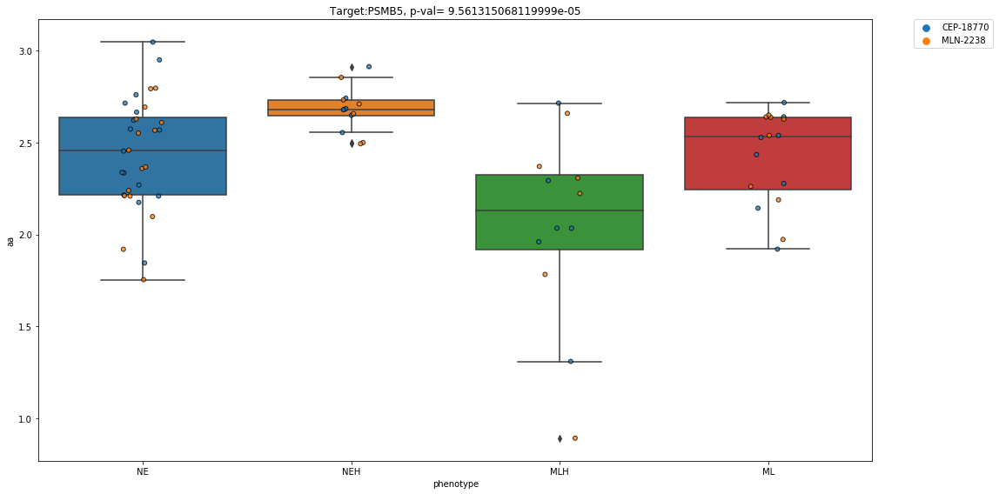

                    drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                               
COLO668    Teriflunomide  0.071170       MLH     0.0       0.0       0.0
CORL47     Teriflunomide  0.234264        NE     0.0       0.0       0.0
CORL88     Teriflunomide  0.023438       MLH     0.0       0.0       0.0
DMS114     Teriflunomide  0.314879        ML     0.0       0.0       0.0
DMS273     Teriflunomide  0.021842       NEH     0.0       0.0       0.0
DMS53      Teriflunomide  0.194786       MLH     0.0       0.0       0.0
DMS79      Teriflunomide  0.183191        NE     0.0       0.0       0.0
NCIH1048   Teriflunomide  0.354856        ML     0.0       0.0       0.0
NCIH1092   Teriflunomide  0.104854        NE     0.0       0.0       0.0
NCIH1105   Teriflunomide  0.121429        NE     0.0       0.0       0.0
NCIH1341   Teriflunomide  0.221706        ML     0.0       0.0       0.0
NCIH1436   Teriflunomide  0.261052        NE     0.

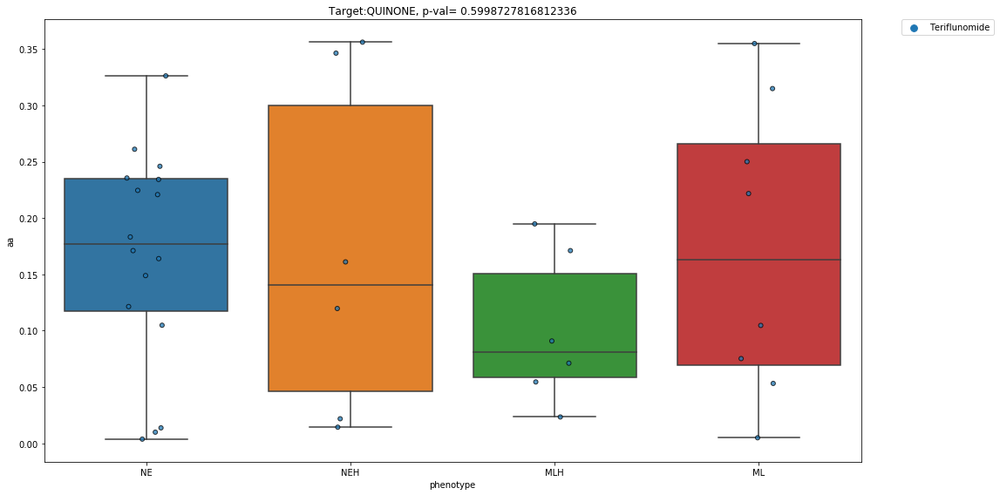

               drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
COLO668    IDH-C227  3.838950e-02       MLH     0.0       0.0       0.0
CORL47     IDH-C227  8.919955e-02        NE     0.0       0.0       0.0
DMS114     IDH-C227  3.120288e-01        ML     0.0       0.0       0.0
DMS273     IDH-C227  9.753684e-02       NEH     0.0       0.0       0.0
NCIH1048   IDH-C227  1.173986e-01        ML     0.0       0.0       0.0
NCIH1092   IDH-C227  2.928714e-03        NE     0.0       0.0       0.0
NCIH1105   IDH-C227  4.525542e-02        NE     0.0       0.0       0.0
NCIH1341   IDH-C227  1.559289e-03        ML     0.0       0.0       0.0
NCIH146    IDH-C227  1.232122e-01        NE     0.0       0.0       0.0
NCIH1618   IDH-C227  1.501361e-02        NE     0.0       0.0       0.0
NCIH1694   IDH-C227  1.811475e-01       NEH     0.0       0.0       0.0
NCIH1876   IDH-C227  2.424851e-03        NE     0.0       0.0   

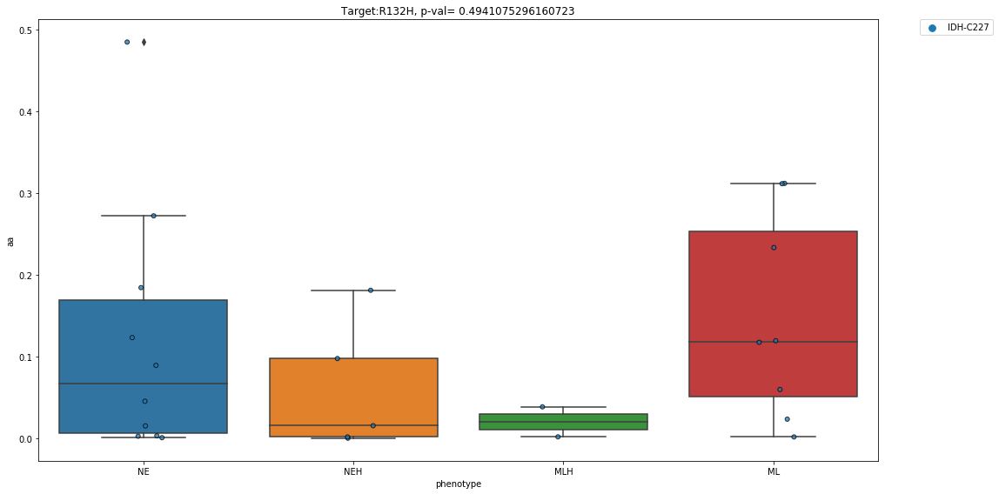

               drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
COLO668    PCI-0120  7.270000e-20       MLH     0.0       0.0       0.0
NCIH1048   PCI-0120  1.101433e-01        ML     0.0       0.0       0.0
NCIH1105   PCI-0120  9.030000e-11        NE     0.0       0.0       0.0
NCIH1436   PCI-0120  2.801619e-02        NE     0.0       0.0       0.0
NCIH1618   PCI-0120  1.140000e-13        NE     0.0       0.0       0.0
NCIH1836   PCI-0120  2.497846e-02        NE     0.0       0.0       0.0
NCIH1876   PCI-0120  8.449704e-02        NE     0.0       0.0       0.0
NCIH196    PCI-0120  6.999891e-02        ML     0.0       0.0       0.0
NCIH1963   PCI-0120  7.639144e-02        NE     0.0       0.0       0.0
NCIH2029   PCI-0120  2.551999e-02       MLH     0.0       0.0       0.0
NCIH2066   PCI-0120  1.519102e-01        ML     0.0       0.0       0.0
NCIH209    PCI-0120  1.080000e-11        NE     0.0       0.0   

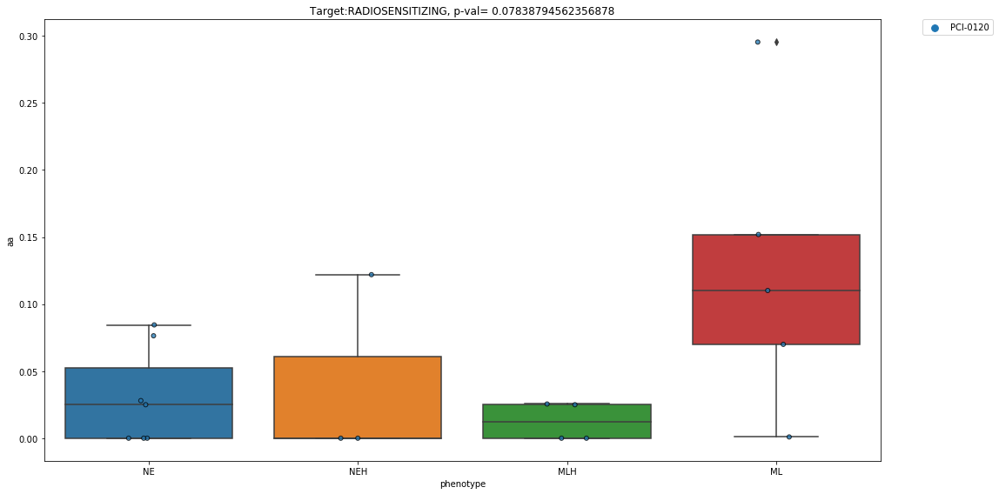

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                  drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                        
COLO668    Regorafenib  0.0       MLH     0.0       0.0       0.0
CORL47     Regorafenib  0.0        NE     0.0       0.0       0.0
CORL88     Regorafenib  0.0       MLH     0.0       0.0       0.0
DMS114     Regorafenib  0.0        ML     0.0       0.0       0.0
DMS273     Regorafenib  0.0       NEH     0.0       0.0       0.0
DMS53      Regorafenib  0.0       MLH     0.0       0.0       0.0
DMS79      Regorafenib  0.0        NE     0.0       0.0       0.0
NCIH1048   Regorafenib  0.0        ML     0.0       0.0       0.0
NCIH1092   Regorafenib  0.0        NE     0.0       0.0       0.0
NCIH1105   Regorafenib  0.0        NE     0.0       0.0       0.0
NCIH1341   Regorafenib  0.0        ML     0.0       0.0       0.0
NCIH1436   Regorafenib  0.0        NE     0.0       0.0       0.0
NCIH146    Regorafenib  0.0        NE     0.0       0.0       0.0
NCIH1618  

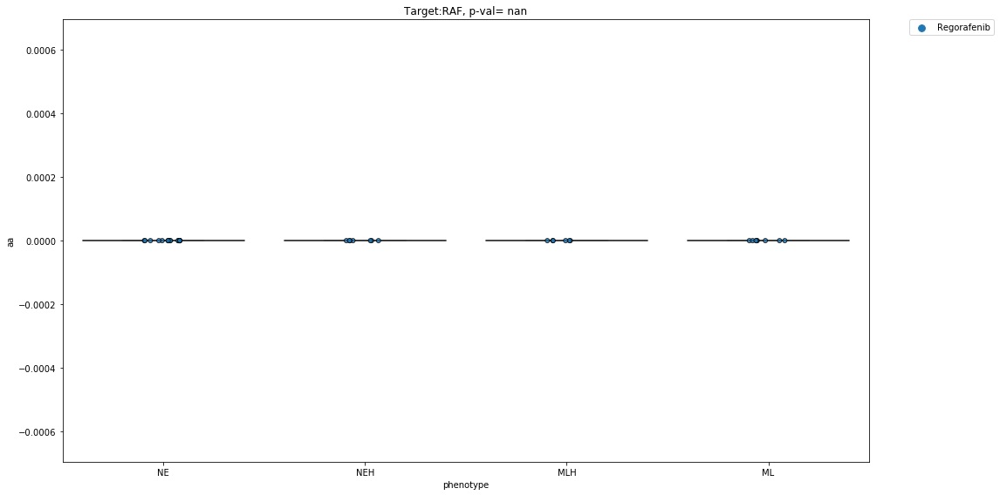

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
CORL47     GW-5074  0.058547        NE     0.0       0.0       0.0
CORL88     GW-5074  0.092489       MLH     0.0       0.0       0.0
DMS114     GW-5074  0.013337        ML     0.0       0.0       0.0
DMS273     GW-5074  0.064776       NEH     0.0       0.0       0.0
DMS53      GW-5074  0.065586       MLH     0.0       0.0       0.0
DMS79      GW-5074  0.002934        NE     0.0       0.0       0.0
NCIH1048   GW-5074  0.066409        ML     0.0       0.0       0.0
NCIH1092   GW-5074  0.131582        NE     0.0       0.0       0.0
NCIH1105   GW-5074  0.002366        NE     0.0       0.0       0.0
NCIH1341   GW-5074  0.118499        ML     0.0       0.0       0.0
NCIH1436   GW-5074  0.153972        NE     0.0       0.0       0.0
NCIH146    GW-5074  0.176088        NE     0.0       0.0       0.0
NCIH1618   GW-5074  0.007098        NE     0.0       0.0      

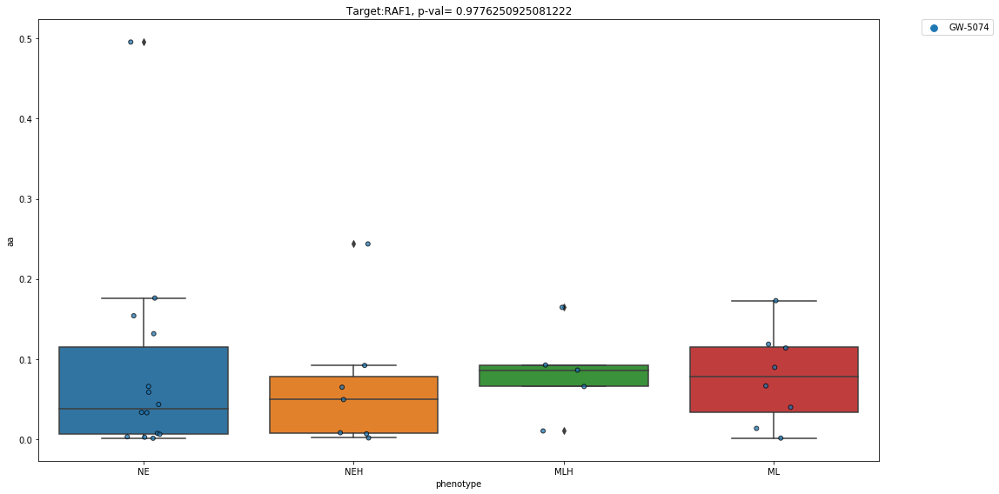

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                      
COLO668    Tretinoin  0.0       MLH     0.0       0.0       0.0
CORL47     Tretinoin  0.0        NE     0.0       0.0       0.0
CORL88     Tretinoin  0.0       MLH     0.0       0.0       0.0
DMS114     Tretinoin  0.0        ML     0.0       0.0       0.0
DMS273     Tretinoin  0.0       NEH     0.0       0.0       0.0
DMS53      Tretinoin  0.0       MLH     0.0       0.0       0.0
DMS79      Tretinoin  0.0        NE     0.0       0.0       0.0
NCIH1048   Tretinoin  0.0        ML     0.0       0.0       0.0
NCIH1092   Tretinoin  0.0        NE     0.0       0.0       0.0
NCIH1105   Tretinoin  0.0        NE     0.0       0.0       0.0
NCIH1341   Tretinoin  0.0        ML     0.0       0.0       0.0
NCIH1436   Tretinoin  0.0        NE     0.0       0.0       0.0
NCIH146    Tretinoin  0.0        NE     0.0       0.0       0.0
NCIH1618   Tretinoin  0.0        NE     

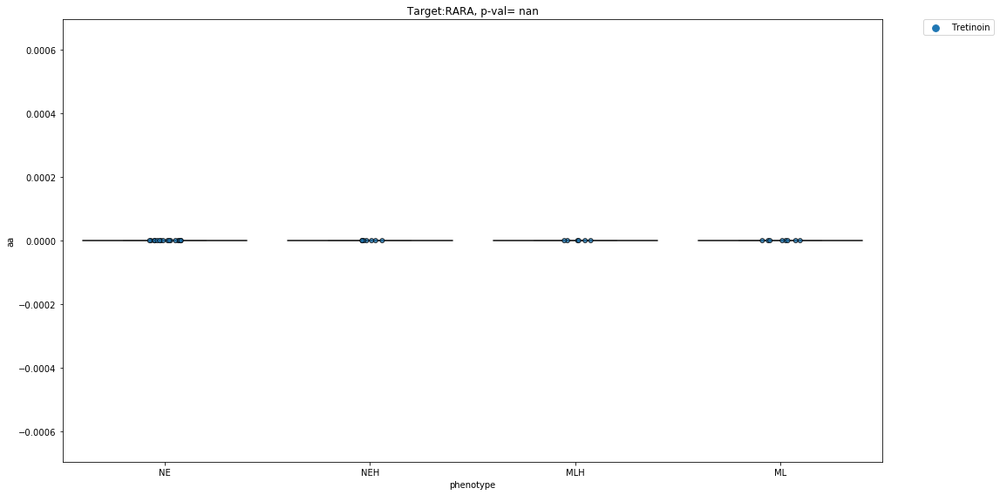

             drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                            
COLO668    KD-032  7.592120e-02       MLH     0.0       0.0       0.0
DMS114     KD-032  9.088389e-02        ML     0.0       0.0       0.0
NCIH1048   KD-032  2.676087e-02        ML     0.0       0.0       0.0
NCIH1092   KD-032  5.819950e-02        NE     0.0       0.0       0.0
NCIH1436   KD-032  5.166719e-01        NE     0.0       0.0       0.0
NCIH146    KD-032  7.335717e-02        NE     0.0       0.0       0.0
NCIH1618   KD-032  1.573317e-01        NE     0.0       0.0       0.0
NCIH1876   KD-032  8.768083e-02        NE     0.0       0.0       0.0
NCIH1930   KD-032  3.002753e-01        NE     0.0       0.0       0.0
NCIH2029   KD-032  1.433313e-01       MLH     0.0       0.0       0.0
NCIH2066   KD-032  2.167576e-01        ML     0.0       0.0       0.0
NCIH209    KD-032  3.833266e-01        NE     0.0       0.0       0.0
NCIH446    KD-032  1

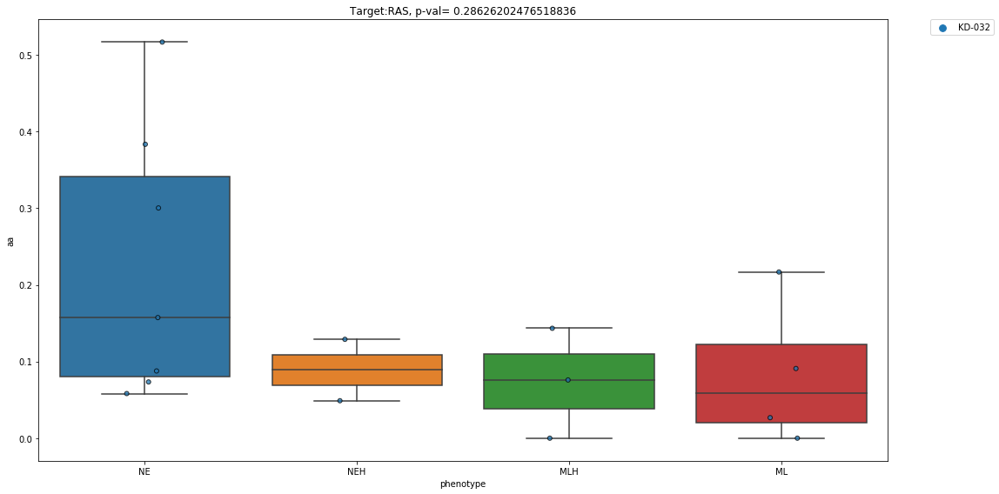

           drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                      
COLO668    SC-1  0.808803       MLH     0.0       0.0       0.0
CORL47     SC-1  0.237441        NE     0.0       0.0       0.0
DMS114     SC-1  1.465968        ML     0.0       0.0       0.0
DMS273     SC-1  0.468393       NEH     0.0       0.0       0.0
DMS53      SC-1  0.592272       MLH     0.0       0.0       0.0
DMS79      SC-1  0.226275        NE     0.0       0.0       0.0
NCIH1048   SC-1  1.441944        ML     0.0       0.0       0.0
NCIH1092   SC-1  0.114504        NE     0.0       0.0       0.0
NCIH1105   SC-1  0.468143        NE     0.0       0.0       0.0
NCIH1341   SC-1  1.381211        ML     0.0       0.0       0.0
NCIH1436   SC-1  0.003908        NE     0.0       0.0       0.0
NCIH146    SC-1  0.487582        NE     0.0       0.0       0.0
NCIH1618   SC-1  0.445636        NE     0.0       0.0       0.0
NCIH1694   SC-1  0.161750       NEH     

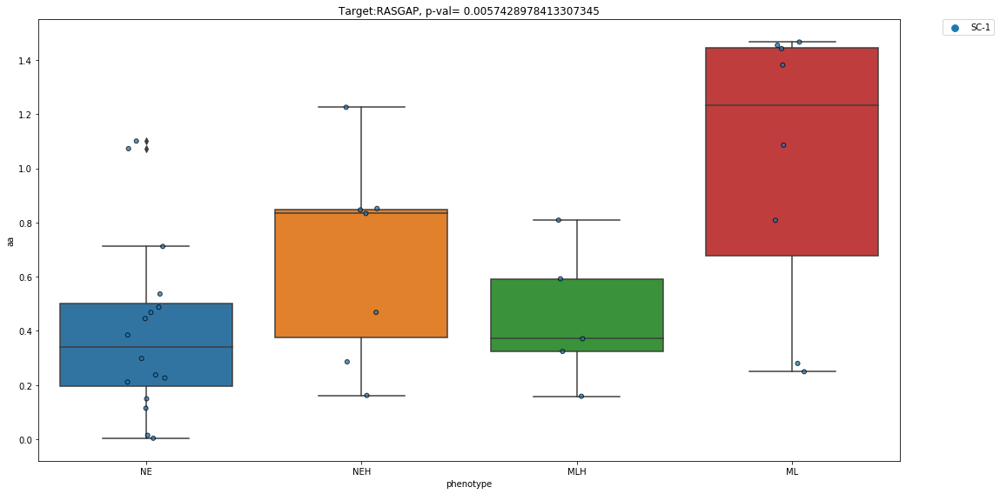

             drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                        
COLO668    AC-220  0.043024       MLH     0.0       0.0       0.0
CORL47     AC-220  0.050475        NE     0.0       0.0       0.0
DMS114     AC-220  0.498568        ML     0.0       0.0       0.0
DMS53      AC-220  0.244199       MLH     0.0       0.0       0.0
DMS79      AC-220  0.042471        NE     0.0       0.0       0.0
...           ...       ...       ...     ...       ...       ...
NCIH69     XL-541  0.150075        NE     0.0       0.0       0.0
NCIH841    XL-541  0.212328        ML     0.0       0.0       0.0
NCIH889    XL-541  0.001129        NE     0.0       0.0       0.0
SHP77      XL-541  0.111036       MLH     0.0       0.0       0.0
SW1271     XL-541  0.168480        ML     0.0       0.0       0.0

[232 rows x 6 columns]
RET


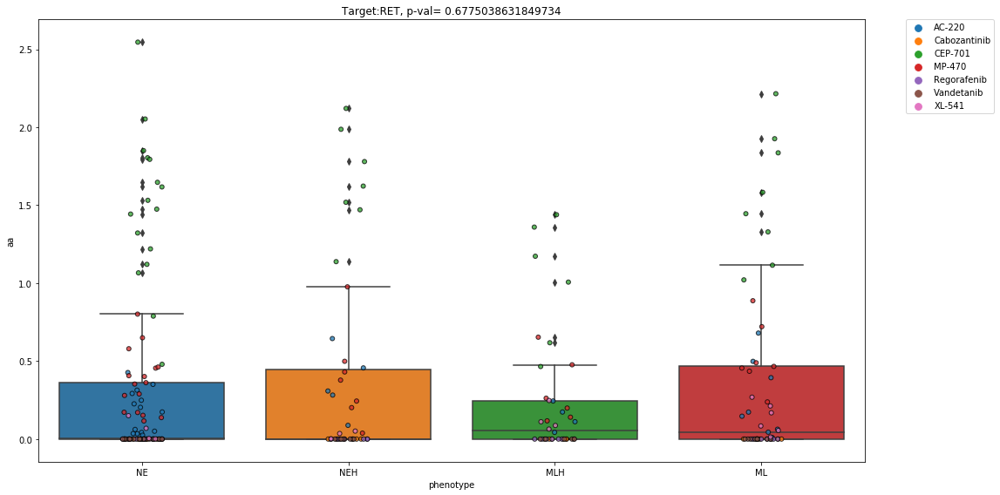

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668    YK-4-279  0.524237       MLH     0.0       0.0       0.0
CORL47     YK-4-279  0.411870        NE     0.0       0.0       0.0
CORL88     YK-4-279  0.269891       MLH     0.0       0.0       0.0
DMS114     YK-4-279  0.920599        ML     0.0       0.0       0.0
DMS273     YK-4-279  0.578962       NEH     0.0       0.0       0.0
DMS53      YK-4-279  0.399143       MLH     0.0       0.0       0.0
DMS79      YK-4-279  0.290339        NE     0.0       0.0       0.0
NCIH1048   YK-4-279  0.963275        ML     0.0       0.0       0.0
NCIH1092   YK-4-279  0.340255        NE     0.0       0.0       0.0
NCIH1105   YK-4-279  0.652788        NE     0.0       0.0       0.0
NCIH1341   YK-4-279  0.728880        ML     0.0       0.0       0.0
NCIH1436   YK-4-279  0.699453        NE     0.0       0.0       0.0
NCIH146    YK-4-279  0.751944        NE     0.0 

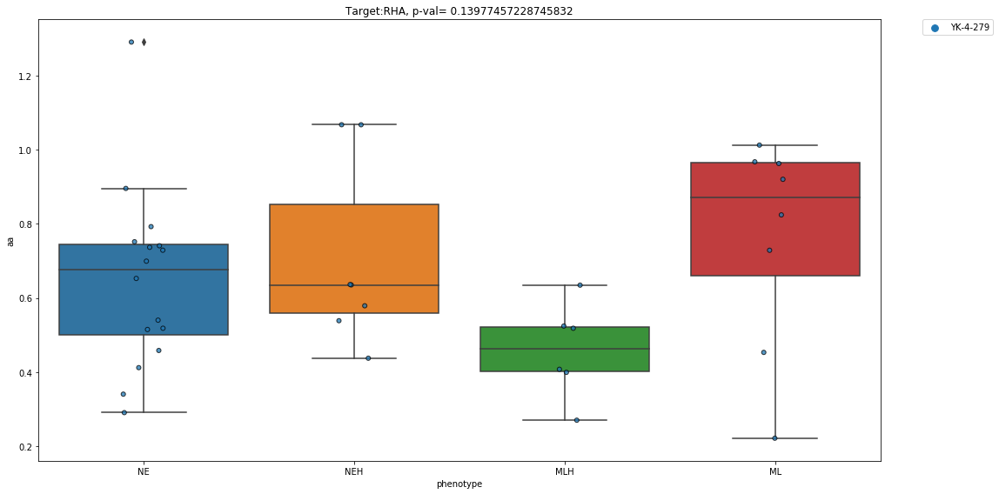

                  drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668           3-AP  1.216753       MLH     0.0       0.0       0.0
CORL47            3-AP  0.444589        NE     0.0       0.0       0.0
CORL88            3-AP  0.274489       MLH     0.0       0.0       0.0
DMS114            3-AP  1.479723        ML     0.0       0.0       0.0
DMS273            3-AP  1.170240       NEH     0.0       0.0       0.0
...                ...       ...       ...     ...       ...       ...
NCIH82     Hydroxyurea  0.000000       NEH     0.0       0.0       0.0
NCIH841    Hydroxyurea  0.000000        ML     0.0       0.0       0.0
NCIH889    Hydroxyurea  0.000000        NE     0.0       0.0       0.0
SHP77      Hydroxyurea  0.000000       MLH     0.0       0.0       0.0
SW1271     Hydroxyurea  0.000000        ML     0.0       0.0       0.0

[74 rows x 6 columns]
RNR


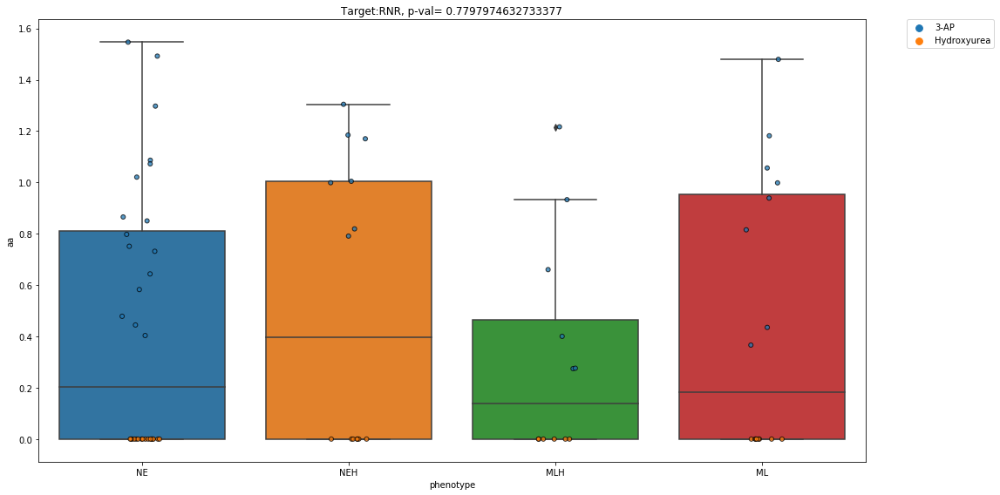

              drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668    Y-27632  8.190150e-02       MLH     0.0       0.0       0.0
CORL47     Y-27632  1.185921e-03        NE     0.0       0.0       0.0
DMS114     Y-27632  9.324400e-04        ML     0.0       0.0       0.0
NCIH1048   Y-27632  0.000000e+00        ML     0.0       0.0       0.0
NCIH1341   Y-27632  7.250000e-13        ML     0.0       0.0       0.0
NCIH196    Y-27632  5.590880e-04        ML     0.0       0.0       0.0
NCIH211    Y-27632  3.250000e-24        ML     0.0       0.0       0.0
NCIH2141   Y-27632  8.650000e-11        NE     0.0       0.0       0.0
NCIH2171   Y-27632  8.150000e-12       NEH     0.0       0.0       0.0
NCIH446    Y-27632  1.360000e-12       NEH     0.0       0.0       0.0
NCIH526    Y-27632  6.245759e-02       NEH     0.0       0.0       0.0
NCIH82     Y-27632  1.039403e-01       NEH     0.0       0.0       0.0
NCIH84

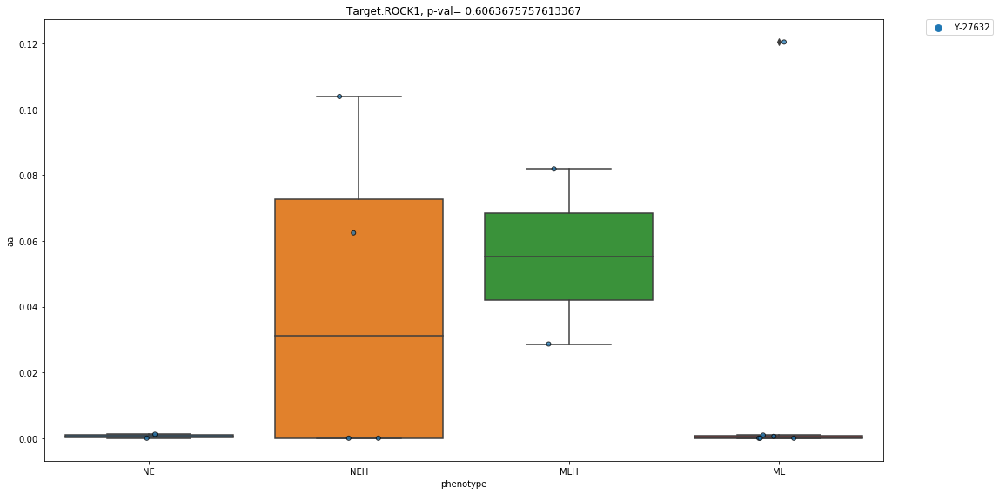

              drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668    Y-27632  8.190150e-02       MLH     0.0       0.0       0.0
CORL47     Y-27632  1.185921e-03        NE     0.0       0.0       0.0
DMS114     Y-27632  9.324400e-04        ML     0.0       0.0       0.0
NCIH1048   Y-27632  0.000000e+00        ML     0.0       0.0       0.0
NCIH1341   Y-27632  7.250000e-13        ML     0.0       0.0       0.0
NCIH196    Y-27632  5.590880e-04        ML     0.0       0.0       0.0
NCIH211    Y-27632  3.250000e-24        ML     0.0       0.0       0.0
NCIH2141   Y-27632  8.650000e-11        NE     0.0       0.0       0.0
NCIH2171   Y-27632  8.150000e-12       NEH     0.0       0.0       0.0
NCIH446    Y-27632  1.360000e-12       NEH     0.0       0.0       0.0
NCIH526    Y-27632  6.245759e-02       NEH     0.0       0.0       0.0
NCIH82     Y-27632  1.039403e-01       NEH     0.0       0.0       0.0
NCIH84

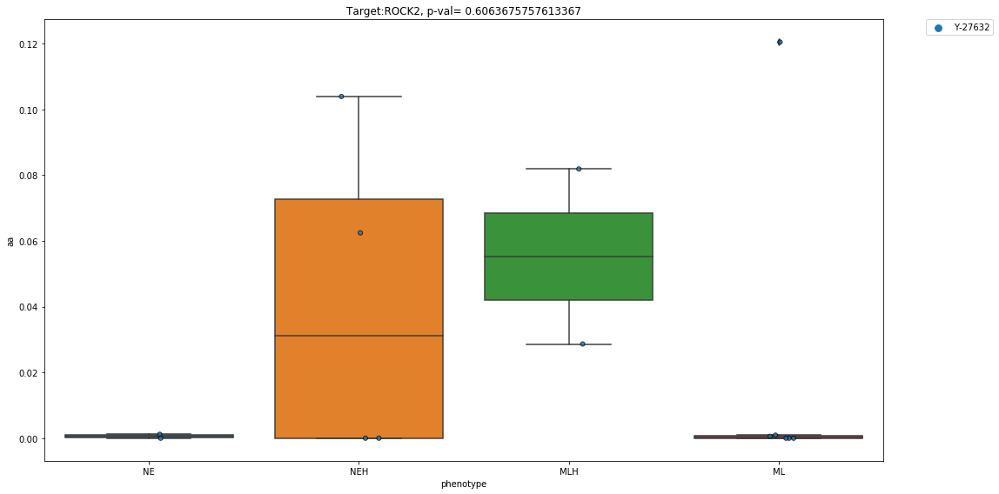

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                   drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    Dactinomycin  0.0       MLH     0.0       0.0       0.0
CORL47     Dactinomycin  0.0        NE     0.0       0.0       0.0
CORL88     Dactinomycin  0.0       MLH     0.0       0.0       0.0
DMS114     Dactinomycin  0.0        ML     0.0       0.0       0.0
DMS273     Dactinomycin  0.0       NEH     0.0       0.0       0.0
DMS53      Dactinomycin  0.0       MLH     0.0       0.0       0.0
DMS79      Dactinomycin  0.0        NE     0.0       0.0       0.0
NCIH1048   Dactinomycin  0.0        ML     0.0       0.0       0.0
NCIH1092   Dactinomycin  0.0        NE     0.0       0.0       0.0
NCIH1105   Dactinomycin  0.0        NE     0.0       0.0       0.0
NCIH1341   Dactinomycin  0.0        ML     0.0       0.0       0.0
NCIH1436   Dactinomycin  0.0        NE     0.0       0.0       0.0
NCIH146    Dactinomycin  0.0        NE     0.0       0.0      

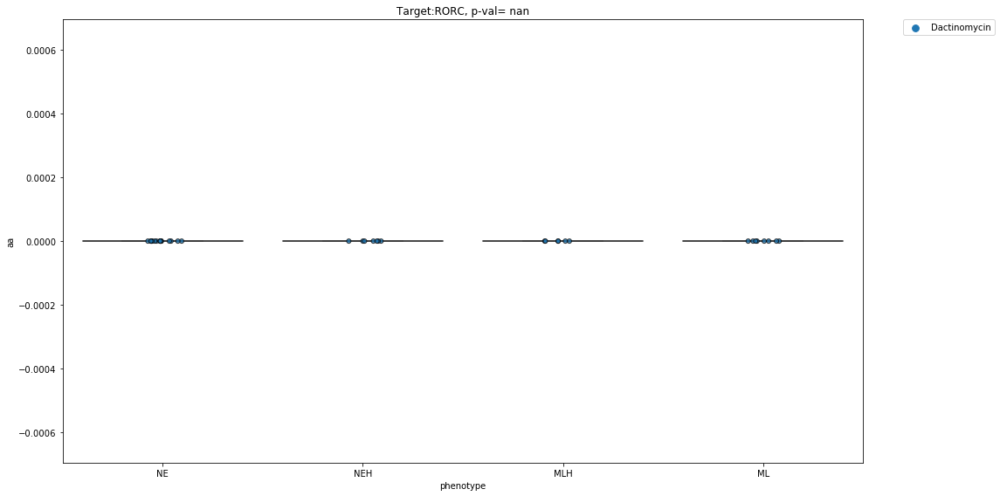

                                drug        aa phenotype  aa_new  hill_new  \
cell.line                                                                    
COLO668    Omacetaxine mepasuccinate  2.230993       MLH     0.0       0.0   
CORL47     Omacetaxine mepasuccinate  1.516812        NE     0.0       0.0   
CORL88     Omacetaxine mepasuccinate  1.618483       MLH     0.0       0.0   
DMS114     Omacetaxine mepasuccinate  2.679823        ML     0.0       0.0   
DMS273     Omacetaxine mepasuccinate  2.259084       NEH     0.0       0.0   
DMS53      Omacetaxine mepasuccinate  1.651140       MLH     0.0       0.0   
DMS79      Omacetaxine mepasuccinate  1.644365        NE     0.0       0.0   
NCIH1048   Omacetaxine mepasuccinate  2.346989        ML     0.0       0.0   
NCIH1092   Omacetaxine mepasuccinate  1.592047        NE     0.0       0.0   
NCIH1105   Omacetaxine mepasuccinate  1.886780        NE     0.0       0.0   
NCIH1341   Omacetaxine mepasuccinate  2.358687        ML     0.0

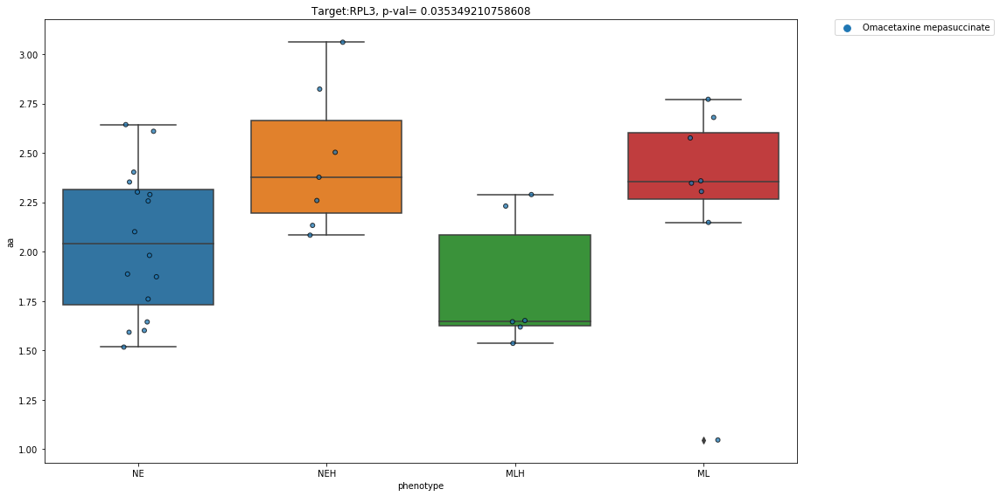

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                  drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                        
COLO668    Gemcitabine  0.0       MLH     0.0       0.0       0.0
CORL47     Gemcitabine  0.0        NE     0.0       0.0       0.0
CORL88     Gemcitabine  0.0       MLH     0.0       0.0       0.0
DMS114     Gemcitabine  0.0        ML     0.0       0.0       0.0
DMS273     Gemcitabine  0.0       NEH     0.0       0.0       0.0
DMS53      Gemcitabine  0.0       MLH     0.0       0.0       0.0
DMS79      Gemcitabine  0.0        NE     0.0       0.0       0.0
NCIH1048   Gemcitabine  0.0        ML     0.0       0.0       0.0
NCIH1092   Gemcitabine  0.0        NE     0.0       0.0       0.0
NCIH1105   Gemcitabine  0.0        NE     0.0       0.0       0.0
NCIH1341   Gemcitabine  0.0        ML     0.0       0.0       0.0
NCIH1436   Gemcitabine  0.0        NE     0.0       0.0       0.0
NCIH146    Gemcitabine  0.0        NE     0.0       0.0       0.0
NCIH1618  

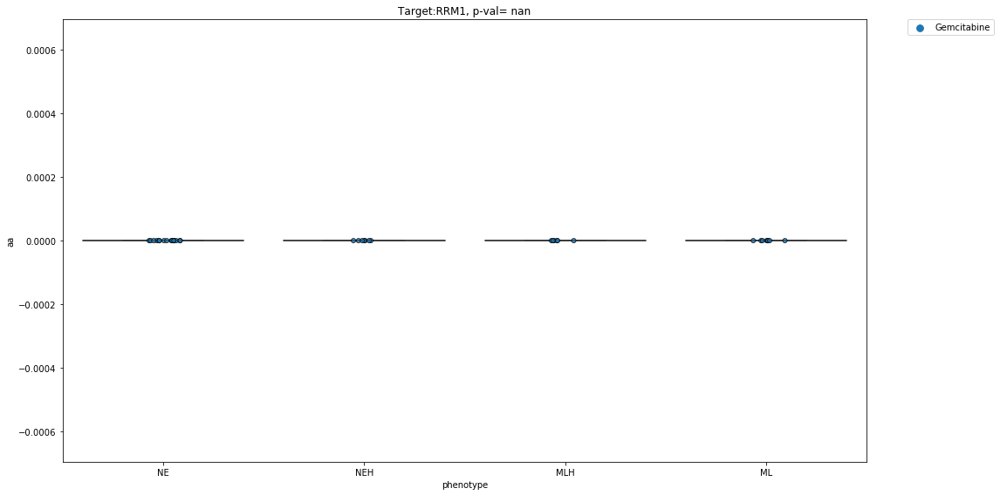

                 drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                
COLO668    LY-2606368  2.625777e+00       MLH     0.0       0.0       0.0
CORL47     LY-2606368  2.241292e+00        NE     0.0       0.0       0.0
CORL88     LY-2606368  2.818009e+00       MLH     0.0       0.0       0.0
DMS114     LY-2606368  1.660661e+00        ML     0.0       0.0       0.0
DMS273     LY-2606368  3.254396e+00       NEH     0.0       0.0       0.0
DMS53      LY-2606368  1.437733e+00       MLH     0.0       0.0       0.0
DMS79      LY-2606368  1.604466e+00        NE     0.0       0.0       0.0
NCIH1048   LY-2606368  2.542430e+00        ML     0.0       0.0       0.0
NCIH1092   LY-2606368  2.143874e+00        NE     0.0       0.0       0.0
NCIH1105   LY-2606368  2.217233e+00        NE     0.0       0.0       0.0
NCIH1341   LY-2606368  2.727039e+00        ML     0.0       0.0       0.0
NCIH1436   LY-2606368  2.387087e+00   

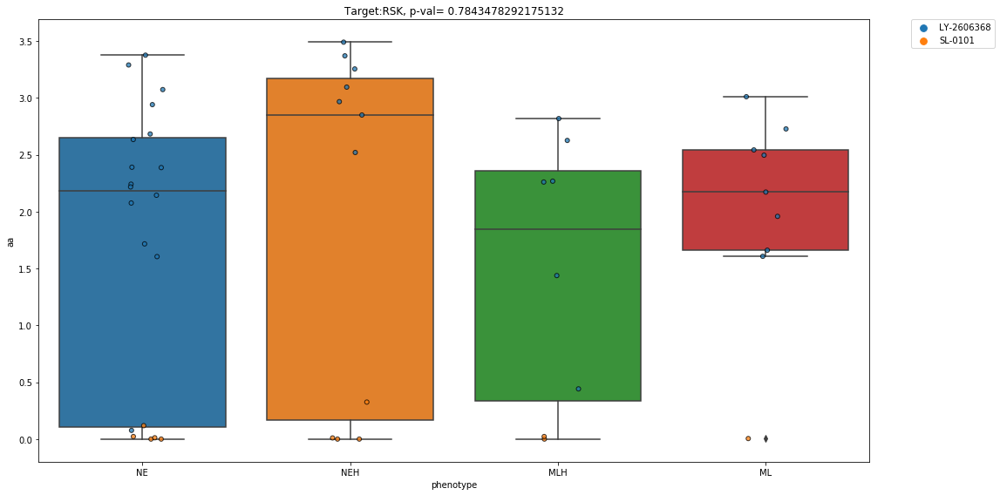

                   drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    Pralatrexate  0.0       MLH     0.0       0.0       0.0
CORL47     Pralatrexate  0.0        NE     0.0       0.0       0.0
CORL88     Pralatrexate  0.0       MLH     0.0       0.0       0.0
DMS114     Pralatrexate  0.0        ML     0.0       0.0       0.0
DMS273     Pralatrexate  0.0       NEH     0.0       0.0       0.0
DMS53      Pralatrexate  0.0       MLH     0.0       0.0       0.0
DMS79      Pralatrexate  0.0        NE     0.0       0.0       0.0
NCIH1048   Pralatrexate  0.0        ML     0.0       0.0       0.0
NCIH1092   Pralatrexate  0.0        NE     0.0       0.0       0.0
NCIH1105   Pralatrexate  0.0        NE     0.0       0.0       0.0
NCIH1341   Pralatrexate  0.0        ML     0.0       0.0       0.0
NCIH1436   Pralatrexate  0.0        NE     0.0       0.0       0.0
NCIH146    Pralatrexate  0.0        NE     0.0       0.0      

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


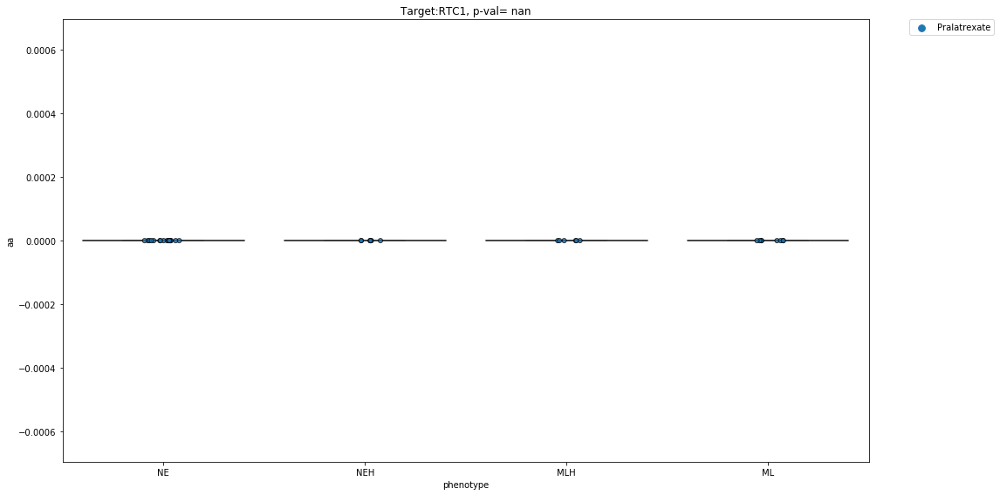

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    ABT-869  0.377139       MLH     0.0       0.0       0.0
CORL47     ABT-869  0.153714        NE     0.0       0.0       0.0
CORL88     ABT-869  0.068119       MLH     0.0       0.0       0.0
DMS114     ABT-869  0.348983        ML     0.0       0.0       0.0
DMS273     ABT-869  0.186562       NEH     0.0       0.0       0.0
...            ...       ...       ...     ...       ...       ...
NCIH69      VX-322  0.324015        NE     0.0       0.0       0.0
NCIH82      VX-322  0.008743       NEH     0.0       0.0       0.0
NCIH841     VX-322  0.153872        ML     0.0       0.0       0.0
SHP77       VX-322  0.023496       MLH     0.0       0.0       0.0
SW1271      VX-322  0.006640        ML     0.0       0.0       0.0

[71 rows x 6 columns]
RTK


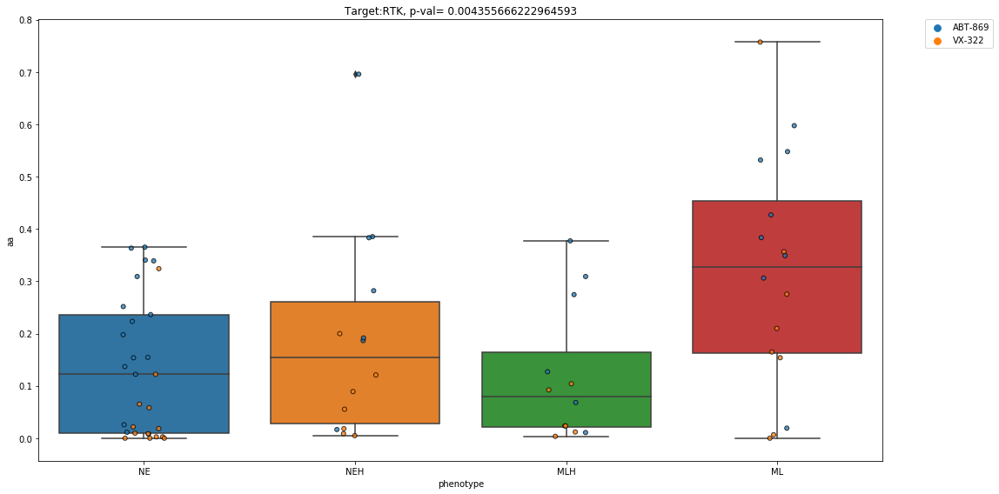

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                      
COLO668    Tretinoin  0.0       MLH     0.0       0.0       0.0
CORL47     Tretinoin  0.0        NE     0.0       0.0       0.0
CORL88     Tretinoin  0.0       MLH     0.0       0.0       0.0
DMS114     Tretinoin  0.0        ML     0.0       0.0       0.0
DMS273     Tretinoin  0.0       NEH     0.0       0.0       0.0
DMS53      Tretinoin  0.0       MLH     0.0       0.0       0.0
DMS79      Tretinoin  0.0        NE     0.0       0.0       0.0
NCIH1048   Tretinoin  0.0        ML     0.0       0.0       0.0
NCIH1092   Tretinoin  0.0        NE     0.0       0.0       0.0
NCIH1105   Tretinoin  0.0        NE     0.0       0.0       0.0
NCIH1341   Tretinoin  0.0        ML     0.0       0.0       0.0
NCIH1436   Tretinoin  0.0        NE     0.0       0.0       0.0
NCIH146    Tretinoin  0.0        NE     0.0       0.0       0.0
NCIH1618   Tretinoin  0.0        NE     

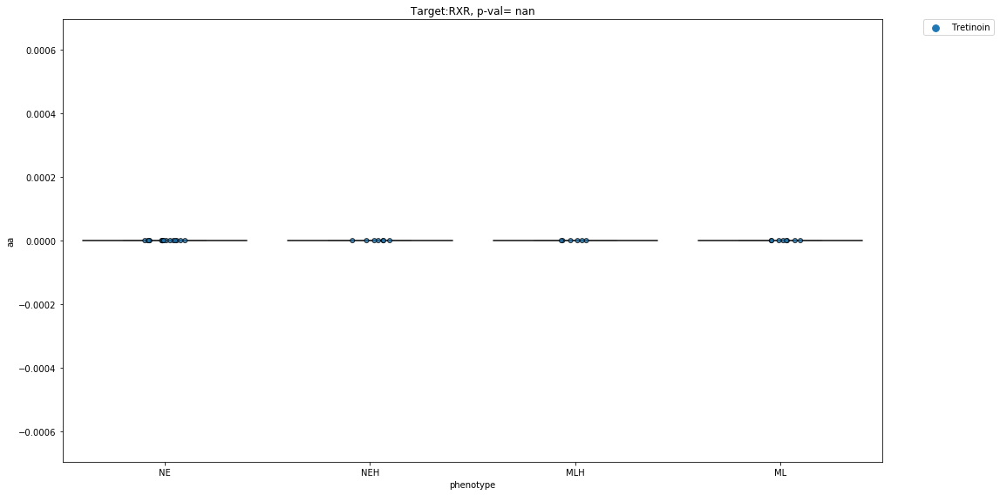

           drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                      
COLO668    H-89  0.069404       MLH     0.0       0.0       0.0
CORL47     H-89  0.004929        NE     0.0       0.0       0.0
CORL88     H-89  0.002052       MLH     0.0       0.0       0.0
DMS114     H-89  0.016039        ML     0.0       0.0       0.0
DMS273     H-89  0.004532       NEH     0.0       0.0       0.0
DMS53      H-89  0.092434       MLH     0.0       0.0       0.0
DMS79      H-89  0.006854        NE     0.0       0.0       0.0
NCIH1048   H-89  0.084825        ML     0.0       0.0       0.0
NCIH1105   H-89  0.088566        NE     0.0       0.0       0.0
NCIH1341   H-89  0.088486        ML     0.0       0.0       0.0
NCIH146    H-89  0.004108        NE     0.0       0.0       0.0
NCIH1618   H-89  0.016973        NE     0.0       0.0       0.0
NCIH1694   H-89  0.220864       NEH     0.0       0.0       0.0
NCIH1836   H-89  0.007603        NE     

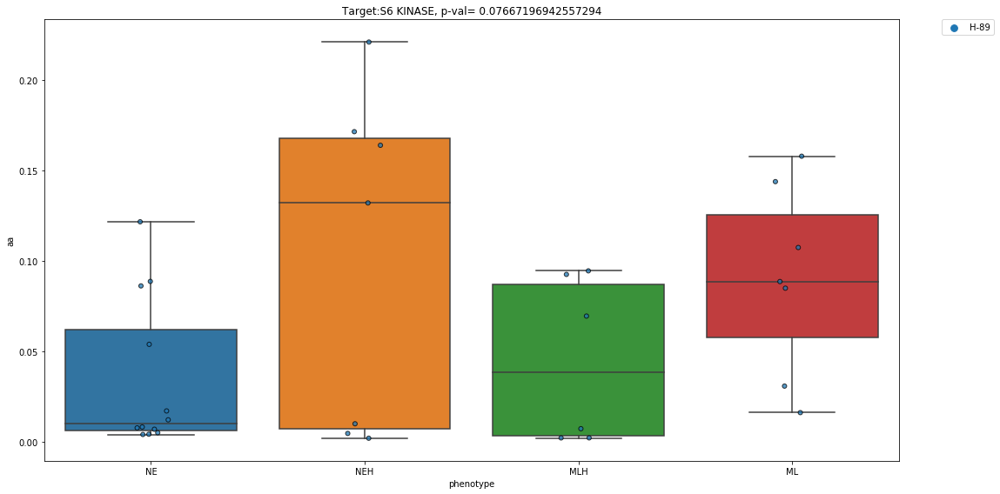

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                 drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                       
COLO668    Plerixafor  0.0       MLH     0.0       0.0       0.0
CORL47     Plerixafor  0.0        NE     0.0       0.0       0.0
CORL88     Plerixafor  0.0       MLH     0.0       0.0       0.0
DMS114     Plerixafor  0.0        ML     0.0       0.0       0.0
DMS273     Plerixafor  0.0       NEH     0.0       0.0       0.0
DMS53      Plerixafor  0.0       MLH     0.0       0.0       0.0
DMS79      Plerixafor  0.0        NE     0.0       0.0       0.0
NCIH1048   Plerixafor  0.0        ML     0.0       0.0       0.0
NCIH1092   Plerixafor  0.0        NE     0.0       0.0       0.0
NCIH1105   Plerixafor  0.0        NE     0.0       0.0       0.0
NCIH1341   Plerixafor  0.0        ML     0.0       0.0       0.0
NCIH1436   Plerixafor  0.0        NE     0.0       0.0       0.0
NCIH146    Plerixafor  0.0        NE     0.0       0.0       0.0
NCIH1618   Plerixafor  0.

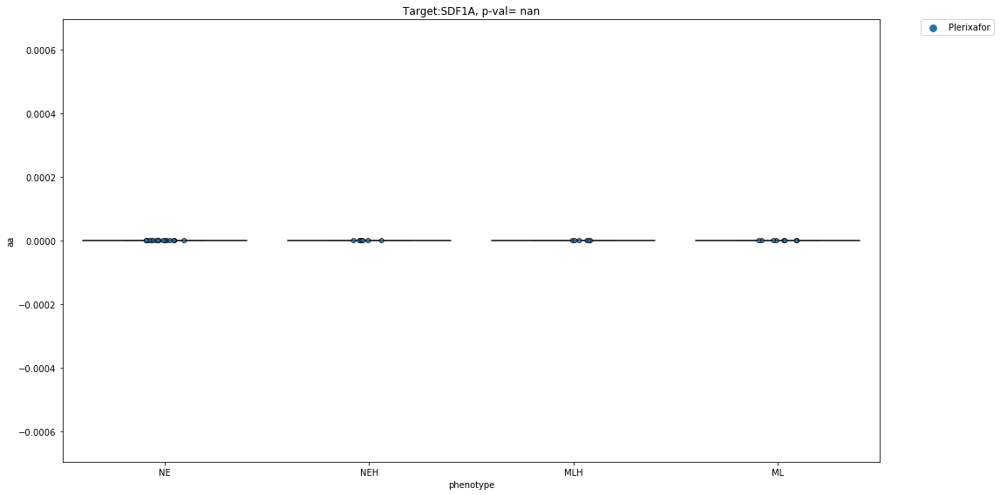

              drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
DMS273     LCL-161  1.567450e-01       NEH     0.0       0.0       0.0
DMS53      LCL-161  1.405541e-02       MLH     0.0       0.0       0.0
DMS79      LCL-161  7.736588e-03        NE     0.0       0.0       0.0
NCIH1048   LCL-161  6.462253e-01        ML     0.0       0.0       0.0
NCIH1341   LCL-161  2.504874e-01        ML     0.0       0.0       0.0
NCIH1876   LCL-161  1.800000e-13        NE     0.0       0.0       0.0
NCIH1930   LCL-161  4.710358e-03        NE     0.0       0.0       0.0
NCIH196    LCL-161  6.736172e-03        ML     0.0       0.0       0.0
NCIH2029   LCL-161  1.391210e-04       MLH     0.0       0.0       0.0
NCIH2066   LCL-161  2.704049e-01        ML     0.0       0.0       0.0
NCIH211    LCL-161  4.756122e-01        ML     0.0       0.0       0.0
NCIH446    LCL-161  1.880000e-08       NEH     0.0       0.0       0.0
NCIH69

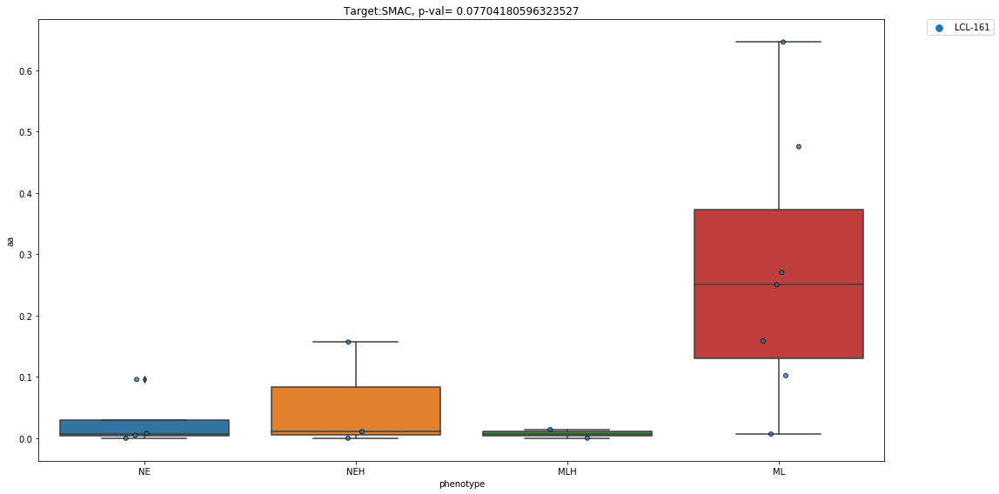

                 drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                
COLO668    LY-2109761  7.391645e-02       MLH     0.0       0.0       0.0
CORL47     LY-2109761  1.470865e-01        NE     0.0       0.0       0.0
DMS53      LY-2109761  1.257308e-01       MLH     0.0       0.0       0.0
NCIH1048   LY-2109761  3.390798e-02        ML     0.0       0.0       0.0
NCIH1341   LY-2109761  3.541981e-03        ML     0.0       0.0       0.0
NCIH196    LY-2109761  1.996561e-03        ML     0.0       0.0       0.0
NCIH2029   LY-2109761  1.159872e-01       MLH     0.0       0.0       0.0
NCIH2066   LY-2109761  4.975252e-02        ML     0.0       0.0       0.0
NCIH211    LY-2109761  7.361890e-02        ML     0.0       0.0       0.0
NCIH2171   LY-2109761  2.493930e-03       NEH     0.0       0.0       0.0
NCIH510    LY-2109761  9.156536e-02       MLH     0.0       0.0       0.0
NCIH526    LY-2109761  3.027413e-01   

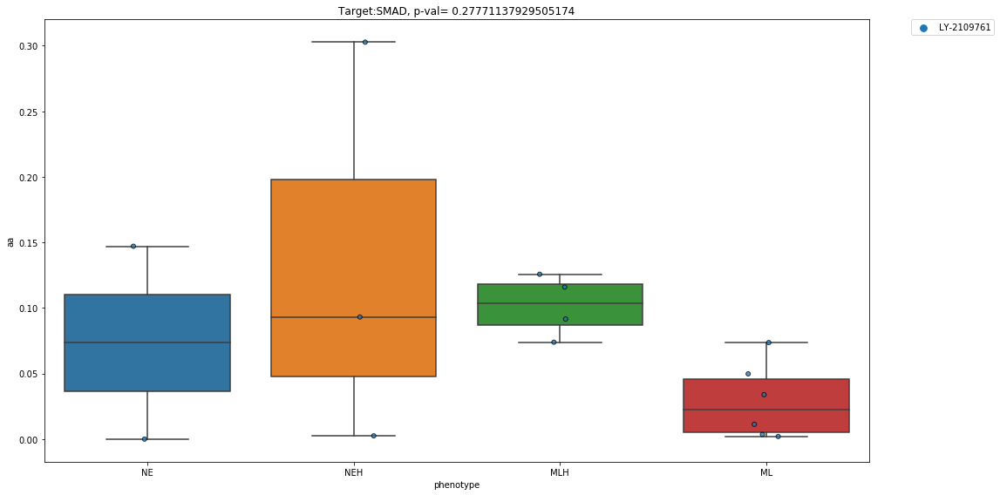

           drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
CORL88     YC-1  8.327821e-01       MLH     0.0       0.0       0.0
DMS273     YC-1  1.252928e-01       NEH     0.0       0.0       0.0
DMS53      YC-1  1.385974e-01       MLH     0.0       0.0       0.0
DMS79      YC-1  4.575105e-03        NE     0.0       0.0       0.0
NCIH1048   YC-1  3.776705e-02        ML     0.0       0.0       0.0
NCIH1092   YC-1  2.108748e-02        NE     0.0       0.0       0.0
NCIH1105   YC-1  6.232240e-04        NE     0.0       0.0       0.0
NCIH1341   YC-1  1.884415e-01        ML     0.0       0.0       0.0
NCIH1436   YC-1  5.767900e-02        NE     0.0       0.0       0.0
NCIH146    YC-1  9.558606e-02        NE     0.0       0.0       0.0
NCIH1618   YC-1  2.366842e-01        NE     0.0       0.0       0.0
NCIH1836   YC-1  4.964524e-03        NE     0.0       0.0       0.0
NCIH1876   YC-1  2.115131e-01        NE     0.0 

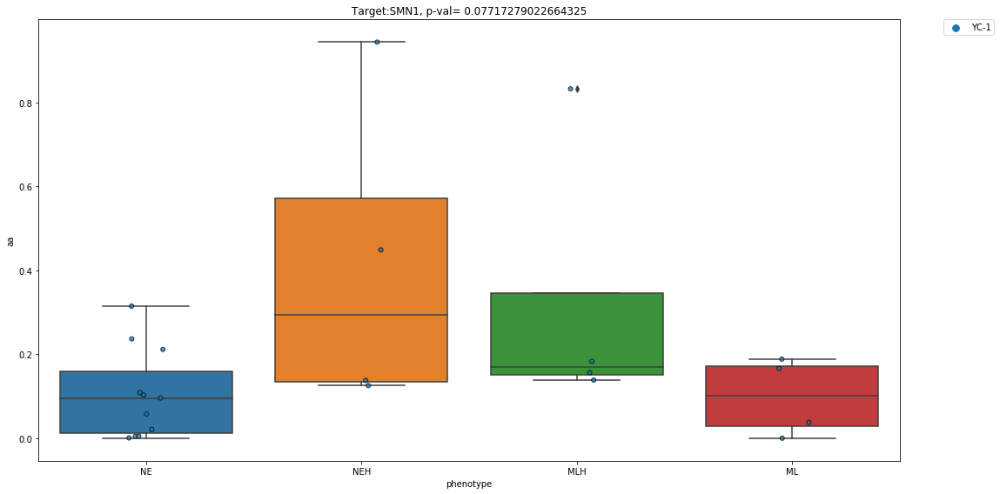

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    IPI-926  0.082411       MLH     0.0       0.0       0.0
DMS114     IPI-926  0.427681        ML     0.0       0.0       0.0
DMS273     IPI-926  0.114694       NEH     0.0       0.0       0.0
DMS53      IPI-926  0.097326       MLH     0.0       0.0       0.0
NCIH1048   IPI-926  0.069113        ML     0.0       0.0       0.0
...            ...       ...       ...     ...       ...       ...
NCIH510    TAK-441  0.180912       MLH     0.0       0.0       0.0
NCIH69     TAK-441  0.011136        NE     0.0       0.0       0.0
NCIH82     TAK-441  0.000359       NEH     0.0       0.0       0.0
SHP77      TAK-441  0.047174       MLH     0.0       0.0       0.0
SW1271     TAK-441  0.052647        ML     0.0       0.0       0.0

[144 rows x 6 columns]
SMO


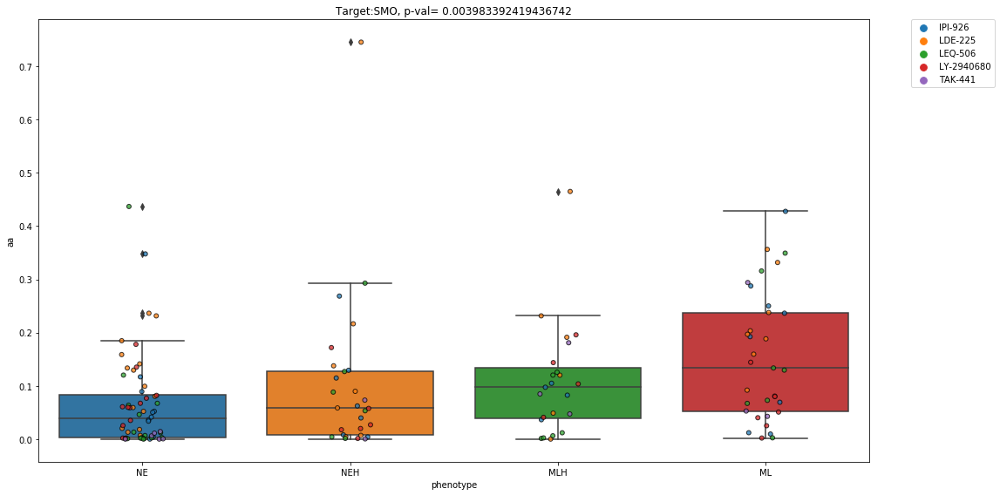

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


              drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                    
COLO668    Digoxin  0.0       MLH     0.0       0.0       0.0
CORL47     Digoxin  0.0        NE     0.0       0.0       0.0
CORL88     Digoxin  0.0       MLH     0.0       0.0       0.0
DMS114     Digoxin  0.0        ML     0.0       0.0       0.0
DMS273     Digoxin  0.0       NEH     0.0       0.0       0.0
DMS53      Digoxin  0.0       MLH     0.0       0.0       0.0
DMS79      Digoxin  0.0        NE     0.0       0.0       0.0
NCIH1048   Digoxin  0.0        ML     0.0       0.0       0.0
NCIH1092   Digoxin  0.0        NE     0.0       0.0       0.0
NCIH1105   Digoxin  0.0        NE     0.0       0.0       0.0
NCIH1341   Digoxin  0.0        ML     0.0       0.0       0.0
NCIH1436   Digoxin  0.0        NE     0.0       0.0       0.0
NCIH146    Digoxin  0.0        NE     0.0       0.0       0.0
NCIH1618   Digoxin  0.0        NE     0.0       0.0       0.0
NCIH1694

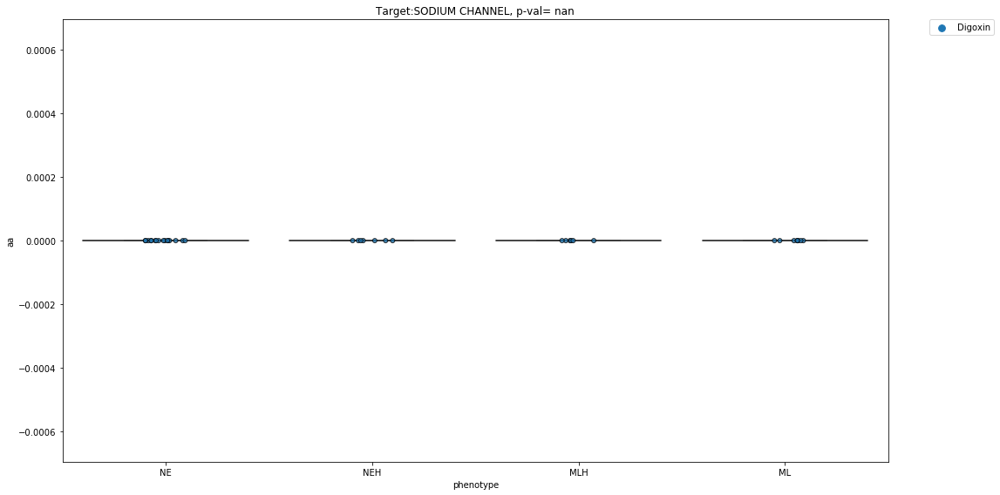

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668    AZD-0530  0.133333       MLH     0.0       0.0       0.0
CORL47     AZD-0530  0.313625        NE     0.0       0.0       0.0
CORL88     AZD-0530  0.199410       MLH     0.0       0.0       0.0
DMS114     AZD-0530  0.426735        ML     0.0       0.0       0.0
DMS273     AZD-0530  0.014852       NEH     0.0       0.0       0.0
...             ...       ...       ...     ...       ...       ...
NCIH82     SR-13654  0.665660       NEH     0.0       0.0       0.0
NCIH841    SR-13654  0.362087        ML     0.0       0.0       0.0
NCIH889    SR-13654  0.166248        NE     0.0       0.0       0.0
SHP77      SR-13654  0.306540       MLH     0.0       0.0       0.0
SW1271     SR-13654  0.664636        ML     0.0       0.0       0.0

[243 rows x 6 columns]
SRC


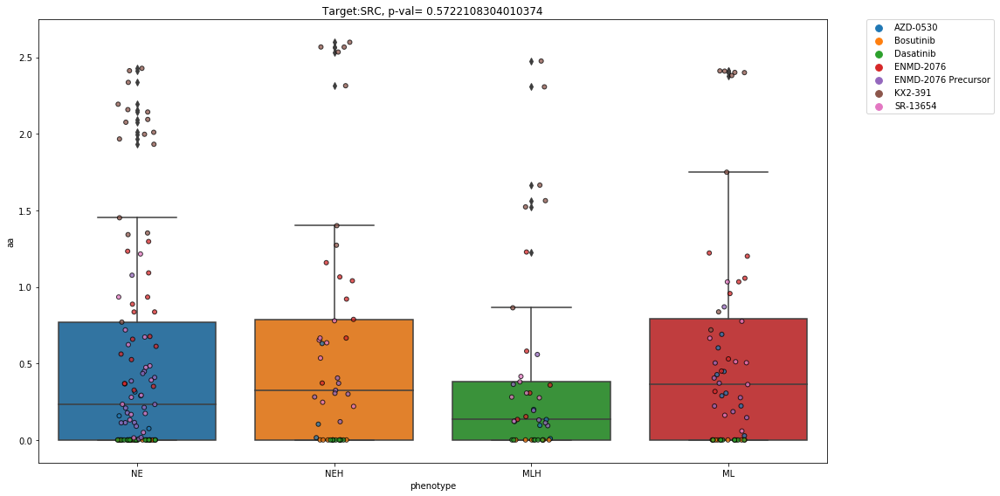

                              drug            aa phenotype  aa_new  hill_new  \
cell.line                                                                      
COLO668                   BP-1-102  2.471863e-01       MLH     0.0       0.0   
CORL88                    BP-1-102  8.879831e-02       MLH     0.0       0.0   
DMS114                    BP-1-102  3.001454e-01        ML     0.0       0.0   
DMS273                    BP-1-102  2.827951e-02       NEH     0.0       0.0   
DMS53                     BP-1-102  1.225719e-01       MLH     0.0       0.0   
DMS79                     BP-1-102  4.625852e-02        NE     0.0       0.0   
NCIH1048                  BP-1-102  8.006678e-01        ML     0.0       0.0   
NCIH1092                  BP-1-102  3.240388e-01        NE     0.0       0.0   
NCIH1105                  BP-1-102  3.838004e-01        NE     0.0       0.0   
NCIH1341                  BP-1-102  4.534217e-02        ML     0.0       0.0   
NCIH1436                  BP-1-102  1.32

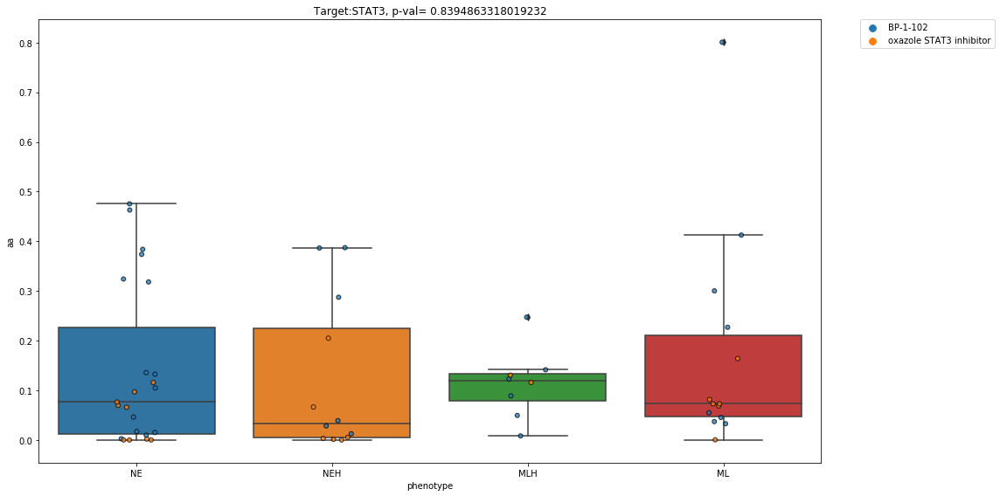

                  drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                 
CORL47      Amifostine  1.744934e-01        NE     0.0       0.0       0.0
DMS114      Amifostine  3.429928e-01        ML     0.0       0.0       0.0
DMS273      Amifostine  8.530917e-03       NEH     0.0       0.0       0.0
DMS53       Amifostine  1.447219e-01       MLH     0.0       0.0       0.0
NCIH1048    Amifostine  1.841657e-01        ML     0.0       0.0       0.0
NCIH1105    Amifostine  2.100000e-09        NE     0.0       0.0       0.0
NCIH1436    Amifostine  4.994958e-01        NE     0.0       0.0       0.0
NCIH146     Amifostine  4.037838e-01        NE     0.0       0.0       0.0
NCIH2066    Amifostine  1.400170e-01        ML     0.0       0.0       0.0
NCIH2081    Amifostine  2.203518e-01        NE     0.0       0.0       0.0
NCIH2141    Amifostine  1.382008e-01        NE     0.0       0.0       0.0
NCIH446     Amifostine  2

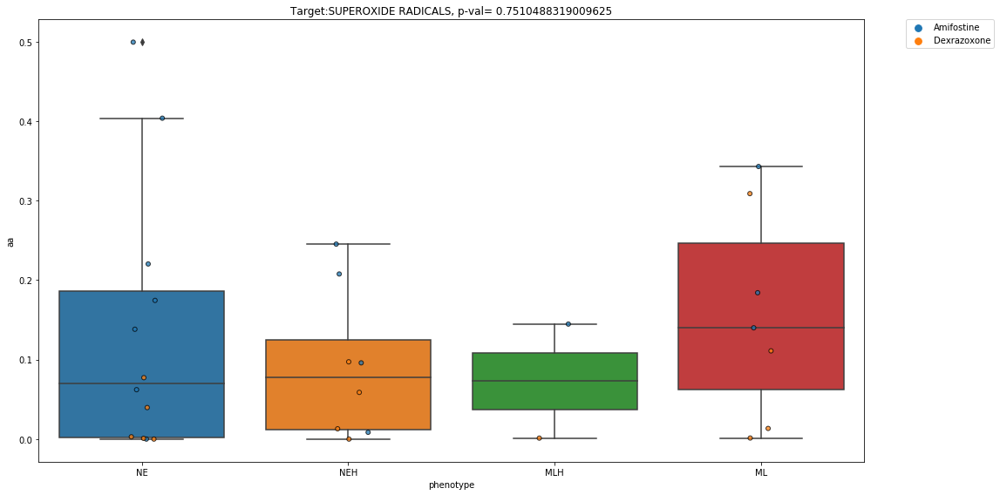

                  drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668    BAY 61-3606  0.285483       MLH     0.0       0.0       0.0
CORL47     BAY 61-3606  0.269874        NE     0.0       0.0       0.0
CORL88     BAY 61-3606  0.233540       MLH     0.0       0.0       0.0
DMS114     BAY 61-3606  0.083058        ML     0.0       0.0       0.0
DMS273     BAY 61-3606  0.215026       NEH     0.0       0.0       0.0
...                ...       ...       ...     ...       ...       ...
NCIH82           R-406  0.109517       NEH     0.0       0.0       0.0
NCIH841          R-406  0.431643        ML     0.0       0.0       0.0
NCIH889          R-406  0.095172        NE     0.0       0.0       0.0
SHP77            R-406  0.044939       MLH     0.0       0.0       0.0
SW1271           R-406  0.424236        ML     0.0       0.0       0.0

[68 rows x 6 columns]
SYK


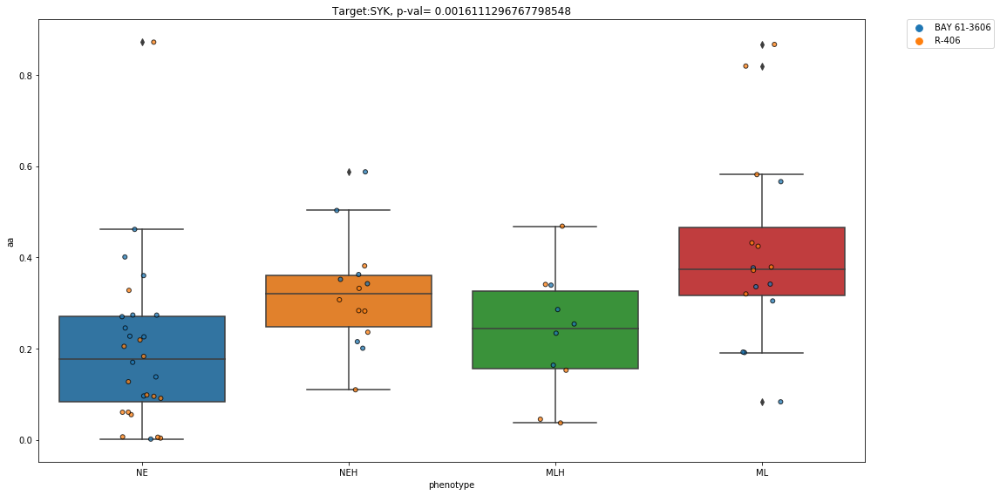

                 drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                            
COLO668    LY-2109761  0.073916       MLH     0.0       0.0       0.0
CORL47     LY-2109761  0.147087        NE     0.0       0.0       0.0
DMS53      LY-2109761  0.125731       MLH     0.0       0.0       0.0
NCIH1048   LY-2109761  0.033908        ML     0.0       0.0       0.0
NCIH1341   LY-2109761  0.003542        ML     0.0       0.0       0.0
...               ...       ...       ...     ...       ...       ...
NCIH82     SB-431542   0.000000       NEH     0.0       0.0       0.0
NCIH841    SB-431542   0.000000        ML     0.0       0.0       0.0
NCIH889    SB-431542   0.000000        NE     0.0       0.0       0.0
SHP77      SB-431542   0.000000       MLH     0.0       0.0       0.0
SW1271     SB-431542   0.000000        ML     0.0       0.0       0.0

[65 rows x 6 columns]
TGF-B


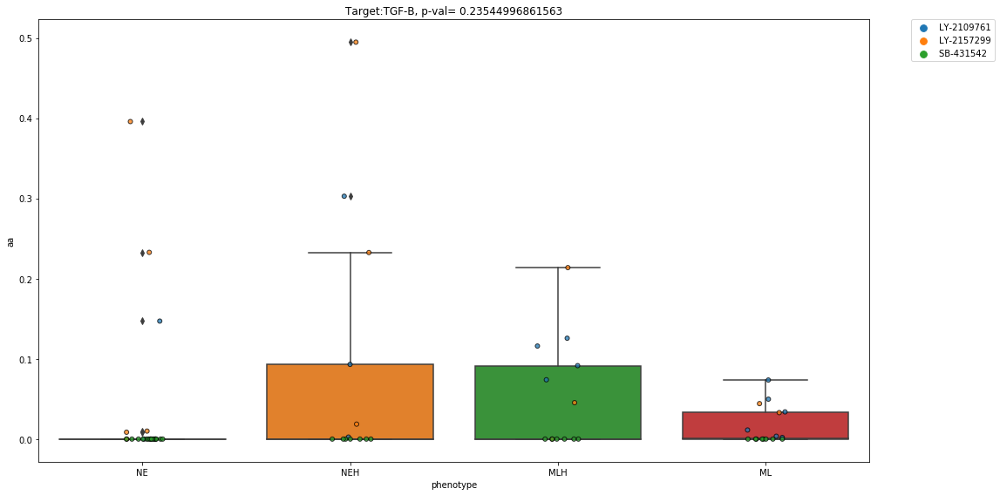

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                   drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    Cabozantinib  0.0       MLH     0.0       0.0       0.0
CORL47     Cabozantinib  0.0        NE     0.0       0.0       0.0
CORL88     Cabozantinib  0.0       MLH     0.0       0.0       0.0
DMS114     Cabozantinib  0.0        ML     0.0       0.0       0.0
DMS273     Cabozantinib  0.0       NEH     0.0       0.0       0.0
DMS53      Cabozantinib  0.0       MLH     0.0       0.0       0.0
DMS79      Cabozantinib  0.0        NE     0.0       0.0       0.0
NCIH1048   Cabozantinib  0.0        ML     0.0       0.0       0.0
NCIH1092   Cabozantinib  0.0        NE     0.0       0.0       0.0
NCIH1105   Cabozantinib  0.0        NE     0.0       0.0       0.0
NCIH1341   Cabozantinib  0.0        ML     0.0       0.0       0.0
NCIH1436   Cabozantinib  0.0        NE     0.0       0.0       0.0
NCIH146    Cabozantinib  0.0        NE     0.0       0.0      

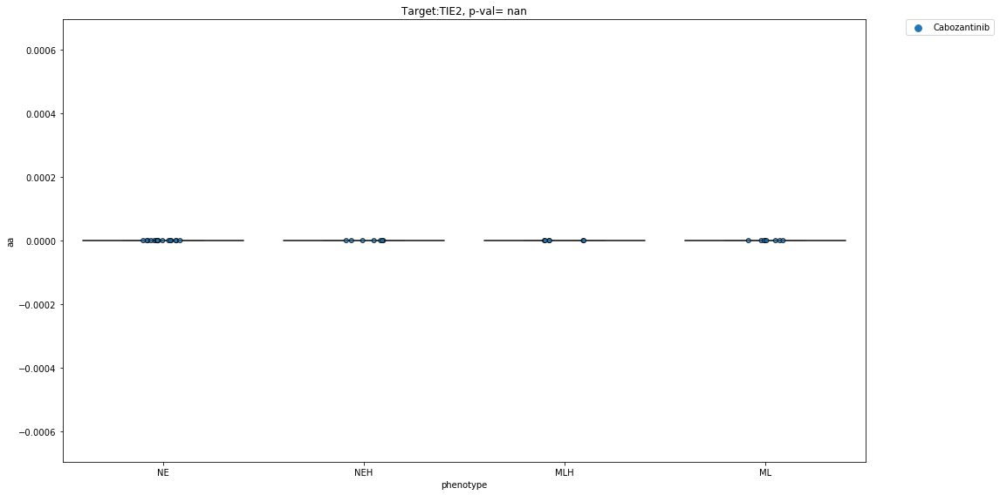

                drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                               
COLO668    Imiquimod  0.000000e+00       MLH     0.0       0.0       0.0
CORL47     Imiquimod  0.000000e+00        NE     0.0       0.0       0.0
CORL88     Imiquimod  0.000000e+00       MLH     0.0       0.0       0.0
DMS114     Imiquimod  0.000000e+00        ML     0.0       0.0       0.0
DMS273     Imiquimod  0.000000e+00       NEH     0.0       0.0       0.0
DMS53      Imiquimod  0.000000e+00       MLH     0.0       0.0       0.0
DMS79      Imiquimod  0.000000e+00        NE     0.0       0.0       0.0
NCIH1048   Imiquimod  0.000000e+00        ML     0.0       0.0       0.0
NCIH1092   Imiquimod  0.000000e+00        NE     0.0       0.0       0.0
NCIH1105   Imiquimod  0.000000e+00        NE     0.0       0.0       0.0
NCIH1341   Imiquimod  0.000000e+00        ML     0.0       0.0       0.0
NCIH1436   Imiquimod  0.000000e+00        NE     0.

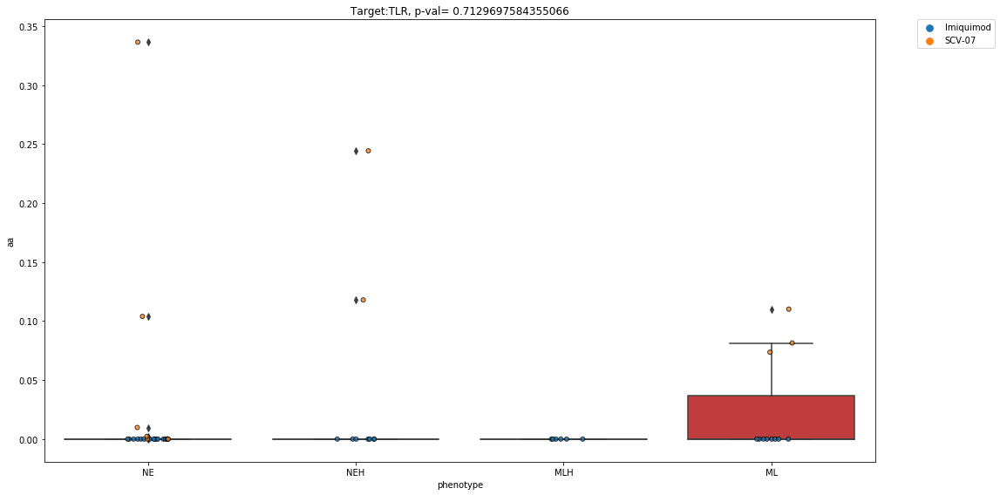

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                      
COLO668    Imiquimod  0.0       MLH     0.0       0.0       0.0
CORL47     Imiquimod  0.0        NE     0.0       0.0       0.0
CORL88     Imiquimod  0.0       MLH     0.0       0.0       0.0
DMS114     Imiquimod  0.0        ML     0.0       0.0       0.0
DMS273     Imiquimod  0.0       NEH     0.0       0.0       0.0
DMS53      Imiquimod  0.0       MLH     0.0       0.0       0.0
DMS79      Imiquimod  0.0        NE     0.0       0.0       0.0
NCIH1048   Imiquimod  0.0        ML     0.0       0.0       0.0
NCIH1092   Imiquimod  0.0        NE     0.0       0.0       0.0
NCIH1105   Imiquimod  0.0        NE     0.0       0.0       0.0
NCIH1341   Imiquimod  0.0        ML     0.0       0.0       0.0
NCIH1436   Imiquimod  0.0        NE     0.0       0.0       0.0
NCIH146    Imiquimod  0.0        NE     0.0       0.0       0.0
NCIH1618   Imiquimod  0.0        NE     

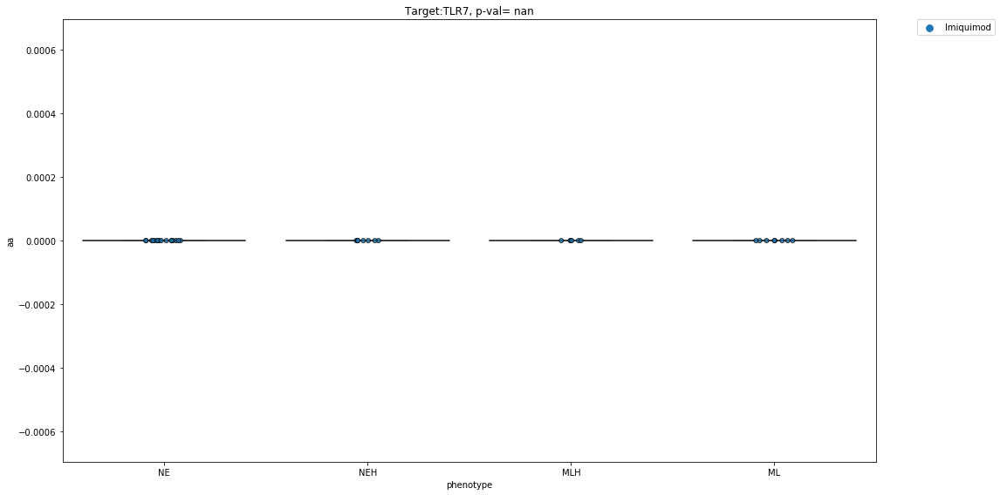

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                   drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    Lenalidomide  0.0       MLH     0.0       0.0       0.0
CORL47     Lenalidomide  0.0        NE     0.0       0.0       0.0
CORL88     Lenalidomide  0.0       MLH     0.0       0.0       0.0
DMS114     Lenalidomide  0.0        ML     0.0       0.0       0.0
DMS273     Lenalidomide  0.0       NEH     0.0       0.0       0.0
DMS53      Lenalidomide  0.0       MLH     0.0       0.0       0.0
DMS79      Lenalidomide  0.0        NE     0.0       0.0       0.0
NCIH1048   Lenalidomide  0.0        ML     0.0       0.0       0.0
NCIH1092   Lenalidomide  0.0        NE     0.0       0.0       0.0
NCIH1105   Lenalidomide  0.0        NE     0.0       0.0       0.0
NCIH1341   Lenalidomide  0.0        ML     0.0       0.0       0.0
NCIH1436   Lenalidomide  0.0        NE     0.0       0.0       0.0
NCIH146    Lenalidomide  0.0        NE     0.0       0.0      

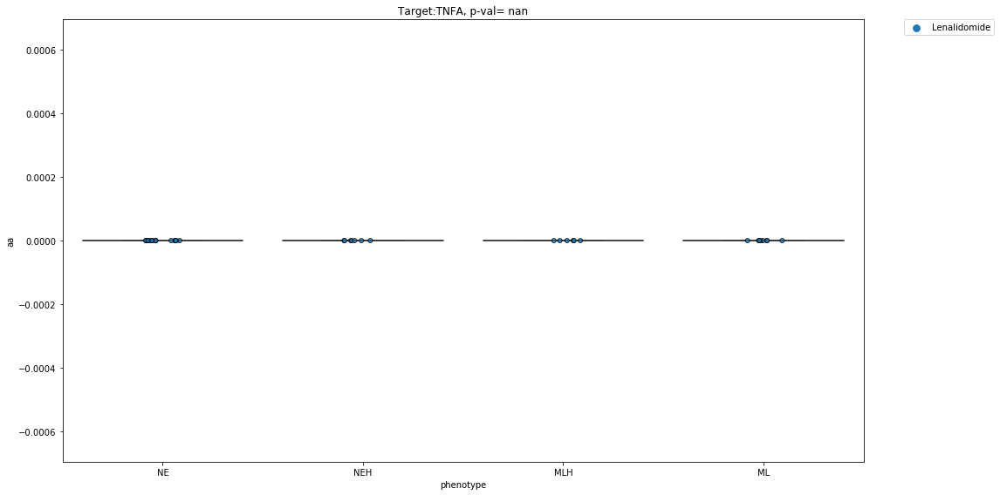

                                     drug        aa phenotype  aa_new  \
cell.line                                                               
CORL47     7-Ethyl-10-hydroxycamptothecin  2.004373        NE     0.0   
CORL88     7-Ethyl-10-hydroxycamptothecin  2.393699       MLH     0.0   
DMS114     7-Ethyl-10-hydroxycamptothecin  3.117791        ML     0.0   
DMS273     7-Ethyl-10-hydroxycamptothecin  2.429499       NEH     0.0   
DMS53      7-Ethyl-10-hydroxycamptothecin  2.627949       MLH     0.0   
...                                   ...       ...       ...     ...   
NCIH82                            XR-5944  2.411101       NEH     0.0   
NCIH841                           XR-5944  1.813102        ML     0.0   
NCIH889                           XR-5944  0.788446        NE     0.0   
SHP77                             XR-5944  0.710289       MLH     0.0   
SW1271                            XR-5944  1.556000        ML     0.0   

           hill_new  emax_new  
cell.line         

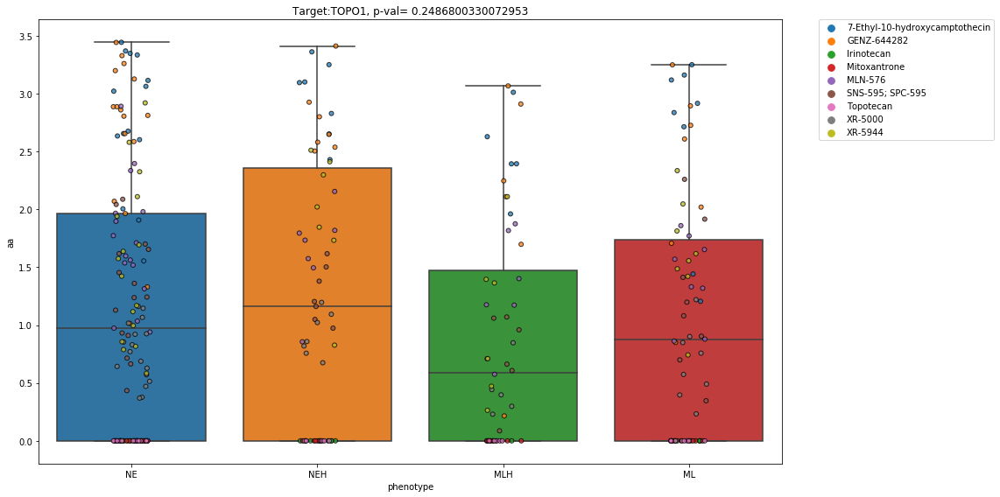

                   drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
COLO668    Daunorubicin  0.000000       MLH     0.0       0.0       0.0
CORL47     Daunorubicin  0.000000        NE     0.0       0.0       0.0
CORL88     Daunorubicin  0.000000       MLH     0.0       0.0       0.0
DMS114     Daunorubicin  0.000000        ML     0.0       0.0       0.0
DMS273     Daunorubicin  0.000000       NEH     0.0       0.0       0.0
...                 ...       ...       ...     ...       ...       ...
NCIH82          XR-5944  2.411101       NEH     0.0       0.0       0.0
NCIH841         XR-5944  1.813102        ML     0.0       0.0       0.0
NCIH889         XR-5944  0.788446        NE     0.0       0.0       0.0
SHP77           XR-5944  0.710289       MLH     0.0       0.0       0.0
SW1271          XR-5944  1.556000        ML     0.0       0.0       0.0

[470 rows x 6 columns]
TOPO2


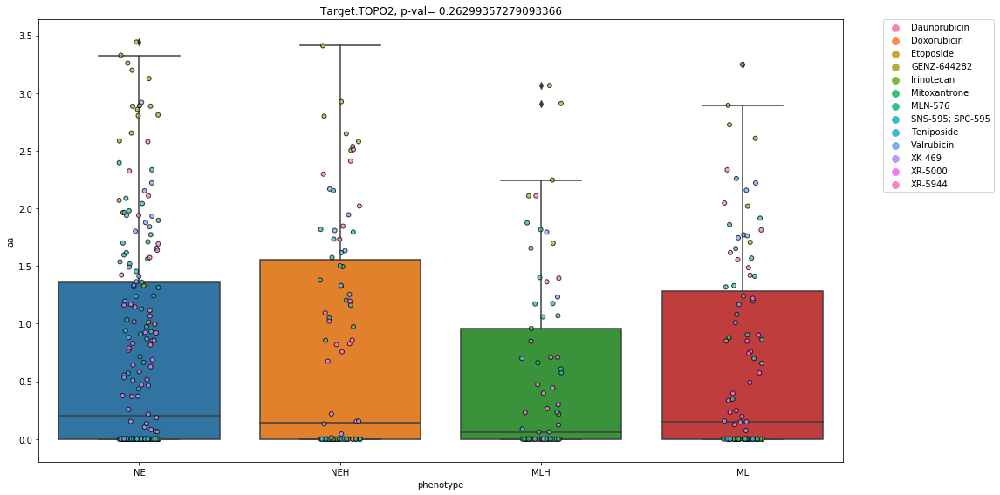

               drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
COLO668    Riluzole  4.980000e-11       MLH     0.0       0.0       0.0
CORL47     Riluzole  6.771490e-04        NE     0.0       0.0       0.0
CORL88     Riluzole  4.334314e-02       MLH     0.0       0.0       0.0
DMS114     Riluzole  5.731791e-02        ML     0.0       0.0       0.0
DMS273     Riluzole  3.113828e-01       NEH     0.0       0.0       0.0
DMS53      Riluzole  1.395497e-01       MLH     0.0       0.0       0.0
DMS79      Riluzole  9.159346e-02        NE     0.0       0.0       0.0
NCIH1048   Riluzole  6.508942e-02        ML     0.0       0.0       0.0
NCIH1092   Riluzole  7.888803e-03        NE     0.0       0.0       0.0
NCIH1341   Riluzole  3.054759e-03        ML     0.0       0.0       0.0
NCIH146    Riluzole  1.329929e-01        NE     0.0       0.0       0.0
NCIH1694   Riluzole  4.650000e-09       NEH     0.0       0.0   

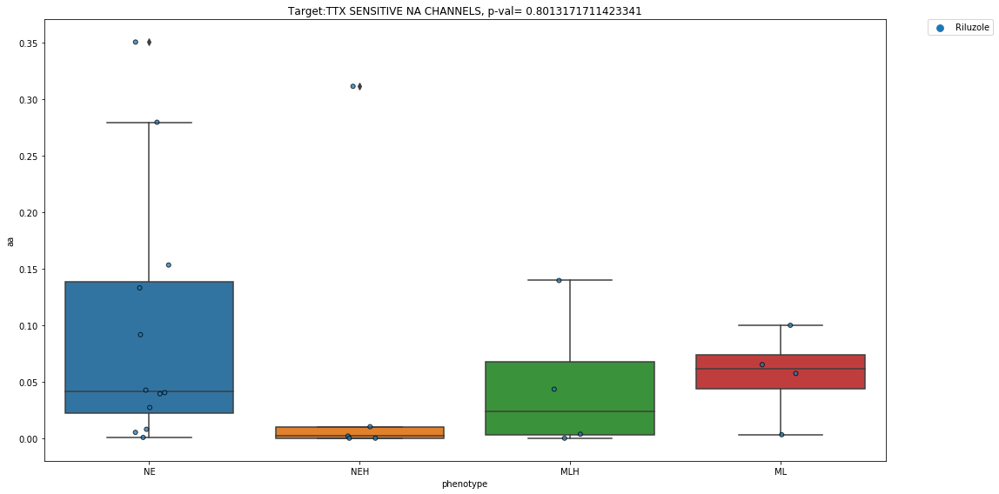

                  drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668     BAL-101553  2.060327       MLH     0.0       0.0       0.0
CORL47      BAL-101553  1.454588        NE     0.0       0.0       0.0
CORL88      BAL-101553  1.550649       MLH     0.0       0.0       0.0
DMS114      BAL-101553  2.806514        ML     0.0       0.0       0.0
DMS273      BAL-101553  2.308883       NEH     0.0       0.0       0.0
...                ...       ...       ...     ...       ...       ...
NCIH82     Vinorelbine  0.000000       NEH     0.0       0.0       0.0
NCIH841    Vinorelbine  0.000000        ML     0.0       0.0       0.0
NCIH889    Vinorelbine  0.000000        NE     0.0       0.0       0.0
SHP77      Vinorelbine  0.000000       MLH     0.0       0.0       0.0
SW1271     Vinorelbine  0.000000        ML     0.0       0.0       0.0

[428 rows x 6 columns]
TUBULIN


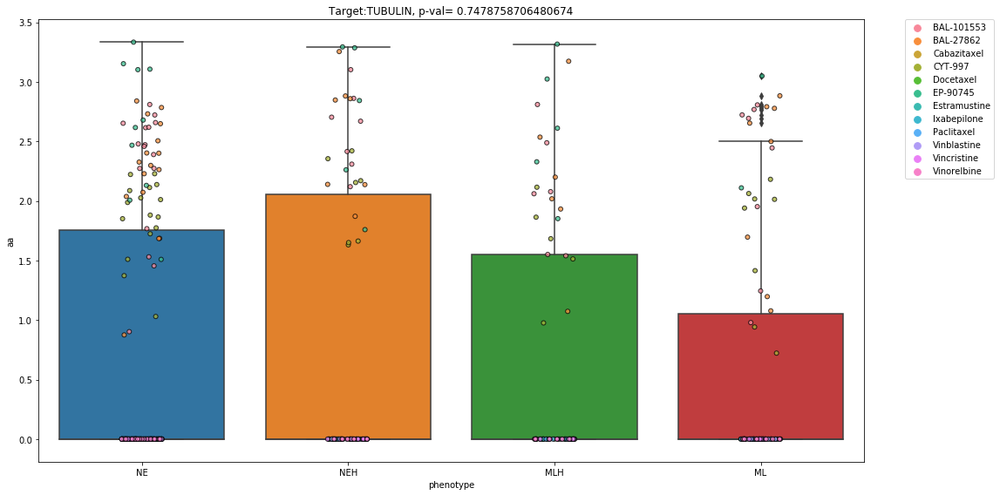

                  drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                             
COLO668    Gemcitabine  0.000000       MLH     0.0       0.0       0.0
CORL47     Gemcitabine  0.000000        NE     0.0       0.0       0.0
CORL88     Gemcitabine  0.000000       MLH     0.0       0.0       0.0
DMS114     Gemcitabine  0.000000        ML     0.0       0.0       0.0
DMS273     Gemcitabine  0.000000       NEH     0.0       0.0       0.0
...                ...       ...       ...     ...       ...       ...
NCIH82         ZD-1694  2.295416       NEH     0.0       0.0       0.0
NCIH841        ZD-1694  0.922521        ML     0.0       0.0       0.0
NCIH889        ZD-1694  0.825824        NE     0.0       0.0       0.0
SHP77          ZD-1694  1.461975       MLH     0.0       0.0       0.0
SW1271         ZD-1694  0.755736        ML     0.0       0.0       0.0

[141 rows x 6 columns]
TYMS


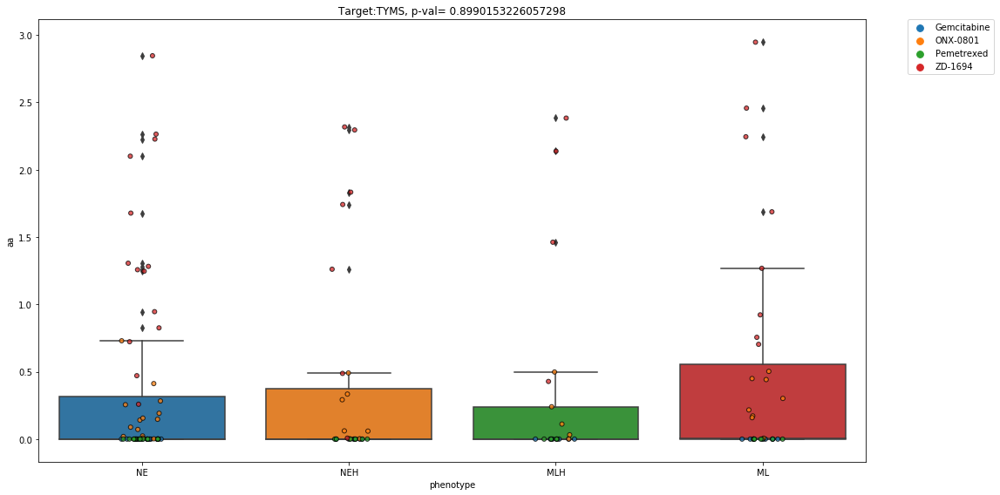

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                  drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                        
COLO668    Ixabepilone  0.0       MLH     0.0       0.0       0.0
CORL47     Ixabepilone  0.0        NE     0.0       0.0       0.0
CORL88     Ixabepilone  0.0       MLH     0.0       0.0       0.0
DMS114     Ixabepilone  0.0        ML     0.0       0.0       0.0
DMS273     Ixabepilone  0.0       NEH     0.0       0.0       0.0
DMS53      Ixabepilone  0.0       MLH     0.0       0.0       0.0
DMS79      Ixabepilone  0.0        NE     0.0       0.0       0.0
NCIH1048   Ixabepilone  0.0        ML     0.0       0.0       0.0
NCIH1092   Ixabepilone  0.0        NE     0.0       0.0       0.0
NCIH1105   Ixabepilone  0.0        NE     0.0       0.0       0.0
NCIH1341   Ixabepilone  0.0        ML     0.0       0.0       0.0
NCIH1436   Ixabepilone  0.0        NE     0.0       0.0       0.0
NCIH146    Ixabepilone  0.0        NE     0.0       0.0       0.0
NCIH1618  

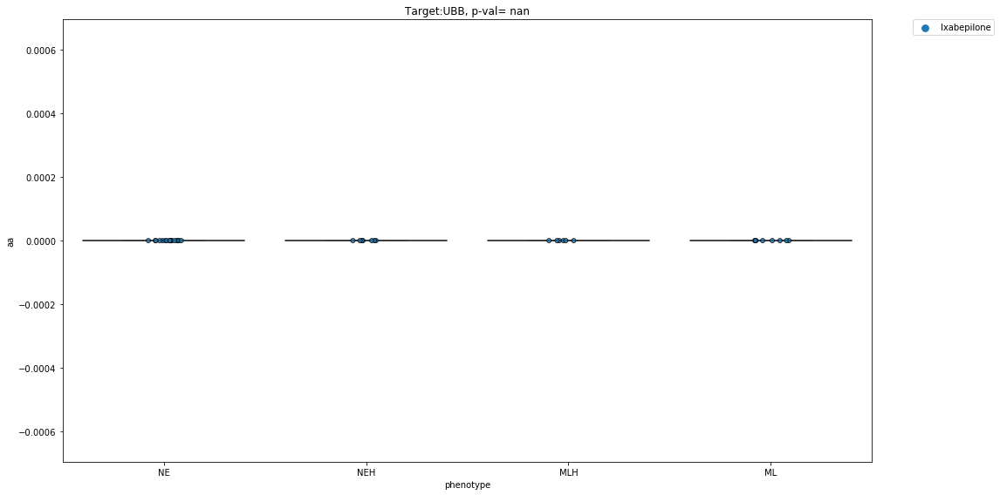

                    drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                   
CORL47     Agios Cmp 301  1.800000e-10        NE     0.0       0.0       0.0
DMS53      Agios Cmp 301  5.453858e-02       MLH     0.0       0.0       0.0
NCIH1048   Agios Cmp 301  3.550000e-18        ML     0.0       0.0       0.0
NCIH1092   Agios Cmp 301  0.000000e+00        NE     0.0       0.0       0.0
NCIH1105   Agios Cmp 301  9.491652e-03        NE     0.0       0.0       0.0
...                  ...           ...       ...     ...       ...       ...
NCIH82       Thalidomide  0.000000e+00       NEH     0.0       0.0       0.0
NCIH841      Thalidomide  0.000000e+00        ML     0.0       0.0       0.0
NCIH889      Thalidomide  0.000000e+00        NE     0.0       0.0       0.0
SHP77        Thalidomide  0.000000e+00       MLH     0.0       0.0       0.0
SW1271       Thalidomide  0.000000e+00        ML     0.0       0.0       0.0

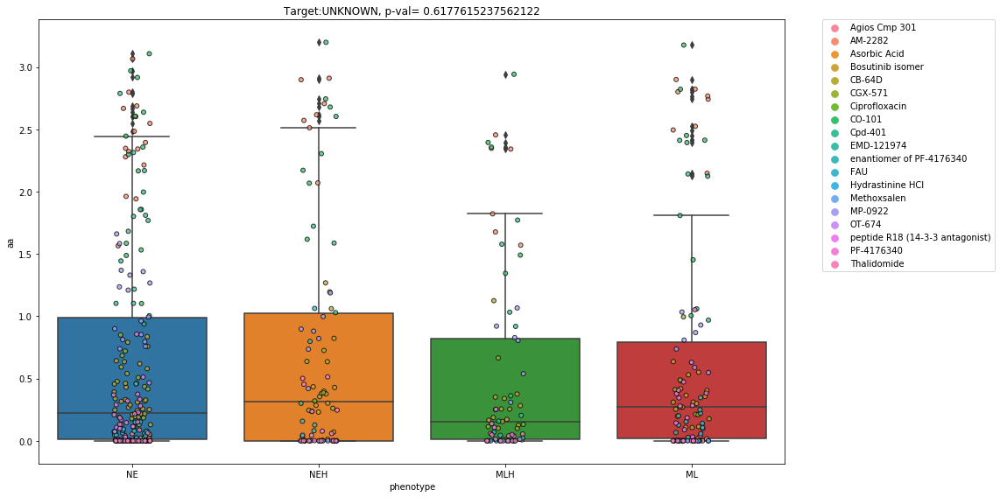

                  drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                 
COLO668    Oxonic Acid  1.140000e-10       MLH     0.0       0.0       0.0
CORL47     Oxonic Acid  2.930000e-09        NE     0.0       0.0       0.0
DMS114     Oxonic Acid  3.830100e-01        ML     0.0       0.0       0.0
DMS273     Oxonic Acid  4.824322e-02       NEH     0.0       0.0       0.0
DMS53      Oxonic Acid  2.753657e-02       MLH     0.0       0.0       0.0
NCIH1048   Oxonic Acid  2.008950e-02        ML     0.0       0.0       0.0
NCIH1105   Oxonic Acid  3.965944e-02        NE     0.0       0.0       0.0
NCIH1436   Oxonic Acid  5.492220e-04        NE     0.0       0.0       0.0
NCIH146    Oxonic Acid  4.570000e-10        NE     0.0       0.0       0.0
NCIH1876   Oxonic Acid  1.587590e-03        NE     0.0       0.0       0.0
NCIH2029   Oxonic Acid  7.264311e-02       MLH     0.0       0.0       0.0
NCIH2066   Oxonic Acid  2

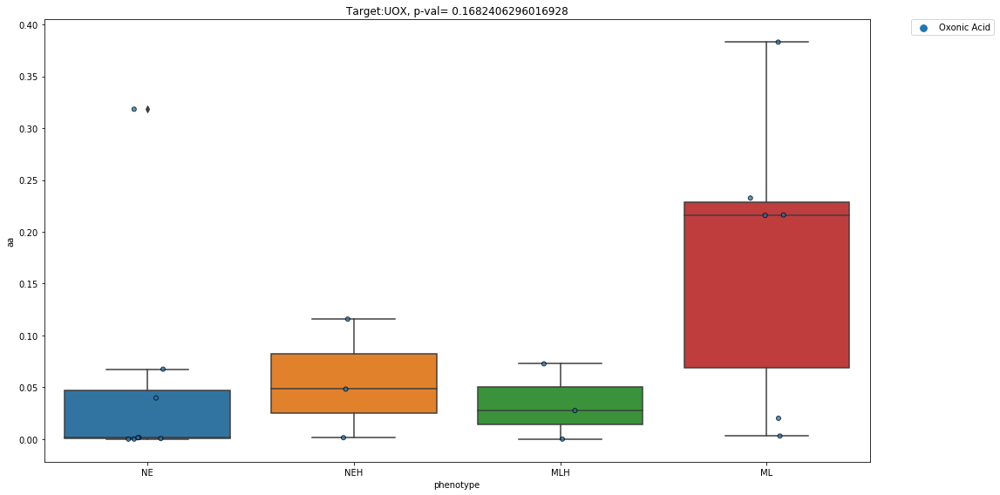

                   drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
DMS114          AMG-706  0.139837        ML     0.0       0.0       0.0
DMS273          AMG-706  0.168911       NEH     0.0       0.0       0.0
DMS53           AMG-706  0.246281       MLH     0.0       0.0       0.0
NCIH1048        AMG-706  0.103611        ML     0.0       0.0       0.0
NCIH1105        AMG-706  0.016054        NE     0.0       0.0       0.0
...                 ...       ...       ...     ...       ...       ...
NCIH82     Lenalidomide  0.000000       NEH     0.0       0.0       0.0
NCIH841    Lenalidomide  0.000000        ML     0.0       0.0       0.0
NCIH889    Lenalidomide  0.000000        NE     0.0       0.0       0.0
SHP77      Lenalidomide  0.000000       MLH     0.0       0.0       0.0
SW1271     Lenalidomide  0.000000        ML     0.0       0.0       0.0

[62 rows x 6 columns]
VEGF


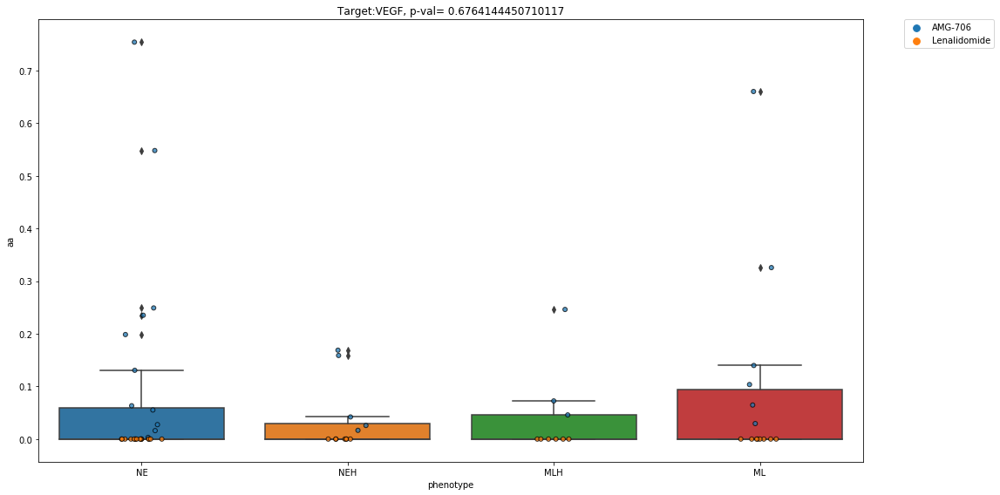

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668     ABT-348  0.922358       MLH     0.0       0.0       0.0
CORL47      ABT-348  2.218881        NE     0.0       0.0       0.0
CORL88      ABT-348  0.278810       MLH     0.0       0.0       0.0
DMS114      ABT-348  1.366754        ML     0.0       0.0       0.0
DMS273      ABT-348  1.115654       NEH     0.0       0.0       0.0
...             ...       ...       ...     ...       ...       ...
NCIH82     YN-968D1  0.052026       NEH     0.0       0.0       0.0
NCIH841    YN-968D1  0.003583        ML     0.0       0.0       0.0
NCIH889    YN-968D1  0.051208        NE     0.0       0.0       0.0
SHP77      YN-968D1  0.002676       MLH     0.0       0.0       0.0
SW1271     YN-968D1  0.393275        ML     0.0       0.0       0.0

[1012 rows x 6 columns]
VEGFR


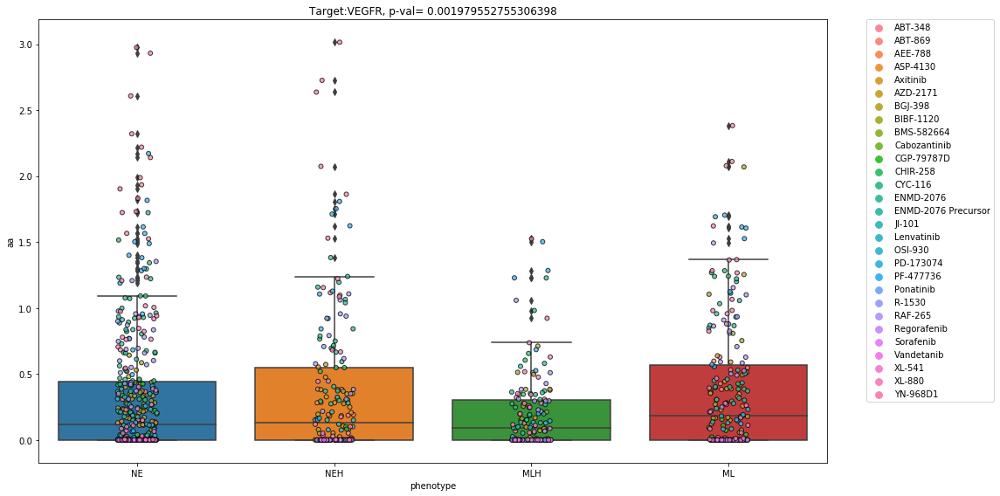

               drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                              
COLO668    Warfarin  8.596857e-03       MLH     0.0       0.0       0.0
NCIH1105   Warfarin  6.860000e-10        NE     0.0       0.0       0.0
NCIH1930   Warfarin  9.492350e-04        NE     0.0       0.0       0.0
NCIH196    Warfarin  1.167069e-01        ML     0.0       0.0       0.0
NCIH211    Warfarin  6.657514e-02        ML     0.0       0.0       0.0
NCIH446    Warfarin  4.486020e-04       NEH     0.0       0.0       0.0
NCIH510    Warfarin  9.369617e-02       MLH     0.0       0.0       0.0
NCIH889    Warfarin  1.171336e-01        NE     0.0       0.0       0.0
VKORC1


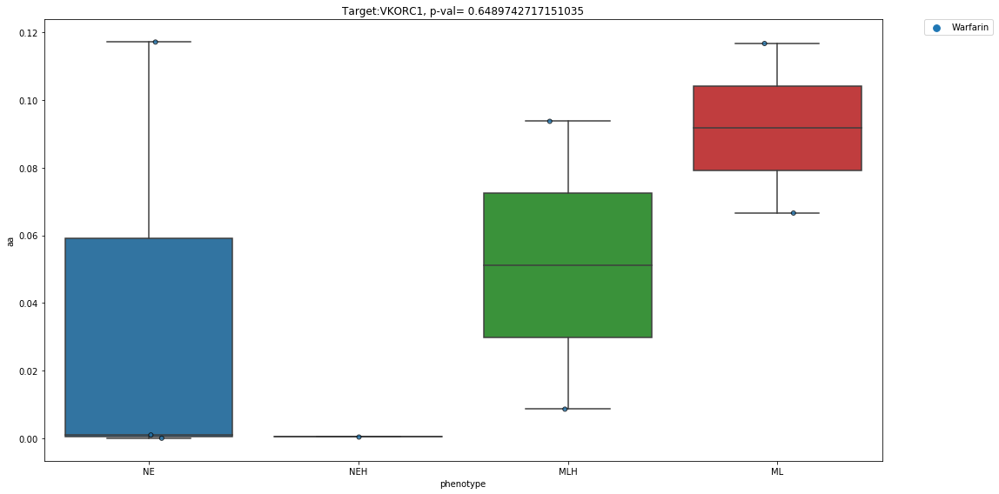

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                 drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                       
COLO668    Gabapentin  0.0       MLH     0.0       0.0       0.0
CORL47     Gabapentin  0.0        NE     0.0       0.0       0.0
CORL88     Gabapentin  0.0       MLH     0.0       0.0       0.0
DMS114     Gabapentin  0.0        ML     0.0       0.0       0.0
DMS273     Gabapentin  0.0       NEH     0.0       0.0       0.0
DMS53      Gabapentin  0.0       MLH     0.0       0.0       0.0
DMS79      Gabapentin  0.0        NE     0.0       0.0       0.0
NCIH1048   Gabapentin  0.0        ML     0.0       0.0       0.0
NCIH1092   Gabapentin  0.0        NE     0.0       0.0       0.0
NCIH1105   Gabapentin  0.0        NE     0.0       0.0       0.0
NCIH1341   Gabapentin  0.0        ML     0.0       0.0       0.0
NCIH1436   Gabapentin  0.0        NE     0.0       0.0       0.0
NCIH146    Gabapentin  0.0        NE     0.0       0.0       0.0
NCIH1618   Gabapentin  0.

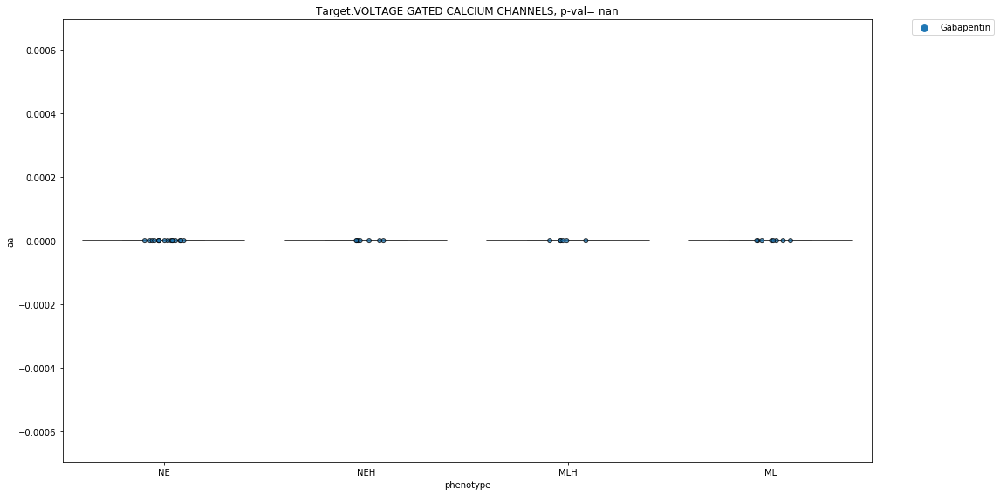

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


               drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                     
COLO668    MK-1775   0.0       MLH     0.0       0.0       0.0
CORL47     MK-1775   0.0        NE     0.0       0.0       0.0
CORL88     MK-1775   0.0       MLH     0.0       0.0       0.0
DMS114     MK-1775   0.0        ML     0.0       0.0       0.0
DMS273     MK-1775   0.0       NEH     0.0       0.0       0.0
DMS53      MK-1775   0.0       MLH     0.0       0.0       0.0
DMS79      MK-1775   0.0        NE     0.0       0.0       0.0
NCIH1048   MK-1775   0.0        ML     0.0       0.0       0.0
NCIH1092   MK-1775   0.0        NE     0.0       0.0       0.0
NCIH1105   MK-1775   0.0        NE     0.0       0.0       0.0
NCIH1341   MK-1775   0.0        ML     0.0       0.0       0.0
NCIH1436   MK-1775   0.0        NE     0.0       0.0       0.0
NCIH146    MK-1775   0.0        NE     0.0       0.0       0.0
NCIH1618   MK-1775   0.0        NE     0.0       0.0   

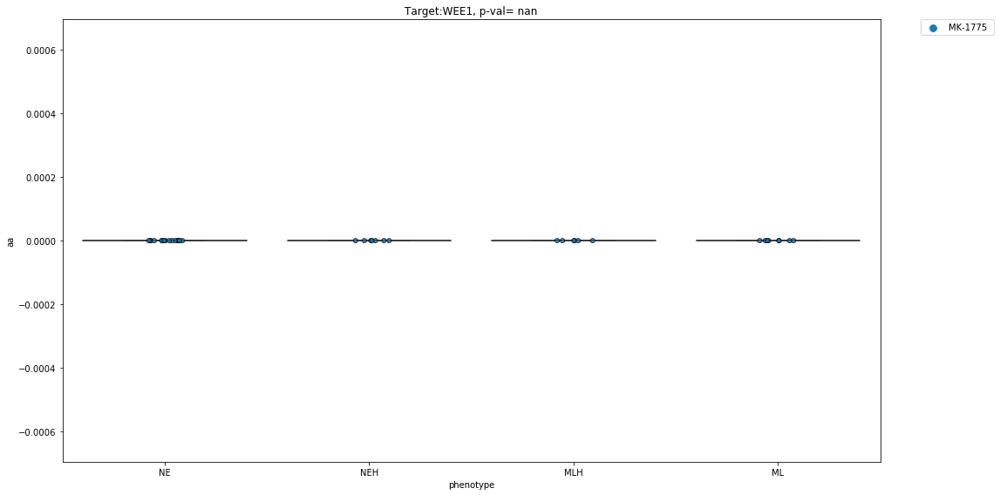

               drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                          
COLO668     ICG-001  0.189833       MLH     0.0       0.0       0.0
CORL47      ICG-001  0.191592        NE     0.0       0.0       0.0
CORL88      ICG-001  0.288807       MLH     0.0       0.0       0.0
DMS114      ICG-001  0.372694        ML     0.0       0.0       0.0
DMS273      ICG-001  0.015195       NEH     0.0       0.0       0.0
...             ...       ...       ...     ...       ...       ...
NCIH82     XAV-939   0.000000       NEH     0.0       0.0       0.0
NCIH841    XAV-939   0.000000        ML     0.0       0.0       0.0
NCIH889    XAV-939   0.000000        NE     0.0       0.0       0.0
SHP77      XAV-939   0.000000       MLH     0.0       0.0       0.0
SW1271     XAV-939   0.000000        ML     0.0       0.0       0.0

[156 rows x 6 columns]
WNT


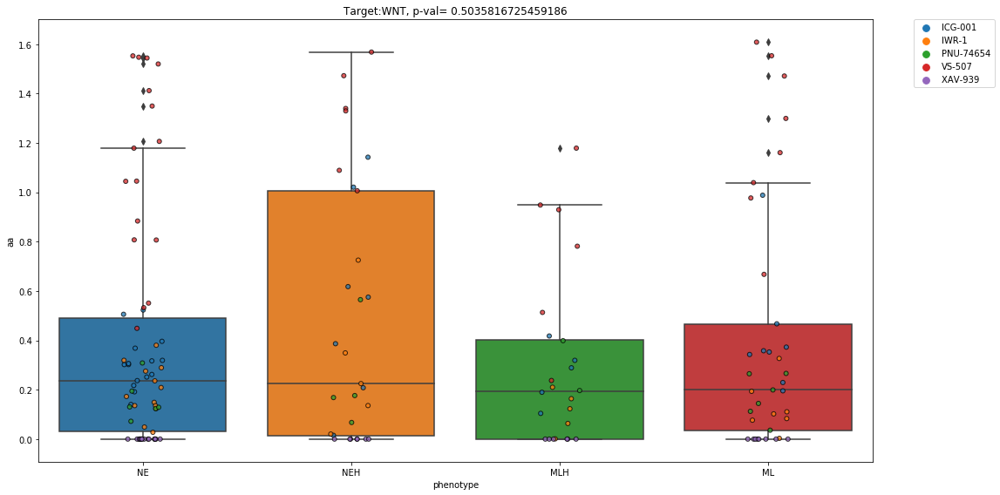

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                 drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                       
COLO668    AEG-40730   0.0       MLH     0.0       0.0       0.0
CORL47     AEG-40730   0.0        NE     0.0       0.0       0.0
CORL88     AEG-40730   0.0       MLH     0.0       0.0       0.0
DMS114     AEG-40730   0.0        ML     0.0       0.0       0.0
DMS273     AEG-40730   0.0       NEH     0.0       0.0       0.0
DMS53      AEG-40730   0.0       MLH     0.0       0.0       0.0
DMS79      AEG-40730   0.0        NE     0.0       0.0       0.0
NCIH1048   AEG-40730   0.0        ML     0.0       0.0       0.0
NCIH1092   AEG-40730   0.0        NE     0.0       0.0       0.0
NCIH1105   AEG-40730   0.0        NE     0.0       0.0       0.0
NCIH1341   AEG-40730   0.0        ML     0.0       0.0       0.0
NCIH1436   AEG-40730   0.0        NE     0.0       0.0       0.0
NCIH146    AEG-40730   0.0        NE     0.0       0.0       0.0
NCIH1618   AEG-40730   0.

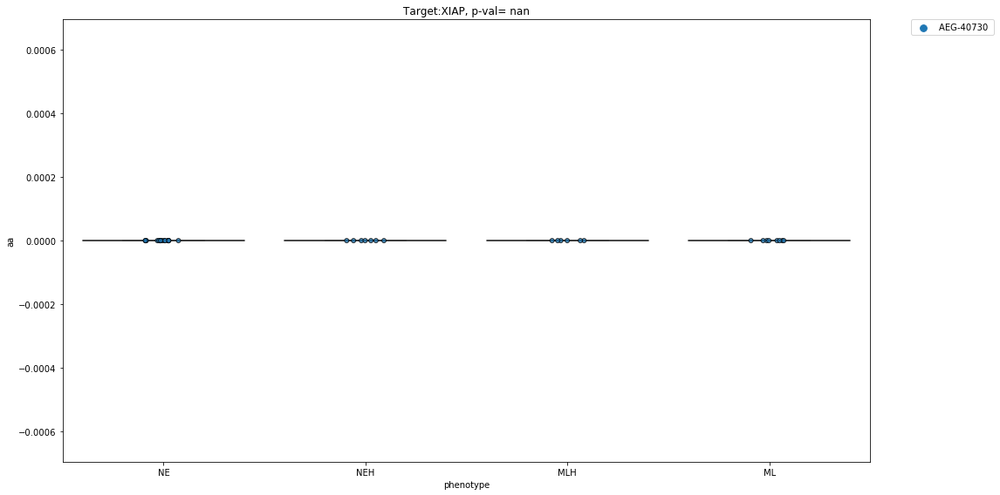

                  drug            aa phenotype  aa_new  hill_new  emax_new
cell.line                                                                 
NCIH1105   Allopurinol  6.040000e-11        NE     0.0       0.0       0.0
NCIH146    Allopurinol  4.689065e-02        NE     0.0       0.0       0.0
NCIH1618   Allopurinol  1.895079e-03        NE     0.0       0.0       0.0
NCIH1836   Allopurinol  1.845241e-02        NE     0.0       0.0       0.0
NCIH1963   Allopurinol  3.781295e-02        NE     0.0       0.0       0.0
NCIH2066   Allopurinol  3.990258e-01        ML     0.0       0.0       0.0
XO


/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3612: F_onewayBadInputSizesWarning: at least one input has length 0
  warnings.warn(F_onewayBadInputSizesWarning('at least one input '


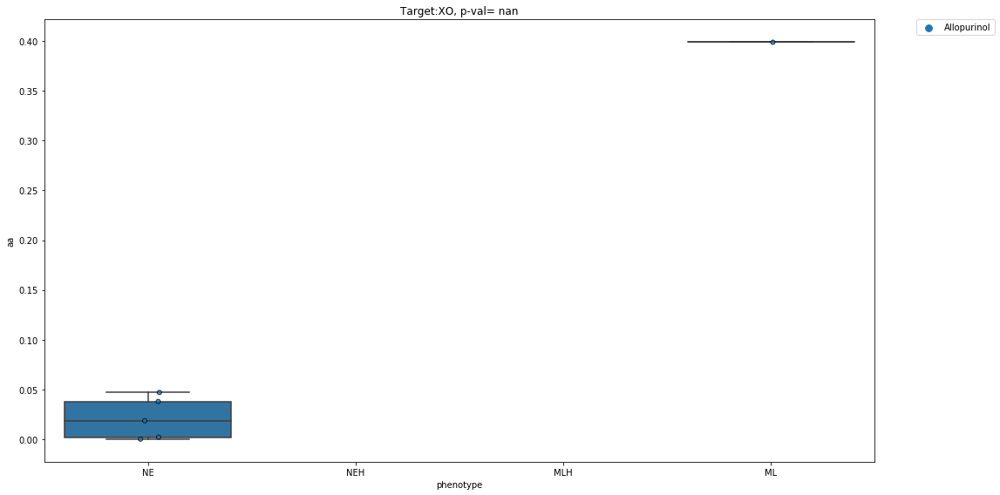

              drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                         
COLO668    KPT-185  1.509454       MLH     0.0       0.0       0.0
CORL47     KPT-185  1.164130        NE     0.0       0.0       0.0
CORL88     KPT-185  0.199612       MLH     0.0       0.0       0.0
DMS114     KPT-185  2.246897        ML     0.0       0.0       0.0
DMS273     KPT-185  0.994167       NEH     0.0       0.0       0.0
...            ...       ...       ...     ...       ...       ...
NCIH82     KPT-251  1.530710       NEH     0.0       0.0       0.0
NCIH841    KPT-251  1.480050        ML     0.0       0.0       0.0
NCIH889    KPT-251  1.318983        NE     0.0       0.0       0.0
SHP77      KPT-251  1.459721       MLH     0.0       0.0       0.0
SW1271     KPT-251  2.329849        ML     0.0       0.0       0.0

[74 rows x 6 columns]
XPO1


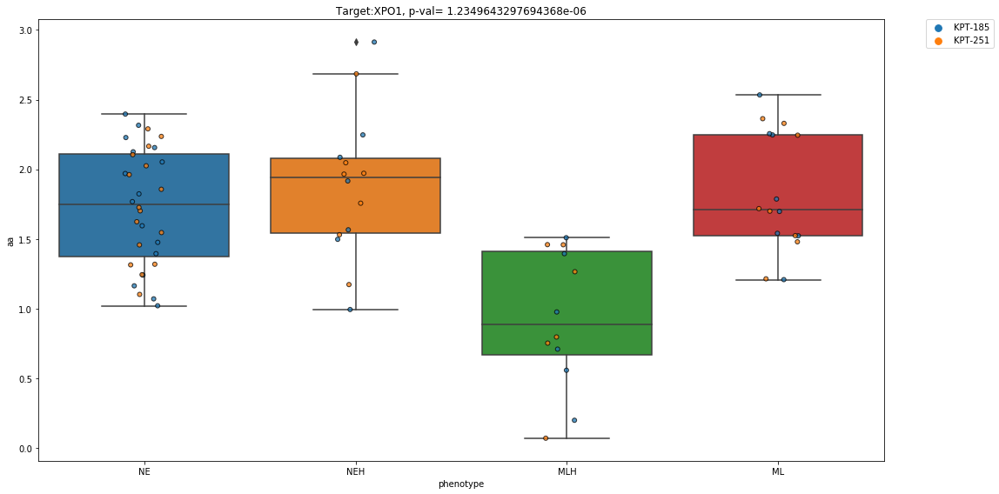

                drug        aa phenotype  aa_new  hill_new  emax_new
cell.line                                                           
COLO668    PF-477736  1.228402       MLH     0.0       0.0       0.0
CORL47     PF-477736  0.911305        NE     0.0       0.0       0.0
CORL88     PF-477736  1.284080       MLH     0.0       0.0       0.0
DMS114     PF-477736  1.703788        ML     0.0       0.0       0.0
DMS273     PF-477736  0.842024       NEH     0.0       0.0       0.0
DMS53      PF-477736  0.684762       MLH     0.0       0.0       0.0
DMS79      PF-477736  0.494791        NE     0.0       0.0       0.0
NCIH1048   PF-477736  1.613696        ML     0.0       0.0       0.0
NCIH1092   PF-477736  0.682800        NE     0.0       0.0       0.0
NCIH1105   PF-477736  1.283063        NE     0.0       0.0       0.0
NCIH1341   PF-477736  1.525845        ML     0.0       0.0       0.0
NCIH1436   PF-477736  1.614653        NE     0.0       0.0       0.0
NCIH146    PF-477736  1.565209    

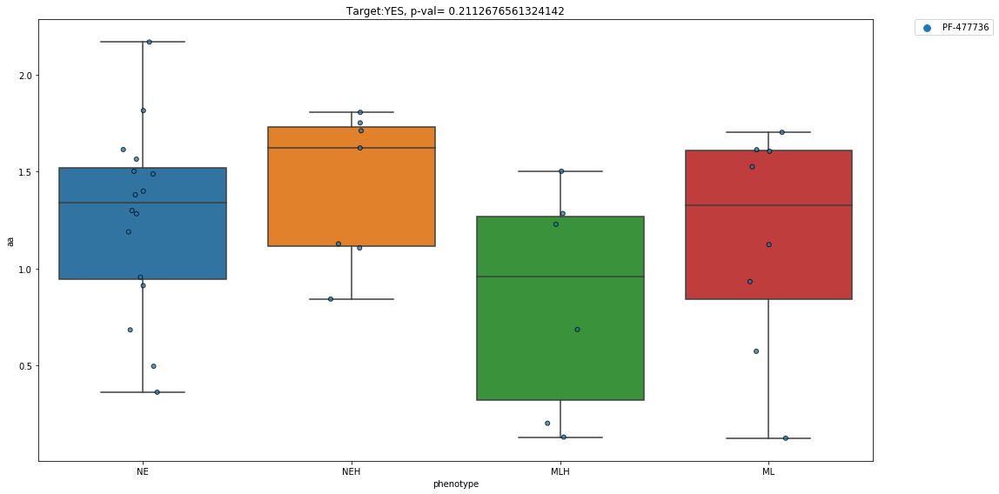

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/scipy/stats/stats.py:3641: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


                drug   aa phenotype  aa_new  hill_new  emax_new
cell.line                                                      
COLO668    Dasatinib  0.0       MLH     0.0       0.0       0.0
CORL47     Dasatinib  0.0        NE     0.0       0.0       0.0
CORL88     Dasatinib  0.0       MLH     0.0       0.0       0.0
DMS114     Dasatinib  0.0        ML     0.0       0.0       0.0
DMS273     Dasatinib  0.0       NEH     0.0       0.0       0.0
DMS53      Dasatinib  0.0       MLH     0.0       0.0       0.0
DMS79      Dasatinib  0.0        NE     0.0       0.0       0.0
NCIH1048   Dasatinib  0.0        ML     0.0       0.0       0.0
NCIH1092   Dasatinib  0.0        NE     0.0       0.0       0.0
NCIH1105   Dasatinib  0.0        NE     0.0       0.0       0.0
NCIH1341   Dasatinib  0.0        ML     0.0       0.0       0.0
NCIH1436   Dasatinib  0.0        NE     0.0       0.0       0.0
NCIH146    Dasatinib  0.0        NE     0.0       0.0       0.0
NCIH1618   Dasatinib  0.0        NE     

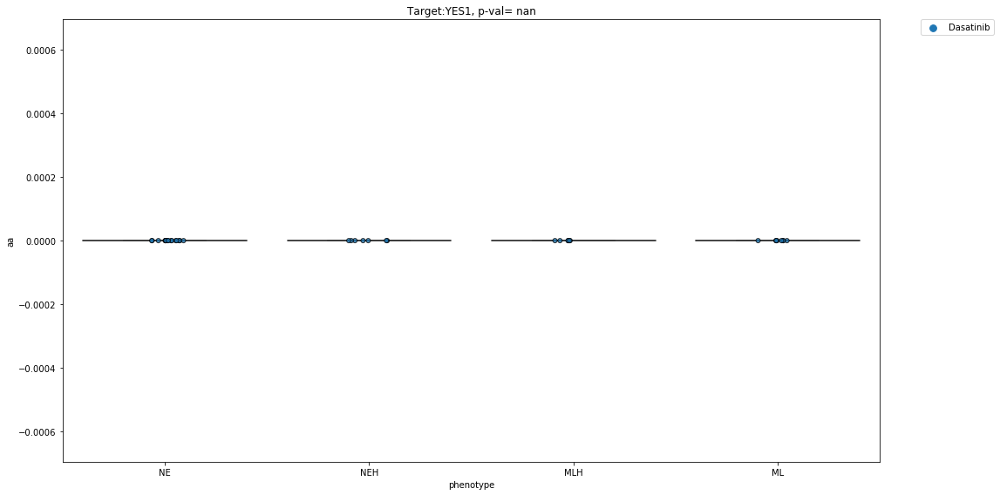

In [35]:
%matplotlib inline
import seaborn as sns
from scipy import stats  
import statsmodels.stats.multitest as sm
pvals = pd.DataFrame(columns=['target', 'pval'], dtype=float)

for i,r in df_targ.iterrows():
    d = drug_sens.loc[drug_sens['drug'].isin(df_targ.loc[i]['DRUGS'].split(', '))].dropna()
    d = d.loc[d['phenotype'] != 0]
    f_val, p_val = stats.f_oneway(d.loc[d['phenotype']=='NE']['aa'], d.loc[d['phenotype']=='NEH']['aa'], d.loc[d['phenotype']=='MLH']['aa'], d.loc[d['phenotype']=='ML']['aa']) 
    pvals = pvals.append(pd.DataFrame([{'target':i, 'pval':p_val}]), ignore_index=True, sort = True)
    print(d)
    try:
        print(i)
        fig,ax = plt.subplots(figsize = (16,8))
        sns.boxplot(x = "phenotype", y="aa", data=d, ax = ax, order=["NE", "NEH", "MLH", 'ML'])
        sns.stripplot(x = "phenotype", y="aa", hue = 'drug', data=d, ax = ax, edgecolor='black',
                     alpha=.75, s=5,linewidth=1.0, order=["NE", "NEH", "MLH", 'ML'], jitter = True) 
        plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
        plt.title(str('Target:' + i + ', p-val= ' + str(p_val)))
        plt.tight_layout()
        plt.show()
        fig.savefig(op.join(outdir,'out/boxplots/new_%s.pdf'%i))
    except(ValueError): pass 
    


In [37]:
# p_c = list(pvals['pval'].fillna(1))
pvals = pvals.dropna().reset_index(drop = True)
b, p_corr, _1, _2 = sm.multipletests(list(pvals['pval']), method='fdr_bh')
pvals['fdr_p'] = pd.Series(p_corr)
pvals_sig = pvals.loc[pvals['fdr_p'] < 0.05]
pvals_sig.to_csv(op.join(outdir,'out/sig_drug_targets_fewer.csv'))

In [154]:
df = pd.read_csv(op.join(indir,"SCLC_drc_abbrev.csv"), "r", delimiter = ",")

df["cluster"] = pd.Series( index=(
0, len(list(df["cline"]))), dtype = str)  # create a column to record the cluster number each cellline belongs to.

drug_list = list(df["drug"].unique())  # make  a list of the 521 unique drug2

cell_lines = list(df["cline"].unique())  # get 41 unique lines and edit df name to match the cluster_id

targets = pd.read_csv(op.join(indir,'drug_targets.csv'), header = 0)
print(targets.head())

         drug                     Target       PATHWAY  \
0    AZD-4547  FGFR, FGFR1, FGFR2, FGFR3  ANGIOGENESIS   
1   Bosutinib                  ABL1, SRC  ANGIOGENESIS   
2  EMD-121974                        NaN  ANGIOGENESIS   
3     KX2-391                        SRC  ANGIOGENESIS   
4      OT-674                        NaN  ANGIOGENESIS   

                         INCHI  
0  VRQMAABPASPXMW-HDICACEKSA-N  
1  UBPYILGKFZZVDX-UHFFFAOYSA-N  
2  AMLYAMJWYAIXIA-VWNVYAMZSA-N  
3  HUNGUWOZPQBXGX-UHFFFAOYSA-N  
4  CSGAUKGQUCHWDP-UHFFFAOYSA-N  


### Not currently used

In [155]:
# Make a dictionary for colors from drug type, and use this to color bars in bar graph

colors_dict = dict()
colors_dict['ANGIOGENESIS'] = '#fdc1c5'
colors_dict['ANTI-INFECTION'] = '#7bc8f6'
colors_dict['APOPTOSIS PATHWAY'] = '#f1da7a'
colors_dict['AURORA KINASE'] = '#8f8ce7'
colors_dict['CELL CYCLE'] = '#bcecac'
colors_dict['CHROMATIN'] = '#feff7f'
colors_dict['CHROMATIN HISTONE'] = '#c27e79'
colors_dict['CYTOSKELETAL SIGNALING'] = '#fd79f'
colors_dict['DNA ALKYLATOR'] = '#96f97b'
colors_dict['DNA DAMAGE'] = '#ae7181'
colors_dict['DNA REPLICATION'] = '#ff796c'
colors_dict['DNA/RNA SYNTHESIS'] = '#e6daa6'
colors_dict['EGFR INHIBITOR'] = '#ffb07c'
colors_dict['ENDOCRINOLOGY AND HORMONES'] = '#c7db5'
colors_dict['HSP INHIBITOR'] = '#ffd1df'
colors_dict['IMMUNE SYSTEM'] = '#04d8b2'
colors_dict['JAK/STAT SIGNALING'] = '#8fff9f'
colors_dict['MAPK SIGNALING'] = '#d5869d'
colors_dict['MET INHIBITOR'] = '#6b8ba4'
colors_dict['MEK INHIBITOR'] = '#516572'
colors_dict['METABOLISM'] = '#ff474c'
colors_dict['NEURONAL SIGNALING'] = '#b790d4'
colors_dict['NOTCH PATHWAY'] = '#047495'
colors_dict['PARP INHIBITOR'] = '#6c3461'
colors_dict['PI3K/AKT/MTOR'] = '#ffffe4'
colors_dict['PROTEASES'] = '#c875c4'
colors_dict['PROTEIN TYROSINE KINASE'] = '#a4be5c'
colors_dict['TOPOISOMERASE INHIBITION'] = '#de7e5d'
colors_dict['TRANSMEMBRANE TRANSPORTERS'] = '#825f87'
colors_dict['WNT/HEDGEHOG'] = '#017a79'
colors_dict['OTHER'] = '#bb3f3f'

In [163]:


# cluster_df = pd.read_csv("/Users/sarahmaddox/Documents/workspace/SCLC_Heterogeneity/src/sfong_code/celllines.csv",
#                              "r", delimiter=",")  # get the clustering IDs of each of the cell lines
cluster_df = pd.read_csv( "/Users/smgroves/Dropbox (VU Basic Sciences)/SCLC/RNAseq-analysis/Clustering/CCLE_Consensus-Clustering/kmdist_pearson_median_centered/4_clusters_Teichermatch.csv",
    header=None, delimiter=",")
print(cluster_df.head())
cluster_df.columns = ['line','class']
cluster_id = {}  # get the cluster_ids into the main df. Here, cluster_id[cell_line] = cluster_number

for name in cluster_df['line']:  # split the string of cellline_LUNG into cell_lines
    ind = cluster_df["line"].index[cluster_df["line"] == name]
    x = (str(name))
    y = x.split("_")
    cl = y[0]
    val = str(cluster_df["class"].iloc[ind].values)
    val = val.replace("[]", "")
    cluster_id[cl] = val  # add the cell_line: subcluster id into the cluster_id dictionary

del (cluster_df)  # delete the datafame. We have the information stored in the cluster_id dictionary

data_x = {}  # dictionary of the specific_cell_lines we are interested in experimenting with.
for cell_line in cell_lines:  # annotate the dataframe with the cell line cluster IDs.
    if cell_line in cluster_id.keys():

        cluster_number = cluster_id[cell_line]
        row = df.index[df["cline"] == cell_line]
        df.iloc[row, df.columns.get_loc('cluster')] = cluster_number

    else:
        print("this cell line is not in our cell line collection ", cell_line)

cluster_number = ['[1]', '[2]', '[3]', '[4]', 'nan']  # list of  cluster numbers for plotting.

# EDGE: H69/CPR, H69VCR/R cell lines are not in our inhouse subcluster analysis

drug_df = df[['cluster', 'cline', 'drug', 'Emax_normalized', 'AAr', 'IC50', 'logEC50', 'Emax']]

print(drug_df.head(), drug_df.shape, drug_df['logEC50'].min(),drug_df['logEC50'].max())


           0  1
0  NCI-H2066  4
1   NCI-H211  4
2       SBC5  4
3    DMS 114  4
4   NCI-H841  4
this cell line is not in our cell line collection  NCI-H2141
this cell line is not in our cell line collection  NCI-H69/CPR
this cell line is not in our cell line collection  NCI-H69/LX10
this cell line is not in our cell line collection  NCI-H69VCR/R
  cluster     cline                                       drug  \
0     [1]  COLO 668   1st Precursur Intermediate to TDP 665759   
1     [1]   COR L88   1st Precursur Intermediate to TDP 665759   
2     [3]   COR-L47   1st Precursur Intermediate to TDP 665759   
3     [4]   DMS 114   1st Precursur Intermediate to TDP 665759   
4     [2]   DMS 273   1st Precursur Intermediate to TDP 665759   

   Emax_normalized       AAr  IC50   logEC50       Emax  
0        84.467127  0.039891   NaN -5.229148  85.549745  
1        79.446045  0.094890   NaN -5.181774  78.054403  
2        97.095829  0.025148   NaN -5.863279  97.544478  
3        75.310060  0.0

In [13]:

def get_pheno(i):
    if i == '[1]': return "MLH"
    if i == '[2]': return "NEH"
    if i == '[3]': return "NE"
    if i == '[4]': return "ML"
    else: raise(ValueError("Bad phenotype value"))



In [14]:
from itertools import combinations
from statsmodels.stats.multitest import multipletests
from scipy.stats import spearmanr
import numpy as np
# To do BH fdr p-value adjustment, we make a vector of the lower-triangle of spearmanr pvals (excluding diagonal, because of course everything is perfectly correlated)
all_drug = pd.read_csv('/Users/sarahmaddox/Quaranta_Lab/SCLC/Drug_response/Efficacy_Teicher_data_results_logec50.csv', index_col=0)
all_drug=all_drug[:-1]
all_drug.head()

,sum,Emax,AAr,IC50,logEC50,Emax_normalized-oneway_ANOVA_f-statistic,Emax_normalized-oneway_ANOVA_p,Emax_normalized-Kruskal_f-statistic,Emax_normalized-Kruskal_p,AAr-oneway_ANOVA_f-statistic,...,AAr-[3]_rank,AAr-[4]_rank,IC50-[1]_rank,IC50-[2]_rank,IC50-[3]_rank,IC50-[4]_rank,logEC50-[1]_rank,logEC50-[2]_rank,logEC50-[3]_rank,logEC50-[4]_rank
drug,,,,,,,,,,,,,,,,,,,,,
1st Precursur Intermediate to TDP 665759,1,0,1,0,0,1.050934,0.383525,7.168512,0.066716,5.129902,...,0,1,0,1,2,3,2,0,1,3
AS-703569,2,0,1,0,1,0.272577,0.844705,3.908107,0.271559,5.130151,...,3,1,3,1,0,2,3,1,0,2
BMS-387032,3,0,1,1,1,1.097928,0.364257,3.245055,0.355363,3.094425,...,3,1,3,2,1,0,3,2,1,0
Dabrafenib,0,0,0,0,0,1.078191,0.372237,1.773273,0.620768,2.222080,...,3,1,0,1,2,3,3,1,0,2
Pazopanib,0,0,0,0,0,0.363446,0.779811,1.122147,0.771731,1.495840,...,0,3,0,1,2,3,1,0,2,3


In [15]:
all_drug['AAr-oneway_ANOVA_p']

drug
 1st Precursur Intermediate to TDP 665759    0.005203
 AS-703569                                   0.005202
 BMS-387032                                  0.040674
 Dabrafenib                                  0.104659
 Pazopanib                                   0.234375
 ZIP-301                                     0.044966
(+)-JQ1                                      0.003715
1-Methyl-[D]-tryptophan                      0.918732
10058-F4                                     0.435656
10074-G5                                     0.602883
17-AAG                                       0.028651
17-DMAG                                      0.090584
2-Fluoroadenosine                            0.898620
2nd Precursur Intermediate to TDP 665759     0.957187
3-AP                                         0.185203
3-Bromopyruvic acid                          0.431685
4SC-202                                      0.115013
7-Ethyl-10-hydroxycamptothecin               0.868383
AB-1010                

# Drug plots by distance to archetype (and specialist/generalist characterization)

In [123]:
distances = pd.read_csv(op.join(outdir,"arc_space/distances.csv"), header = None).T
distances.columns = ['SCLC-Y', 'SCLC-P','SCLC-N','SCLC-A2','SCLC-A']
distances.head()

,SCLC-Y,SCLC-P,SCLC-N,SCLC-A2,SCLC-A
0,122.034899,107.833082,91.214260,93.282333,76.338367
1,122.334497,108.867795,95.302842,101.101440,77.636464
2,129.333514,112.065962,96.835822,101.923496,81.288051
3,129.561391,120.786395,98.340963,103.160870,83.854943
4,133.735308,122.521452,98.476548,103.607238,85.915890


In [64]:
clines = pd.read_csv(op.join(outdir,"arc_space/combined_clusters_2020-05-27-MC copy.csv"), index_col = 0)
clines

,source,subtype,NEW_10_2020,10_08_2020
c.COLO668,CCLE,A2,A2,A2
c.CORL24,CCLE,A,N,A
c.CORL279,CCLE,A,A,A
c.CORL311,CCLE,P,P,P
c.CORL47,CCLE,A,A,A
...,...,...,...,...
m.NCIH82,Minna,N,N,uncl
m.NCIH841,Minna,Y,Y,Y
m.NCIH865,Minna,A2,A2,A2
m.NCIH889,Minna,A,A,A


In [90]:
ordering = pd.read_csv(op.join(outdir,"arc_space/ordering.csv"), header = None).T


In [91]:
#change from MATLAB to python indexing
ordering = ordering-1

In [92]:
for c in ordering:
    ordering[f"order_{c}"] = clines.index[list(ordering[c])]

In [94]:
ordering.columns = [0,1,2,3,4, 'SCLC-Y','SCLC-P','SCLC-N','SCLC-A2','SCLC-A']

In [98]:
ordering

,0,1,2,3,4,SCLC-Y,SCLC-P,SCLC-N,SCLC-A2,SCLC-A
0,37,33,54,50,90,c.NCIH2286,c.NCIH211,m.HCC4001,m.DMS153,m.NCIH2108
1,49,91,105,63,82,c.SW1271,m.NCIH211,m.NCIH524,m.NCIH1238,m.NCIH1926
2,18,106,107,8,71,c.NCIH1339,m.NCIH526,m.NCIH60,c.DMS153,m.NCIH1522
3,44,41,40,114,74,c.NCIH841,c.NCIH526,c.NCIH524,m.NCIH774,m.NCIH1672
4,116,60,59,29,89,m.NCIH841,m.NCIH1048,m.HCC970,c.NCIH2029,m.NCIH2107
...,...,...,...,...,...,...,...,...,...,...
115,4,1,49,37,46,c.CORL47,c.CORL24,c.SW1271,c.NCIH2286,c.SBC5
116,13,36,18,7,49,c.HCC33,c.NCIH2227,c.NCIH1339,c.DMS114,c.SW1271
117,15,12,75,49,37,c.NCIH1092,c.DMS79,m.NCIH1688,c.SW1271,c.NCIH2286
118,21,35,11,18,18,c.NCIH146,c.NCIH2196,c.DMS53,c.NCIH1339,c.NCIH1339


In [124]:
for c in distances:
    x = distances[c]
    x.index = ordering[c].values
    distances[c] = x.sort_index().values

In [130]:
# distances.index = clines.index
distances.loc['m.NCIH2108']

SCLC-Y     221.060325
SCLC-P     176.724693
SCLC-N     141.512002
SCLC-A2    137.440212
SCLC-A      76.338367
Name: m.NCIH2108, dtype: float64

In [142]:
pcs = pd.read_csv(op.join(outdir,"arc_space/pc.csv"), header = None)
pcs.index = clines.index

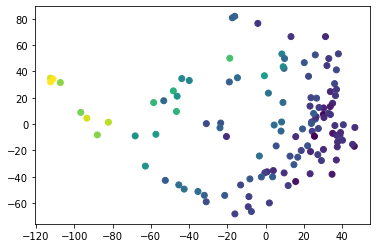

In [149]:
plt.scatter(pcs[0],pcs[1], c = distances['SCLC-Y'], cmap='viridis_r')

In [184]:
distances.loc[["CORL24" in i for i in distances.index]].mean()

SCLC-Y     222.904409
SCLC-P     194.007225
SCLC-N     147.307784
SCLC-A2    179.723460
SCLC-A     145.958027
dtype: float64

In [186]:
dist = pd.DataFrame(columns=distances.columns, dtype = float)
for i, r in drug_sens.iterrows():
    s =distances.loc[[i in x for x in distances.index]].mean()
    dist = dist.append(s, ignore_index=True)

In [188]:
dist.index = drug_sens.index

In [198]:
drug_sens = pd.concat([drug_sens,dist], axis=1)


In [253]:
drug_df.to_csv(op.join(outdir,'drug_df_updated_cline_names.csv'))

## Using aa and target for scatterplots

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles wi

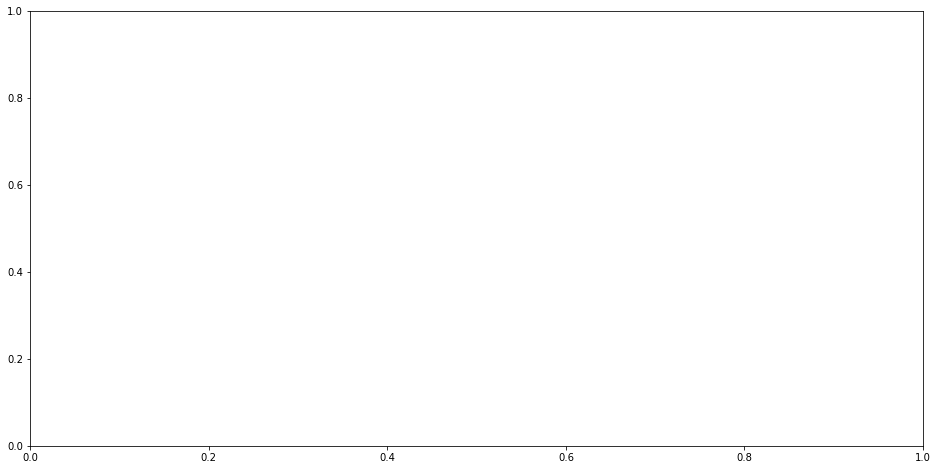

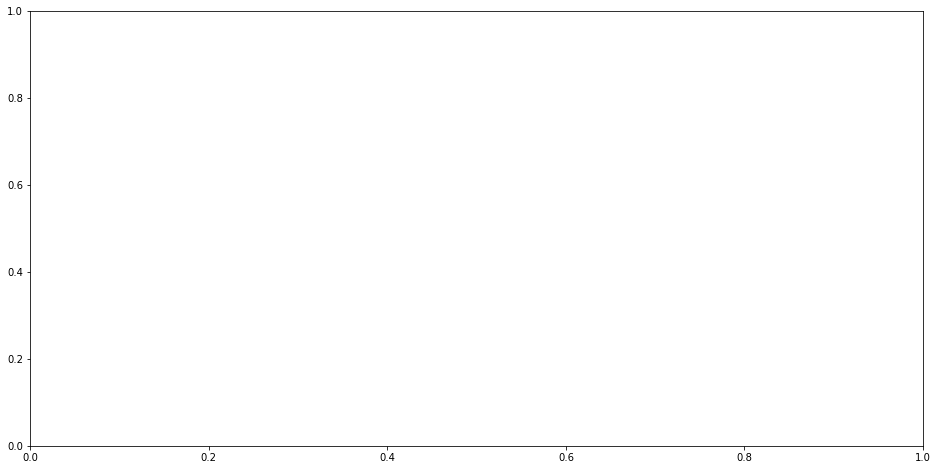

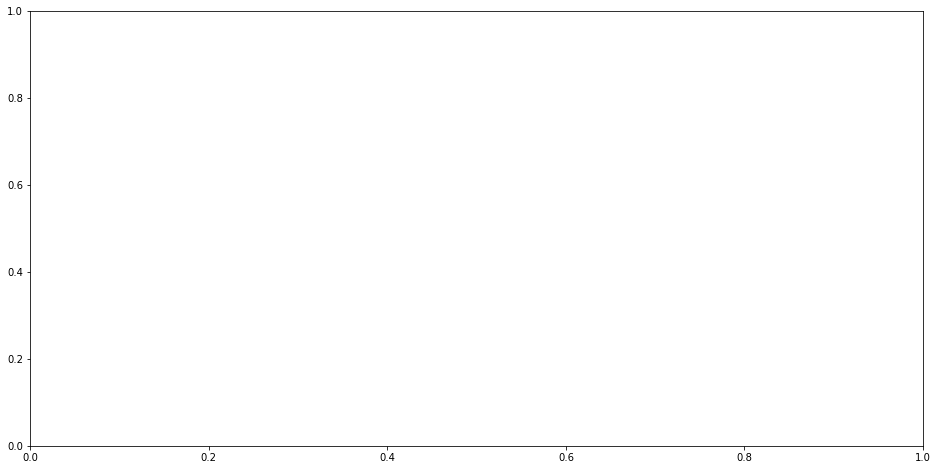

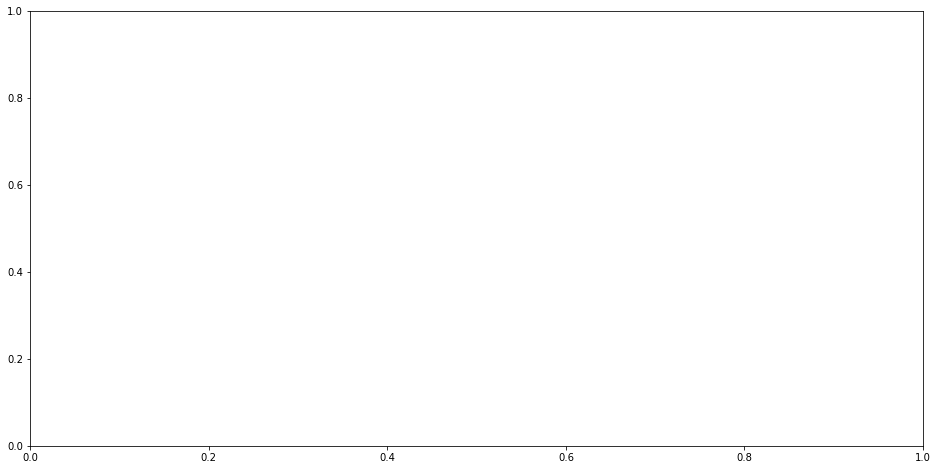

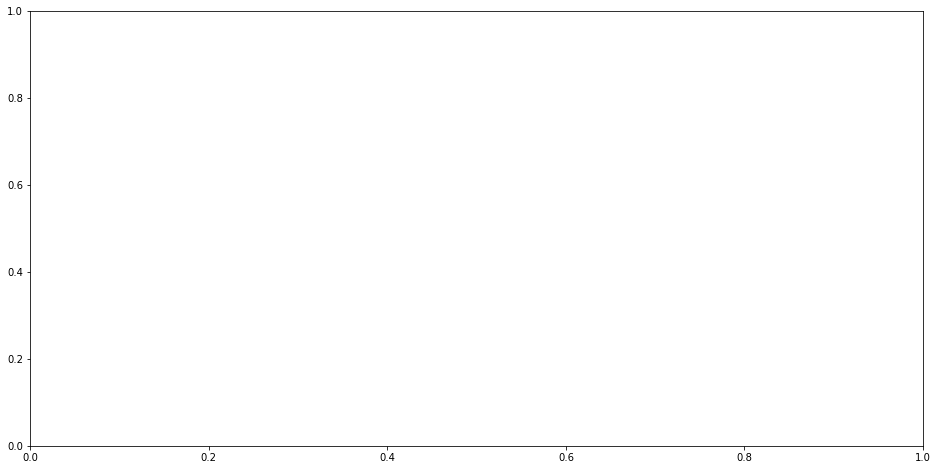

...

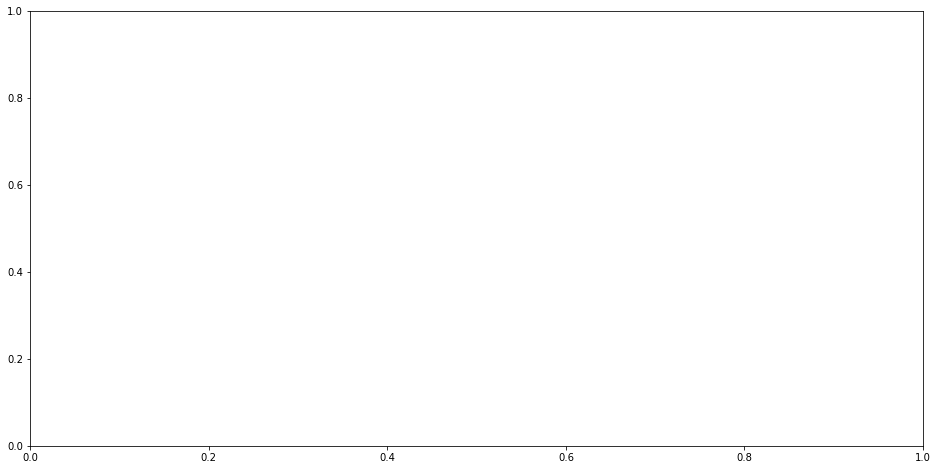

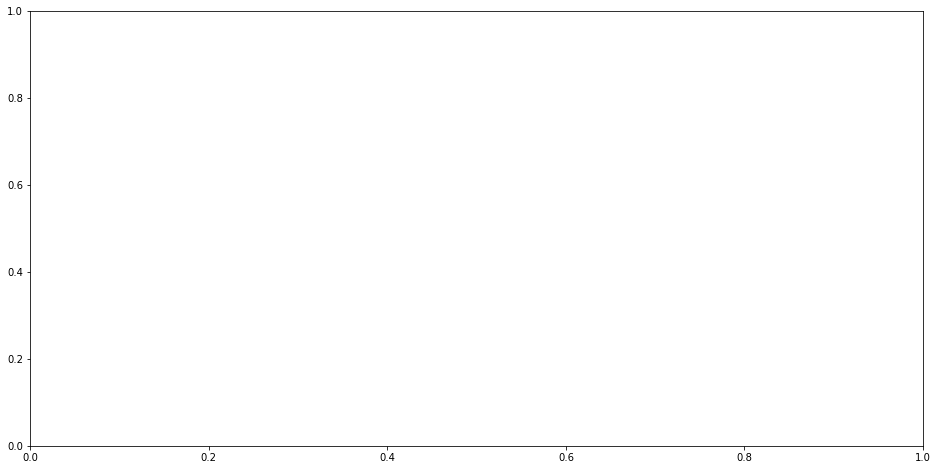

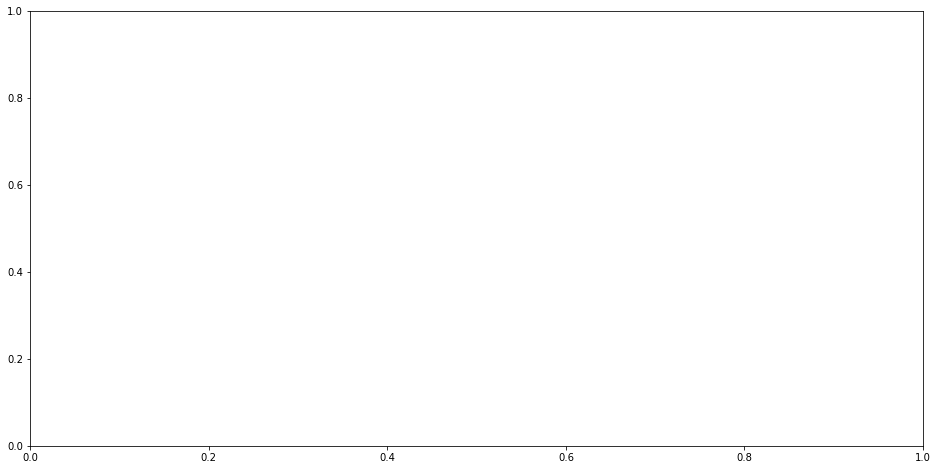

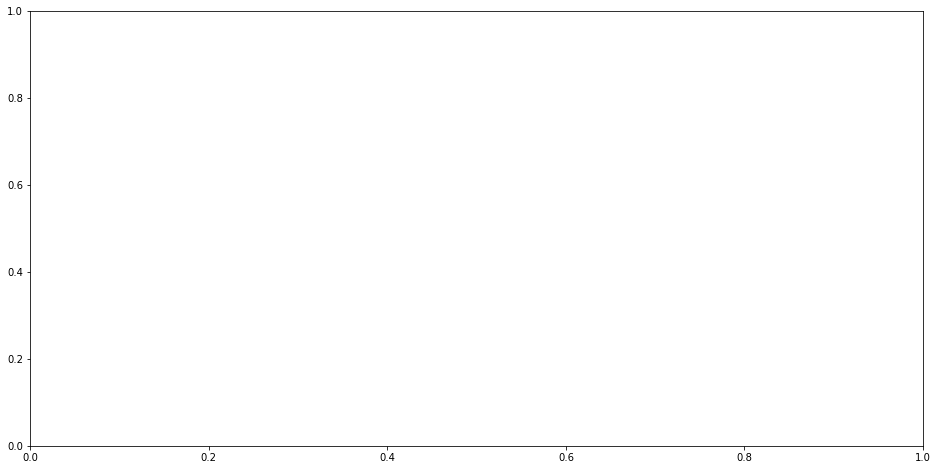

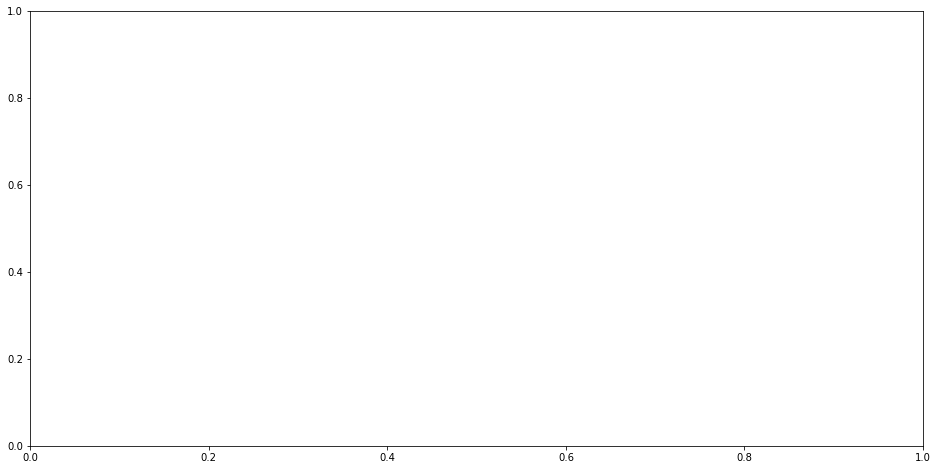

In [249]:
import seaborn as sns
from scipy import stats  
import statsmodels.stats.multitest as sm
# pvals = pd.DataFrame(columns=['target', 'pval'], dtype=float)
for arc in distances:
    if not os.path.exists(op.join(outdir,f'out/scatterplots/by_target/{arc}')):
        os.makedirs(op.join(outdir,f'out/scatterplots/by_target/{arc}'))
    drug_sens[f'log_{arc}'] = np.log(drug_sens[arc])

    for x,r in df_targ.iterrows():
        d = drug_sens.loc[drug_sens['drug'].isin(df_targ.loc[x]['DRUGS'].split(', '))].dropna()
#         d = d.loc[d['phenotype'] != 0]
        
    #     f_val, p_val = stats.f_oneway(d.loc[d['phenotype']=='NE']['aa'], d.loc[d['phenotype']=='NEH']['aa'], d.loc[d['phenotype']=='MLH']['aa'], d.loc[d['phenotype']=='ML']['aa']) 
    #     pvals = pvals.append(pd.DataFrame([{'target':i, 'pval':p_val}]), ignore_index=True, sort = True)
        try:
            fig,ax = plt.subplots(figsize = (16,8))
            sns.regplot(x = f'{arc}', y="aa", data=d, ax = ax, x_ci = 'sd', x_bins=20)
    #         sns.stripplot(x = "phenotype", y="aa", hue = 'drug', data=d, ax = ax, edgecolor='black',
    #                      alpha=.75, s=5,linewidth=1.0, order=["NE", "NEH", "MLH", 'ML'], jitter = True) 
            plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    #         plt.title(str('Target:' + i + ', p-val= ' + str(p_val)))
            plt.tight_layout()
    #         plt.show()
            fig.savefig(op.join(outdir,f'out/scatterplots/by_target/{arc}/%s.pdf'%x))
            plt.close()
        except(IndexError): pass 


    

In [232]:
dist_df = pd.DataFrame(columns=distances.columns, dtype = float)
for i, r in df.iterrows():
    s =distances.loc[[r['cline'] in x for x in distances.index]].mean()
    dist_df = dist_df.append(s, ignore_index=True)

## Using aa and pathways for scatterplots

In [229]:
import os
import seaborn as sns
from scipy import stats  
import statsmodels.stats.multitest as sm
# pvals = pd.DataFrame(columns=['target', 'pval'], dtype=float)

# for i,r in df_targ.iterrows():
for arc in distances:
    if not os.path.exists(op.join(outdir,f'out/scatterplots/{arc}')):
        os.makedirs(op.join(outdir,f'out/scatterplots/{arc}'))
    for x,i in enumerate(sorted(list(set(targets['PATHWAY'])))):
        drugs = list(targets.loc[targets['PATHWAY']==i]['drug'])
        d = drug_sens.loc[drug_sens['drug'].isin(drugs)].dropna()
        d = d.loc[d['phenotype'] != 0]
    #     f_val, p_val = stats.f_oneway(d.loc[d['phenotype']=='NE']['aa'], d.loc[d['phenotype']=='NEH']['aa'], d.loc[d['phenotype']=='MLH']['aa'], d.loc[d['phenotype']=='ML']['aa']) 
    #     pvals = pvals.append(pd.DataFrame([{'target':i, 'pval':p_val}]), ignore_index=True, sort = True)
        if all(d['aa']==0): pass
        else:
            try:
                fig,ax = plt.subplots(figsize = (16,8))
                sns.regplot(x = arc, y="aa", data=d, ax = ax, x_ci = 'sd')
        #         sns.stripplot(x = "phenotype", y="aa", hue = 'drug', data=d, ax = ax, edgecolor='black',
        #                      alpha=.75, s=5,linewidth=1.0, order=["NE", "NEH", "MLH", 'ML'], jitter = True) 
        #         plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
                plt.title(str('Pathway:' + i))
                plt.tight_layout()
        #         plt.show()
                fig.savefig(op.join(outdir,f'out/scatterplots/{arc}/%s.pdf'%x))
                plt.close()
            except(IndexError): pass 

    
    

## Using AAr for scatterplots

In [255]:
drug_df = pd.read_csv(op.join(outdir,'out/drug_df_updated_cline_names.csv'), header = 0, index_col=0)
drug_df.head()

,cluster,cline,drug,Emax_normalized,AAr,IC50,logEC50,Emax
0,[1],COLO668,1st Precursur Intermediate to TDP 665759,84.467127,0.039891,NaN,-5.229148,85.549745
1,[1],CORL88,1st Precursur Intermediate to TDP 665759,79.446045,0.094890,NaN,-5.181774,78.054403
2,[3],CORL47,1st Precursur Intermediate to TDP 665759,97.095829,0.025148,NaN,-5.863279,97.544478
3,[4],DMS114,1st Precursur Intermediate to TDP 665759,75.310060,0.016884,NaN,-4.978811,74.658698
4,[2],DMS273,1st Precursur Intermediate to TDP 665759,95.773381,0.195073,NaN,-6.463442,98.891630


In [256]:
dist_drug_df = pd.DataFrame(columns=distances.columns, dtype = float)
for i, r in drug_df.iterrows():
    s =distances.loc[[r['cline'] in x for x in distances.index]].mean()
    dist_drug_df = dist_drug_df.append(s, ignore_index=True)

In [257]:
dist_drug_df

,SCLC-Y,SCLC-P,SCLC-N,SCLC-A2,SCLC-A
0,219.711613,163.151579,190.111824,108.962738,168.018820
1,218.362726,156.177499,176.522408,107.883323,127.925740
2,230.207672,176.544479,139.077497,132.215445,122.241732
3,143.506320,166.348368,167.870446,197.162703,184.054165
4,177.494539,148.821715,116.965127,175.813633,170.721116
...,...,...,...,...,...
20462,NaN,NaN,NaN,NaN,NaN
20463,131.648349,157.955097,167.793531,187.073881,179.338707
20464,226.670810,172.126948,149.957297,119.682615,131.418198
20465,199.426186,170.032879,162.100698,129.161671,173.163127


In [258]:
dist_drug_df.index = drug_df.index

In [259]:
drug_df = pd.concat([drug_df,dist_drug_df], axis=1)
drug_df.head()

,cluster,cline,drug,Emax_normalized,AAr,IC50,logEC50,Emax,SCLC-Y,SCLC-P,SCLC-N,SCLC-A2,SCLC-A
0,[1],COLO668,1st Precursur Intermediate to TDP 665759,84.467127,0.039891,NaN,-5.229148,85.549745,219.711613,163.151579,190.111824,108.962738,168.018820
1,[1],CORL88,1st Precursur Intermediate to TDP 665759,79.446045,0.094890,NaN,-5.181774,78.054403,218.362726,156.177499,176.522408,107.883323,127.925740
2,[3],CORL47,1st Precursur Intermediate to TDP 665759,97.095829,0.025148,NaN,-5.863279,97.544478,230.207672,176.544479,139.077497,132.215445,122.241732
3,[4],DMS114,1st Precursur Intermediate to TDP 665759,75.310060,0.016884,NaN,-4.978811,74.658698,143.506320,166.348368,167.870446,197.162703,184.054165
4,[2],DMS273,1st Precursur Intermediate to TDP 665759,95.773381,0.195073,NaN,-6.463442,98.891630,177.494539,148.821715,116.965127,175.813633,170.721116


In [304]:
import os
import seaborn as sns
from scipy import stats  
import statsmodels.stats.multitest as sm
# pvals = pd.DataFrame(columns=['target', 'pval'], dtype=float)

# for i,r in df_targ.iterrows():
for arc in distances:
    if not os.path.exists(op.join(outdir,f'out/scatterplots/{arc}')):
        os.makedirs(op.join(outdir,f'out/scatterplots/{arc}'))
    for x,i in enumerate(sorted(list(set(targets['PATHWAY'])))):
        drugs = list(targets.loc[targets['PATHWAY']==i]['drug'])
        d = drug_df.loc[drug_df['drug'].isin(drugs)].dropna()
#         d = d.loc[d['phenotype'] != 0]
    #     f_val, p_val = stats.f_oneway(d.loc[d['phenotype']=='NE']['aa'], d.loc[d['phenotype']=='NEH']['aa'], d.loc[d['phenotype']=='MLH']['aa'], d.loc[d['phenotype']=='ML']['aa']) 
    #     pvals = pvals.append(pd.DataFrame([{'target':i, 'pval':p_val}]), ignore_index=True, sort = True)
        if all(d['AAr']==0): pass
        
        else:
            try:
                drugs = sorted(list(set(d['drug'])))
                color_dict = {}
                for q,drug in enumerate(drugs):
                    color_dict[drug] = sns.color_palette("tab20")[q]
                fig,ax = plt.subplots(figsize = (16,8))
                sns.regplot(x = arc, y="AAr", data=d, ax = ax, x_ci = 'sd', scatter_kws={'c':[color_dict[q] for q in d["drug"].values], 'color':None}, color = None)
        #         sns.stripplot(x = "phenotype", y="aa", hue = 'drug', data=d, ax = ax, edgecolor='black',
        #                      alpha=.75, s=5,linewidth=1.0, order=["NE", "NEH", "MLH", 'ML'], jitter = True) 
        #         plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
                plt.title(str('Pathway: ' + i))
                plt.tight_layout()
        #         plt.show()
                fig.savefig(op.join(outdir,f'out/scatterplots/{arc}/AAr_%s.pdf'%x))
                plt.close()
            except(IndexError): pass 


In [322]:
import os
import seaborn as sns
from scipy import stats  
import statsmodels.stats.multitest as sm
# pvals = pd.DataFrame(columns=['target', 'pval'], dtype=float)

# for i,r in df_targ.iterrows():
for arc in distances:
    if not os.path.exists(op.join(outdir,f'out/boxplots/{arc}')):
        os.makedirs(op.join(outdir,f'out/boxplots/{arc}'))
    for x,i in enumerate(sorted(list(set(targets['PATHWAY'])))):
        drugs = list(targets.loc[targets['PATHWAY']==i]['drug'])
        d = drug_df.loc[drug_df['drug'].isin(drugs)].dropna()
#         d = d.loc[d['phenotype'] != 0]
    #     f_val, p_val = stats.f_oneway(d.loc[d['phenotype']=='NE']['aa'], d.loc[d['phenotype']=='NEH']['aa'], d.loc[d['phenotype']=='MLH']['aa'], d.loc[d['phenotype']=='ML']['aa']) 
    #     pvals = pvals.append(pd.DataFrame([{'target':i, 'pval':p_val}]), ignore_index=True, sort = True)
        if all(d['AAr']==0): pass
        
        else:
            try:
                drugs = sorted(list(set(d['drug'])))
                color_dict = {}
                for q,drug in enumerate(drugs):
                    color_dict[drug] = sns.color_palette("tab20")[q]
                fig,ax = plt.subplots(figsize = (16,8))
                ax = sns.boxplot(x = np.round(d[arc]*.1), y="AAr", data = d)
                sns.swarmplot(x = np.round(d[arc]*.1), y="AAr", data=d, ax = ax, hue ='drug', palette='tab20')
        #         sns.stripplot(x = "phenotype", y="aa", hue = 'drug', data=d, ax = ax, edgecolor='black',
        #                      alpha=.75, s=5,linewidth=1.0, order=["NE", "NEH", "MLH", 'ML'], jitter = True) 
        #         plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
                plt.title(str('Pathway: ' + i))
                plt.tight_layout()
        #         plt.show()
                fig.savefig(op.join(outdir,f'out/boxplots/{arc}/AAr_%s.pdf'%x))
                plt.close()
            except(IndexError): pass 
        


## Waterfall plots of drug metrics by phenotype

### AAr Plots: Larger value = More Sensitive = Better

In [ ]:
for i in ['[1]', '[2]', '[3]', '[4]']:
    l = pd.DataFrame()
    for ind, r in drug_df.iterrows():
        if r['cluster'] == i:
            l = l.append(r)
    aar = l.groupby(['drug'])['AAr'].median()
    aar = aar.sort_values()
    p = []
    d = []
    labels = []
    for c in range(len(aar)):
        for k, t in targets.iterrows():
            if aar.index[c] == t['drug']:
                d.append(t["drug"])
                p.append(t['PATHWAY'])
                labels.append(str(t['PATHWAY']+ " " + t['drug']))
                break
    #print(len(p))
    #print(len(d))
    #print(len(aar))
    #print(list(set(aar.index) - set(d)))
    print('plotting%s'%get_pheno(i))
    c = [colors_dict[x] for x in p]

    trace0 = go.Bar(
        x=aar.index,
        y=np.log(aar),
        text=labels,
        marker=dict(
            color=c,
        ),
        opacity=0.6
    )

    data = [trace0]
    layout = go.Layout(
        title="Average AAr for %s Phenotype" % get_pheno(i),
        xaxis=dict(
            showticklabels=False
        )
    )

    fig = go.Figure(data=data, layout=layout)
    #py.iplot(fig, filename='AAr%s'%get_pheno(i))
    iplot(fig)


### Emax: Larger magnitude of negative number = lower Emax = better

In [ ]:

for i in ['[1]', '[2]', '[3]', '[4]']:
    l = pd.DataFrame()
    for ind, r in drug_df.iterrows():
        if r['cluster'] == i:
            l = l.append(r)
    emax = l.groupby(['drug'])['Emax'].median()
    emax = emax.sort_values()
    p = []
    d = []
    labels = []
    for c in range(len(emax)):
        for k, t in targets.iterrows():
            if emax.index[c] == t['drug']:
                d.append(t["drug"])
                p.append(t['PATHWAY'])
                labels.append(str(t['PATHWAY']+ " " + t['drug']))
                break
    #print(len(p))
    #print(len(d))
    #print(len(aar))
    #print(list(set(aar.index) - set(d)))
    print('plotting%s'%get_pheno(i))
    c = [colors_dict[x] for x in p]

    trace0 = go.Bar(
        x=emax.index,
        y=emax,
        text=labels,
        marker=dict(
            color=c,
        ),
        opacity=0.6
    )

    data = [trace0]
    layout = go.Layout(
        title="Average Emax for %s Phenotype" % get_pheno(i),
        xaxis=dict(
            showticklabels=False
        )
    )

    fig = go.Figure(data=data, layout=layout)
    #py.iplot(fig, filename='AAr%s'%get_pheno(i))
    iplot(fig)

### EC50: Larger magnitude of negative number (smaller number) = more sensitive = better

plottingMLH


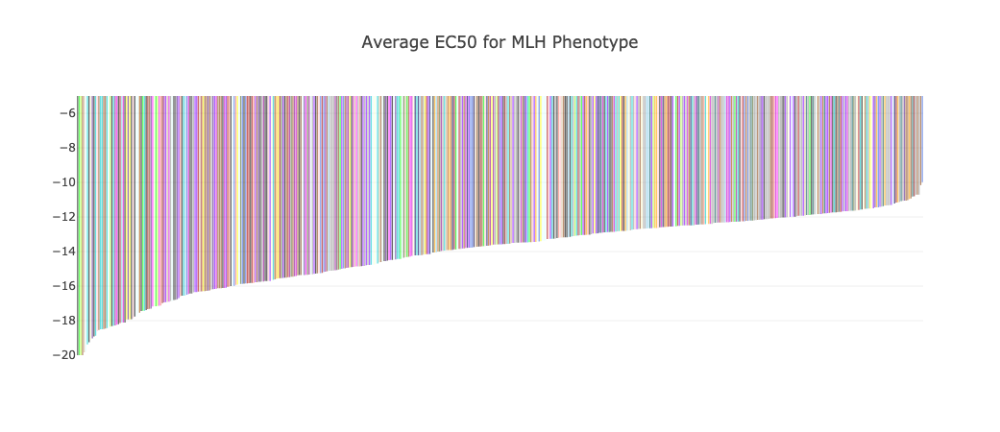

plottingNEH


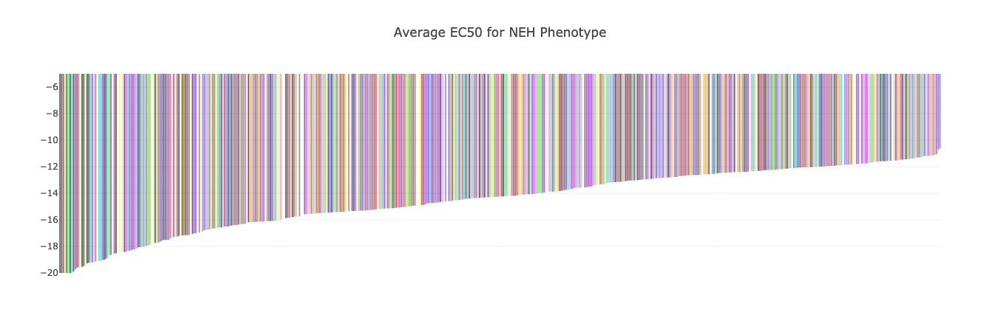

plottingNE


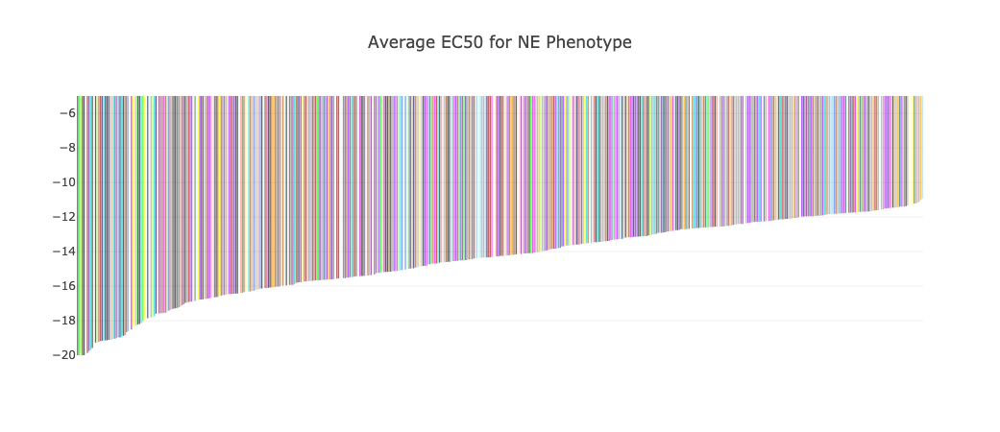

plottingML


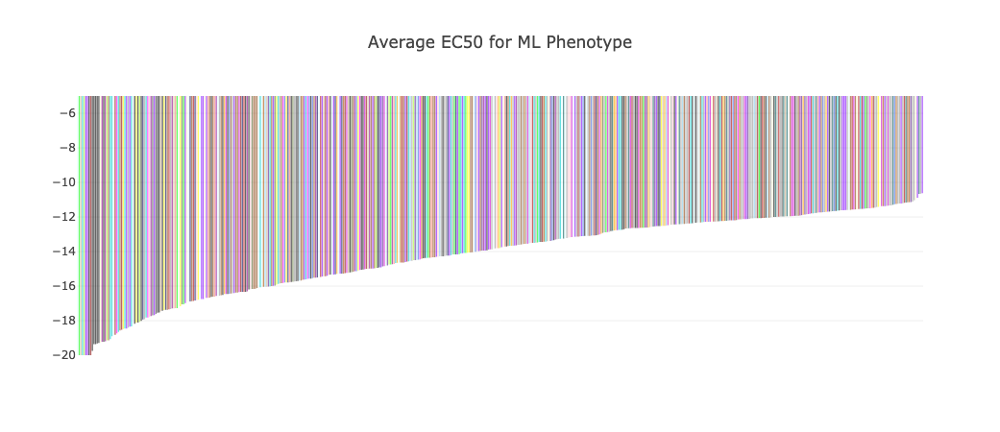

In [7]:

for i in ['[1]', '[2]', '[3]', '[4]']:
    l = pd.DataFrame()
    for ind, r in drug_df.iterrows():
        if r['cluster'] == i:
            l = l.append(r)
    ec50 = l.groupby(['drug'])['EC50'].median()
    ec50 = ec50.sort_values()
    p = []
    d = []
    labels = []
    for c in range(len(ec50)):
        for k, t in targets.iterrows():
            if ec50.index[c] == t['drug']:
                d.append(t["drug"])
                p.append(t['PATHWAY'])
                labels.append(str(t['PATHWAY']+ " " + t['drug']))
                break
    #print(len(p))
    #print(len(d))
    #print(len(aar))
    #print(list(set(aar.index) - set(d)))
    print('plotting%s'%get_pheno(i))
    c = [colors_dict[x] for x in p]

    trace0 = go.Bar(
        x=ec50.index,
        y=np.log(ec50),
        text=labels,
        marker=dict(
            color=c,
        ),
        opacity=0.6
    )

    data = [trace0]
    layout = go.Layout(
        title="Average EC50 for %s Phenotype" % get_pheno(i),
        xaxis=dict(
            showticklabels=False
        ),
         yaxis=dict(
             range=[-20, -5]
         )
    )

    fig = go.Figure(data=data, layout=layout)
    #py.iplot(fig, filename='AAr%s'%get_pheno(i))
    iplot(fig)

## Drug Class Waterfall Plots Colored by Phenotype

For each drug class, make a waterfall plot of drug metric by cell line colored by phenotype. 

In [156]:
targets.head()

,drug,Target,PATHWAY,INCHI
0,AZD-4547,"FGFR, FGFR1, FGFR2, FGFR3",ANGIOGENESIS,VRQMAABPASPXMW-HDICACEKSA-N
1,Bosutinib,"ABL1, SRC",ANGIOGENESIS,UBPYILGKFZZVDX-UHFFFAOYSA-N
2,EMD-121974,NaN,ANGIOGENESIS,AMLYAMJWYAIXIA-VWNVYAMZSA-N
3,KX2-391,SRC,ANGIOGENESIS,HUNGUWOZPQBXGX-UHFFFAOYSA-N
4,OT-674,NaN,ANGIOGENESIS,CSGAUKGQUCHWDP-UHFFFAOYSA-N


In [157]:
df.head()

,Unnamed: 0,cline,drug,slope,Emax,E0,logEC50,EC50,rrEmax,e50,rrE50,IC10,IC50,IC100,Emaxobs,rrEmaxobs,AAr,Emax_normalized,cluster
0,14027,COLO 668,1st Precursur Intermediate to TDP 665759,2.968977,85.549745,101.281703,-5.229148,5.900000e-06,0.844671,93.415724,0.922336,0.000007,NaN,NaN,88.273333,NaN,0.039891,84.467127,NaN
1,15044,COR L88,1st Precursur Intermediate to TDP 665759,0.829663,78.054403,98.248318,-5.181774,6.580000e-06,0.794460,88.151361,0.897230,0.000006,NaN,NaN,86.203333,NaN,0.094890,79.446045,NaN
2,14533,COR-L47,1st Precursur Intermediate to TDP 665759,2.429114,97.544478,100.462068,-5.863279,1.370000e-06,0.970958,99.003273,0.985479,NaN,NaN,NaN,94.896667,NaN,0.025148,97.095829,NaN
3,4824,DMS 114,1st Precursur Intermediate to TDP 665759,3.853491,74.658698,99.135093,-4.978811,1.050000e-05,0.753101,86.896896,0.876550,0.000009,NaN,NaN,88.000000,NaN,0.016884,75.310060,NaN
4,5333,DMS 273,1st Precursur Intermediate to TDP 665759,-0.158879,98.891630,103.255862,-6.463442,3.440000e-07,0.957734,101.073746,0.978867,NaN,NaN,NaN,96.486667,NaN,0.195073,95.773381,NaN


In [158]:
#for each pathway, get all drugs in that pathway. look at one drug metric (AAr) 
#and take the mean of the drugs for each cellline. Use variance across drugs in plot as error bars.
tar = 'AURORA KINASE'
dls = targets[targets['PATHWAY'] == tar]['drug']
pathway_df = df[df['drug'].isin(dls)]
pathway_df['logEC50'] = np.log(pathway_df['EC50'])
pathway_df.head()

/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,Unnamed: 0,cline,drug,slope,Emax,E0,logEC50,EC50,rrEmax,e50,rrE50,IC10,IC50,IC100,Emaxobs,rrEmaxobs,AAr,Emax_normalized,cluster
40,14163,COLO 668,AS-703569,0.425473,-101.793756,98.674825,-10.964804,1.730000e-05,-1.031608,-1.559466,-0.015804,1.640000e-08,1.240000e-06,0.000016,8.350000,NaN,1.208151,-103.160818,NaN
41,15179,COR L88,AS-703569,0.568456,28.033128,105.447859,-11.653338,8.690000e-06,0.265848,66.740494,0.632924,3.370000e-07,3.300000e-05,NaN,63.130000,NaN,0.411588,26.584824,NaN
42,14667,COR-L47,AS-703569,0.651220,37.412194,189.823799,-20.859086,8.730000e-10,0.197089,113.617996,0.598545,4.370000e-11,1.880000e-09,NaN,29.400000,NaN,3.253758,19.708906,NaN
43,4960,DMS 114,AS-703569,0.366421,1.496912,120.525377,-17.254410,3.210000e-08,0.012420,61.011144,0.506210,8.300000e-11,3.440000e-08,NaN,2.346667,NaN,2.571276,1.241989,NaN
44,5470,DMS 273,AS-703569,0.073587,-168.987698,232.237074,-12.347636,4.340000e-06,-0.727652,31.624688,0.136174,1.490000e-22,2.170000e-11,0.000327,4.146667,NaN,4.517754,-72.765169,NaN


In [159]:
pl = pathway_df[['AAr','cluster']]
pl.index = pathway_df['cline']
pl.head()

,AAr,cluster
cline,,
COLO 668,1.208151,NaN
COR L88,0.411588,NaN
COR-L47,3.253758,NaN
DMS 114,2.571276,NaN
DMS 273,4.517754,NaN


In [288]:
drug_df.groupby('cline').mean()['SCLC-Y'].values

array([219.71161349, 230.20767212, 218.36272554, 143.50631957,
       177.4945388 , 201.3563533 , 216.07245362, 161.7709683 ,
       227.65281702, 221.82377943, 174.54166435, 216.61332018,
       229.16635016, 207.03849022, 210.00825949, 221.46388022,
       206.4014308 , 202.92070023, 198.07940668, 226.22767005,
       220.31526942, 184.45740378, 220.21463791, 214.49444063,
       188.59848416, 205.18867506, 214.39352849, 196.28185377,
       199.0258136 , 205.85327543, 203.76370916, 230.53254613,
                nan,          nan,          nan, 191.02035134,
       131.64834943, 226.67081003, 199.42618626, 122.33449671])

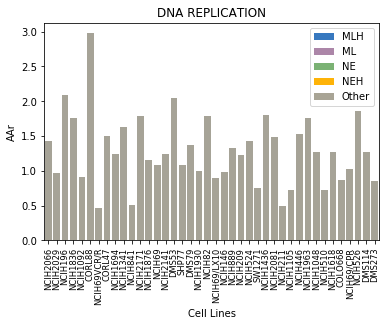

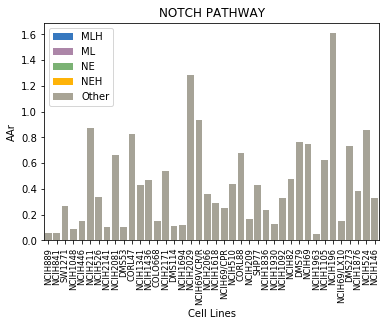

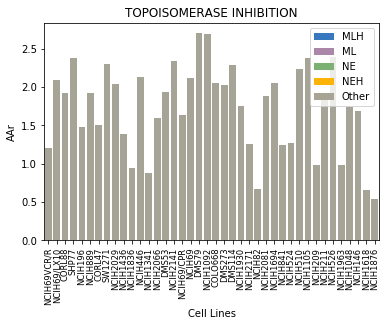

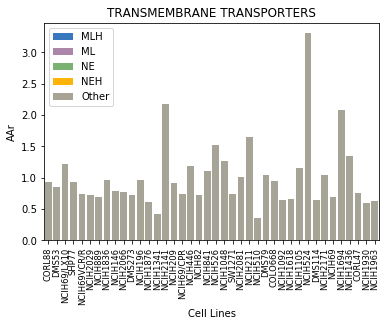

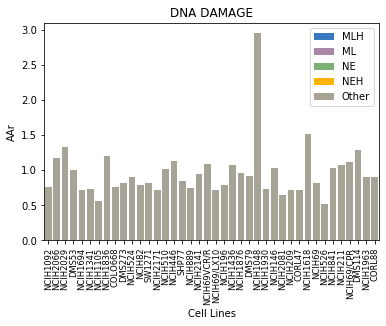

...

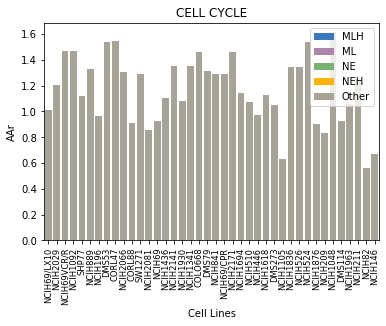

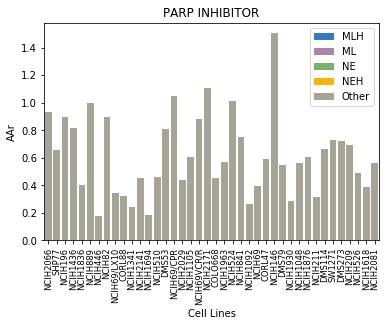

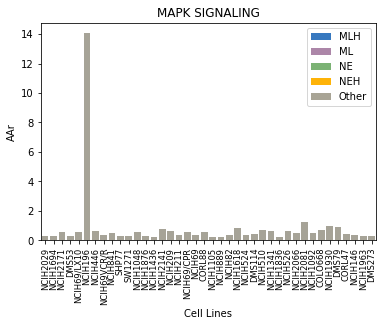

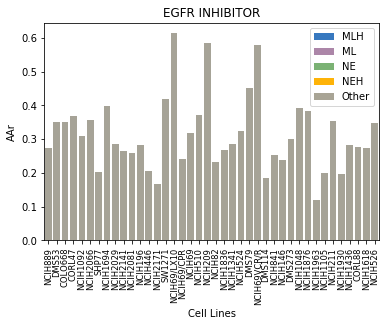

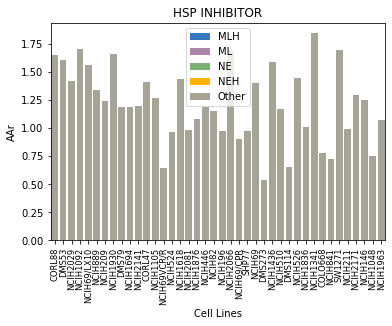

In [293]:
import matplotlib.text as txt
from matplotlib.patches import Patch

def waterfalldrugs(tar, metric):
    dls = targets[targets['PATHWAY'] == tar]['drug']
    pathway_df = drug_df[drug_df['drug'].isin(dls)]
#     pathway_df['logEC50'] = np.log(pathway_df['EC50'])
    pl = pathway_df[[metric,'cluster']]
    pl.index = pathway_df['cline']
    med = pl.groupby(pl.index)[metric].mean()
    med = med.sort_values()
    meds = pd.DataFrame(med, columns=[metric, 'cls'], index = med.index, dtype = float)
    meds.fillna(0)
    order = drug_df.groupby('cline').mean().sort_values('SCLC-Y').index.values
    for i,r in meds.iterrows():
        cid = list()
        for j in cluster_id.keys():
            cid.append(j)
        if i in cid:
            meds.loc[i,'cls'] = cluster_id[i]
        else: meds.loc[i,'cls'] = '[0]'

    c = ['[1]', '[2]', '[3]', '[4]', '[0]']
    co = ['windows blue', 'amber', 'faded green', 'dusty purple', 'greyish']
    palette_dir = pd.Series(co, index= c)
    sns.set_palette(sns.xkcd_palette(meds['cls'].map(palette_dir)))
    ax = sns.barplot(x=med.index, y = med, ci = 'sd', order=order) # palette=sns.xkcd_palette(pl['cluster'].map(palette_dir)))

    #ax = sns.barplot(x=pl.index, y = (pl['AAr']), ci = 'sd', order=med.index) # palette=sns.xkcd_palette(pl['cluster'].map(palette_dir)))
    ax.set_xticklabels(med.index, rotation = 90, fontdict ={'fontsize':'small'})
    plt.title(tar)
    ax.set_xlabel('Cell Lines')
#     ax.text(.3, 2.1, 'MLH', color= ('#3778bf'), fontdict={'fontsize':'xx-large', 'fontweight':'bold'})
#     ax.text(.3, 1.9, 'ML', color= ('#ac86a8'), fontdict={'fontsize':'xx-large','fontweight':'bold'})
#     ax.text(.3, 1.7, 'NE', color= ('#7bb274'), fontdict={'fontsize':'xx-large','fontweight':'bold'})
#     ax.text(.3, 1.5, 'NEH', color= ('#feb308'), fontdict={'fontsize':'xx-large','fontweight':'bold'})
#     ax.text(.3, 1.3, 'Other', color= ('#a8a495'), fontdict={'fontsize':'xx-large','fontweight':'bold'})

    legend_elements = [Patch(facecolor='#3778bf', label='MLH'), Patch(facecolor='#ac86a8', label='ML'),
                      Patch(facecolor='#7bb274', label='NE'), Patch(facecolor='#feb308', label = 'NEH'),
                      Patch(facecolor='#a8a495', label = 'Other')]
    ax.legend(handles=legend_elements, loc='best')
    plt.show()
    
for tar in set(targets['PATHWAY']):
    waterfalldrugs(tar, 'AAr')

## Comparing between phenotypes: AAr

In [15]:
all_drug = pd.read_csv('/Users/sarahmaddox/Quaranta_Lab/SCLC/Drug_response/Efficacy_Teicher_data_results_RNAseq.csv', index_col=0)

In [16]:
all_drug.head()

,sum,Emax,AAr,IC50,EC50,Emax_normalized-oneway_ANOVA_f-statistic,Emax_normalized-oneway_ANOVA_p,Emax_normalized-Kruskal_f-statistic,Emax_normalized-Kruskal_p,AAr-oneway_ANOVA_f-statistic,...,AAr-[3]_rank,AAr-[4]_rank,IC50-[1]_rank,IC50-[2]_rank,IC50-[3]_rank,IC50-[4]_rank,EC50-[1]_rank,EC50-[2]_rank,EC50-[3]_rank,EC50-[4]_rank
drug,,,,,,,,,,,,,,,,,,,,,
Digoxin,4,1,1,1,1,2.109521,0.118499,10.827424,0.012697,3.479025,...,3,2,3,2,0,1,3,2,0,1
OSU-03013,4,1,1,1,1,3.534166,0.025609,10.544713,0.014461,2.130165,...,1,3,3,1,2,0,3,2,1,0
AS-703569,3,0,1,1,1,0.272577,0.844705,3.908107,0.271559,5.130151,...,3,1,3,1,0,2,3,1,0,2
BMS-387032,3,0,1,1,1,1.097928,0.364257,3.245055,0.355363,3.094425,...,3,1,3,2,1,0,3,2,1,0
ABT-869,3,1,1,0,1,1.987291,0.135667,10.342665,0.015867,3.394949,...,2,3,0,2,1,3,1,2,3,0


In [17]:
all_drug['AAr-oneway_ANOVA_p'].head()

drug
Digoxin        0.027124
OSU-03013      0.115827
 AS-703569     0.005202
 BMS-387032    0.040674
ABT-869        0.029617
Name: AAr-oneway_ANOVA_p, dtype: float64

In [18]:
AAr_rank = pd.DataFrame(0, columns=['AAr-[1]_rank','AAr-[2]_rank','AAr-[3]_rank','AAr-[4]_rank'], index=[0, 1, 2, 3])
for i, r in all_drug.iterrows():
    for c in ['AAr-[1]_rank','AAr-[2]_rank','AAr-[3]_rank','AAr-[4]_rank']:
        AAr_rank.loc[r[c], c] = AAr_rank.loc[r[c], c] +1
        

In [19]:
AAr_rank

,AAr-[1]_rank,AAr-[2]_rank,AAr-[3]_rank,AAr-[4]_rank
0,279,81,76,83
1,115,103,164,137
2,64,155,160,140
3,61,180,119,159


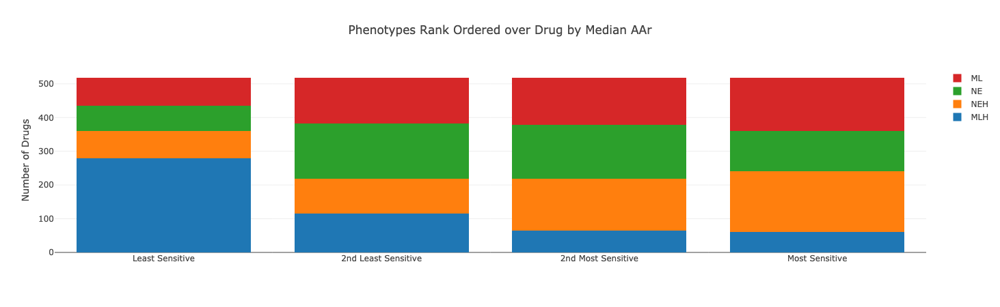

In [20]:
trace1 = go.Bar(
    y=AAr_rank['AAr-[1]_rank'],
    x = ['Least Sensitive', '2nd Least Sensitive', '2nd Most Sensitive', 'Most Sensitive'],
    name = 'MLH'
)
            
trace2 = go.Bar(
    y=AAr_rank['AAr-[2]_rank'],
    x = ['Least Sensitive', '2nd Least Sensitive', '2nd Most Sensitive', 'Most Sensitive'],
    name = 'NEH'

)
            
trace3 = go.Bar(
    y=AAr_rank['AAr-[3]_rank'],
    x = ['Least Sensitive', '2nd Least Sensitive', '2nd Most Sensitive', 'Most Sensitive'],
    name = 'NE'

)
            
trace4 = go.Bar(
    y=AAr_rank['AAr-[4]_rank'],
    x = ['Least Sensitive', '2nd Least Sensitive', '2nd Most Sensitive', 'Most Sensitive'],
    name = 'ML'

)


data = [trace1, trace2, trace3, trace4]
layout = go.Layout(title = "Phenotypes Rank Ordered over Drug by Median AAr ",
                   barmode='stack',
                   yaxis = dict(title ="Number of Drugs"),
                  xaxis = dict(
                  tickvals=[0,1,2,3],
                  ticktext=['Least Sensitive', '2nd Least Sensitive', '2nd Most Sensitive', 'Most Sensitive']))
fig = go.Figure(data=data, layout=layout)

iplot(fig)

### Which Drug Classes are Overrepresented in MLH Least Sensitive versus MLH Most Sensitive?

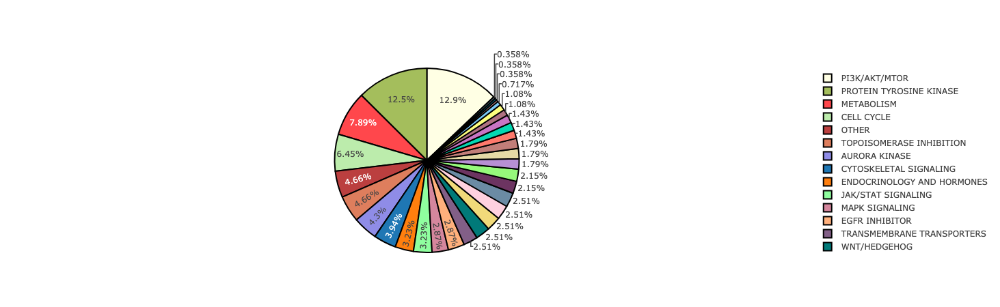

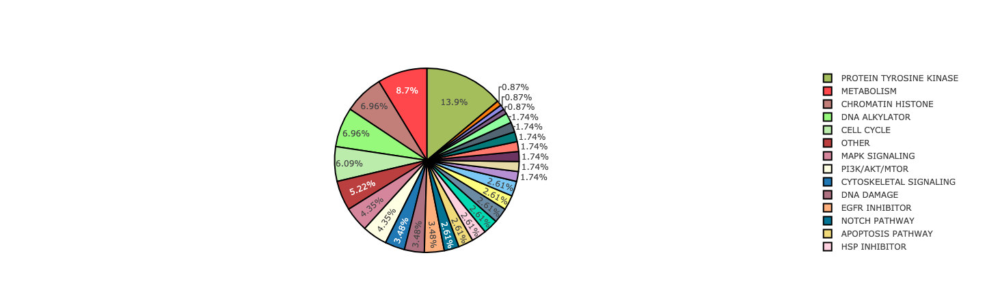

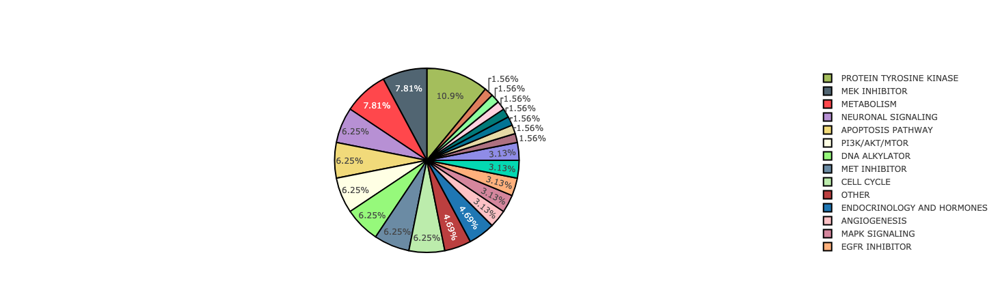

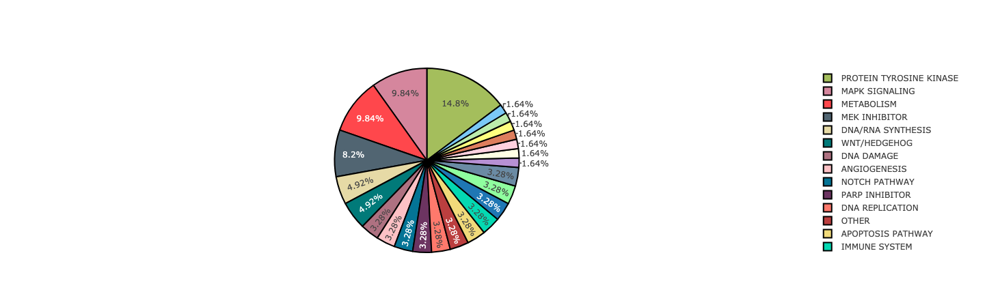

In [21]:
import plotly.plotly as py
import plotly.graph_objs as go
import re

least_1 = []
least_2 = []
most_2 = []
most_1 = []
for i, r in all_drug.iterrows():
    if r["AAr-[1]_rank"] == 0:
        ti = str(targets.loc[targets['drug']==i]['PATHWAY'].values)
        ti = re.sub('[\[\]\']', '', str(ti))
        least_1.append(ti)
    if r["AAr-[1]_rank"] == 1:
        ti = str(targets.loc[targets['drug']==i]['PATHWAY'].values)
        ti = re.sub('[\[\]\']', '', str(ti))
        least_2.append(ti)    
    if r["AAr-[1]_rank"] == 2:
        ti = str(targets.loc[targets['drug']==i]['PATHWAY'].values)
        ti = re.sub('[\[\]\']', '', str(ti))
        most_2.append(ti)
    if r["AAr-[1]_rank"] == 3:
        ti = str(targets.loc[targets['drug']==i]['PATHWAY'].values)
        ti = re.sub('[\[\]\']', '', str(ti))
        most_1.append(ti)
            
def pieplot(sens_list):

    labels = []
    values = []
    c = []
    for x in set(sens_list):
        labels.append(x)
        values.append(sens_list.count(x))
    for l in labels:
        c.append(colors_dict[l])
    trace = go.Pie(labels=labels, values=values, hoverinfo='label+value',
                  marker=dict(colors=c, line=dict(color='#000000', width=2)))

    iplot([trace])

for s in [least_1, least_2, most_2, most_1]:
    pieplot(s)

## Comparing Between Phenotypes: EC50 and Emax

In [22]:
EC50_rank = pd.DataFrame(0, columns=['EC50-[1]_rank','EC50-[2]_rank','EC50-[3]_rank','EC50-[4]_rank'], index=[0, 1, 2, 3])
for i, r in all_drug.iterrows():
    for c in ['EC50-[1]_rank','EC50-[2]_rank','EC50-[3]_rank','EC50-[4]_rank']:
        EC50_rank.loc[r[c], c] = EC50_rank.loc[r[c], c] +1
EC50_rank = EC50_rank.reindex(index=EC50_rank.index[::-1])

EC50_rank    

,EC50-[1]_rank,EC50-[2]_rank,EC50-[3]_rank,EC50-[4]_rank
3,236,100,58,125
2,121,93,145,158
1,80,155,179,107
0,82,171,137,129


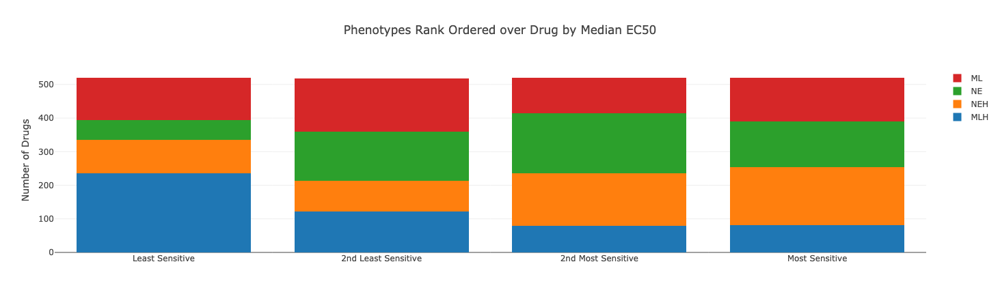

In [23]:


trace5 = go.Bar(
    y=EC50_rank['EC50-[1]_rank'],
    x = ['Least Sensitive', '2nd Least Sensitive', '2nd Most Sensitive', 'Most Sensitive'],
    name = 'MLH'

)
trace6 = go.Bar(
    y=EC50_rank['EC50-[2]_rank'],
    x = ['Least Sensitive', '2nd Least Sensitive', '2nd Most Sensitive', 'Most Sensitive'],
    name = 'NEH'

)
trace7 = go.Bar(
    y=EC50_rank['EC50-[3]_rank'],
    x = ['Least Sensitive', '2nd Least Sensitive', '2nd Most Sensitive', 'Most Sensitive'],
    name = 'NE'

)
trace8 = go.Bar(
    y=EC50_rank['EC50-[4]_rank'],
    x = ['Least Sensitive', '2nd Least Sensitive', '2nd Most Sensitive', 'Most Sensitive'],
    name = 'ML'

)

data = [trace5, trace6, trace7, trace8]
layout = go.Layout(title = "Phenotypes Rank Ordered over Drug by Median EC50",
                  barmode='stack',
                  yaxis = dict(title ="Number of Drugs"),
                  xaxis = dict(
                  tickvals=[0,1,2,3],
                  ticktext=['Least Sensitive', '2nd Least Sensitive', '2nd Most Sensitive', 'Most Sensitive']))
fig = go.Figure(data=data, layout=layout)

iplot(fig)

In [24]:
Emax_rank = pd.DataFrame(0, columns=['Emax_normalized-[1]_rank','Emax_normalized-[2]_rank',
                                     'Emax_normalized-[3]_rank','Emax_normalized-[4]_rank'], index=[0, 1, 2, 3])
for i, r in all_drug.iterrows():
    if r['Emax_normalized-[1]_median_value']>0: 
        for c in ['Emax_normalized-[1]_rank','Emax_normalized-[2]_rank','Emax_normalized-[3]_rank','Emax_normalized-[4]_rank']:
            Emax_rank.loc[r[c], c] = Emax_rank.loc[r[c], c] +1
Emax_rank = Emax_rank.reindex(index=Emax_rank.index[::-1])
Emax_rank.head()

,Emax_normalized-[1]_rank,Emax_normalized-[2]_rank,Emax_normalized-[3]_rank,Emax_normalized-[4]_rank
3,239,72,72,62
2,97,92,153,103
1,66,135,119,125
0,43,146,101,155


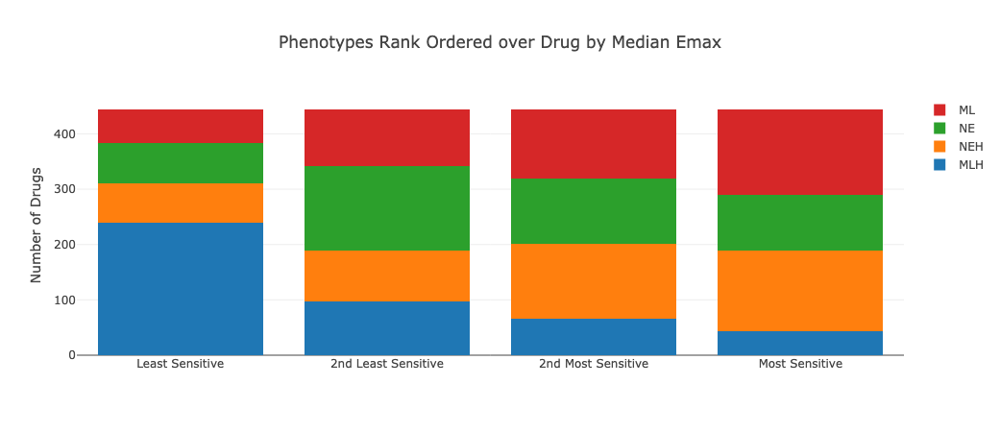

In [85]:
trace9 = go.Bar(
    y=Emax_rank['Emax_normalized-[1]_rank'],
    x = ['Least Sensitive', '2nd Least Sensitive', '2nd Most Sensitive', 'Most Sensitive'],
    name = 'MLH'

)
trace10 = go.Bar(
    y=Emax_rank['Emax_normalized-[2]_rank'],
    x = ['Least Sensitive', '2nd Least Sensitive', '2nd Most Sensitive', 'Most Sensitive'],
    name = 'NEH'

)
trace11 = go.Bar(
    y=Emax_rank['Emax_normalized-[3]_rank'],
    x = ['Least Sensitive', '2nd Least Sensitive', '2nd Most Sensitive', 'Most Sensitive'],
    name = 'NE'

)
trace12 = go.Bar(
    y=Emax_rank['Emax_normalized-[4]_rank'],
    x = ['Least Sensitive', '2nd Least Sensitive', '2nd Most Sensitive', 'Most Sensitive'],
    name = 'ML'

)

data = [trace9, trace10, trace11, trace12]
layout = go.Layout(title = "Phenotypes Rank Ordered over Drug by Median Emax",
                  barmode='stack',
                  yaxis = dict(title ="Number of Drugs"),
                  xaxis = dict(
                  tickvals=[0,1,2,3],
                  ticktext=['Least Sensitive', '2nd Least Sensitive', '2nd Most Sensitive', 'Most Sensitive']))
fig = go.Figure(data=data, layout=layout)

iplot(fig)

In [86]:
df.head()


,Unnamed: 0,cline,drug,slope,Emax,E0,logEC50,EC50,rrEmax,e50,rrE50,IC10,IC50,IC100,Emaxobs,rrEmaxobs,AAr,Emax_normalized,cluster
0,14027,COLO 668,1st Precursur Intermediate to TDP 665759,2.968977,85.549745,101.281703,-5.229148,5.900000e-06,0.844671,93.415724,0.922336,0.000007,NaN,NaN,88.273333,NaN,0.039891,84.467127,[1]
1,15044,COR L88,1st Precursur Intermediate to TDP 665759,0.829663,78.054403,98.248318,-5.181774,6.580000e-06,0.794460,88.151361,0.897230,0.000006,NaN,NaN,86.203333,NaN,0.094890,79.446045,[1]
2,14533,COR-L47,1st Precursur Intermediate to TDP 665759,2.429114,97.544478,100.462068,-5.863279,1.370000e-06,0.970958,99.003273,0.985479,NaN,NaN,NaN,94.896667,NaN,0.025148,97.095829,[3]
3,4824,DMS 114,1st Precursur Intermediate to TDP 665759,3.853491,74.658698,99.135093,-4.978811,1.050000e-05,0.753101,86.896896,0.876550,0.000009,NaN,NaN,88.000000,NaN,0.016884,75.310060,[4]
4,5333,DMS 273,1st Precursur Intermediate to TDP 665759,-0.158879,98.891630,103.255862,-6.463442,3.440000e-07,0.957734,101.073746,0.978867,NaN,NaN,NaN,96.486667,NaN,0.195073,95.773381,[2]


In [87]:
all_drug.head()

,sum,Emax,AAr,IC50,EC50,Emax_normalized-oneway_ANOVA_f-statistic,Emax_normalized-oneway_ANOVA_p,Emax_normalized-Kruskal_f-statistic,Emax_normalized-Kruskal_p,AAr-oneway_ANOVA_f-statistic,...,AAr-[3]_rank,AAr-[4]_rank,IC50-[1]_rank,IC50-[2]_rank,IC50-[3]_rank,IC50-[4]_rank,EC50-[1]_rank,EC50-[2]_rank,EC50-[3]_rank,EC50-[4]_rank
drug,,,,,,,,,,,,,,,,,,,,,
Digoxin,4,1,1,1,1,2.109521,0.118499,10.827424,0.012697,3.479025,...,3,2,3,2,0,1,3,2,0,1
OSU-03013,4,1,1,1,1,3.534166,0.025609,10.544713,0.014461,2.130165,...,1,3,3,1,2,0,3,2,1,0
AS-703569,3,0,1,1,1,0.272577,0.844705,3.908107,0.271559,5.130151,...,3,1,3,1,0,2,3,1,0,2
BMS-387032,3,0,1,1,1,1.097928,0.364257,3.245055,0.355363,3.094425,...,3,1,3,2,1,0,3,2,1,0
ABT-869,3,1,1,0,1,1.987291,0.135667,10.342665,0.015867,3.394949,...,2,3,0,2,1,3,1,2,3,0


In [88]:
targets.head()

,drug,Target,PATHWAY
0,AZD-4547,"FGFR, FGFR1, FGFR2, FGFR3",ANGIOGENESIS
1,Bosutinib,"ABL1, SRC",ANGIOGENESIS
2,EMD-121974,NaN,ANGIOGENESIS
3,KX2-391,SRC,ANGIOGENESIS
4,OT-674,NaN,ANGIOGENESIS


## AAr Across Phenotypes for Significant Drugs

[' AS-703569 ', 'Belinostat', 'BEZ-235', 'BGT-226', 'CEP-18770', 'MP-0922', 'ONX-0912  ', 'PF-4942847', 'Ponatinib', 'XL-880', 'XL-888', '(+)-JQ1', 'Astex FGF inhibitor', 'AZD-1152', 'BAY-86-9766', 'GSK-1210151A', 'INK-128', 'MK-8033 ', 'OSI-027', 'PF-04691502', 'PF-04929113', 'RG-7603', ' 1st Precursur Intermediate to TDP 665759', 'Celecoxib', 'JI-101', 'Palbociclib', 'PF-05212384', 'R-788', 'WZ-4002']
29
['CYTOSKELETAL SIGNALING'] 1
['PROTEIN TYROSINE KINASE'] 3
['EGFR INHIBITOR'] 2
['OTHER'] 2
['CHROMATIN HISTONE'] 1
['AURORA KINASE'] 2
['PI3K/AKT/MTOR'] 7
['PROTEASES'] 1
['METABOLISM'] 1
['HSP INHIBITOR'] 2
['CHROMATIN'] 2
['ENDOCRINOLOGY AND HORMONES'] 1
['MET INHIBITOR'] 2
['MEK INHIBITOR'] 1
['CELL CYCLE'] 1
Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    2.2544   0.4077 4.1011  True 
 [1]    [3]    2.0292   0.4258 3.6326  True 
 [1]    [4]    2.2249   0.4323 4.0176  True 

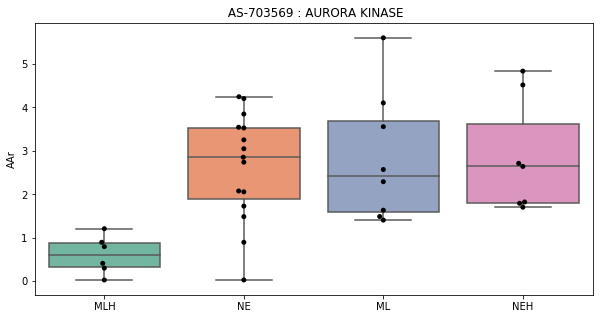

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.4139   0.0035 0.8243  True 
 [1]    [3]    0.3755   0.0192 0.7318  True 
 [1]    [4]    0.0738  -0.3246 0.4722 False 
 [2]    [3]   -0.0384  -0.3761 0.2992 False 
 [2]    [4]   -0.3401  -0.7219 0.0416 False 
 [3]    [4]   -0.3017  -0.6247 0.0212 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


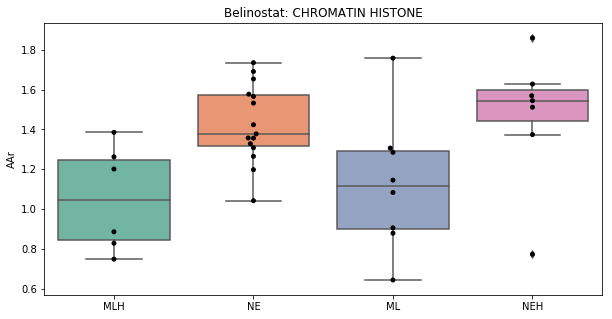

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.6621   0.0438 1.2804  True 
 [1]    [3]    0.7248   0.1879 1.2616  True 
 [1]    [4]    1.012    0.4118 1.6121  True 
 [2]    [3]    0.0627   -0.446 0.5714 False 
 [2]    [4]    0.3499  -0.2253 0.9251 False 
 [3]    [4]    0.2872  -0.1993 0.7737 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


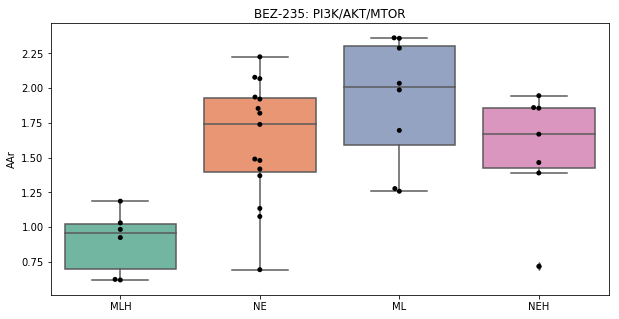

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.8919  -0.1311 1.9149 False 
 [1]    [3]    0.7717  -0.1165 1.6599 False 
 [1]    [4]    1.3715   0.3784 2.3645  True 
 [2]    [3]   -0.1202  -0.9619 0.7215 False 
 [2]    [4]    0.4795  -0.4721 1.4312 False 
 [3]    [4]    0.5998  -0.2052 1.4048 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


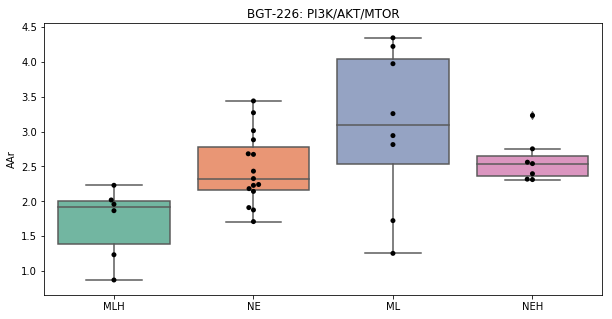

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.672    0.1842 1.1598  True 
 [1]    [3]    0.422   -0.0015 0.8456 False 
 [1]    [4]    0.4417  -0.0318 0.9153 False 
 [2]    [3]    -0.25   -0.6513 0.1514 False 
 [2]    [4]   -0.2303  -0.6841 0.2236 False 
 [3]    [4]    0.0197  -0.3642 0.4036 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


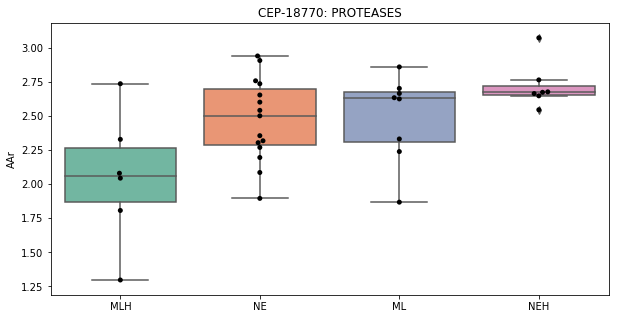

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower   upper  reject
---------------------------------------------
 [1]    [2]    0.102   -0.2958  0.4998 False 
 [1]    [3]    0.3578   0.0124  0.7032  True 
 [1]    [4]    0.0028  -0.3834  0.389  False 
 [2]    [3]    0.2558  -0.0715  0.5831 False 
 [2]    [4]   -0.0992  -0.4693  0.2709 False 
 [3]    [4]    -0.355   -0.668 -0.0419  True 
---------------------------------------------
['[1]' '[2]' '[3]' '[4]']


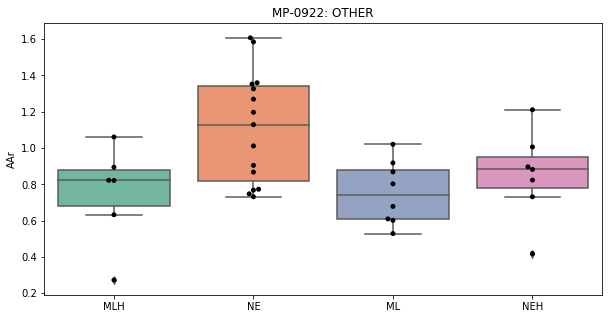

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower   upper  reject
---------------------------------------------
 [1]    [2]    0.6128   0.1649  1.0607  True 
 [1]    [3]    0.4441   0.0552  0.833   True 
 [1]    [4]    0.1687  -0.2661  0.6035 False 
 [2]    [3]   -0.1687  -0.5372  0.1999 False 
 [2]    [4]   -0.4441  -0.8608 -0.0274  True 
 [3]    [4]   -0.2755  -0.6279  0.077  False 
---------------------------------------------
['[1]' '[2]' '[3]' '[4]']


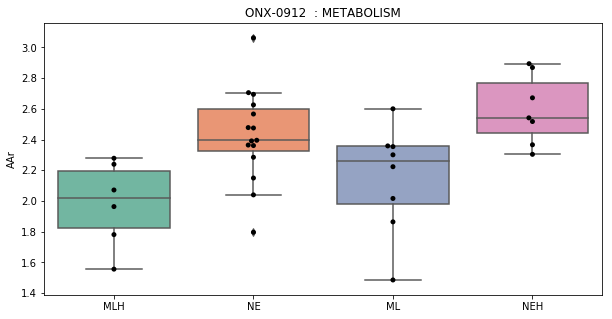

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.4704  -0.1339 1.0747 False 
 [1]    [3]    0.2665  -0.2581 0.7912 False 
 [1]    [4]    0.9005   0.3139 1.4871  True 
 [2]    [3]   -0.2039   -0.701 0.2933 False 
 [2]    [4]    0.4301   -0.132 0.9922 False 
 [3]    [4]    0.634    0.1585 1.1095  True 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


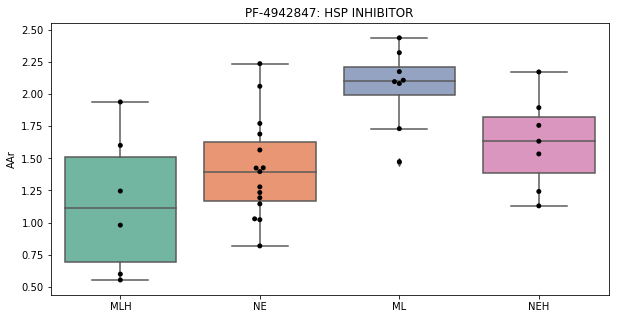

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.1605  -0.1903 0.5113 False 
 [1]    [3]    0.0188  -0.2858 0.3234 False 
 [1]    [4]    0.4028   0.0623 0.7434  True 
 [2]    [3]   -0.1417  -0.4303 0.147  False 
 [2]    [4]    0.2423   -0.084 0.5687 False 
 [3]    [4]    0.384    0.1079 0.6601  True 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


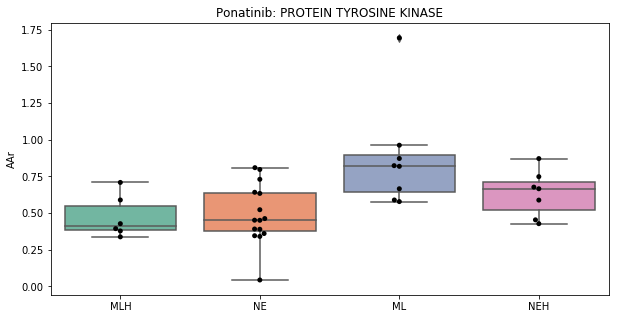

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.5066   0.0936 0.9196  True 
 [1]    [3]    0.3934   0.0348 0.752   True 
 [1]    [4]    0.5311   0.1302 0.9321  True 
 [2]    [3]   -0.1132   -0.453 0.2266 False 
 [2]    [4]    0.0245  -0.3597 0.4087 False 
 [3]    [4]    0.1377  -0.1873 0.4627 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


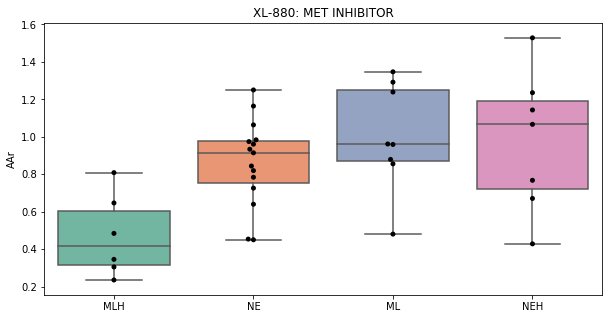

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.5072  -0.1485 1.163  False 
 [1]    [3]    0.2611  -0.3083 0.8304 False 
 [1]    [4]    0.9242   0.2876 1.5608  True 
 [2]    [3]   -0.2461  -0.7857 0.2934 False 
 [2]    [4]    0.417    -0.193 1.027  False 
 [3]    [4]    0.6631   0.1471 1.1792  True 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


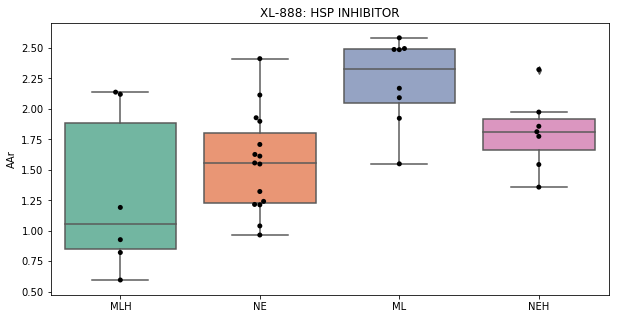

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower   upper  reject
---------------------------------------------
 [1]    [2]    0.505   -0.0681  1.078  False 
 [1]    [3]   -0.0179  -0.5155  0.4796 False 
 [1]    [4]    0.5114  -0.0449  1.0677 False 
 [2]    [3]   -0.5229  -0.9944 -0.0514  True 
 [2]    [4]    0.0064  -0.5267  0.5395 False 
 [3]    [4]    0.5293   0.0784  0.9803  True 
---------------------------------------------
['[1]' '[2]' '[3]' '[4]']


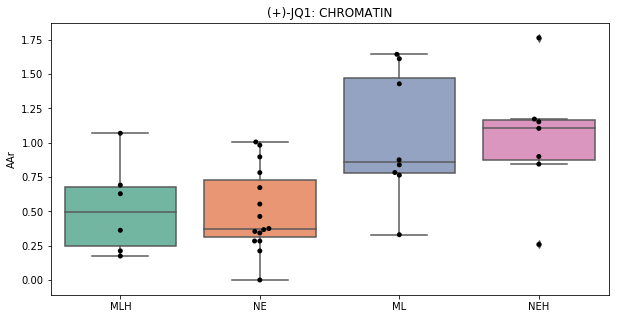

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.4356   0.0853 0.7859  True 
 [1]    [3]    0.1294  -0.1748 0.4335 False 
 [1]    [4]    0.393    0.053  0.7331  True 
 [2]    [3]   -0.3062  -0.5944 -0.018  True 
 [2]    [4]   -0.0426  -0.3684 0.2833 False 
 [3]    [4]    0.2636   -0.012 0.5393 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


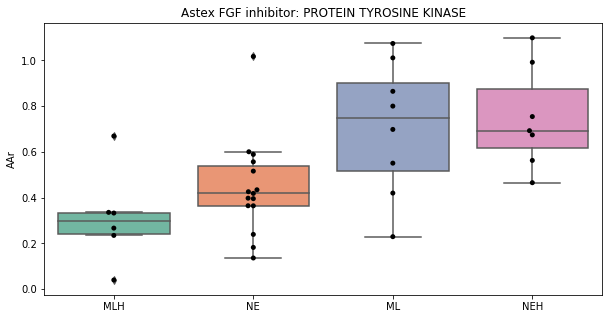

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    2.0619   0.6542 3.4696  True 
 [1]    [3]    1.5781   0.3559 2.8004  True 
 [1]    [4]    1.077   -0.2894 2.4435 False 
 [2]    [3]   -0.4838  -1.6419 0.6744 False 
 [2]    [4]   -0.9849  -2.2944 0.3247 False 
 [3]    [4]   -0.5011  -1.6088 0.6066 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


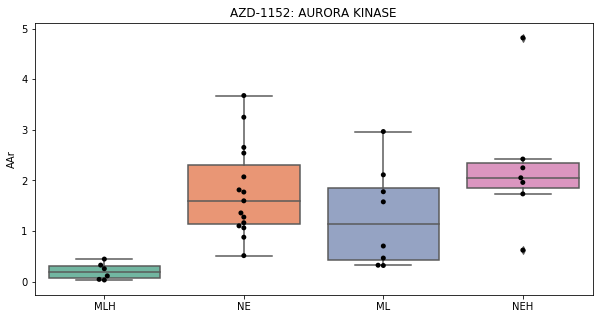

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower   upper  reject
---------------------------------------------
 [1]    [2]   -0.7327  -1.3635 -0.1019  True 
 [1]    [3]   -0.3423  -0.8986  0.214  False 
 [1]    [4]   -0.7605  -1.3746 -0.1464  True 
 [2]    [3]    0.3904  -0.1027  0.8835 False 
 [2]    [4]   -0.0278  -0.5853  0.5297 False 
 [3]    [4]   -0.4182  -0.8898  0.0534 False 
---------------------------------------------
['[1]' '[2]' '[3]' '[4]']


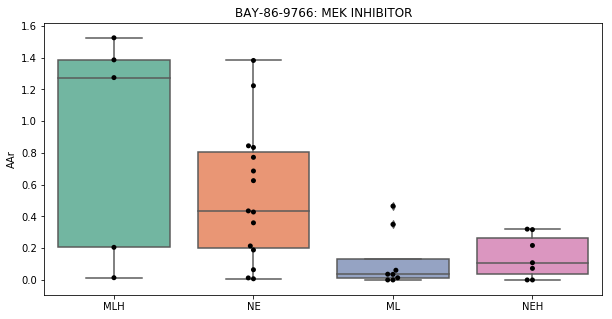

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.3696   -0.101 0.8403 False 
 [1]    [3]   -0.0016  -0.4102 0.4071 False 
 [1]    [4]    0.4783   0.0215 0.9352  True 
 [2]    [3]   -0.3712  -0.7584 0.016  False 
 [2]    [4]    0.1087  -0.3291 0.5465 False 
 [3]    [4]    0.4799   0.1096 0.8503  True 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


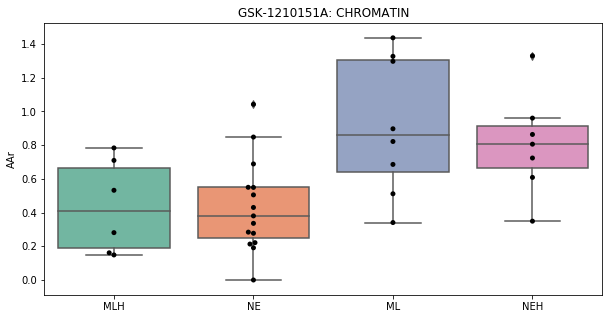

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.7214  -0.1796 1.6223 False 
 [1]    [3]    0.5324  -0.2499 1.3146 False 
 [1]    [4]    1.1769   0.3023 2.0515  True 
 [2]    [3]    -0.189  -0.9303 0.5522 False 
 [2]    [4]    0.4555  -0.3826 1.2936 False 
 [3]    [4]    0.6445  -0.0644 1.3535 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


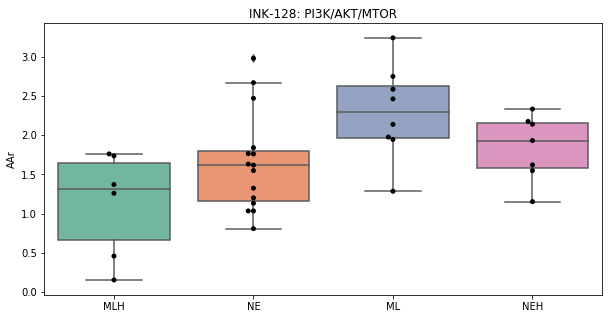

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower   upper  reject
---------------------------------------------
 [1]    [2]   -0.9037   -1.621 -0.1864  True 
 [1]    [3]   -0.7835  -1.4063 -0.1608  True 
 [1]    [4]   -0.9602  -1.6565  -0.264  True 
 [2]    [3]    0.1202   -0.47   0.7103 False 
 [2]    [4]   -0.0566  -0.7238  0.6107 False 
 [3]    [4]   -0.1767  -0.7411  0.3877 False 
---------------------------------------------
['[1]' '[2]' '[3]' '[4]']


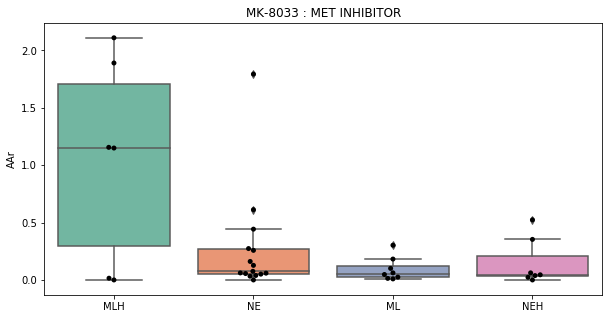

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.5241  -0.0115 1.0597 False 
 [1]    [3]    0.4737   0.0086 0.9387  True 
 [1]    [4]    0.8117   0.2917 1.3316  True 
 [2]    [3]   -0.0505  -0.4911 0.3902 False 
 [2]    [4]    0.2875  -0.2107 0.7858 False 
 [3]    [4]    0.338   -0.0835 0.7595 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


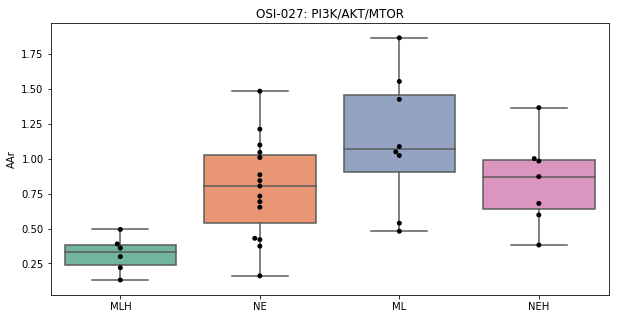

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.5869  -0.0332 1.207  False 
 [1]    [3]    0.5665   0.0281 1.1049  True 
 [1]    [4]    0.8538   0.2518 1.4557  True 
 [2]    [3]   -0.0204  -0.5306 0.4897 False 
 [2]    [4]    0.2668   -0.31  0.8437 False 
 [3]    [4]    0.2873  -0.2007 0.7752 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


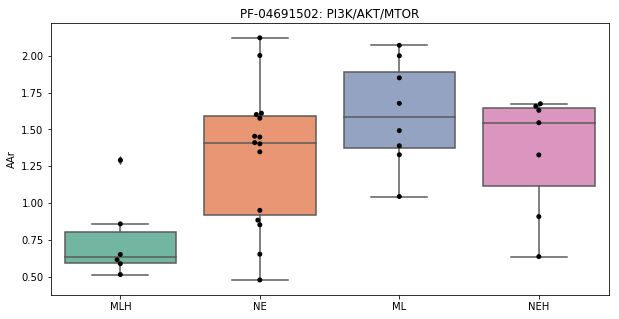

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.4837  -0.1843 1.1517 False 
 [1]    [3]    0.279    -0.301 0.8589 False 
 [1]    [4]    0.8964   0.248  1.5448  True 
 [2]    [3]   -0.2047  -0.7543 0.3449 False 
 [2]    [4]    0.4127  -0.2087 1.0341 False 
 [3]    [4]    0.6174   0.0918 1.1431  True 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


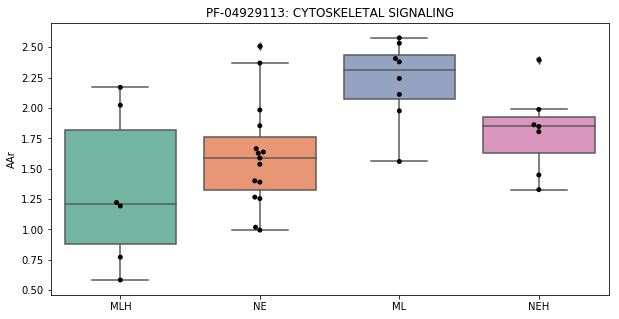

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.2751  -0.2265 0.7767 False 
 [1]    [3]    0.3244  -0.1111 0.7599 False 
 [1]    [4]    0.6532   0.1663 1.1401  True 
 [2]    [3]    0.0493  -0.3634 0.462  False 
 [2]    [4]    0.3781  -0.0885 0.8447 False 
 [3]    [4]    0.3288  -0.0659 0.7235 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


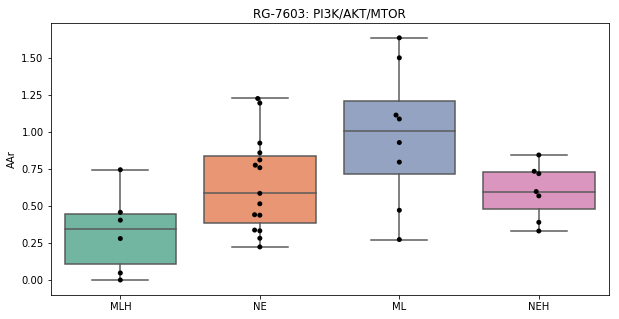

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower   upper  reject
---------------------------------------------
 [1]    [2]    0.376    0.0488  0.7031  True 
 [1]    [3]    0.0371   -0.247  0.3211 False 
 [1]    [4]    0.002   -0.3156  0.3196 False 
 [2]    [3]   -0.3389  -0.6081 -0.0697  True 
 [2]    [4]    -0.374  -0.6784 -0.0697  True 
 [3]    [4]   -0.0351  -0.2926  0.2224 False 
---------------------------------------------
['[1]' '[2]' '[3]' '[4]']


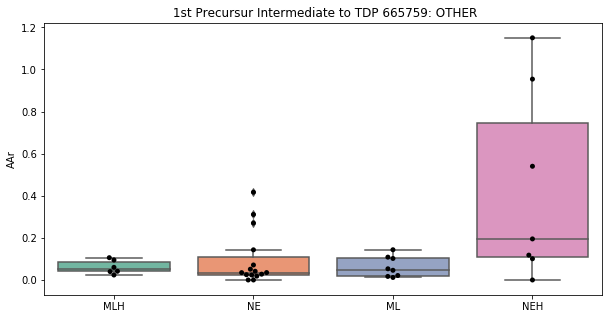

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower   upper  reject
---------------------------------------------
 [1]    [2]    0.0238   -0.716  0.7635 False 
 [1]    [3]    0.6707   0.0219  1.3195  True 
 [1]    [4]    0.0527   -0.687  0.7925 False 
 [2]    [3]    0.6469   0.0314  1.2625  True 
 [2]    [4]    0.029   -0.6818  0.7397 False 
 [3]    [4]    -0.618  -1.2335 -0.0025  True 
---------------------------------------------
['[1]' '[2]' '[3]' '[4]']


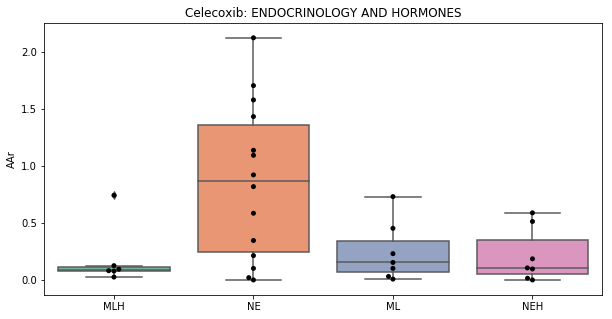

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower   upper  reject
---------------------------------------------
 [1]    [2]    0.513    0.0134  1.0125  True 
 [1]    [3]   -0.0286  -0.4692  0.4119 False 
 [1]    [4]   -0.0139  -0.5003  0.4724 False 
 [2]    [3]   -0.5416  -0.9321 -0.1511  True 
 [2]    [4]   -0.5269  -0.9684 -0.0854  True 
 [3]    [4]    0.0147  -0.3588  0.3882 False 
---------------------------------------------
['[1]' '[2]' '[3]' '[4]']


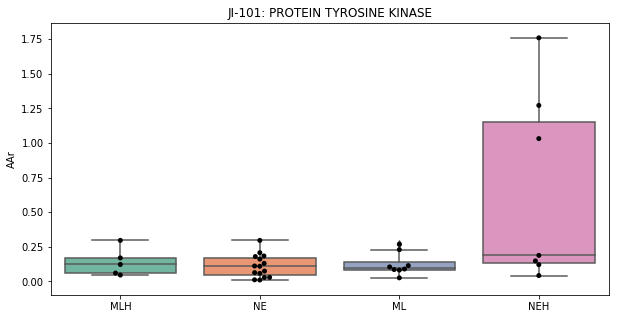

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]   -0.0522  -0.4337 0.3293 False 
 [1]    [3]   -0.0201  -0.3513 0.3112 False 
 [1]    [4]    0.3489  -0.0214 0.7193 False 
 [2]    [3]    0.0322  -0.2817 0.346  False 
 [2]    [4]    0.4011   0.0462 0.7561  True 
 [3]    [4]    0.369    0.0688 0.6692  True 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


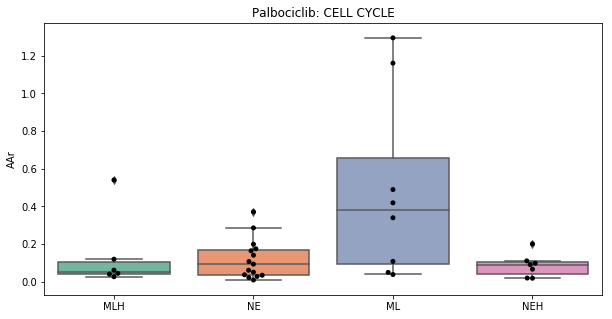

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.8668   0.0895 1.6441  True 
 [1]    [3]    0.8257   0.1509 1.5006  True 
 [1]    [4]    1.0555   0.301   1.81   True 
 [2]    [3]   -0.0411  -0.6806 0.5984 False 
 [2]    [4]    0.1887  -0.5343 0.9118 False 
 [3]    [4]    0.2298  -0.3818 0.8414 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


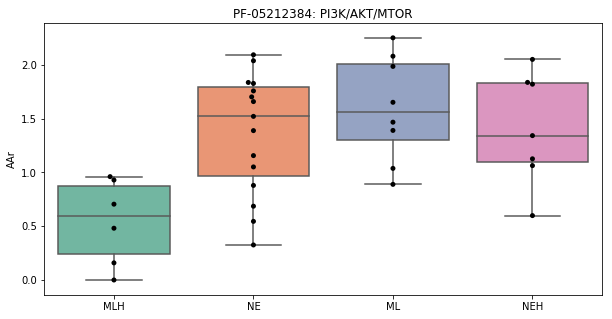

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.1049  -0.1963 0.4061 False 
 [1]    [3]   -0.0043  -0.2658 0.2572 False 
 [1]    [4]    0.4417   0.1493 0.7341  True 
 [2]    [3]   -0.1092   -0.357 0.1386 False 
 [2]    [4]    0.3368   0.0566 0.617   True 
 [3]    [4]    0.446    0.209  0.683   True 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


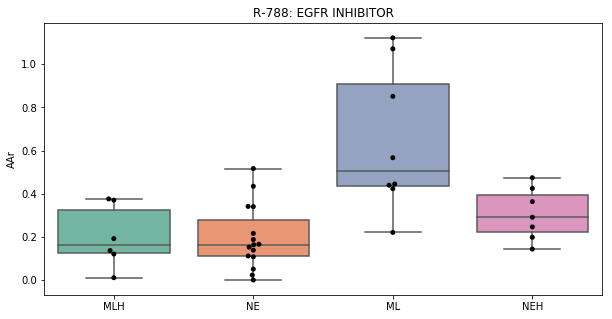

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.1261  -0.0391 0.2913 False 
 [1]    [3]    0.1503   0.0069 0.2938  True 
 [1]    [4]    0.2533   0.093  0.4137  True 
 [2]    [3]    0.0242  -0.1117 0.1602 False 
 [2]    [4]    0.1272  -0.0265 0.2809 False 
 [3]    [4]    0.103    -0.027 0.233  False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


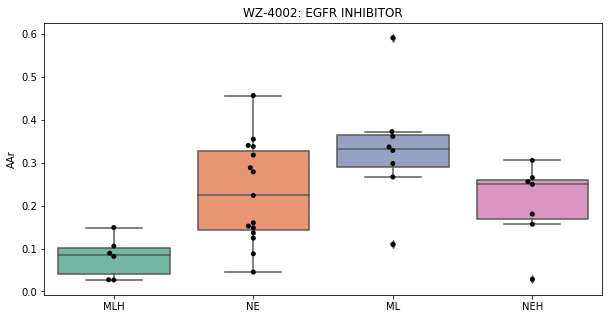

In [89]:
import re
from statsmodels.stats.multicomp import pairwise_tukeyhsd
from statsmodels.stats.multicomp import MultiComparison   

plt.rcParams['figure.figsize'] = [10, 5]

d = []
pval = []
for q, r in all_drug.iterrows():
    if (r['AAr-oneway_ANOVA_p']) < .01:
        d.append(q)
        pval.append(r['AAr-oneway_ANOVA_p'])
print(d)
print(len(d))
tlist=[]
for i in range(len(d)):
    tlist.append(str(targets.loc[targets['drug']==d[i]]['PATHWAY'].values))
for x in set(tlist):
    print(x,tlist.count(x)) 

for i in range(len(d)):
    p = df.loc[df['drug'] == d[i]]
    p = p.loc[p['cluster'].isnull().values== False]
    mc = MultiComparison(p['AAr
                           '], p['cluster'])
    result = mc.tukeyhsd()
    print(result)
    print(mc.groupsunique)
    ax = sns.boxplot(x = [get_pheno(t) for t in p['cluster']], y = p['AAr'], palette=sns.color_palette("Set2", 10))
    sns.swarmplot(x = [get_pheno(t) for t in p['cluster']], y = p['AAr'], color = 'k')
    ti = d[i] + ": " + targets.loc[targets['drug']==d[i]]['PATHWAY'].values #+ " p = " + str(round(pval[i],4))
    ti = re.sub('[\[\]\']', '', str(ti))
    ax.set_title(ti)
    plt.show()

## EC50 Across Phenotypes for Significant Drugs

In [8]:
all_drug.head()

,sum,Emax,AAr,IC50,logEC50,Emax_normalized-oneway_ANOVA_f-statistic,Emax_normalized-oneway_ANOVA_p,Emax_normalized-Kruskal_f-statistic,Emax_normalized-Kruskal_p,AAr-oneway_ANOVA_f-statistic,...,IC50-[1]_rank,IC50-[2]_rank,IC50-[3]_rank,IC50-[4]_rank,logEC50-[1]_rank,logEC50-[2]_rank,logEC50-[3]_rank,logEC50-[4]_rank,AAr_padj,logEC50_padj
drug,,,,,,,,,,,,,,,,,,,,,
1st Precursur Intermediate to TDP 665759,1,0,1,0,0,1.050934,0.383525,7.168512,0.066716,5.129902,...,0,1,2,3,2,0,1,3,0.135013,0.573435
AS-703569,2,0,1,0,1,0.272577,0.844705,3.908107,0.271559,5.130151,...,3,1,0,2,3,1,0,2,0.135013,0.131375
BMS-387032,3,0,1,1,1,1.097928,0.364257,3.245055,0.355363,3.094425,...,3,2,1,0,3,2,1,0,0.315068,0.258499
Dabrafenib,0,0,0,0,0,1.078191,0.372237,1.773273,0.620768,2.222080,...,0,1,2,3,3,1,0,2,0.421072,0.415749
Pazopanib,0,0,0,0,0,0.363446,0.779811,1.122147,0.771731,1.495840,...,0,1,2,3,1,0,2,3,0.582012,0.653587


[' AS-703569 ', 'ABT-869', 'AMD-473', 'AMG-208', 'Astex FGF inhibitor', 'AVN-944', 'Belinostat', 'BEZ-235', 'BMN-673', 'BMS-777607', 'BX-912', 'CEP-18770', 'CT-32228', 'CYT-997', 'GSK-1210151A', 'GSK-1838705A', 'KX2-391', 'Omacetaxine mepasuccinate', 'ONX-0912  ', 'OSI-027', 'PP-242', 'Y-27632']
22
['AURORA KINASE'] 1
['DNA REPLICATION'] 1
['PROTEASES'] 1
['METABOLISM'] 2
['DNA ALKYLATOR'] 1
['CHROMATIN'] 1
['PI3K/AKT/MTOR'] 4
['CHROMATIN HISTONE'] 1
['PARP INHIBITOR'] 1
['CYTOSKELETAL SIGNALING'] 1
['PROTEIN TYROSINE KINASE'] 4
['MET INHIBITOR'] 2
['ANGIOGENESIS'] 1
['OTHER'] 1


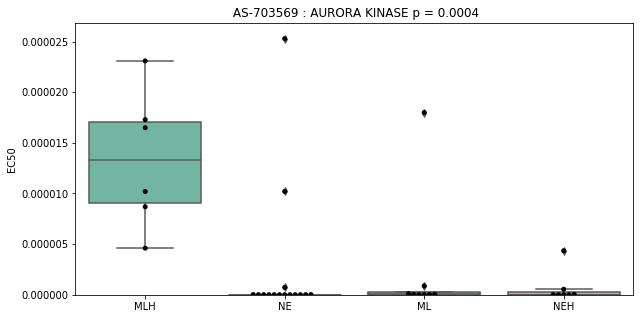

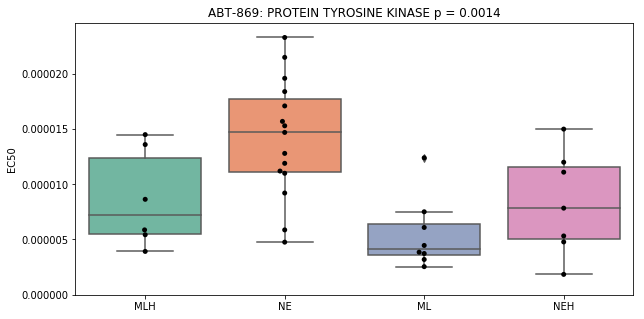

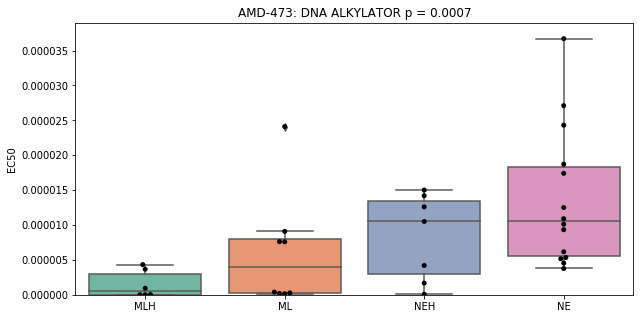

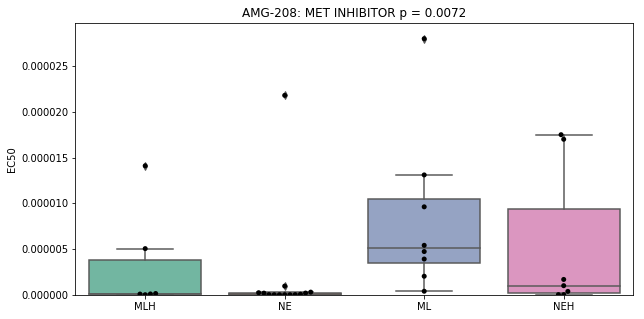

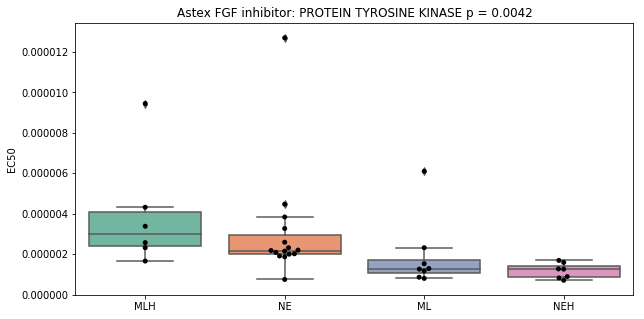

...

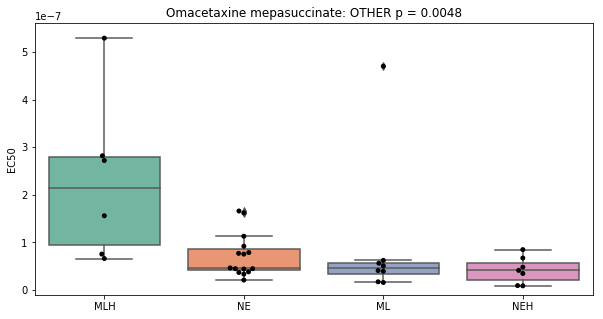

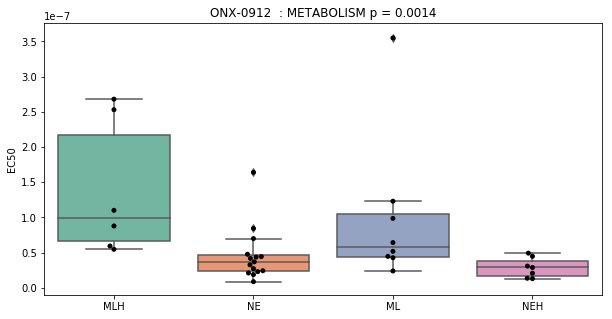

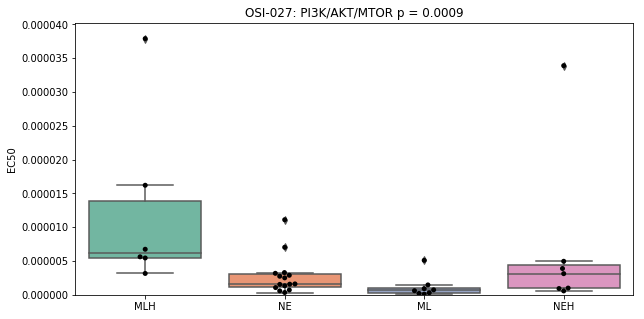

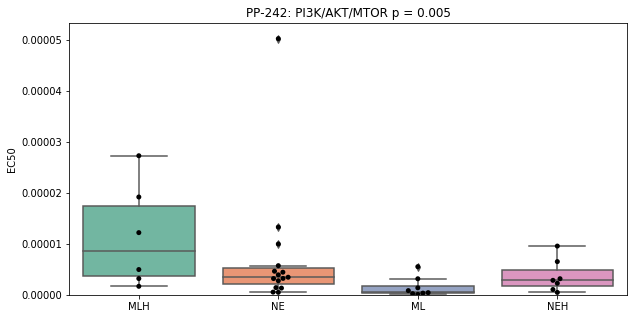

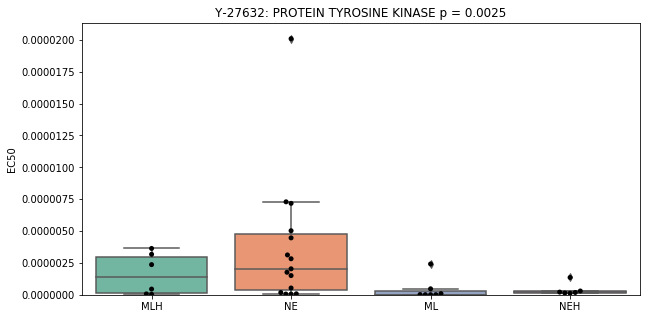

In [5]:
import re
plt.rcParams['figure.figsize'] = [10, 5]

d2 = []
pval2 = []
for q2, r2 in all_drug.iterrows():
    if (r2['logEC50-oneway_ANOVA_p']) < .01:
        d2.append(q2)
        pval2.append(r2['logEC50-oneway_ANOVA_p'])
print(d2)
print(len(d2))
tlist2=[]
for i in range(len(d2)):
    tlist2.append(str(targets.loc[targets['drug']==d2[i]]['PATHWAY'].values))
for x2 in set(tlist2):
    print(x2,tlist2.count(x2)) 

for i in range(len(d2)):
    p2 = df.loc[df['drug'] == d2[i]]
    p2 = p2.loc[p2['cluster'].isnull().values== False]
    ax2 = sns.boxplot(x = [get_pheno(t) for t in p2['cluster']], y = p2['EC50'], 
                         palette=sns.color_palette("Set2", 10))
    sns.swarmplot(x = [get_pheno(t) for t in p2['cluster']], y = p2['EC50'],color = 'k')
    ti = d2[i] + ": " + targets.loc[targets['drug']==d2[i]]['PATHWAY'].values + " p = " + str(round(pval2[i],4))
    ti = re.sub('[\[\]\']', '', str(ti))
    ax2.set_title(ti)
    ax2.set_ylim(bottom=-0.00000001)
    plt.show()

In [11]:
matches = set(tlist)&set(tlist2)
for i in matches:
    print(i, tlist.count(i), tlist2.count(i))
    
print("Significant drugs by ANOVA on EC50 and AAr: ", set(d)&set(d2))

['PROTEASES'] 1 1
['CHROMATIN'] 2 1
['MET INHIBITOR'] 2 2
['METABOLISM'] 1 2
['PROTEIN TYROSINE KINASE'] 3 4
['CYTOSKELETAL SIGNALING'] 1 1
['OTHER'] 2 1
['AURORA KINASE'] 2 1
['CHROMATIN HISTONE'] 1 1
['PI3K/AKT/MTOR'] 7 4
Significant drugs by ANOVA on EC50 and AAr:  {'GSK-1210151A', 'ONX-0912  ', 'CEP-18770', 'Belinostat', ' AS-703569 ', 'OSI-027', 'Astex FGF inhibitor', 'BEZ-235'}


## Drugs with 3+ Significant ANOVA tests (EC50, IC50, Emax, AAr) (or another list)

19
Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]   -0.2151  -0.9358 0.5055 False 
 [1]    [3]    0.0941  -0.5316 0.7198 False 
 [1]    [4]   -0.1761  -0.8757 0.5235 False 
 [2]    [3]    0.3093  -0.2837 0.9022 False 
 [2]    [4]    0.0391  -0.6314 0.7095 False 
 [3]    [4]   -0.2702  -0.8373 0.2969 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


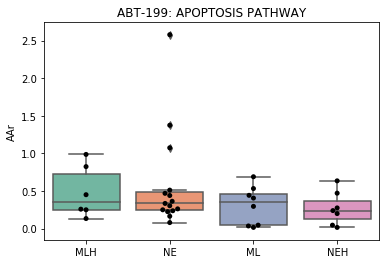

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.4344  -0.9762 1.845  False 
 [1]    [3]    0.4295  -0.7953 1.6542 False 
 [1]    [4]   -0.3046  -1.6739 1.0647 False 
 [2]    [3]   -0.0049  -1.1655 1.1556 False 
 [2]    [4]   -0.7389  -2.0512 0.5733 False 
 [3]    [4]    -0.734   -1.844 0.376  False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


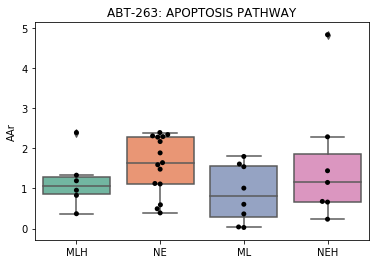

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower   upper  reject
---------------------------------------------
 [1]    [2]   -0.2204  -1.0254  0.5846 False 
 [1]    [3]    0.4288  -0.2702  1.1277 False 
 [1]    [4]    -0.211  -0.9925  0.5704 False 
 [2]    [3]    0.6491  -0.0132  1.3114 False 
 [2]    [4]    0.0093  -0.7395  0.7582 False 
 [3]    [4]   -0.6398  -1.2733 -0.0063  True 
---------------------------------------------
['[1]' '[2]' '[3]' '[4]']


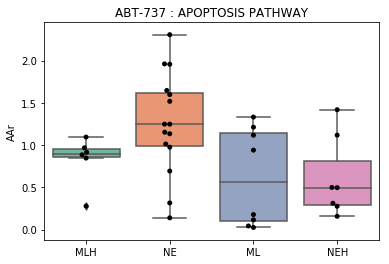

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.1348  -0.5304  0.8   False 
 [1]    [3]    0.2127  -0.3648 0.7903 False 
 [1]    [4]    0.4636  -0.1821 1.1093 False 
 [2]    [3]    0.0779  -0.4693 0.6252 False 
 [2]    [4]    0.3288  -0.2899 0.9476 False 
 [3]    [4]    0.2509  -0.2725 0.7743 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


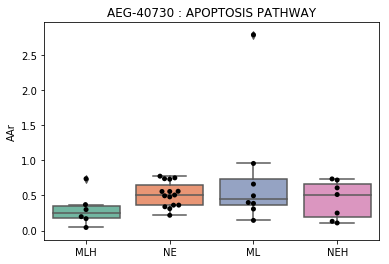

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.1012  -0.2562 0.4586 False 
 [1]    [3]    0.0589  -0.2514 0.3693 False 
 [1]    [4]    0.1622  -0.1847 0.5092 False 
 [2]    [3]   -0.0423  -0.3364 0.2518 False 
 [2]    [4]    0.061   -0.2715 0.3935 False 
 [3]    [4]    0.1033   -0.178 0.3845 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


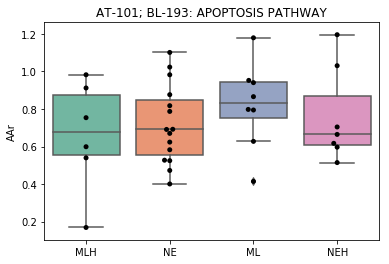

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    -0.221  -1.6429 1.2008 False 
 [1]    [3]    0.4609  -0.7861 1.7079 False 
 [1]    [4]   -0.2466  -1.6268 1.1336 False 
 [2]    [3]    0.682   -0.5011 1.865  False 
 [2]    [4]   -0.0256  -1.3483 1.2971 False 
 [3]    [4]   -0.7075  -1.8402 0.4251 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


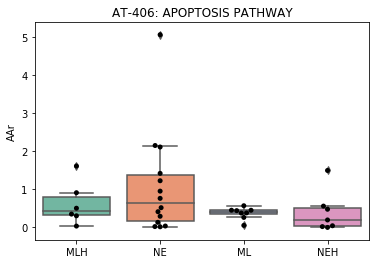

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.0824  -0.7201 0.885  False 
 [1]    [3]   -0.0929  -0.7968 0.611  False 
 [1]    [4]    0.3194  -0.4597 1.0984 False 
 [2]    [3]   -0.1754  -0.8431 0.4924 False 
 [2]    [4]    0.2369  -0.5097 0.9835 False 
 [3]    [4]    0.4123  -0.2271 1.0516 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


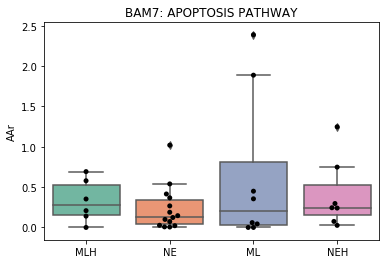

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.4354  -0.3441 1.215  False 
 [1]    [3]    0.3542  -0.3227 1.031  False 
 [1]    [4]    0.017   -0.7398 0.7737 False 
 [2]    [3]   -0.0813  -0.7227 0.5601 False 
 [2]    [4]   -0.4185  -1.1437 0.3067 False 
 [3]    [4]   -0.3372  -0.9506 0.2762 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


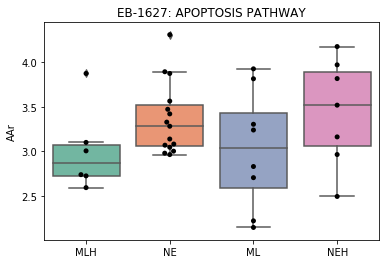

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.1594  -0.8362 1.1551 False 
 [1]    [3]    0.152   -0.7486 1.0526 False 
 [1]    [4]    0.1738   -0.799 1.1465 False 
 [2]    [3]   -0.0075  -0.7428 0.7279 False 
 [2]    [4]    0.0143  -0.8078 0.8365 False 
 [3]    [4]    0.0218  -0.6822 0.7258 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


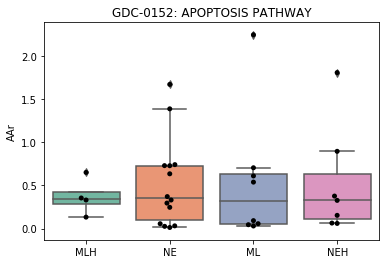

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.0766  -0.3286 0.4818 False 
 [1]    [3]    0.2606  -0.0912 0.6124 False 
 [1]    [4]    0.2191  -0.1742 0.6124 False 
 [2]    [3]    0.184   -0.1493 0.5174 False 
 [2]    [4]    0.1425  -0.2344 0.5194 False 
 [3]    [4]   -0.0415  -0.3604 0.2773 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


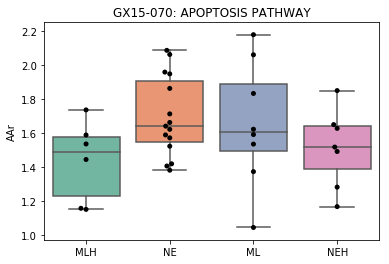

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]   -0.1559  -0.5913 0.2794 False 
 [1]    [3]   -0.1775  -0.5614 0.2065 False 
 [1]    [4]   -0.0224  -0.4463 0.4014 False 
 [2]    [3]   -0.0215  -0.3619 0.3188 False 
 [2]    [4]    0.1335  -0.2513 0.5183 False 
 [3]    [4]    0.1551  -0.1705 0.4806 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


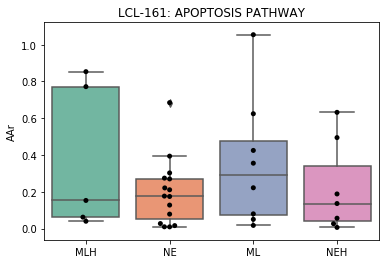

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.131   -0.6601 0.9221 False 
 [1]    [3]    0.2362  -0.3948 0.8673 False 
 [1]    [4]    0.1526  -0.5529 0.8582 False 
 [2]    [3]    0.1052  -0.5694 0.7799 False 
 [2]    [4]    0.0216  -0.7232 0.7664 False 
 [3]    [4]   -0.0836  -0.6556 0.4883 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


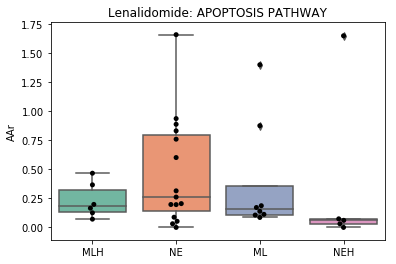

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]   -0.5315  -1.9309 0.8678 False 
 [1]    [3]   -0.7305  -1.9455 0.4844 False 
 [1]    [4]   -0.6071  -1.9654 0.7513 False 
 [2]    [3]    -0.199  -1.3503 0.9523 False 
 [2]    [4]   -0.0755  -1.3773 1.2262 False 
 [3]    [4]    0.1235  -0.9777 1.2246 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


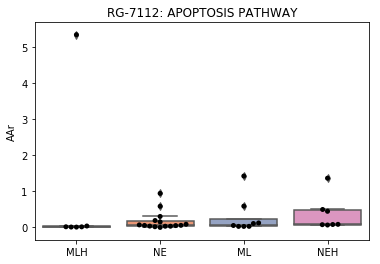

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.2723  -0.4392 0.9838 False 
 [1]    [3]    0.2875  -0.3302 0.9053 False 
 [1]    [4]    0.2335  -0.4571 0.9242 False 
 [2]    [3]    0.0152  -0.5702 0.6006 False 
 [2]    [4]   -0.0388  -0.7007 0.6231 False 
 [3]    [4]    -0.054  -0.6139 0.5059 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


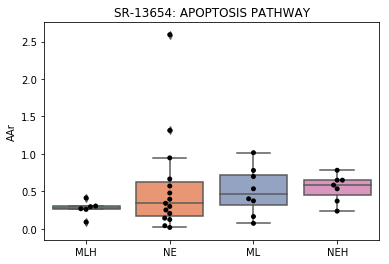

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.5999  -0.5527 1.7525 False 
 [1]    [3]    0.2969  -0.7039 1.2976 False 
 [1]    [4]    0.7289   -0.39  1.8478 False 
 [2]    [3]    -0.303  -1.2513 0.6453 False 
 [2]    [4]    0.129   -0.9432 1.2012 False 
 [3]    [4]    0.432    -0.475 1.339  False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


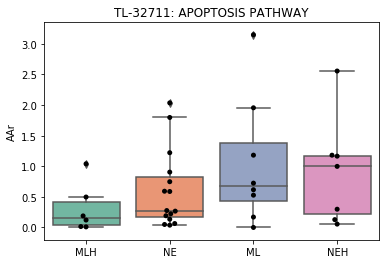

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    1.3884   0.2314 2.5455  True 
 [1]    [3]    0.9248  -0.0798 1.9294 False 
 [1]    [4]    1.0619  -0.0613 2.1851 False 
 [2]    [3]   -0.4636  -1.4155 0.4884 False 
 [2]    [4]   -0.3265  -1.4029 0.7498 False 
 [3]    [4]    0.137   -0.7734 1.0475 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


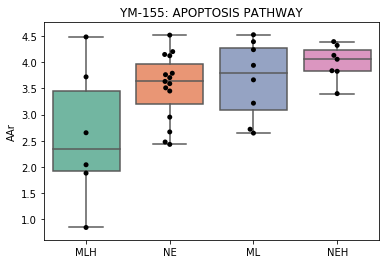

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    1.0504  -0.8069 2.9077 False 
 [1]    [3]    0.5637  -1.0488 2.1763 False 
 [1]    [4]    0.4562  -1.3467 2.2591 False 
 [2]    [3]   -0.4867  -2.0148 1.0414 False 
 [2]    [4]   -0.5942  -2.3219 1.1336 False 
 [3]    [4]   -0.1075   -1.569 1.354  False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


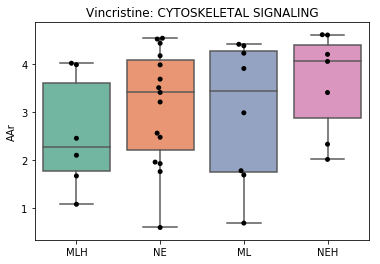

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.8566  -0.0497 1.7628 False 
 [1]    [3]    0.637   -0.1499 1.4238 False 
 [1]    [4]    0.553   -0.3268 1.4327 False 
 [2]    [3]   -0.2196  -0.9652 0.5261 False 
 [2]    [4]   -0.3036  -1.1466 0.5395 False 
 [3]    [4]    -0.084  -0.7972 0.6291 False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


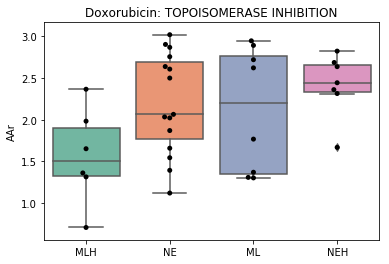

Multiple Comparison of Means - Tukey HSD,FWER=0.05
group1 group2 meandiff  lower  upper  reject
--------------------------------------------
 [1]    [2]    0.4344  -0.9762 1.845  False 
 [1]    [3]    0.4295  -0.7953 1.6542 False 
 [1]    [4]   -0.3046  -1.6739 1.0647 False 
 [2]    [3]   -0.0049  -1.1655 1.1556 False 
 [2]    [4]   -0.7389  -2.0512 0.5733 False 
 [3]    [4]    -0.734   -1.844 0.376  False 
--------------------------------------------
['[1]' '[2]' '[3]' '[4]']


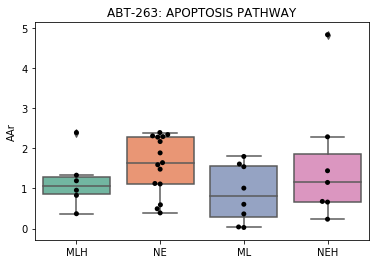

In [13]:
#dlist = ['Digoxin','OSU-03013',' AS-703569 ',' BMS-387032','ABT-869','AM-2282','AZD-8055','Belinostat','BEZ-235','BGT-226',
#'Carfilzomib','CEP-18770','LY-2874455','MP-0922','Omacetaxine mepasuccinate','ONX-0912  ',  'Panobinostat','PF-299804',
#'PF-4942847','Ponatinib','XL-880','XL-888']
#     if i == '[1]': return "MLH"
#     if i == '[2]': return "NEH"
#     if i == '[3]': return "NE"
#     if i == '[4]': return "ML"
from statsmodels.stats.multicomp import pairwise_tukeyhsd
from statsmodels.stats.multicomp import MultiComparison   
import re
p = 'APOPTOSIS PATHWAY'
dlist = targets.loc[targets['PATHWAY']==p]['drug'].values
dlist = np.append(dlist,['Vincristine','Doxorubicin', 'ABT-263'])
print(len(dlist))
for i in range(len(dlist)):
    p3 = df.loc[df['drug'] == dlist[i]]
    p3 = p3.loc[p3['cluster'].isnull().values == False]
    mc = MultiComparison(p3['AAr'], p3['cluster'])
    result = mc.tukeyhsd()
    print(result)
    print(mc.groupsunique)
    ax3 = sns.boxplot(x = [get_pheno(t) for t in p3['cluster']], y = p3['AAr'], palette=sns.color_palette("Set2", 10))
    sns.swarmplot(x = [get_pheno(t) for t in p3['cluster']], y = p3['AAr'],color = 'k')
    ti = dlist[i] + ": " + targets.loc[targets['drug']==dlist[i]]['PATHWAY'].values
    ti = re.sub('[\[\]\']', '', str(ti))
    ax3.set_title(ti)
    plt.show()

## Scatterplot of MYC Expression versus Drug Response to Various AKIs

In [12]:
#expr = pd.read_csv('/Users/sarahmaddox/Quaranta_Lab/SCLC_data/CCLE/RNAseq_08_2017/lung_tpm_final_copy.csv', index_col=0)
expr = pd.read_csv('/Users/sarahmaddox/Quaranta_Lab/SCLC_data/CCLE/full_lung_copy_number.csv', index_col=0)

expr.head()

,COLO 668,COR L24,COR L279,COR L311,COR-L47,COR L88,COR L95,DMS 114,DMS 153,DMS 273,...,NCI-H524,NCI-H526,NCI-H69,NCI-H82,NCI-H841,NCI-H889,SBC5,SCLC21H,SHP-77,SW 1271
SYMBOL,,,,,,,,,,,,,,,,,,,,,
A1BG,-0.5689,0.1865,0.2352,0.4865,0.1184,-0.0500,0.0992,0.3752,0.0633,0.1844,...,0.0133,0.0407,0.2852,0.0242,0.1510,0.3962,-0.4148,0.1291,-0.0568,-0.2400
NAT2,0.1115,0.2561,0.3177,0.2491,0.1174,-0.6609,0.1472,-0.5430,-0.8040,-0.2944,...,0.0444,-0.5055,0.4376,0.2314,0.0896,0.5087,0.4448,0.6043,0.4680,-1.5384
ADA,-0.0089,0.6481,0.3048,0.7029,0.0617,0.1430,0.0785,-0.3360,0.1346,0.1794,...,0.3426,0.4204,-0.6276,0.2131,0.0821,-0.5222,0.0633,0.1351,-0.0777,0.1022
CDH2,0.7475,0.2134,0.3825,0.2573,0.5377,0.2522,0.8875,0.0275,0.1903,0.2010,...,-0.0140,-0.4509,0.8736,-0.1072,0.1103,0.9831,-0.4328,0.2099,0.1113,0.1654
AKT3,0.0739,0.2169,0.3097,0.2475,0.1065,0.4376,-0.4208,0.1619,0.6956,0.2222,...,-0.0953,-0.4985,0.3555,1.1539,0.1495,0.1340,0.3842,0.1721,0.1908,-0.5107


[' AS-703569 ' 'ABT-348' 'AMG-900' 'analog of S-49076' 'AZD-1152'
 'CYC-116' 'ENMD-2076' 'ENMD-2076 Precursor' 'KW-2449' 'MK-5108'
 'MLN-8237 ' 'SCH-1473759' 'SL-0101' 'SNS-314' 'TAK-901' 'Etoposide']


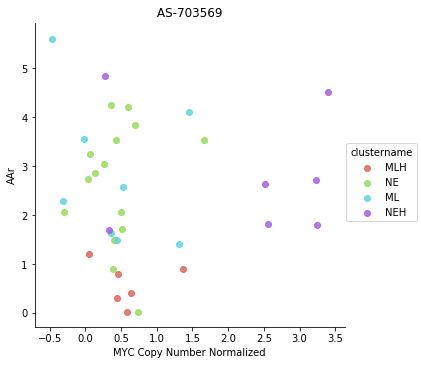

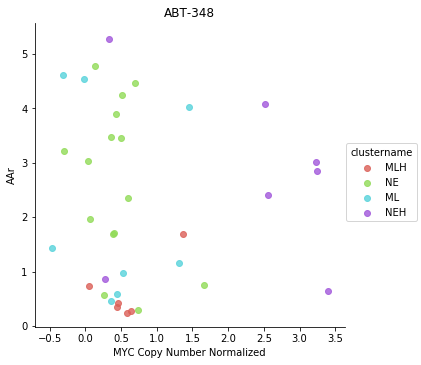

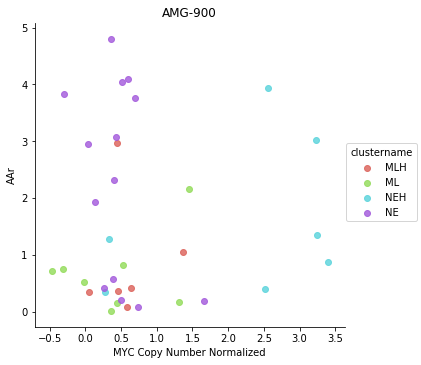

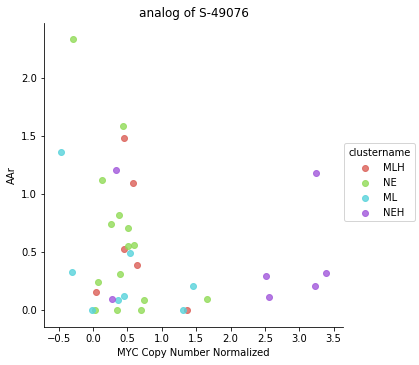

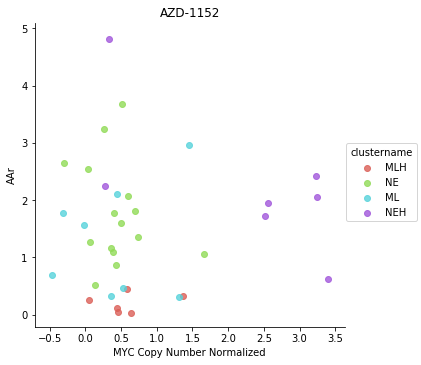

...

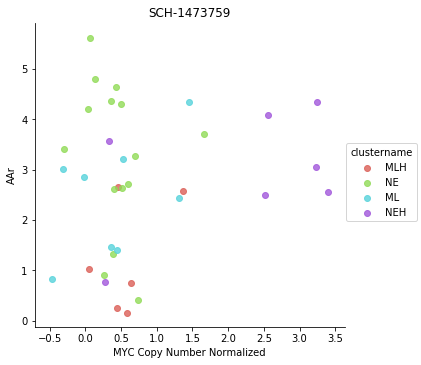

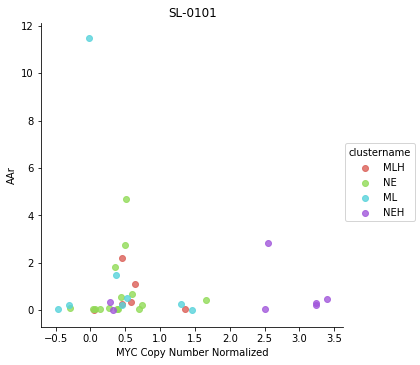

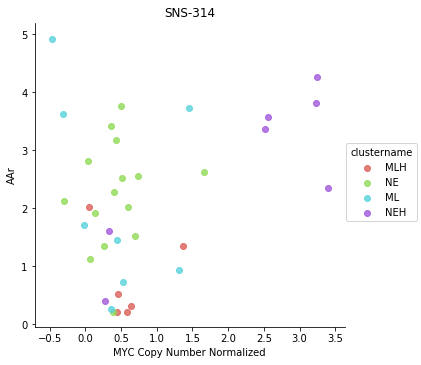

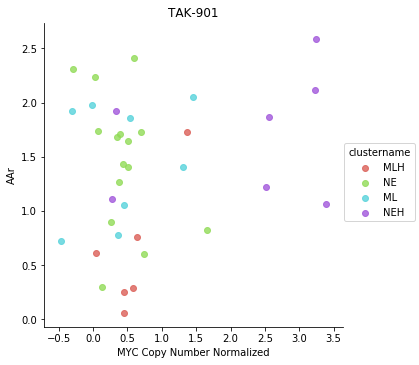

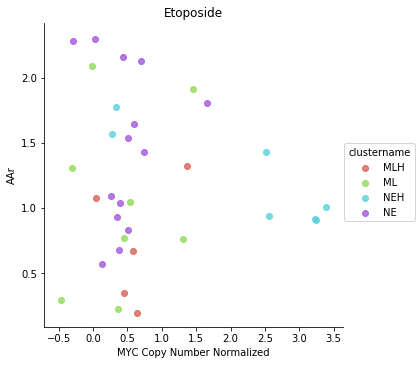

In [13]:
#GET MYC AMPLIFICATION INFORMATION
sns.color_palette('hls')
def myc_plot(d,gene):
    myc = df[df['drug'] == d]
    myc.index = myc['cline']
    myc = myc.drop(['Unnamed: 0', 'cline'], axis = 1)
    myc_exp= pd.DataFrame(columns=['expr'], index=expr.columns)
    for c in expr:
        myc_exp.loc[c,'expr'] = float(expr.loc[gene, c])
    myc = myc.join(myc_exp)
    myc = myc.drop(['NCI-H2141', 'NCI-H69/CPR','NCI-H69/LX10', 'NCI-H69VCR/R'], axis = 0)
    myc['expr'] = myc['expr'].astype(float)
    c = []
    for l in myc['cluster']:
        if l in ['[1]','[2]','[3]','[4]']:
            c.append(get_pheno(l))
#         if l in ['[1]', '[3]', '[4]']:
#             c.append('Other')
#         elif l in ['[2]']:
#             c.append('NEH')
        else:
            c.append('0')
    myc['clustername'] = c
    myc['logEC50'] = np.log(myc['EC50'])
    ax = sns.lmplot(x="expr", y='AAr', data=myc, hue = 'clustername', ci = None, palette='hls',line_kws = {'alpha':.3}, fit_reg= False)
    plt.title(d)
    plt.xlabel('MYC Copy Number Normalized')
#     new_labels = ['MLH', 'NE', 'ML', 'NEH']
#     for t, l in zip(ax._legend.texts, new_labels): t.set_text(l)
#     color="k" # choose a color
#     for x, y, name in zip(myc["expr"], myc["AAr"], myc.index):
#         plt.text(x, y , name, color=color, fontsize = 'small')
    plt.show()
    
p = 'AURORA KINASE'
dlis = targets.loc[targets['PATHWAY']==p]['drug'].values
dlis = np.append(dlis,'Etoposide')
print(dlis)
for d in (dlis):
    myc_plot(d, 'MYC')
    

In [10]:
p = 'ENDOCRINOLOGY AND HORMONES'
dlis = targets.loc[targets['PATHWAY']==p]['drug'].values
dlis

array(['Anastrozole', 'ARN-509', 'AZD-3514', 'Celecoxib', 'Diclofenac',
       'Enzalutamide', 'Exemestane', 'Fenoprofen', 'Fulvestrant',
       'Letrozole', 'Meclofenamate', 'Megestrol acetate', 'Mitotane',
       'Raloxifene', 'Tamoxifen'], dtype=object)

# Predicting Sensitivity

In [34]:
lda_class_t = pd.read_csv('/Users/sarahmaddox/Quaranta_Lab/SCLC/LDA/Teicher_comparison/Teicher_colors.csv', header = 0, index_col=0)
#lda_class_t = lda_class_t.drop('Unnamed: 5', axis = 1)
s = [i.replace('-', '') for i in lda_class_t.index]
s = [i.replace(' ', '') for i in s]
lda_class_t.index = s
lda_class_t.head()

AttributeError: 'int' object has no attribute 'replace'

In [35]:
lda_class = pd.read_csv('/Users/sarahmaddox/Quaranta_Lab/SCLC/LDA/Teicher_comparison/CCLE_colors.csv', header = 0, index_col=0)
s = [i.replace('-', '') for i in lda_class.index]
s = [i.replace('_LUNG', '') for i in lda_class.index]
s = [i.replace(' ', '') for i in s]
lda_class.index = s
lda_class.head()

,1,2,3,4
NCIH211,0.0,0.113402,0.005155,0.881443
SBC5,0.0,0.994924,0.005076,0.000000
DMS114,0.0,0.767677,0.000000,0.232323
NCIH841,0.0,0.323077,0.338462,0.338462
SW1271,0.0,0.004651,0.125581,0.869767


In [36]:
x_expr = pd.read_csv('/Users/sarahmaddox/Quaranta_Lab/SCLC_data/Teicher/expression.csv', header = 0, index_col=0)
x_expr = x_expr.drop('TranscriptClusterID', axis = 1)
x_expr.head()

,NCI-H146,NCI-H187,NCI-H196,NCI-H211,NCI-H378,NCI-H446,NCI-H524,NCI-H526,NCI-H865,NLRna1,...,COLO 668,COR-L32,COR-L47,DMS 53,DMS 79,NCI-H2029,NCI-H2198,SW 1271,NCI-H82,NCI-H128
GeneSymbol,,,,,,,,,,,,,,,,,,,,,
A1BG,7.179881,7.467427,7.295159,7.315099,7.217579,7.409890,7.153158,7.097093,7.206729,6.977763,...,7.771225,7.769695,7.697974,7.680140,7.636741,7.590127,7.411047,7.340223,7.243397,7.448386
A1CF,4.684524,4.942479,4.798807,4.857086,4.719251,4.788334,4.650494,5.060540,4.654245,4.763144,...,7.651792,4.904618,5.000986,7.238577,4.952869,4.954688,4.808815,9.689525,4.751304,4.792393
A2LD1,6.487917,6.752139,6.814458,6.850509,6.319124,6.331185,6.393523,6.172389,6.700382,6.688061,...,7.391226,7.903318,6.998009,6.999828,6.721664,6.857672,6.568589,7.006940,6.620506,6.490204
A2M,5.106196,5.442455,5.498540,5.405462,5.185639,5.320794,5.224944,5.128470,5.080424,12.717364,...,5.757781,5.412100,5.607222,5.629096,5.436300,5.442801,5.248531,5.381220,5.169953,5.245974
A2ML1,4.679851,4.877707,4.753844,4.704407,4.650844,4.739089,4.813406,4.728126,4.632152,4.556525,...,4.905027,4.889797,4.936526,4.976506,4.943529,5.053452,4.837523,4.716296,4.773514,4.809411


In [37]:
expr_test = x_expr.loc[['RET', "TYRO3", 'EPHA2', "CEACAM5"]]
s = [i.replace('-', '') for i in expr_test.columns]
s = [i.replace(' ', '') for i in s]
expr_test.columns = s
expr_test = expr_test.transpose()
expr_test.head()

GeneSymbol,RET,TYRO3,EPHA2,CEACAM5
NCIH146,8.259574,6.814174,6.658702,6.200007
NCIH187,6.048391,6.906681,6.905203,9.444719
NCIH196,5.858965,8.241304,8.120657,5.237612
NCIH211,5.963084,7.258376,7.104248,5.523711
NCIH378,5.693017,7.083766,6.640057,5.136053


In [38]:
expr_train = pd.read_csv('/Users/sarahmaddox/Quaranta_Lab/SCLC_data/Teicher/expression.csv', index_col=0)
expr_train = expr_train.drop('TranscriptClusterID', axis = 1)
expr_train = expr_train.loc[['RET', "TYRO3", 'EPHA2', "CEACAM5"]]
s = [i.replace('-', '') for i in expr_train.columns]
s = [i.replace(' ', '') for i in s]
s = [i.replace('_LUNG', '') for i in s]
expr_train.columns = s
expr_train = expr_train.transpose()
expr_train.head()


GeneSymbol,RET,TYRO3,EPHA2,CEACAM5
NCIH146,8.259574,6.814174,6.658702,6.200007
NCIH187,6.048391,6.906681,6.905203,9.444719
NCIH196,5.858965,8.241304,8.120657,5.237612
NCIH211,5.963084,7.258376,7.104248,5.523711
NCIH378,5.693017,7.083766,6.640057,5.136053


In [39]:
DRUG_CHOICE = 'BAY-86-9766'

In [40]:
drug_sens = pd.read_csv("/Users/sarahmaddox/Quaranta_Lab/SCLC/Drug_response/SCLC_DRC_aa_v2.csv", header = 0, index_col=0)
drug_sens.head()

,drug,aa,phenotype
cell.line,,,
COLO668,(+)-JQ1,17.644815,MLH
CORL32,(+)-JQ1,12.063704,NaN
CORL47,(+)-JQ1,15.942593,NE
CORL88,(+)-JQ1,17.129630,MLH
DMS114,(+)-JQ1,47.302593,ML


In [41]:
druglr = drug_sens.loc[drug_sens['drug']==DRUG_CHOICE]["aa"]

In [42]:
expr_train.loc[list(set(expr_train.index)&set(druglr.index))]

GeneSymbol,RET,TYRO3,EPHA2,CEACAM5
NCIH1105,6.368518,6.529641,7.177760,5.881211
NCIH211,5.963084,7.258376,7.104248,5.523711
NCIH2198,8.209071,7.082561,6.873290,11.820635
NCIH1417,7.711032,6.662190,6.701946,5.686426
NCIH146,8.259574,6.814174,6.658702,6.200007
COLO668,7.754218,6.845581,7.340514,9.158095
NCIH526,5.817081,7.346712,6.975379,5.290655
NCIH660,8.955757,6.691801,6.993476,11.499932
CORL88,8.156894,6.259112,6.794961,9.194740
NCIH209,5.989271,6.897681,7.025449,8.611527


In [43]:
druglr = druglr.dropna()
druglr.head()

cell.line
COLO668    0.644074
CORL32    -0.932963
CORL47    -3.364444
CORL88    -0.411481
DMS114     3.277037
Name: aa, dtype: float64

In [44]:
druglr.loc[list(set(expr_train.index)&set(druglr.index))].shape

(66,)

In [45]:
from sklearn.linear_model import Ridge as LR
#from sklearn.svm import  as LR
lr = LR()
lr.fit(expr_train.loc[list(set(expr_train.index)&set(druglr.index))], druglr.loc[list(set(expr_train.index)&set(druglr.index))])

Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001)

In [46]:
pred = lr.predict(expr_test.loc[list(set(expr_test.index)-set(expr_train.index))])
predict = pd.DataFrame(index=list(set(expr_test.index)-set(expr_train.index)), columns=['Pred'])
predict['Pred']= pred
predict.head()

ValueError: Found array with 0 sample(s) (shape=(0, 4)) while a minimum of 1 is required.

In [47]:
drug_phen = drug_sens.loc[drug_sens['drug']==DRUG_CHOICE]['phenotype']
drug_phen.head()

cell.line
COLO668    MLH
CORL32     NaN
CORL47      NE
CORL88     MLH
DMS114      ML
Name: phenotype, dtype: object

In [48]:
predict['actual'] = druglr.loc[list(set(druglr.index)&set(predict.index)-set(expr_train.index))]
predict = predict.dropna()
# s = []
# for i,r, in lda_class_t.loc[list(set(druglr.index)&set(predict.index)-set(lda_class.index))]:
#     s.append
#predict['color'] = pd.Series(s)
predict.head()

NameError: name 'predict' is not defined

In [49]:
keep =pd.DataFrame(druglr.loc[list(set(druglr.index)-set(predict.index))])
keep['phen'] = drug_phen.loc[list(set(druglr.index)-set(predict.index))]

NameError: name 'predict' is not defined

In [50]:
keep.head()

NameError: name 'keep' is not defined

In [51]:
sns.lmplot(data = predict, x = 'actual', y = 'Pred', fit_reg=False)
sns.lmplot(data = keep,x = 'aa', y='aa',  fit_reg=False)

NameError: name 'predict' is not defined

In [52]:
teicher_only = lda_class_t.loc[list(set(lda_class_t.index)-set(lda_class.index))]
teicher_only.head()

,1,2,3,4
3584,0.215,0.180,0.543,0.062
3074,0.235,0.150,0.561,0.054
519,0.110,0.406,0.409,0.075
4111,0.165,0.211,0.567,0.057
528,0.102,0.377,0.376,0.145


In [53]:
mlh = []
neh = []
ne = []
ml = []
for i,r in teicher_only.iterrows():
    if r.idxmax(axis = 1) == "1":
        mlh.append(i)
    if r.idxmax(axis = 1) == "2":
        neh.append(i)
    if r.idxmax(axis = 1) == "3":
        ne.append(i)
    if r.idxmax(axis = 1) == "4":
        ml.append(i)

In [54]:
import numpy as np
print("NE", predict.loc[ne]['actual'].mean(), np.nanstd(predict.loc[ne]['actual']))
print("NEH", predict.loc[neh]['actual'].mean(), np.nanstd(predict.loc[neh]['actual']))
print("MLH", predict.loc[mlh]['actual'].mean(), np.nanstd(predict.loc[mlh]['actual']))
print("ML", predict.loc[ml]['actual'].mean(), np.nanstd(predict.loc[ml]['actual']))

NameError: name 'predict' is not defined

In [55]:
import scipy.stats as stats

stats.kruskal(predict.loc[ne]['actual'],predict.loc[neh]['actual'],predict.loc[mlh]['actual'],predict.loc[ml]['actual'], nan_policy = 'omit')

NameError: name 'predict' is not defined

In [56]:
drug_sens['pred_pheno'] = pd.Series(0)
drug_sens = drug_sens.fillna(0)
drug_sens.head()

,drug,aa,phenotype,pred_pheno
cell.line,,,,
COLO668,(+)-JQ1,17.644815,MLH,0.0
CORL32,(+)-JQ1,12.063704,0,0.0
CORL47,(+)-JQ1,15.942593,NE,0.0
CORL88,(+)-JQ1,17.129630,MLH,0.0
DMS114,(+)-JQ1,47.302593,ML,0.0


In [57]:
for c in ne:
    if c in drug_sens.index:
        drug_sens.loc[c, 'pred_pheno'] ='NE'    
for c in neh:
    if c in drug_sens.index:
        drug_sens.loc[c, 'pred_pheno'] ='NEH'
for c in mlh:
    if c in drug_sens.index:
        drug_sens.loc[c, 'pred_pheno'] ='MLH'
for c in ml:
    if c in drug_sens.index:
        drug_sens.loc[c, 'pred_pheno'] ='ML'
drug_sens.head(20)

,drug,aa,phenotype,pred_pheno
cell.line,,,,
COLO668,(+)-JQ1,17.644815,MLH,0.0
CORL32,(+)-JQ1,12.063704,0,0.0
CORL47,(+)-JQ1,15.942593,NE,0.0
CORL88,(+)-JQ1,17.129630,MLH,0.0
DMS114,(+)-JQ1,47.302593,ML,0.0
DMS187,(+)-JQ1,11.668889,0,0.0
DMS273,(+)-JQ1,35.087407,NEH,0.0
DMS53,(+)-JQ1,29.407037,MLH,0.0
DMS79,(+)-JQ1,15.536667,NE,0.0


In [63]:
drug_sens2 = pd.read_csv("/Users/sarahmaddox/Quaranta_Lab/SCLC/Drug_response/SCLC_DRC_aa_v2.csv", header = 0, index_col=0)
drug_sens2.head()

,drug,aa,phenotype
cell.line,,,
COLO668,(+)-JQ1,17.644815,MLH
CORL32,(+)-JQ1,12.063704,NaN
CORL47,(+)-JQ1,15.942593,NE
CORL88,(+)-JQ1,17.129630,MLH
DMS114,(+)-JQ1,47.302593,ML


In [64]:
for c in ne:
    if c in drug_sens2.index:
        drug_sens2.loc[c, 'phenotype'] ='NE'    
for c in neh:
    if c in drug_sens2.index:
        drug_sens2.loc[c, 'phenotype'] ='NEH'
for c in mlh:
    if c in drug_sens2.index:
        drug_sens2.loc[c, 'phenotype'] ='MLH'
for c in ml:
    if c in drug_sens2.index:
        drug_sens2.loc[c, 'phenotype'] ='ML'
len(set(drug_sens2.index))

66

In [65]:
import scipy.stats as stats
from statsmodels.stats.multitest import fdrcorrection as fdr
aa_anova = pd.DataFrame(index=set(drug_sens2['drug']), columns=['f', 'p', 'p_corr'])
for d in set(drug_sens2['drug']):
    print(d)
    d_df = drug_sens2.loc[drug_sens2['drug']== d]
    mlh_aa = d_df.loc[d_df['phenotype'] == 'MLH']['aa']
    ml_aa = d_df.loc[d_df['phenotype'] == 'ML']['aa']
    neh_aa = d_df.loc[d_df['phenotype'] == 'NEH']['aa']
    ne_aa = d_df.loc[d_df['phenotype'] == 'NE']['aa']
    f, p = stats.f_oneway(mlh_aa, ml_aa, neh_aa, ne_aa)
    aa_anova.loc[d, 'f'] = f
    aa_anova.loc[d, 'p'] = p

aa_anova['p_corr'] = fdr(aa_anova['p'])[1]
len(set(drug_sens2['drug']))

ACY-1215
Trametinib
AZD-7762 
ABT-263
BMN-673
ABT-888
Pemetrexed
CHIR-258
PD-0325901
AZD-5363
R-115777
MLN-4924
ONX-0801
Sildenafil
Vorinostat
C-75
isomer of LOR-253
SB-743921
LDE-225, diphosphonate salt
CP-91149
Etoposide
R-547
Irinotecan
ARRY-380
MLN-9708
SNS-595; SPC-595
SEN-450
SP-600125
AT-101; BL-193
ADW-742
Vinblastine
Chlorambucil
LY-2801653
ZM-336372
Melphalan
Wortmannin
ZD-1694
BGJ-398
Letrozole
Panobinostat
PCI-0120
GDC-0941
LY-2090314
TAK-441
KPT-251
TAK-901
Vemurafenib
Doxorubicin
Idelalisib
PF-05212384
Busulfan
Meclofenamate
BEZ-235
XL-147
BMN-673 (inactive enantiomer)
AZD-2461
Peptide [CRGDKGPDC - cys & cys bridge
Bendamustine
VE-821
4SC-202 
AZD-1480
Tretinoin
Pazopanib
Tacrolimus
JNJ-38877605
PX-866
AZD-3514
FAU
Pimozide
Asorbic Acid
YN-968D1
Fluphenazine
PF-4942847
TAK-960
Tyrothricin
Bortezamide
Fluvastatin
SAR-125844
Paroxetine
AZD-2014
LY-2606368
XL-019
BAY 61-3606
XR-5000
Ruxolitinib
PF-04217903
OT-674
Anafranil
MK-2461
CYT-387
Triethylenemelamine
TAE-684
Sorafeni

519

In [79]:
aa_anova.loc['BEZ-235']

f            6.05947
p         0.00210226
p_corr     0.0693518
Name: BEZ-235, dtype: object

In [82]:
aa_anova.loc[aa_anova['p_corr'] < .05].shape

(36, 3)

In [68]:
drug_sens2.loc[drug_sens2['drug'] == 'ABT-348']['phenotype']

cell.line
COLO668     MLH
CORL32      NaN
CORL47       NE
CORL88      MLH
DMS114       ML
DMS187      NaN
DMS273      NEH
DMS53       MLH
DMS79        NE
LXFS605L    NaN
LXFS650L    NaN
NCIH1048     ML
NCIH1092     NE
NCIH1105     NE
NCIH128     NaN
NCIH1341     ML
NCIH1417    NaN
NCIH1436     NE
NCIH146      NE
NCIH1522    NaN
NCIH1618     NE
NCIH1650    NaN
NCIH1672    NaN
NCIH1688    NaN
NCIH1694    NEH
NCIH1836     NE
NCIH187     NaN
NCIH1876     NE
NCIH1882    NaN
NCIH1930     NE
           ... 
NCIH2107    NaN
NCIH211      ML
NCIH2141     NE
NCIH2171    NEH
NCIH2198    NaN
NCIH220     NaN
NCIH2330    NaN
NCIH250     NaN
NCIH28      NaN
NCIH345     NaN
NCIH378     NaN
NCIH446     NEH
NCIH510     MLH
NCIH524     NEH
NCIH526     NEH
NCIH660     NaN
NCIH69       NE
NCIH711     NaN
NCIH719     NaN
NCIH720     NaN
NCIH735     NaN
NCIH748     NaN
NCIH774     NaN
NCIH82      NEH
NCIH841      ML
NCIH847     NaN
NCIH865     NaN
NCIH889      NE
SHP77       MLH
SW1271       ML
Name: phenotyp

['PI3K/AKT/MTOR'] 8
['HSP INHIBITOR'] 1
['EGFR INHIBITOR'] 2
['PROTEIN TYROSINE KINASE'] 5
['MAPK SIGNALING'] 2
['APOPTOSIS PATHWAY'] 4
['AURORA KINASE'] 2
['CHROMATIN'] 2
['METABOLISM'] 2
['OTHER'] 1
['CYTOSKELETAL SIGNALING'] 1
['MEK INHIBITOR'] 5
['TRANSMEMBRANE TRANSPORTERS'] 1
[' AS-703569 ', 'ABT-348', 'AMG-900', 'analog of S-49076', 'AZD-1152', 'CYC-116', 'ENMD-2076', 'ENMD-2076 Precursor', 'KW-2449', 'MK-5108', 'MLN-8237 ', 'SCH-1473759', 'SL-0101', 'SNS-314', 'TAK-901', 'BEZ-235']
16


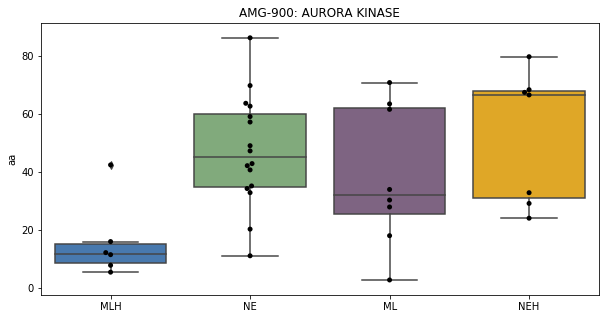

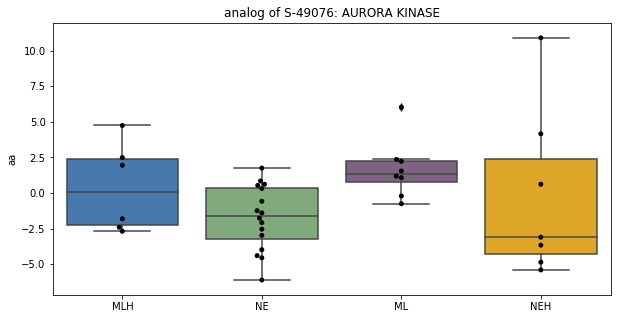

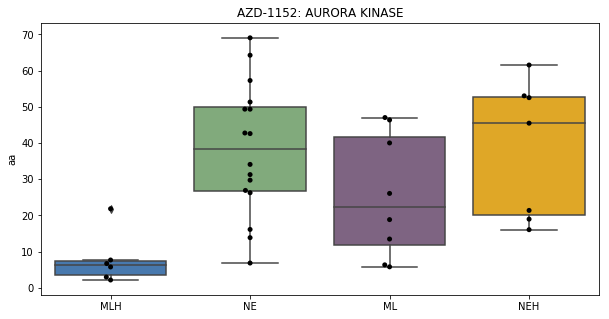

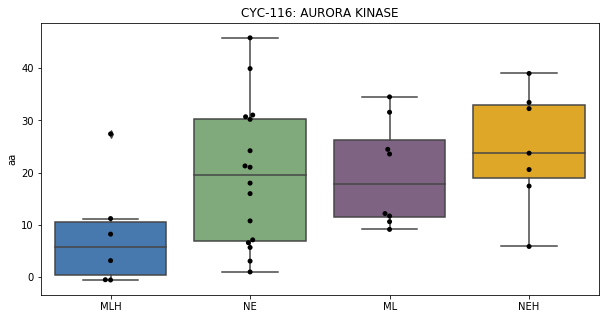

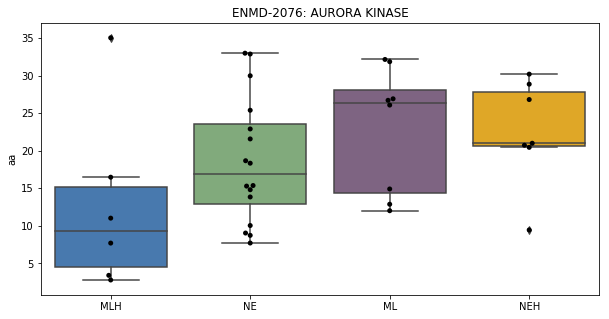

...

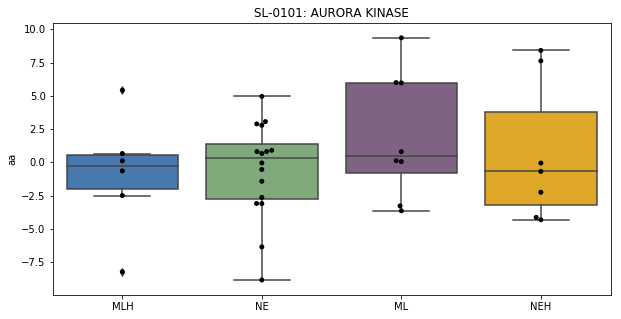

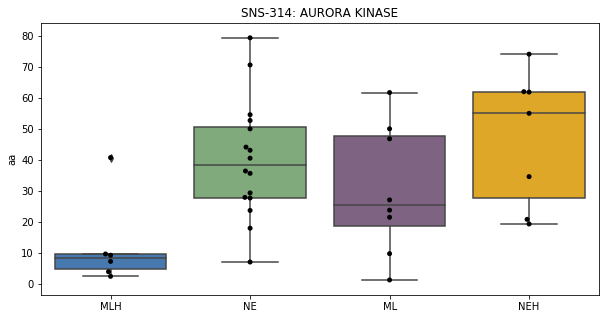

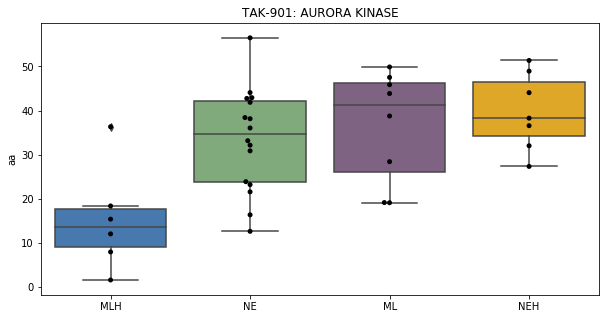

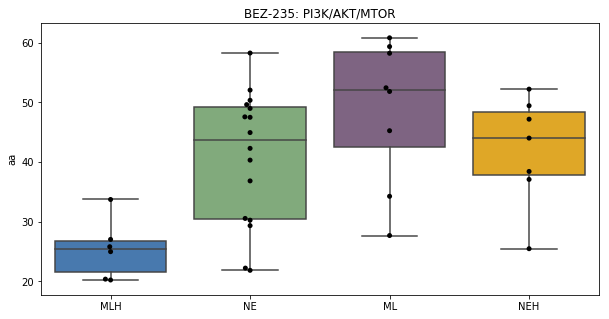

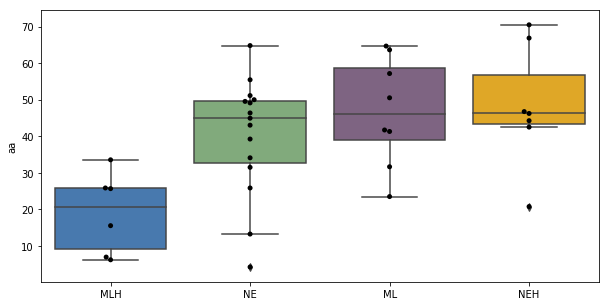

In [69]:
import re
from statsmodels.stats.multicomp import pairwise_tukeyhsd
from statsmodels.stats.multicomp import MultiComparison   

plt.rcParams['figure.figsize'] = [10, 5]

d = []
pval = []
for q, r in aa_anova.iterrows():
    if (r['p_corr']) < .05:
        d.append(q)
        pval.append(r['p_corr'])
tlist=[]
for i in range(len(d)):
    tlist.append(str(targets.loc[targets['drug']==d[i]]['PATHWAY'].values))
for x in set(tlist):
    print(x,tlist.count(x)) 
dlist = sorted(d)
p = 'AURORA KINASE'
dlist = list(targets.loc[targets['PATHWAY']==p]['drug'].values)
dlist.append('BEZ-235')
print(dlist)
print(len(dlist))
dlist = dlist[2:]
dlist.append('AS-703569 ')
for i in range(len(dlist)):
    p = drug_sens2.loc[drug_sens2['drug'] == dlist[i]]
    p = p.loc[p['phenotype'].isnull().values== False]
#     mc = MultiComparison(p['aa'], p['phenotype'])
#     result = mc.tukeyhsd()
#     print(result)
#     print(mc.groupsunique)
    co = {'MLH':'#3778bf', 'NE':'#7bb274', 'ML':'#825f87', 'NEH':'#feb308'}
    f = plt.figure()
    ax = sns.boxplot(x = [t for t in p['phenotype']], y = p['aa'], palette=(co))
    sns.swarmplot(x = [t for t in p['phenotype']], y = p['aa'], color = 'k')
    ti = dlist[i] + ": " + targets.loc[targets['drug']==dlist[i]]['PATHWAY'].values #+ " p = " + str(round(pval[i],4))
    ti = re.sub('[\[\]\']', '', str(ti))
    ax.set_title(ti)
    cl = re.sub('[\[\]\']', '', str(targets.loc[targets['drug']==dlist[i]]['PATHWAY'].values))
    plt.show()
    f.savefig('/Users/sarahmaddox/Quaranta_Lab/SCLC/Drug_response/Boxplots/'+str(dlist[i]) + '.pdf')

In [70]:
targets.loc[targets['PATHWAY'] == 'AURORA KINASE']

,drug,Target,PATHWAY
27,AS-703569,AUK,AURORA KINASE
28,ABT-348,NaN,AURORA KINASE
29,AMG-900,"Aurora kinase, AURKA, AURKB, AURKC, Aur",AURORA KINASE
30,analog of S-49076,"MET/AXL/FGFR, AurB",AURORA KINASE
31,AZD-1152,"Aurora kinase, AurB, AURKB",AURORA KINASE
32,CYC-116,"Aurora kinase, VEGFR",AURORA KINASE
33,ENMD-2076,"Flt, Aurora Kinase, VEGFR, FLT3",AURORA KINASE
34,ENMD-2076 Precursor,AurK,AURORA KINASE
35,KW-2449,"FLT3, AURKA, Flt, Bcr-Abl, Aurora Kinase",AURORA KINASE
36,MK-5108,"AURKA, AurA",AURORA KINASE


In [59]:
df.head()

,Unnamed: 0,cline,drug,slope,Emax,E0,logEC50,EC50,rrEmax,e50,rrE50,IC10,IC50,IC100,Emaxobs,rrEmaxobs,AAr,Emax_normalized,cluster
0,14027,COLO 668,1st Precursur Intermediate to TDP 665759,2.968977,85.549745,101.281703,-5.229148,5.900000e-06,0.844671,93.415724,0.922336,0.000007,NaN,NaN,88.273333,NaN,0.039891,84.467127,[1]
1,15044,COR L88,1st Precursur Intermediate to TDP 665759,0.829663,78.054403,98.248318,-5.181774,6.580000e-06,0.794460,88.151361,0.897230,0.000006,NaN,NaN,86.203333,NaN,0.094890,79.446045,[1]
2,14533,COR-L47,1st Precursur Intermediate to TDP 665759,2.429114,97.544478,100.462068,-5.863279,1.370000e-06,0.970958,99.003273,0.985479,NaN,NaN,NaN,94.896667,NaN,0.025148,97.095829,[3]
3,4824,DMS 114,1st Precursur Intermediate to TDP 665759,3.853491,74.658698,99.135093,-4.978811,1.050000e-05,0.753101,86.896896,0.876550,0.000009,NaN,NaN,88.000000,NaN,0.016884,75.310060,[4]
4,5333,DMS 273,1st Precursur Intermediate to TDP 665759,-0.158879,98.891630,103.255862,-6.463442,3.440000e-07,0.957734,101.073746,0.978867,NaN,NaN,NaN,96.486667,NaN,0.195073,95.773381,[2]


In [60]:
drug_sens.head()

,drug,aa,phenotype,pred_pheno
cell.line,,,,
COLO668,(+)-JQ1,17.644815,MLH,0
CORL32,(+)-JQ1,12.063704,0,MLH
CORL47,(+)-JQ1,15.942593,NE,0
CORL88,(+)-JQ1,17.129630,MLH,0
DMS114,(+)-JQ1,47.302593,ML,0


In [61]:
df2 = drug_sens
df2['all_pheno'] = pd.Series()
df2 = df2.fillna(0)
df2.head()
for i in range(len(df2.index)):
    if df2.iloc[i]['phenotype'] == 0:
        df2.iloc[i]['all_pheno'] = df2.iloc[i]['pred_pheno']
    break
df2.head()

,drug,aa,phenotype,pred_pheno,all_pheno
cell.line,,,,,
COLO668,(+)-JQ1,17.644815,MLH,0,0.0
CORL32,(+)-JQ1,12.063704,0,MLH,0.0
CORL47,(+)-JQ1,15.942593,NE,0,0.0
CORL88,(+)-JQ1,17.129630,MLH,0,0.0
DMS114,(+)-JQ1,47.302593,ML,0,0.0


In [62]:
drug_sens2.head()

,drug,aa,phenotype
cell.line,,,
COLO668,(+)-JQ1,17.644815,MLH
CORL32,(+)-JQ1,12.063704,MLH
CORL47,(+)-JQ1,15.942593,NE
CORL88,(+)-JQ1,17.129630,MLH
DMS114,(+)-JQ1,47.302593,ML


In [63]:
tar = 'ANGIOGENSIS'
tar[0:4]

'ANGI'

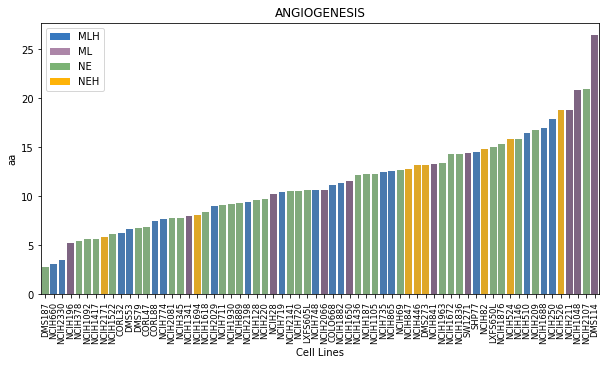

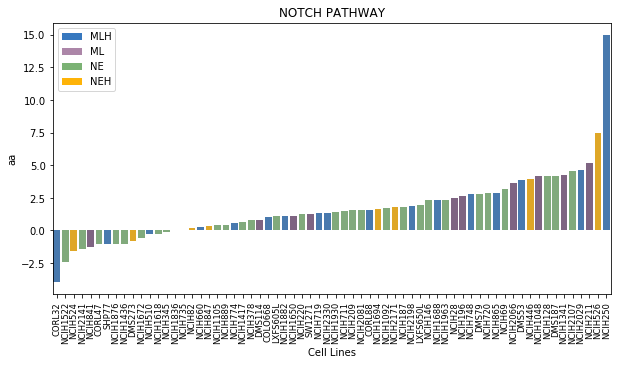

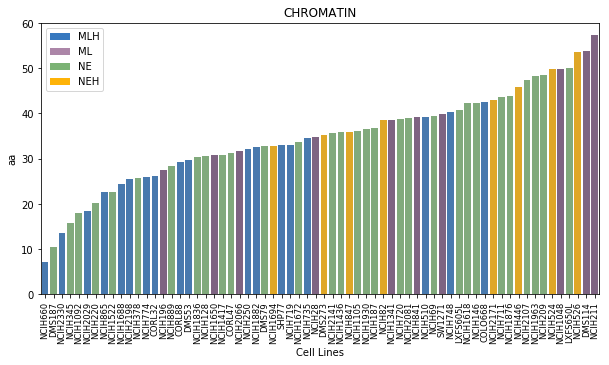

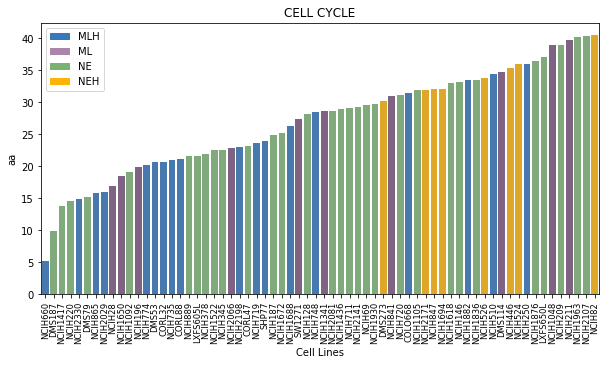

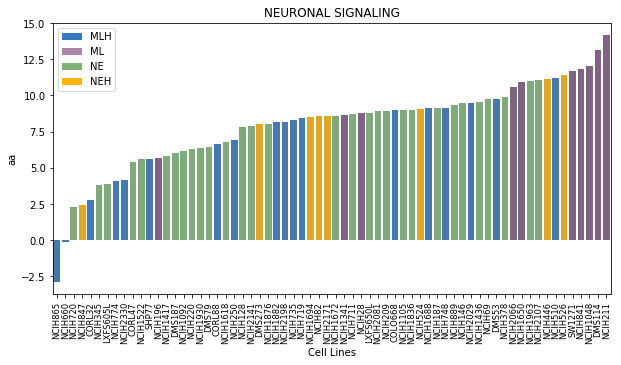

...

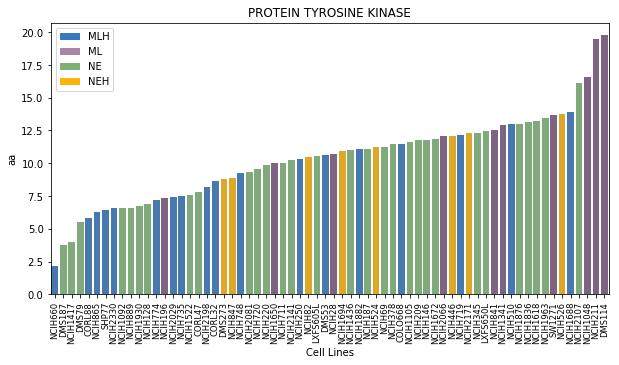

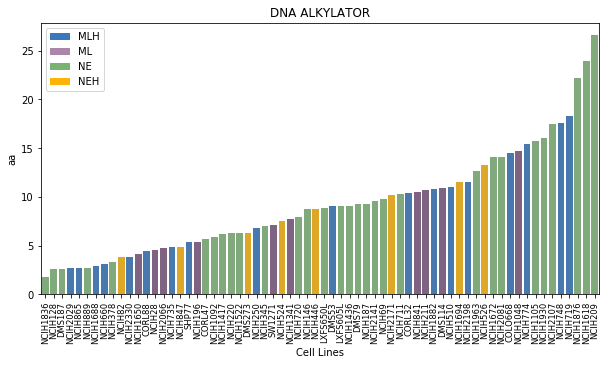

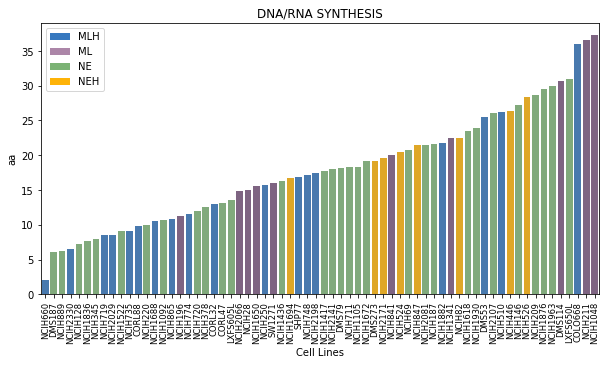

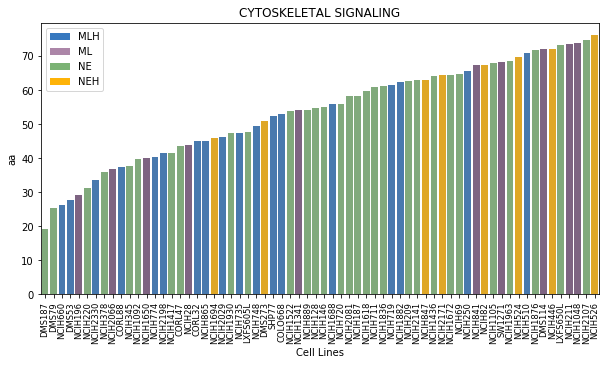

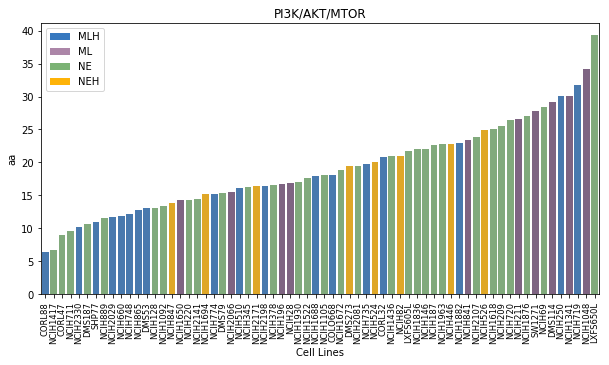

In [65]:
import matplotlib.text as txt
from matplotlib.patches import Patch

def waterfalldrugs(tar, metric):
    dls = targets[targets['PATHWAY'] == tar]['drug']
    pathway_df = drug_sens2[drug_sens2['drug'].isin(dls)]
    pl = pathway_df[[metric,'phenotype']]
    pl.index = pathway_df.index
    med = pl.groupby(pl.index)[metric].mean()
    std = pl.groupby(pl.index)[metric].std()
    med = med.sort_values()
    meds = pd.DataFrame(0,columns=[metric, 'cls'], index = med.index)
    meds[metric]=pd.Series(med)
    for i in meds.index:
        meds.loc[i, 'cls'] = list(set(pl.loc[i, 'phenotype']))[0]
    c = ['MLH', 'NEH', 'NE', 'ML', 0]
    co = ['windows blue', 'amber', 'faded green', 'dusty purple', 'greyish']
    palette_dir = pd.Series(co, index = c)
    f = plt.figure()
    sns.set_palette(sns.xkcd_palette(meds['cls'].map(palette_dir)))
    ax = sns.barplot(x=med.index, y = med, ci = std) # palette=sns.xkcd_palette(pl['cluster'].map(palette_dir)))

    #ax = sns.barplot(x=pl.index, y = (pl['AAr']), ci = 'sd', order=med.index) # palette=sns.xkcd_palette(pl['cluster'].map(palette_dir)))
    ax.set_xticklabels(med.index, rotation = 90, fontdict ={'fontsize':'small'})
    plt.title(tar)
    ax.set_xlabel('Cell Lines')

    legend_elements = [Patch(facecolor='#3778bf', label='MLH'), Patch(facecolor='#ac86a8', label='ML'),
                      Patch(facecolor='#7bb274', label='NE'), Patch(facecolor='#feb308', label = 'NEH')]#,
                      #Patch(facecolor='#a8a495', label = 'Unknown')]
    ax.legend(handles=legend_elements, loc='best')
    plt.show()
    f.savefig('/Users/sarahmaddox/Quaranta_Lab/SCLC/Drug_response/Waterfall/' + tar[0:2] + '.pdf')

for tar in set(targets['PATHWAY']):
    waterfalldrugs(tar, 'aa')
    
    